In [1]:
import os
os.environ['CUDA_VISIBLE_DEVICES'] = '0'
import sys
from pathlib import Path

module_folder = os.path.abspath('../gridsaliency-original')
if module_folder not in sys.path:
    sys.path.append(module_folder)
from mnist_generators_simple import gen_texture_mnist, plot_samples

scr_folder = os.path.abspath('../scr')
if scr_folder not in sys.path:
    sys.path.insert(1, scr_folder)
from dataloaders import Cityscapes
from metrics import iou_coef, dice_coef, dice_loss
from unet import csbd_unet, manual_unet, TrainUnet
from training_write import TrainingParameters, TrainingResults
from training_plots import plot_predict_and_gt, plot_loss, plot_metric


#path = "C:\\Users\\vinograd\\Documents\\GitHub\\Seg-Grad-CAM\\inputs\\cityscapes\\leftImg8bit_trainvaltest\\leftImg8bit"

trainparam = TrainingParameters(
    dataset_name = 'TexturedMnist',
                 n_classes=11
                ,scale = 1
                ,batch_size = 20
                ,last_activation = 'softmax'
                ,n_depth = 4
                ,n_filter_base = 32  # 16
                ,pool = 2
                ,lr = 3.e-4
                ,epochs = 300
                ,validation_steps = 500
                ,steps_per_epoch = 2500
                ,loss = "categorical_crossentropy"
                #,optimizer = Adam(lr=3.e-4)
                ,metrics = ['accuracy',iou_coef,dice_coef]
                ,input_shape=(None, None, 1)

,n_train= 50000
,n_val = 10000

)
trainparam.saveToJson()

patch_shape=(64,64)
unbiased_config = {
    'background_split': 2,
    'dataset_seed': 0,
    'tex_res' : 400,
    'tile_size' : 64,
    'train_samples' : trainparam.n_train,
    'test_samples' : trainparam.n_val,
    'exclude_bias_textures': False,
    'fix_test_set': True,
    'batch_size': trainparam.batch_size,
    'bias': None,
    'textures_path' : Path(module_folder)/'textures/',
}
biased_config = {
    'background_split': 2,
    'dataset_seed': 0,
    'tex_res' : 400,
    'tile_size' : 64,
    'train_samples' : trainparam.n_train,
    'test_samples' : trainparam.n_val,
    'exclude_bias_textures': True,
    'fix_test_set': True,
    'batch_size': trainparam.batch_size,
    'bias': {2 : {
        "source_1_id": "'feeccd96.png", 
        "source_2_id": "'f135d029.png",
        "source_1_bias": 0.0,
        "source_2_bias": 1.0
    }},
    'textures_path' : Path(module_folder)/'textures/',
}

with open(os.path.join(str(trainparam.outfolder),'bias_configs.txt'), 'w+') as file:
    file.write("Biased config:\n")
    
    for k in biased_config.items():
        file.write(str(k)+"\n")
        
    file.write("\nUnbiased config:\n")
    for k in unbiased_config.items():
        file.write(str(k)+"\n")
    file.close()

Using TensorFlow backend.


Biased Test Set


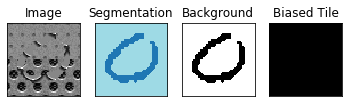

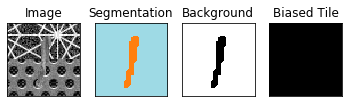

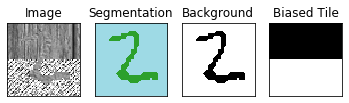

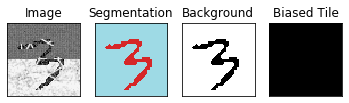

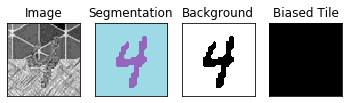

...

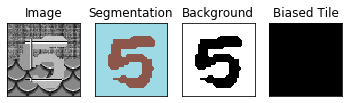

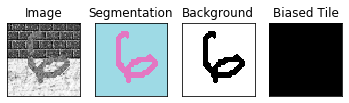

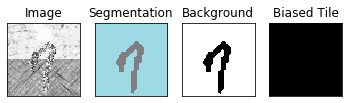

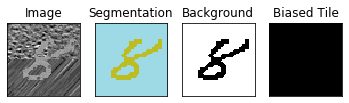

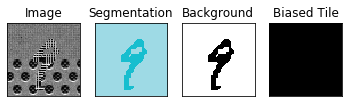

Unbiased Test Set


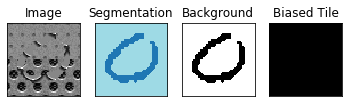

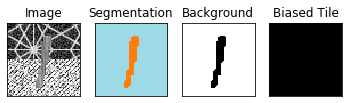

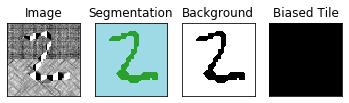

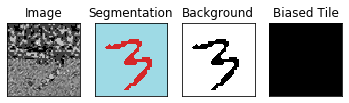

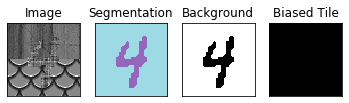

...

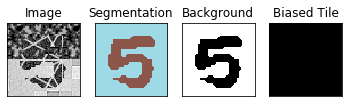

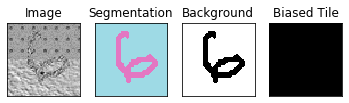

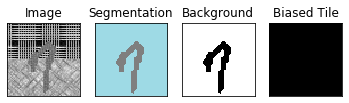

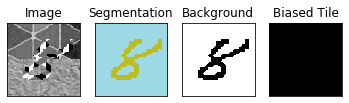

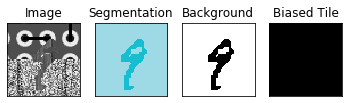

In [2]:
print('Biased Test Set')
biased_generator = gen_texture_mnist(biased_config,'test')
plot_samples(biased_generator, 20)

print('Unbiased Test Set')
unbiased_generator = gen_texture_mnist(unbiased_config,'test')
plot_samples(unbiased_generator, 20)

In [3]:
biased_gen_train = gen_texture_mnist(biased_config,'train', return_dict=False)
biased_gen_test = gen_texture_mnist(biased_config,'test', return_dict=False)
unbiased_gen_test = gen_texture_mnist(unbiased_config,'test', return_dict=False)


In [ ]:
trainunet = TrainUnet(trainparam)

trainunet.csbdUnet()
fit_out = trainunet.fit_generator(biased_gen_train, biased_gen_test)


trainingResults = TrainingResults(trainparam, fit_out)
trainingResults.modelSummaryTxt()
trainingResults.writeResultsTxt()

Epoch 1/300


 102/2500 [>.............................] - ETA: 6:18:40 - loss: 2.5279 - acc: 0.0885 - iou_coef: 0.0512 - dice_coef: 0.097 - ETA: 3:13:24 - loss: 2.5129 - acc: 0.1021 - iou_coef: 0.0525 - dice_coef: 0.099 - ETA: 2:11:40 - loss: 2.4971 - acc: 0.1048 - iou_coef: 0.0531 - dice_coef: 0.100 - ETA: 1:40:49 - loss: 2.4742 - acc: 0.1178 - iou_coef: 0.0549 - dice_coef: 0.103 - ETA: 1:22:18 - loss: 2.4503 - acc: 0.1287 - iou_coef: 0.0560 - dice_coef: 0.105 - ETA: 1:09:57 - loss: 2.4311 - acc: 0.1430 - iou_coef: 0.0571 - dice_coef: 0.107 - ETA: 1:01:07 - loss: 2.4221 - acc: 0.1510 - iou_coef: 0.0578 - dice_coef: 0.109 - ETA: 54:31 - loss: 2.4030 - acc: 0.1660 - iou_coef: 0.0594 - dice_coef: 0.1118  - ETA: 49:24 - loss: 2.3804 - acc: 0.1854 - iou_coef: 0.0607 - dice_coef: 0.114 - ETA: 45:16 - loss: 2.3593 - acc: 0.2051 - iou_coef: 0.0624 - dice_coef: 0.117 - ETA: 41:54 - loss: 2.3413 - acc: 0.2232 - iou_coef: 0.0639 - dice_coef: 0.119 - ETA: 39:05 - loss: 2.3245 - acc: 0.2364 - iou_coef: 0.0649 

 205/2500 [=>............................] - ETA: 11:31 - loss: 1.5539 - acc: 0.6570 - iou_coef: 0.1660 - dice_coef: 0.280 - ETA: 11:28 - loss: 1.5504 - acc: 0.6587 - iou_coef: 0.1668 - dice_coef: 0.281 - ETA: 11:26 - loss: 1.5467 - acc: 0.6606 - iou_coef: 0.1675 - dice_coef: 0.282 - ETA: 11:24 - loss: 1.5431 - acc: 0.6625 - iou_coef: 0.1683 - dice_coef: 0.283 - ETA: 11:22 - loss: 1.5394 - acc: 0.6643 - iou_coef: 0.1690 - dice_coef: 0.284 - ETA: 11:20 - loss: 1.5358 - acc: 0.6662 - iou_coef: 0.1698 - dice_coef: 0.285 - ETA: 11:18 - loss: 1.5321 - acc: 0.6681 - iou_coef: 0.1705 - dice_coef: 0.287 - ETA: 11:16 - loss: 1.5283 - acc: 0.6701 - iou_coef: 0.1713 - dice_coef: 0.288 - ETA: 11:14 - loss: 1.5249 - acc: 0.6718 - iou_coef: 0.1720 - dice_coef: 0.289 - ETA: 11:12 - loss: 1.5213 - acc: 0.6735 - iou_coef: 0.1727 - dice_coef: 0.290 - ETA: 11:10 - loss: 1.5178 - acc: 0.6754 - iou_coef: 0.1734 - dice_coef: 0.291 - ETA: 11:08 - loss: 1.5144 - acc: 0.6770 - iou_coef: 0.1741 - dice_coef: 0.2

 310/2500 [==>...........................] - ETA: 9:22 - loss: 1.2710 - acc: 0.7632 - iou_coef: 0.2374 - dice_coef: 0.37 - ETA: 9:22 - loss: 1.2689 - acc: 0.7638 - iou_coef: 0.2381 - dice_coef: 0.37 - ETA: 9:21 - loss: 1.2668 - acc: 0.7642 - iou_coef: 0.2387 - dice_coef: 0.37 - ETA: 9:20 - loss: 1.2648 - acc: 0.7647 - iou_coef: 0.2394 - dice_coef: 0.37 - ETA: 9:20 - loss: 1.2627 - acc: 0.7653 - iou_coef: 0.2400 - dice_coef: 0.37 - ETA: 9:19 - loss: 1.2606 - acc: 0.7658 - iou_coef: 0.2407 - dice_coef: 0.37 - ETA: 9:18 - loss: 1.2585 - acc: 0.7663 - iou_coef: 0.2414 - dice_coef: 0.38 - ETA: 9:17 - loss: 1.2563 - acc: 0.7668 - iou_coef: 0.2421 - dice_coef: 0.38 - ETA: 9:17 - loss: 1.2542 - acc: 0.7673 - iou_coef: 0.2427 - dice_coef: 0.38 - ETA: 9:16 - loss: 1.2521 - acc: 0.7678 - iou_coef: 0.2434 - dice_coef: 0.38 - ETA: 9:15 - loss: 1.2501 - acc: 0.7683 - iou_coef: 0.2441 - dice_coef: 0.38 - ETA: 9:15 - loss: 1.2480 - acc: 0.7688 - iou_coef: 0.2447 - dice_coef: 0.38 - ETA: 9:14 - loss: 1

 415/2500 [===>..........................] - ETA: 7:07 - loss: 1.0869 - acc: 0.8005 - iou_coef: 0.3048 - dice_coef: 0.45 - ETA: 7:06 - loss: 1.0855 - acc: 0.8007 - iou_coef: 0.3054 - dice_coef: 0.45 - ETA: 7:05 - loss: 1.0839 - acc: 0.8010 - iou_coef: 0.3061 - dice_coef: 0.45 - ETA: 7:04 - loss: 1.0826 - acc: 0.8013 - iou_coef: 0.3066 - dice_coef: 0.45 - ETA: 7:03 - loss: 1.0812 - acc: 0.8015 - iou_coef: 0.3072 - dice_coef: 0.45 - ETA: 7:02 - loss: 1.0798 - acc: 0.8018 - iou_coef: 0.3078 - dice_coef: 0.45 - ETA: 7:01 - loss: 1.0783 - acc: 0.8020 - iou_coef: 0.3085 - dice_coef: 0.45 - ETA: 7:00 - loss: 1.0770 - acc: 0.8022 - iou_coef: 0.3090 - dice_coef: 0.45 - ETA: 6:59 - loss: 1.0756 - acc: 0.8024 - iou_coef: 0.3096 - dice_coef: 0.45 - ETA: 6:58 - loss: 1.0743 - acc: 0.8026 - iou_coef: 0.3102 - dice_coef: 0.45 - ETA: 6:57 - loss: 1.0729 - acc: 0.8028 - iou_coef: 0.3108 - dice_coef: 0.46 - ETA: 6:56 - loss: 1.0717 - acc: 0.8030 - iou_coef: 0.3114 - dice_coef: 0.46 - ETA: 6:55 - loss: 1

 520/2500 [=====>........................] - ETA: 5:41 - loss: 0.9637 - acc: 0.8189 - iou_coef: 0.3627 - dice_coef: 0.51 - ETA: 5:40 - loss: 0.9626 - acc: 0.8190 - iou_coef: 0.3633 - dice_coef: 0.51 - ETA: 5:40 - loss: 0.9616 - acc: 0.8192 - iou_coef: 0.3638 - dice_coef: 0.51 - ETA: 5:39 - loss: 0.9607 - acc: 0.8193 - iou_coef: 0.3643 - dice_coef: 0.51 - ETA: 5:38 - loss: 0.9598 - acc: 0.8194 - iou_coef: 0.3647 - dice_coef: 0.51 - ETA: 5:38 - loss: 0.9589 - acc: 0.8195 - iou_coef: 0.3652 - dice_coef: 0.51 - ETA: 5:37 - loss: 0.9578 - acc: 0.8196 - iou_coef: 0.3657 - dice_coef: 0.51 - ETA: 5:36 - loss: 0.9569 - acc: 0.8198 - iou_coef: 0.3662 - dice_coef: 0.51 - ETA: 5:36 - loss: 0.9559 - acc: 0.8199 - iou_coef: 0.3667 - dice_coef: 0.51 - ETA: 5:35 - loss: 0.9549 - acc: 0.8200 - iou_coef: 0.3672 - dice_coef: 0.51 - ETA: 5:35 - loss: 0.9539 - acc: 0.8202 - iou_coef: 0.3677 - dice_coef: 0.51 - ETA: 5:34 - loss: 0.9528 - acc: 0.8203 - iou_coef: 0.3683 - dice_coef: 0.52 - ETA: 5:33 - loss: 0

 625/2500 [======>.......................] - ETA: 4:46 - loss: 0.8750 - acc: 0.8302 - iou_coef: 0.4100 - dice_coef: 0.56 - ETA: 4:46 - loss: 0.8743 - acc: 0.8303 - iou_coef: 0.4104 - dice_coef: 0.56 - ETA: 4:45 - loss: 0.8735 - acc: 0.8304 - iou_coef: 0.4108 - dice_coef: 0.56 - ETA: 4:45 - loss: 0.8728 - acc: 0.8305 - iou_coef: 0.4112 - dice_coef: 0.56 - ETA: 4:45 - loss: 0.8721 - acc: 0.8306 - iou_coef: 0.4116 - dice_coef: 0.56 - ETA: 4:44 - loss: 0.8714 - acc: 0.8307 - iou_coef: 0.4120 - dice_coef: 0.56 - ETA: 4:44 - loss: 0.8706 - acc: 0.8308 - iou_coef: 0.4124 - dice_coef: 0.56 - ETA: 4:43 - loss: 0.8699 - acc: 0.8309 - iou_coef: 0.4128 - dice_coef: 0.56 - ETA: 4:43 - loss: 0.8693 - acc: 0.8309 - iou_coef: 0.4132 - dice_coef: 0.56 - ETA: 4:43 - loss: 0.8686 - acc: 0.8310 - iou_coef: 0.4136 - dice_coef: 0.56 - ETA: 4:42 - loss: 0.8679 - acc: 0.8311 - iou_coef: 0.4140 - dice_coef: 0.56 - ETA: 4:42 - loss: 0.8673 - acc: 0.8312 - iou_coef: 0.4143 - dice_coef: 0.56 - ETA: 4:41 - loss: 0

 730/2500 [=======>......................] - ETA: 4:08 - loss: 0.8067 - acc: 0.8385 - iou_coef: 0.4484 - dice_coef: 0.59 - ETA: 4:07 - loss: 0.8059 - acc: 0.8386 - iou_coef: 0.4487 - dice_coef: 0.59 - ETA: 4:07 - loss: 0.8053 - acc: 0.8387 - iou_coef: 0.4491 - dice_coef: 0.59 - ETA: 4:07 - loss: 0.8047 - acc: 0.8388 - iou_coef: 0.4494 - dice_coef: 0.59 - ETA: 4:06 - loss: 0.8041 - acc: 0.8388 - iou_coef: 0.4497 - dice_coef: 0.59 - ETA: 4:06 - loss: 0.8035 - acc: 0.8389 - iou_coef: 0.4501 - dice_coef: 0.59 - ETA: 4:06 - loss: 0.8029 - acc: 0.8390 - iou_coef: 0.4504 - dice_coef: 0.59 - ETA: 4:05 - loss: 0.8025 - acc: 0.8390 - iou_coef: 0.4507 - dice_coef: 0.59 - ETA: 4:05 - loss: 0.8019 - acc: 0.8391 - iou_coef: 0.4510 - dice_coef: 0.59 - ETA: 4:05 - loss: 0.8013 - acc: 0.8392 - iou_coef: 0.4514 - dice_coef: 0.60 - ETA: 4:04 - loss: 0.8007 - acc: 0.8393 - iou_coef: 0.4517 - dice_coef: 0.60 - ETA: 4:04 - loss: 0.8000 - acc: 0.8393 - iou_coef: 0.4521 - dice_coef: 0.60 - ETA: 4:04 - loss: 0

 835/2500 [=========>....................] - ETA: 3:38 - loss: 0.7497 - acc: 0.8454 - iou_coef: 0.4807 - dice_coef: 0.62 - ETA: 3:38 - loss: 0.7491 - acc: 0.8455 - iou_coef: 0.4810 - dice_coef: 0.62 - ETA: 3:37 - loss: 0.7486 - acc: 0.8456 - iou_coef: 0.4812 - dice_coef: 0.62 - ETA: 3:37 - loss: 0.7481 - acc: 0.8456 - iou_coef: 0.4815 - dice_coef: 0.62 - ETA: 3:37 - loss: 0.7475 - acc: 0.8457 - iou_coef: 0.4818 - dice_coef: 0.62 - ETA: 3:37 - loss: 0.7470 - acc: 0.8458 - iou_coef: 0.4821 - dice_coef: 0.62 - ETA: 3:36 - loss: 0.7465 - acc: 0.8458 - iou_coef: 0.4824 - dice_coef: 0.62 - ETA: 3:36 - loss: 0.7460 - acc: 0.8459 - iou_coef: 0.4827 - dice_coef: 0.62 - ETA: 3:36 - loss: 0.7455 - acc: 0.8460 - iou_coef: 0.4829 - dice_coef: 0.62 - ETA: 3:36 - loss: 0.7450 - acc: 0.8460 - iou_coef: 0.4832 - dice_coef: 0.62 - ETA: 3:35 - loss: 0.7444 - acc: 0.8461 - iou_coef: 0.4835 - dice_coef: 0.62 - ETA: 3:35 - loss: 0.7440 - acc: 0.8462 - iou_coef: 0.4838 - dice_coef: 0.62 - ETA: 3:35 - loss: 0

 940/2500 [==========>...................] - ETA: 3:14 - loss: 0.7001 - acc: 0.8519 - iou_coef: 0.5084 - dice_coef: 0.65 - ETA: 3:14 - loss: 0.6997 - acc: 0.8520 - iou_coef: 0.5087 - dice_coef: 0.65 - ETA: 3:13 - loss: 0.6993 - acc: 0.8520 - iou_coef: 0.5089 - dice_coef: 0.65 - ETA: 3:13 - loss: 0.6989 - acc: 0.8521 - iou_coef: 0.5091 - dice_coef: 0.65 - ETA: 3:13 - loss: 0.6985 - acc: 0.8521 - iou_coef: 0.5094 - dice_coef: 0.65 - ETA: 3:13 - loss: 0.6979 - acc: 0.8522 - iou_coef: 0.5097 - dice_coef: 0.65 - ETA: 3:13 - loss: 0.6976 - acc: 0.8523 - iou_coef: 0.5099 - dice_coef: 0.65 - ETA: 3:12 - loss: 0.6972 - acc: 0.8523 - iou_coef: 0.5101 - dice_coef: 0.65 - ETA: 3:12 - loss: 0.6968 - acc: 0.8524 - iou_coef: 0.5103 - dice_coef: 0.65 - ETA: 3:12 - loss: 0.6963 - acc: 0.8525 - iou_coef: 0.5106 - dice_coef: 0.65 - ETA: 3:12 - loss: 0.6958 - acc: 0.8525 - iou_coef: 0.5108 - dice_coef: 0.65 - ETA: 3:11 - loss: 0.6955 - acc: 0.8526 - iou_coef: 0.5110 - dice_coef: 0.65 - ETA: 3:11 - loss: 0

1045/2500 [===========>..................] - ETA: 2:53 - loss: 0.6577 - acc: 0.8579 - iou_coef: 0.5324 - dice_coef: 0.67 - ETA: 2:53 - loss: 0.6573 - acc: 0.8580 - iou_coef: 0.5326 - dice_coef: 0.67 - ETA: 2:53 - loss: 0.6569 - acc: 0.8581 - iou_coef: 0.5328 - dice_coef: 0.67 - ETA: 2:53 - loss: 0.6565 - acc: 0.8581 - iou_coef: 0.5330 - dice_coef: 0.67 - ETA: 2:53 - loss: 0.6561 - acc: 0.8582 - iou_coef: 0.5332 - dice_coef: 0.67 - ETA: 2:52 - loss: 0.6557 - acc: 0.8582 - iou_coef: 0.5334 - dice_coef: 0.67 - ETA: 2:52 - loss: 0.6554 - acc: 0.8583 - iou_coef: 0.5336 - dice_coef: 0.67 - ETA: 2:52 - loss: 0.6551 - acc: 0.8583 - iou_coef: 0.5338 - dice_coef: 0.67 - ETA: 2:52 - loss: 0.6548 - acc: 0.8584 - iou_coef: 0.5340 - dice_coef: 0.67 - ETA: 2:52 - loss: 0.6544 - acc: 0.8584 - iou_coef: 0.5343 - dice_coef: 0.67 - ETA: 2:52 - loss: 0.6539 - acc: 0.8585 - iou_coef: 0.5345 - dice_coef: 0.67 - ETA: 2:51 - loss: 0.6535 - acc: 0.8586 - iou_coef: 0.5347 - dice_coef: 0.67 - ETA: 2:51 - loss: 0

1150/2500 [============>.................] - ETA: 2:36 - loss: 0.6205 - acc: 0.8635 - iou_coef: 0.5537 - dice_coef: 0.69 - ETA: 2:35 - loss: 0.6202 - acc: 0.8635 - iou_coef: 0.5539 - dice_coef: 0.69 - ETA: 2:35 - loss: 0.6198 - acc: 0.8636 - iou_coef: 0.5541 - dice_coef: 0.69 - ETA: 2:35 - loss: 0.6194 - acc: 0.8636 - iou_coef: 0.5543 - dice_coef: 0.69 - ETA: 2:35 - loss: 0.6191 - acc: 0.8637 - iou_coef: 0.5545 - dice_coef: 0.69 - ETA: 2:35 - loss: 0.6187 - acc: 0.8637 - iou_coef: 0.5548 - dice_coef: 0.69 - ETA: 2:35 - loss: 0.6184 - acc: 0.8638 - iou_coef: 0.5549 - dice_coef: 0.69 - ETA: 2:35 - loss: 0.6180 - acc: 0.8639 - iou_coef: 0.5552 - dice_coef: 0.69 - ETA: 2:34 - loss: 0.6176 - acc: 0.8639 - iou_coef: 0.5554 - dice_coef: 0.69 - ETA: 2:34 - loss: 0.6173 - acc: 0.8640 - iou_coef: 0.5556 - dice_coef: 0.69 - ETA: 2:34 - loss: 0.6169 - acc: 0.8640 - iou_coef: 0.5557 - dice_coef: 0.69 - ETA: 2:34 - loss: 0.6165 - acc: 0.8641 - iou_coef: 0.5560 - dice_coef: 0.69 - ETA: 2:34 - loss: 0

1255/2500 [==============>...............] - ETA: 2:20 - loss: 0.5865 - acc: 0.8688 - iou_coef: 0.5735 - dice_coef: 0.70 - ETA: 2:20 - loss: 0.5862 - acc: 0.8689 - iou_coef: 0.5737 - dice_coef: 0.70 - ETA: 2:20 - loss: 0.5858 - acc: 0.8689 - iou_coef: 0.5739 - dice_coef: 0.70 - ETA: 2:19 - loss: 0.5855 - acc: 0.8690 - iou_coef: 0.5740 - dice_coef: 0.70 - ETA: 2:19 - loss: 0.5852 - acc: 0.8691 - iou_coef: 0.5742 - dice_coef: 0.70 - ETA: 2:19 - loss: 0.5849 - acc: 0.8691 - iou_coef: 0.5744 - dice_coef: 0.70 - ETA: 2:19 - loss: 0.5846 - acc: 0.8692 - iou_coef: 0.5746 - dice_coef: 0.70 - ETA: 2:19 - loss: 0.5843 - acc: 0.8692 - iou_coef: 0.5748 - dice_coef: 0.70 - ETA: 2:19 - loss: 0.5840 - acc: 0.8693 - iou_coef: 0.5750 - dice_coef: 0.70 - ETA: 2:19 - loss: 0.5837 - acc: 0.8693 - iou_coef: 0.5751 - dice_coef: 0.70 - ETA: 2:18 - loss: 0.5834 - acc: 0.8694 - iou_coef: 0.5753 - dice_coef: 0.70 - ETA: 2:18 - loss: 0.5831 - acc: 0.8694 - iou_coef: 0.5755 - dice_coef: 0.70 - ETA: 2:18 - loss: 0

1360/2500 [===============>..............] - ETA: 2:06 - loss: 0.5568 - acc: 0.8737 - iou_coef: 0.5913 - dice_coef: 0.72 - ETA: 2:05 - loss: 0.5565 - acc: 0.8738 - iou_coef: 0.5914 - dice_coef: 0.72 - ETA: 2:05 - loss: 0.5563 - acc: 0.8738 - iou_coef: 0.5916 - dice_coef: 0.72 - ETA: 2:05 - loss: 0.5560 - acc: 0.8739 - iou_coef: 0.5917 - dice_coef: 0.72 - ETA: 2:05 - loss: 0.5557 - acc: 0.8739 - iou_coef: 0.5919 - dice_coef: 0.72 - ETA: 2:05 - loss: 0.5554 - acc: 0.8740 - iou_coef: 0.5921 - dice_coef: 0.72 - ETA: 2:05 - loss: 0.5553 - acc: 0.8740 - iou_coef: 0.5922 - dice_coef: 0.72 - ETA: 2:05 - loss: 0.5550 - acc: 0.8741 - iou_coef: 0.5924 - dice_coef: 0.72 - ETA: 2:05 - loss: 0.5547 - acc: 0.8741 - iou_coef: 0.5925 - dice_coef: 0.72 - ETA: 2:04 - loss: 0.5544 - acc: 0.8742 - iou_coef: 0.5927 - dice_coef: 0.72 - ETA: 2:04 - loss: 0.5542 - acc: 0.8742 - iou_coef: 0.5929 - dice_coef: 0.72 - ETA: 2:04 - loss: 0.5539 - acc: 0.8742 - iou_coef: 0.5930 - dice_coef: 0.72 - ETA: 2:04 - loss: 0

1465/2500 [================>.............] - ETA: 1:52 - loss: 0.5299 - acc: 0.8783 - iou_coef: 0.6075 - dice_coef: 0.73 - ETA: 1:52 - loss: 0.5297 - acc: 0.8784 - iou_coef: 0.6076 - dice_coef: 0.73 - ETA: 1:52 - loss: 0.5294 - acc: 0.8784 - iou_coef: 0.6078 - dice_coef: 0.73 - ETA: 1:52 - loss: 0.5291 - acc: 0.8785 - iou_coef: 0.6080 - dice_coef: 0.73 - ETA: 1:52 - loss: 0.5290 - acc: 0.8785 - iou_coef: 0.6081 - dice_coef: 0.73 - ETA: 1:52 - loss: 0.5287 - acc: 0.8786 - iou_coef: 0.6083 - dice_coef: 0.73 - ETA: 1:51 - loss: 0.5284 - acc: 0.8786 - iou_coef: 0.6084 - dice_coef: 0.73 - ETA: 1:51 - loss: 0.5282 - acc: 0.8786 - iou_coef: 0.6086 - dice_coef: 0.73 - ETA: 1:51 - loss: 0.5279 - acc: 0.8787 - iou_coef: 0.6087 - dice_coef: 0.73 - ETA: 1:51 - loss: 0.5277 - acc: 0.8787 - iou_coef: 0.6089 - dice_coef: 0.73 - ETA: 1:51 - loss: 0.5275 - acc: 0.8788 - iou_coef: 0.6090 - dice_coef: 0.73 - ETA: 1:51 - loss: 0.5272 - acc: 0.8788 - iou_coef: 0.6092 - dice_coef: 0.73 - ETA: 1:51 - loss: 0

1570/2500 [=================>............] - ETA: 1:40 - loss: 0.5051 - acc: 0.8829 - iou_coef: 0.6229 - dice_coef: 0.74 - ETA: 1:40 - loss: 0.5048 - acc: 0.8829 - iou_coef: 0.6230 - dice_coef: 0.74 - ETA: 1:39 - loss: 0.5046 - acc: 0.8830 - iou_coef: 0.6232 - dice_coef: 0.74 - ETA: 1:39 - loss: 0.5044 - acc: 0.8830 - iou_coef: 0.6233 - dice_coef: 0.74 - ETA: 1:39 - loss: 0.5042 - acc: 0.8830 - iou_coef: 0.6234 - dice_coef: 0.74 - ETA: 1:39 - loss: 0.5039 - acc: 0.8831 - iou_coef: 0.6236 - dice_coef: 0.74 - ETA: 1:39 - loss: 0.5037 - acc: 0.8831 - iou_coef: 0.6237 - dice_coef: 0.74 - ETA: 1:39 - loss: 0.5035 - acc: 0.8832 - iou_coef: 0.6239 - dice_coef: 0.74 - ETA: 1:39 - loss: 0.5034 - acc: 0.8832 - iou_coef: 0.6240 - dice_coef: 0.74 - ETA: 1:39 - loss: 0.5031 - acc: 0.8832 - iou_coef: 0.6241 - dice_coef: 0.74 - ETA: 1:39 - loss: 0.5029 - acc: 0.8833 - iou_coef: 0.6243 - dice_coef: 0.74 - ETA: 1:38 - loss: 0.5027 - acc: 0.8833 - iou_coef: 0.6244 - dice_coef: 0.74 - ETA: 1:38 - loss: 0

1675/2500 [===================>..........] - ETA: 1:28 - loss: 0.4830 - acc: 0.8869 - iou_coef: 0.6369 - dice_coef: 0.75 - ETA: 1:28 - loss: 0.4828 - acc: 0.8870 - iou_coef: 0.6370 - dice_coef: 0.75 - ETA: 1:28 - loss: 0.4826 - acc: 0.8870 - iou_coef: 0.6371 - dice_coef: 0.75 - ETA: 1:28 - loss: 0.4824 - acc: 0.8871 - iou_coef: 0.6373 - dice_coef: 0.75 - ETA: 1:27 - loss: 0.4822 - acc: 0.8871 - iou_coef: 0.6374 - dice_coef: 0.75 - ETA: 1:27 - loss: 0.4820 - acc: 0.8871 - iou_coef: 0.6375 - dice_coef: 0.75 - ETA: 1:27 - loss: 0.4819 - acc: 0.8871 - iou_coef: 0.6376 - dice_coef: 0.75 - ETA: 1:27 - loss: 0.4817 - acc: 0.8872 - iou_coef: 0.6377 - dice_coef: 0.75 - ETA: 1:27 - loss: 0.4815 - acc: 0.8872 - iou_coef: 0.6378 - dice_coef: 0.75 - ETA: 1:27 - loss: 0.4813 - acc: 0.8872 - iou_coef: 0.6380 - dice_coef: 0.75 - ETA: 1:27 - loss: 0.4812 - acc: 0.8873 - iou_coef: 0.6381 - dice_coef: 0.75 - ETA: 1:27 - loss: 0.4809 - acc: 0.8873 - iou_coef: 0.6382 - dice_coef: 0.75 - ETA: 1:27 - loss: 0

1780/2500 [====================>.........] - ETA: 1:17 - loss: 0.4632 - acc: 0.8905 - iou_coef: 0.6494 - dice_coef: 0.76 - ETA: 1:16 - loss: 0.4631 - acc: 0.8905 - iou_coef: 0.6495 - dice_coef: 0.76 - ETA: 1:16 - loss: 0.4629 - acc: 0.8906 - iou_coef: 0.6496 - dice_coef: 0.76 - ETA: 1:16 - loss: 0.4627 - acc: 0.8906 - iou_coef: 0.6497 - dice_coef: 0.76 - ETA: 1:16 - loss: 0.4626 - acc: 0.8906 - iou_coef: 0.6498 - dice_coef: 0.76 - ETA: 1:16 - loss: 0.4624 - acc: 0.8907 - iou_coef: 0.6499 - dice_coef: 0.76 - ETA: 1:16 - loss: 0.4622 - acc: 0.8907 - iou_coef: 0.6500 - dice_coef: 0.76 - ETA: 1:16 - loss: 0.4620 - acc: 0.8907 - iou_coef: 0.6502 - dice_coef: 0.76 - ETA: 1:16 - loss: 0.4619 - acc: 0.8908 - iou_coef: 0.6503 - dice_coef: 0.76 - ETA: 1:16 - loss: 0.4616 - acc: 0.8908 - iou_coef: 0.6504 - dice_coef: 0.76 - ETA: 1:16 - loss: 0.4614 - acc: 0.8908 - iou_coef: 0.6505 - dice_coef: 0.76 - ETA: 1:15 - loss: 0.4612 - acc: 0.8909 - iou_coef: 0.6507 - dice_coef: 0.76 - ETA: 1:15 - loss: 0

1885/2500 [=====================>........] - ETA: 1:06 - loss: 0.4446 - acc: 0.8941 - iou_coef: 0.6614 - dice_coef: 0.77 - ETA: 1:06 - loss: 0.4444 - acc: 0.8941 - iou_coef: 0.6615 - dice_coef: 0.77 - ETA: 1:06 - loss: 0.4443 - acc: 0.8941 - iou_coef: 0.6616 - dice_coef: 0.77 - ETA: 1:05 - loss: 0.4441 - acc: 0.8942 - iou_coef: 0.6617 - dice_coef: 0.77 - ETA: 1:05 - loss: 0.4439 - acc: 0.8942 - iou_coef: 0.6619 - dice_coef: 0.77 - ETA: 1:05 - loss: 0.4437 - acc: 0.8942 - iou_coef: 0.6620 - dice_coef: 0.77 - ETA: 1:05 - loss: 0.4436 - acc: 0.8943 - iou_coef: 0.6621 - dice_coef: 0.77 - ETA: 1:05 - loss: 0.4434 - acc: 0.8943 - iou_coef: 0.6622 - dice_coef: 0.77 - ETA: 1:05 - loss: 0.4432 - acc: 0.8943 - iou_coef: 0.6623 - dice_coef: 0.77 - ETA: 1:05 - loss: 0.4431 - acc: 0.8944 - iou_coef: 0.6624 - dice_coef: 0.77 - ETA: 1:05 - loss: 0.4429 - acc: 0.8944 - iou_coef: 0.6625 - dice_coef: 0.77 - ETA: 1:05 - loss: 0.4428 - acc: 0.8944 - iou_coef: 0.6626 - dice_coef: 0.77 - ETA: 1:05 - loss: 0

1990/2500 [======================>.......] - ETA: 55s - loss: 0.4275 - acc: 0.8974 - iou_coef: 0.6726 - dice_coef: 0.783 - ETA: 55s - loss: 0.4274 - acc: 0.8974 - iou_coef: 0.6727 - dice_coef: 0.783 - ETA: 55s - loss: 0.4273 - acc: 0.8974 - iou_coef: 0.6728 - dice_coef: 0.783 - ETA: 55s - loss: 0.4271 - acc: 0.8975 - iou_coef: 0.6729 - dice_coef: 0.783 - ETA: 55s - loss: 0.4270 - acc: 0.8975 - iou_coef: 0.6730 - dice_coef: 0.783 - ETA: 55s - loss: 0.4268 - acc: 0.8975 - iou_coef: 0.6731 - dice_coef: 0.783 - ETA: 55s - loss: 0.4267 - acc: 0.8976 - iou_coef: 0.6732 - dice_coef: 0.784 - ETA: 55s - loss: 0.4265 - acc: 0.8976 - iou_coef: 0.6733 - dice_coef: 0.784 - ETA: 55s - loss: 0.4264 - acc: 0.8976 - iou_coef: 0.6734 - dice_coef: 0.784 - ETA: 54s - loss: 0.4262 - acc: 0.8976 - iou_coef: 0.6735 - dice_coef: 0.784 - ETA: 54s - loss: 0.4261 - acc: 0.8977 - iou_coef: 0.6736 - dice_coef: 0.784 - ETA: 54s - loss: 0.4259 - acc: 0.8977 - iou_coef: 0.6737 - dice_coef: 0.784 - ETA: 54s - loss: 0.

2095/2500 [========================>.....] - ETA: 45s - loss: 0.4125 - acc: 0.9003 - iou_coef: 0.6826 - dice_coef: 0.791 - ETA: 45s - loss: 0.4123 - acc: 0.9003 - iou_coef: 0.6826 - dice_coef: 0.791 - ETA: 45s - loss: 0.4123 - acc: 0.9003 - iou_coef: 0.6827 - dice_coef: 0.791 - ETA: 45s - loss: 0.4121 - acc: 0.9003 - iou_coef: 0.6828 - dice_coef: 0.791 - ETA: 45s - loss: 0.4120 - acc: 0.9004 - iou_coef: 0.6829 - dice_coef: 0.791 - ETA: 45s - loss: 0.4118 - acc: 0.9004 - iou_coef: 0.6830 - dice_coef: 0.791 - ETA: 45s - loss: 0.4117 - acc: 0.9004 - iou_coef: 0.6831 - dice_coef: 0.791 - ETA: 45s - loss: 0.4115 - acc: 0.9004 - iou_coef: 0.6832 - dice_coef: 0.791 - ETA: 44s - loss: 0.4114 - acc: 0.9005 - iou_coef: 0.6833 - dice_coef: 0.791 - ETA: 44s - loss: 0.4113 - acc: 0.9005 - iou_coef: 0.6833 - dice_coef: 0.791 - ETA: 44s - loss: 0.4112 - acc: 0.9005 - iou_coef: 0.6834 - dice_coef: 0.791 - ETA: 44s - loss: 0.4110 - acc: 0.9005 - iou_coef: 0.6835 - dice_coef: 0.791 - ETA: 44s - loss: 0.

2200/2500 [=========================>....] - ETA: 35s - loss: 0.3991 - acc: 0.9027 - iou_coef: 0.6913 - dice_coef: 0.797 - ETA: 35s - loss: 0.3990 - acc: 0.9028 - iou_coef: 0.6914 - dice_coef: 0.797 - ETA: 35s - loss: 0.3988 - acc: 0.9028 - iou_coef: 0.6915 - dice_coef: 0.797 - ETA: 35s - loss: 0.3987 - acc: 0.9028 - iou_coef: 0.6916 - dice_coef: 0.797 - ETA: 35s - loss: 0.3986 - acc: 0.9029 - iou_coef: 0.6917 - dice_coef: 0.797 - ETA: 35s - loss: 0.3985 - acc: 0.9029 - iou_coef: 0.6918 - dice_coef: 0.797 - ETA: 35s - loss: 0.3983 - acc: 0.9029 - iou_coef: 0.6919 - dice_coef: 0.798 - ETA: 35s - loss: 0.3982 - acc: 0.9029 - iou_coef: 0.6919 - dice_coef: 0.798 - ETA: 35s - loss: 0.3981 - acc: 0.9030 - iou_coef: 0.6920 - dice_coef: 0.798 - ETA: 35s - loss: 0.3980 - acc: 0.9030 - iou_coef: 0.6921 - dice_coef: 0.798 - ETA: 34s - loss: 0.3979 - acc: 0.9030 - iou_coef: 0.6922 - dice_coef: 0.798 - ETA: 34s - loss: 0.3978 - acc: 0.9030 - iou_coef: 0.6922 - dice_coef: 0.798 - ETA: 34s - loss: 0.

2305/2500 [==========================>...] - ETA: 26s - loss: 0.3866 - acc: 0.9052 - iou_coef: 0.6997 - dice_coef: 0.803 - ETA: 26s - loss: 0.3865 - acc: 0.9052 - iou_coef: 0.6998 - dice_coef: 0.803 - ETA: 26s - loss: 0.3864 - acc: 0.9052 - iou_coef: 0.6999 - dice_coef: 0.803 - ETA: 26s - loss: 0.3863 - acc: 0.9052 - iou_coef: 0.7000 - dice_coef: 0.803 - ETA: 25s - loss: 0.3861 - acc: 0.9053 - iou_coef: 0.7001 - dice_coef: 0.804 - ETA: 25s - loss: 0.3860 - acc: 0.9053 - iou_coef: 0.7002 - dice_coef: 0.804 - ETA: 25s - loss: 0.3859 - acc: 0.9053 - iou_coef: 0.7002 - dice_coef: 0.804 - ETA: 25s - loss: 0.3857 - acc: 0.9054 - iou_coef: 0.7003 - dice_coef: 0.804 - ETA: 25s - loss: 0.3856 - acc: 0.9054 - iou_coef: 0.7004 - dice_coef: 0.804 - ETA: 25s - loss: 0.3855 - acc: 0.9054 - iou_coef: 0.7005 - dice_coef: 0.804 - ETA: 25s - loss: 0.3854 - acc: 0.9054 - iou_coef: 0.7006 - dice_coef: 0.804 - ETA: 25s - loss: 0.3853 - acc: 0.9055 - iou_coef: 0.7006 - dice_coef: 0.804 - ETA: 25s - loss: 0.

2411/2500 [===========================>..] - ETA: 16s - loss: 0.3747 - acc: 0.9075 - iou_coef: 0.7077 - dice_coef: 0.809 - ETA: 16s - loss: 0.3746 - acc: 0.9075 - iou_coef: 0.7077 - dice_coef: 0.809 - ETA: 16s - loss: 0.3745 - acc: 0.9075 - iou_coef: 0.7078 - dice_coef: 0.809 - ETA: 16s - loss: 0.3744 - acc: 0.9076 - iou_coef: 0.7079 - dice_coef: 0.809 - ETA: 16s - loss: 0.3743 - acc: 0.9076 - iou_coef: 0.7080 - dice_coef: 0.809 - ETA: 16s - loss: 0.3742 - acc: 0.9076 - iou_coef: 0.7080 - dice_coef: 0.809 - ETA: 16s - loss: 0.3740 - acc: 0.9076 - iou_coef: 0.7081 - dice_coef: 0.809 - ETA: 16s - loss: 0.3739 - acc: 0.9076 - iou_coef: 0.7082 - dice_coef: 0.810 - ETA: 16s - loss: 0.3738 - acc: 0.9077 - iou_coef: 0.7082 - dice_coef: 0.810 - ETA: 16s - loss: 0.3738 - acc: 0.9077 - iou_coef: 0.7083 - dice_coef: 0.810 - ETA: 16s - loss: 0.3737 - acc: 0.9077 - iou_coef: 0.7084 - dice_coef: 0.810 - ETA: 15s - loss: 0.3735 - acc: 0.9077 - iou_coef: 0.7085 - dice_coef: 0.810 - ETA: 15s - loss: 0.

2500/2500 [==============================] - ETA: 7s - loss: 0.3639 - acc: 0.9096 - iou_coef: 0.7150 - dice_coef: 0.81 - ETA: 7s - loss: 0.3638 - acc: 0.9096 - iou_coef: 0.7150 - dice_coef: 0.81 - ETA: 7s - loss: 0.3637 - acc: 0.9097 - iou_coef: 0.7151 - dice_coef: 0.81 - ETA: 7s - loss: 0.3636 - acc: 0.9097 - iou_coef: 0.7152 - dice_coef: 0.81 - ETA: 7s - loss: 0.3635 - acc: 0.9097 - iou_coef: 0.7153 - dice_coef: 0.81 - ETA: 7s - loss: 0.3633 - acc: 0.9097 - iou_coef: 0.7153 - dice_coef: 0.81 - ETA: 7s - loss: 0.3632 - acc: 0.9097 - iou_coef: 0.7154 - dice_coef: 0.81 - ETA: 7s - loss: 0.3632 - acc: 0.9098 - iou_coef: 0.7155 - dice_coef: 0.81 - ETA: 6s - loss: 0.3631 - acc: 0.9098 - iou_coef: 0.7155 - dice_coef: 0.81 - ETA: 6s - loss: 0.3630 - acc: 0.9098 - iou_coef: 0.7156 - dice_coef: 0.81 - ETA: 6s - loss: 0.3628 - acc: 0.9098 - iou_coef: 0.7157 - dice_coef: 0.81 - ETA: 6s - loss: 0.3628 - acc: 0.9098 - iou_coef: 0.7157 - dice_coef: 0.81 - ETA: 6s - loss: 0.3626 - acc: 0.9099 - iou_

 105/2500 [>.............................] - ETA: 2:57 - loss: 0.1681 - acc: 0.9409 - iou_coef: 0.8569 - dice_coef: 0.92 - ETA: 2:56 - loss: 0.1275 - acc: 0.9542 - iou_coef: 0.8769 - dice_coef: 0.93 - ETA: 2:55 - loss: 0.1264 - acc: 0.9548 - iou_coef: 0.8777 - dice_coef: 0.93 - ETA: 2:55 - loss: 0.1118 - acc: 0.9602 - iou_coef: 0.8866 - dice_coef: 0.93 - ETA: 2:56 - loss: 0.1146 - acc: 0.9592 - iou_coef: 0.8834 - dice_coef: 0.93 - ETA: 2:55 - loss: 0.1266 - acc: 0.9554 - iou_coef: 0.8765 - dice_coef: 0.93 - ETA: 2:56 - loss: 0.1323 - acc: 0.9533 - iou_coef: 0.8719 - dice_coef: 0.93 - ETA: 2:56 - loss: 0.1343 - acc: 0.9527 - iou_coef: 0.8706 - dice_coef: 0.92 - ETA: 2:56 - loss: 0.1312 - acc: 0.9536 - iou_coef: 0.8717 - dice_coef: 0.93 - ETA: 2:56 - loss: 0.1314 - acc: 0.9535 - iou_coef: 0.8718 - dice_coef: 0.93 - ETA: 2:56 - loss: 0.1265 - acc: 0.9551 - iou_coef: 0.8748 - dice_coef: 0.93 - ETA: 2:56 - loss: 0.1289 - acc: 0.9543 - iou_coef: 0.8731 - dice_coef: 0.93 - ETA: 2:55 - loss: 0

 210/2500 [=>............................] - ETA: 2:50 - loss: 0.1330 - acc: 0.9550 - iou_coef: 0.8736 - dice_coef: 0.93 - ETA: 2:50 - loss: 0.1327 - acc: 0.9551 - iou_coef: 0.8737 - dice_coef: 0.93 - ETA: 2:50 - loss: 0.1327 - acc: 0.9551 - iou_coef: 0.8738 - dice_coef: 0.93 - ETA: 2:49 - loss: 0.1322 - acc: 0.9552 - iou_coef: 0.8742 - dice_coef: 0.93 - ETA: 2:49 - loss: 0.1322 - acc: 0.9552 - iou_coef: 0.8740 - dice_coef: 0.93 - ETA: 2:49 - loss: 0.1329 - acc: 0.9550 - iou_coef: 0.8738 - dice_coef: 0.93 - ETA: 2:49 - loss: 0.1324 - acc: 0.9552 - iou_coef: 0.8741 - dice_coef: 0.93 - ETA: 2:49 - loss: 0.1320 - acc: 0.9553 - iou_coef: 0.8743 - dice_coef: 0.93 - ETA: 2:49 - loss: 0.1319 - acc: 0.9553 - iou_coef: 0.8743 - dice_coef: 0.93 - ETA: 2:49 - loss: 0.1316 - acc: 0.9554 - iou_coef: 0.8744 - dice_coef: 0.93 - ETA: 2:49 - loss: 0.1315 - acc: 0.9554 - iou_coef: 0.8744 - dice_coef: 0.93 - ETA: 2:49 - loss: 0.1310 - acc: 0.9555 - iou_coef: 0.8746 - dice_coef: 0.93 - ETA: 2:49 - loss: 0

 315/2500 [==>...........................] - ETA: 2:42 - loss: 0.1225 - acc: 0.9579 - iou_coef: 0.8804 - dice_coef: 0.93 - ETA: 2:42 - loss: 0.1224 - acc: 0.9579 - iou_coef: 0.8804 - dice_coef: 0.93 - ETA: 2:42 - loss: 0.1223 - acc: 0.9580 - iou_coef: 0.8805 - dice_coef: 0.93 - ETA: 2:42 - loss: 0.1223 - acc: 0.9579 - iou_coef: 0.8804 - dice_coef: 0.93 - ETA: 2:42 - loss: 0.1222 - acc: 0.9580 - iou_coef: 0.8804 - dice_coef: 0.93 - ETA: 2:42 - loss: 0.1221 - acc: 0.9580 - iou_coef: 0.8804 - dice_coef: 0.93 - ETA: 2:42 - loss: 0.1222 - acc: 0.9580 - iou_coef: 0.8804 - dice_coef: 0.93 - ETA: 2:42 - loss: 0.1221 - acc: 0.9580 - iou_coef: 0.8804 - dice_coef: 0.93 - ETA: 2:42 - loss: 0.1219 - acc: 0.9580 - iou_coef: 0.8806 - dice_coef: 0.93 - ETA: 2:42 - loss: 0.1217 - acc: 0.9581 - iou_coef: 0.8806 - dice_coef: 0.93 - ETA: 2:42 - loss: 0.1217 - acc: 0.9581 - iou_coef: 0.8807 - dice_coef: 0.93 - ETA: 2:42 - loss: 0.1215 - acc: 0.9581 - iou_coef: 0.8808 - dice_coef: 0.93 - ETA: 2:42 - loss: 0

 420/2500 [====>.........................] - ETA: 2:35 - loss: 0.1200 - acc: 0.9586 - iou_coef: 0.8821 - dice_coef: 0.93 - ETA: 2:35 - loss: 0.1199 - acc: 0.9587 - iou_coef: 0.8822 - dice_coef: 0.93 - ETA: 2:35 - loss: 0.1198 - acc: 0.9587 - iou_coef: 0.8823 - dice_coef: 0.93 - ETA: 2:34 - loss: 0.1199 - acc: 0.9587 - iou_coef: 0.8822 - dice_coef: 0.93 - ETA: 2:34 - loss: 0.1198 - acc: 0.9587 - iou_coef: 0.8823 - dice_coef: 0.93 - ETA: 2:34 - loss: 0.1198 - acc: 0.9587 - iou_coef: 0.8823 - dice_coef: 0.93 - ETA: 2:34 - loss: 0.1198 - acc: 0.9587 - iou_coef: 0.8823 - dice_coef: 0.93 - ETA: 2:34 - loss: 0.1196 - acc: 0.9587 - iou_coef: 0.8824 - dice_coef: 0.93 - ETA: 2:34 - loss: 0.1195 - acc: 0.9588 - iou_coef: 0.8825 - dice_coef: 0.93 - ETA: 2:34 - loss: 0.1193 - acc: 0.9588 - iou_coef: 0.8826 - dice_coef: 0.93 - ETA: 2:34 - loss: 0.1192 - acc: 0.9589 - iou_coef: 0.8827 - dice_coef: 0.93 - ETA: 2:34 - loss: 0.1193 - acc: 0.9589 - iou_coef: 0.8827 - dice_coef: 0.93 - ETA: 2:34 - loss: 0

 525/2500 [=====>........................] - ETA: 2:27 - loss: 0.1183 - acc: 0.9590 - iou_coef: 0.8834 - dice_coef: 0.93 - ETA: 2:27 - loss: 0.1183 - acc: 0.9590 - iou_coef: 0.8834 - dice_coef: 0.93 - ETA: 2:27 - loss: 0.1184 - acc: 0.9590 - iou_coef: 0.8834 - dice_coef: 0.93 - ETA: 2:27 - loss: 0.1183 - acc: 0.9590 - iou_coef: 0.8834 - dice_coef: 0.93 - ETA: 2:27 - loss: 0.1181 - acc: 0.9591 - iou_coef: 0.8836 - dice_coef: 0.93 - ETA: 2:27 - loss: 0.1182 - acc: 0.9590 - iou_coef: 0.8835 - dice_coef: 0.93 - ETA: 2:27 - loss: 0.1183 - acc: 0.9590 - iou_coef: 0.8835 - dice_coef: 0.93 - ETA: 2:26 - loss: 0.1182 - acc: 0.9591 - iou_coef: 0.8836 - dice_coef: 0.93 - ETA: 2:26 - loss: 0.1181 - acc: 0.9591 - iou_coef: 0.8836 - dice_coef: 0.93 - ETA: 2:26 - loss: 0.1181 - acc: 0.9591 - iou_coef: 0.8836 - dice_coef: 0.93 - ETA: 2:26 - loss: 0.1180 - acc: 0.9591 - iou_coef: 0.8837 - dice_coef: 0.93 - ETA: 2:26 - loss: 0.1179 - acc: 0.9591 - iou_coef: 0.8837 - dice_coef: 0.93 - ETA: 2:26 - loss: 0

 630/2500 [======>.......................] - ETA: 2:19 - loss: 0.1153 - acc: 0.9600 - iou_coef: 0.8860 - dice_coef: 0.93 - ETA: 2:19 - loss: 0.1152 - acc: 0.9600 - iou_coef: 0.8860 - dice_coef: 0.93 - ETA: 2:19 - loss: 0.1152 - acc: 0.9600 - iou_coef: 0.8860 - dice_coef: 0.93 - ETA: 2:19 - loss: 0.1153 - acc: 0.9599 - iou_coef: 0.8859 - dice_coef: 0.93 - ETA: 2:19 - loss: 0.1153 - acc: 0.9600 - iou_coef: 0.8859 - dice_coef: 0.93 - ETA: 2:19 - loss: 0.1155 - acc: 0.9599 - iou_coef: 0.8859 - dice_coef: 0.93 - ETA: 2:19 - loss: 0.1155 - acc: 0.9599 - iou_coef: 0.8859 - dice_coef: 0.93 - ETA: 2:19 - loss: 0.1154 - acc: 0.9599 - iou_coef: 0.8859 - dice_coef: 0.93 - ETA: 2:19 - loss: 0.1153 - acc: 0.9600 - iou_coef: 0.8860 - dice_coef: 0.93 - ETA: 2:19 - loss: 0.1153 - acc: 0.9599 - iou_coef: 0.8859 - dice_coef: 0.93 - ETA: 2:19 - loss: 0.1154 - acc: 0.9599 - iou_coef: 0.8859 - dice_coef: 0.93 - ETA: 2:18 - loss: 0.1155 - acc: 0.9599 - iou_coef: 0.8859 - dice_coef: 0.93 - ETA: 2:18 - loss: 0

 735/2500 [=======>......................] - ETA: 2:12 - loss: 0.1165 - acc: 0.9596 - iou_coef: 0.8856 - dice_coef: 0.93 - ETA: 2:12 - loss: 0.1164 - acc: 0.9596 - iou_coef: 0.8856 - dice_coef: 0.93 - ETA: 2:12 - loss: 0.1163 - acc: 0.9597 - iou_coef: 0.8857 - dice_coef: 0.93 - ETA: 2:11 - loss: 0.1163 - acc: 0.9597 - iou_coef: 0.8857 - dice_coef: 0.93 - ETA: 2:11 - loss: 0.1163 - acc: 0.9597 - iou_coef: 0.8857 - dice_coef: 0.93 - ETA: 2:11 - loss: 0.1162 - acc: 0.9597 - iou_coef: 0.8858 - dice_coef: 0.93 - ETA: 2:11 - loss: 0.1162 - acc: 0.9597 - iou_coef: 0.8857 - dice_coef: 0.93 - ETA: 2:11 - loss: 0.1161 - acc: 0.9597 - iou_coef: 0.8858 - dice_coef: 0.93 - ETA: 2:11 - loss: 0.1161 - acc: 0.9598 - iou_coef: 0.8858 - dice_coef: 0.93 - ETA: 2:11 - loss: 0.1160 - acc: 0.9598 - iou_coef: 0.8859 - dice_coef: 0.93 - ETA: 2:11 - loss: 0.1160 - acc: 0.9598 - iou_coef: 0.8859 - dice_coef: 0.93 - ETA: 2:11 - loss: 0.1159 - acc: 0.9598 - iou_coef: 0.8860 - dice_coef: 0.93 - ETA: 2:11 - loss: 0

 840/2500 [=========>....................] - ETA: 2:04 - loss: 0.1148 - acc: 0.9601 - iou_coef: 0.8869 - dice_coef: 0.93 - ETA: 2:04 - loss: 0.1148 - acc: 0.9601 - iou_coef: 0.8869 - dice_coef: 0.93 - ETA: 2:04 - loss: 0.1148 - acc: 0.9601 - iou_coef: 0.8869 - dice_coef: 0.93 - ETA: 2:04 - loss: 0.1147 - acc: 0.9601 - iou_coef: 0.8869 - dice_coef: 0.93 - ETA: 2:04 - loss: 0.1147 - acc: 0.9601 - iou_coef: 0.8870 - dice_coef: 0.93 - ETA: 2:04 - loss: 0.1147 - acc: 0.9601 - iou_coef: 0.8870 - dice_coef: 0.93 - ETA: 2:04 - loss: 0.1146 - acc: 0.9602 - iou_coef: 0.8870 - dice_coef: 0.93 - ETA: 2:04 - loss: 0.1146 - acc: 0.9602 - iou_coef: 0.8871 - dice_coef: 0.93 - ETA: 2:04 - loss: 0.1146 - acc: 0.9602 - iou_coef: 0.8871 - dice_coef: 0.93 - ETA: 2:03 - loss: 0.1145 - acc: 0.9602 - iou_coef: 0.8871 - dice_coef: 0.93 - ETA: 2:03 - loss: 0.1145 - acc: 0.9602 - iou_coef: 0.8871 - dice_coef: 0.93 - ETA: 2:03 - loss: 0.1146 - acc: 0.9602 - iou_coef: 0.8871 - dice_coef: 0.93 - ETA: 2:03 - loss: 0

 945/2500 [==========>...................] - ETA: 1:57 - loss: 0.1127 - acc: 0.9608 - iou_coef: 0.8888 - dice_coef: 0.93 - ETA: 1:57 - loss: 0.1126 - acc: 0.9608 - iou_coef: 0.8888 - dice_coef: 0.93 - ETA: 1:56 - loss: 0.1126 - acc: 0.9608 - iou_coef: 0.8888 - dice_coef: 0.93 - ETA: 1:56 - loss: 0.1125 - acc: 0.9608 - iou_coef: 0.8888 - dice_coef: 0.93 - ETA: 1:56 - loss: 0.1125 - acc: 0.9608 - iou_coef: 0.8889 - dice_coef: 0.93 - ETA: 1:56 - loss: 0.1124 - acc: 0.9608 - iou_coef: 0.8889 - dice_coef: 0.93 - ETA: 1:56 - loss: 0.1124 - acc: 0.9609 - iou_coef: 0.8890 - dice_coef: 0.94 - ETA: 1:56 - loss: 0.1124 - acc: 0.9609 - iou_coef: 0.8890 - dice_coef: 0.94 - ETA: 1:56 - loss: 0.1123 - acc: 0.9609 - iou_coef: 0.8890 - dice_coef: 0.94 - ETA: 1:56 - loss: 0.1123 - acc: 0.9609 - iou_coef: 0.8890 - dice_coef: 0.94 - ETA: 1:56 - loss: 0.1122 - acc: 0.9609 - iou_coef: 0.8891 - dice_coef: 0.94 - ETA: 1:56 - loss: 0.1122 - acc: 0.9609 - iou_coef: 0.8891 - dice_coef: 0.94 - ETA: 1:56 - loss: 0

1050/2500 [===========>..................] - ETA: 1:49 - loss: 0.1115 - acc: 0.9611 - iou_coef: 0.8898 - dice_coef: 0.94 - ETA: 1:49 - loss: 0.1115 - acc: 0.9611 - iou_coef: 0.8898 - dice_coef: 0.94 - ETA: 1:49 - loss: 0.1114 - acc: 0.9612 - iou_coef: 0.8898 - dice_coef: 0.94 - ETA: 1:49 - loss: 0.1115 - acc: 0.9612 - iou_coef: 0.8899 - dice_coef: 0.94 - ETA: 1:49 - loss: 0.1114 - acc: 0.9612 - iou_coef: 0.8899 - dice_coef: 0.94 - ETA: 1:49 - loss: 0.1114 - acc: 0.9612 - iou_coef: 0.8899 - dice_coef: 0.94 - ETA: 1:49 - loss: 0.1114 - acc: 0.9612 - iou_coef: 0.8899 - dice_coef: 0.94 - ETA: 1:49 - loss: 0.1114 - acc: 0.9612 - iou_coef: 0.8899 - dice_coef: 0.94 - ETA: 1:49 - loss: 0.1114 - acc: 0.9612 - iou_coef: 0.8899 - dice_coef: 0.94 - ETA: 1:49 - loss: 0.1113 - acc: 0.9612 - iou_coef: 0.8899 - dice_coef: 0.94 - ETA: 1:49 - loss: 0.1113 - acc: 0.9612 - iou_coef: 0.8900 - dice_coef: 0.94 - ETA: 1:48 - loss: 0.1112 - acc: 0.9612 - iou_coef: 0.8900 - dice_coef: 0.94 - ETA: 1:48 - loss: 0

1155/2500 [============>.................] - ETA: 1:42 - loss: 0.1105 - acc: 0.9615 - iou_coef: 0.8907 - dice_coef: 0.94 - ETA: 1:42 - loss: 0.1105 - acc: 0.9615 - iou_coef: 0.8907 - dice_coef: 0.94 - ETA: 1:42 - loss: 0.1105 - acc: 0.9615 - iou_coef: 0.8907 - dice_coef: 0.94 - ETA: 1:42 - loss: 0.1105 - acc: 0.9615 - iou_coef: 0.8907 - dice_coef: 0.94 - ETA: 1:42 - loss: 0.1104 - acc: 0.9615 - iou_coef: 0.8907 - dice_coef: 0.94 - ETA: 1:42 - loss: 0.1104 - acc: 0.9615 - iou_coef: 0.8907 - dice_coef: 0.94 - ETA: 1:42 - loss: 0.1104 - acc: 0.9615 - iou_coef: 0.8908 - dice_coef: 0.94 - ETA: 1:42 - loss: 0.1104 - acc: 0.9615 - iou_coef: 0.8908 - dice_coef: 0.94 - ETA: 1:42 - loss: 0.1103 - acc: 0.9615 - iou_coef: 0.8908 - dice_coef: 0.94 - ETA: 1:42 - loss: 0.1103 - acc: 0.9615 - iou_coef: 0.8908 - dice_coef: 0.94 - ETA: 1:42 - loss: 0.1103 - acc: 0.9615 - iou_coef: 0.8909 - dice_coef: 0.94 - ETA: 1:42 - loss: 0.1102 - acc: 0.9615 - iou_coef: 0.8909 - dice_coef: 0.94 - ETA: 1:42 - loss: 0

1260/2500 [==============>...............] - ETA: 1:35 - loss: 0.1095 - acc: 0.9618 - iou_coef: 0.8916 - dice_coef: 0.94 - ETA: 1:35 - loss: 0.1094 - acc: 0.9618 - iou_coef: 0.8917 - dice_coef: 0.94 - ETA: 1:35 - loss: 0.1094 - acc: 0.9618 - iou_coef: 0.8916 - dice_coef: 0.94 - ETA: 1:35 - loss: 0.1094 - acc: 0.9618 - iou_coef: 0.8916 - dice_coef: 0.94 - ETA: 1:35 - loss: 0.1095 - acc: 0.9618 - iou_coef: 0.8916 - dice_coef: 0.94 - ETA: 1:35 - loss: 0.1094 - acc: 0.9618 - iou_coef: 0.8917 - dice_coef: 0.94 - ETA: 1:34 - loss: 0.1094 - acc: 0.9618 - iou_coef: 0.8917 - dice_coef: 0.94 - ETA: 1:34 - loss: 0.1094 - acc: 0.9618 - iou_coef: 0.8917 - dice_coef: 0.94 - ETA: 1:34 - loss: 0.1094 - acc: 0.9618 - iou_coef: 0.8917 - dice_coef: 0.94 - ETA: 1:34 - loss: 0.1093 - acc: 0.9618 - iou_coef: 0.8917 - dice_coef: 0.94 - ETA: 1:34 - loss: 0.1093 - acc: 0.9618 - iou_coef: 0.8918 - dice_coef: 0.94 - ETA: 1:34 - loss: 0.1093 - acc: 0.9618 - iou_coef: 0.8918 - dice_coef: 0.94 - ETA: 1:34 - loss: 0

1365/2500 [===============>..............] - ETA: 1:27 - loss: 0.1088 - acc: 0.9620 - iou_coef: 0.8924 - dice_coef: 0.94 - ETA: 1:27 - loss: 0.1088 - acc: 0.9620 - iou_coef: 0.8925 - dice_coef: 0.94 - ETA: 1:27 - loss: 0.1088 - acc: 0.9620 - iou_coef: 0.8925 - dice_coef: 0.94 - ETA: 1:27 - loss: 0.1088 - acc: 0.9620 - iou_coef: 0.8925 - dice_coef: 0.94 - ETA: 1:27 - loss: 0.1088 - acc: 0.9621 - iou_coef: 0.8925 - dice_coef: 0.94 - ETA: 1:27 - loss: 0.1087 - acc: 0.9621 - iou_coef: 0.8925 - dice_coef: 0.94 - ETA: 1:27 - loss: 0.1087 - acc: 0.9621 - iou_coef: 0.8925 - dice_coef: 0.94 - ETA: 1:27 - loss: 0.1087 - acc: 0.9621 - iou_coef: 0.8925 - dice_coef: 0.94 - ETA: 1:27 - loss: 0.1087 - acc: 0.9621 - iou_coef: 0.8925 - dice_coef: 0.94 - ETA: 1:27 - loss: 0.1086 - acc: 0.9621 - iou_coef: 0.8926 - dice_coef: 0.94 - ETA: 1:27 - loss: 0.1086 - acc: 0.9621 - iou_coef: 0.8926 - dice_coef: 0.94 - ETA: 1:27 - loss: 0.1086 - acc: 0.9621 - iou_coef: 0.8926 - dice_coef: 0.94 - ETA: 1:26 - loss: 0

1470/2500 [================>.............] - ETA: 1:20 - loss: 0.1071 - acc: 0.9626 - iou_coef: 0.8938 - dice_coef: 0.94 - ETA: 1:20 - loss: 0.1070 - acc: 0.9626 - iou_coef: 0.8938 - dice_coef: 0.94 - ETA: 1:20 - loss: 0.1070 - acc: 0.9626 - iou_coef: 0.8938 - dice_coef: 0.94 - ETA: 1:20 - loss: 0.1070 - acc: 0.9626 - iou_coef: 0.8939 - dice_coef: 0.94 - ETA: 1:20 - loss: 0.1069 - acc: 0.9626 - iou_coef: 0.8939 - dice_coef: 0.94 - ETA: 1:20 - loss: 0.1069 - acc: 0.9626 - iou_coef: 0.8939 - dice_coef: 0.94 - ETA: 1:19 - loss: 0.1069 - acc: 0.9626 - iou_coef: 0.8939 - dice_coef: 0.94 - ETA: 1:19 - loss: 0.1069 - acc: 0.9626 - iou_coef: 0.8939 - dice_coef: 0.94 - ETA: 1:19 - loss: 0.1069 - acc: 0.9626 - iou_coef: 0.8939 - dice_coef: 0.94 - ETA: 1:19 - loss: 0.1069 - acc: 0.9626 - iou_coef: 0.8939 - dice_coef: 0.94 - ETA: 1:19 - loss: 0.1069 - acc: 0.9626 - iou_coef: 0.8939 - dice_coef: 0.94 - ETA: 1:19 - loss: 0.1068 - acc: 0.9626 - iou_coef: 0.8940 - dice_coef: 0.94 - ETA: 1:19 - loss: 0

1575/2500 [=================>............] - ETA: 1:12 - loss: 0.1061 - acc: 0.9629 - iou_coef: 0.8948 - dice_coef: 0.94 - ETA: 1:12 - loss: 0.1061 - acc: 0.9629 - iou_coef: 0.8948 - dice_coef: 0.94 - ETA: 1:12 - loss: 0.1061 - acc: 0.9629 - iou_coef: 0.8948 - dice_coef: 0.94 - ETA: 1:12 - loss: 0.1061 - acc: 0.9629 - iou_coef: 0.8948 - dice_coef: 0.94 - ETA: 1:12 - loss: 0.1061 - acc: 0.9629 - iou_coef: 0.8948 - dice_coef: 0.94 - ETA: 1:12 - loss: 0.1060 - acc: 0.9629 - iou_coef: 0.8948 - dice_coef: 0.94 - ETA: 1:12 - loss: 0.1060 - acc: 0.9629 - iou_coef: 0.8948 - dice_coef: 0.94 - ETA: 1:12 - loss: 0.1060 - acc: 0.9629 - iou_coef: 0.8948 - dice_coef: 0.94 - ETA: 1:12 - loss: 0.1060 - acc: 0.9629 - iou_coef: 0.8948 - dice_coef: 0.94 - ETA: 1:12 - loss: 0.1060 - acc: 0.9629 - iou_coef: 0.8948 - dice_coef: 0.94 - ETA: 1:12 - loss: 0.1060 - acc: 0.9629 - iou_coef: 0.8949 - dice_coef: 0.94 - ETA: 1:12 - loss: 0.1060 - acc: 0.9629 - iou_coef: 0.8949 - dice_coef: 0.94 - ETA: 1:12 - loss: 0

1680/2500 [===================>..........] - ETA: 1:05 - loss: 0.1052 - acc: 0.9632 - iou_coef: 0.8956 - dice_coef: 0.94 - ETA: 1:05 - loss: 0.1051 - acc: 0.9632 - iou_coef: 0.8956 - dice_coef: 0.94 - ETA: 1:05 - loss: 0.1051 - acc: 0.9632 - iou_coef: 0.8957 - dice_coef: 0.94 - ETA: 1:05 - loss: 0.1051 - acc: 0.9632 - iou_coef: 0.8957 - dice_coef: 0.94 - ETA: 1:05 - loss: 0.1051 - acc: 0.9632 - iou_coef: 0.8957 - dice_coef: 0.94 - ETA: 1:05 - loss: 0.1051 - acc: 0.9632 - iou_coef: 0.8957 - dice_coef: 0.94 - ETA: 1:05 - loss: 0.1051 - acc: 0.9632 - iou_coef: 0.8957 - dice_coef: 0.94 - ETA: 1:05 - loss: 0.1051 - acc: 0.9632 - iou_coef: 0.8957 - dice_coef: 0.94 - ETA: 1:04 - loss: 0.1051 - acc: 0.9632 - iou_coef: 0.8957 - dice_coef: 0.94 - ETA: 1:04 - loss: 0.1051 - acc: 0.9632 - iou_coef: 0.8957 - dice_coef: 0.94 - ETA: 1:04 - loss: 0.1051 - acc: 0.9632 - iou_coef: 0.8957 - dice_coef: 0.94 - ETA: 1:04 - loss: 0.1050 - acc: 0.9632 - iou_coef: 0.8957 - dice_coef: 0.94 - ETA: 1:04 - loss: 0

1785/2500 [====================>.........] - ETA: 58s - loss: 0.1041 - acc: 0.9635 - iou_coef: 0.8965 - dice_coef: 0.944 - ETA: 58s - loss: 0.1041 - acc: 0.9635 - iou_coef: 0.8966 - dice_coef: 0.944 - ETA: 57s - loss: 0.1041 - acc: 0.9635 - iou_coef: 0.8966 - dice_coef: 0.944 - ETA: 57s - loss: 0.1040 - acc: 0.9635 - iou_coef: 0.8966 - dice_coef: 0.944 - ETA: 57s - loss: 0.1040 - acc: 0.9635 - iou_coef: 0.8966 - dice_coef: 0.944 - ETA: 57s - loss: 0.1040 - acc: 0.9635 - iou_coef: 0.8966 - dice_coef: 0.944 - ETA: 57s - loss: 0.1040 - acc: 0.9635 - iou_coef: 0.8966 - dice_coef: 0.944 - ETA: 57s - loss: 0.1040 - acc: 0.9635 - iou_coef: 0.8966 - dice_coef: 0.944 - ETA: 57s - loss: 0.1039 - acc: 0.9636 - iou_coef: 0.8966 - dice_coef: 0.944 - ETA: 57s - loss: 0.1039 - acc: 0.9636 - iou_coef: 0.8967 - dice_coef: 0.944 - ETA: 57s - loss: 0.1039 - acc: 0.9636 - iou_coef: 0.8967 - dice_coef: 0.944 - ETA: 57s - loss: 0.1039 - acc: 0.9636 - iou_coef: 0.8967 - dice_coef: 0.944 - ETA: 57s - loss: 0.

1890/2500 [=====================>........] - ETA: 50s - loss: 0.1031 - acc: 0.9638 - iou_coef: 0.8974 - dice_coef: 0.944 - ETA: 50s - loss: 0.1031 - acc: 0.9638 - iou_coef: 0.8974 - dice_coef: 0.944 - ETA: 50s - loss: 0.1032 - acc: 0.9638 - iou_coef: 0.8974 - dice_coef: 0.944 - ETA: 50s - loss: 0.1032 - acc: 0.9638 - iou_coef: 0.8974 - dice_coef: 0.944 - ETA: 50s - loss: 0.1032 - acc: 0.9638 - iou_coef: 0.8974 - dice_coef: 0.944 - ETA: 50s - loss: 0.1032 - acc: 0.9638 - iou_coef: 0.8974 - dice_coef: 0.944 - ETA: 50s - loss: 0.1032 - acc: 0.9638 - iou_coef: 0.8974 - dice_coef: 0.944 - ETA: 50s - loss: 0.1032 - acc: 0.9638 - iou_coef: 0.8974 - dice_coef: 0.944 - ETA: 50s - loss: 0.1032 - acc: 0.9638 - iou_coef: 0.8974 - dice_coef: 0.944 - ETA: 49s - loss: 0.1031 - acc: 0.9638 - iou_coef: 0.8974 - dice_coef: 0.944 - ETA: 49s - loss: 0.1031 - acc: 0.9638 - iou_coef: 0.8974 - dice_coef: 0.944 - ETA: 49s - loss: 0.1031 - acc: 0.9638 - iou_coef: 0.8975 - dice_coef: 0.944 - ETA: 49s - loss: 0.

1995/2500 [======================>.......] - ETA: 43s - loss: 0.1025 - acc: 0.9640 - iou_coef: 0.8980 - dice_coef: 0.945 - ETA: 43s - loss: 0.1025 - acc: 0.9640 - iou_coef: 0.8980 - dice_coef: 0.945 - ETA: 43s - loss: 0.1025 - acc: 0.9640 - iou_coef: 0.8980 - dice_coef: 0.945 - ETA: 42s - loss: 0.1025 - acc: 0.9639 - iou_coef: 0.8980 - dice_coef: 0.945 - ETA: 42s - loss: 0.1025 - acc: 0.9640 - iou_coef: 0.8980 - dice_coef: 0.945 - ETA: 42s - loss: 0.1025 - acc: 0.9640 - iou_coef: 0.8980 - dice_coef: 0.945 - ETA: 42s - loss: 0.1025 - acc: 0.9640 - iou_coef: 0.8980 - dice_coef: 0.945 - ETA: 42s - loss: 0.1025 - acc: 0.9640 - iou_coef: 0.8980 - dice_coef: 0.945 - ETA: 42s - loss: 0.1025 - acc: 0.9640 - iou_coef: 0.8980 - dice_coef: 0.945 - ETA: 42s - loss: 0.1025 - acc: 0.9639 - iou_coef: 0.8980 - dice_coef: 0.945 - ETA: 42s - loss: 0.1025 - acc: 0.9640 - iou_coef: 0.8980 - dice_coef: 0.945 - ETA: 42s - loss: 0.1025 - acc: 0.9640 - iou_coef: 0.8980 - dice_coef: 0.945 - ETA: 42s - loss: 0.

2100/2500 [========================>.....] - ETA: 35s - loss: 0.1022 - acc: 0.9641 - iou_coef: 0.8985 - dice_coef: 0.945 - ETA: 35s - loss: 0.1022 - acc: 0.9641 - iou_coef: 0.8985 - dice_coef: 0.945 - ETA: 35s - loss: 0.1022 - acc: 0.9641 - iou_coef: 0.8985 - dice_coef: 0.945 - ETA: 35s - loss: 0.1023 - acc: 0.9641 - iou_coef: 0.8984 - dice_coef: 0.945 - ETA: 35s - loss: 0.1023 - acc: 0.9641 - iou_coef: 0.8984 - dice_coef: 0.945 - ETA: 35s - loss: 0.1022 - acc: 0.9641 - iou_coef: 0.8985 - dice_coef: 0.945 - ETA: 35s - loss: 0.1022 - acc: 0.9641 - iou_coef: 0.8985 - dice_coef: 0.945 - ETA: 35s - loss: 0.1022 - acc: 0.9641 - iou_coef: 0.8985 - dice_coef: 0.945 - ETA: 35s - loss: 0.1022 - acc: 0.9641 - iou_coef: 0.8985 - dice_coef: 0.945 - ETA: 35s - loss: 0.1022 - acc: 0.9641 - iou_coef: 0.8985 - dice_coef: 0.945 - ETA: 34s - loss: 0.1022 - acc: 0.9641 - iou_coef: 0.8985 - dice_coef: 0.945 - ETA: 34s - loss: 0.1021 - acc: 0.9641 - iou_coef: 0.8985 - dice_coef: 0.945 - ETA: 34s - loss: 0.

2205/2500 [=========================>....] - ETA: 28s - loss: 0.1011 - acc: 0.9644 - iou_coef: 0.8994 - dice_coef: 0.945 - ETA: 28s - loss: 0.1012 - acc: 0.9644 - iou_coef: 0.8994 - dice_coef: 0.945 - ETA: 28s - loss: 0.1012 - acc: 0.9644 - iou_coef: 0.8994 - dice_coef: 0.945 - ETA: 28s - loss: 0.1011 - acc: 0.9644 - iou_coef: 0.8994 - dice_coef: 0.945 - ETA: 27s - loss: 0.1011 - acc: 0.9644 - iou_coef: 0.8994 - dice_coef: 0.945 - ETA: 27s - loss: 0.1011 - acc: 0.9644 - iou_coef: 0.8994 - dice_coef: 0.945 - ETA: 27s - loss: 0.1011 - acc: 0.9644 - iou_coef: 0.8995 - dice_coef: 0.945 - ETA: 27s - loss: 0.1011 - acc: 0.9645 - iou_coef: 0.8995 - dice_coef: 0.945 - ETA: 27s - loss: 0.1011 - acc: 0.9644 - iou_coef: 0.8995 - dice_coef: 0.945 - ETA: 27s - loss: 0.1011 - acc: 0.9644 - iou_coef: 0.8995 - dice_coef: 0.945 - ETA: 27s - loss: 0.1011 - acc: 0.9645 - iou_coef: 0.8995 - dice_coef: 0.945 - ETA: 27s - loss: 0.1011 - acc: 0.9645 - iou_coef: 0.8995 - dice_coef: 0.945 - ETA: 27s - loss: 0.

2310/2500 [==========================>...] - ETA: 20s - loss: 0.1003 - acc: 0.9647 - iou_coef: 0.9002 - dice_coef: 0.946 - ETA: 20s - loss: 0.1003 - acc: 0.9647 - iou_coef: 0.9002 - dice_coef: 0.946 - ETA: 20s - loss: 0.1003 - acc: 0.9647 - iou_coef: 0.9002 - dice_coef: 0.946 - ETA: 20s - loss: 0.1003 - acc: 0.9647 - iou_coef: 0.9002 - dice_coef: 0.946 - ETA: 20s - loss: 0.1003 - acc: 0.9647 - iou_coef: 0.9002 - dice_coef: 0.946 - ETA: 20s - loss: 0.1003 - acc: 0.9647 - iou_coef: 0.9002 - dice_coef: 0.946 - ETA: 20s - loss: 0.1003 - acc: 0.9647 - iou_coef: 0.9002 - dice_coef: 0.946 - ETA: 20s - loss: 0.1003 - acc: 0.9647 - iou_coef: 0.9002 - dice_coef: 0.946 - ETA: 20s - loss: 0.1003 - acc: 0.9647 - iou_coef: 0.9002 - dice_coef: 0.946 - ETA: 20s - loss: 0.1002 - acc: 0.9647 - iou_coef: 0.9002 - dice_coef: 0.946 - ETA: 20s - loss: 0.1002 - acc: 0.9647 - iou_coef: 0.9003 - dice_coef: 0.946 - ETA: 20s - loss: 0.1003 - acc: 0.9647 - iou_coef: 0.9002 - dice_coef: 0.946 - ETA: 19s - loss: 0.

2416/2500 [===========================>..] - ETA: 13s - loss: 0.0995 - acc: 0.9650 - iou_coef: 0.9009 - dice_coef: 0.946 - ETA: 13s - loss: 0.0995 - acc: 0.9650 - iou_coef: 0.9009 - dice_coef: 0.946 - ETA: 13s - loss: 0.0995 - acc: 0.9650 - iou_coef: 0.9010 - dice_coef: 0.946 - ETA: 13s - loss: 0.0995 - acc: 0.9650 - iou_coef: 0.9010 - dice_coef: 0.946 - ETA: 13s - loss: 0.0995 - acc: 0.9650 - iou_coef: 0.9010 - dice_coef: 0.946 - ETA: 13s - loss: 0.0995 - acc: 0.9650 - iou_coef: 0.9010 - dice_coef: 0.946 - ETA: 12s - loss: 0.0995 - acc: 0.9650 - iou_coef: 0.9010 - dice_coef: 0.946 - ETA: 12s - loss: 0.0994 - acc: 0.9650 - iou_coef: 0.9010 - dice_coef: 0.946 - ETA: 12s - loss: 0.0994 - acc: 0.9650 - iou_coef: 0.9010 - dice_coef: 0.946 - ETA: 12s - loss: 0.0994 - acc: 0.9650 - iou_coef: 0.9010 - dice_coef: 0.946 - ETA: 12s - loss: 0.0995 - acc: 0.9650 - iou_coef: 0.9010 - dice_coef: 0.946 - ETA: 12s - loss: 0.0995 - acc: 0.9650 - iou_coef: 0.9010 - dice_coef: 0.946 - ETA: 12s - loss: 0.

2500/2500 [==============================] - ETA: 5s - loss: 0.0988 - acc: 0.9652 - iou_coef: 0.9016 - dice_coef: 0.94 - ETA: 5s - loss: 0.0988 - acc: 0.9652 - iou_coef: 0.9017 - dice_coef: 0.94 - ETA: 5s - loss: 0.0988 - acc: 0.9652 - iou_coef: 0.9017 - dice_coef: 0.94 - ETA: 5s - loss: 0.0987 - acc: 0.9652 - iou_coef: 0.9017 - dice_coef: 0.94 - ETA: 5s - loss: 0.0987 - acc: 0.9652 - iou_coef: 0.9017 - dice_coef: 0.94 - ETA: 5s - loss: 0.0987 - acc: 0.9652 - iou_coef: 0.9017 - dice_coef: 0.94 - ETA: 5s - loss: 0.0987 - acc: 0.9652 - iou_coef: 0.9017 - dice_coef: 0.94 - ETA: 5s - loss: 0.0987 - acc: 0.9652 - iou_coef: 0.9017 - dice_coef: 0.94 - ETA: 5s - loss: 0.0987 - acc: 0.9652 - iou_coef: 0.9017 - dice_coef: 0.94 - ETA: 5s - loss: 0.0987 - acc: 0.9652 - iou_coef: 0.9018 - dice_coef: 0.94 - ETA: 5s - loss: 0.0987 - acc: 0.9652 - iou_coef: 0.9018 - dice_coef: 0.94 - ETA: 5s - loss: 0.0987 - acc: 0.9652 - iou_coef: 0.9018 - dice_coef: 0.94 - ETA: 5s - loss: 0.0987 - acc: 0.9653 - iou_

 105/2500 [>.............................] - ETA: 2:47 - loss: 0.0965 - acc: 0.9630 - iou_coef: 0.8914 - dice_coef: 0.94 - ETA: 2:51 - loss: 0.0683 - acc: 0.9741 - iou_coef: 0.9193 - dice_coef: 0.95 - ETA: 2:53 - loss: 0.0637 - acc: 0.9761 - iou_coef: 0.9248 - dice_coef: 0.96 - ETA: 2:54 - loss: 0.0582 - acc: 0.9783 - iou_coef: 0.9313 - dice_coef: 0.96 - ETA: 2:55 - loss: 0.0600 - acc: 0.9776 - iou_coef: 0.9294 - dice_coef: 0.96 - ETA: 2:55 - loss: 0.0603 - acc: 0.9776 - iou_coef: 0.9290 - dice_coef: 0.96 - ETA: 2:55 - loss: 0.0590 - acc: 0.9779 - iou_coef: 0.9300 - dice_coef: 0.96 - ETA: 2:55 - loss: 0.0585 - acc: 0.9781 - iou_coef: 0.9304 - dice_coef: 0.96 - ETA: 2:54 - loss: 0.0654 - acc: 0.9762 - iou_coef: 0.9274 - dice_coef: 0.96 - ETA: 2:55 - loss: 0.0657 - acc: 0.9759 - iou_coef: 0.9272 - dice_coef: 0.96 - ETA: 2:54 - loss: 0.0681 - acc: 0.9748 - iou_coef: 0.9255 - dice_coef: 0.96 - ETA: 2:54 - loss: 0.0657 - acc: 0.9757 - iou_coef: 0.9273 - dice_coef: 0.96 - ETA: 2:55 - loss: 0

 210/2500 [=>............................] - ETA: 2:48 - loss: 0.0836 - acc: 0.9705 - iou_coef: 0.9174 - dice_coef: 0.95 - ETA: 2:48 - loss: 0.0835 - acc: 0.9705 - iou_coef: 0.9175 - dice_coef: 0.95 - ETA: 2:48 - loss: 0.0831 - acc: 0.9707 - iou_coef: 0.9177 - dice_coef: 0.95 - ETA: 2:48 - loss: 0.0831 - acc: 0.9706 - iou_coef: 0.9177 - dice_coef: 0.95 - ETA: 2:47 - loss: 0.0829 - acc: 0.9707 - iou_coef: 0.9178 - dice_coef: 0.95 - ETA: 2:47 - loss: 0.0832 - acc: 0.9707 - iou_coef: 0.9176 - dice_coef: 0.95 - ETA: 2:47 - loss: 0.0837 - acc: 0.9705 - iou_coef: 0.9173 - dice_coef: 0.95 - ETA: 2:47 - loss: 0.0836 - acc: 0.9705 - iou_coef: 0.9173 - dice_coef: 0.95 - ETA: 2:47 - loss: 0.0834 - acc: 0.9706 - iou_coef: 0.9174 - dice_coef: 0.95 - ETA: 2:47 - loss: 0.0833 - acc: 0.9706 - iou_coef: 0.9175 - dice_coef: 0.95 - ETA: 2:47 - loss: 0.0835 - acc: 0.9705 - iou_coef: 0.9173 - dice_coef: 0.95 - ETA: 2:47 - loss: 0.0836 - acc: 0.9705 - iou_coef: 0.9173 - dice_coef: 0.95 - ETA: 2:47 - loss: 0

 315/2500 [==>...........................] - ETA: 2:40 - loss: 0.0796 - acc: 0.9717 - iou_coef: 0.9204 - dice_coef: 0.95 - ETA: 2:40 - loss: 0.0795 - acc: 0.9717 - iou_coef: 0.9204 - dice_coef: 0.95 - ETA: 2:40 - loss: 0.0795 - acc: 0.9717 - iou_coef: 0.9204 - dice_coef: 0.95 - ETA: 2:40 - loss: 0.0794 - acc: 0.9717 - iou_coef: 0.9204 - dice_coef: 0.95 - ETA: 2:40 - loss: 0.0794 - acc: 0.9717 - iou_coef: 0.9204 - dice_coef: 0.95 - ETA: 2:40 - loss: 0.0794 - acc: 0.9717 - iou_coef: 0.9204 - dice_coef: 0.95 - ETA: 2:40 - loss: 0.0794 - acc: 0.9717 - iou_coef: 0.9204 - dice_coef: 0.95 - ETA: 2:40 - loss: 0.0794 - acc: 0.9717 - iou_coef: 0.9203 - dice_coef: 0.95 - ETA: 2:40 - loss: 0.0795 - acc: 0.9716 - iou_coef: 0.9203 - dice_coef: 0.95 - ETA: 2:40 - loss: 0.0794 - acc: 0.9717 - iou_coef: 0.9204 - dice_coef: 0.95 - ETA: 2:40 - loss: 0.0795 - acc: 0.9716 - iou_coef: 0.9203 - dice_coef: 0.95 - ETA: 2:39 - loss: 0.0793 - acc: 0.9717 - iou_coef: 0.9204 - dice_coef: 0.95 - ETA: 2:39 - loss: 0

 420/2500 [====>.........................] - ETA: 2:33 - loss: 0.0787 - acc: 0.9720 - iou_coef: 0.9211 - dice_coef: 0.95 - ETA: 2:33 - loss: 0.0787 - acc: 0.9720 - iou_coef: 0.9211 - dice_coef: 0.95 - ETA: 2:33 - loss: 0.0787 - acc: 0.9720 - iou_coef: 0.9211 - dice_coef: 0.95 - ETA: 2:33 - loss: 0.0786 - acc: 0.9720 - iou_coef: 0.9211 - dice_coef: 0.95 - ETA: 2:33 - loss: 0.0786 - acc: 0.9720 - iou_coef: 0.9211 - dice_coef: 0.95 - ETA: 2:32 - loss: 0.0787 - acc: 0.9720 - iou_coef: 0.9211 - dice_coef: 0.95 - ETA: 2:32 - loss: 0.0787 - acc: 0.9720 - iou_coef: 0.9211 - dice_coef: 0.95 - ETA: 2:32 - loss: 0.0786 - acc: 0.9720 - iou_coef: 0.9211 - dice_coef: 0.95 - ETA: 2:32 - loss: 0.0786 - acc: 0.9720 - iou_coef: 0.9211 - dice_coef: 0.95 - ETA: 2:32 - loss: 0.0785 - acc: 0.9721 - iou_coef: 0.9212 - dice_coef: 0.95 - ETA: 2:32 - loss: 0.0784 - acc: 0.9721 - iou_coef: 0.9212 - dice_coef: 0.95 - ETA: 2:32 - loss: 0.0785 - acc: 0.9720 - iou_coef: 0.9212 - dice_coef: 0.95 - ETA: 2:32 - loss: 0

 525/2500 [=====>........................] - ETA: 2:25 - loss: 0.0792 - acc: 0.9716 - iou_coef: 0.9205 - dice_coef: 0.95 - ETA: 2:25 - loss: 0.0793 - acc: 0.9716 - iou_coef: 0.9205 - dice_coef: 0.95 - ETA: 2:25 - loss: 0.0792 - acc: 0.9716 - iou_coef: 0.9205 - dice_coef: 0.95 - ETA: 2:25 - loss: 0.0792 - acc: 0.9716 - iou_coef: 0.9206 - dice_coef: 0.95 - ETA: 2:25 - loss: 0.0792 - acc: 0.9716 - iou_coef: 0.9206 - dice_coef: 0.95 - ETA: 2:25 - loss: 0.0792 - acc: 0.9716 - iou_coef: 0.9205 - dice_coef: 0.95 - ETA: 2:25 - loss: 0.0794 - acc: 0.9716 - iou_coef: 0.9204 - dice_coef: 0.95 - ETA: 2:25 - loss: 0.0794 - acc: 0.9716 - iou_coef: 0.9204 - dice_coef: 0.95 - ETA: 2:25 - loss: 0.0793 - acc: 0.9716 - iou_coef: 0.9204 - dice_coef: 0.95 - ETA: 2:25 - loss: 0.0793 - acc: 0.9716 - iou_coef: 0.9205 - dice_coef: 0.95 - ETA: 2:25 - loss: 0.0793 - acc: 0.9716 - iou_coef: 0.9205 - dice_coef: 0.95 - ETA: 2:25 - loss: 0.0792 - acc: 0.9716 - iou_coef: 0.9205 - dice_coef: 0.95 - ETA: 2:25 - loss: 0

 630/2500 [======>.......................] - ETA: 2:18 - loss: 0.0784 - acc: 0.9719 - iou_coef: 0.9212 - dice_coef: 0.95 - ETA: 2:18 - loss: 0.0784 - acc: 0.9719 - iou_coef: 0.9212 - dice_coef: 0.95 - ETA: 2:18 - loss: 0.0785 - acc: 0.9719 - iou_coef: 0.9212 - dice_coef: 0.95 - ETA: 2:18 - loss: 0.0787 - acc: 0.9718 - iou_coef: 0.9211 - dice_coef: 0.95 - ETA: 2:18 - loss: 0.0787 - acc: 0.9718 - iou_coef: 0.9210 - dice_coef: 0.95 - ETA: 2:18 - loss: 0.0788 - acc: 0.9718 - iou_coef: 0.9210 - dice_coef: 0.95 - ETA: 2:18 - loss: 0.0789 - acc: 0.9718 - iou_coef: 0.9209 - dice_coef: 0.95 - ETA: 2:18 - loss: 0.0788 - acc: 0.9718 - iou_coef: 0.9209 - dice_coef: 0.95 - ETA: 2:18 - loss: 0.0788 - acc: 0.9718 - iou_coef: 0.9210 - dice_coef: 0.95 - ETA: 2:17 - loss: 0.0788 - acc: 0.9718 - iou_coef: 0.9209 - dice_coef: 0.95 - ETA: 2:17 - loss: 0.0789 - acc: 0.9717 - iou_coef: 0.9209 - dice_coef: 0.95 - ETA: 2:17 - loss: 0.0789 - acc: 0.9717 - iou_coef: 0.9209 - dice_coef: 0.95 - ETA: 2:17 - loss: 0

 735/2500 [=======>......................] - ETA: 2:11 - loss: 0.0796 - acc: 0.9716 - iou_coef: 0.9205 - dice_coef: 0.95 - ETA: 2:11 - loss: 0.0795 - acc: 0.9716 - iou_coef: 0.9205 - dice_coef: 0.95 - ETA: 2:11 - loss: 0.0795 - acc: 0.9716 - iou_coef: 0.9205 - dice_coef: 0.95 - ETA: 2:11 - loss: 0.0794 - acc: 0.9716 - iou_coef: 0.9206 - dice_coef: 0.95 - ETA: 2:10 - loss: 0.0794 - acc: 0.9716 - iou_coef: 0.9206 - dice_coef: 0.95 - ETA: 2:10 - loss: 0.0794 - acc: 0.9717 - iou_coef: 0.9206 - dice_coef: 0.95 - ETA: 2:10 - loss: 0.0793 - acc: 0.9717 - iou_coef: 0.9206 - dice_coef: 0.95 - ETA: 2:10 - loss: 0.0793 - acc: 0.9717 - iou_coef: 0.9206 - dice_coef: 0.95 - ETA: 2:10 - loss: 0.0793 - acc: 0.9717 - iou_coef: 0.9207 - dice_coef: 0.95 - ETA: 2:10 - loss: 0.0793 - acc: 0.9717 - iou_coef: 0.9207 - dice_coef: 0.95 - ETA: 2:10 - loss: 0.0793 - acc: 0.9717 - iou_coef: 0.9207 - dice_coef: 0.95 - ETA: 2:10 - loss: 0.0792 - acc: 0.9717 - iou_coef: 0.9208 - dice_coef: 0.95 - ETA: 2:10 - loss: 0

 840/2500 [=========>....................] - ETA: 2:03 - loss: 0.0792 - acc: 0.9717 - iou_coef: 0.9208 - dice_coef: 0.95 - ETA: 2:03 - loss: 0.0792 - acc: 0.9717 - iou_coef: 0.9208 - dice_coef: 0.95 - ETA: 2:03 - loss: 0.0792 - acc: 0.9717 - iou_coef: 0.9208 - dice_coef: 0.95 - ETA: 2:03 - loss: 0.0791 - acc: 0.9717 - iou_coef: 0.9208 - dice_coef: 0.95 - ETA: 2:03 - loss: 0.0791 - acc: 0.9717 - iou_coef: 0.9209 - dice_coef: 0.95 - ETA: 2:03 - loss: 0.0790 - acc: 0.9718 - iou_coef: 0.9209 - dice_coef: 0.95 - ETA: 2:03 - loss: 0.0790 - acc: 0.9718 - iou_coef: 0.9209 - dice_coef: 0.95 - ETA: 2:03 - loss: 0.0790 - acc: 0.9718 - iou_coef: 0.9209 - dice_coef: 0.95 - ETA: 2:03 - loss: 0.0790 - acc: 0.9718 - iou_coef: 0.9209 - dice_coef: 0.95 - ETA: 2:03 - loss: 0.0789 - acc: 0.9718 - iou_coef: 0.9210 - dice_coef: 0.95 - ETA: 2:03 - loss: 0.0789 - acc: 0.9718 - iou_coef: 0.9210 - dice_coef: 0.95 - ETA: 2:03 - loss: 0.0789 - acc: 0.9718 - iou_coef: 0.9210 - dice_coef: 0.95 - ETA: 2:03 - loss: 0

 945/2500 [==========>...................] - ETA: 1:56 - loss: 0.0780 - acc: 0.9722 - iou_coef: 0.9220 - dice_coef: 0.95 - ETA: 1:56 - loss: 0.0780 - acc: 0.9722 - iou_coef: 0.9220 - dice_coef: 0.95 - ETA: 1:56 - loss: 0.0780 - acc: 0.9722 - iou_coef: 0.9220 - dice_coef: 0.95 - ETA: 1:56 - loss: 0.0779 - acc: 0.9722 - iou_coef: 0.9220 - dice_coef: 0.95 - ETA: 1:56 - loss: 0.0779 - acc: 0.9722 - iou_coef: 0.9220 - dice_coef: 0.95 - ETA: 1:56 - loss: 0.0779 - acc: 0.9722 - iou_coef: 0.9221 - dice_coef: 0.95 - ETA: 1:56 - loss: 0.0778 - acc: 0.9722 - iou_coef: 0.9221 - dice_coef: 0.95 - ETA: 1:56 - loss: 0.0779 - acc: 0.9722 - iou_coef: 0.9220 - dice_coef: 0.95 - ETA: 1:55 - loss: 0.0779 - acc: 0.9722 - iou_coef: 0.9221 - dice_coef: 0.95 - ETA: 1:55 - loss: 0.0779 - acc: 0.9722 - iou_coef: 0.9221 - dice_coef: 0.95 - ETA: 1:55 - loss: 0.0779 - acc: 0.9722 - iou_coef: 0.9221 - dice_coef: 0.95 - ETA: 1:55 - loss: 0.0778 - acc: 0.9722 - iou_coef: 0.9221 - dice_coef: 0.95 - ETA: 1:55 - loss: 0

1050/2500 [===========>..................] - ETA: 1:49 - loss: 0.0782 - acc: 0.9721 - iou_coef: 0.9218 - dice_coef: 0.95 - ETA: 1:49 - loss: 0.0781 - acc: 0.9721 - iou_coef: 0.9219 - dice_coef: 0.95 - ETA: 1:49 - loss: 0.0781 - acc: 0.9721 - iou_coef: 0.9219 - dice_coef: 0.95 - ETA: 1:48 - loss: 0.0781 - acc: 0.9721 - iou_coef: 0.9219 - dice_coef: 0.95 - ETA: 1:48 - loss: 0.0781 - acc: 0.9721 - iou_coef: 0.9219 - dice_coef: 0.95 - ETA: 1:48 - loss: 0.0780 - acc: 0.9722 - iou_coef: 0.9220 - dice_coef: 0.95 - ETA: 1:48 - loss: 0.0781 - acc: 0.9721 - iou_coef: 0.9219 - dice_coef: 0.95 - ETA: 1:48 - loss: 0.0781 - acc: 0.9721 - iou_coef: 0.9219 - dice_coef: 0.95 - ETA: 1:48 - loss: 0.0781 - acc: 0.9722 - iou_coef: 0.9219 - dice_coef: 0.95 - ETA: 1:48 - loss: 0.0780 - acc: 0.9722 - iou_coef: 0.9220 - dice_coef: 0.95 - ETA: 1:48 - loss: 0.0781 - acc: 0.9721 - iou_coef: 0.9219 - dice_coef: 0.95 - ETA: 1:48 - loss: 0.0780 - acc: 0.9722 - iou_coef: 0.9220 - dice_coef: 0.95 - ETA: 1:48 - loss: 0

1155/2500 [============>.................] - ETA: 1:41 - loss: 0.0779 - acc: 0.9722 - iou_coef: 0.9221 - dice_coef: 0.95 - ETA: 1:41 - loss: 0.0779 - acc: 0.9722 - iou_coef: 0.9222 - dice_coef: 0.95 - ETA: 1:41 - loss: 0.0779 - acc: 0.9722 - iou_coef: 0.9222 - dice_coef: 0.95 - ETA: 1:41 - loss: 0.0779 - acc: 0.9722 - iou_coef: 0.9222 - dice_coef: 0.95 - ETA: 1:41 - loss: 0.0779 - acc: 0.9722 - iou_coef: 0.9221 - dice_coef: 0.95 - ETA: 1:41 - loss: 0.0779 - acc: 0.9722 - iou_coef: 0.9221 - dice_coef: 0.95 - ETA: 1:41 - loss: 0.0779 - acc: 0.9722 - iou_coef: 0.9222 - dice_coef: 0.95 - ETA: 1:41 - loss: 0.0778 - acc: 0.9722 - iou_coef: 0.9222 - dice_coef: 0.95 - ETA: 1:41 - loss: 0.0778 - acc: 0.9722 - iou_coef: 0.9222 - dice_coef: 0.95 - ETA: 1:41 - loss: 0.0778 - acc: 0.9722 - iou_coef: 0.9222 - dice_coef: 0.95 - ETA: 1:41 - loss: 0.0778 - acc: 0.9722 - iou_coef: 0.9223 - dice_coef: 0.95 - ETA: 1:41 - loss: 0.0778 - acc: 0.9722 - iou_coef: 0.9223 - dice_coef: 0.95 - ETA: 1:40 - loss: 0

1260/2500 [==============>...............] - ETA: 1:34 - loss: 0.0774 - acc: 0.9723 - iou_coef: 0.9225 - dice_coef: 0.95 - ETA: 1:34 - loss: 0.0774 - acc: 0.9723 - iou_coef: 0.9225 - dice_coef: 0.95 - ETA: 1:34 - loss: 0.0774 - acc: 0.9723 - iou_coef: 0.9225 - dice_coef: 0.95 - ETA: 1:34 - loss: 0.0774 - acc: 0.9723 - iou_coef: 0.9225 - dice_coef: 0.95 - ETA: 1:34 - loss: 0.0774 - acc: 0.9723 - iou_coef: 0.9225 - dice_coef: 0.95 - ETA: 1:34 - loss: 0.0774 - acc: 0.9723 - iou_coef: 0.9225 - dice_coef: 0.95 - ETA: 1:34 - loss: 0.0774 - acc: 0.9723 - iou_coef: 0.9225 - dice_coef: 0.95 - ETA: 1:33 - loss: 0.0774 - acc: 0.9723 - iou_coef: 0.9225 - dice_coef: 0.95 - ETA: 1:33 - loss: 0.0774 - acc: 0.9723 - iou_coef: 0.9225 - dice_coef: 0.95 - ETA: 1:33 - loss: 0.0774 - acc: 0.9724 - iou_coef: 0.9225 - dice_coef: 0.95 - ETA: 1:33 - loss: 0.0773 - acc: 0.9724 - iou_coef: 0.9226 - dice_coef: 0.95 - ETA: 1:33 - loss: 0.0773 - acc: 0.9724 - iou_coef: 0.9226 - dice_coef: 0.95 - ETA: 1:33 - loss: 0

1365/2500 [===============>..............] - ETA: 1:27 - loss: 0.0777 - acc: 0.9723 - iou_coef: 0.9224 - dice_coef: 0.95 - ETA: 1:26 - loss: 0.0777 - acc: 0.9723 - iou_coef: 0.9224 - dice_coef: 0.95 - ETA: 1:26 - loss: 0.0777 - acc: 0.9723 - iou_coef: 0.9224 - dice_coef: 0.95 - ETA: 1:26 - loss: 0.0777 - acc: 0.9723 - iou_coef: 0.9224 - dice_coef: 0.95 - ETA: 1:26 - loss: 0.0776 - acc: 0.9723 - iou_coef: 0.9224 - dice_coef: 0.95 - ETA: 1:26 - loss: 0.0776 - acc: 0.9723 - iou_coef: 0.9224 - dice_coef: 0.95 - ETA: 1:26 - loss: 0.0776 - acc: 0.9723 - iou_coef: 0.9224 - dice_coef: 0.95 - ETA: 1:26 - loss: 0.0776 - acc: 0.9723 - iou_coef: 0.9224 - dice_coef: 0.95 - ETA: 1:26 - loss: 0.0776 - acc: 0.9723 - iou_coef: 0.9224 - dice_coef: 0.95 - ETA: 1:26 - loss: 0.0776 - acc: 0.9723 - iou_coef: 0.9225 - dice_coef: 0.95 - ETA: 1:26 - loss: 0.0776 - acc: 0.9723 - iou_coef: 0.9225 - dice_coef: 0.95 - ETA: 1:26 - loss: 0.0776 - acc: 0.9723 - iou_coef: 0.9225 - dice_coef: 0.95 - ETA: 1:26 - loss: 0

1470/2500 [================>.............] - ETA: 1:19 - loss: 0.0770 - acc: 0.9725 - iou_coef: 0.9230 - dice_coef: 0.95 - ETA: 1:19 - loss: 0.0770 - acc: 0.9725 - iou_coef: 0.9230 - dice_coef: 0.95 - ETA: 1:19 - loss: 0.0770 - acc: 0.9725 - iou_coef: 0.9230 - dice_coef: 0.95 - ETA: 1:19 - loss: 0.0770 - acc: 0.9725 - iou_coef: 0.9230 - dice_coef: 0.95 - ETA: 1:19 - loss: 0.0770 - acc: 0.9725 - iou_coef: 0.9230 - dice_coef: 0.95 - ETA: 1:19 - loss: 0.0770 - acc: 0.9725 - iou_coef: 0.9230 - dice_coef: 0.95 - ETA: 1:19 - loss: 0.0770 - acc: 0.9725 - iou_coef: 0.9230 - dice_coef: 0.95 - ETA: 1:19 - loss: 0.0770 - acc: 0.9725 - iou_coef: 0.9230 - dice_coef: 0.95 - ETA: 1:19 - loss: 0.0770 - acc: 0.9725 - iou_coef: 0.9230 - dice_coef: 0.95 - ETA: 1:19 - loss: 0.0770 - acc: 0.9725 - iou_coef: 0.9230 - dice_coef: 0.95 - ETA: 1:18 - loss: 0.0770 - acc: 0.9725 - iou_coef: 0.9230 - dice_coef: 0.95 - ETA: 1:18 - loss: 0.0770 - acc: 0.9725 - iou_coef: 0.9230 - dice_coef: 0.95 - ETA: 1:18 - loss: 0

1575/2500 [=================>............] - ETA: 1:12 - loss: 0.0770 - acc: 0.9725 - iou_coef: 0.9231 - dice_coef: 0.95 - ETA: 1:12 - loss: 0.0770 - acc: 0.9725 - iou_coef: 0.9231 - dice_coef: 0.95 - ETA: 1:12 - loss: 0.0770 - acc: 0.9725 - iou_coef: 0.9231 - dice_coef: 0.95 - ETA: 1:12 - loss: 0.0770 - acc: 0.9725 - iou_coef: 0.9231 - dice_coef: 0.95 - ETA: 1:12 - loss: 0.0770 - acc: 0.9725 - iou_coef: 0.9231 - dice_coef: 0.95 - ETA: 1:11 - loss: 0.0769 - acc: 0.9726 - iou_coef: 0.9232 - dice_coef: 0.95 - ETA: 1:11 - loss: 0.0770 - acc: 0.9725 - iou_coef: 0.9231 - dice_coef: 0.95 - ETA: 1:11 - loss: 0.0770 - acc: 0.9726 - iou_coef: 0.9232 - dice_coef: 0.95 - ETA: 1:11 - loss: 0.0769 - acc: 0.9726 - iou_coef: 0.9232 - dice_coef: 0.95 - ETA: 1:11 - loss: 0.0769 - acc: 0.9726 - iou_coef: 0.9232 - dice_coef: 0.95 - ETA: 1:11 - loss: 0.0769 - acc: 0.9726 - iou_coef: 0.9232 - dice_coef: 0.95 - ETA: 1:11 - loss: 0.0769 - acc: 0.9726 - iou_coef: 0.9232 - dice_coef: 0.95 - ETA: 1:11 - loss: 0

1680/2500 [===================>..........] - ETA: 1:04 - loss: 0.0768 - acc: 0.9726 - iou_coef: 0.9234 - dice_coef: 0.95 - ETA: 1:04 - loss: 0.0768 - acc: 0.9726 - iou_coef: 0.9233 - dice_coef: 0.95 - ETA: 1:04 - loss: 0.0768 - acc: 0.9726 - iou_coef: 0.9233 - dice_coef: 0.95 - ETA: 1:04 - loss: 0.0768 - acc: 0.9726 - iou_coef: 0.9234 - dice_coef: 0.95 - ETA: 1:04 - loss: 0.0768 - acc: 0.9726 - iou_coef: 0.9234 - dice_coef: 0.95 - ETA: 1:04 - loss: 0.0768 - acc: 0.9726 - iou_coef: 0.9233 - dice_coef: 0.95 - ETA: 1:04 - loss: 0.0768 - acc: 0.9726 - iou_coef: 0.9233 - dice_coef: 0.95 - ETA: 1:04 - loss: 0.0768 - acc: 0.9726 - iou_coef: 0.9233 - dice_coef: 0.95 - ETA: 1:04 - loss: 0.0768 - acc: 0.9726 - iou_coef: 0.9233 - dice_coef: 0.95 - ETA: 1:04 - loss: 0.0768 - acc: 0.9726 - iou_coef: 0.9233 - dice_coef: 0.95 - ETA: 1:04 - loss: 0.0768 - acc: 0.9726 - iou_coef: 0.9233 - dice_coef: 0.95 - ETA: 1:04 - loss: 0.0768 - acc: 0.9726 - iou_coef: 0.9233 - dice_coef: 0.95 - ETA: 1:04 - loss: 0

1785/2500 [====================>.........] - ETA: 57s - loss: 0.0764 - acc: 0.9727 - iou_coef: 0.9236 - dice_coef: 0.959 - ETA: 57s - loss: 0.0764 - acc: 0.9727 - iou_coef: 0.9236 - dice_coef: 0.959 - ETA: 57s - loss: 0.0764 - acc: 0.9727 - iou_coef: 0.9236 - dice_coef: 0.959 - ETA: 57s - loss: 0.0764 - acc: 0.9727 - iou_coef: 0.9236 - dice_coef: 0.959 - ETA: 57s - loss: 0.0764 - acc: 0.9727 - iou_coef: 0.9236 - dice_coef: 0.959 - ETA: 57s - loss: 0.0764 - acc: 0.9727 - iou_coef: 0.9236 - dice_coef: 0.959 - ETA: 57s - loss: 0.0764 - acc: 0.9727 - iou_coef: 0.9236 - dice_coef: 0.959 - ETA: 57s - loss: 0.0764 - acc: 0.9727 - iou_coef: 0.9236 - dice_coef: 0.959 - ETA: 57s - loss: 0.0764 - acc: 0.9727 - iou_coef: 0.9236 - dice_coef: 0.959 - ETA: 56s - loss: 0.0764 - acc: 0.9727 - iou_coef: 0.9236 - dice_coef: 0.959 - ETA: 56s - loss: 0.0764 - acc: 0.9727 - iou_coef: 0.9236 - dice_coef: 0.959 - ETA: 56s - loss: 0.0764 - acc: 0.9727 - iou_coef: 0.9236 - dice_coef: 0.959 - ETA: 56s - loss: 0.

1890/2500 [=====================>........] - ETA: 50s - loss: 0.0763 - acc: 0.9727 - iou_coef: 0.9237 - dice_coef: 0.959 - ETA: 50s - loss: 0.0763 - acc: 0.9727 - iou_coef: 0.9237 - dice_coef: 0.959 - ETA: 50s - loss: 0.0763 - acc: 0.9727 - iou_coef: 0.9237 - dice_coef: 0.959 - ETA: 49s - loss: 0.0763 - acc: 0.9727 - iou_coef: 0.9237 - dice_coef: 0.959 - ETA: 49s - loss: 0.0763 - acc: 0.9727 - iou_coef: 0.9237 - dice_coef: 0.959 - ETA: 49s - loss: 0.0763 - acc: 0.9727 - iou_coef: 0.9237 - dice_coef: 0.959 - ETA: 49s - loss: 0.0763 - acc: 0.9727 - iou_coef: 0.9237 - dice_coef: 0.959 - ETA: 49s - loss: 0.0763 - acc: 0.9727 - iou_coef: 0.9237 - dice_coef: 0.959 - ETA: 49s - loss: 0.0763 - acc: 0.9727 - iou_coef: 0.9237 - dice_coef: 0.959 - ETA: 49s - loss: 0.0763 - acc: 0.9727 - iou_coef: 0.9237 - dice_coef: 0.959 - ETA: 49s - loss: 0.0763 - acc: 0.9727 - iou_coef: 0.9237 - dice_coef: 0.959 - ETA: 49s - loss: 0.0763 - acc: 0.9727 - iou_coef: 0.9237 - dice_coef: 0.959 - ETA: 49s - loss: 0.

1995/2500 [======================>.......] - ETA: 42s - loss: 0.0762 - acc: 0.9727 - iou_coef: 0.9238 - dice_coef: 0.959 - ETA: 42s - loss: 0.0762 - acc: 0.9727 - iou_coef: 0.9238 - dice_coef: 0.959 - ETA: 42s - loss: 0.0762 - acc: 0.9727 - iou_coef: 0.9238 - dice_coef: 0.959 - ETA: 42s - loss: 0.0762 - acc: 0.9727 - iou_coef: 0.9238 - dice_coef: 0.959 - ETA: 42s - loss: 0.0762 - acc: 0.9727 - iou_coef: 0.9238 - dice_coef: 0.959 - ETA: 42s - loss: 0.0762 - acc: 0.9727 - iou_coef: 0.9238 - dice_coef: 0.959 - ETA: 42s - loss: 0.0762 - acc: 0.9727 - iou_coef: 0.9238 - dice_coef: 0.959 - ETA: 42s - loss: 0.0762 - acc: 0.9727 - iou_coef: 0.9238 - dice_coef: 0.959 - ETA: 42s - loss: 0.0763 - acc: 0.9727 - iou_coef: 0.9238 - dice_coef: 0.959 - ETA: 42s - loss: 0.0763 - acc: 0.9727 - iou_coef: 0.9238 - dice_coef: 0.959 - ETA: 42s - loss: 0.0763 - acc: 0.9727 - iou_coef: 0.9238 - dice_coef: 0.959 - ETA: 42s - loss: 0.0762 - acc: 0.9727 - iou_coef: 0.9238 - dice_coef: 0.959 - ETA: 41s - loss: 0.

2100/2500 [========================>.....] - ETA: 35s - loss: 0.0759 - acc: 0.9728 - iou_coef: 0.9240 - dice_coef: 0.959 - ETA: 35s - loss: 0.0759 - acc: 0.9728 - iou_coef: 0.9240 - dice_coef: 0.959 - ETA: 35s - loss: 0.0759 - acc: 0.9728 - iou_coef: 0.9240 - dice_coef: 0.959 - ETA: 35s - loss: 0.0759 - acc: 0.9728 - iou_coef: 0.9240 - dice_coef: 0.959 - ETA: 35s - loss: 0.0759 - acc: 0.9728 - iou_coef: 0.9240 - dice_coef: 0.959 - ETA: 35s - loss: 0.0759 - acc: 0.9728 - iou_coef: 0.9241 - dice_coef: 0.959 - ETA: 35s - loss: 0.0759 - acc: 0.9728 - iou_coef: 0.9241 - dice_coef: 0.959 - ETA: 34s - loss: 0.0758 - acc: 0.9728 - iou_coef: 0.9241 - dice_coef: 0.959 - ETA: 34s - loss: 0.0758 - acc: 0.9728 - iou_coef: 0.9241 - dice_coef: 0.959 - ETA: 34s - loss: 0.0758 - acc: 0.9728 - iou_coef: 0.9241 - dice_coef: 0.959 - ETA: 34s - loss: 0.0758 - acc: 0.9728 - iou_coef: 0.9241 - dice_coef: 0.959 - ETA: 34s - loss: 0.0758 - acc: 0.9728 - iou_coef: 0.9241 - dice_coef: 0.959 - ETA: 34s - loss: 0.

2205/2500 [=========================>....] - ETA: 28s - loss: 0.0753 - acc: 0.9730 - iou_coef: 0.9246 - dice_coef: 0.959 - ETA: 27s - loss: 0.0753 - acc: 0.9730 - iou_coef: 0.9246 - dice_coef: 0.959 - ETA: 27s - loss: 0.0753 - acc: 0.9730 - iou_coef: 0.9245 - dice_coef: 0.959 - ETA: 27s - loss: 0.0753 - acc: 0.9730 - iou_coef: 0.9246 - dice_coef: 0.959 - ETA: 27s - loss: 0.0752 - acc: 0.9730 - iou_coef: 0.9246 - dice_coef: 0.959 - ETA: 27s - loss: 0.0752 - acc: 0.9730 - iou_coef: 0.9246 - dice_coef: 0.959 - ETA: 27s - loss: 0.0752 - acc: 0.9730 - iou_coef: 0.9246 - dice_coef: 0.959 - ETA: 27s - loss: 0.0752 - acc: 0.9730 - iou_coef: 0.9246 - dice_coef: 0.959 - ETA: 27s - loss: 0.0752 - acc: 0.9730 - iou_coef: 0.9246 - dice_coef: 0.959 - ETA: 27s - loss: 0.0752 - acc: 0.9730 - iou_coef: 0.9246 - dice_coef: 0.959 - ETA: 27s - loss: 0.0752 - acc: 0.9730 - iou_coef: 0.9246 - dice_coef: 0.959 - ETA: 27s - loss: 0.0752 - acc: 0.9730 - iou_coef: 0.9246 - dice_coef: 0.959 - ETA: 27s - loss: 0.

2310/2500 [==========================>...] - ETA: 20s - loss: 0.0751 - acc: 0.9731 - iou_coef: 0.9248 - dice_coef: 0.960 - ETA: 20s - loss: 0.0751 - acc: 0.9731 - iou_coef: 0.9248 - dice_coef: 0.960 - ETA: 20s - loss: 0.0751 - acc: 0.9731 - iou_coef: 0.9248 - dice_coef: 0.960 - ETA: 20s - loss: 0.0751 - acc: 0.9731 - iou_coef: 0.9248 - dice_coef: 0.960 - ETA: 20s - loss: 0.0751 - acc: 0.9731 - iou_coef: 0.9248 - dice_coef: 0.960 - ETA: 20s - loss: 0.0751 - acc: 0.9731 - iou_coef: 0.9248 - dice_coef: 0.960 - ETA: 20s - loss: 0.0751 - acc: 0.9731 - iou_coef: 0.9248 - dice_coef: 0.960 - ETA: 20s - loss: 0.0751 - acc: 0.9731 - iou_coef: 0.9248 - dice_coef: 0.960 - ETA: 20s - loss: 0.0750 - acc: 0.9731 - iou_coef: 0.9248 - dice_coef: 0.960 - ETA: 20s - loss: 0.0750 - acc: 0.9731 - iou_coef: 0.9248 - dice_coef: 0.960 - ETA: 19s - loss: 0.0750 - acc: 0.9731 - iou_coef: 0.9248 - dice_coef: 0.960 - ETA: 19s - loss: 0.0751 - acc: 0.9731 - iou_coef: 0.9248 - dice_coef: 0.960 - ETA: 19s - loss: 0.

2416/2500 [===========================>..] - ETA: 13s - loss: 0.0747 - acc: 0.9732 - iou_coef: 0.9252 - dice_coef: 0.960 - ETA: 13s - loss: 0.0747 - acc: 0.9732 - iou_coef: 0.9252 - dice_coef: 0.960 - ETA: 13s - loss: 0.0747 - acc: 0.9732 - iou_coef: 0.9252 - dice_coef: 0.960 - ETA: 13s - loss: 0.0746 - acc: 0.9732 - iou_coef: 0.9252 - dice_coef: 0.960 - ETA: 13s - loss: 0.0746 - acc: 0.9732 - iou_coef: 0.9252 - dice_coef: 0.960 - ETA: 12s - loss: 0.0746 - acc: 0.9732 - iou_coef: 0.9252 - dice_coef: 0.960 - ETA: 12s - loss: 0.0746 - acc: 0.9732 - iou_coef: 0.9252 - dice_coef: 0.960 - ETA: 12s - loss: 0.0746 - acc: 0.9732 - iou_coef: 0.9252 - dice_coef: 0.960 - ETA: 12s - loss: 0.0746 - acc: 0.9732 - iou_coef: 0.9252 - dice_coef: 0.960 - ETA: 12s - loss: 0.0746 - acc: 0.9732 - iou_coef: 0.9252 - dice_coef: 0.960 - ETA: 12s - loss: 0.0746 - acc: 0.9732 - iou_coef: 0.9252 - dice_coef: 0.960 - ETA: 12s - loss: 0.0746 - acc: 0.9732 - iou_coef: 0.9252 - dice_coef: 0.960 - ETA: 12s - loss: 0.

2500/2500 [==============================] - ETA: 5s - loss: 0.0743 - acc: 0.9733 - iou_coef: 0.9255 - dice_coef: 0.96 - ETA: 5s - loss: 0.0743 - acc: 0.9734 - iou_coef: 0.9255 - dice_coef: 0.96 - ETA: 5s - loss: 0.0743 - acc: 0.9734 - iou_coef: 0.9255 - dice_coef: 0.96 - ETA: 5s - loss: 0.0743 - acc: 0.9734 - iou_coef: 0.9255 - dice_coef: 0.96 - ETA: 5s - loss: 0.0743 - acc: 0.9734 - iou_coef: 0.9255 - dice_coef: 0.96 - ETA: 5s - loss: 0.0743 - acc: 0.9734 - iou_coef: 0.9256 - dice_coef: 0.96 - ETA: 5s - loss: 0.0742 - acc: 0.9734 - iou_coef: 0.9256 - dice_coef: 0.96 - ETA: 5s - loss: 0.0742 - acc: 0.9734 - iou_coef: 0.9256 - dice_coef: 0.96 - ETA: 5s - loss: 0.0743 - acc: 0.9734 - iou_coef: 0.9256 - dice_coef: 0.96 - ETA: 5s - loss: 0.0743 - acc: 0.9734 - iou_coef: 0.9256 - dice_coef: 0.96 - ETA: 5s - loss: 0.0742 - acc: 0.9734 - iou_coef: 0.9256 - dice_coef: 0.96 - ETA: 5s - loss: 0.0742 - acc: 0.9734 - iou_coef: 0.9256 - dice_coef: 0.96 - ETA: 4s - loss: 0.0742 - acc: 0.9734 - iou_

 105/2500 [>.............................] - ETA: 2:49 - loss: 0.0858 - acc: 0.9684 - iou_coef: 0.9166 - dice_coef: 0.95 - ETA: 2:56 - loss: 0.0970 - acc: 0.9635 - iou_coef: 0.9062 - dice_coef: 0.94 - ETA: 2:58 - loss: 0.0748 - acc: 0.9723 - iou_coef: 0.9241 - dice_coef: 0.95 - ETA: 2:59 - loss: 0.0650 - acc: 0.9758 - iou_coef: 0.9324 - dice_coef: 0.96 - ETA: 3:00 - loss: 0.0618 - acc: 0.9771 - iou_coef: 0.9342 - dice_coef: 0.96 - ETA: 2:59 - loss: 0.0582 - acc: 0.9784 - iou_coef: 0.9368 - dice_coef: 0.96 - ETA: 2:58 - loss: 0.0584 - acc: 0.9785 - iou_coef: 0.9366 - dice_coef: 0.96 - ETA: 2:58 - loss: 0.0594 - acc: 0.9784 - iou_coef: 0.9360 - dice_coef: 0.96 - ETA: 2:58 - loss: 0.0565 - acc: 0.9795 - iou_coef: 0.9383 - dice_coef: 0.96 - ETA: 2:58 - loss: 0.0602 - acc: 0.9779 - iou_coef: 0.9354 - dice_coef: 0.96 - ETA: 2:58 - loss: 0.0627 - acc: 0.9777 - iou_coef: 0.9351 - dice_coef: 0.96 - ETA: 2:58 - loss: 0.0636 - acc: 0.9772 - iou_coef: 0.9337 - dice_coef: 0.96 - ETA: 2:58 - loss: 0

 210/2500 [=>............................] - ETA: 2:50 - loss: 0.0716 - acc: 0.9743 - iou_coef: 0.9292 - dice_coef: 0.96 - ETA: 2:50 - loss: 0.0714 - acc: 0.9743 - iou_coef: 0.9292 - dice_coef: 0.96 - ETA: 2:50 - loss: 0.0717 - acc: 0.9743 - iou_coef: 0.9293 - dice_coef: 0.96 - ETA: 2:50 - loss: 0.0715 - acc: 0.9744 - iou_coef: 0.9294 - dice_coef: 0.96 - ETA: 2:50 - loss: 0.0713 - acc: 0.9745 - iou_coef: 0.9294 - dice_coef: 0.96 - ETA: 2:50 - loss: 0.0711 - acc: 0.9745 - iou_coef: 0.9296 - dice_coef: 0.96 - ETA: 2:50 - loss: 0.0713 - acc: 0.9745 - iou_coef: 0.9293 - dice_coef: 0.96 - ETA: 2:50 - loss: 0.0712 - acc: 0.9745 - iou_coef: 0.9294 - dice_coef: 0.96 - ETA: 2:50 - loss: 0.0710 - acc: 0.9746 - iou_coef: 0.9295 - dice_coef: 0.96 - ETA: 2:50 - loss: 0.0709 - acc: 0.9746 - iou_coef: 0.9295 - dice_coef: 0.96 - ETA: 2:50 - loss: 0.0708 - acc: 0.9746 - iou_coef: 0.9295 - dice_coef: 0.96 - ETA: 2:50 - loss: 0.0708 - acc: 0.9746 - iou_coef: 0.9294 - dice_coef: 0.96 - ETA: 2:50 - loss: 0

 315/2500 [==>...........................] - ETA: 2:43 - loss: 0.0662 - acc: 0.9760 - iou_coef: 0.9329 - dice_coef: 0.96 - ETA: 2:43 - loss: 0.0661 - acc: 0.9760 - iou_coef: 0.9330 - dice_coef: 0.96 - ETA: 2:43 - loss: 0.0661 - acc: 0.9760 - iou_coef: 0.9329 - dice_coef: 0.96 - ETA: 2:43 - loss: 0.0660 - acc: 0.9760 - iou_coef: 0.9330 - dice_coef: 0.96 - ETA: 2:43 - loss: 0.0660 - acc: 0.9760 - iou_coef: 0.9330 - dice_coef: 0.96 - ETA: 2:43 - loss: 0.0660 - acc: 0.9760 - iou_coef: 0.9330 - dice_coef: 0.96 - ETA: 2:43 - loss: 0.0660 - acc: 0.9760 - iou_coef: 0.9330 - dice_coef: 0.96 - ETA: 2:43 - loss: 0.0663 - acc: 0.9759 - iou_coef: 0.9328 - dice_coef: 0.96 - ETA: 2:43 - loss: 0.0663 - acc: 0.9759 - iou_coef: 0.9328 - dice_coef: 0.96 - ETA: 2:42 - loss: 0.0661 - acc: 0.9760 - iou_coef: 0.9329 - dice_coef: 0.96 - ETA: 2:42 - loss: 0.0661 - acc: 0.9760 - iou_coef: 0.9329 - dice_coef: 0.96 - ETA: 2:42 - loss: 0.0660 - acc: 0.9760 - iou_coef: 0.9330 - dice_coef: 0.96 - ETA: 2:42 - loss: 0

 420/2500 [====>.........................] - ETA: 2:35 - loss: 0.0647 - acc: 0.9765 - iou_coef: 0.9342 - dice_coef: 0.96 - ETA: 2:35 - loss: 0.0647 - acc: 0.9765 - iou_coef: 0.9342 - dice_coef: 0.96 - ETA: 2:35 - loss: 0.0646 - acc: 0.9765 - iou_coef: 0.9342 - dice_coef: 0.96 - ETA: 2:35 - loss: 0.0645 - acc: 0.9765 - iou_coef: 0.9343 - dice_coef: 0.96 - ETA: 2:35 - loss: 0.0647 - acc: 0.9765 - iou_coef: 0.9342 - dice_coef: 0.96 - ETA: 2:35 - loss: 0.0648 - acc: 0.9764 - iou_coef: 0.9340 - dice_coef: 0.96 - ETA: 2:35 - loss: 0.0648 - acc: 0.9764 - iou_coef: 0.9341 - dice_coef: 0.96 - ETA: 2:35 - loss: 0.0647 - acc: 0.9765 - iou_coef: 0.9341 - dice_coef: 0.96 - ETA: 2:35 - loss: 0.0647 - acc: 0.9765 - iou_coef: 0.9342 - dice_coef: 0.96 - ETA: 2:35 - loss: 0.0646 - acc: 0.9765 - iou_coef: 0.9342 - dice_coef: 0.96 - ETA: 2:35 - loss: 0.0645 - acc: 0.9765 - iou_coef: 0.9343 - dice_coef: 0.96 - ETA: 2:35 - loss: 0.0645 - acc: 0.9765 - iou_coef: 0.9342 - dice_coef: 0.96 - ETA: 2:35 - loss: 0

 525/2500 [=====>........................] - ETA: 2:28 - loss: 0.0666 - acc: 0.9759 - iou_coef: 0.9327 - dice_coef: 0.96 - ETA: 2:28 - loss: 0.0666 - acc: 0.9759 - iou_coef: 0.9327 - dice_coef: 0.96 - ETA: 2:28 - loss: 0.0665 - acc: 0.9759 - iou_coef: 0.9328 - dice_coef: 0.96 - ETA: 2:28 - loss: 0.0666 - acc: 0.9759 - iou_coef: 0.9328 - dice_coef: 0.96 - ETA: 2:28 - loss: 0.0666 - acc: 0.9759 - iou_coef: 0.9327 - dice_coef: 0.96 - ETA: 2:27 - loss: 0.0666 - acc: 0.9759 - iou_coef: 0.9327 - dice_coef: 0.96 - ETA: 2:27 - loss: 0.0667 - acc: 0.9759 - iou_coef: 0.9327 - dice_coef: 0.96 - ETA: 2:27 - loss: 0.0667 - acc: 0.9759 - iou_coef: 0.9327 - dice_coef: 0.96 - ETA: 2:27 - loss: 0.0667 - acc: 0.9759 - iou_coef: 0.9327 - dice_coef: 0.96 - ETA: 2:27 - loss: 0.0666 - acc: 0.9759 - iou_coef: 0.9327 - dice_coef: 0.96 - ETA: 2:27 - loss: 0.0667 - acc: 0.9758 - iou_coef: 0.9327 - dice_coef: 0.96 - ETA: 2:27 - loss: 0.0666 - acc: 0.9759 - iou_coef: 0.9327 - dice_coef: 0.96 - ETA: 2:27 - loss: 0

 630/2500 [======>.......................] - ETA: 2:20 - loss: 0.0653 - acc: 0.9763 - iou_coef: 0.9336 - dice_coef: 0.96 - ETA: 2:20 - loss: 0.0652 - acc: 0.9763 - iou_coef: 0.9336 - dice_coef: 0.96 - ETA: 2:20 - loss: 0.0653 - acc: 0.9763 - iou_coef: 0.9336 - dice_coef: 0.96 - ETA: 2:20 - loss: 0.0654 - acc: 0.9762 - iou_coef: 0.9335 - dice_coef: 0.96 - ETA: 2:20 - loss: 0.0654 - acc: 0.9762 - iou_coef: 0.9335 - dice_coef: 0.96 - ETA: 2:20 - loss: 0.0655 - acc: 0.9762 - iou_coef: 0.9335 - dice_coef: 0.96 - ETA: 2:20 - loss: 0.0655 - acc: 0.9762 - iou_coef: 0.9334 - dice_coef: 0.96 - ETA: 2:19 - loss: 0.0655 - acc: 0.9762 - iou_coef: 0.9334 - dice_coef: 0.96 - ETA: 2:19 - loss: 0.0654 - acc: 0.9762 - iou_coef: 0.9335 - dice_coef: 0.96 - ETA: 2:19 - loss: 0.0654 - acc: 0.9762 - iou_coef: 0.9335 - dice_coef: 0.96 - ETA: 2:19 - loss: 0.0654 - acc: 0.9762 - iou_coef: 0.9334 - dice_coef: 0.96 - ETA: 2:19 - loss: 0.0654 - acc: 0.9762 - iou_coef: 0.9334 - dice_coef: 0.96 - ETA: 2:19 - loss: 0

 735/2500 [=======>......................] - ETA: 2:12 - loss: 0.0662 - acc: 0.9760 - iou_coef: 0.9329 - dice_coef: 0.96 - ETA: 2:12 - loss: 0.0661 - acc: 0.9760 - iou_coef: 0.9330 - dice_coef: 0.96 - ETA: 2:12 - loss: 0.0661 - acc: 0.9760 - iou_coef: 0.9330 - dice_coef: 0.96 - ETA: 2:12 - loss: 0.0660 - acc: 0.9760 - iou_coef: 0.9330 - dice_coef: 0.96 - ETA: 2:12 - loss: 0.0660 - acc: 0.9760 - iou_coef: 0.9330 - dice_coef: 0.96 - ETA: 2:12 - loss: 0.0660 - acc: 0.9761 - iou_coef: 0.9331 - dice_coef: 0.96 - ETA: 2:12 - loss: 0.0660 - acc: 0.9760 - iou_coef: 0.9331 - dice_coef: 0.96 - ETA: 2:12 - loss: 0.0659 - acc: 0.9761 - iou_coef: 0.9331 - dice_coef: 0.96 - ETA: 2:12 - loss: 0.0660 - acc: 0.9760 - iou_coef: 0.9331 - dice_coef: 0.96 - ETA: 2:12 - loss: 0.0660 - acc: 0.9760 - iou_coef: 0.9331 - dice_coef: 0.96 - ETA: 2:12 - loss: 0.0660 - acc: 0.9761 - iou_coef: 0.9331 - dice_coef: 0.96 - ETA: 2:11 - loss: 0.0659 - acc: 0.9761 - iou_coef: 0.9332 - dice_coef: 0.96 - ETA: 2:11 - loss: 0

 840/2500 [=========>....................] - ETA: 2:05 - loss: 0.0657 - acc: 0.9762 - iou_coef: 0.9334 - dice_coef: 0.96 - ETA: 2:05 - loss: 0.0657 - acc: 0.9762 - iou_coef: 0.9334 - dice_coef: 0.96 - ETA: 2:05 - loss: 0.0657 - acc: 0.9762 - iou_coef: 0.9334 - dice_coef: 0.96 - ETA: 2:04 - loss: 0.0657 - acc: 0.9762 - iou_coef: 0.9335 - dice_coef: 0.96 - ETA: 2:04 - loss: 0.0656 - acc: 0.9762 - iou_coef: 0.9335 - dice_coef: 0.96 - ETA: 2:04 - loss: 0.0656 - acc: 0.9762 - iou_coef: 0.9335 - dice_coef: 0.96 - ETA: 2:04 - loss: 0.0656 - acc: 0.9762 - iou_coef: 0.9335 - dice_coef: 0.96 - ETA: 2:04 - loss: 0.0656 - acc: 0.9762 - iou_coef: 0.9335 - dice_coef: 0.96 - ETA: 2:04 - loss: 0.0656 - acc: 0.9762 - iou_coef: 0.9335 - dice_coef: 0.96 - ETA: 2:04 - loss: 0.0656 - acc: 0.9762 - iou_coef: 0.9335 - dice_coef: 0.96 - ETA: 2:04 - loss: 0.0655 - acc: 0.9762 - iou_coef: 0.9336 - dice_coef: 0.96 - ETA: 2:04 - loss: 0.0655 - acc: 0.9762 - iou_coef: 0.9336 - dice_coef: 0.96 - ETA: 2:04 - loss: 0

 945/2500 [==========>...................] - ETA: 1:57 - loss: 0.0645 - acc: 0.9766 - iou_coef: 0.9345 - dice_coef: 0.96 - ETA: 1:57 - loss: 0.0644 - acc: 0.9766 - iou_coef: 0.9345 - dice_coef: 0.96 - ETA: 1:57 - loss: 0.0644 - acc: 0.9766 - iou_coef: 0.9345 - dice_coef: 0.96 - ETA: 1:57 - loss: 0.0644 - acc: 0.9766 - iou_coef: 0.9345 - dice_coef: 0.96 - ETA: 1:57 - loss: 0.0644 - acc: 0.9766 - iou_coef: 0.9345 - dice_coef: 0.96 - ETA: 1:57 - loss: 0.0643 - acc: 0.9766 - iou_coef: 0.9346 - dice_coef: 0.96 - ETA: 1:57 - loss: 0.0643 - acc: 0.9766 - iou_coef: 0.9346 - dice_coef: 0.96 - ETA: 1:57 - loss: 0.0643 - acc: 0.9766 - iou_coef: 0.9346 - dice_coef: 0.96 - ETA: 1:57 - loss: 0.0643 - acc: 0.9766 - iou_coef: 0.9346 - dice_coef: 0.96 - ETA: 1:56 - loss: 0.0643 - acc: 0.9766 - iou_coef: 0.9346 - dice_coef: 0.96 - ETA: 1:56 - loss: 0.0643 - acc: 0.9766 - iou_coef: 0.9346 - dice_coef: 0.96 - ETA: 1:56 - loss: 0.0642 - acc: 0.9766 - iou_coef: 0.9347 - dice_coef: 0.96 - ETA: 1:56 - loss: 0

1050/2500 [===========>..................] - ETA: 1:50 - loss: 0.0644 - acc: 0.9766 - iou_coef: 0.9346 - dice_coef: 0.96 - ETA: 1:50 - loss: 0.0644 - acc: 0.9766 - iou_coef: 0.9346 - dice_coef: 0.96 - ETA: 1:49 - loss: 0.0643 - acc: 0.9766 - iou_coef: 0.9346 - dice_coef: 0.96 - ETA: 1:49 - loss: 0.0643 - acc: 0.9766 - iou_coef: 0.9346 - dice_coef: 0.96 - ETA: 1:49 - loss: 0.0643 - acc: 0.9766 - iou_coef: 0.9346 - dice_coef: 0.96 - ETA: 1:49 - loss: 0.0643 - acc: 0.9766 - iou_coef: 0.9347 - dice_coef: 0.96 - ETA: 1:49 - loss: 0.0644 - acc: 0.9766 - iou_coef: 0.9346 - dice_coef: 0.96 - ETA: 1:49 - loss: 0.0644 - acc: 0.9766 - iou_coef: 0.9347 - dice_coef: 0.96 - ETA: 1:49 - loss: 0.0644 - acc: 0.9766 - iou_coef: 0.9346 - dice_coef: 0.96 - ETA: 1:49 - loss: 0.0643 - acc: 0.9766 - iou_coef: 0.9347 - dice_coef: 0.96 - ETA: 1:49 - loss: 0.0643 - acc: 0.9766 - iou_coef: 0.9347 - dice_coef: 0.96 - ETA: 1:49 - loss: 0.0643 - acc: 0.9766 - iou_coef: 0.9347 - dice_coef: 0.96 - ETA: 1:49 - loss: 0

1155/2500 [============>.................] - ETA: 1:42 - loss: 0.0644 - acc: 0.9766 - iou_coef: 0.9347 - dice_coef: 0.96 - ETA: 1:42 - loss: 0.0644 - acc: 0.9766 - iou_coef: 0.9347 - dice_coef: 0.96 - ETA: 1:42 - loss: 0.0644 - acc: 0.9766 - iou_coef: 0.9347 - dice_coef: 0.96 - ETA: 1:42 - loss: 0.0644 - acc: 0.9766 - iou_coef: 0.9346 - dice_coef: 0.96 - ETA: 1:42 - loss: 0.0644 - acc: 0.9766 - iou_coef: 0.9346 - dice_coef: 0.96 - ETA: 1:42 - loss: 0.0644 - acc: 0.9766 - iou_coef: 0.9346 - dice_coef: 0.96 - ETA: 1:42 - loss: 0.0644 - acc: 0.9766 - iou_coef: 0.9346 - dice_coef: 0.96 - ETA: 1:42 - loss: 0.0645 - acc: 0.9766 - iou_coef: 0.9346 - dice_coef: 0.96 - ETA: 1:42 - loss: 0.0644 - acc: 0.9766 - iou_coef: 0.9346 - dice_coef: 0.96 - ETA: 1:41 - loss: 0.0644 - acc: 0.9766 - iou_coef: 0.9347 - dice_coef: 0.96 - ETA: 1:41 - loss: 0.0644 - acc: 0.9766 - iou_coef: 0.9347 - dice_coef: 0.96 - ETA: 1:41 - loss: 0.0644 - acc: 0.9766 - iou_coef: 0.9347 - dice_coef: 0.96 - ETA: 1:41 - loss: 0

1260/2500 [==============>...............] - ETA: 1:35 - loss: 0.0648 - acc: 0.9765 - iou_coef: 0.9344 - dice_coef: 0.96 - ETA: 1:35 - loss: 0.0648 - acc: 0.9765 - iou_coef: 0.9345 - dice_coef: 0.96 - ETA: 1:34 - loss: 0.0648 - acc: 0.9765 - iou_coef: 0.9344 - dice_coef: 0.96 - ETA: 1:34 - loss: 0.0648 - acc: 0.9765 - iou_coef: 0.9344 - dice_coef: 0.96 - ETA: 1:34 - loss: 0.0648 - acc: 0.9765 - iou_coef: 0.9344 - dice_coef: 0.96 - ETA: 1:34 - loss: 0.0649 - acc: 0.9765 - iou_coef: 0.9344 - dice_coef: 0.96 - ETA: 1:34 - loss: 0.0649 - acc: 0.9765 - iou_coef: 0.9344 - dice_coef: 0.96 - ETA: 1:34 - loss: 0.0649 - acc: 0.9765 - iou_coef: 0.9344 - dice_coef: 0.96 - ETA: 1:34 - loss: 0.0648 - acc: 0.9765 - iou_coef: 0.9344 - dice_coef: 0.96 - ETA: 1:34 - loss: 0.0648 - acc: 0.9765 - iou_coef: 0.9344 - dice_coef: 0.96 - ETA: 1:34 - loss: 0.0648 - acc: 0.9765 - iou_coef: 0.9344 - dice_coef: 0.96 - ETA: 1:34 - loss: 0.0648 - acc: 0.9765 - iou_coef: 0.9344 - dice_coef: 0.96 - ETA: 1:34 - loss: 0

1365/2500 [===============>..............] - ETA: 1:27 - loss: 0.0651 - acc: 0.9764 - iou_coef: 0.9342 - dice_coef: 0.96 - ETA: 1:27 - loss: 0.0651 - acc: 0.9764 - iou_coef: 0.9342 - dice_coef: 0.96 - ETA: 1:27 - loss: 0.0651 - acc: 0.9764 - iou_coef: 0.9342 - dice_coef: 0.96 - ETA: 1:27 - loss: 0.0651 - acc: 0.9764 - iou_coef: 0.9342 - dice_coef: 0.96 - ETA: 1:27 - loss: 0.0651 - acc: 0.9764 - iou_coef: 0.9342 - dice_coef: 0.96 - ETA: 1:27 - loss: 0.0651 - acc: 0.9764 - iou_coef: 0.9342 - dice_coef: 0.96 - ETA: 1:27 - loss: 0.0651 - acc: 0.9764 - iou_coef: 0.9342 - dice_coef: 0.96 - ETA: 1:27 - loss: 0.0651 - acc: 0.9764 - iou_coef: 0.9342 - dice_coef: 0.96 - ETA: 1:27 - loss: 0.0650 - acc: 0.9765 - iou_coef: 0.9342 - dice_coef: 0.96 - ETA: 1:27 - loss: 0.0650 - acc: 0.9765 - iou_coef: 0.9342 - dice_coef: 0.96 - ETA: 1:26 - loss: 0.0650 - acc: 0.9764 - iou_coef: 0.9342 - dice_coef: 0.96 - ETA: 1:26 - loss: 0.0650 - acc: 0.9765 - iou_coef: 0.9342 - dice_coef: 0.96 - ETA: 1:26 - loss: 0

1470/2500 [================>.............] - ETA: 1:20 - loss: 0.0645 - acc: 0.9766 - iou_coef: 0.9347 - dice_coef: 0.96 - ETA: 1:20 - loss: 0.0645 - acc: 0.9767 - iou_coef: 0.9347 - dice_coef: 0.96 - ETA: 1:20 - loss: 0.0645 - acc: 0.9767 - iou_coef: 0.9347 - dice_coef: 0.96 - ETA: 1:19 - loss: 0.0644 - acc: 0.9767 - iou_coef: 0.9348 - dice_coef: 0.96 - ETA: 1:19 - loss: 0.0644 - acc: 0.9767 - iou_coef: 0.9348 - dice_coef: 0.96 - ETA: 1:19 - loss: 0.0644 - acc: 0.9767 - iou_coef: 0.9348 - dice_coef: 0.96 - ETA: 1:19 - loss: 0.0644 - acc: 0.9767 - iou_coef: 0.9348 - dice_coef: 0.96 - ETA: 1:19 - loss: 0.0644 - acc: 0.9767 - iou_coef: 0.9348 - dice_coef: 0.96 - ETA: 1:19 - loss: 0.0644 - acc: 0.9767 - iou_coef: 0.9348 - dice_coef: 0.96 - ETA: 1:19 - loss: 0.0644 - acc: 0.9767 - iou_coef: 0.9348 - dice_coef: 0.96 - ETA: 1:19 - loss: 0.0644 - acc: 0.9767 - iou_coef: 0.9348 - dice_coef: 0.96 - ETA: 1:19 - loss: 0.0644 - acc: 0.9767 - iou_coef: 0.9348 - dice_coef: 0.96 - ETA: 1:19 - loss: 0

1575/2500 [=================>............] - ETA: 1:12 - loss: 0.0645 - acc: 0.9767 - iou_coef: 0.9348 - dice_coef: 0.96 - ETA: 1:12 - loss: 0.0645 - acc: 0.9767 - iou_coef: 0.9348 - dice_coef: 0.96 - ETA: 1:12 - loss: 0.0645 - acc: 0.9767 - iou_coef: 0.9348 - dice_coef: 0.96 - ETA: 1:12 - loss: 0.0645 - acc: 0.9767 - iou_coef: 0.9348 - dice_coef: 0.96 - ETA: 1:12 - loss: 0.0645 - acc: 0.9767 - iou_coef: 0.9348 - dice_coef: 0.96 - ETA: 1:12 - loss: 0.0645 - acc: 0.9767 - iou_coef: 0.9348 - dice_coef: 0.96 - ETA: 1:12 - loss: 0.0645 - acc: 0.9767 - iou_coef: 0.9348 - dice_coef: 0.96 - ETA: 1:12 - loss: 0.0645 - acc: 0.9767 - iou_coef: 0.9348 - dice_coef: 0.96 - ETA: 1:12 - loss: 0.0645 - acc: 0.9767 - iou_coef: 0.9348 - dice_coef: 0.96 - ETA: 1:12 - loss: 0.0645 - acc: 0.9767 - iou_coef: 0.9348 - dice_coef: 0.96 - ETA: 1:12 - loss: 0.0644 - acc: 0.9767 - iou_coef: 0.9348 - dice_coef: 0.96 - ETA: 1:12 - loss: 0.0645 - acc: 0.9767 - iou_coef: 0.9348 - dice_coef: 0.96 - ETA: 1:11 - loss: 0

1680/2500 [===================>..........] - ETA: 1:05 - loss: 0.0645 - acc: 0.9766 - iou_coef: 0.9347 - dice_coef: 0.96 - ETA: 1:05 - loss: 0.0645 - acc: 0.9766 - iou_coef: 0.9348 - dice_coef: 0.96 - ETA: 1:05 - loss: 0.0645 - acc: 0.9766 - iou_coef: 0.9348 - dice_coef: 0.96 - ETA: 1:05 - loss: 0.0645 - acc: 0.9766 - iou_coef: 0.9348 - dice_coef: 0.96 - ETA: 1:05 - loss: 0.0645 - acc: 0.9766 - iou_coef: 0.9348 - dice_coef: 0.96 - ETA: 1:04 - loss: 0.0645 - acc: 0.9766 - iou_coef: 0.9348 - dice_coef: 0.96 - ETA: 1:04 - loss: 0.0645 - acc: 0.9766 - iou_coef: 0.9348 - dice_coef: 0.96 - ETA: 1:04 - loss: 0.0645 - acc: 0.9766 - iou_coef: 0.9348 - dice_coef: 0.96 - ETA: 1:04 - loss: 0.0645 - acc: 0.9766 - iou_coef: 0.9347 - dice_coef: 0.96 - ETA: 1:04 - loss: 0.0645 - acc: 0.9766 - iou_coef: 0.9347 - dice_coef: 0.96 - ETA: 1:04 - loss: 0.0645 - acc: 0.9766 - iou_coef: 0.9347 - dice_coef: 0.96 - ETA: 1:04 - loss: 0.0645 - acc: 0.9766 - iou_coef: 0.9347 - dice_coef: 0.96 - ETA: 1:04 - loss: 0

1785/2500 [====================>.........] - ETA: 57s - loss: 0.0641 - acc: 0.9767 - iou_coef: 0.9350 - dice_coef: 0.965 - ETA: 57s - loss: 0.0641 - acc: 0.9767 - iou_coef: 0.9350 - dice_coef: 0.965 - ETA: 57s - loss: 0.0641 - acc: 0.9767 - iou_coef: 0.9350 - dice_coef: 0.965 - ETA: 57s - loss: 0.0641 - acc: 0.9767 - iou_coef: 0.9350 - dice_coef: 0.965 - ETA: 57s - loss: 0.0641 - acc: 0.9767 - iou_coef: 0.9350 - dice_coef: 0.965 - ETA: 57s - loss: 0.0641 - acc: 0.9768 - iou_coef: 0.9350 - dice_coef: 0.965 - ETA: 57s - loss: 0.0641 - acc: 0.9768 - iou_coef: 0.9350 - dice_coef: 0.965 - ETA: 57s - loss: 0.0641 - acc: 0.9768 - iou_coef: 0.9351 - dice_coef: 0.965 - ETA: 57s - loss: 0.0641 - acc: 0.9768 - iou_coef: 0.9350 - dice_coef: 0.965 - ETA: 57s - loss: 0.0641 - acc: 0.9768 - iou_coef: 0.9351 - dice_coef: 0.965 - ETA: 57s - loss: 0.0641 - acc: 0.9768 - iou_coef: 0.9351 - dice_coef: 0.965 - ETA: 57s - loss: 0.0641 - acc: 0.9768 - iou_coef: 0.9351 - dice_coef: 0.965 - ETA: 57s - loss: 0.

1890/2500 [=====================>........] - ETA: 50s - loss: 0.0641 - acc: 0.9768 - iou_coef: 0.9351 - dice_coef: 0.965 - ETA: 50s - loss: 0.0641 - acc: 0.9768 - iou_coef: 0.9351 - dice_coef: 0.965 - ETA: 50s - loss: 0.0641 - acc: 0.9768 - iou_coef: 0.9351 - dice_coef: 0.965 - ETA: 50s - loss: 0.0641 - acc: 0.9768 - iou_coef: 0.9351 - dice_coef: 0.965 - ETA: 50s - loss: 0.0641 - acc: 0.9768 - iou_coef: 0.9351 - dice_coef: 0.965 - ETA: 50s - loss: 0.0641 - acc: 0.9768 - iou_coef: 0.9351 - dice_coef: 0.965 - ETA: 50s - loss: 0.0642 - acc: 0.9767 - iou_coef: 0.9351 - dice_coef: 0.965 - ETA: 50s - loss: 0.0642 - acc: 0.9767 - iou_coef: 0.9351 - dice_coef: 0.965 - ETA: 50s - loss: 0.0641 - acc: 0.9768 - iou_coef: 0.9351 - dice_coef: 0.965 - ETA: 50s - loss: 0.0641 - acc: 0.9768 - iou_coef: 0.9351 - dice_coef: 0.965 - ETA: 49s - loss: 0.0641 - acc: 0.9768 - iou_coef: 0.9351 - dice_coef: 0.965 - ETA: 49s - loss: 0.0641 - acc: 0.9768 - iou_coef: 0.9351 - dice_coef: 0.965 - ETA: 49s - loss: 0.

1995/2500 [======================>.......] - ETA: 43s - loss: 0.0641 - acc: 0.9767 - iou_coef: 0.9351 - dice_coef: 0.965 - ETA: 43s - loss: 0.0641 - acc: 0.9768 - iou_coef: 0.9351 - dice_coef: 0.965 - ETA: 43s - loss: 0.0641 - acc: 0.9768 - iou_coef: 0.9351 - dice_coef: 0.965 - ETA: 42s - loss: 0.0641 - acc: 0.9768 - iou_coef: 0.9351 - dice_coef: 0.965 - ETA: 42s - loss: 0.0641 - acc: 0.9768 - iou_coef: 0.9351 - dice_coef: 0.965 - ETA: 42s - loss: 0.0640 - acc: 0.9768 - iou_coef: 0.9351 - dice_coef: 0.965 - ETA: 42s - loss: 0.0641 - acc: 0.9768 - iou_coef: 0.9351 - dice_coef: 0.965 - ETA: 42s - loss: 0.0641 - acc: 0.9767 - iou_coef: 0.9351 - dice_coef: 0.965 - ETA: 42s - loss: 0.0641 - acc: 0.9767 - iou_coef: 0.9351 - dice_coef: 0.965 - ETA: 42s - loss: 0.0641 - acc: 0.9767 - iou_coef: 0.9351 - dice_coef: 0.965 - ETA: 42s - loss: 0.0641 - acc: 0.9767 - iou_coef: 0.9351 - dice_coef: 0.965 - ETA: 42s - loss: 0.0641 - acc: 0.9767 - iou_coef: 0.9351 - dice_coef: 0.965 - ETA: 42s - loss: 0.

2100/2500 [========================>.....] - ETA: 35s - loss: 0.0640 - acc: 0.9768 - iou_coef: 0.9352 - dice_coef: 0.965 - ETA: 35s - loss: 0.0640 - acc: 0.9768 - iou_coef: 0.9352 - dice_coef: 0.965 - ETA: 35s - loss: 0.0640 - acc: 0.9768 - iou_coef: 0.9352 - dice_coef: 0.965 - ETA: 35s - loss: 0.0640 - acc: 0.9768 - iou_coef: 0.9352 - dice_coef: 0.965 - ETA: 35s - loss: 0.0640 - acc: 0.9768 - iou_coef: 0.9352 - dice_coef: 0.965 - ETA: 35s - loss: 0.0640 - acc: 0.9768 - iou_coef: 0.9352 - dice_coef: 0.965 - ETA: 35s - loss: 0.0640 - acc: 0.9768 - iou_coef: 0.9352 - dice_coef: 0.965 - ETA: 35s - loss: 0.0640 - acc: 0.9768 - iou_coef: 0.9352 - dice_coef: 0.965 - ETA: 35s - loss: 0.0640 - acc: 0.9768 - iou_coef: 0.9352 - dice_coef: 0.965 - ETA: 35s - loss: 0.0639 - acc: 0.9768 - iou_coef: 0.9352 - dice_coef: 0.965 - ETA: 35s - loss: 0.0640 - acc: 0.9768 - iou_coef: 0.9352 - dice_coef: 0.965 - ETA: 34s - loss: 0.0639 - acc: 0.9768 - iou_coef: 0.9352 - dice_coef: 0.965 - ETA: 34s - loss: 0.

2205/2500 [=========================>....] - ETA: 28s - loss: 0.0638 - acc: 0.9769 - iou_coef: 0.9354 - dice_coef: 0.965 - ETA: 28s - loss: 0.0638 - acc: 0.9769 - iou_coef: 0.9354 - dice_coef: 0.965 - ETA: 28s - loss: 0.0638 - acc: 0.9769 - iou_coef: 0.9354 - dice_coef: 0.965 - ETA: 28s - loss: 0.0638 - acc: 0.9769 - iou_coef: 0.9354 - dice_coef: 0.965 - ETA: 27s - loss: 0.0638 - acc: 0.9769 - iou_coef: 0.9354 - dice_coef: 0.965 - ETA: 27s - loss: 0.0638 - acc: 0.9769 - iou_coef: 0.9355 - dice_coef: 0.965 - ETA: 27s - loss: 0.0637 - acc: 0.9769 - iou_coef: 0.9355 - dice_coef: 0.965 - ETA: 27s - loss: 0.0637 - acc: 0.9769 - iou_coef: 0.9355 - dice_coef: 0.965 - ETA: 27s - loss: 0.0637 - acc: 0.9769 - iou_coef: 0.9355 - dice_coef: 0.965 - ETA: 27s - loss: 0.0637 - acc: 0.9769 - iou_coef: 0.9355 - dice_coef: 0.965 - ETA: 27s - loss: 0.0637 - acc: 0.9769 - iou_coef: 0.9355 - dice_coef: 0.965 - ETA: 27s - loss: 0.0637 - acc: 0.9769 - iou_coef: 0.9355 - dice_coef: 0.965 - ETA: 27s - loss: 0.

2310/2500 [==========================>...] - ETA: 20s - loss: 0.0638 - acc: 0.9769 - iou_coef: 0.9355 - dice_coef: 0.965 - ETA: 20s - loss: 0.0638 - acc: 0.9769 - iou_coef: 0.9355 - dice_coef: 0.965 - ETA: 20s - loss: 0.0638 - acc: 0.9769 - iou_coef: 0.9355 - dice_coef: 0.965 - ETA: 20s - loss: 0.0638 - acc: 0.9769 - iou_coef: 0.9355 - dice_coef: 0.965 - ETA: 20s - loss: 0.0638 - acc: 0.9769 - iou_coef: 0.9355 - dice_coef: 0.965 - ETA: 20s - loss: 0.0638 - acc: 0.9769 - iou_coef: 0.9355 - dice_coef: 0.965 - ETA: 20s - loss: 0.0638 - acc: 0.9769 - iou_coef: 0.9355 - dice_coef: 0.965 - ETA: 20s - loss: 0.0638 - acc: 0.9769 - iou_coef: 0.9355 - dice_coef: 0.965 - ETA: 20s - loss: 0.0638 - acc: 0.9769 - iou_coef: 0.9355 - dice_coef: 0.965 - ETA: 20s - loss: 0.0638 - acc: 0.9769 - iou_coef: 0.9355 - dice_coef: 0.965 - ETA: 20s - loss: 0.0638 - acc: 0.9769 - iou_coef: 0.9355 - dice_coef: 0.965 - ETA: 20s - loss: 0.0638 - acc: 0.9769 - iou_coef: 0.9355 - dice_coef: 0.965 - ETA: 19s - loss: 0.

2416/2500 [===========================>..] - ETA: 13s - loss: 0.0635 - acc: 0.9770 - iou_coef: 0.9358 - dice_coef: 0.966 - ETA: 13s - loss: 0.0635 - acc: 0.9770 - iou_coef: 0.9358 - dice_coef: 0.966 - ETA: 13s - loss: 0.0635 - acc: 0.9770 - iou_coef: 0.9358 - dice_coef: 0.966 - ETA: 13s - loss: 0.0635 - acc: 0.9770 - iou_coef: 0.9358 - dice_coef: 0.966 - ETA: 13s - loss: 0.0634 - acc: 0.9770 - iou_coef: 0.9358 - dice_coef: 0.966 - ETA: 13s - loss: 0.0634 - acc: 0.9770 - iou_coef: 0.9358 - dice_coef: 0.966 - ETA: 12s - loss: 0.0634 - acc: 0.9770 - iou_coef: 0.9358 - dice_coef: 0.966 - ETA: 12s - loss: 0.0634 - acc: 0.9770 - iou_coef: 0.9358 - dice_coef: 0.966 - ETA: 12s - loss: 0.0634 - acc: 0.9770 - iou_coef: 0.9358 - dice_coef: 0.966 - ETA: 12s - loss: 0.0634 - acc: 0.9770 - iou_coef: 0.9358 - dice_coef: 0.966 - ETA: 12s - loss: 0.0634 - acc: 0.9770 - iou_coef: 0.9358 - dice_coef: 0.966 - ETA: 12s - loss: 0.0635 - acc: 0.9770 - iou_coef: 0.9358 - dice_coef: 0.966 - ETA: 12s - loss: 0.

2500/2500 [==============================] - ETA: 5s - loss: 0.0632 - acc: 0.9771 - iou_coef: 0.9360 - dice_coef: 0.96 - ETA: 5s - loss: 0.0632 - acc: 0.9771 - iou_coef: 0.9360 - dice_coef: 0.96 - ETA: 5s - loss: 0.0632 - acc: 0.9771 - iou_coef: 0.9360 - dice_coef: 0.96 - ETA: 5s - loss: 0.0632 - acc: 0.9771 - iou_coef: 0.9360 - dice_coef: 0.96 - ETA: 5s - loss: 0.0631 - acc: 0.9771 - iou_coef: 0.9360 - dice_coef: 0.96 - ETA: 5s - loss: 0.0631 - acc: 0.9771 - iou_coef: 0.9360 - dice_coef: 0.96 - ETA: 5s - loss: 0.0631 - acc: 0.9771 - iou_coef: 0.9361 - dice_coef: 0.96 - ETA: 5s - loss: 0.0631 - acc: 0.9771 - iou_coef: 0.9361 - dice_coef: 0.96 - ETA: 5s - loss: 0.0631 - acc: 0.9771 - iou_coef: 0.9361 - dice_coef: 0.96 - ETA: 5s - loss: 0.0631 - acc: 0.9771 - iou_coef: 0.9361 - dice_coef: 0.96 - ETA: 5s - loss: 0.0631 - acc: 0.9771 - iou_coef: 0.9361 - dice_coef: 0.96 - ETA: 5s - loss: 0.0631 - acc: 0.9771 - iou_coef: 0.9361 - dice_coef: 0.96 - ETA: 5s - loss: 0.0631 - acc: 0.9771 - iou_

 105/2500 [>.............................] - ETA: 2:52 - loss: 0.0732 - acc: 0.9682 - iou_coef: 0.9219 - dice_coef: 0.95 - ETA: 2:52 - loss: 0.0589 - acc: 0.9757 - iou_coef: 0.9323 - dice_coef: 0.96 - ETA: 2:56 - loss: 0.0494 - acc: 0.9801 - iou_coef: 0.9434 - dice_coef: 0.97 - ETA: 2:58 - loss: 0.0439 - acc: 0.9826 - iou_coef: 0.9495 - dice_coef: 0.97 - ETA: 2:58 - loss: 0.0428 - acc: 0.9831 - iou_coef: 0.9505 - dice_coef: 0.97 - ETA: 2:58 - loss: 0.0415 - acc: 0.9841 - iou_coef: 0.9514 - dice_coef: 0.97 - ETA: 2:57 - loss: 0.0427 - acc: 0.9835 - iou_coef: 0.9507 - dice_coef: 0.97 - ETA: 2:56 - loss: 0.0449 - acc: 0.9827 - iou_coef: 0.9486 - dice_coef: 0.97 - ETA: 2:56 - loss: 0.0430 - acc: 0.9835 - iou_coef: 0.9506 - dice_coef: 0.97 - ETA: 2:56 - loss: 0.0438 - acc: 0.9831 - iou_coef: 0.9493 - dice_coef: 0.97 - ETA: 2:56 - loss: 0.0452 - acc: 0.9825 - iou_coef: 0.9483 - dice_coef: 0.97 - ETA: 2:56 - loss: 0.0444 - acc: 0.9829 - iou_coef: 0.9492 - dice_coef: 0.97 - ETA: 2:56 - loss: 0

 210/2500 [=>............................] - ETA: 2:48 - loss: 0.0600 - acc: 0.9782 - iou_coef: 0.9395 - dice_coef: 0.96 - ETA: 2:48 - loss: 0.0598 - acc: 0.9783 - iou_coef: 0.9396 - dice_coef: 0.96 - ETA: 2:48 - loss: 0.0597 - acc: 0.9783 - iou_coef: 0.9396 - dice_coef: 0.96 - ETA: 2:48 - loss: 0.0595 - acc: 0.9784 - iou_coef: 0.9398 - dice_coef: 0.96 - ETA: 2:48 - loss: 0.0600 - acc: 0.9782 - iou_coef: 0.9394 - dice_coef: 0.96 - ETA: 2:48 - loss: 0.0599 - acc: 0.9782 - iou_coef: 0.9393 - dice_coef: 0.96 - ETA: 2:48 - loss: 0.0599 - acc: 0.9782 - iou_coef: 0.9394 - dice_coef: 0.96 - ETA: 2:48 - loss: 0.0597 - acc: 0.9783 - iou_coef: 0.9394 - dice_coef: 0.96 - ETA: 2:48 - loss: 0.0595 - acc: 0.9783 - iou_coef: 0.9396 - dice_coef: 0.96 - ETA: 2:48 - loss: 0.0594 - acc: 0.9783 - iou_coef: 0.9396 - dice_coef: 0.96 - ETA: 2:48 - loss: 0.0595 - acc: 0.9783 - iou_coef: 0.9395 - dice_coef: 0.96 - ETA: 2:47 - loss: 0.0592 - acc: 0.9784 - iou_coef: 0.9398 - dice_coef: 0.96 - ETA: 2:47 - loss: 0

 315/2500 [==>...........................] - ETA: 2:41 - loss: 0.0558 - acc: 0.9796 - iou_coef: 0.9426 - dice_coef: 0.96 - ETA: 2:41 - loss: 0.0557 - acc: 0.9796 - iou_coef: 0.9426 - dice_coef: 0.96 - ETA: 2:41 - loss: 0.0558 - acc: 0.9796 - iou_coef: 0.9426 - dice_coef: 0.96 - ETA: 2:41 - loss: 0.0559 - acc: 0.9795 - iou_coef: 0.9425 - dice_coef: 0.96 - ETA: 2:41 - loss: 0.0558 - acc: 0.9796 - iou_coef: 0.9426 - dice_coef: 0.96 - ETA: 2:41 - loss: 0.0558 - acc: 0.9795 - iou_coef: 0.9426 - dice_coef: 0.96 - ETA: 2:40 - loss: 0.0559 - acc: 0.9795 - iou_coef: 0.9425 - dice_coef: 0.96 - ETA: 2:40 - loss: 0.0559 - acc: 0.9795 - iou_coef: 0.9425 - dice_coef: 0.96 - ETA: 2:40 - loss: 0.0559 - acc: 0.9795 - iou_coef: 0.9424 - dice_coef: 0.96 - ETA: 2:40 - loss: 0.0558 - acc: 0.9795 - iou_coef: 0.9425 - dice_coef: 0.96 - ETA: 2:40 - loss: 0.0558 - acc: 0.9795 - iou_coef: 0.9425 - dice_coef: 0.96 - ETA: 2:40 - loss: 0.0558 - acc: 0.9795 - iou_coef: 0.9425 - dice_coef: 0.96 - ETA: 2:40 - loss: 0

 420/2500 [====>.........................] - ETA: 2:34 - loss: 0.0557 - acc: 0.9797 - iou_coef: 0.9429 - dice_coef: 0.96 - ETA: 2:34 - loss: 0.0557 - acc: 0.9797 - iou_coef: 0.9429 - dice_coef: 0.96 - ETA: 2:34 - loss: 0.0557 - acc: 0.9797 - iou_coef: 0.9429 - dice_coef: 0.96 - ETA: 2:33 - loss: 0.0557 - acc: 0.9797 - iou_coef: 0.9429 - dice_coef: 0.96 - ETA: 2:33 - loss: 0.0557 - acc: 0.9796 - iou_coef: 0.9429 - dice_coef: 0.96 - ETA: 2:33 - loss: 0.0558 - acc: 0.9796 - iou_coef: 0.9429 - dice_coef: 0.96 - ETA: 2:33 - loss: 0.0558 - acc: 0.9796 - iou_coef: 0.9428 - dice_coef: 0.96 - ETA: 2:33 - loss: 0.0557 - acc: 0.9797 - iou_coef: 0.9429 - dice_coef: 0.96 - ETA: 2:33 - loss: 0.0556 - acc: 0.9797 - iou_coef: 0.9430 - dice_coef: 0.97 - ETA: 2:33 - loss: 0.0555 - acc: 0.9797 - iou_coef: 0.9431 - dice_coef: 0.97 - ETA: 2:33 - loss: 0.0555 - acc: 0.9797 - iou_coef: 0.9431 - dice_coef: 0.97 - ETA: 2:33 - loss: 0.0555 - acc: 0.9797 - iou_coef: 0.9431 - dice_coef: 0.97 - ETA: 2:33 - loss: 0

 525/2500 [=====>........................] - ETA: 2:26 - loss: 0.0562 - acc: 0.9795 - iou_coef: 0.9425 - dice_coef: 0.96 - ETA: 2:26 - loss: 0.0561 - acc: 0.9795 - iou_coef: 0.9425 - dice_coef: 0.96 - ETA: 2:26 - loss: 0.0563 - acc: 0.9795 - iou_coef: 0.9424 - dice_coef: 0.96 - ETA: 2:26 - loss: 0.0563 - acc: 0.9795 - iou_coef: 0.9424 - dice_coef: 0.96 - ETA: 2:26 - loss: 0.0562 - acc: 0.9795 - iou_coef: 0.9425 - dice_coef: 0.96 - ETA: 2:26 - loss: 0.0562 - acc: 0.9795 - iou_coef: 0.9424 - dice_coef: 0.96 - ETA: 2:26 - loss: 0.0562 - acc: 0.9794 - iou_coef: 0.9424 - dice_coef: 0.96 - ETA: 2:26 - loss: 0.0562 - acc: 0.9795 - iou_coef: 0.9425 - dice_coef: 0.96 - ETA: 2:26 - loss: 0.0562 - acc: 0.9795 - iou_coef: 0.9424 - dice_coef: 0.96 - ETA: 2:26 - loss: 0.0562 - acc: 0.9794 - iou_coef: 0.9424 - dice_coef: 0.96 - ETA: 2:25 - loss: 0.0562 - acc: 0.9795 - iou_coef: 0.9425 - dice_coef: 0.96 - ETA: 2:25 - loss: 0.0561 - acc: 0.9795 - iou_coef: 0.9425 - dice_coef: 0.96 - ETA: 2:25 - loss: 0

 630/2500 [======>.......................] - ETA: 2:19 - loss: 0.0550 - acc: 0.9798 - iou_coef: 0.9433 - dice_coef: 0.97 - ETA: 2:19 - loss: 0.0550 - acc: 0.9798 - iou_coef: 0.9434 - dice_coef: 0.97 - ETA: 2:19 - loss: 0.0552 - acc: 0.9797 - iou_coef: 0.9432 - dice_coef: 0.97 - ETA: 2:19 - loss: 0.0553 - acc: 0.9797 - iou_coef: 0.9432 - dice_coef: 0.97 - ETA: 2:18 - loss: 0.0552 - acc: 0.9797 - iou_coef: 0.9432 - dice_coef: 0.97 - ETA: 2:18 - loss: 0.0554 - acc: 0.9797 - iou_coef: 0.9431 - dice_coef: 0.97 - ETA: 2:18 - loss: 0.0554 - acc: 0.9797 - iou_coef: 0.9431 - dice_coef: 0.97 - ETA: 2:18 - loss: 0.0554 - acc: 0.9797 - iou_coef: 0.9431 - dice_coef: 0.97 - ETA: 2:18 - loss: 0.0553 - acc: 0.9797 - iou_coef: 0.9432 - dice_coef: 0.97 - ETA: 2:18 - loss: 0.0553 - acc: 0.9797 - iou_coef: 0.9432 - dice_coef: 0.97 - ETA: 2:18 - loss: 0.0554 - acc: 0.9797 - iou_coef: 0.9431 - dice_coef: 0.97 - ETA: 2:18 - loss: 0.0554 - acc: 0.9797 - iou_coef: 0.9431 - dice_coef: 0.97 - ETA: 2:18 - loss: 0

 735/2500 [=======>......................] - ETA: 2:11 - loss: 0.0562 - acc: 0.9794 - iou_coef: 0.9423 - dice_coef: 0.96 - ETA: 2:11 - loss: 0.0562 - acc: 0.9794 - iou_coef: 0.9424 - dice_coef: 0.96 - ETA: 2:11 - loss: 0.0561 - acc: 0.9794 - iou_coef: 0.9424 - dice_coef: 0.96 - ETA: 2:11 - loss: 0.0561 - acc: 0.9794 - iou_coef: 0.9424 - dice_coef: 0.96 - ETA: 2:11 - loss: 0.0561 - acc: 0.9794 - iou_coef: 0.9424 - dice_coef: 0.96 - ETA: 2:11 - loss: 0.0561 - acc: 0.9794 - iou_coef: 0.9424 - dice_coef: 0.96 - ETA: 2:11 - loss: 0.0561 - acc: 0.9794 - iou_coef: 0.9424 - dice_coef: 0.96 - ETA: 2:11 - loss: 0.0560 - acc: 0.9794 - iou_coef: 0.9425 - dice_coef: 0.96 - ETA: 2:11 - loss: 0.0560 - acc: 0.9794 - iou_coef: 0.9425 - dice_coef: 0.96 - ETA: 2:11 - loss: 0.0561 - acc: 0.9794 - iou_coef: 0.9425 - dice_coef: 0.96 - ETA: 2:11 - loss: 0.0560 - acc: 0.9794 - iou_coef: 0.9425 - dice_coef: 0.96 - ETA: 2:11 - loss: 0.0560 - acc: 0.9794 - iou_coef: 0.9425 - dice_coef: 0.96 - ETA: 2:11 - loss: 0

 840/2500 [=========>....................] - ETA: 2:04 - loss: 0.0566 - acc: 0.9792 - iou_coef: 0.9420 - dice_coef: 0.96 - ETA: 2:04 - loss: 0.0566 - acc: 0.9792 - iou_coef: 0.9420 - dice_coef: 0.96 - ETA: 2:04 - loss: 0.0566 - acc: 0.9792 - iou_coef: 0.9420 - dice_coef: 0.96 - ETA: 2:04 - loss: 0.0566 - acc: 0.9792 - iou_coef: 0.9420 - dice_coef: 0.96 - ETA: 2:04 - loss: 0.0566 - acc: 0.9793 - iou_coef: 0.9420 - dice_coef: 0.96 - ETA: 2:04 - loss: 0.0566 - acc: 0.9793 - iou_coef: 0.9420 - dice_coef: 0.96 - ETA: 2:04 - loss: 0.0565 - acc: 0.9793 - iou_coef: 0.9420 - dice_coef: 0.96 - ETA: 2:03 - loss: 0.0565 - acc: 0.9793 - iou_coef: 0.9420 - dice_coef: 0.96 - ETA: 2:03 - loss: 0.0566 - acc: 0.9793 - iou_coef: 0.9420 - dice_coef: 0.96 - ETA: 2:03 - loss: 0.0565 - acc: 0.9793 - iou_coef: 0.9420 - dice_coef: 0.96 - ETA: 2:03 - loss: 0.0566 - acc: 0.9792 - iou_coef: 0.9420 - dice_coef: 0.96 - ETA: 2:03 - loss: 0.0566 - acc: 0.9792 - iou_coef: 0.9420 - dice_coef: 0.96 - ETA: 2:03 - loss: 0

 945/2500 [==========>...................] - ETA: 1:57 - loss: 0.0557 - acc: 0.9795 - iou_coef: 0.9427 - dice_coef: 0.96 - ETA: 1:56 - loss: 0.0557 - acc: 0.9795 - iou_coef: 0.9426 - dice_coef: 0.96 - ETA: 1:56 - loss: 0.0557 - acc: 0.9795 - iou_coef: 0.9427 - dice_coef: 0.96 - ETA: 1:56 - loss: 0.0557 - acc: 0.9796 - iou_coef: 0.9427 - dice_coef: 0.96 - ETA: 1:56 - loss: 0.0556 - acc: 0.9796 - iou_coef: 0.9427 - dice_coef: 0.96 - ETA: 1:56 - loss: 0.0556 - acc: 0.9796 - iou_coef: 0.9427 - dice_coef: 0.96 - ETA: 1:56 - loss: 0.0556 - acc: 0.9796 - iou_coef: 0.9428 - dice_coef: 0.96 - ETA: 1:56 - loss: 0.0556 - acc: 0.9796 - iou_coef: 0.9427 - dice_coef: 0.96 - ETA: 1:56 - loss: 0.0556 - acc: 0.9796 - iou_coef: 0.9428 - dice_coef: 0.96 - ETA: 1:56 - loss: 0.0556 - acc: 0.9796 - iou_coef: 0.9428 - dice_coef: 0.96 - ETA: 1:56 - loss: 0.0556 - acc: 0.9796 - iou_coef: 0.9428 - dice_coef: 0.96 - ETA: 1:56 - loss: 0.0555 - acc: 0.9796 - iou_coef: 0.9428 - dice_coef: 0.96 - ETA: 1:56 - loss: 0

1050/2500 [===========>..................] - ETA: 1:49 - loss: 0.0559 - acc: 0.9795 - iou_coef: 0.9425 - dice_coef: 0.96 - ETA: 1:49 - loss: 0.0559 - acc: 0.9795 - iou_coef: 0.9425 - dice_coef: 0.96 - ETA: 1:49 - loss: 0.0558 - acc: 0.9795 - iou_coef: 0.9425 - dice_coef: 0.96 - ETA: 1:49 - loss: 0.0558 - acc: 0.9795 - iou_coef: 0.9426 - dice_coef: 0.96 - ETA: 1:49 - loss: 0.0558 - acc: 0.9795 - iou_coef: 0.9426 - dice_coef: 0.96 - ETA: 1:49 - loss: 0.0559 - acc: 0.9795 - iou_coef: 0.9426 - dice_coef: 0.96 - ETA: 1:49 - loss: 0.0559 - acc: 0.9795 - iou_coef: 0.9425 - dice_coef: 0.96 - ETA: 1:49 - loss: 0.0558 - acc: 0.9795 - iou_coef: 0.9426 - dice_coef: 0.96 - ETA: 1:49 - loss: 0.0559 - acc: 0.9795 - iou_coef: 0.9426 - dice_coef: 0.96 - ETA: 1:48 - loss: 0.0558 - acc: 0.9795 - iou_coef: 0.9426 - dice_coef: 0.96 - ETA: 1:48 - loss: 0.0558 - acc: 0.9795 - iou_coef: 0.9426 - dice_coef: 0.96 - ETA: 1:48 - loss: 0.0558 - acc: 0.9795 - iou_coef: 0.9426 - dice_coef: 0.96 - ETA: 1:48 - loss: 0

1155/2500 [============>.................] - ETA: 1:42 - loss: 0.0558 - acc: 0.9795 - iou_coef: 0.9427 - dice_coef: 0.96 - ETA: 1:42 - loss: 0.0558 - acc: 0.9795 - iou_coef: 0.9427 - dice_coef: 0.96 - ETA: 1:42 - loss: 0.0558 - acc: 0.9795 - iou_coef: 0.9427 - dice_coef: 0.96 - ETA: 1:42 - loss: 0.0558 - acc: 0.9795 - iou_coef: 0.9426 - dice_coef: 0.96 - ETA: 1:41 - loss: 0.0558 - acc: 0.9795 - iou_coef: 0.9426 - dice_coef: 0.96 - ETA: 1:41 - loss: 0.0558 - acc: 0.9795 - iou_coef: 0.9426 - dice_coef: 0.96 - ETA: 1:41 - loss: 0.0558 - acc: 0.9795 - iou_coef: 0.9426 - dice_coef: 0.96 - ETA: 1:41 - loss: 0.0558 - acc: 0.9795 - iou_coef: 0.9426 - dice_coef: 0.96 - ETA: 1:41 - loss: 0.0558 - acc: 0.9795 - iou_coef: 0.9426 - dice_coef: 0.96 - ETA: 1:41 - loss: 0.0558 - acc: 0.9795 - iou_coef: 0.9426 - dice_coef: 0.96 - ETA: 1:41 - loss: 0.0558 - acc: 0.9795 - iou_coef: 0.9426 - dice_coef: 0.96 - ETA: 1:41 - loss: 0.0558 - acc: 0.9795 - iou_coef: 0.9426 - dice_coef: 0.96 - ETA: 1:41 - loss: 0

1260/2500 [==============>...............] - ETA: 1:34 - loss: 0.0557 - acc: 0.9795 - iou_coef: 0.9427 - dice_coef: 0.96 - ETA: 1:34 - loss: 0.0557 - acc: 0.9796 - iou_coef: 0.9427 - dice_coef: 0.96 - ETA: 1:34 - loss: 0.0558 - acc: 0.9795 - iou_coef: 0.9427 - dice_coef: 0.96 - ETA: 1:34 - loss: 0.0558 - acc: 0.9795 - iou_coef: 0.9426 - dice_coef: 0.96 - ETA: 1:34 - loss: 0.0558 - acc: 0.9795 - iou_coef: 0.9427 - dice_coef: 0.96 - ETA: 1:34 - loss: 0.0558 - acc: 0.9795 - iou_coef: 0.9427 - dice_coef: 0.96 - ETA: 1:34 - loss: 0.0558 - acc: 0.9795 - iou_coef: 0.9427 - dice_coef: 0.96 - ETA: 1:34 - loss: 0.0558 - acc: 0.9795 - iou_coef: 0.9427 - dice_coef: 0.96 - ETA: 1:34 - loss: 0.0557 - acc: 0.9795 - iou_coef: 0.9427 - dice_coef: 0.96 - ETA: 1:34 - loss: 0.0557 - acc: 0.9795 - iou_coef: 0.9427 - dice_coef: 0.96 - ETA: 1:34 - loss: 0.0557 - acc: 0.9795 - iou_coef: 0.9427 - dice_coef: 0.96 - ETA: 1:34 - loss: 0.0557 - acc: 0.9795 - iou_coef: 0.9427 - dice_coef: 0.96 - ETA: 1:33 - loss: 0

1365/2500 [===============>..............] - ETA: 1:27 - loss: 0.0557 - acc: 0.9796 - iou_coef: 0.9427 - dice_coef: 0.96 - ETA: 1:27 - loss: 0.0557 - acc: 0.9796 - iou_coef: 0.9427 - dice_coef: 0.96 - ETA: 1:27 - loss: 0.0557 - acc: 0.9796 - iou_coef: 0.9427 - dice_coef: 0.96 - ETA: 1:27 - loss: 0.0557 - acc: 0.9796 - iou_coef: 0.9428 - dice_coef: 0.96 - ETA: 1:27 - loss: 0.0557 - acc: 0.9796 - iou_coef: 0.9428 - dice_coef: 0.96 - ETA: 1:27 - loss: 0.0557 - acc: 0.9796 - iou_coef: 0.9427 - dice_coef: 0.96 - ETA: 1:27 - loss: 0.0557 - acc: 0.9796 - iou_coef: 0.9427 - dice_coef: 0.96 - ETA: 1:26 - loss: 0.0557 - acc: 0.9796 - iou_coef: 0.9427 - dice_coef: 0.96 - ETA: 1:26 - loss: 0.0556 - acc: 0.9796 - iou_coef: 0.9428 - dice_coef: 0.96 - ETA: 1:26 - loss: 0.0556 - acc: 0.9796 - iou_coef: 0.9428 - dice_coef: 0.96 - ETA: 1:26 - loss: 0.0556 - acc: 0.9796 - iou_coef: 0.9428 - dice_coef: 0.96 - ETA: 1:26 - loss: 0.0557 - acc: 0.9796 - iou_coef: 0.9428 - dice_coef: 0.96 - ETA: 1:26 - loss: 0

1470/2500 [================>.............] - ETA: 1:20 - loss: 0.0556 - acc: 0.9796 - iou_coef: 0.9429 - dice_coef: 0.97 - ETA: 1:19 - loss: 0.0555 - acc: 0.9796 - iou_coef: 0.9429 - dice_coef: 0.97 - ETA: 1:19 - loss: 0.0555 - acc: 0.9797 - iou_coef: 0.9430 - dice_coef: 0.97 - ETA: 1:19 - loss: 0.0555 - acc: 0.9797 - iou_coef: 0.9430 - dice_coef: 0.97 - ETA: 1:19 - loss: 0.0555 - acc: 0.9797 - iou_coef: 0.9430 - dice_coef: 0.97 - ETA: 1:19 - loss: 0.0555 - acc: 0.9797 - iou_coef: 0.9430 - dice_coef: 0.97 - ETA: 1:19 - loss: 0.0556 - acc: 0.9796 - iou_coef: 0.9429 - dice_coef: 0.97 - ETA: 1:19 - loss: 0.0556 - acc: 0.9796 - iou_coef: 0.9429 - dice_coef: 0.97 - ETA: 1:19 - loss: 0.0556 - acc: 0.9796 - iou_coef: 0.9429 - dice_coef: 0.97 - ETA: 1:19 - loss: 0.0555 - acc: 0.9796 - iou_coef: 0.9429 - dice_coef: 0.97 - ETA: 1:19 - loss: 0.0556 - acc: 0.9796 - iou_coef: 0.9429 - dice_coef: 0.97 - ETA: 1:19 - loss: 0.0555 - acc: 0.9796 - iou_coef: 0.9429 - dice_coef: 0.97 - ETA: 1:19 - loss: 0

1575/2500 [=================>............] - ETA: 1:12 - loss: 0.0556 - acc: 0.9796 - iou_coef: 0.9428 - dice_coef: 0.96 - ETA: 1:12 - loss: 0.0556 - acc: 0.9796 - iou_coef: 0.9428 - dice_coef: 0.96 - ETA: 1:12 - loss: 0.0556 - acc: 0.9796 - iou_coef: 0.9428 - dice_coef: 0.96 - ETA: 1:12 - loss: 0.0556 - acc: 0.9796 - iou_coef: 0.9428 - dice_coef: 0.96 - ETA: 1:12 - loss: 0.0556 - acc: 0.9796 - iou_coef: 0.9428 - dice_coef: 0.96 - ETA: 1:12 - loss: 0.0556 - acc: 0.9796 - iou_coef: 0.9428 - dice_coef: 0.96 - ETA: 1:12 - loss: 0.0556 - acc: 0.9796 - iou_coef: 0.9428 - dice_coef: 0.96 - ETA: 1:12 - loss: 0.0556 - acc: 0.9796 - iou_coef: 0.9428 - dice_coef: 0.96 - ETA: 1:12 - loss: 0.0556 - acc: 0.9796 - iou_coef: 0.9428 - dice_coef: 0.96 - ETA: 1:11 - loss: 0.0556 - acc: 0.9796 - iou_coef: 0.9429 - dice_coef: 0.96 - ETA: 1:11 - loss: 0.0556 - acc: 0.9796 - iou_coef: 0.9429 - dice_coef: 0.96 - ETA: 1:11 - loss: 0.0556 - acc: 0.9796 - iou_coef: 0.9429 - dice_coef: 0.96 - ETA: 1:11 - loss: 0

1680/2500 [===================>..........] - ETA: 1:05 - loss: 0.0556 - acc: 0.9796 - iou_coef: 0.9429 - dice_coef: 0.96 - ETA: 1:05 - loss: 0.0556 - acc: 0.9797 - iou_coef: 0.9429 - dice_coef: 0.97 - ETA: 1:05 - loss: 0.0556 - acc: 0.9797 - iou_coef: 0.9429 - dice_coef: 0.97 - ETA: 1:05 - loss: 0.0556 - acc: 0.9797 - iou_coef: 0.9429 - dice_coef: 0.97 - ETA: 1:04 - loss: 0.0556 - acc: 0.9797 - iou_coef: 0.9429 - dice_coef: 0.97 - ETA: 1:04 - loss: 0.0556 - acc: 0.9796 - iou_coef: 0.9429 - dice_coef: 0.96 - ETA: 1:04 - loss: 0.0556 - acc: 0.9796 - iou_coef: 0.9429 - dice_coef: 0.96 - ETA: 1:04 - loss: 0.0556 - acc: 0.9796 - iou_coef: 0.9429 - dice_coef: 0.96 - ETA: 1:04 - loss: 0.0556 - acc: 0.9796 - iou_coef: 0.9429 - dice_coef: 0.96 - ETA: 1:04 - loss: 0.0556 - acc: 0.9796 - iou_coef: 0.9429 - dice_coef: 0.96 - ETA: 1:04 - loss: 0.0556 - acc: 0.9796 - iou_coef: 0.9429 - dice_coef: 0.96 - ETA: 1:04 - loss: 0.0556 - acc: 0.9797 - iou_coef: 0.9429 - dice_coef: 0.97 - ETA: 1:04 - loss: 0

1785/2500 [====================>.........] - ETA: 57s - loss: 0.0555 - acc: 0.9797 - iou_coef: 0.9430 - dice_coef: 0.970 - ETA: 57s - loss: 0.0555 - acc: 0.9797 - iou_coef: 0.9430 - dice_coef: 0.970 - ETA: 57s - loss: 0.0555 - acc: 0.9797 - iou_coef: 0.9430 - dice_coef: 0.970 - ETA: 57s - loss: 0.0555 - acc: 0.9797 - iou_coef: 0.9430 - dice_coef: 0.970 - ETA: 57s - loss: 0.0555 - acc: 0.9797 - iou_coef: 0.9430 - dice_coef: 0.970 - ETA: 57s - loss: 0.0555 - acc: 0.9797 - iou_coef: 0.9430 - dice_coef: 0.970 - ETA: 57s - loss: 0.0555 - acc: 0.9797 - iou_coef: 0.9430 - dice_coef: 0.970 - ETA: 57s - loss: 0.0555 - acc: 0.9797 - iou_coef: 0.9430 - dice_coef: 0.970 - ETA: 57s - loss: 0.0555 - acc: 0.9797 - iou_coef: 0.9430 - dice_coef: 0.970 - ETA: 57s - loss: 0.0555 - acc: 0.9797 - iou_coef: 0.9430 - dice_coef: 0.970 - ETA: 57s - loss: 0.0555 - acc: 0.9797 - iou_coef: 0.9430 - dice_coef: 0.970 - ETA: 57s - loss: 0.0555 - acc: 0.9797 - iou_coef: 0.9430 - dice_coef: 0.970 - ETA: 56s - loss: 0.

1890/2500 [=====================>........] - ETA: 50s - loss: 0.0556 - acc: 0.9797 - iou_coef: 0.9429 - dice_coef: 0.970 - ETA: 50s - loss: 0.0556 - acc: 0.9797 - iou_coef: 0.9429 - dice_coef: 0.970 - ETA: 50s - loss: 0.0556 - acc: 0.9797 - iou_coef: 0.9429 - dice_coef: 0.970 - ETA: 50s - loss: 0.0556 - acc: 0.9796 - iou_coef: 0.9429 - dice_coef: 0.970 - ETA: 50s - loss: 0.0556 - acc: 0.9796 - iou_coef: 0.9429 - dice_coef: 0.970 - ETA: 50s - loss: 0.0556 - acc: 0.9797 - iou_coef: 0.9429 - dice_coef: 0.970 - ETA: 49s - loss: 0.0556 - acc: 0.9796 - iou_coef: 0.9429 - dice_coef: 0.969 - ETA: 49s - loss: 0.0556 - acc: 0.9796 - iou_coef: 0.9429 - dice_coef: 0.969 - ETA: 49s - loss: 0.0556 - acc: 0.9796 - iou_coef: 0.9429 - dice_coef: 0.970 - ETA: 49s - loss: 0.0556 - acc: 0.9796 - iou_coef: 0.9429 - dice_coef: 0.970 - ETA: 49s - loss: 0.0556 - acc: 0.9797 - iou_coef: 0.9429 - dice_coef: 0.970 - ETA: 49s - loss: 0.0556 - acc: 0.9797 - iou_coef: 0.9429 - dice_coef: 0.970 - ETA: 49s - loss: 0.

1995/2500 [======================>.......] - ETA: 42s - loss: 0.0557 - acc: 0.9796 - iou_coef: 0.9428 - dice_coef: 0.969 - ETA: 42s - loss: 0.0557 - acc: 0.9796 - iou_coef: 0.9428 - dice_coef: 0.969 - ETA: 42s - loss: 0.0557 - acc: 0.9796 - iou_coef: 0.9428 - dice_coef: 0.969 - ETA: 42s - loss: 0.0557 - acc: 0.9796 - iou_coef: 0.9428 - dice_coef: 0.969 - ETA: 42s - loss: 0.0557 - acc: 0.9796 - iou_coef: 0.9428 - dice_coef: 0.969 - ETA: 42s - loss: 0.0557 - acc: 0.9796 - iou_coef: 0.9428 - dice_coef: 0.969 - ETA: 42s - loss: 0.0557 - acc: 0.9796 - iou_coef: 0.9428 - dice_coef: 0.969 - ETA: 42s - loss: 0.0557 - acc: 0.9796 - iou_coef: 0.9428 - dice_coef: 0.969 - ETA: 42s - loss: 0.0557 - acc: 0.9796 - iou_coef: 0.9428 - dice_coef: 0.969 - ETA: 42s - loss: 0.0557 - acc: 0.9796 - iou_coef: 0.9428 - dice_coef: 0.969 - ETA: 42s - loss: 0.0557 - acc: 0.9796 - iou_coef: 0.9428 - dice_coef: 0.969 - ETA: 42s - loss: 0.0557 - acc: 0.9796 - iou_coef: 0.9428 - dice_coef: 0.969 - ETA: 42s - loss: 0.

2100/2500 [========================>.....] - ETA: 35s - loss: 0.0558 - acc: 0.9796 - iou_coef: 0.9428 - dice_coef: 0.969 - ETA: 35s - loss: 0.0559 - acc: 0.9796 - iou_coef: 0.9428 - dice_coef: 0.969 - ETA: 35s - loss: 0.0559 - acc: 0.9796 - iou_coef: 0.9428 - dice_coef: 0.969 - ETA: 35s - loss: 0.0559 - acc: 0.9796 - iou_coef: 0.9427 - dice_coef: 0.969 - ETA: 35s - loss: 0.0559 - acc: 0.9796 - iou_coef: 0.9427 - dice_coef: 0.969 - ETA: 35s - loss: 0.0559 - acc: 0.9796 - iou_coef: 0.9427 - dice_coef: 0.969 - ETA: 35s - loss: 0.0559 - acc: 0.9796 - iou_coef: 0.9428 - dice_coef: 0.969 - ETA: 35s - loss: 0.0558 - acc: 0.9796 - iou_coef: 0.9428 - dice_coef: 0.969 - ETA: 35s - loss: 0.0558 - acc: 0.9796 - iou_coef: 0.9428 - dice_coef: 0.969 - ETA: 34s - loss: 0.0558 - acc: 0.9796 - iou_coef: 0.9427 - dice_coef: 0.969 - ETA: 34s - loss: 0.0558 - acc: 0.9796 - iou_coef: 0.9427 - dice_coef: 0.969 - ETA: 34s - loss: 0.0558 - acc: 0.9796 - iou_coef: 0.9428 - dice_coef: 0.969 - ETA: 34s - loss: 0.

2205/2500 [=========================>....] - ETA: 28s - loss: 0.0555 - acc: 0.9797 - iou_coef: 0.9430 - dice_coef: 0.970 - ETA: 28s - loss: 0.0555 - acc: 0.9797 - iou_coef: 0.9430 - dice_coef: 0.970 - ETA: 28s - loss: 0.0555 - acc: 0.9797 - iou_coef: 0.9430 - dice_coef: 0.970 - ETA: 27s - loss: 0.0555 - acc: 0.9797 - iou_coef: 0.9430 - dice_coef: 0.970 - ETA: 27s - loss: 0.0555 - acc: 0.9797 - iou_coef: 0.9430 - dice_coef: 0.970 - ETA: 27s - loss: 0.0555 - acc: 0.9797 - iou_coef: 0.9431 - dice_coef: 0.970 - ETA: 27s - loss: 0.0555 - acc: 0.9797 - iou_coef: 0.9431 - dice_coef: 0.970 - ETA: 27s - loss: 0.0555 - acc: 0.9797 - iou_coef: 0.9431 - dice_coef: 0.970 - ETA: 27s - loss: 0.0555 - acc: 0.9797 - iou_coef: 0.9430 - dice_coef: 0.970 - ETA: 27s - loss: 0.0555 - acc: 0.9797 - iou_coef: 0.9430 - dice_coef: 0.970 - ETA: 27s - loss: 0.0555 - acc: 0.9797 - iou_coef: 0.9430 - dice_coef: 0.970 - ETA: 27s - loss: 0.0555 - acc: 0.9797 - iou_coef: 0.9430 - dice_coef: 0.970 - ETA: 27s - loss: 0.

2310/2500 [==========================>...] - ETA: 20s - loss: 0.0556 - acc: 0.9797 - iou_coef: 0.9430 - dice_coef: 0.970 - ETA: 20s - loss: 0.0556 - acc: 0.9797 - iou_coef: 0.9430 - dice_coef: 0.970 - ETA: 20s - loss: 0.0556 - acc: 0.9797 - iou_coef: 0.9430 - dice_coef: 0.970 - ETA: 20s - loss: 0.0556 - acc: 0.9797 - iou_coef: 0.9430 - dice_coef: 0.970 - ETA: 20s - loss: 0.0556 - acc: 0.9797 - iou_coef: 0.9430 - dice_coef: 0.970 - ETA: 20s - loss: 0.0556 - acc: 0.9797 - iou_coef: 0.9430 - dice_coef: 0.970 - ETA: 20s - loss: 0.0556 - acc: 0.9797 - iou_coef: 0.9430 - dice_coef: 0.970 - ETA: 20s - loss: 0.0556 - acc: 0.9797 - iou_coef: 0.9430 - dice_coef: 0.970 - ETA: 20s - loss: 0.0556 - acc: 0.9797 - iou_coef: 0.9430 - dice_coef: 0.970 - ETA: 20s - loss: 0.0556 - acc: 0.9797 - iou_coef: 0.9430 - dice_coef: 0.970 - ETA: 20s - loss: 0.0556 - acc: 0.9797 - iou_coef: 0.9430 - dice_coef: 0.970 - ETA: 19s - loss: 0.0556 - acc: 0.9797 - iou_coef: 0.9430 - dice_coef: 0.970 - ETA: 19s - loss: 0.

2416/2500 [===========================>..] - ETA: 13s - loss: 0.0554 - acc: 0.9798 - iou_coef: 0.9433 - dice_coef: 0.970 - ETA: 13s - loss: 0.0554 - acc: 0.9798 - iou_coef: 0.9433 - dice_coef: 0.970 - ETA: 13s - loss: 0.0554 - acc: 0.9798 - iou_coef: 0.9433 - dice_coef: 0.970 - ETA: 13s - loss: 0.0553 - acc: 0.9798 - iou_coef: 0.9433 - dice_coef: 0.970 - ETA: 13s - loss: 0.0553 - acc: 0.9798 - iou_coef: 0.9433 - dice_coef: 0.970 - ETA: 13s - loss: 0.0553 - acc: 0.9798 - iou_coef: 0.9433 - dice_coef: 0.970 - ETA: 12s - loss: 0.0553 - acc: 0.9798 - iou_coef: 0.9433 - dice_coef: 0.970 - ETA: 12s - loss: 0.0553 - acc: 0.9798 - iou_coef: 0.9433 - dice_coef: 0.970 - ETA: 12s - loss: 0.0553 - acc: 0.9798 - iou_coef: 0.9433 - dice_coef: 0.970 - ETA: 12s - loss: 0.0553 - acc: 0.9798 - iou_coef: 0.9433 - dice_coef: 0.970 - ETA: 12s - loss: 0.0553 - acc: 0.9798 - iou_coef: 0.9433 - dice_coef: 0.970 - ETA: 12s - loss: 0.0553 - acc: 0.9798 - iou_coef: 0.9433 - dice_coef: 0.970 - ETA: 12s - loss: 0.

2500/2500 [==============================] - ETA: 5s - loss: 0.0551 - acc: 0.9799 - iou_coef: 0.9435 - dice_coef: 0.97 - ETA: 5s - loss: 0.0551 - acc: 0.9799 - iou_coef: 0.9435 - dice_coef: 0.97 - ETA: 5s - loss: 0.0551 - acc: 0.9799 - iou_coef: 0.9435 - dice_coef: 0.97 - ETA: 5s - loss: 0.0551 - acc: 0.9799 - iou_coef: 0.9435 - dice_coef: 0.97 - ETA: 5s - loss: 0.0551 - acc: 0.9799 - iou_coef: 0.9435 - dice_coef: 0.97 - ETA: 5s - loss: 0.0550 - acc: 0.9799 - iou_coef: 0.9436 - dice_coef: 0.97 - ETA: 5s - loss: 0.0550 - acc: 0.9799 - iou_coef: 0.9436 - dice_coef: 0.97 - ETA: 5s - loss: 0.0550 - acc: 0.9799 - iou_coef: 0.9436 - dice_coef: 0.97 - ETA: 5s - loss: 0.0550 - acc: 0.9799 - iou_coef: 0.9436 - dice_coef: 0.97 - ETA: 5s - loss: 0.0550 - acc: 0.9799 - iou_coef: 0.9436 - dice_coef: 0.97 - ETA: 5s - loss: 0.0550 - acc: 0.9799 - iou_coef: 0.9436 - dice_coef: 0.97 - ETA: 5s - loss: 0.0550 - acc: 0.9799 - iou_coef: 0.9436 - dice_coef: 0.97 - ETA: 5s - loss: 0.0550 - acc: 0.9799 - iou_

 105/2500 [>.............................] - ETA: 2:59 - loss: 0.1711 - acc: 0.9492 - iou_coef: 0.8853 - dice_coef: 0.93 - ETA: 3:02 - loss: 0.1087 - acc: 0.9651 - iou_coef: 0.9171 - dice_coef: 0.95 - ETA: 3:06 - loss: 0.0891 - acc: 0.9706 - iou_coef: 0.9257 - dice_coef: 0.96 - ETA: 3:05 - loss: 0.0745 - acc: 0.9754 - iou_coef: 0.9342 - dice_coef: 0.96 - ETA: 3:05 - loss: 0.0748 - acc: 0.9756 - iou_coef: 0.9344 - dice_coef: 0.96 - ETA: 3:05 - loss: 0.0682 - acc: 0.9776 - iou_coef: 0.9383 - dice_coef: 0.96 - ETA: 3:04 - loss: 0.0641 - acc: 0.9786 - iou_coef: 0.9402 - dice_coef: 0.96 - ETA: 3:03 - loss: 0.0603 - acc: 0.9797 - iou_coef: 0.9426 - dice_coef: 0.96 - ETA: 3:03 - loss: 0.0598 - acc: 0.9791 - iou_coef: 0.9413 - dice_coef: 0.96 - ETA: 3:02 - loss: 0.0576 - acc: 0.9798 - iou_coef: 0.9427 - dice_coef: 0.96 - ETA: 3:02 - loss: 0.0583 - acc: 0.9792 - iou_coef: 0.9417 - dice_coef: 0.96 - ETA: 3:02 - loss: 0.0555 - acc: 0.9801 - iou_coef: 0.9438 - dice_coef: 0.97 - ETA: 3:01 - loss: 0

 210/2500 [=>............................] - ETA: 2:52 - loss: 0.0576 - acc: 0.9788 - iou_coef: 0.9415 - dice_coef: 0.96 - ETA: 2:52 - loss: 0.0576 - acc: 0.9788 - iou_coef: 0.9415 - dice_coef: 0.96 - ETA: 2:52 - loss: 0.0575 - acc: 0.9788 - iou_coef: 0.9416 - dice_coef: 0.96 - ETA: 2:52 - loss: 0.0573 - acc: 0.9789 - iou_coef: 0.9418 - dice_coef: 0.96 - ETA: 2:52 - loss: 0.0575 - acc: 0.9789 - iou_coef: 0.9417 - dice_coef: 0.96 - ETA: 2:52 - loss: 0.0577 - acc: 0.9788 - iou_coef: 0.9415 - dice_coef: 0.96 - ETA: 2:52 - loss: 0.0576 - acc: 0.9788 - iou_coef: 0.9416 - dice_coef: 0.96 - ETA: 2:51 - loss: 0.0574 - acc: 0.9789 - iou_coef: 0.9418 - dice_coef: 0.96 - ETA: 2:51 - loss: 0.0574 - acc: 0.9789 - iou_coef: 0.9418 - dice_coef: 0.96 - ETA: 2:51 - loss: 0.0574 - acc: 0.9789 - iou_coef: 0.9418 - dice_coef: 0.96 - ETA: 2:51 - loss: 0.0572 - acc: 0.9789 - iou_coef: 0.9419 - dice_coef: 0.96 - ETA: 2:51 - loss: 0.0570 - acc: 0.9790 - iou_coef: 0.9420 - dice_coef: 0.96 - ETA: 2:51 - loss: 0

 315/2500 [==>...........................] - ETA: 2:44 - loss: 0.0521 - acc: 0.9807 - iou_coef: 0.9462 - dice_coef: 0.97 - ETA: 2:44 - loss: 0.0520 - acc: 0.9807 - iou_coef: 0.9462 - dice_coef: 0.97 - ETA: 2:44 - loss: 0.0520 - acc: 0.9807 - iou_coef: 0.9462 - dice_coef: 0.97 - ETA: 2:44 - loss: 0.0520 - acc: 0.9807 - iou_coef: 0.9462 - dice_coef: 0.97 - ETA: 2:44 - loss: 0.0520 - acc: 0.9807 - iou_coef: 0.9462 - dice_coef: 0.97 - ETA: 2:44 - loss: 0.0519 - acc: 0.9808 - iou_coef: 0.9463 - dice_coef: 0.97 - ETA: 2:44 - loss: 0.0520 - acc: 0.9808 - iou_coef: 0.9462 - dice_coef: 0.97 - ETA: 2:44 - loss: 0.0520 - acc: 0.9808 - iou_coef: 0.9462 - dice_coef: 0.97 - ETA: 2:44 - loss: 0.0518 - acc: 0.9808 - iou_coef: 0.9463 - dice_coef: 0.97 - ETA: 2:44 - loss: 0.0518 - acc: 0.9808 - iou_coef: 0.9463 - dice_coef: 0.97 - ETA: 2:44 - loss: 0.0517 - acc: 0.9808 - iou_coef: 0.9464 - dice_coef: 0.97 - ETA: 2:44 - loss: 0.0517 - acc: 0.9808 - iou_coef: 0.9465 - dice_coef: 0.97 - ETA: 2:43 - loss: 0

 420/2500 [====>.........................] - ETA: 2:37 - loss: 0.0513 - acc: 0.9811 - iou_coef: 0.9471 - dice_coef: 0.97 - ETA: 2:36 - loss: 0.0513 - acc: 0.9811 - iou_coef: 0.9472 - dice_coef: 0.97 - ETA: 2:36 - loss: 0.0512 - acc: 0.9811 - iou_coef: 0.9472 - dice_coef: 0.97 - ETA: 2:36 - loss: 0.0513 - acc: 0.9811 - iou_coef: 0.9471 - dice_coef: 0.97 - ETA: 2:36 - loss: 0.0514 - acc: 0.9810 - iou_coef: 0.9470 - dice_coef: 0.97 - ETA: 2:36 - loss: 0.0513 - acc: 0.9810 - iou_coef: 0.9470 - dice_coef: 0.97 - ETA: 2:36 - loss: 0.0513 - acc: 0.9811 - iou_coef: 0.9471 - dice_coef: 0.97 - ETA: 2:36 - loss: 0.0512 - acc: 0.9811 - iou_coef: 0.9471 - dice_coef: 0.97 - ETA: 2:36 - loss: 0.0511 - acc: 0.9811 - iou_coef: 0.9472 - dice_coef: 0.97 - ETA: 2:36 - loss: 0.0511 - acc: 0.9811 - iou_coef: 0.9472 - dice_coef: 0.97 - ETA: 2:36 - loss: 0.0511 - acc: 0.9811 - iou_coef: 0.9473 - dice_coef: 0.97 - ETA: 2:36 - loss: 0.0510 - acc: 0.9812 - iou_coef: 0.9473 - dice_coef: 0.97 - ETA: 2:36 - loss: 0

 525/2500 [=====>........................] - ETA: 2:29 - loss: 0.0517 - acc: 0.9809 - iou_coef: 0.9466 - dice_coef: 0.97 - ETA: 2:29 - loss: 0.0516 - acc: 0.9809 - iou_coef: 0.9467 - dice_coef: 0.97 - ETA: 2:29 - loss: 0.0516 - acc: 0.9809 - iou_coef: 0.9467 - dice_coef: 0.97 - ETA: 2:28 - loss: 0.0516 - acc: 0.9809 - iou_coef: 0.9467 - dice_coef: 0.97 - ETA: 2:28 - loss: 0.0516 - acc: 0.9810 - iou_coef: 0.9467 - dice_coef: 0.97 - ETA: 2:28 - loss: 0.0517 - acc: 0.9809 - iou_coef: 0.9466 - dice_coef: 0.97 - ETA: 2:28 - loss: 0.0517 - acc: 0.9809 - iou_coef: 0.9466 - dice_coef: 0.97 - ETA: 2:28 - loss: 0.0516 - acc: 0.9809 - iou_coef: 0.9466 - dice_coef: 0.97 - ETA: 2:28 - loss: 0.0516 - acc: 0.9810 - iou_coef: 0.9467 - dice_coef: 0.97 - ETA: 2:28 - loss: 0.0518 - acc: 0.9809 - iou_coef: 0.9466 - dice_coef: 0.97 - ETA: 2:28 - loss: 0.0518 - acc: 0.9809 - iou_coef: 0.9467 - dice_coef: 0.97 - ETA: 2:28 - loss: 0.0517 - acc: 0.9809 - iou_coef: 0.9467 - dice_coef: 0.97 - ETA: 2:28 - loss: 0

 630/2500 [======>.......................] - ETA: 2:21 - loss: 0.0509 - acc: 0.9812 - iou_coef: 0.9473 - dice_coef: 0.97 - ETA: 2:21 - loss: 0.0509 - acc: 0.9812 - iou_coef: 0.9473 - dice_coef: 0.97 - ETA: 2:21 - loss: 0.0511 - acc: 0.9811 - iou_coef: 0.9472 - dice_coef: 0.97 - ETA: 2:21 - loss: 0.0511 - acc: 0.9811 - iou_coef: 0.9472 - dice_coef: 0.97 - ETA: 2:21 - loss: 0.0512 - acc: 0.9811 - iou_coef: 0.9471 - dice_coef: 0.97 - ETA: 2:21 - loss: 0.0512 - acc: 0.9811 - iou_coef: 0.9471 - dice_coef: 0.97 - ETA: 2:21 - loss: 0.0512 - acc: 0.9811 - iou_coef: 0.9471 - dice_coef: 0.97 - ETA: 2:20 - loss: 0.0512 - acc: 0.9811 - iou_coef: 0.9471 - dice_coef: 0.97 - ETA: 2:20 - loss: 0.0512 - acc: 0.9811 - iou_coef: 0.9471 - dice_coef: 0.97 - ETA: 2:20 - loss: 0.0512 - acc: 0.9811 - iou_coef: 0.9471 - dice_coef: 0.97 - ETA: 2:20 - loss: 0.0512 - acc: 0.9811 - iou_coef: 0.9471 - dice_coef: 0.97 - ETA: 2:20 - loss: 0.0512 - acc: 0.9811 - iou_coef: 0.9471 - dice_coef: 0.97 - ETA: 2:20 - loss: 0

 735/2500 [=======>......................] - ETA: 2:13 - loss: 0.0515 - acc: 0.9810 - iou_coef: 0.9468 - dice_coef: 0.97 - ETA: 2:13 - loss: 0.0515 - acc: 0.9810 - iou_coef: 0.9469 - dice_coef: 0.97 - ETA: 2:13 - loss: 0.0515 - acc: 0.9810 - iou_coef: 0.9469 - dice_coef: 0.97 - ETA: 2:13 - loss: 0.0515 - acc: 0.9810 - iou_coef: 0.9469 - dice_coef: 0.97 - ETA: 2:13 - loss: 0.0514 - acc: 0.9811 - iou_coef: 0.9469 - dice_coef: 0.97 - ETA: 2:13 - loss: 0.0514 - acc: 0.9811 - iou_coef: 0.9470 - dice_coef: 0.97 - ETA: 2:13 - loss: 0.0514 - acc: 0.9811 - iou_coef: 0.9470 - dice_coef: 0.97 - ETA: 2:13 - loss: 0.0514 - acc: 0.9811 - iou_coef: 0.9470 - dice_coef: 0.97 - ETA: 2:13 - loss: 0.0514 - acc: 0.9811 - iou_coef: 0.9470 - dice_coef: 0.97 - ETA: 2:13 - loss: 0.0513 - acc: 0.9811 - iou_coef: 0.9470 - dice_coef: 0.97 - ETA: 2:13 - loss: 0.0513 - acc: 0.9811 - iou_coef: 0.9471 - dice_coef: 0.97 - ETA: 2:13 - loss: 0.0512 - acc: 0.9811 - iou_coef: 0.9471 - dice_coef: 0.97 - ETA: 2:13 - loss: 0

 840/2500 [=========>....................] - ETA: 2:06 - loss: 0.0508 - acc: 0.9813 - iou_coef: 0.9474 - dice_coef: 0.97 - ETA: 2:06 - loss: 0.0508 - acc: 0.9813 - iou_coef: 0.9474 - dice_coef: 0.97 - ETA: 2:06 - loss: 0.0508 - acc: 0.9813 - iou_coef: 0.9474 - dice_coef: 0.97 - ETA: 2:06 - loss: 0.0508 - acc: 0.9813 - iou_coef: 0.9474 - dice_coef: 0.97 - ETA: 2:06 - loss: 0.0508 - acc: 0.9813 - iou_coef: 0.9475 - dice_coef: 0.97 - ETA: 2:05 - loss: 0.0508 - acc: 0.9813 - iou_coef: 0.9474 - dice_coef: 0.97 - ETA: 2:05 - loss: 0.0508 - acc: 0.9813 - iou_coef: 0.9474 - dice_coef: 0.97 - ETA: 2:05 - loss: 0.0508 - acc: 0.9813 - iou_coef: 0.9474 - dice_coef: 0.97 - ETA: 2:05 - loss: 0.0508 - acc: 0.9813 - iou_coef: 0.9474 - dice_coef: 0.97 - ETA: 2:05 - loss: 0.0507 - acc: 0.9813 - iou_coef: 0.9475 - dice_coef: 0.97 - ETA: 2:05 - loss: 0.0507 - acc: 0.9813 - iou_coef: 0.9475 - dice_coef: 0.97 - ETA: 2:05 - loss: 0.0507 - acc: 0.9813 - iou_coef: 0.9474 - dice_coef: 0.97 - ETA: 2:05 - loss: 0

 945/2500 [==========>...................] - ETA: 1:58 - loss: 0.0501 - acc: 0.9815 - iou_coef: 0.9480 - dice_coef: 0.97 - ETA: 1:58 - loss: 0.0501 - acc: 0.9815 - iou_coef: 0.9480 - dice_coef: 0.97 - ETA: 1:58 - loss: 0.0501 - acc: 0.9815 - iou_coef: 0.9481 - dice_coef: 0.97 - ETA: 1:58 - loss: 0.0501 - acc: 0.9815 - iou_coef: 0.9481 - dice_coef: 0.97 - ETA: 1:58 - loss: 0.0500 - acc: 0.9815 - iou_coef: 0.9481 - dice_coef: 0.97 - ETA: 1:58 - loss: 0.0500 - acc: 0.9815 - iou_coef: 0.9481 - dice_coef: 0.97 - ETA: 1:58 - loss: 0.0500 - acc: 0.9815 - iou_coef: 0.9481 - dice_coef: 0.97 - ETA: 1:58 - loss: 0.0500 - acc: 0.9815 - iou_coef: 0.9481 - dice_coef: 0.97 - ETA: 1:58 - loss: 0.0500 - acc: 0.9815 - iou_coef: 0.9481 - dice_coef: 0.97 - ETA: 1:58 - loss: 0.0500 - acc: 0.9815 - iou_coef: 0.9481 - dice_coef: 0.97 - ETA: 1:58 - loss: 0.0500 - acc: 0.9815 - iou_coef: 0.9481 - dice_coef: 0.97 - ETA: 1:57 - loss: 0.0500 - acc: 0.9815 - iou_coef: 0.9481 - dice_coef: 0.97 - ETA: 1:57 - loss: 0

1050/2500 [===========>..................] - ETA: 1:51 - loss: 0.0501 - acc: 0.9815 - iou_coef: 0.9481 - dice_coef: 0.97 - ETA: 1:51 - loss: 0.0500 - acc: 0.9815 - iou_coef: 0.9481 - dice_coef: 0.97 - ETA: 1:51 - loss: 0.0500 - acc: 0.9815 - iou_coef: 0.9481 - dice_coef: 0.97 - ETA: 1:51 - loss: 0.0500 - acc: 0.9815 - iou_coef: 0.9481 - dice_coef: 0.97 - ETA: 1:50 - loss: 0.0500 - acc: 0.9815 - iou_coef: 0.9482 - dice_coef: 0.97 - ETA: 1:50 - loss: 0.0500 - acc: 0.9815 - iou_coef: 0.9481 - dice_coef: 0.97 - ETA: 1:50 - loss: 0.0500 - acc: 0.9815 - iou_coef: 0.9481 - dice_coef: 0.97 - ETA: 1:50 - loss: 0.0500 - acc: 0.9815 - iou_coef: 0.9481 - dice_coef: 0.97 - ETA: 1:50 - loss: 0.0500 - acc: 0.9815 - iou_coef: 0.9481 - dice_coef: 0.97 - ETA: 1:50 - loss: 0.0500 - acc: 0.9816 - iou_coef: 0.9482 - dice_coef: 0.97 - ETA: 1:50 - loss: 0.0499 - acc: 0.9816 - iou_coef: 0.9482 - dice_coef: 0.97 - ETA: 1:50 - loss: 0.0499 - acc: 0.9816 - iou_coef: 0.9482 - dice_coef: 0.97 - ETA: 1:50 - loss: 0

1155/2500 [============>.................] - ETA: 1:43 - loss: 0.0501 - acc: 0.9815 - iou_coef: 0.9481 - dice_coef: 0.97 - ETA: 1:43 - loss: 0.0501 - acc: 0.9815 - iou_coef: 0.9481 - dice_coef: 0.97 - ETA: 1:43 - loss: 0.0501 - acc: 0.9815 - iou_coef: 0.9481 - dice_coef: 0.97 - ETA: 1:43 - loss: 0.0501 - acc: 0.9815 - iou_coef: 0.9481 - dice_coef: 0.97 - ETA: 1:43 - loss: 0.0501 - acc: 0.9815 - iou_coef: 0.9481 - dice_coef: 0.97 - ETA: 1:43 - loss: 0.0501 - acc: 0.9815 - iou_coef: 0.9481 - dice_coef: 0.97 - ETA: 1:43 - loss: 0.0501 - acc: 0.9815 - iou_coef: 0.9481 - dice_coef: 0.97 - ETA: 1:43 - loss: 0.0500 - acc: 0.9816 - iou_coef: 0.9482 - dice_coef: 0.97 - ETA: 1:43 - loss: 0.0500 - acc: 0.9816 - iou_coef: 0.9482 - dice_coef: 0.97 - ETA: 1:43 - loss: 0.0500 - acc: 0.9816 - iou_coef: 0.9482 - dice_coef: 0.97 - ETA: 1:42 - loss: 0.0500 - acc: 0.9816 - iou_coef: 0.9482 - dice_coef: 0.97 - ETA: 1:42 - loss: 0.0500 - acc: 0.9816 - iou_coef: 0.9482 - dice_coef: 0.97 - ETA: 1:42 - loss: 0

1260/2500 [==============>...............] - ETA: 1:36 - loss: 0.0499 - acc: 0.9816 - iou_coef: 0.9482 - dice_coef: 0.97 - ETA: 1:36 - loss: 0.0499 - acc: 0.9816 - iou_coef: 0.9482 - dice_coef: 0.97 - ETA: 1:36 - loss: 0.0499 - acc: 0.9816 - iou_coef: 0.9482 - dice_coef: 0.97 - ETA: 1:35 - loss: 0.0499 - acc: 0.9816 - iou_coef: 0.9482 - dice_coef: 0.97 - ETA: 1:35 - loss: 0.0499 - acc: 0.9816 - iou_coef: 0.9482 - dice_coef: 0.97 - ETA: 1:35 - loss: 0.0499 - acc: 0.9816 - iou_coef: 0.9482 - dice_coef: 0.97 - ETA: 1:35 - loss: 0.0499 - acc: 0.9816 - iou_coef: 0.9482 - dice_coef: 0.97 - ETA: 1:35 - loss: 0.0499 - acc: 0.9816 - iou_coef: 0.9482 - dice_coef: 0.97 - ETA: 1:35 - loss: 0.0499 - acc: 0.9816 - iou_coef: 0.9483 - dice_coef: 0.97 - ETA: 1:35 - loss: 0.0498 - acc: 0.9816 - iou_coef: 0.9483 - dice_coef: 0.97 - ETA: 1:35 - loss: 0.0498 - acc: 0.9816 - iou_coef: 0.9483 - dice_coef: 0.97 - ETA: 1:35 - loss: 0.0498 - acc: 0.9816 - iou_coef: 0.9483 - dice_coef: 0.97 - ETA: 1:35 - loss: 0

1365/2500 [===============>..............] - ETA: 1:28 - loss: 0.0502 - acc: 0.9815 - iou_coef: 0.9480 - dice_coef: 0.97 - ETA: 1:28 - loss: 0.0502 - acc: 0.9815 - iou_coef: 0.9480 - dice_coef: 0.97 - ETA: 1:28 - loss: 0.0502 - acc: 0.9815 - iou_coef: 0.9480 - dice_coef: 0.97 - ETA: 1:28 - loss: 0.0502 - acc: 0.9815 - iou_coef: 0.9480 - dice_coef: 0.97 - ETA: 1:28 - loss: 0.0502 - acc: 0.9815 - iou_coef: 0.9480 - dice_coef: 0.97 - ETA: 1:28 - loss: 0.0502 - acc: 0.9815 - iou_coef: 0.9480 - dice_coef: 0.97 - ETA: 1:28 - loss: 0.0502 - acc: 0.9815 - iou_coef: 0.9480 - dice_coef: 0.97 - ETA: 1:28 - loss: 0.0502 - acc: 0.9815 - iou_coef: 0.9480 - dice_coef: 0.97 - ETA: 1:28 - loss: 0.0501 - acc: 0.9815 - iou_coef: 0.9481 - dice_coef: 0.97 - ETA: 1:27 - loss: 0.0501 - acc: 0.9815 - iou_coef: 0.9481 - dice_coef: 0.97 - ETA: 1:27 - loss: 0.0501 - acc: 0.9815 - iou_coef: 0.9481 - dice_coef: 0.97 - ETA: 1:27 - loss: 0.0501 - acc: 0.9815 - iou_coef: 0.9481 - dice_coef: 0.97 - ETA: 1:27 - loss: 0

1470/2500 [================>.............] - ETA: 1:21 - loss: 0.0500 - acc: 0.9816 - iou_coef: 0.9482 - dice_coef: 0.97 - ETA: 1:21 - loss: 0.0500 - acc: 0.9816 - iou_coef: 0.9482 - dice_coef: 0.97 - ETA: 1:20 - loss: 0.0500 - acc: 0.9816 - iou_coef: 0.9482 - dice_coef: 0.97 - ETA: 1:20 - loss: 0.0500 - acc: 0.9816 - iou_coef: 0.9482 - dice_coef: 0.97 - ETA: 1:20 - loss: 0.0500 - acc: 0.9816 - iou_coef: 0.9483 - dice_coef: 0.97 - ETA: 1:20 - loss: 0.0500 - acc: 0.9816 - iou_coef: 0.9482 - dice_coef: 0.97 - ETA: 1:20 - loss: 0.0500 - acc: 0.9816 - iou_coef: 0.9482 - dice_coef: 0.97 - ETA: 1:20 - loss: 0.0500 - acc: 0.9816 - iou_coef: 0.9483 - dice_coef: 0.97 - ETA: 1:20 - loss: 0.0500 - acc: 0.9816 - iou_coef: 0.9483 - dice_coef: 0.97 - ETA: 1:20 - loss: 0.0500 - acc: 0.9816 - iou_coef: 0.9483 - dice_coef: 0.97 - ETA: 1:20 - loss: 0.0499 - acc: 0.9816 - iou_coef: 0.9483 - dice_coef: 0.97 - ETA: 1:20 - loss: 0.0499 - acc: 0.9816 - iou_coef: 0.9483 - dice_coef: 0.97 - ETA: 1:20 - loss: 0

1575/2500 [=================>............] - ETA: 1:13 - loss: 0.0499 - acc: 0.9816 - iou_coef: 0.9483 - dice_coef: 0.97 - ETA: 1:13 - loss: 0.0499 - acc: 0.9816 - iou_coef: 0.9483 - dice_coef: 0.97 - ETA: 1:13 - loss: 0.0499 - acc: 0.9816 - iou_coef: 0.9483 - dice_coef: 0.97 - ETA: 1:13 - loss: 0.0499 - acc: 0.9816 - iou_coef: 0.9483 - dice_coef: 0.97 - ETA: 1:13 - loss: 0.0499 - acc: 0.9816 - iou_coef: 0.9483 - dice_coef: 0.97 - ETA: 1:13 - loss: 0.0499 - acc: 0.9816 - iou_coef: 0.9483 - dice_coef: 0.97 - ETA: 1:13 - loss: 0.0499 - acc: 0.9816 - iou_coef: 0.9483 - dice_coef: 0.97 - ETA: 1:13 - loss: 0.0499 - acc: 0.9816 - iou_coef: 0.9483 - dice_coef: 0.97 - ETA: 1:13 - loss: 0.0498 - acc: 0.9816 - iou_coef: 0.9483 - dice_coef: 0.97 - ETA: 1:12 - loss: 0.0498 - acc: 0.9816 - iou_coef: 0.9484 - dice_coef: 0.97 - ETA: 1:12 - loss: 0.0498 - acc: 0.9816 - iou_coef: 0.9484 - dice_coef: 0.97 - ETA: 1:12 - loss: 0.0498 - acc: 0.9816 - iou_coef: 0.9484 - dice_coef: 0.97 - ETA: 1:12 - loss: 0

1680/2500 [===================>..........] - ETA: 1:06 - loss: 0.0498 - acc: 0.9816 - iou_coef: 0.9484 - dice_coef: 0.97 - ETA: 1:06 - loss: 0.0498 - acc: 0.9816 - iou_coef: 0.9484 - dice_coef: 0.97 - ETA: 1:05 - loss: 0.0498 - acc: 0.9816 - iou_coef: 0.9484 - dice_coef: 0.97 - ETA: 1:05 - loss: 0.0498 - acc: 0.9816 - iou_coef: 0.9484 - dice_coef: 0.97 - ETA: 1:05 - loss: 0.0498 - acc: 0.9816 - iou_coef: 0.9484 - dice_coef: 0.97 - ETA: 1:05 - loss: 0.0498 - acc: 0.9816 - iou_coef: 0.9484 - dice_coef: 0.97 - ETA: 1:05 - loss: 0.0498 - acc: 0.9816 - iou_coef: 0.9484 - dice_coef: 0.97 - ETA: 1:05 - loss: 0.0498 - acc: 0.9816 - iou_coef: 0.9484 - dice_coef: 0.97 - ETA: 1:05 - loss: 0.0498 - acc: 0.9816 - iou_coef: 0.9484 - dice_coef: 0.97 - ETA: 1:05 - loss: 0.0498 - acc: 0.9816 - iou_coef: 0.9484 - dice_coef: 0.97 - ETA: 1:05 - loss: 0.0498 - acc: 0.9816 - iou_coef: 0.9484 - dice_coef: 0.97 - ETA: 1:05 - loss: 0.0498 - acc: 0.9816 - iou_coef: 0.9484 - dice_coef: 0.97 - ETA: 1:05 - loss: 0

1785/2500 [====================>.........] - ETA: 58s - loss: 0.0497 - acc: 0.9817 - iou_coef: 0.9485 - dice_coef: 0.973 - ETA: 58s - loss: 0.0497 - acc: 0.9817 - iou_coef: 0.9485 - dice_coef: 0.973 - ETA: 58s - loss: 0.0497 - acc: 0.9817 - iou_coef: 0.9485 - dice_coef: 0.973 - ETA: 58s - loss: 0.0497 - acc: 0.9817 - iou_coef: 0.9485 - dice_coef: 0.973 - ETA: 58s - loss: 0.0496 - acc: 0.9817 - iou_coef: 0.9486 - dice_coef: 0.973 - ETA: 58s - loss: 0.0496 - acc: 0.9817 - iou_coef: 0.9486 - dice_coef: 0.973 - ETA: 58s - loss: 0.0497 - acc: 0.9817 - iou_coef: 0.9485 - dice_coef: 0.973 - ETA: 58s - loss: 0.0497 - acc: 0.9817 - iou_coef: 0.9485 - dice_coef: 0.973 - ETA: 57s - loss: 0.0497 - acc: 0.9817 - iou_coef: 0.9485 - dice_coef: 0.973 - ETA: 57s - loss: 0.0497 - acc: 0.9817 - iou_coef: 0.9486 - dice_coef: 0.973 - ETA: 57s - loss: 0.0497 - acc: 0.9817 - iou_coef: 0.9486 - dice_coef: 0.973 - ETA: 57s - loss: 0.0496 - acc: 0.9817 - iou_coef: 0.9486 - dice_coef: 0.973 - ETA: 57s - loss: 0.

1890/2500 [=====================>........] - ETA: 51s - loss: 0.0497 - acc: 0.9817 - iou_coef: 0.9485 - dice_coef: 0.973 - ETA: 50s - loss: 0.0497 - acc: 0.9817 - iou_coef: 0.9485 - dice_coef: 0.973 - ETA: 50s - loss: 0.0497 - acc: 0.9817 - iou_coef: 0.9485 - dice_coef: 0.973 - ETA: 50s - loss: 0.0497 - acc: 0.9816 - iou_coef: 0.9485 - dice_coef: 0.973 - ETA: 50s - loss: 0.0497 - acc: 0.9816 - iou_coef: 0.9485 - dice_coef: 0.973 - ETA: 50s - loss: 0.0497 - acc: 0.9816 - iou_coef: 0.9485 - dice_coef: 0.973 - ETA: 50s - loss: 0.0497 - acc: 0.9816 - iou_coef: 0.9485 - dice_coef: 0.973 - ETA: 50s - loss: 0.0497 - acc: 0.9816 - iou_coef: 0.9485 - dice_coef: 0.973 - ETA: 50s - loss: 0.0497 - acc: 0.9816 - iou_coef: 0.9485 - dice_coef: 0.973 - ETA: 50s - loss: 0.0497 - acc: 0.9816 - iou_coef: 0.9485 - dice_coef: 0.973 - ETA: 50s - loss: 0.0497 - acc: 0.9817 - iou_coef: 0.9485 - dice_coef: 0.973 - ETA: 50s - loss: 0.0497 - acc: 0.9817 - iou_coef: 0.9485 - dice_coef: 0.973 - ETA: 50s - loss: 0.

1995/2500 [======================>.......] - ETA: 43s - loss: 0.0497 - acc: 0.9816 - iou_coef: 0.9484 - dice_coef: 0.972 - ETA: 43s - loss: 0.0497 - acc: 0.9816 - iou_coef: 0.9484 - dice_coef: 0.973 - ETA: 43s - loss: 0.0497 - acc: 0.9816 - iou_coef: 0.9484 - dice_coef: 0.973 - ETA: 43s - loss: 0.0497 - acc: 0.9816 - iou_coef: 0.9484 - dice_coef: 0.972 - ETA: 43s - loss: 0.0497 - acc: 0.9816 - iou_coef: 0.9484 - dice_coef: 0.973 - ETA: 43s - loss: 0.0497 - acc: 0.9816 - iou_coef: 0.9484 - dice_coef: 0.973 - ETA: 43s - loss: 0.0497 - acc: 0.9816 - iou_coef: 0.9484 - dice_coef: 0.972 - ETA: 43s - loss: 0.0498 - acc: 0.9816 - iou_coef: 0.9484 - dice_coef: 0.972 - ETA: 42s - loss: 0.0498 - acc: 0.9816 - iou_coef: 0.9484 - dice_coef: 0.972 - ETA: 42s - loss: 0.0498 - acc: 0.9816 - iou_coef: 0.9484 - dice_coef: 0.972 - ETA: 42s - loss: 0.0498 - acc: 0.9816 - iou_coef: 0.9484 - dice_coef: 0.972 - ETA: 42s - loss: 0.0498 - acc: 0.9816 - iou_coef: 0.9484 - dice_coef: 0.972 - ETA: 42s - loss: 0.

2100/2500 [========================>.....] - ETA: 36s - loss: 0.0500 - acc: 0.9815 - iou_coef: 0.9482 - dice_coef: 0.972 - ETA: 35s - loss: 0.0501 - acc: 0.9815 - iou_coef: 0.9482 - dice_coef: 0.972 - ETA: 35s - loss: 0.0501 - acc: 0.9815 - iou_coef: 0.9482 - dice_coef: 0.972 - ETA: 35s - loss: 0.0501 - acc: 0.9815 - iou_coef: 0.9482 - dice_coef: 0.972 - ETA: 35s - loss: 0.0501 - acc: 0.9815 - iou_coef: 0.9482 - dice_coef: 0.972 - ETA: 35s - loss: 0.0501 - acc: 0.9815 - iou_coef: 0.9482 - dice_coef: 0.972 - ETA: 35s - loss: 0.0501 - acc: 0.9815 - iou_coef: 0.9482 - dice_coef: 0.972 - ETA: 35s - loss: 0.0501 - acc: 0.9815 - iou_coef: 0.9482 - dice_coef: 0.972 - ETA: 35s - loss: 0.0501 - acc: 0.9815 - iou_coef: 0.9482 - dice_coef: 0.972 - ETA: 35s - loss: 0.0501 - acc: 0.9815 - iou_coef: 0.9482 - dice_coef: 0.972 - ETA: 35s - loss: 0.0501 - acc: 0.9815 - iou_coef: 0.9482 - dice_coef: 0.972 - ETA: 35s - loss: 0.0501 - acc: 0.9815 - iou_coef: 0.9482 - dice_coef: 0.972 - ETA: 35s - loss: 0.

2205/2500 [=========================>....] - ETA: 28s - loss: 0.0498 - acc: 0.9816 - iou_coef: 0.9484 - dice_coef: 0.972 - ETA: 28s - loss: 0.0498 - acc: 0.9816 - iou_coef: 0.9484 - dice_coef: 0.972 - ETA: 28s - loss: 0.0498 - acc: 0.9816 - iou_coef: 0.9484 - dice_coef: 0.972 - ETA: 28s - loss: 0.0498 - acc: 0.9816 - iou_coef: 0.9484 - dice_coef: 0.972 - ETA: 28s - loss: 0.0498 - acc: 0.9816 - iou_coef: 0.9484 - dice_coef: 0.973 - ETA: 28s - loss: 0.0498 - acc: 0.9816 - iou_coef: 0.9485 - dice_coef: 0.973 - ETA: 28s - loss: 0.0498 - acc: 0.9816 - iou_coef: 0.9485 - dice_coef: 0.973 - ETA: 28s - loss: 0.0498 - acc: 0.9816 - iou_coef: 0.9485 - dice_coef: 0.973 - ETA: 27s - loss: 0.0498 - acc: 0.9816 - iou_coef: 0.9485 - dice_coef: 0.973 - ETA: 27s - loss: 0.0498 - acc: 0.9816 - iou_coef: 0.9485 - dice_coef: 0.973 - ETA: 27s - loss: 0.0498 - acc: 0.9816 - iou_coef: 0.9485 - dice_coef: 0.973 - ETA: 27s - loss: 0.0498 - acc: 0.9816 - iou_coef: 0.9485 - dice_coef: 0.973 - ETA: 27s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0500 - acc: 0.9816 - iou_coef: 0.9484 - dice_coef: 0.972 - ETA: 20s - loss: 0.0500 - acc: 0.9816 - iou_coef: 0.9484 - dice_coef: 0.972 - ETA: 20s - loss: 0.0500 - acc: 0.9816 - iou_coef: 0.9484 - dice_coef: 0.972 - ETA: 20s - loss: 0.0500 - acc: 0.9816 - iou_coef: 0.9484 - dice_coef: 0.972 - ETA: 20s - loss: 0.0500 - acc: 0.9816 - iou_coef: 0.9484 - dice_coef: 0.972 - ETA: 20s - loss: 0.0500 - acc: 0.9816 - iou_coef: 0.9484 - dice_coef: 0.972 - ETA: 20s - loss: 0.0500 - acc: 0.9816 - iou_coef: 0.9484 - dice_coef: 0.972 - ETA: 20s - loss: 0.0500 - acc: 0.9816 - iou_coef: 0.9484 - dice_coef: 0.972 - ETA: 20s - loss: 0.0500 - acc: 0.9816 - iou_coef: 0.9484 - dice_coef: 0.972 - ETA: 20s - loss: 0.0499 - acc: 0.9816 - iou_coef: 0.9484 - dice_coef: 0.972 - ETA: 20s - loss: 0.0500 - acc: 0.9816 - iou_coef: 0.9484 - dice_coef: 0.972 - ETA: 20s - loss: 0.0500 - acc: 0.9816 - iou_coef: 0.9484 - dice_coef: 0.972 - ETA: 20s - loss: 0.

2416/2500 [===========================>..] - ETA: 13s - loss: 0.0498 - acc: 0.9817 - iou_coef: 0.9486 - dice_coef: 0.973 - ETA: 13s - loss: 0.0498 - acc: 0.9817 - iou_coef: 0.9486 - dice_coef: 0.973 - ETA: 13s - loss: 0.0498 - acc: 0.9817 - iou_coef: 0.9486 - dice_coef: 0.973 - ETA: 13s - loss: 0.0498 - acc: 0.9817 - iou_coef: 0.9486 - dice_coef: 0.973 - ETA: 13s - loss: 0.0498 - acc: 0.9817 - iou_coef: 0.9486 - dice_coef: 0.973 - ETA: 13s - loss: 0.0498 - acc: 0.9817 - iou_coef: 0.9486 - dice_coef: 0.973 - ETA: 13s - loss: 0.0498 - acc: 0.9817 - iou_coef: 0.9486 - dice_coef: 0.973 - ETA: 13s - loss: 0.0498 - acc: 0.9817 - iou_coef: 0.9486 - dice_coef: 0.973 - ETA: 12s - loss: 0.0498 - acc: 0.9817 - iou_coef: 0.9486 - dice_coef: 0.973 - ETA: 12s - loss: 0.0498 - acc: 0.9817 - iou_coef: 0.9486 - dice_coef: 0.973 - ETA: 12s - loss: 0.0498 - acc: 0.9817 - iou_coef: 0.9486 - dice_coef: 0.973 - ETA: 12s - loss: 0.0498 - acc: 0.9817 - iou_coef: 0.9486 - dice_coef: 0.973 - ETA: 12s - loss: 0.

2500/2500 [==============================] - ETA: 5s - loss: 0.0497 - acc: 0.9817 - iou_coef: 0.9487 - dice_coef: 0.97 - ETA: 5s - loss: 0.0496 - acc: 0.9817 - iou_coef: 0.9488 - dice_coef: 0.97 - ETA: 5s - loss: 0.0496 - acc: 0.9817 - iou_coef: 0.9488 - dice_coef: 0.97 - ETA: 5s - loss: 0.0496 - acc: 0.9817 - iou_coef: 0.9488 - dice_coef: 0.97 - ETA: 5s - loss: 0.0496 - acc: 0.9817 - iou_coef: 0.9488 - dice_coef: 0.97 - ETA: 5s - loss: 0.0496 - acc: 0.9817 - iou_coef: 0.9488 - dice_coef: 0.97 - ETA: 5s - loss: 0.0496 - acc: 0.9817 - iou_coef: 0.9488 - dice_coef: 0.97 - ETA: 5s - loss: 0.0496 - acc: 0.9817 - iou_coef: 0.9488 - dice_coef: 0.97 - ETA: 5s - loss: 0.0496 - acc: 0.9817 - iou_coef: 0.9488 - dice_coef: 0.97 - ETA: 5s - loss: 0.0496 - acc: 0.9817 - iou_coef: 0.9488 - dice_coef: 0.97 - ETA: 5s - loss: 0.0496 - acc: 0.9817 - iou_coef: 0.9488 - dice_coef: 0.97 - ETA: 5s - loss: 0.0496 - acc: 0.9818 - iou_coef: 0.9488 - dice_coef: 0.97 - ETA: 5s - loss: 0.0496 - acc: 0.9818 - iou_

 105/2500 [>.............................] - ETA: 2:49 - loss: 0.0688 - acc: 0.9755 - iou_coef: 0.9304 - dice_coef: 0.96 - ETA: 2:53 - loss: 0.0461 - acc: 0.9836 - iou_coef: 0.9517 - dice_coef: 0.97 - ETA: 2:56 - loss: 0.0408 - acc: 0.9854 - iou_coef: 0.9562 - dice_coef: 0.97 - ETA: 2:57 - loss: 0.0389 - acc: 0.9858 - iou_coef: 0.9573 - dice_coef: 0.97 - ETA: 2:57 - loss: 0.0367 - acc: 0.9867 - iou_coef: 0.9593 - dice_coef: 0.97 - ETA: 2:56 - loss: 0.0372 - acc: 0.9864 - iou_coef: 0.9589 - dice_coef: 0.97 - ETA: 2:56 - loss: 0.0380 - acc: 0.9858 - iou_coef: 0.9573 - dice_coef: 0.97 - ETA: 2:56 - loss: 0.0363 - acc: 0.9864 - iou_coef: 0.9590 - dice_coef: 0.97 - ETA: 2:56 - loss: 0.0398 - acc: 0.9849 - iou_coef: 0.9561 - dice_coef: 0.97 - ETA: 2:56 - loss: 0.0388 - acc: 0.9853 - iou_coef: 0.9571 - dice_coef: 0.97 - ETA: 2:56 - loss: 0.0400 - acc: 0.9848 - iou_coef: 0.9558 - dice_coef: 0.97 - ETA: 2:56 - loss: 0.0404 - acc: 0.9844 - iou_coef: 0.9552 - dice_coef: 0.97 - ETA: 2:56 - loss: 0

 210/2500 [=>............................] - ETA: 2:49 - loss: 0.0491 - acc: 0.9818 - iou_coef: 0.9496 - dice_coef: 0.97 - ETA: 2:49 - loss: 0.0490 - acc: 0.9818 - iou_coef: 0.9497 - dice_coef: 0.97 - ETA: 2:49 - loss: 0.0489 - acc: 0.9818 - iou_coef: 0.9498 - dice_coef: 0.97 - ETA: 2:48 - loss: 0.0488 - acc: 0.9819 - iou_coef: 0.9499 - dice_coef: 0.97 - ETA: 2:48 - loss: 0.0487 - acc: 0.9819 - iou_coef: 0.9499 - dice_coef: 0.97 - ETA: 2:48 - loss: 0.0487 - acc: 0.9819 - iou_coef: 0.9498 - dice_coef: 0.97 - ETA: 2:48 - loss: 0.0489 - acc: 0.9818 - iou_coef: 0.9497 - dice_coef: 0.97 - ETA: 2:48 - loss: 0.0487 - acc: 0.9819 - iou_coef: 0.9498 - dice_coef: 0.97 - ETA: 2:48 - loss: 0.0485 - acc: 0.9820 - iou_coef: 0.9500 - dice_coef: 0.97 - ETA: 2:48 - loss: 0.0484 - acc: 0.9820 - iou_coef: 0.9500 - dice_coef: 0.97 - ETA: 2:48 - loss: 0.0484 - acc: 0.9820 - iou_coef: 0.9501 - dice_coef: 0.97 - ETA: 2:48 - loss: 0.0483 - acc: 0.9820 - iou_coef: 0.9501 - dice_coef: 0.97 - ETA: 2:48 - loss: 0

 315/2500 [==>...........................] - ETA: 2:41 - loss: 0.0443 - acc: 0.9835 - iou_coef: 0.9535 - dice_coef: 0.97 - ETA: 2:41 - loss: 0.0442 - acc: 0.9835 - iou_coef: 0.9535 - dice_coef: 0.97 - ETA: 2:41 - loss: 0.0443 - acc: 0.9835 - iou_coef: 0.9534 - dice_coef: 0.97 - ETA: 2:41 - loss: 0.0443 - acc: 0.9835 - iou_coef: 0.9535 - dice_coef: 0.97 - ETA: 2:41 - loss: 0.0443 - acc: 0.9835 - iou_coef: 0.9535 - dice_coef: 0.97 - ETA: 2:41 - loss: 0.0443 - acc: 0.9835 - iou_coef: 0.9534 - dice_coef: 0.97 - ETA: 2:41 - loss: 0.0443 - acc: 0.9835 - iou_coef: 0.9534 - dice_coef: 0.97 - ETA: 2:41 - loss: 0.0443 - acc: 0.9835 - iou_coef: 0.9534 - dice_coef: 0.97 - ETA: 2:41 - loss: 0.0443 - acc: 0.9835 - iou_coef: 0.9534 - dice_coef: 0.97 - ETA: 2:41 - loss: 0.0443 - acc: 0.9835 - iou_coef: 0.9534 - dice_coef: 0.97 - ETA: 2:41 - loss: 0.0443 - acc: 0.9835 - iou_coef: 0.9534 - dice_coef: 0.97 - ETA: 2:41 - loss: 0.0442 - acc: 0.9835 - iou_coef: 0.9535 - dice_coef: 0.97 - ETA: 2:40 - loss: 0

 420/2500 [====>.........................] - ETA: 2:34 - loss: 0.0458 - acc: 0.9833 - iou_coef: 0.9528 - dice_coef: 0.97 - ETA: 2:34 - loss: 0.0459 - acc: 0.9832 - iou_coef: 0.9527 - dice_coef: 0.97 - ETA: 2:34 - loss: 0.0459 - acc: 0.9832 - iou_coef: 0.9527 - dice_coef: 0.97 - ETA: 2:34 - loss: 0.0459 - acc: 0.9832 - iou_coef: 0.9527 - dice_coef: 0.97 - ETA: 2:34 - loss: 0.0459 - acc: 0.9832 - iou_coef: 0.9527 - dice_coef: 0.97 - ETA: 2:34 - loss: 0.0460 - acc: 0.9832 - iou_coef: 0.9526 - dice_coef: 0.97 - ETA: 2:33 - loss: 0.0459 - acc: 0.9832 - iou_coef: 0.9527 - dice_coef: 0.97 - ETA: 2:33 - loss: 0.0459 - acc: 0.9832 - iou_coef: 0.9527 - dice_coef: 0.97 - ETA: 2:33 - loss: 0.0458 - acc: 0.9832 - iou_coef: 0.9527 - dice_coef: 0.97 - ETA: 2:33 - loss: 0.0458 - acc: 0.9833 - iou_coef: 0.9528 - dice_coef: 0.97 - ETA: 2:33 - loss: 0.0458 - acc: 0.9833 - iou_coef: 0.9528 - dice_coef: 0.97 - ETA: 2:33 - loss: 0.0458 - acc: 0.9833 - iou_coef: 0.9528 - dice_coef: 0.97 - ETA: 2:33 - loss: 0

 525/2500 [=====>........................] - ETA: 2:27 - loss: 0.0470 - acc: 0.9827 - iou_coef: 0.9515 - dice_coef: 0.97 - ETA: 2:27 - loss: 0.0470 - acc: 0.9827 - iou_coef: 0.9515 - dice_coef: 0.97 - ETA: 2:27 - loss: 0.0470 - acc: 0.9827 - iou_coef: 0.9515 - dice_coef: 0.97 - ETA: 2:27 - loss: 0.0470 - acc: 0.9827 - iou_coef: 0.9516 - dice_coef: 0.97 - ETA: 2:27 - loss: 0.0470 - acc: 0.9827 - iou_coef: 0.9516 - dice_coef: 0.97 - ETA: 2:27 - loss: 0.0469 - acc: 0.9827 - iou_coef: 0.9516 - dice_coef: 0.97 - ETA: 2:27 - loss: 0.0469 - acc: 0.9827 - iou_coef: 0.9516 - dice_coef: 0.97 - ETA: 2:27 - loss: 0.0469 - acc: 0.9827 - iou_coef: 0.9516 - dice_coef: 0.97 - ETA: 2:27 - loss: 0.0469 - acc: 0.9828 - iou_coef: 0.9516 - dice_coef: 0.97 - ETA: 2:27 - loss: 0.0468 - acc: 0.9828 - iou_coef: 0.9516 - dice_coef: 0.97 - ETA: 2:27 - loss: 0.0468 - acc: 0.9828 - iou_coef: 0.9516 - dice_coef: 0.97 - ETA: 2:26 - loss: 0.0468 - acc: 0.9828 - iou_coef: 0.9516 - dice_coef: 0.97 - ETA: 2:26 - loss: 0

 630/2500 [======>.......................] - ETA: 2:20 - loss: 0.0460 - acc: 0.9830 - iou_coef: 0.9522 - dice_coef: 0.97 - ETA: 2:20 - loss: 0.0460 - acc: 0.9830 - iou_coef: 0.9522 - dice_coef: 0.97 - ETA: 2:20 - loss: 0.0460 - acc: 0.9830 - iou_coef: 0.9522 - dice_coef: 0.97 - ETA: 2:20 - loss: 0.0463 - acc: 0.9829 - iou_coef: 0.9521 - dice_coef: 0.97 - ETA: 2:20 - loss: 0.0463 - acc: 0.9829 - iou_coef: 0.9521 - dice_coef: 0.97 - ETA: 2:20 - loss: 0.0463 - acc: 0.9829 - iou_coef: 0.9521 - dice_coef: 0.97 - ETA: 2:20 - loss: 0.0463 - acc: 0.9829 - iou_coef: 0.9521 - dice_coef: 0.97 - ETA: 2:20 - loss: 0.0464 - acc: 0.9829 - iou_coef: 0.9520 - dice_coef: 0.97 - ETA: 2:20 - loss: 0.0464 - acc: 0.9829 - iou_coef: 0.9520 - dice_coef: 0.97 - ETA: 2:20 - loss: 0.0464 - acc: 0.9829 - iou_coef: 0.9520 - dice_coef: 0.97 - ETA: 2:20 - loss: 0.0464 - acc: 0.9828 - iou_coef: 0.9520 - dice_coef: 0.97 - ETA: 2:20 - loss: 0.0464 - acc: 0.9828 - iou_coef: 0.9520 - dice_coef: 0.97 - ETA: 2:20 - loss: 0

 735/2500 [=======>......................] - ETA: 2:13 - loss: 0.0469 - acc: 0.9827 - iou_coef: 0.9516 - dice_coef: 0.97 - ETA: 2:13 - loss: 0.0469 - acc: 0.9828 - iou_coef: 0.9516 - dice_coef: 0.97 - ETA: 2:13 - loss: 0.0469 - acc: 0.9828 - iou_coef: 0.9516 - dice_coef: 0.97 - ETA: 2:13 - loss: 0.0468 - acc: 0.9828 - iou_coef: 0.9517 - dice_coef: 0.97 - ETA: 2:13 - loss: 0.0468 - acc: 0.9828 - iou_coef: 0.9517 - dice_coef: 0.97 - ETA: 2:13 - loss: 0.0468 - acc: 0.9828 - iou_coef: 0.9517 - dice_coef: 0.97 - ETA: 2:13 - loss: 0.0468 - acc: 0.9828 - iou_coef: 0.9517 - dice_coef: 0.97 - ETA: 2:13 - loss: 0.0468 - acc: 0.9828 - iou_coef: 0.9517 - dice_coef: 0.97 - ETA: 2:12 - loss: 0.0468 - acc: 0.9828 - iou_coef: 0.9517 - dice_coef: 0.97 - ETA: 2:12 - loss: 0.0468 - acc: 0.9828 - iou_coef: 0.9517 - dice_coef: 0.97 - ETA: 2:12 - loss: 0.0467 - acc: 0.9828 - iou_coef: 0.9517 - dice_coef: 0.97 - ETA: 2:12 - loss: 0.0467 - acc: 0.9828 - iou_coef: 0.9518 - dice_coef: 0.97 - ETA: 2:12 - loss: 0

 840/2500 [=========>....................] - ETA: 2:06 - loss: 0.0466 - acc: 0.9828 - iou_coef: 0.9518 - dice_coef: 0.97 - ETA: 2:06 - loss: 0.0466 - acc: 0.9828 - iou_coef: 0.9518 - dice_coef: 0.97 - ETA: 2:05 - loss: 0.0466 - acc: 0.9828 - iou_coef: 0.9518 - dice_coef: 0.97 - ETA: 2:05 - loss: 0.0466 - acc: 0.9828 - iou_coef: 0.9518 - dice_coef: 0.97 - ETA: 2:05 - loss: 0.0466 - acc: 0.9829 - iou_coef: 0.9518 - dice_coef: 0.97 - ETA: 2:05 - loss: 0.0465 - acc: 0.9829 - iou_coef: 0.9519 - dice_coef: 0.97 - ETA: 2:05 - loss: 0.0465 - acc: 0.9829 - iou_coef: 0.9519 - dice_coef: 0.97 - ETA: 2:05 - loss: 0.0465 - acc: 0.9829 - iou_coef: 0.9519 - dice_coef: 0.97 - ETA: 2:05 - loss: 0.0465 - acc: 0.9829 - iou_coef: 0.9519 - dice_coef: 0.97 - ETA: 2:05 - loss: 0.0465 - acc: 0.9829 - iou_coef: 0.9519 - dice_coef: 0.97 - ETA: 2:05 - loss: 0.0465 - acc: 0.9829 - iou_coef: 0.9519 - dice_coef: 0.97 - ETA: 2:05 - loss: 0.0465 - acc: 0.9829 - iou_coef: 0.9519 - dice_coef: 0.97 - ETA: 2:05 - loss: 0

 945/2500 [==========>...................] - ETA: 1:58 - loss: 0.0456 - acc: 0.9832 - iou_coef: 0.9527 - dice_coef: 0.97 - ETA: 1:58 - loss: 0.0456 - acc: 0.9832 - iou_coef: 0.9527 - dice_coef: 0.97 - ETA: 1:58 - loss: 0.0456 - acc: 0.9832 - iou_coef: 0.9527 - dice_coef: 0.97 - ETA: 1:58 - loss: 0.0455 - acc: 0.9832 - iou_coef: 0.9527 - dice_coef: 0.97 - ETA: 1:58 - loss: 0.0455 - acc: 0.9832 - iou_coef: 0.9527 - dice_coef: 0.97 - ETA: 1:58 - loss: 0.0455 - acc: 0.9833 - iou_coef: 0.9528 - dice_coef: 0.97 - ETA: 1:58 - loss: 0.0455 - acc: 0.9833 - iou_coef: 0.9528 - dice_coef: 0.97 - ETA: 1:58 - loss: 0.0455 - acc: 0.9832 - iou_coef: 0.9528 - dice_coef: 0.97 - ETA: 1:58 - loss: 0.0455 - acc: 0.9833 - iou_coef: 0.9528 - dice_coef: 0.97 - ETA: 1:57 - loss: 0.0454 - acc: 0.9833 - iou_coef: 0.9528 - dice_coef: 0.97 - ETA: 1:57 - loss: 0.0454 - acc: 0.9833 - iou_coef: 0.9528 - dice_coef: 0.97 - ETA: 1:57 - loss: 0.0454 - acc: 0.9833 - iou_coef: 0.9528 - dice_coef: 0.97 - ETA: 1:57 - loss: 0

1050/2500 [===========>..................] - ETA: 1:51 - loss: 0.0456 - acc: 0.9832 - iou_coef: 0.9527 - dice_coef: 0.97 - ETA: 1:51 - loss: 0.0456 - acc: 0.9832 - iou_coef: 0.9527 - dice_coef: 0.97 - ETA: 1:51 - loss: 0.0456 - acc: 0.9832 - iou_coef: 0.9527 - dice_coef: 0.97 - ETA: 1:50 - loss: 0.0456 - acc: 0.9832 - iou_coef: 0.9527 - dice_coef: 0.97 - ETA: 1:50 - loss: 0.0456 - acc: 0.9832 - iou_coef: 0.9527 - dice_coef: 0.97 - ETA: 1:50 - loss: 0.0456 - acc: 0.9832 - iou_coef: 0.9527 - dice_coef: 0.97 - ETA: 1:50 - loss: 0.0456 - acc: 0.9832 - iou_coef: 0.9527 - dice_coef: 0.97 - ETA: 1:50 - loss: 0.0456 - acc: 0.9832 - iou_coef: 0.9527 - dice_coef: 0.97 - ETA: 1:50 - loss: 0.0456 - acc: 0.9832 - iou_coef: 0.9527 - dice_coef: 0.97 - ETA: 1:50 - loss: 0.0456 - acc: 0.9832 - iou_coef: 0.9527 - dice_coef: 0.97 - ETA: 1:50 - loss: 0.0455 - acc: 0.9832 - iou_coef: 0.9528 - dice_coef: 0.97 - ETA: 1:50 - loss: 0.0455 - acc: 0.9832 - iou_coef: 0.9528 - dice_coef: 0.97 - ETA: 1:50 - loss: 0

1155/2500 [============>.................] - ETA: 1:43 - loss: 0.0455 - acc: 0.9833 - iou_coef: 0.9528 - dice_coef: 0.97 - ETA: 1:43 - loss: 0.0455 - acc: 0.9833 - iou_coef: 0.9528 - dice_coef: 0.97 - ETA: 1:43 - loss: 0.0455 - acc: 0.9833 - iou_coef: 0.9528 - dice_coef: 0.97 - ETA: 1:43 - loss: 0.0455 - acc: 0.9833 - iou_coef: 0.9528 - dice_coef: 0.97 - ETA: 1:43 - loss: 0.0455 - acc: 0.9833 - iou_coef: 0.9528 - dice_coef: 0.97 - ETA: 1:43 - loss: 0.0455 - acc: 0.9833 - iou_coef: 0.9528 - dice_coef: 0.97 - ETA: 1:43 - loss: 0.0455 - acc: 0.9833 - iou_coef: 0.9528 - dice_coef: 0.97 - ETA: 1:43 - loss: 0.0455 - acc: 0.9833 - iou_coef: 0.9528 - dice_coef: 0.97 - ETA: 1:43 - loss: 0.0455 - acc: 0.9833 - iou_coef: 0.9528 - dice_coef: 0.97 - ETA: 1:43 - loss: 0.0454 - acc: 0.9833 - iou_coef: 0.9528 - dice_coef: 0.97 - ETA: 1:42 - loss: 0.0454 - acc: 0.9833 - iou_coef: 0.9529 - dice_coef: 0.97 - ETA: 1:42 - loss: 0.0454 - acc: 0.9833 - iou_coef: 0.9529 - dice_coef: 0.97 - ETA: 1:42 - loss: 0

1260/2500 [==============>...............] - ETA: 1:36 - loss: 0.0453 - acc: 0.9833 - iou_coef: 0.9529 - dice_coef: 0.97 - ETA: 1:36 - loss: 0.0453 - acc: 0.9833 - iou_coef: 0.9530 - dice_coef: 0.97 - ETA: 1:36 - loss: 0.0453 - acc: 0.9833 - iou_coef: 0.9529 - dice_coef: 0.97 - ETA: 1:35 - loss: 0.0453 - acc: 0.9833 - iou_coef: 0.9529 - dice_coef: 0.97 - ETA: 1:35 - loss: 0.0453 - acc: 0.9833 - iou_coef: 0.9529 - dice_coef: 0.97 - ETA: 1:35 - loss: 0.0453 - acc: 0.9833 - iou_coef: 0.9529 - dice_coef: 0.97 - ETA: 1:35 - loss: 0.0454 - acc: 0.9833 - iou_coef: 0.9529 - dice_coef: 0.97 - ETA: 1:35 - loss: 0.0453 - acc: 0.9833 - iou_coef: 0.9529 - dice_coef: 0.97 - ETA: 1:35 - loss: 0.0453 - acc: 0.9833 - iou_coef: 0.9529 - dice_coef: 0.97 - ETA: 1:35 - loss: 0.0453 - acc: 0.9833 - iou_coef: 0.9529 - dice_coef: 0.97 - ETA: 1:35 - loss: 0.0453 - acc: 0.9833 - iou_coef: 0.9529 - dice_coef: 0.97 - ETA: 1:35 - loss: 0.0453 - acc: 0.9833 - iou_coef: 0.9529 - dice_coef: 0.97 - ETA: 1:35 - loss: 0

1365/2500 [===============>..............] - ETA: 1:28 - loss: 0.0453 - acc: 0.9833 - iou_coef: 0.9528 - dice_coef: 0.97 - ETA: 1:28 - loss: 0.0453 - acc: 0.9833 - iou_coef: 0.9529 - dice_coef: 0.97 - ETA: 1:28 - loss: 0.0453 - acc: 0.9833 - iou_coef: 0.9529 - dice_coef: 0.97 - ETA: 1:28 - loss: 0.0453 - acc: 0.9833 - iou_coef: 0.9529 - dice_coef: 0.97 - ETA: 1:28 - loss: 0.0453 - acc: 0.9833 - iou_coef: 0.9529 - dice_coef: 0.97 - ETA: 1:28 - loss: 0.0453 - acc: 0.9833 - iou_coef: 0.9529 - dice_coef: 0.97 - ETA: 1:28 - loss: 0.0453 - acc: 0.9833 - iou_coef: 0.9529 - dice_coef: 0.97 - ETA: 1:28 - loss: 0.0452 - acc: 0.9833 - iou_coef: 0.9529 - dice_coef: 0.97 - ETA: 1:28 - loss: 0.0452 - acc: 0.9833 - iou_coef: 0.9529 - dice_coef: 0.97 - ETA: 1:28 - loss: 0.0452 - acc: 0.9833 - iou_coef: 0.9529 - dice_coef: 0.97 - ETA: 1:27 - loss: 0.0452 - acc: 0.9833 - iou_coef: 0.9529 - dice_coef: 0.97 - ETA: 1:27 - loss: 0.0452 - acc: 0.9833 - iou_coef: 0.9529 - dice_coef: 0.97 - ETA: 1:27 - loss: 0

1470/2500 [================>.............] - ETA: 1:21 - loss: 0.0450 - acc: 0.9834 - iou_coef: 0.9532 - dice_coef: 0.97 - ETA: 1:21 - loss: 0.0450 - acc: 0.9834 - iou_coef: 0.9532 - dice_coef: 0.97 - ETA: 1:21 - loss: 0.0450 - acc: 0.9834 - iou_coef: 0.9532 - dice_coef: 0.97 - ETA: 1:20 - loss: 0.0450 - acc: 0.9834 - iou_coef: 0.9532 - dice_coef: 0.97 - ETA: 1:20 - loss: 0.0450 - acc: 0.9834 - iou_coef: 0.9532 - dice_coef: 0.97 - ETA: 1:20 - loss: 0.0450 - acc: 0.9834 - iou_coef: 0.9532 - dice_coef: 0.97 - ETA: 1:20 - loss: 0.0450 - acc: 0.9834 - iou_coef: 0.9532 - dice_coef: 0.97 - ETA: 1:20 - loss: 0.0450 - acc: 0.9834 - iou_coef: 0.9532 - dice_coef: 0.97 - ETA: 1:20 - loss: 0.0450 - acc: 0.9834 - iou_coef: 0.9532 - dice_coef: 0.97 - ETA: 1:20 - loss: 0.0450 - acc: 0.9834 - iou_coef: 0.9532 - dice_coef: 0.97 - ETA: 1:20 - loss: 0.0450 - acc: 0.9834 - iou_coef: 0.9532 - dice_coef: 0.97 - ETA: 1:20 - loss: 0.0449 - acc: 0.9834 - iou_coef: 0.9532 - dice_coef: 0.97 - ETA: 1:20 - loss: 0

1575/2500 [=================>............] - ETA: 1:13 - loss: 0.0452 - acc: 0.9833 - iou_coef: 0.9530 - dice_coef: 0.97 - ETA: 1:13 - loss: 0.0452 - acc: 0.9833 - iou_coef: 0.9530 - dice_coef: 0.97 - ETA: 1:13 - loss: 0.0452 - acc: 0.9833 - iou_coef: 0.9530 - dice_coef: 0.97 - ETA: 1:13 - loss: 0.0452 - acc: 0.9833 - iou_coef: 0.9530 - dice_coef: 0.97 - ETA: 1:13 - loss: 0.0452 - acc: 0.9833 - iou_coef: 0.9530 - dice_coef: 0.97 - ETA: 1:13 - loss: 0.0452 - acc: 0.9833 - iou_coef: 0.9530 - dice_coef: 0.97 - ETA: 1:13 - loss: 0.0453 - acc: 0.9833 - iou_coef: 0.9530 - dice_coef: 0.97 - ETA: 1:13 - loss: 0.0452 - acc: 0.9833 - iou_coef: 0.9530 - dice_coef: 0.97 - ETA: 1:13 - loss: 0.0452 - acc: 0.9833 - iou_coef: 0.9530 - dice_coef: 0.97 - ETA: 1:13 - loss: 0.0452 - acc: 0.9833 - iou_coef: 0.9530 - dice_coef: 0.97 - ETA: 1:12 - loss: 0.0452 - acc: 0.9833 - iou_coef: 0.9530 - dice_coef: 0.97 - ETA: 1:12 - loss: 0.0452 - acc: 0.9833 - iou_coef: 0.9530 - dice_coef: 0.97 - ETA: 1:12 - loss: 0

1680/2500 [===================>..........] - ETA: 1:06 - loss: 0.0454 - acc: 0.9833 - iou_coef: 0.9529 - dice_coef: 0.97 - ETA: 1:06 - loss: 0.0454 - acc: 0.9833 - iou_coef: 0.9529 - dice_coef: 0.97 - ETA: 1:06 - loss: 0.0454 - acc: 0.9833 - iou_coef: 0.9529 - dice_coef: 0.97 - ETA: 1:05 - loss: 0.0454 - acc: 0.9833 - iou_coef: 0.9529 - dice_coef: 0.97 - ETA: 1:05 - loss: 0.0454 - acc: 0.9833 - iou_coef: 0.9529 - dice_coef: 0.97 - ETA: 1:05 - loss: 0.0454 - acc: 0.9833 - iou_coef: 0.9529 - dice_coef: 0.97 - ETA: 1:05 - loss: 0.0454 - acc: 0.9833 - iou_coef: 0.9529 - dice_coef: 0.97 - ETA: 1:05 - loss: 0.0454 - acc: 0.9833 - iou_coef: 0.9529 - dice_coef: 0.97 - ETA: 1:05 - loss: 0.0454 - acc: 0.9833 - iou_coef: 0.9529 - dice_coef: 0.97 - ETA: 1:05 - loss: 0.0454 - acc: 0.9833 - iou_coef: 0.9529 - dice_coef: 0.97 - ETA: 1:05 - loss: 0.0454 - acc: 0.9832 - iou_coef: 0.9529 - dice_coef: 0.97 - ETA: 1:05 - loss: 0.0454 - acc: 0.9833 - iou_coef: 0.9529 - dice_coef: 0.97 - ETA: 1:05 - loss: 0

1785/2500 [====================>.........] - ETA: 58s - loss: 0.0455 - acc: 0.9832 - iou_coef: 0.9528 - dice_coef: 0.975 - ETA: 58s - loss: 0.0455 - acc: 0.9832 - iou_coef: 0.9528 - dice_coef: 0.975 - ETA: 58s - loss: 0.0455 - acc: 0.9832 - iou_coef: 0.9528 - dice_coef: 0.975 - ETA: 58s - loss: 0.0455 - acc: 0.9832 - iou_coef: 0.9528 - dice_coef: 0.975 - ETA: 58s - loss: 0.0455 - acc: 0.9832 - iou_coef: 0.9528 - dice_coef: 0.975 - ETA: 58s - loss: 0.0455 - acc: 0.9832 - iou_coef: 0.9528 - dice_coef: 0.975 - ETA: 58s - loss: 0.0455 - acc: 0.9832 - iou_coef: 0.9528 - dice_coef: 0.975 - ETA: 58s - loss: 0.0455 - acc: 0.9832 - iou_coef: 0.9528 - dice_coef: 0.975 - ETA: 58s - loss: 0.0455 - acc: 0.9832 - iou_coef: 0.9528 - dice_coef: 0.975 - ETA: 58s - loss: 0.0455 - acc: 0.9832 - iou_coef: 0.9528 - dice_coef: 0.975 - ETA: 57s - loss: 0.0455 - acc: 0.9832 - iou_coef: 0.9529 - dice_coef: 0.975 - ETA: 57s - loss: 0.0455 - acc: 0.9832 - iou_coef: 0.9528 - dice_coef: 0.975 - ETA: 57s - loss: 0.

1890/2500 [=====================>........] - ETA: 51s - loss: 0.0455 - acc: 0.9832 - iou_coef: 0.9528 - dice_coef: 0.975 - ETA: 51s - loss: 0.0455 - acc: 0.9832 - iou_coef: 0.9528 - dice_coef: 0.975 - ETA: 51s - loss: 0.0455 - acc: 0.9832 - iou_coef: 0.9528 - dice_coef: 0.975 - ETA: 50s - loss: 0.0455 - acc: 0.9832 - iou_coef: 0.9528 - dice_coef: 0.975 - ETA: 50s - loss: 0.0455 - acc: 0.9832 - iou_coef: 0.9528 - dice_coef: 0.975 - ETA: 50s - loss: 0.0455 - acc: 0.9832 - iou_coef: 0.9528 - dice_coef: 0.975 - ETA: 50s - loss: 0.0455 - acc: 0.9832 - iou_coef: 0.9528 - dice_coef: 0.975 - ETA: 50s - loss: 0.0455 - acc: 0.9832 - iou_coef: 0.9528 - dice_coef: 0.975 - ETA: 50s - loss: 0.0455 - acc: 0.9832 - iou_coef: 0.9528 - dice_coef: 0.975 - ETA: 50s - loss: 0.0455 - acc: 0.9832 - iou_coef: 0.9528 - dice_coef: 0.975 - ETA: 50s - loss: 0.0455 - acc: 0.9832 - iou_coef: 0.9528 - dice_coef: 0.975 - ETA: 50s - loss: 0.0455 - acc: 0.9832 - iou_coef: 0.9528 - dice_coef: 0.975 - ETA: 50s - loss: 0.

1995/2500 [======================>.......] - ETA: 43s - loss: 0.0455 - acc: 0.9832 - iou_coef: 0.9528 - dice_coef: 0.975 - ETA: 43s - loss: 0.0455 - acc: 0.9832 - iou_coef: 0.9528 - dice_coef: 0.975 - ETA: 43s - loss: 0.0455 - acc: 0.9832 - iou_coef: 0.9528 - dice_coef: 0.975 - ETA: 43s - loss: 0.0455 - acc: 0.9832 - iou_coef: 0.9528 - dice_coef: 0.975 - ETA: 43s - loss: 0.0455 - acc: 0.9832 - iou_coef: 0.9528 - dice_coef: 0.975 - ETA: 43s - loss: 0.0455 - acc: 0.9832 - iou_coef: 0.9528 - dice_coef: 0.975 - ETA: 43s - loss: 0.0455 - acc: 0.9832 - iou_coef: 0.9528 - dice_coef: 0.975 - ETA: 43s - loss: 0.0455 - acc: 0.9832 - iou_coef: 0.9528 - dice_coef: 0.975 - ETA: 43s - loss: 0.0455 - acc: 0.9832 - iou_coef: 0.9527 - dice_coef: 0.975 - ETA: 42s - loss: 0.0455 - acc: 0.9832 - iou_coef: 0.9527 - dice_coef: 0.975 - ETA: 42s - loss: 0.0455 - acc: 0.9832 - iou_coef: 0.9527 - dice_coef: 0.975 - ETA: 42s - loss: 0.0455 - acc: 0.9832 - iou_coef: 0.9527 - dice_coef: 0.975 - ETA: 42s - loss: 0.

2100/2500 [========================>.....] - ETA: 36s - loss: 0.0457 - acc: 0.9832 - iou_coef: 0.9527 - dice_coef: 0.975 - ETA: 36s - loss: 0.0457 - acc: 0.9832 - iou_coef: 0.9527 - dice_coef: 0.975 - ETA: 35s - loss: 0.0457 - acc: 0.9832 - iou_coef: 0.9526 - dice_coef: 0.975 - ETA: 35s - loss: 0.0457 - acc: 0.9832 - iou_coef: 0.9527 - dice_coef: 0.975 - ETA: 35s - loss: 0.0457 - acc: 0.9832 - iou_coef: 0.9527 - dice_coef: 0.975 - ETA: 35s - loss: 0.0457 - acc: 0.9832 - iou_coef: 0.9527 - dice_coef: 0.975 - ETA: 35s - loss: 0.0457 - acc: 0.9832 - iou_coef: 0.9527 - dice_coef: 0.975 - ETA: 35s - loss: 0.0457 - acc: 0.9832 - iou_coef: 0.9527 - dice_coef: 0.975 - ETA: 35s - loss: 0.0457 - acc: 0.9832 - iou_coef: 0.9527 - dice_coef: 0.975 - ETA: 35s - loss: 0.0456 - acc: 0.9832 - iou_coef: 0.9527 - dice_coef: 0.975 - ETA: 35s - loss: 0.0456 - acc: 0.9832 - iou_coef: 0.9527 - dice_coef: 0.975 - ETA: 35s - loss: 0.0456 - acc: 0.9832 - iou_coef: 0.9527 - dice_coef: 0.975 - ETA: 35s - loss: 0.

2205/2500 [=========================>....] - ETA: 28s - loss: 0.0453 - acc: 0.9833 - iou_coef: 0.9530 - dice_coef: 0.975 - ETA: 28s - loss: 0.0453 - acc: 0.9833 - iou_coef: 0.9530 - dice_coef: 0.975 - ETA: 28s - loss: 0.0453 - acc: 0.9833 - iou_coef: 0.9530 - dice_coef: 0.975 - ETA: 28s - loss: 0.0453 - acc: 0.9833 - iou_coef: 0.9530 - dice_coef: 0.975 - ETA: 28s - loss: 0.0453 - acc: 0.9833 - iou_coef: 0.9530 - dice_coef: 0.975 - ETA: 28s - loss: 0.0453 - acc: 0.9833 - iou_coef: 0.9530 - dice_coef: 0.975 - ETA: 28s - loss: 0.0453 - acc: 0.9833 - iou_coef: 0.9530 - dice_coef: 0.975 - ETA: 28s - loss: 0.0453 - acc: 0.9833 - iou_coef: 0.9530 - dice_coef: 0.975 - ETA: 28s - loss: 0.0452 - acc: 0.9833 - iou_coef: 0.9530 - dice_coef: 0.975 - ETA: 27s - loss: 0.0453 - acc: 0.9833 - iou_coef: 0.9530 - dice_coef: 0.975 - ETA: 27s - loss: 0.0453 - acc: 0.9833 - iou_coef: 0.9530 - dice_coef: 0.975 - ETA: 27s - loss: 0.0453 - acc: 0.9833 - iou_coef: 0.9530 - dice_coef: 0.975 - ETA: 27s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0452 - acc: 0.9833 - iou_coef: 0.9531 - dice_coef: 0.975 - ETA: 21s - loss: 0.0452 - acc: 0.9834 - iou_coef: 0.9531 - dice_coef: 0.975 - ETA: 20s - loss: 0.0452 - acc: 0.9833 - iou_coef: 0.9531 - dice_coef: 0.975 - ETA: 20s - loss: 0.0452 - acc: 0.9833 - iou_coef: 0.9531 - dice_coef: 0.975 - ETA: 20s - loss: 0.0452 - acc: 0.9833 - iou_coef: 0.9531 - dice_coef: 0.975 - ETA: 20s - loss: 0.0452 - acc: 0.9833 - iou_coef: 0.9531 - dice_coef: 0.975 - ETA: 20s - loss: 0.0452 - acc: 0.9834 - iou_coef: 0.9531 - dice_coef: 0.975 - ETA: 20s - loss: 0.0452 - acc: 0.9834 - iou_coef: 0.9531 - dice_coef: 0.975 - ETA: 20s - loss: 0.0452 - acc: 0.9834 - iou_coef: 0.9531 - dice_coef: 0.975 - ETA: 20s - loss: 0.0452 - acc: 0.9834 - iou_coef: 0.9531 - dice_coef: 0.975 - ETA: 20s - loss: 0.0452 - acc: 0.9834 - iou_coef: 0.9531 - dice_coef: 0.975 - ETA: 20s - loss: 0.0452 - acc: 0.9834 - iou_coef: 0.9531 - dice_coef: 0.975 - ETA: 20s - loss: 0.

2416/2500 [===========================>..] - ETA: 13s - loss: 0.0449 - acc: 0.9834 - iou_coef: 0.9533 - dice_coef: 0.975 - ETA: 13s - loss: 0.0449 - acc: 0.9834 - iou_coef: 0.9533 - dice_coef: 0.975 - ETA: 13s - loss: 0.0449 - acc: 0.9834 - iou_coef: 0.9533 - dice_coef: 0.975 - ETA: 13s - loss: 0.0449 - acc: 0.9834 - iou_coef: 0.9533 - dice_coef: 0.975 - ETA: 13s - loss: 0.0449 - acc: 0.9834 - iou_coef: 0.9533 - dice_coef: 0.975 - ETA: 13s - loss: 0.0449 - acc: 0.9834 - iou_coef: 0.9533 - dice_coef: 0.975 - ETA: 13s - loss: 0.0449 - acc: 0.9834 - iou_coef: 0.9533 - dice_coef: 0.975 - ETA: 13s - loss: 0.0449 - acc: 0.9834 - iou_coef: 0.9533 - dice_coef: 0.975 - ETA: 13s - loss: 0.0449 - acc: 0.9834 - iou_coef: 0.9533 - dice_coef: 0.975 - ETA: 12s - loss: 0.0449 - acc: 0.9834 - iou_coef: 0.9534 - dice_coef: 0.975 - ETA: 12s - loss: 0.0449 - acc: 0.9834 - iou_coef: 0.9534 - dice_coef: 0.975 - ETA: 12s - loss: 0.0449 - acc: 0.9834 - iou_coef: 0.9533 - dice_coef: 0.975 - ETA: 12s - loss: 0.

2500/2500 [==============================] - ETA: 5s - loss: 0.0449 - acc: 0.9835 - iou_coef: 0.9534 - dice_coef: 0.97 - ETA: 5s - loss: 0.0449 - acc: 0.9835 - iou_coef: 0.9534 - dice_coef: 0.97 - ETA: 5s - loss: 0.0448 - acc: 0.9835 - iou_coef: 0.9534 - dice_coef: 0.97 - ETA: 5s - loss: 0.0448 - acc: 0.9835 - iou_coef: 0.9534 - dice_coef: 0.97 - ETA: 5s - loss: 0.0448 - acc: 0.9835 - iou_coef: 0.9534 - dice_coef: 0.97 - ETA: 5s - loss: 0.0448 - acc: 0.9835 - iou_coef: 0.9534 - dice_coef: 0.97 - ETA: 5s - loss: 0.0448 - acc: 0.9835 - iou_coef: 0.9534 - dice_coef: 0.97 - ETA: 5s - loss: 0.0448 - acc: 0.9835 - iou_coef: 0.9534 - dice_coef: 0.97 - ETA: 5s - loss: 0.0448 - acc: 0.9835 - iou_coef: 0.9535 - dice_coef: 0.97 - ETA: 5s - loss: 0.0448 - acc: 0.9835 - iou_coef: 0.9535 - dice_coef: 0.97 - ETA: 5s - loss: 0.0448 - acc: 0.9835 - iou_coef: 0.9535 - dice_coef: 0.97 - ETA: 5s - loss: 0.0448 - acc: 0.9835 - iou_coef: 0.9535 - dice_coef: 0.97 - ETA: 5s - loss: 0.0448 - acc: 0.9835 - iou_

 105/2500 [>.............................] - ETA: 3:00 - loss: 0.0432 - acc: 0.9829 - iou_coef: 0.9502 - dice_coef: 0.97 - ETA: 2:59 - loss: 0.0514 - acc: 0.9803 - iou_coef: 0.9434 - dice_coef: 0.97 - ETA: 3:03 - loss: 0.0397 - acc: 0.9849 - iou_coef: 0.9552 - dice_coef: 0.97 - ETA: 3:02 - loss: 0.0357 - acc: 0.9865 - iou_coef: 0.9598 - dice_coef: 0.97 - ETA: 3:03 - loss: 0.0344 - acc: 0.9870 - iou_coef: 0.9613 - dice_coef: 0.98 - ETA: 3:02 - loss: 0.0325 - acc: 0.9878 - iou_coef: 0.9630 - dice_coef: 0.98 - ETA: 3:01 - loss: 0.0323 - acc: 0.9879 - iou_coef: 0.9633 - dice_coef: 0.98 - ETA: 3:00 - loss: 0.0339 - acc: 0.9873 - iou_coef: 0.9618 - dice_coef: 0.98 - ETA: 2:59 - loss: 0.0323 - acc: 0.9880 - iou_coef: 0.9635 - dice_coef: 0.98 - ETA: 2:59 - loss: 0.0341 - acc: 0.9871 - iou_coef: 0.9617 - dice_coef: 0.98 - ETA: 2:58 - loss: 0.0335 - acc: 0.9874 - iou_coef: 0.9623 - dice_coef: 0.98 - ETA: 2:58 - loss: 0.0341 - acc: 0.9872 - iou_coef: 0.9620 - dice_coef: 0.98 - ETA: 2:58 - loss: 0

 210/2500 [=>............................] - ETA: 2:49 - loss: 0.0495 - acc: 0.9821 - iou_coef: 0.9500 - dice_coef: 0.97 - ETA: 2:49 - loss: 0.0493 - acc: 0.9821 - iou_coef: 0.9502 - dice_coef: 0.97 - ETA: 2:49 - loss: 0.0492 - acc: 0.9822 - iou_coef: 0.9502 - dice_coef: 0.97 - ETA: 2:49 - loss: 0.0490 - acc: 0.9822 - iou_coef: 0.9503 - dice_coef: 0.97 - ETA: 2:49 - loss: 0.0488 - acc: 0.9823 - iou_coef: 0.9505 - dice_coef: 0.97 - ETA: 2:49 - loss: 0.0488 - acc: 0.9823 - iou_coef: 0.9504 - dice_coef: 0.97 - ETA: 2:49 - loss: 0.0487 - acc: 0.9823 - iou_coef: 0.9505 - dice_coef: 0.97 - ETA: 2:49 - loss: 0.0485 - acc: 0.9824 - iou_coef: 0.9507 - dice_coef: 0.97 - ETA: 2:49 - loss: 0.0483 - acc: 0.9825 - iou_coef: 0.9508 - dice_coef: 0.97 - ETA: 2:49 - loss: 0.0483 - acc: 0.9825 - iou_coef: 0.9509 - dice_coef: 0.97 - ETA: 2:48 - loss: 0.0482 - acc: 0.9825 - iou_coef: 0.9510 - dice_coef: 0.97 - ETA: 2:48 - loss: 0.0485 - acc: 0.9825 - iou_coef: 0.9510 - dice_coef: 0.97 - ETA: 2:48 - loss: 0

 315/2500 [==>...........................] - ETA: 2:42 - loss: 0.0439 - acc: 0.9838 - iou_coef: 0.9545 - dice_coef: 0.97 - ETA: 2:41 - loss: 0.0440 - acc: 0.9838 - iou_coef: 0.9545 - dice_coef: 0.97 - ETA: 2:41 - loss: 0.0439 - acc: 0.9838 - iou_coef: 0.9545 - dice_coef: 0.97 - ETA: 2:41 - loss: 0.0440 - acc: 0.9838 - iou_coef: 0.9544 - dice_coef: 0.97 - ETA: 2:41 - loss: 0.0440 - acc: 0.9838 - iou_coef: 0.9544 - dice_coef: 0.97 - ETA: 2:41 - loss: 0.0440 - acc: 0.9838 - iou_coef: 0.9544 - dice_coef: 0.97 - ETA: 2:41 - loss: 0.0439 - acc: 0.9838 - iou_coef: 0.9544 - dice_coef: 0.97 - ETA: 2:41 - loss: 0.0440 - acc: 0.9838 - iou_coef: 0.9544 - dice_coef: 0.97 - ETA: 2:41 - loss: 0.0439 - acc: 0.9838 - iou_coef: 0.9545 - dice_coef: 0.97 - ETA: 2:41 - loss: 0.0439 - acc: 0.9838 - iou_coef: 0.9545 - dice_coef: 0.97 - ETA: 2:41 - loss: 0.0438 - acc: 0.9839 - iou_coef: 0.9546 - dice_coef: 0.97 - ETA: 2:41 - loss: 0.0437 - acc: 0.9839 - iou_coef: 0.9546 - dice_coef: 0.97 - ETA: 2:41 - loss: 0

 420/2500 [====>.........................] - ETA: 2:36 - loss: 0.0420 - acc: 0.9844 - iou_coef: 0.9561 - dice_coef: 0.97 - ETA: 2:36 - loss: 0.0419 - acc: 0.9844 - iou_coef: 0.9561 - dice_coef: 0.97 - ETA: 2:35 - loss: 0.0419 - acc: 0.9845 - iou_coef: 0.9561 - dice_coef: 0.97 - ETA: 2:35 - loss: 0.0419 - acc: 0.9844 - iou_coef: 0.9561 - dice_coef: 0.97 - ETA: 2:35 - loss: 0.0420 - acc: 0.9844 - iou_coef: 0.9560 - dice_coef: 0.97 - ETA: 2:35 - loss: 0.0423 - acc: 0.9844 - iou_coef: 0.9560 - dice_coef: 0.97 - ETA: 2:35 - loss: 0.0422 - acc: 0.9844 - iou_coef: 0.9560 - dice_coef: 0.97 - ETA: 2:35 - loss: 0.0422 - acc: 0.9844 - iou_coef: 0.9560 - dice_coef: 0.97 - ETA: 2:35 - loss: 0.0421 - acc: 0.9844 - iou_coef: 0.9561 - dice_coef: 0.97 - ETA: 2:35 - loss: 0.0420 - acc: 0.9845 - iou_coef: 0.9562 - dice_coef: 0.97 - ETA: 2:35 - loss: 0.0420 - acc: 0.9845 - iou_coef: 0.9562 - dice_coef: 0.97 - ETA: 2:35 - loss: 0.0420 - acc: 0.9845 - iou_coef: 0.9562 - dice_coef: 0.97 - ETA: 2:35 - loss: 0

 525/2500 [=====>........................] - ETA: 2:29 - loss: 0.0428 - acc: 0.9841 - iou_coef: 0.9553 - dice_coef: 0.97 - ETA: 2:29 - loss: 0.0428 - acc: 0.9842 - iou_coef: 0.9554 - dice_coef: 0.97 - ETA: 2:29 - loss: 0.0428 - acc: 0.9842 - iou_coef: 0.9554 - dice_coef: 0.97 - ETA: 2:29 - loss: 0.0428 - acc: 0.9842 - iou_coef: 0.9554 - dice_coef: 0.97 - ETA: 2:29 - loss: 0.0428 - acc: 0.9842 - iou_coef: 0.9554 - dice_coef: 0.97 - ETA: 2:28 - loss: 0.0428 - acc: 0.9842 - iou_coef: 0.9554 - dice_coef: 0.97 - ETA: 2:28 - loss: 0.0427 - acc: 0.9842 - iou_coef: 0.9554 - dice_coef: 0.97 - ETA: 2:28 - loss: 0.0427 - acc: 0.9842 - iou_coef: 0.9555 - dice_coef: 0.97 - ETA: 2:28 - loss: 0.0426 - acc: 0.9842 - iou_coef: 0.9555 - dice_coef: 0.97 - ETA: 2:28 - loss: 0.0427 - acc: 0.9842 - iou_coef: 0.9555 - dice_coef: 0.97 - ETA: 2:28 - loss: 0.0426 - acc: 0.9842 - iou_coef: 0.9555 - dice_coef: 0.97 - ETA: 2:28 - loss: 0.0426 - acc: 0.9842 - iou_coef: 0.9555 - dice_coef: 0.97 - ETA: 2:28 - loss: 0

 630/2500 [======>.......................] - ETA: 2:22 - loss: 0.0421 - acc: 0.9844 - iou_coef: 0.9561 - dice_coef: 0.97 - ETA: 2:21 - loss: 0.0421 - acc: 0.9844 - iou_coef: 0.9561 - dice_coef: 0.97 - ETA: 2:21 - loss: 0.0423 - acc: 0.9844 - iou_coef: 0.9559 - dice_coef: 0.97 - ETA: 2:21 - loss: 0.0423 - acc: 0.9844 - iou_coef: 0.9559 - dice_coef: 0.97 - ETA: 2:21 - loss: 0.0423 - acc: 0.9844 - iou_coef: 0.9559 - dice_coef: 0.97 - ETA: 2:21 - loss: 0.0423 - acc: 0.9844 - iou_coef: 0.9559 - dice_coef: 0.97 - ETA: 2:21 - loss: 0.0424 - acc: 0.9843 - iou_coef: 0.9558 - dice_coef: 0.97 - ETA: 2:21 - loss: 0.0423 - acc: 0.9844 - iou_coef: 0.9559 - dice_coef: 0.97 - ETA: 2:21 - loss: 0.0424 - acc: 0.9843 - iou_coef: 0.9558 - dice_coef: 0.97 - ETA: 2:21 - loss: 0.0424 - acc: 0.9843 - iou_coef: 0.9558 - dice_coef: 0.97 - ETA: 2:21 - loss: 0.0425 - acc: 0.9843 - iou_coef: 0.9558 - dice_coef: 0.97 - ETA: 2:21 - loss: 0.0426 - acc: 0.9843 - iou_coef: 0.9558 - dice_coef: 0.97 - ETA: 2:21 - loss: 0

 735/2500 [=======>......................] - ETA: 2:14 - loss: 0.0434 - acc: 0.9841 - iou_coef: 0.9551 - dice_coef: 0.97 - ETA: 2:14 - loss: 0.0434 - acc: 0.9841 - iou_coef: 0.9552 - dice_coef: 0.97 - ETA: 2:14 - loss: 0.0433 - acc: 0.9841 - iou_coef: 0.9552 - dice_coef: 0.97 - ETA: 2:14 - loss: 0.0433 - acc: 0.9841 - iou_coef: 0.9552 - dice_coef: 0.97 - ETA: 2:14 - loss: 0.0433 - acc: 0.9841 - iou_coef: 0.9552 - dice_coef: 0.97 - ETA: 2:13 - loss: 0.0433 - acc: 0.9841 - iou_coef: 0.9552 - dice_coef: 0.97 - ETA: 2:13 - loss: 0.0433 - acc: 0.9841 - iou_coef: 0.9553 - dice_coef: 0.97 - ETA: 2:13 - loss: 0.0433 - acc: 0.9841 - iou_coef: 0.9552 - dice_coef: 0.97 - ETA: 2:13 - loss: 0.0433 - acc: 0.9841 - iou_coef: 0.9552 - dice_coef: 0.97 - ETA: 2:13 - loss: 0.0432 - acc: 0.9841 - iou_coef: 0.9553 - dice_coef: 0.97 - ETA: 2:13 - loss: 0.0432 - acc: 0.9842 - iou_coef: 0.9553 - dice_coef: 0.97 - ETA: 2:13 - loss: 0.0432 - acc: 0.9842 - iou_coef: 0.9553 - dice_coef: 0.97 - ETA: 2:13 - loss: 0

 840/2500 [=========>....................] - ETA: 2:06 - loss: 0.0430 - acc: 0.9842 - iou_coef: 0.9555 - dice_coef: 0.97 - ETA: 2:06 - loss: 0.0430 - acc: 0.9842 - iou_coef: 0.9554 - dice_coef: 0.97 - ETA: 2:06 - loss: 0.0430 - acc: 0.9842 - iou_coef: 0.9555 - dice_coef: 0.97 - ETA: 2:06 - loss: 0.0429 - acc: 0.9842 - iou_coef: 0.9555 - dice_coef: 0.97 - ETA: 2:06 - loss: 0.0429 - acc: 0.9842 - iou_coef: 0.9555 - dice_coef: 0.97 - ETA: 2:06 - loss: 0.0429 - acc: 0.9842 - iou_coef: 0.9555 - dice_coef: 0.97 - ETA: 2:06 - loss: 0.0429 - acc: 0.9843 - iou_coef: 0.9555 - dice_coef: 0.97 - ETA: 2:06 - loss: 0.0429 - acc: 0.9842 - iou_coef: 0.9555 - dice_coef: 0.97 - ETA: 2:06 - loss: 0.0429 - acc: 0.9843 - iou_coef: 0.9555 - dice_coef: 0.97 - ETA: 2:06 - loss: 0.0428 - acc: 0.9843 - iou_coef: 0.9556 - dice_coef: 0.97 - ETA: 2:05 - loss: 0.0428 - acc: 0.9843 - iou_coef: 0.9556 - dice_coef: 0.97 - ETA: 2:05 - loss: 0.0428 - acc: 0.9843 - iou_coef: 0.9556 - dice_coef: 0.97 - ETA: 2:05 - loss: 0

 945/2500 [==========>...................] - ETA: 1:59 - loss: 0.0424 - acc: 0.9844 - iou_coef: 0.9561 - dice_coef: 0.97 - ETA: 1:59 - loss: 0.0425 - acc: 0.9844 - iou_coef: 0.9560 - dice_coef: 0.97 - ETA: 1:58 - loss: 0.0424 - acc: 0.9844 - iou_coef: 0.9561 - dice_coef: 0.97 - ETA: 1:58 - loss: 0.0424 - acc: 0.9844 - iou_coef: 0.9561 - dice_coef: 0.97 - ETA: 1:58 - loss: 0.0424 - acc: 0.9844 - iou_coef: 0.9561 - dice_coef: 0.97 - ETA: 1:58 - loss: 0.0424 - acc: 0.9844 - iou_coef: 0.9561 - dice_coef: 0.97 - ETA: 1:58 - loss: 0.0425 - acc: 0.9844 - iou_coef: 0.9561 - dice_coef: 0.97 - ETA: 1:58 - loss: 0.0424 - acc: 0.9844 - iou_coef: 0.9561 - dice_coef: 0.97 - ETA: 1:58 - loss: 0.0424 - acc: 0.9844 - iou_coef: 0.9561 - dice_coef: 0.97 - ETA: 1:58 - loss: 0.0424 - acc: 0.9844 - iou_coef: 0.9561 - dice_coef: 0.97 - ETA: 1:58 - loss: 0.0424 - acc: 0.9844 - iou_coef: 0.9561 - dice_coef: 0.97 - ETA: 1:58 - loss: 0.0425 - acc: 0.9844 - iou_coef: 0.9560 - dice_coef: 0.97 - ETA: 1:58 - loss: 0

1050/2500 [===========>..................] - ETA: 1:51 - loss: 0.0427 - acc: 0.9843 - iou_coef: 0.9557 - dice_coef: 0.97 - ETA: 1:51 - loss: 0.0427 - acc: 0.9843 - iou_coef: 0.9557 - dice_coef: 0.97 - ETA: 1:51 - loss: 0.0427 - acc: 0.9843 - iou_coef: 0.9557 - dice_coef: 0.97 - ETA: 1:51 - loss: 0.0427 - acc: 0.9843 - iou_coef: 0.9557 - dice_coef: 0.97 - ETA: 1:51 - loss: 0.0427 - acc: 0.9843 - iou_coef: 0.9558 - dice_coef: 0.97 - ETA: 1:51 - loss: 0.0427 - acc: 0.9843 - iou_coef: 0.9557 - dice_coef: 0.97 - ETA: 1:51 - loss: 0.0428 - acc: 0.9843 - iou_coef: 0.9557 - dice_coef: 0.97 - ETA: 1:51 - loss: 0.0428 - acc: 0.9843 - iou_coef: 0.9557 - dice_coef: 0.97 - ETA: 1:51 - loss: 0.0428 - acc: 0.9843 - iou_coef: 0.9557 - dice_coef: 0.97 - ETA: 1:51 - loss: 0.0428 - acc: 0.9843 - iou_coef: 0.9557 - dice_coef: 0.97 - ETA: 1:50 - loss: 0.0427 - acc: 0.9843 - iou_coef: 0.9558 - dice_coef: 0.97 - ETA: 1:50 - loss: 0.0427 - acc: 0.9843 - iou_coef: 0.9558 - dice_coef: 0.97 - ETA: 1:50 - loss: 0

1155/2500 [============>.................] - ETA: 1:44 - loss: 0.0425 - acc: 0.9844 - iou_coef: 0.9559 - dice_coef: 0.97 - ETA: 1:44 - loss: 0.0425 - acc: 0.9844 - iou_coef: 0.9559 - dice_coef: 0.97 - ETA: 1:44 - loss: 0.0425 - acc: 0.9844 - iou_coef: 0.9559 - dice_coef: 0.97 - ETA: 1:44 - loss: 0.0425 - acc: 0.9844 - iou_coef: 0.9559 - dice_coef: 0.97 - ETA: 1:44 - loss: 0.0425 - acc: 0.9844 - iou_coef: 0.9559 - dice_coef: 0.97 - ETA: 1:43 - loss: 0.0425 - acc: 0.9844 - iou_coef: 0.9559 - dice_coef: 0.97 - ETA: 1:43 - loss: 0.0425 - acc: 0.9844 - iou_coef: 0.9559 - dice_coef: 0.97 - ETA: 1:43 - loss: 0.0425 - acc: 0.9844 - iou_coef: 0.9559 - dice_coef: 0.97 - ETA: 1:43 - loss: 0.0425 - acc: 0.9844 - iou_coef: 0.9559 - dice_coef: 0.97 - ETA: 1:43 - loss: 0.0424 - acc: 0.9844 - iou_coef: 0.9560 - dice_coef: 0.97 - ETA: 1:43 - loss: 0.0424 - acc: 0.9844 - iou_coef: 0.9560 - dice_coef: 0.97 - ETA: 1:43 - loss: 0.0424 - acc: 0.9844 - iou_coef: 0.9560 - dice_coef: 0.97 - ETA: 1:43 - loss: 0

1260/2500 [==============>...............] - ETA: 1:36 - loss: 0.0423 - acc: 0.9844 - iou_coef: 0.9560 - dice_coef: 0.97 - ETA: 1:36 - loss: 0.0424 - acc: 0.9844 - iou_coef: 0.9560 - dice_coef: 0.97 - ETA: 1:36 - loss: 0.0424 - acc: 0.9844 - iou_coef: 0.9559 - dice_coef: 0.97 - ETA: 1:36 - loss: 0.0424 - acc: 0.9844 - iou_coef: 0.9559 - dice_coef: 0.97 - ETA: 1:36 - loss: 0.0424 - acc: 0.9844 - iou_coef: 0.9559 - dice_coef: 0.97 - ETA: 1:36 - loss: 0.0424 - acc: 0.9844 - iou_coef: 0.9559 - dice_coef: 0.97 - ETA: 1:36 - loss: 0.0424 - acc: 0.9844 - iou_coef: 0.9559 - dice_coef: 0.97 - ETA: 1:36 - loss: 0.0424 - acc: 0.9844 - iou_coef: 0.9559 - dice_coef: 0.97 - ETA: 1:36 - loss: 0.0424 - acc: 0.9844 - iou_coef: 0.9560 - dice_coef: 0.97 - ETA: 1:36 - loss: 0.0424 - acc: 0.9844 - iou_coef: 0.9560 - dice_coef: 0.97 - ETA: 1:36 - loss: 0.0424 - acc: 0.9844 - iou_coef: 0.9560 - dice_coef: 0.97 - ETA: 1:36 - loss: 0.0424 - acc: 0.9844 - iou_coef: 0.9560 - dice_coef: 0.97 - ETA: 1:35 - loss: 0

1365/2500 [===============>..............] - ETA: 1:29 - loss: 0.0424 - acc: 0.9844 - iou_coef: 0.9559 - dice_coef: 0.97 - ETA: 1:29 - loss: 0.0424 - acc: 0.9844 - iou_coef: 0.9559 - dice_coef: 0.97 - ETA: 1:29 - loss: 0.0424 - acc: 0.9844 - iou_coef: 0.9559 - dice_coef: 0.97 - ETA: 1:29 - loss: 0.0424 - acc: 0.9844 - iou_coef: 0.9559 - dice_coef: 0.97 - ETA: 1:29 - loss: 0.0424 - acc: 0.9844 - iou_coef: 0.9559 - dice_coef: 0.97 - ETA: 1:28 - loss: 0.0424 - acc: 0.9844 - iou_coef: 0.9559 - dice_coef: 0.97 - ETA: 1:28 - loss: 0.0424 - acc: 0.9844 - iou_coef: 0.9559 - dice_coef: 0.97 - ETA: 1:28 - loss: 0.0424 - acc: 0.9844 - iou_coef: 0.9559 - dice_coef: 0.97 - ETA: 1:28 - loss: 0.0423 - acc: 0.9844 - iou_coef: 0.9559 - dice_coef: 0.97 - ETA: 1:28 - loss: 0.0423 - acc: 0.9844 - iou_coef: 0.9559 - dice_coef: 0.97 - ETA: 1:28 - loss: 0.0423 - acc: 0.9844 - iou_coef: 0.9559 - dice_coef: 0.97 - ETA: 1:28 - loss: 0.0423 - acc: 0.9844 - iou_coef: 0.9559 - dice_coef: 0.97 - ETA: 1:28 - loss: 0

1470/2500 [================>.............] - ETA: 1:21 - loss: 0.0420 - acc: 0.9846 - iou_coef: 0.9562 - dice_coef: 0.97 - ETA: 1:21 - loss: 0.0420 - acc: 0.9846 - iou_coef: 0.9562 - dice_coef: 0.97 - ETA: 1:21 - loss: 0.0420 - acc: 0.9846 - iou_coef: 0.9562 - dice_coef: 0.97 - ETA: 1:21 - loss: 0.0420 - acc: 0.9845 - iou_coef: 0.9562 - dice_coef: 0.97 - ETA: 1:21 - loss: 0.0420 - acc: 0.9846 - iou_coef: 0.9563 - dice_coef: 0.97 - ETA: 1:21 - loss: 0.0420 - acc: 0.9845 - iou_coef: 0.9562 - dice_coef: 0.97 - ETA: 1:21 - loss: 0.0420 - acc: 0.9845 - iou_coef: 0.9562 - dice_coef: 0.97 - ETA: 1:21 - loss: 0.0420 - acc: 0.9845 - iou_coef: 0.9562 - dice_coef: 0.97 - ETA: 1:21 - loss: 0.0420 - acc: 0.9845 - iou_coef: 0.9562 - dice_coef: 0.97 - ETA: 1:21 - loss: 0.0420 - acc: 0.9845 - iou_coef: 0.9562 - dice_coef: 0.97 - ETA: 1:21 - loss: 0.0420 - acc: 0.9845 - iou_coef: 0.9562 - dice_coef: 0.97 - ETA: 1:20 - loss: 0.0420 - acc: 0.9846 - iou_coef: 0.9563 - dice_coef: 0.97 - ETA: 1:20 - loss: 0

1575/2500 [=================>............] - ETA: 1:14 - loss: 0.0421 - acc: 0.9845 - iou_coef: 0.9562 - dice_coef: 0.97 - ETA: 1:14 - loss: 0.0421 - acc: 0.9845 - iou_coef: 0.9562 - dice_coef: 0.97 - ETA: 1:14 - loss: 0.0421 - acc: 0.9845 - iou_coef: 0.9562 - dice_coef: 0.97 - ETA: 1:14 - loss: 0.0421 - acc: 0.9845 - iou_coef: 0.9562 - dice_coef: 0.97 - ETA: 1:13 - loss: 0.0421 - acc: 0.9845 - iou_coef: 0.9562 - dice_coef: 0.97 - ETA: 1:13 - loss: 0.0421 - acc: 0.9845 - iou_coef: 0.9562 - dice_coef: 0.97 - ETA: 1:13 - loss: 0.0421 - acc: 0.9845 - iou_coef: 0.9562 - dice_coef: 0.97 - ETA: 1:13 - loss: 0.0421 - acc: 0.9845 - iou_coef: 0.9562 - dice_coef: 0.97 - ETA: 1:13 - loss: 0.0421 - acc: 0.9845 - iou_coef: 0.9562 - dice_coef: 0.97 - ETA: 1:13 - loss: 0.0421 - acc: 0.9845 - iou_coef: 0.9562 - dice_coef: 0.97 - ETA: 1:13 - loss: 0.0421 - acc: 0.9845 - iou_coef: 0.9562 - dice_coef: 0.97 - ETA: 1:13 - loss: 0.0420 - acc: 0.9845 - iou_coef: 0.9562 - dice_coef: 0.97 - ETA: 1:13 - loss: 0

1680/2500 [===================>..........] - ETA: 1:06 - loss: 0.0420 - acc: 0.9846 - iou_coef: 0.9563 - dice_coef: 0.97 - ETA: 1:06 - loss: 0.0420 - acc: 0.9846 - iou_coef: 0.9563 - dice_coef: 0.97 - ETA: 1:06 - loss: 0.0420 - acc: 0.9846 - iou_coef: 0.9563 - dice_coef: 0.97 - ETA: 1:06 - loss: 0.0420 - acc: 0.9846 - iou_coef: 0.9563 - dice_coef: 0.97 - ETA: 1:06 - loss: 0.0420 - acc: 0.9845 - iou_coef: 0.9563 - dice_coef: 0.97 - ETA: 1:06 - loss: 0.0420 - acc: 0.9845 - iou_coef: 0.9563 - dice_coef: 0.97 - ETA: 1:06 - loss: 0.0420 - acc: 0.9845 - iou_coef: 0.9563 - dice_coef: 0.97 - ETA: 1:06 - loss: 0.0420 - acc: 0.9845 - iou_coef: 0.9562 - dice_coef: 0.97 - ETA: 1:06 - loss: 0.0420 - acc: 0.9845 - iou_coef: 0.9562 - dice_coef: 0.97 - ETA: 1:06 - loss: 0.0420 - acc: 0.9845 - iou_coef: 0.9562 - dice_coef: 0.97 - ETA: 1:05 - loss: 0.0420 - acc: 0.9845 - iou_coef: 0.9563 - dice_coef: 0.97 - ETA: 1:05 - loss: 0.0420 - acc: 0.9845 - iou_coef: 0.9562 - dice_coef: 0.97 - ETA: 1:05 - loss: 0

1785/2500 [====================>.........] - ETA: 59s - loss: 0.0419 - acc: 0.9846 - iou_coef: 0.9563 - dice_coef: 0.977 - ETA: 59s - loss: 0.0419 - acc: 0.9846 - iou_coef: 0.9563 - dice_coef: 0.977 - ETA: 58s - loss: 0.0419 - acc: 0.9846 - iou_coef: 0.9563 - dice_coef: 0.977 - ETA: 58s - loss: 0.0419 - acc: 0.9846 - iou_coef: 0.9563 - dice_coef: 0.977 - ETA: 58s - loss: 0.0419 - acc: 0.9846 - iou_coef: 0.9563 - dice_coef: 0.977 - ETA: 58s - loss: 0.0419 - acc: 0.9846 - iou_coef: 0.9563 - dice_coef: 0.977 - ETA: 58s - loss: 0.0419 - acc: 0.9846 - iou_coef: 0.9563 - dice_coef: 0.977 - ETA: 58s - loss: 0.0419 - acc: 0.9846 - iou_coef: 0.9563 - dice_coef: 0.977 - ETA: 58s - loss: 0.0419 - acc: 0.9846 - iou_coef: 0.9563 - dice_coef: 0.977 - ETA: 58s - loss: 0.0419 - acc: 0.9846 - iou_coef: 0.9563 - dice_coef: 0.977 - ETA: 58s - loss: 0.0419 - acc: 0.9846 - iou_coef: 0.9563 - dice_coef: 0.977 - ETA: 58s - loss: 0.0419 - acc: 0.9846 - iou_coef: 0.9563 - dice_coef: 0.977 - ETA: 58s - loss: 0.

1890/2500 [=====================>........] - ETA: 51s - loss: 0.0418 - acc: 0.9846 - iou_coef: 0.9564 - dice_coef: 0.977 - ETA: 51s - loss: 0.0418 - acc: 0.9846 - iou_coef: 0.9563 - dice_coef: 0.977 - ETA: 51s - loss: 0.0418 - acc: 0.9846 - iou_coef: 0.9564 - dice_coef: 0.977 - ETA: 51s - loss: 0.0418 - acc: 0.9846 - iou_coef: 0.9563 - dice_coef: 0.977 - ETA: 51s - loss: 0.0418 - acc: 0.9846 - iou_coef: 0.9563 - dice_coef: 0.977 - ETA: 51s - loss: 0.0418 - acc: 0.9846 - iou_coef: 0.9563 - dice_coef: 0.977 - ETA: 51s - loss: 0.0418 - acc: 0.9846 - iou_coef: 0.9563 - dice_coef: 0.977 - ETA: 50s - loss: 0.0418 - acc: 0.9846 - iou_coef: 0.9563 - dice_coef: 0.977 - ETA: 50s - loss: 0.0418 - acc: 0.9846 - iou_coef: 0.9563 - dice_coef: 0.977 - ETA: 50s - loss: 0.0418 - acc: 0.9846 - iou_coef: 0.9563 - dice_coef: 0.977 - ETA: 50s - loss: 0.0418 - acc: 0.9846 - iou_coef: 0.9563 - dice_coef: 0.977 - ETA: 50s - loss: 0.0418 - acc: 0.9846 - iou_coef: 0.9563 - dice_coef: 0.977 - ETA: 50s - loss: 0.

1995/2500 [======================>.......] - ETA: 43s - loss: 0.0421 - acc: 0.9845 - iou_coef: 0.9561 - dice_coef: 0.977 - ETA: 43s - loss: 0.0421 - acc: 0.9845 - iou_coef: 0.9561 - dice_coef: 0.977 - ETA: 43s - loss: 0.0421 - acc: 0.9845 - iou_coef: 0.9561 - dice_coef: 0.977 - ETA: 43s - loss: 0.0421 - acc: 0.9845 - iou_coef: 0.9561 - dice_coef: 0.977 - ETA: 43s - loss: 0.0421 - acc: 0.9845 - iou_coef: 0.9561 - dice_coef: 0.977 - ETA: 43s - loss: 0.0421 - acc: 0.9845 - iou_coef: 0.9561 - dice_coef: 0.977 - ETA: 43s - loss: 0.0421 - acc: 0.9845 - iou_coef: 0.9561 - dice_coef: 0.977 - ETA: 43s - loss: 0.0422 - acc: 0.9844 - iou_coef: 0.9560 - dice_coef: 0.977 - ETA: 43s - loss: 0.0422 - acc: 0.9845 - iou_coef: 0.9561 - dice_coef: 0.977 - ETA: 43s - loss: 0.0422 - acc: 0.9844 - iou_coef: 0.9560 - dice_coef: 0.977 - ETA: 43s - loss: 0.0422 - acc: 0.9844 - iou_coef: 0.9560 - dice_coef: 0.977 - ETA: 43s - loss: 0.0422 - acc: 0.9844 - iou_coef: 0.9560 - dice_coef: 0.977 - ETA: 43s - loss: 0.

2100/2500 [========================>.....] - ETA: 36s - loss: 0.0422 - acc: 0.9844 - iou_coef: 0.9560 - dice_coef: 0.977 - ETA: 36s - loss: 0.0422 - acc: 0.9844 - iou_coef: 0.9560 - dice_coef: 0.977 - ETA: 36s - loss: 0.0422 - acc: 0.9844 - iou_coef: 0.9560 - dice_coef: 0.977 - ETA: 36s - loss: 0.0422 - acc: 0.9844 - iou_coef: 0.9560 - dice_coef: 0.977 - ETA: 35s - loss: 0.0422 - acc: 0.9844 - iou_coef: 0.9560 - dice_coef: 0.977 - ETA: 35s - loss: 0.0422 - acc: 0.9844 - iou_coef: 0.9560 - dice_coef: 0.977 - ETA: 35s - loss: 0.0422 - acc: 0.9844 - iou_coef: 0.9560 - dice_coef: 0.977 - ETA: 35s - loss: 0.0422 - acc: 0.9844 - iou_coef: 0.9560 - dice_coef: 0.977 - ETA: 35s - loss: 0.0422 - acc: 0.9844 - iou_coef: 0.9560 - dice_coef: 0.977 - ETA: 35s - loss: 0.0422 - acc: 0.9844 - iou_coef: 0.9560 - dice_coef: 0.977 - ETA: 35s - loss: 0.0422 - acc: 0.9844 - iou_coef: 0.9560 - dice_coef: 0.977 - ETA: 35s - loss: 0.0422 - acc: 0.9844 - iou_coef: 0.9560 - dice_coef: 0.977 - ETA: 35s - loss: 0.

2205/2500 [=========================>....] - ETA: 28s - loss: 0.0419 - acc: 0.9845 - iou_coef: 0.9563 - dice_coef: 0.977 - ETA: 28s - loss: 0.0420 - acc: 0.9845 - iou_coef: 0.9563 - dice_coef: 0.977 - ETA: 28s - loss: 0.0420 - acc: 0.9845 - iou_coef: 0.9563 - dice_coef: 0.977 - ETA: 28s - loss: 0.0419 - acc: 0.9845 - iou_coef: 0.9563 - dice_coef: 0.977 - ETA: 28s - loss: 0.0419 - acc: 0.9845 - iou_coef: 0.9563 - dice_coef: 0.977 - ETA: 28s - loss: 0.0419 - acc: 0.9845 - iou_coef: 0.9563 - dice_coef: 0.977 - ETA: 28s - loss: 0.0419 - acc: 0.9845 - iou_coef: 0.9563 - dice_coef: 0.977 - ETA: 28s - loss: 0.0419 - acc: 0.9845 - iou_coef: 0.9563 - dice_coef: 0.977 - ETA: 28s - loss: 0.0420 - acc: 0.9845 - iou_coef: 0.9563 - dice_coef: 0.977 - ETA: 28s - loss: 0.0420 - acc: 0.9845 - iou_coef: 0.9563 - dice_coef: 0.977 - ETA: 28s - loss: 0.0420 - acc: 0.9845 - iou_coef: 0.9563 - dice_coef: 0.977 - ETA: 27s - loss: 0.0420 - acc: 0.9845 - iou_coef: 0.9562 - dice_coef: 0.977 - ETA: 27s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0421 - acc: 0.9845 - iou_coef: 0.9561 - dice_coef: 0.977 - ETA: 21s - loss: 0.0422 - acc: 0.9845 - iou_coef: 0.9561 - dice_coef: 0.977 - ETA: 21s - loss: 0.0422 - acc: 0.9845 - iou_coef: 0.9561 - dice_coef: 0.977 - ETA: 20s - loss: 0.0422 - acc: 0.9845 - iou_coef: 0.9561 - dice_coef: 0.977 - ETA: 20s - loss: 0.0422 - acc: 0.9845 - iou_coef: 0.9561 - dice_coef: 0.977 - ETA: 20s - loss: 0.0422 - acc: 0.9845 - iou_coef: 0.9561 - dice_coef: 0.977 - ETA: 20s - loss: 0.0422 - acc: 0.9845 - iou_coef: 0.9561 - dice_coef: 0.977 - ETA: 20s - loss: 0.0422 - acc: 0.9845 - iou_coef: 0.9561 - dice_coef: 0.977 - ETA: 20s - loss: 0.0422 - acc: 0.9845 - iou_coef: 0.9561 - dice_coef: 0.977 - ETA: 20s - loss: 0.0421 - acc: 0.9845 - iou_coef: 0.9561 - dice_coef: 0.977 - ETA: 20s - loss: 0.0422 - acc: 0.9845 - iou_coef: 0.9561 - dice_coef: 0.977 - ETA: 20s - loss: 0.0422 - acc: 0.9845 - iou_coef: 0.9561 - dice_coef: 0.977 - ETA: 20s - loss: 0.

2416/2500 [===========================>..] - ETA: 13s - loss: 0.0420 - acc: 0.9845 - iou_coef: 0.9562 - dice_coef: 0.977 - ETA: 13s - loss: 0.0420 - acc: 0.9845 - iou_coef: 0.9562 - dice_coef: 0.977 - ETA: 13s - loss: 0.0420 - acc: 0.9845 - iou_coef: 0.9563 - dice_coef: 0.977 - ETA: 13s - loss: 0.0420 - acc: 0.9845 - iou_coef: 0.9563 - dice_coef: 0.977 - ETA: 13s - loss: 0.0420 - acc: 0.9845 - iou_coef: 0.9563 - dice_coef: 0.977 - ETA: 13s - loss: 0.0420 - acc: 0.9845 - iou_coef: 0.9563 - dice_coef: 0.977 - ETA: 13s - loss: 0.0420 - acc: 0.9845 - iou_coef: 0.9563 - dice_coef: 0.977 - ETA: 13s - loss: 0.0420 - acc: 0.9845 - iou_coef: 0.9563 - dice_coef: 0.977 - ETA: 13s - loss: 0.0420 - acc: 0.9845 - iou_coef: 0.9563 - dice_coef: 0.977 - ETA: 12s - loss: 0.0420 - acc: 0.9845 - iou_coef: 0.9563 - dice_coef: 0.977 - ETA: 12s - loss: 0.0420 - acc: 0.9845 - iou_coef: 0.9563 - dice_coef: 0.977 - ETA: 12s - loss: 0.0420 - acc: 0.9845 - iou_coef: 0.9563 - dice_coef: 0.977 - ETA: 12s - loss: 0.

2500/2500 [==============================] - ETA: 5s - loss: 0.0418 - acc: 0.9846 - iou_coef: 0.9564 - dice_coef: 0.97 - ETA: 5s - loss: 0.0418 - acc: 0.9846 - iou_coef: 0.9564 - dice_coef: 0.97 - ETA: 5s - loss: 0.0418 - acc: 0.9846 - iou_coef: 0.9564 - dice_coef: 0.97 - ETA: 5s - loss: 0.0418 - acc: 0.9846 - iou_coef: 0.9565 - dice_coef: 0.97 - ETA: 5s - loss: 0.0418 - acc: 0.9846 - iou_coef: 0.9565 - dice_coef: 0.97 - ETA: 5s - loss: 0.0418 - acc: 0.9846 - iou_coef: 0.9565 - dice_coef: 0.97 - ETA: 5s - loss: 0.0418 - acc: 0.9846 - iou_coef: 0.9565 - dice_coef: 0.97 - ETA: 5s - loss: 0.0418 - acc: 0.9846 - iou_coef: 0.9565 - dice_coef: 0.97 - ETA: 5s - loss: 0.0418 - acc: 0.9846 - iou_coef: 0.9565 - dice_coef: 0.97 - ETA: 5s - loss: 0.0418 - acc: 0.9846 - iou_coef: 0.9565 - dice_coef: 0.97 - ETA: 5s - loss: 0.0418 - acc: 0.9846 - iou_coef: 0.9565 - dice_coef: 0.97 - ETA: 5s - loss: 0.0418 - acc: 0.9846 - iou_coef: 0.9565 - dice_coef: 0.97 - ETA: 5s - loss: 0.0418 - acc: 0.9846 - iou_

 105/2500 [>.............................] - ETA: 2:49 - loss: 0.0561 - acc: 0.9781 - iou_coef: 0.9388 - dice_coef: 0.96 - ETA: 2:56 - loss: 0.0366 - acc: 0.9860 - iou_coef: 0.9583 - dice_coef: 0.97 - ETA: 2:58 - loss: 0.0316 - acc: 0.9879 - iou_coef: 0.9639 - dice_coef: 0.98 - ETA: 2:59 - loss: 0.0298 - acc: 0.9885 - iou_coef: 0.9656 - dice_coef: 0.98 - ETA: 3:00 - loss: 0.0283 - acc: 0.9893 - iou_coef: 0.9671 - dice_coef: 0.98 - ETA: 2:59 - loss: 0.0272 - acc: 0.9897 - iou_coef: 0.9680 - dice_coef: 0.98 - ETA: 2:59 - loss: 0.0291 - acc: 0.9890 - iou_coef: 0.9661 - dice_coef: 0.98 - ETA: 2:58 - loss: 0.0276 - acc: 0.9895 - iou_coef: 0.9676 - dice_coef: 0.98 - ETA: 2:58 - loss: 0.0307 - acc: 0.9882 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 2:58 - loss: 0.0304 - acc: 0.9884 - iou_coef: 0.9651 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0322 - acc: 0.9876 - iou_coef: 0.9633 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0323 - acc: 0.9876 - iou_coef: 0.9634 - dice_coef: 0.98 - ETA: 2:57 - loss: 0

 210/2500 [=>............................] - ETA: 2:49 - loss: 0.0426 - acc: 0.9842 - iou_coef: 0.9558 - dice_coef: 0.97 - ETA: 2:49 - loss: 0.0425 - acc: 0.9842 - iou_coef: 0.9558 - dice_coef: 0.97 - ETA: 2:49 - loss: 0.0423 - acc: 0.9843 - iou_coef: 0.9560 - dice_coef: 0.97 - ETA: 2:49 - loss: 0.0423 - acc: 0.9843 - iou_coef: 0.9560 - dice_coef: 0.97 - ETA: 2:49 - loss: 0.0422 - acc: 0.9843 - iou_coef: 0.9560 - dice_coef: 0.97 - ETA: 2:49 - loss: 0.0421 - acc: 0.9843 - iou_coef: 0.9560 - dice_coef: 0.97 - ETA: 2:48 - loss: 0.0422 - acc: 0.9843 - iou_coef: 0.9559 - dice_coef: 0.97 - ETA: 2:48 - loss: 0.0421 - acc: 0.9843 - iou_coef: 0.9559 - dice_coef: 0.97 - ETA: 2:48 - loss: 0.0420 - acc: 0.9843 - iou_coef: 0.9561 - dice_coef: 0.97 - ETA: 2:48 - loss: 0.0418 - acc: 0.9844 - iou_coef: 0.9562 - dice_coef: 0.97 - ETA: 2:48 - loss: 0.0418 - acc: 0.9844 - iou_coef: 0.9562 - dice_coef: 0.97 - ETA: 2:48 - loss: 0.0418 - acc: 0.9844 - iou_coef: 0.9562 - dice_coef: 0.97 - ETA: 2:48 - loss: 0

 315/2500 [==>...........................] - ETA: 2:44 - loss: 0.0410 - acc: 0.9850 - iou_coef: 0.9579 - dice_coef: 0.97 - ETA: 2:43 - loss: 0.0409 - acc: 0.9850 - iou_coef: 0.9579 - dice_coef: 0.97 - ETA: 2:43 - loss: 0.0409 - acc: 0.9850 - iou_coef: 0.9579 - dice_coef: 0.97 - ETA: 2:43 - loss: 0.0409 - acc: 0.9850 - iou_coef: 0.9579 - dice_coef: 0.97 - ETA: 2:43 - loss: 0.0409 - acc: 0.9850 - iou_coef: 0.9579 - dice_coef: 0.97 - ETA: 2:43 - loss: 0.0409 - acc: 0.9850 - iou_coef: 0.9578 - dice_coef: 0.97 - ETA: 2:43 - loss: 0.0412 - acc: 0.9850 - iou_coef: 0.9577 - dice_coef: 0.97 - ETA: 2:43 - loss: 0.0412 - acc: 0.9850 - iou_coef: 0.9577 - dice_coef: 0.97 - ETA: 2:43 - loss: 0.0412 - acc: 0.9849 - iou_coef: 0.9576 - dice_coef: 0.97 - ETA: 2:43 - loss: 0.0411 - acc: 0.9850 - iou_coef: 0.9577 - dice_coef: 0.97 - ETA: 2:43 - loss: 0.0412 - acc: 0.9850 - iou_coef: 0.9576 - dice_coef: 0.97 - ETA: 2:43 - loss: 0.0411 - acc: 0.9850 - iou_coef: 0.9577 - dice_coef: 0.97 - ETA: 2:43 - loss: 0

 420/2500 [====>.........................] - ETA: 2:37 - loss: 0.0414 - acc: 0.9850 - iou_coef: 0.9578 - dice_coef: 0.97 - ETA: 2:37 - loss: 0.0414 - acc: 0.9850 - iou_coef: 0.9578 - dice_coef: 0.97 - ETA: 2:37 - loss: 0.0415 - acc: 0.9850 - iou_coef: 0.9577 - dice_coef: 0.97 - ETA: 2:37 - loss: 0.0414 - acc: 0.9850 - iou_coef: 0.9578 - dice_coef: 0.97 - ETA: 2:36 - loss: 0.0414 - acc: 0.9850 - iou_coef: 0.9577 - dice_coef: 0.97 - ETA: 2:36 - loss: 0.0415 - acc: 0.9849 - iou_coef: 0.9576 - dice_coef: 0.97 - ETA: 2:36 - loss: 0.0415 - acc: 0.9849 - iou_coef: 0.9576 - dice_coef: 0.97 - ETA: 2:36 - loss: 0.0415 - acc: 0.9850 - iou_coef: 0.9577 - dice_coef: 0.97 - ETA: 2:36 - loss: 0.0414 - acc: 0.9850 - iou_coef: 0.9577 - dice_coef: 0.97 - ETA: 2:36 - loss: 0.0413 - acc: 0.9850 - iou_coef: 0.9578 - dice_coef: 0.97 - ETA: 2:36 - loss: 0.0413 - acc: 0.9850 - iou_coef: 0.9578 - dice_coef: 0.97 - ETA: 2:36 - loss: 0.0412 - acc: 0.9850 - iou_coef: 0.9579 - dice_coef: 0.97 - ETA: 2:36 - loss: 0

 525/2500 [=====>........................] - ETA: 2:29 - loss: 0.0420 - acc: 0.9847 - iou_coef: 0.9569 - dice_coef: 0.97 - ETA: 2:29 - loss: 0.0421 - acc: 0.9846 - iou_coef: 0.9569 - dice_coef: 0.97 - ETA: 2:29 - loss: 0.0421 - acc: 0.9847 - iou_coef: 0.9569 - dice_coef: 0.97 - ETA: 2:29 - loss: 0.0420 - acc: 0.9847 - iou_coef: 0.9569 - dice_coef: 0.97 - ETA: 2:29 - loss: 0.0420 - acc: 0.9847 - iou_coef: 0.9570 - dice_coef: 0.97 - ETA: 2:29 - loss: 0.0420 - acc: 0.9847 - iou_coef: 0.9570 - dice_coef: 0.97 - ETA: 2:29 - loss: 0.0421 - acc: 0.9846 - iou_coef: 0.9569 - dice_coef: 0.97 - ETA: 2:29 - loss: 0.0420 - acc: 0.9847 - iou_coef: 0.9569 - dice_coef: 0.97 - ETA: 2:29 - loss: 0.0420 - acc: 0.9847 - iou_coef: 0.9569 - dice_coef: 0.97 - ETA: 2:28 - loss: 0.0420 - acc: 0.9847 - iou_coef: 0.9570 - dice_coef: 0.97 - ETA: 2:28 - loss: 0.0420 - acc: 0.9847 - iou_coef: 0.9570 - dice_coef: 0.97 - ETA: 2:28 - loss: 0.0419 - acc: 0.9847 - iou_coef: 0.9570 - dice_coef: 0.97 - ETA: 2:28 - loss: 0

 630/2500 [======>.......................] - ETA: 2:21 - loss: 0.0411 - acc: 0.9849 - iou_coef: 0.9576 - dice_coef: 0.97 - ETA: 2:21 - loss: 0.0410 - acc: 0.9850 - iou_coef: 0.9576 - dice_coef: 0.97 - ETA: 2:21 - loss: 0.0410 - acc: 0.9850 - iou_coef: 0.9576 - dice_coef: 0.97 - ETA: 2:21 - loss: 0.0412 - acc: 0.9849 - iou_coef: 0.9575 - dice_coef: 0.97 - ETA: 2:21 - loss: 0.0412 - acc: 0.9849 - iou_coef: 0.9575 - dice_coef: 0.97 - ETA: 2:21 - loss: 0.0413 - acc: 0.9848 - iou_coef: 0.9574 - dice_coef: 0.97 - ETA: 2:21 - loss: 0.0413 - acc: 0.9848 - iou_coef: 0.9574 - dice_coef: 0.97 - ETA: 2:21 - loss: 0.0413 - acc: 0.9848 - iou_coef: 0.9574 - dice_coef: 0.97 - ETA: 2:21 - loss: 0.0412 - acc: 0.9849 - iou_coef: 0.9574 - dice_coef: 0.97 - ETA: 2:21 - loss: 0.0412 - acc: 0.9849 - iou_coef: 0.9574 - dice_coef: 0.97 - ETA: 2:21 - loss: 0.0412 - acc: 0.9849 - iou_coef: 0.9574 - dice_coef: 0.97 - ETA: 2:21 - loss: 0.0412 - acc: 0.9849 - iou_coef: 0.9574 - dice_coef: 0.97 - ETA: 2:21 - loss: 0

 735/2500 [=======>......................] - ETA: 2:14 - loss: 0.0415 - acc: 0.9848 - iou_coef: 0.9571 - dice_coef: 0.97 - ETA: 2:14 - loss: 0.0415 - acc: 0.9848 - iou_coef: 0.9571 - dice_coef: 0.97 - ETA: 2:14 - loss: 0.0415 - acc: 0.9848 - iou_coef: 0.9571 - dice_coef: 0.97 - ETA: 2:14 - loss: 0.0414 - acc: 0.9848 - iou_coef: 0.9571 - dice_coef: 0.97 - ETA: 2:14 - loss: 0.0414 - acc: 0.9848 - iou_coef: 0.9571 - dice_coef: 0.97 - ETA: 2:14 - loss: 0.0414 - acc: 0.9848 - iou_coef: 0.9572 - dice_coef: 0.97 - ETA: 2:13 - loss: 0.0414 - acc: 0.9848 - iou_coef: 0.9572 - dice_coef: 0.97 - ETA: 2:13 - loss: 0.0414 - acc: 0.9848 - iou_coef: 0.9572 - dice_coef: 0.97 - ETA: 2:13 - loss: 0.0414 - acc: 0.9848 - iou_coef: 0.9572 - dice_coef: 0.97 - ETA: 2:13 - loss: 0.0413 - acc: 0.9848 - iou_coef: 0.9572 - dice_coef: 0.97 - ETA: 2:13 - loss: 0.0413 - acc: 0.9849 - iou_coef: 0.9573 - dice_coef: 0.97 - ETA: 2:13 - loss: 0.0413 - acc: 0.9849 - iou_coef: 0.9573 - dice_coef: 0.97 - ETA: 2:13 - loss: 0

 840/2500 [=========>....................] - ETA: 2:06 - loss: 0.0410 - acc: 0.9849 - iou_coef: 0.9575 - dice_coef: 0.97 - ETA: 2:06 - loss: 0.0409 - acc: 0.9849 - iou_coef: 0.9575 - dice_coef: 0.97 - ETA: 2:06 - loss: 0.0409 - acc: 0.9849 - iou_coef: 0.9575 - dice_coef: 0.97 - ETA: 2:06 - loss: 0.0409 - acc: 0.9849 - iou_coef: 0.9575 - dice_coef: 0.97 - ETA: 2:06 - loss: 0.0409 - acc: 0.9849 - iou_coef: 0.9575 - dice_coef: 0.97 - ETA: 2:06 - loss: 0.0409 - acc: 0.9850 - iou_coef: 0.9576 - dice_coef: 0.97 - ETA: 2:06 - loss: 0.0409 - acc: 0.9850 - iou_coef: 0.9576 - dice_coef: 0.97 - ETA: 2:06 - loss: 0.0409 - acc: 0.9850 - iou_coef: 0.9576 - dice_coef: 0.97 - ETA: 2:06 - loss: 0.0409 - acc: 0.9849 - iou_coef: 0.9575 - dice_coef: 0.97 - ETA: 2:06 - loss: 0.0409 - acc: 0.9850 - iou_coef: 0.9576 - dice_coef: 0.97 - ETA: 2:06 - loss: 0.0409 - acc: 0.9850 - iou_coef: 0.9576 - dice_coef: 0.97 - ETA: 2:06 - loss: 0.0409 - acc: 0.9850 - iou_coef: 0.9576 - dice_coef: 0.97 - ETA: 2:06 - loss: 0

 945/2500 [==========>...................] - ETA: 1:59 - loss: 0.0401 - acc: 0.9852 - iou_coef: 0.9583 - dice_coef: 0.97 - ETA: 1:59 - loss: 0.0401 - acc: 0.9852 - iou_coef: 0.9582 - dice_coef: 0.97 - ETA: 1:59 - loss: 0.0401 - acc: 0.9852 - iou_coef: 0.9582 - dice_coef: 0.97 - ETA: 1:59 - loss: 0.0401 - acc: 0.9852 - iou_coef: 0.9582 - dice_coef: 0.97 - ETA: 1:59 - loss: 0.0401 - acc: 0.9852 - iou_coef: 0.9583 - dice_coef: 0.97 - ETA: 1:58 - loss: 0.0401 - acc: 0.9852 - iou_coef: 0.9583 - dice_coef: 0.97 - ETA: 1:58 - loss: 0.0400 - acc: 0.9852 - iou_coef: 0.9583 - dice_coef: 0.97 - ETA: 1:58 - loss: 0.0401 - acc: 0.9852 - iou_coef: 0.9582 - dice_coef: 0.97 - ETA: 1:58 - loss: 0.0401 - acc: 0.9852 - iou_coef: 0.9583 - dice_coef: 0.97 - ETA: 1:58 - loss: 0.0401 - acc: 0.9852 - iou_coef: 0.9583 - dice_coef: 0.97 - ETA: 1:58 - loss: 0.0400 - acc: 0.9852 - iou_coef: 0.9583 - dice_coef: 0.97 - ETA: 1:58 - loss: 0.0400 - acc: 0.9852 - iou_coef: 0.9583 - dice_coef: 0.97 - ETA: 1:58 - loss: 0

1050/2500 [===========>..................] - ETA: 1:51 - loss: 0.0402 - acc: 0.9852 - iou_coef: 0.9582 - dice_coef: 0.97 - ETA: 1:51 - loss: 0.0401 - acc: 0.9852 - iou_coef: 0.9582 - dice_coef: 0.97 - ETA: 1:51 - loss: 0.0401 - acc: 0.9852 - iou_coef: 0.9582 - dice_coef: 0.97 - ETA: 1:51 - loss: 0.0401 - acc: 0.9852 - iou_coef: 0.9582 - dice_coef: 0.97 - ETA: 1:51 - loss: 0.0401 - acc: 0.9852 - iou_coef: 0.9582 - dice_coef: 0.97 - ETA: 1:51 - loss: 0.0401 - acc: 0.9852 - iou_coef: 0.9582 - dice_coef: 0.97 - ETA: 1:51 - loss: 0.0401 - acc: 0.9852 - iou_coef: 0.9582 - dice_coef: 0.97 - ETA: 1:51 - loss: 0.0401 - acc: 0.9852 - iou_coef: 0.9582 - dice_coef: 0.97 - ETA: 1:51 - loss: 0.0401 - acc: 0.9852 - iou_coef: 0.9582 - dice_coef: 0.97 - ETA: 1:51 - loss: 0.0401 - acc: 0.9852 - iou_coef: 0.9582 - dice_coef: 0.97 - ETA: 1:51 - loss: 0.0401 - acc: 0.9852 - iou_coef: 0.9582 - dice_coef: 0.97 - ETA: 1:50 - loss: 0.0401 - acc: 0.9852 - iou_coef: 0.9583 - dice_coef: 0.97 - ETA: 1:50 - loss: 0

1155/2500 [============>.................] - ETA: 1:44 - loss: 0.0398 - acc: 0.9853 - iou_coef: 0.9585 - dice_coef: 0.97 - ETA: 1:44 - loss: 0.0398 - acc: 0.9853 - iou_coef: 0.9585 - dice_coef: 0.97 - ETA: 1:44 - loss: 0.0398 - acc: 0.9853 - iou_coef: 0.9585 - dice_coef: 0.97 - ETA: 1:43 - loss: 0.0398 - acc: 0.9853 - iou_coef: 0.9585 - dice_coef: 0.97 - ETA: 1:43 - loss: 0.0398 - acc: 0.9853 - iou_coef: 0.9585 - dice_coef: 0.97 - ETA: 1:43 - loss: 0.0398 - acc: 0.9853 - iou_coef: 0.9585 - dice_coef: 0.97 - ETA: 1:43 - loss: 0.0398 - acc: 0.9853 - iou_coef: 0.9585 - dice_coef: 0.97 - ETA: 1:43 - loss: 0.0398 - acc: 0.9853 - iou_coef: 0.9585 - dice_coef: 0.97 - ETA: 1:43 - loss: 0.0398 - acc: 0.9853 - iou_coef: 0.9585 - dice_coef: 0.97 - ETA: 1:43 - loss: 0.0398 - acc: 0.9853 - iou_coef: 0.9585 - dice_coef: 0.97 - ETA: 1:43 - loss: 0.0398 - acc: 0.9853 - iou_coef: 0.9585 - dice_coef: 0.97 - ETA: 1:43 - loss: 0.0398 - acc: 0.9853 - iou_coef: 0.9585 - dice_coef: 0.97 - ETA: 1:43 - loss: 0

1260/2500 [==============>...............] - ETA: 1:36 - loss: 0.0395 - acc: 0.9854 - iou_coef: 0.9586 - dice_coef: 0.97 - ETA: 1:36 - loss: 0.0395 - acc: 0.9854 - iou_coef: 0.9586 - dice_coef: 0.97 - ETA: 1:36 - loss: 0.0395 - acc: 0.9854 - iou_coef: 0.9586 - dice_coef: 0.97 - ETA: 1:36 - loss: 0.0395 - acc: 0.9854 - iou_coef: 0.9586 - dice_coef: 0.97 - ETA: 1:36 - loss: 0.0395 - acc: 0.9854 - iou_coef: 0.9586 - dice_coef: 0.97 - ETA: 1:36 - loss: 0.0395 - acc: 0.9854 - iou_coef: 0.9586 - dice_coef: 0.97 - ETA: 1:36 - loss: 0.0395 - acc: 0.9854 - iou_coef: 0.9586 - dice_coef: 0.97 - ETA: 1:36 - loss: 0.0395 - acc: 0.9854 - iou_coef: 0.9586 - dice_coef: 0.97 - ETA: 1:36 - loss: 0.0395 - acc: 0.9854 - iou_coef: 0.9587 - dice_coef: 0.97 - ETA: 1:35 - loss: 0.0395 - acc: 0.9854 - iou_coef: 0.9587 - dice_coef: 0.97 - ETA: 1:35 - loss: 0.0395 - acc: 0.9854 - iou_coef: 0.9587 - dice_coef: 0.97 - ETA: 1:35 - loss: 0.0394 - acc: 0.9854 - iou_coef: 0.9587 - dice_coef: 0.97 - ETA: 1:35 - loss: 0

1365/2500 [===============>..............] - ETA: 1:29 - loss: 0.0394 - acc: 0.9854 - iou_coef: 0.9587 - dice_coef: 0.97 - ETA: 1:29 - loss: 0.0394 - acc: 0.9854 - iou_coef: 0.9587 - dice_coef: 0.97 - ETA: 1:28 - loss: 0.0394 - acc: 0.9854 - iou_coef: 0.9587 - dice_coef: 0.97 - ETA: 1:28 - loss: 0.0394 - acc: 0.9854 - iou_coef: 0.9587 - dice_coef: 0.97 - ETA: 1:28 - loss: 0.0394 - acc: 0.9854 - iou_coef: 0.9587 - dice_coef: 0.97 - ETA: 1:28 - loss: 0.0394 - acc: 0.9854 - iou_coef: 0.9587 - dice_coef: 0.97 - ETA: 1:28 - loss: 0.0394 - acc: 0.9854 - iou_coef: 0.9587 - dice_coef: 0.97 - ETA: 1:28 - loss: 0.0394 - acc: 0.9854 - iou_coef: 0.9587 - dice_coef: 0.97 - ETA: 1:28 - loss: 0.0394 - acc: 0.9854 - iou_coef: 0.9587 - dice_coef: 0.97 - ETA: 1:28 - loss: 0.0394 - acc: 0.9854 - iou_coef: 0.9587 - dice_coef: 0.97 - ETA: 1:28 - loss: 0.0394 - acc: 0.9854 - iou_coef: 0.9587 - dice_coef: 0.97 - ETA: 1:28 - loss: 0.0394 - acc: 0.9854 - iou_coef: 0.9587 - dice_coef: 0.97 - ETA: 1:28 - loss: 0

1470/2500 [================>.............] - ETA: 1:21 - loss: 0.0394 - acc: 0.9854 - iou_coef: 0.9588 - dice_coef: 0.97 - ETA: 1:21 - loss: 0.0394 - acc: 0.9854 - iou_coef: 0.9588 - dice_coef: 0.97 - ETA: 1:21 - loss: 0.0394 - acc: 0.9854 - iou_coef: 0.9588 - dice_coef: 0.97 - ETA: 1:21 - loss: 0.0394 - acc: 0.9854 - iou_coef: 0.9588 - dice_coef: 0.97 - ETA: 1:21 - loss: 0.0394 - acc: 0.9854 - iou_coef: 0.9588 - dice_coef: 0.97 - ETA: 1:21 - loss: 0.0393 - acc: 0.9854 - iou_coef: 0.9588 - dice_coef: 0.97 - ETA: 1:21 - loss: 0.0394 - acc: 0.9854 - iou_coef: 0.9588 - dice_coef: 0.97 - ETA: 1:21 - loss: 0.0394 - acc: 0.9854 - iou_coef: 0.9588 - dice_coef: 0.97 - ETA: 1:20 - loss: 0.0394 - acc: 0.9854 - iou_coef: 0.9588 - dice_coef: 0.97 - ETA: 1:20 - loss: 0.0394 - acc: 0.9854 - iou_coef: 0.9588 - dice_coef: 0.97 - ETA: 1:20 - loss: 0.0393 - acc: 0.9854 - iou_coef: 0.9588 - dice_coef: 0.97 - ETA: 1:20 - loss: 0.0394 - acc: 0.9854 - iou_coef: 0.9588 - dice_coef: 0.97 - ETA: 1:20 - loss: 0

1575/2500 [=================>............] - ETA: 1:14 - loss: 0.0395 - acc: 0.9854 - iou_coef: 0.9588 - dice_coef: 0.97 - ETA: 1:13 - loss: 0.0395 - acc: 0.9854 - iou_coef: 0.9588 - dice_coef: 0.97 - ETA: 1:13 - loss: 0.0395 - acc: 0.9854 - iou_coef: 0.9587 - dice_coef: 0.97 - ETA: 1:13 - loss: 0.0395 - acc: 0.9854 - iou_coef: 0.9587 - dice_coef: 0.97 - ETA: 1:13 - loss: 0.0395 - acc: 0.9854 - iou_coef: 0.9587 - dice_coef: 0.97 - ETA: 1:13 - loss: 0.0395 - acc: 0.9854 - iou_coef: 0.9588 - dice_coef: 0.97 - ETA: 1:13 - loss: 0.0395 - acc: 0.9854 - iou_coef: 0.9587 - dice_coef: 0.97 - ETA: 1:13 - loss: 0.0395 - acc: 0.9854 - iou_coef: 0.9587 - dice_coef: 0.97 - ETA: 1:13 - loss: 0.0395 - acc: 0.9854 - iou_coef: 0.9588 - dice_coef: 0.97 - ETA: 1:13 - loss: 0.0395 - acc: 0.9854 - iou_coef: 0.9588 - dice_coef: 0.97 - ETA: 1:13 - loss: 0.0395 - acc: 0.9854 - iou_coef: 0.9588 - dice_coef: 0.97 - ETA: 1:13 - loss: 0.0395 - acc: 0.9854 - iou_coef: 0.9588 - dice_coef: 0.97 - ETA: 1:13 - loss: 0

1680/2500 [===================>..........] - ETA: 1:06 - loss: 0.0396 - acc: 0.9854 - iou_coef: 0.9587 - dice_coef: 0.97 - ETA: 1:06 - loss: 0.0396 - acc: 0.9854 - iou_coef: 0.9587 - dice_coef: 0.97 - ETA: 1:06 - loss: 0.0396 - acc: 0.9854 - iou_coef: 0.9587 - dice_coef: 0.97 - ETA: 1:06 - loss: 0.0395 - acc: 0.9854 - iou_coef: 0.9587 - dice_coef: 0.97 - ETA: 1:06 - loss: 0.0395 - acc: 0.9854 - iou_coef: 0.9587 - dice_coef: 0.97 - ETA: 1:06 - loss: 0.0395 - acc: 0.9854 - iou_coef: 0.9587 - dice_coef: 0.97 - ETA: 1:06 - loss: 0.0395 - acc: 0.9854 - iou_coef: 0.9587 - dice_coef: 0.97 - ETA: 1:05 - loss: 0.0395 - acc: 0.9854 - iou_coef: 0.9587 - dice_coef: 0.97 - ETA: 1:05 - loss: 0.0396 - acc: 0.9854 - iou_coef: 0.9587 - dice_coef: 0.97 - ETA: 1:05 - loss: 0.0396 - acc: 0.9854 - iou_coef: 0.9587 - dice_coef: 0.97 - ETA: 1:05 - loss: 0.0396 - acc: 0.9854 - iou_coef: 0.9587 - dice_coef: 0.97 - ETA: 1:05 - loss: 0.0396 - acc: 0.9854 - iou_coef: 0.9587 - dice_coef: 0.97 - ETA: 1:05 - loss: 0

1785/2500 [====================>.........] - ETA: 58s - loss: 0.0395 - acc: 0.9854 - iou_coef: 0.9587 - dice_coef: 0.978 - ETA: 58s - loss: 0.0395 - acc: 0.9854 - iou_coef: 0.9587 - dice_coef: 0.978 - ETA: 58s - loss: 0.0395 - acc: 0.9854 - iou_coef: 0.9587 - dice_coef: 0.978 - ETA: 58s - loss: 0.0395 - acc: 0.9854 - iou_coef: 0.9587 - dice_coef: 0.978 - ETA: 58s - loss: 0.0395 - acc: 0.9854 - iou_coef: 0.9587 - dice_coef: 0.978 - ETA: 58s - loss: 0.0395 - acc: 0.9854 - iou_coef: 0.9587 - dice_coef: 0.978 - ETA: 58s - loss: 0.0395 - acc: 0.9854 - iou_coef: 0.9587 - dice_coef: 0.978 - ETA: 58s - loss: 0.0395 - acc: 0.9854 - iou_coef: 0.9588 - dice_coef: 0.978 - ETA: 58s - loss: 0.0395 - acc: 0.9854 - iou_coef: 0.9587 - dice_coef: 0.978 - ETA: 58s - loss: 0.0395 - acc: 0.9854 - iou_coef: 0.9587 - dice_coef: 0.978 - ETA: 58s - loss: 0.0395 - acc: 0.9854 - iou_coef: 0.9588 - dice_coef: 0.978 - ETA: 58s - loss: 0.0395 - acc: 0.9854 - iou_coef: 0.9588 - dice_coef: 0.978 - ETA: 58s - loss: 0.

1890/2500 [=====================>........] - ETA: 51s - loss: 0.0396 - acc: 0.9854 - iou_coef: 0.9587 - dice_coef: 0.978 - ETA: 51s - loss: 0.0396 - acc: 0.9854 - iou_coef: 0.9587 - dice_coef: 0.978 - ETA: 51s - loss: 0.0396 - acc: 0.9854 - iou_coef: 0.9587 - dice_coef: 0.978 - ETA: 51s - loss: 0.0396 - acc: 0.9854 - iou_coef: 0.9587 - dice_coef: 0.978 - ETA: 51s - loss: 0.0396 - acc: 0.9854 - iou_coef: 0.9586 - dice_coef: 0.978 - ETA: 51s - loss: 0.0396 - acc: 0.9854 - iou_coef: 0.9586 - dice_coef: 0.978 - ETA: 50s - loss: 0.0396 - acc: 0.9854 - iou_coef: 0.9586 - dice_coef: 0.978 - ETA: 50s - loss: 0.0396 - acc: 0.9854 - iou_coef: 0.9586 - dice_coef: 0.978 - ETA: 50s - loss: 0.0396 - acc: 0.9854 - iou_coef: 0.9586 - dice_coef: 0.978 - ETA: 50s - loss: 0.0396 - acc: 0.9854 - iou_coef: 0.9586 - dice_coef: 0.978 - ETA: 50s - loss: 0.0396 - acc: 0.9854 - iou_coef: 0.9586 - dice_coef: 0.978 - ETA: 50s - loss: 0.0396 - acc: 0.9854 - iou_coef: 0.9587 - dice_coef: 0.978 - ETA: 50s - loss: 0.

1995/2500 [======================>.......] - ETA: 43s - loss: 0.0397 - acc: 0.9853 - iou_coef: 0.9586 - dice_coef: 0.978 - ETA: 43s - loss: 0.0397 - acc: 0.9853 - iou_coef: 0.9586 - dice_coef: 0.978 - ETA: 43s - loss: 0.0397 - acc: 0.9854 - iou_coef: 0.9586 - dice_coef: 0.978 - ETA: 43s - loss: 0.0397 - acc: 0.9854 - iou_coef: 0.9586 - dice_coef: 0.978 - ETA: 43s - loss: 0.0397 - acc: 0.9853 - iou_coef: 0.9586 - dice_coef: 0.978 - ETA: 43s - loss: 0.0397 - acc: 0.9854 - iou_coef: 0.9586 - dice_coef: 0.978 - ETA: 43s - loss: 0.0397 - acc: 0.9854 - iou_coef: 0.9586 - dice_coef: 0.978 - ETA: 43s - loss: 0.0397 - acc: 0.9853 - iou_coef: 0.9586 - dice_coef: 0.978 - ETA: 43s - loss: 0.0397 - acc: 0.9853 - iou_coef: 0.9586 - dice_coef: 0.978 - ETA: 43s - loss: 0.0397 - acc: 0.9853 - iou_coef: 0.9586 - dice_coef: 0.978 - ETA: 43s - loss: 0.0397 - acc: 0.9853 - iou_coef: 0.9586 - dice_coef: 0.978 - ETA: 43s - loss: 0.0397 - acc: 0.9853 - iou_coef: 0.9586 - dice_coef: 0.978 - ETA: 43s - loss: 0.

2100/2500 [========================>.....] - ETA: 36s - loss: 0.0396 - acc: 0.9854 - iou_coef: 0.9586 - dice_coef: 0.978 - ETA: 36s - loss: 0.0397 - acc: 0.9854 - iou_coef: 0.9586 - dice_coef: 0.978 - ETA: 36s - loss: 0.0397 - acc: 0.9853 - iou_coef: 0.9586 - dice_coef: 0.978 - ETA: 36s - loss: 0.0397 - acc: 0.9854 - iou_coef: 0.9586 - dice_coef: 0.978 - ETA: 36s - loss: 0.0397 - acc: 0.9853 - iou_coef: 0.9586 - dice_coef: 0.978 - ETA: 36s - loss: 0.0397 - acc: 0.9853 - iou_coef: 0.9586 - dice_coef: 0.978 - ETA: 35s - loss: 0.0397 - acc: 0.9854 - iou_coef: 0.9586 - dice_coef: 0.978 - ETA: 35s - loss: 0.0397 - acc: 0.9854 - iou_coef: 0.9586 - dice_coef: 0.978 - ETA: 35s - loss: 0.0397 - acc: 0.9854 - iou_coef: 0.9586 - dice_coef: 0.978 - ETA: 35s - loss: 0.0397 - acc: 0.9854 - iou_coef: 0.9586 - dice_coef: 0.978 - ETA: 35s - loss: 0.0397 - acc: 0.9854 - iou_coef: 0.9586 - dice_coef: 0.978 - ETA: 35s - loss: 0.0397 - acc: 0.9854 - iou_coef: 0.9586 - dice_coef: 0.978 - ETA: 35s - loss: 0.

2205/2500 [=========================>....] - ETA: 28s - loss: 0.0393 - acc: 0.9855 - iou_coef: 0.9589 - dice_coef: 0.978 - ETA: 28s - loss: 0.0393 - acc: 0.9855 - iou_coef: 0.9589 - dice_coef: 0.978 - ETA: 28s - loss: 0.0393 - acc: 0.9855 - iou_coef: 0.9589 - dice_coef: 0.978 - ETA: 28s - loss: 0.0393 - acc: 0.9855 - iou_coef: 0.9589 - dice_coef: 0.978 - ETA: 28s - loss: 0.0393 - acc: 0.9855 - iou_coef: 0.9589 - dice_coef: 0.978 - ETA: 28s - loss: 0.0393 - acc: 0.9855 - iou_coef: 0.9589 - dice_coef: 0.978 - ETA: 28s - loss: 0.0393 - acc: 0.9855 - iou_coef: 0.9589 - dice_coef: 0.978 - ETA: 28s - loss: 0.0393 - acc: 0.9855 - iou_coef: 0.9589 - dice_coef: 0.978 - ETA: 28s - loss: 0.0393 - acc: 0.9855 - iou_coef: 0.9589 - dice_coef: 0.978 - ETA: 28s - loss: 0.0393 - acc: 0.9855 - iou_coef: 0.9589 - dice_coef: 0.978 - ETA: 28s - loss: 0.0393 - acc: 0.9855 - iou_coef: 0.9589 - dice_coef: 0.978 - ETA: 28s - loss: 0.0393 - acc: 0.9855 - iou_coef: 0.9589 - dice_coef: 0.978 - ETA: 27s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0394 - acc: 0.9855 - iou_coef: 0.9589 - dice_coef: 0.978 - ETA: 21s - loss: 0.0394 - acc: 0.9855 - iou_coef: 0.9589 - dice_coef: 0.978 - ETA: 21s - loss: 0.0394 - acc: 0.9855 - iou_coef: 0.9589 - dice_coef: 0.978 - ETA: 21s - loss: 0.0394 - acc: 0.9855 - iou_coef: 0.9589 - dice_coef: 0.978 - ETA: 20s - loss: 0.0394 - acc: 0.9855 - iou_coef: 0.9589 - dice_coef: 0.978 - ETA: 20s - loss: 0.0394 - acc: 0.9855 - iou_coef: 0.9589 - dice_coef: 0.978 - ETA: 20s - loss: 0.0394 - acc: 0.9855 - iou_coef: 0.9589 - dice_coef: 0.978 - ETA: 20s - loss: 0.0393 - acc: 0.9855 - iou_coef: 0.9589 - dice_coef: 0.978 - ETA: 20s - loss: 0.0393 - acc: 0.9855 - iou_coef: 0.9589 - dice_coef: 0.978 - ETA: 20s - loss: 0.0393 - acc: 0.9855 - iou_coef: 0.9589 - dice_coef: 0.978 - ETA: 20s - loss: 0.0393 - acc: 0.9855 - iou_coef: 0.9589 - dice_coef: 0.978 - ETA: 20s - loss: 0.0394 - acc: 0.9855 - iou_coef: 0.9589 - dice_coef: 0.978 - ETA: 20s - loss: 0.

2416/2500 [===========================>..] - ETA: 13s - loss: 0.0391 - acc: 0.9856 - iou_coef: 0.9591 - dice_coef: 0.978 - ETA: 13s - loss: 0.0391 - acc: 0.9856 - iou_coef: 0.9591 - dice_coef: 0.978 - ETA: 13s - loss: 0.0391 - acc: 0.9856 - iou_coef: 0.9591 - dice_coef: 0.978 - ETA: 13s - loss: 0.0391 - acc: 0.9856 - iou_coef: 0.9591 - dice_coef: 0.978 - ETA: 13s - loss: 0.0391 - acc: 0.9856 - iou_coef: 0.9591 - dice_coef: 0.978 - ETA: 13s - loss: 0.0391 - acc: 0.9856 - iou_coef: 0.9591 - dice_coef: 0.978 - ETA: 13s - loss: 0.0391 - acc: 0.9856 - iou_coef: 0.9591 - dice_coef: 0.978 - ETA: 13s - loss: 0.0391 - acc: 0.9856 - iou_coef: 0.9591 - dice_coef: 0.978 - ETA: 13s - loss: 0.0391 - acc: 0.9856 - iou_coef: 0.9591 - dice_coef: 0.978 - ETA: 13s - loss: 0.0391 - acc: 0.9856 - iou_coef: 0.9591 - dice_coef: 0.978 - ETA: 12s - loss: 0.0391 - acc: 0.9856 - iou_coef: 0.9591 - dice_coef: 0.978 - ETA: 12s - loss: 0.0391 - acc: 0.9856 - iou_coef: 0.9591 - dice_coef: 0.978 - ETA: 12s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0390 - acc: 0.9856 - iou_coef: 0.9592 - dice_coef: 0.97 - ETA: 5s - loss: 0.0390 - acc: 0.9856 - iou_coef: 0.9592 - dice_coef: 0.97 - ETA: 5s - loss: 0.0390 - acc: 0.9856 - iou_coef: 0.9592 - dice_coef: 0.97 - ETA: 5s - loss: 0.0390 - acc: 0.9856 - iou_coef: 0.9592 - dice_coef: 0.97 - ETA: 5s - loss: 0.0390 - acc: 0.9856 - iou_coef: 0.9592 - dice_coef: 0.97 - ETA: 5s - loss: 0.0390 - acc: 0.9856 - iou_coef: 0.9593 - dice_coef: 0.97 - ETA: 5s - loss: 0.0390 - acc: 0.9856 - iou_coef: 0.9593 - dice_coef: 0.97 - ETA: 5s - loss: 0.0390 - acc: 0.9856 - iou_coef: 0.9593 - dice_coef: 0.97 - ETA: 5s - loss: 0.0390 - acc: 0.9856 - iou_coef: 0.9593 - dice_coef: 0.97 - ETA: 5s - loss: 0.0390 - acc: 0.9856 - iou_coef: 0.9593 - dice_coef: 0.97 - ETA: 5s - loss: 0.0390 - acc: 0.9856 - iou_coef: 0.9593 - dice_coef: 0.97 - ETA: 5s - loss: 0.0390 - acc: 0.9856 - iou_coef: 0.9593 - dice_coef: 0.97 - ETA: 5s - loss: 0.0390 - acc: 0.9856 - iou_

 105/2500 [>.............................] - ETA: 2:55 - loss: 0.0377 - acc: 0.9854 - iou_coef: 0.9597 - dice_coef: 0.97 - ETA: 2:57 - loss: 0.0396 - acc: 0.9848 - iou_coef: 0.9549 - dice_coef: 0.97 - ETA: 2:59 - loss: 0.0333 - acc: 0.9870 - iou_coef: 0.9615 - dice_coef: 0.98 - ETA: 2:59 - loss: 0.0299 - acc: 0.9885 - iou_coef: 0.9657 - dice_coef: 0.98 - ETA: 2:59 - loss: 0.0285 - acc: 0.9890 - iou_coef: 0.9673 - dice_coef: 0.98 - ETA: 2:58 - loss: 0.0306 - acc: 0.9885 - iou_coef: 0.9665 - dice_coef: 0.98 - ETA: 2:58 - loss: 0.0300 - acc: 0.9887 - iou_coef: 0.9670 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0307 - acc: 0.9883 - iou_coef: 0.9660 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0290 - acc: 0.9891 - iou_coef: 0.9677 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0325 - acc: 0.9874 - iou_coef: 0.9644 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0317 - acc: 0.9877 - iou_coef: 0.9652 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0311 - acc: 0.9879 - iou_coef: 0.9656 - dice_coef: 0.98 - ETA: 2:57 - loss: 0

 210/2500 [=>............................] - ETA: 2:49 - loss: 0.0439 - acc: 0.9843 - iou_coef: 0.9562 - dice_coef: 0.97 - ETA: 2:49 - loss: 0.0437 - acc: 0.9844 - iou_coef: 0.9563 - dice_coef: 0.97 - ETA: 2:49 - loss: 0.0437 - acc: 0.9844 - iou_coef: 0.9564 - dice_coef: 0.97 - ETA: 2:49 - loss: 0.0434 - acc: 0.9845 - iou_coef: 0.9566 - dice_coef: 0.97 - ETA: 2:49 - loss: 0.0436 - acc: 0.9845 - iou_coef: 0.9565 - dice_coef: 0.97 - ETA: 2:49 - loss: 0.0435 - acc: 0.9845 - iou_coef: 0.9565 - dice_coef: 0.97 - ETA: 2:49 - loss: 0.0434 - acc: 0.9845 - iou_coef: 0.9565 - dice_coef: 0.97 - ETA: 2:49 - loss: 0.0433 - acc: 0.9846 - iou_coef: 0.9567 - dice_coef: 0.97 - ETA: 2:49 - loss: 0.0431 - acc: 0.9846 - iou_coef: 0.9568 - dice_coef: 0.97 - ETA: 2:49 - loss: 0.0430 - acc: 0.9846 - iou_coef: 0.9569 - dice_coef: 0.97 - ETA: 2:49 - loss: 0.0431 - acc: 0.9846 - iou_coef: 0.9568 - dice_coef: 0.97 - ETA: 2:49 - loss: 0.0428 - acc: 0.9847 - iou_coef: 0.9571 - dice_coef: 0.97 - ETA: 2:48 - loss: 0

 315/2500 [==>...........................] - ETA: 2:42 - loss: 0.0387 - acc: 0.9860 - iou_coef: 0.9603 - dice_coef: 0.97 - ETA: 2:42 - loss: 0.0386 - acc: 0.9860 - iou_coef: 0.9603 - dice_coef: 0.97 - ETA: 2:42 - loss: 0.0386 - acc: 0.9860 - iou_coef: 0.9603 - dice_coef: 0.97 - ETA: 2:42 - loss: 0.0386 - acc: 0.9860 - iou_coef: 0.9603 - dice_coef: 0.97 - ETA: 2:42 - loss: 0.0386 - acc: 0.9860 - iou_coef: 0.9603 - dice_coef: 0.97 - ETA: 2:42 - loss: 0.0386 - acc: 0.9860 - iou_coef: 0.9603 - dice_coef: 0.97 - ETA: 2:42 - loss: 0.0388 - acc: 0.9859 - iou_coef: 0.9602 - dice_coef: 0.97 - ETA: 2:42 - loss: 0.0388 - acc: 0.9859 - iou_coef: 0.9602 - dice_coef: 0.97 - ETA: 2:42 - loss: 0.0387 - acc: 0.9859 - iou_coef: 0.9602 - dice_coef: 0.97 - ETA: 2:42 - loss: 0.0386 - acc: 0.9860 - iou_coef: 0.9603 - dice_coef: 0.97 - ETA: 2:42 - loss: 0.0386 - acc: 0.9860 - iou_coef: 0.9603 - dice_coef: 0.97 - ETA: 2:42 - loss: 0.0386 - acc: 0.9860 - iou_coef: 0.9603 - dice_coef: 0.97 - ETA: 2:42 - loss: 0

 420/2500 [====>.........................] - ETA: 2:35 - loss: 0.0380 - acc: 0.9860 - iou_coef: 0.9606 - dice_coef: 0.97 - ETA: 2:35 - loss: 0.0380 - acc: 0.9860 - iou_coef: 0.9606 - dice_coef: 0.97 - ETA: 2:35 - loss: 0.0380 - acc: 0.9860 - iou_coef: 0.9606 - dice_coef: 0.97 - ETA: 2:35 - loss: 0.0381 - acc: 0.9860 - iou_coef: 0.9606 - dice_coef: 0.97 - ETA: 2:35 - loss: 0.0380 - acc: 0.9860 - iou_coef: 0.9606 - dice_coef: 0.97 - ETA: 2:35 - loss: 0.0381 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.97 - ETA: 2:35 - loss: 0.0381 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.97 - ETA: 2:35 - loss: 0.0380 - acc: 0.9860 - iou_coef: 0.9606 - dice_coef: 0.97 - ETA: 2:35 - loss: 0.0380 - acc: 0.9860 - iou_coef: 0.9606 - dice_coef: 0.97 - ETA: 2:35 - loss: 0.0380 - acc: 0.9860 - iou_coef: 0.9606 - dice_coef: 0.97 - ETA: 2:35 - loss: 0.0379 - acc: 0.9861 - iou_coef: 0.9607 - dice_coef: 0.97 - ETA: 2:35 - loss: 0.0380 - acc: 0.9860 - iou_coef: 0.9606 - dice_coef: 0.97 - ETA: 2:35 - loss: 0

 525/2500 [=====>........................] - ETA: 2:28 - loss: 0.0392 - acc: 0.9856 - iou_coef: 0.9595 - dice_coef: 0.97 - ETA: 2:28 - loss: 0.0391 - acc: 0.9856 - iou_coef: 0.9595 - dice_coef: 0.97 - ETA: 2:28 - loss: 0.0391 - acc: 0.9856 - iou_coef: 0.9595 - dice_coef: 0.97 - ETA: 2:28 - loss: 0.0392 - acc: 0.9856 - iou_coef: 0.9595 - dice_coef: 0.97 - ETA: 2:28 - loss: 0.0392 - acc: 0.9856 - iou_coef: 0.9595 - dice_coef: 0.97 - ETA: 2:28 - loss: 0.0392 - acc: 0.9856 - iou_coef: 0.9595 - dice_coef: 0.97 - ETA: 2:28 - loss: 0.0393 - acc: 0.9855 - iou_coef: 0.9594 - dice_coef: 0.97 - ETA: 2:28 - loss: 0.0392 - acc: 0.9856 - iou_coef: 0.9595 - dice_coef: 0.97 - ETA: 2:28 - loss: 0.0392 - acc: 0.9856 - iou_coef: 0.9595 - dice_coef: 0.97 - ETA: 2:28 - loss: 0.0392 - acc: 0.9855 - iou_coef: 0.9594 - dice_coef: 0.97 - ETA: 2:28 - loss: 0.0392 - acc: 0.9856 - iou_coef: 0.9595 - dice_coef: 0.97 - ETA: 2:28 - loss: 0.0392 - acc: 0.9856 - iou_coef: 0.9595 - dice_coef: 0.97 - ETA: 2:28 - loss: 0

 630/2500 [======>.......................] - ETA: 2:21 - loss: 0.0388 - acc: 0.9857 - iou_coef: 0.9598 - dice_coef: 0.97 - ETA: 2:21 - loss: 0.0388 - acc: 0.9857 - iou_coef: 0.9599 - dice_coef: 0.97 - ETA: 2:21 - loss: 0.0388 - acc: 0.9857 - iou_coef: 0.9598 - dice_coef: 0.97 - ETA: 2:21 - loss: 0.0389 - acc: 0.9857 - iou_coef: 0.9598 - dice_coef: 0.97 - ETA: 2:21 - loss: 0.0388 - acc: 0.9857 - iou_coef: 0.9598 - dice_coef: 0.97 - ETA: 2:21 - loss: 0.0389 - acc: 0.9857 - iou_coef: 0.9597 - dice_coef: 0.97 - ETA: 2:21 - loss: 0.0389 - acc: 0.9857 - iou_coef: 0.9597 - dice_coef: 0.97 - ETA: 2:21 - loss: 0.0389 - acc: 0.9857 - iou_coef: 0.9597 - dice_coef: 0.97 - ETA: 2:21 - loss: 0.0388 - acc: 0.9857 - iou_coef: 0.9598 - dice_coef: 0.97 - ETA: 2:20 - loss: 0.0388 - acc: 0.9857 - iou_coef: 0.9598 - dice_coef: 0.97 - ETA: 2:20 - loss: 0.0388 - acc: 0.9857 - iou_coef: 0.9597 - dice_coef: 0.97 - ETA: 2:20 - loss: 0.0388 - acc: 0.9857 - iou_coef: 0.9597 - dice_coef: 0.97 - ETA: 2:20 - loss: 0

 735/2500 [=======>......................] - ETA: 2:14 - loss: 0.0387 - acc: 0.9857 - iou_coef: 0.9598 - dice_coef: 0.97 - ETA: 2:14 - loss: 0.0387 - acc: 0.9857 - iou_coef: 0.9599 - dice_coef: 0.97 - ETA: 2:14 - loss: 0.0387 - acc: 0.9858 - iou_coef: 0.9599 - dice_coef: 0.97 - ETA: 2:13 - loss: 0.0386 - acc: 0.9858 - iou_coef: 0.9599 - dice_coef: 0.97 - ETA: 2:13 - loss: 0.0386 - acc: 0.9858 - iou_coef: 0.9599 - dice_coef: 0.97 - ETA: 2:13 - loss: 0.0386 - acc: 0.9858 - iou_coef: 0.9599 - dice_coef: 0.97 - ETA: 2:13 - loss: 0.0386 - acc: 0.9858 - iou_coef: 0.9599 - dice_coef: 0.97 - ETA: 2:13 - loss: 0.0385 - acc: 0.9858 - iou_coef: 0.9600 - dice_coef: 0.97 - ETA: 2:13 - loss: 0.0385 - acc: 0.9858 - iou_coef: 0.9600 - dice_coef: 0.97 - ETA: 2:13 - loss: 0.0385 - acc: 0.9858 - iou_coef: 0.9600 - dice_coef: 0.97 - ETA: 2:13 - loss: 0.0385 - acc: 0.9858 - iou_coef: 0.9600 - dice_coef: 0.97 - ETA: 2:13 - loss: 0.0385 - acc: 0.9858 - iou_coef: 0.9600 - dice_coef: 0.97 - ETA: 2:13 - loss: 0

 840/2500 [=========>....................] - ETA: 2:07 - loss: 0.0387 - acc: 0.9857 - iou_coef: 0.9598 - dice_coef: 0.97 - ETA: 2:07 - loss: 0.0387 - acc: 0.9857 - iou_coef: 0.9598 - dice_coef: 0.97 - ETA: 2:07 - loss: 0.0387 - acc: 0.9857 - iou_coef: 0.9598 - dice_coef: 0.97 - ETA: 2:06 - loss: 0.0387 - acc: 0.9857 - iou_coef: 0.9598 - dice_coef: 0.97 - ETA: 2:06 - loss: 0.0387 - acc: 0.9858 - iou_coef: 0.9599 - dice_coef: 0.97 - ETA: 2:06 - loss: 0.0387 - acc: 0.9857 - iou_coef: 0.9599 - dice_coef: 0.97 - ETA: 2:06 - loss: 0.0386 - acc: 0.9858 - iou_coef: 0.9599 - dice_coef: 0.97 - ETA: 2:06 - loss: 0.0386 - acc: 0.9858 - iou_coef: 0.9599 - dice_coef: 0.97 - ETA: 2:06 - loss: 0.0386 - acc: 0.9858 - iou_coef: 0.9599 - dice_coef: 0.97 - ETA: 2:06 - loss: 0.0386 - acc: 0.9858 - iou_coef: 0.9599 - dice_coef: 0.97 - ETA: 2:06 - loss: 0.0387 - acc: 0.9857 - iou_coef: 0.9599 - dice_coef: 0.97 - ETA: 2:06 - loss: 0.0387 - acc: 0.9857 - iou_coef: 0.9599 - dice_coef: 0.97 - ETA: 2:06 - loss: 0

 945/2500 [==========>...................] - ETA: 2:00 - loss: 0.0381 - acc: 0.9860 - iou_coef: 0.9604 - dice_coef: 0.97 - ETA: 2:00 - loss: 0.0381 - acc: 0.9860 - iou_coef: 0.9604 - dice_coef: 0.97 - ETA: 1:59 - loss: 0.0380 - acc: 0.9860 - iou_coef: 0.9604 - dice_coef: 0.97 - ETA: 1:59 - loss: 0.0380 - acc: 0.9860 - iou_coef: 0.9604 - dice_coef: 0.97 - ETA: 1:59 - loss: 0.0380 - acc: 0.9860 - iou_coef: 0.9604 - dice_coef: 0.97 - ETA: 1:59 - loss: 0.0380 - acc: 0.9860 - iou_coef: 0.9604 - dice_coef: 0.97 - ETA: 1:59 - loss: 0.0380 - acc: 0.9860 - iou_coef: 0.9604 - dice_coef: 0.97 - ETA: 1:59 - loss: 0.0380 - acc: 0.9860 - iou_coef: 0.9604 - dice_coef: 0.97 - ETA: 1:59 - loss: 0.0380 - acc: 0.9860 - iou_coef: 0.9604 - dice_coef: 0.97 - ETA: 1:59 - loss: 0.0380 - acc: 0.9860 - iou_coef: 0.9604 - dice_coef: 0.97 - ETA: 1:59 - loss: 0.0380 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.97 - ETA: 1:59 - loss: 0.0380 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.97 - ETA: 1:59 - loss: 0

1050/2500 [===========>..................] - ETA: 1:52 - loss: 0.0384 - acc: 0.9859 - iou_coef: 0.9601 - dice_coef: 0.97 - ETA: 1:52 - loss: 0.0384 - acc: 0.9859 - iou_coef: 0.9601 - dice_coef: 0.97 - ETA: 1:52 - loss: 0.0384 - acc: 0.9859 - iou_coef: 0.9601 - dice_coef: 0.97 - ETA: 1:52 - loss: 0.0383 - acc: 0.9859 - iou_coef: 0.9602 - dice_coef: 0.97 - ETA: 1:52 - loss: 0.0383 - acc: 0.9859 - iou_coef: 0.9602 - dice_coef: 0.97 - ETA: 1:52 - loss: 0.0383 - acc: 0.9859 - iou_coef: 0.9602 - dice_coef: 0.97 - ETA: 1:52 - loss: 0.0384 - acc: 0.9859 - iou_coef: 0.9601 - dice_coef: 0.97 - ETA: 1:52 - loss: 0.0383 - acc: 0.9859 - iou_coef: 0.9601 - dice_coef: 0.97 - ETA: 1:52 - loss: 0.0383 - acc: 0.9859 - iou_coef: 0.9601 - dice_coef: 0.97 - ETA: 1:51 - loss: 0.0383 - acc: 0.9859 - iou_coef: 0.9602 - dice_coef: 0.97 - ETA: 1:51 - loss: 0.0383 - acc: 0.9859 - iou_coef: 0.9602 - dice_coef: 0.97 - ETA: 1:51 - loss: 0.0383 - acc: 0.9859 - iou_coef: 0.9602 - dice_coef: 0.97 - ETA: 1:51 - loss: 0

1155/2500 [============>.................] - ETA: 1:45 - loss: 0.0381 - acc: 0.9859 - iou_coef: 0.9603 - dice_coef: 0.97 - ETA: 1:44 - loss: 0.0381 - acc: 0.9859 - iou_coef: 0.9603 - dice_coef: 0.97 - ETA: 1:44 - loss: 0.0381 - acc: 0.9859 - iou_coef: 0.9603 - dice_coef: 0.97 - ETA: 1:44 - loss: 0.0382 - acc: 0.9859 - iou_coef: 0.9603 - dice_coef: 0.97 - ETA: 1:44 - loss: 0.0381 - acc: 0.9859 - iou_coef: 0.9603 - dice_coef: 0.97 - ETA: 1:44 - loss: 0.0381 - acc: 0.9859 - iou_coef: 0.9603 - dice_coef: 0.97 - ETA: 1:44 - loss: 0.0381 - acc: 0.9859 - iou_coef: 0.9603 - dice_coef: 0.97 - ETA: 1:44 - loss: 0.0381 - acc: 0.9859 - iou_coef: 0.9603 - dice_coef: 0.97 - ETA: 1:44 - loss: 0.0381 - acc: 0.9860 - iou_coef: 0.9603 - dice_coef: 0.97 - ETA: 1:44 - loss: 0.0381 - acc: 0.9860 - iou_coef: 0.9603 - dice_coef: 0.97 - ETA: 1:44 - loss: 0.0381 - acc: 0.9860 - iou_coef: 0.9603 - dice_coef: 0.97 - ETA: 1:44 - loss: 0.0381 - acc: 0.9860 - iou_coef: 0.9604 - dice_coef: 0.97 - ETA: 1:44 - loss: 0

1260/2500 [==============>...............] - ETA: 1:37 - loss: 0.0382 - acc: 0.9859 - iou_coef: 0.9603 - dice_coef: 0.97 - ETA: 1:37 - loss: 0.0382 - acc: 0.9860 - iou_coef: 0.9603 - dice_coef: 0.97 - ETA: 1:37 - loss: 0.0382 - acc: 0.9859 - iou_coef: 0.9603 - dice_coef: 0.97 - ETA: 1:37 - loss: 0.0382 - acc: 0.9859 - iou_coef: 0.9603 - dice_coef: 0.97 - ETA: 1:37 - loss: 0.0382 - acc: 0.9859 - iou_coef: 0.9603 - dice_coef: 0.97 - ETA: 1:37 - loss: 0.0382 - acc: 0.9859 - iou_coef: 0.9603 - dice_coef: 0.97 - ETA: 1:37 - loss: 0.0382 - acc: 0.9859 - iou_coef: 0.9603 - dice_coef: 0.97 - ETA: 1:36 - loss: 0.0382 - acc: 0.9860 - iou_coef: 0.9603 - dice_coef: 0.97 - ETA: 1:36 - loss: 0.0381 - acc: 0.9860 - iou_coef: 0.9603 - dice_coef: 0.97 - ETA: 1:36 - loss: 0.0381 - acc: 0.9860 - iou_coef: 0.9603 - dice_coef: 0.97 - ETA: 1:36 - loss: 0.0381 - acc: 0.9860 - iou_coef: 0.9603 - dice_coef: 0.97 - ETA: 1:36 - loss: 0.0381 - acc: 0.9860 - iou_coef: 0.9604 - dice_coef: 0.97 - ETA: 1:36 - loss: 0

1365/2500 [===============>..............] - ETA: 1:29 - loss: 0.0383 - acc: 0.9859 - iou_coef: 0.9602 - dice_coef: 0.97 - ETA: 1:29 - loss: 0.0383 - acc: 0.9859 - iou_coef: 0.9602 - dice_coef: 0.97 - ETA: 1:29 - loss: 0.0383 - acc: 0.9859 - iou_coef: 0.9602 - dice_coef: 0.97 - ETA: 1:29 - loss: 0.0383 - acc: 0.9859 - iou_coef: 0.9602 - dice_coef: 0.97 - ETA: 1:29 - loss: 0.0383 - acc: 0.9859 - iou_coef: 0.9602 - dice_coef: 0.97 - ETA: 1:29 - loss: 0.0383 - acc: 0.9859 - iou_coef: 0.9602 - dice_coef: 0.97 - ETA: 1:29 - loss: 0.0383 - acc: 0.9859 - iou_coef: 0.9602 - dice_coef: 0.97 - ETA: 1:29 - loss: 0.0383 - acc: 0.9859 - iou_coef: 0.9602 - dice_coef: 0.97 - ETA: 1:29 - loss: 0.0383 - acc: 0.9859 - iou_coef: 0.9602 - dice_coef: 0.97 - ETA: 1:29 - loss: 0.0383 - acc: 0.9859 - iou_coef: 0.9602 - dice_coef: 0.97 - ETA: 1:29 - loss: 0.0383 - acc: 0.9859 - iou_coef: 0.9602 - dice_coef: 0.97 - ETA: 1:29 - loss: 0.0383 - acc: 0.9859 - iou_coef: 0.9602 - dice_coef: 0.97 - ETA: 1:28 - loss: 0

1470/2500 [================>.............] - ETA: 1:22 - loss: 0.0381 - acc: 0.9860 - iou_coef: 0.9604 - dice_coef: 0.97 - ETA: 1:22 - loss: 0.0381 - acc: 0.9860 - iou_coef: 0.9604 - dice_coef: 0.97 - ETA: 1:21 - loss: 0.0381 - acc: 0.9860 - iou_coef: 0.9604 - dice_coef: 0.97 - ETA: 1:21 - loss: 0.0381 - acc: 0.9860 - iou_coef: 0.9604 - dice_coef: 0.97 - ETA: 1:21 - loss: 0.0381 - acc: 0.9860 - iou_coef: 0.9604 - dice_coef: 0.97 - ETA: 1:21 - loss: 0.0381 - acc: 0.9860 - iou_coef: 0.9604 - dice_coef: 0.97 - ETA: 1:21 - loss: 0.0381 - acc: 0.9860 - iou_coef: 0.9604 - dice_coef: 0.97 - ETA: 1:21 - loss: 0.0381 - acc: 0.9860 - iou_coef: 0.9604 - dice_coef: 0.97 - ETA: 1:21 - loss: 0.0381 - acc: 0.9860 - iou_coef: 0.9604 - dice_coef: 0.97 - ETA: 1:21 - loss: 0.0381 - acc: 0.9860 - iou_coef: 0.9604 - dice_coef: 0.97 - ETA: 1:21 - loss: 0.0381 - acc: 0.9860 - iou_coef: 0.9604 - dice_coef: 0.97 - ETA: 1:21 - loss: 0.0380 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.97 - ETA: 1:21 - loss: 0

1575/2500 [=================>............] - ETA: 1:14 - loss: 0.0382 - acc: 0.9859 - iou_coef: 0.9603 - dice_coef: 0.97 - ETA: 1:14 - loss: 0.0382 - acc: 0.9859 - iou_coef: 0.9603 - dice_coef: 0.97 - ETA: 1:14 - loss: 0.0382 - acc: 0.9859 - iou_coef: 0.9603 - dice_coef: 0.97 - ETA: 1:14 - loss: 0.0382 - acc: 0.9859 - iou_coef: 0.9603 - dice_coef: 0.97 - ETA: 1:14 - loss: 0.0382 - acc: 0.9859 - iou_coef: 0.9603 - dice_coef: 0.97 - ETA: 1:14 - loss: 0.0382 - acc: 0.9859 - iou_coef: 0.9603 - dice_coef: 0.97 - ETA: 1:14 - loss: 0.0382 - acc: 0.9859 - iou_coef: 0.9603 - dice_coef: 0.97 - ETA: 1:14 - loss: 0.0382 - acc: 0.9859 - iou_coef: 0.9603 - dice_coef: 0.97 - ETA: 1:13 - loss: 0.0382 - acc: 0.9859 - iou_coef: 0.9603 - dice_coef: 0.97 - ETA: 1:13 - loss: 0.0382 - acc: 0.9859 - iou_coef: 0.9603 - dice_coef: 0.97 - ETA: 1:13 - loss: 0.0382 - acc: 0.9859 - iou_coef: 0.9603 - dice_coef: 0.97 - ETA: 1:13 - loss: 0.0382 - acc: 0.9859 - iou_coef: 0.9603 - dice_coef: 0.97 - ETA: 1:13 - loss: 0

1680/2500 [===================>..........] - ETA: 1:06 - loss: 0.0383 - acc: 0.9859 - iou_coef: 0.9603 - dice_coef: 0.97 - ETA: 1:06 - loss: 0.0382 - acc: 0.9859 - iou_coef: 0.9603 - dice_coef: 0.97 - ETA: 1:06 - loss: 0.0382 - acc: 0.9859 - iou_coef: 0.9603 - dice_coef: 0.97 - ETA: 1:06 - loss: 0.0382 - acc: 0.9859 - iou_coef: 0.9603 - dice_coef: 0.97 - ETA: 1:06 - loss: 0.0382 - acc: 0.9859 - iou_coef: 0.9603 - dice_coef: 0.97 - ETA: 1:06 - loss: 0.0383 - acc: 0.9859 - iou_coef: 0.9603 - dice_coef: 0.97 - ETA: 1:06 - loss: 0.0383 - acc: 0.9859 - iou_coef: 0.9603 - dice_coef: 0.97 - ETA: 1:06 - loss: 0.0383 - acc: 0.9859 - iou_coef: 0.9603 - dice_coef: 0.97 - ETA: 1:06 - loss: 0.0383 - acc: 0.9859 - iou_coef: 0.9602 - dice_coef: 0.97 - ETA: 1:06 - loss: 0.0383 - acc: 0.9859 - iou_coef: 0.9602 - dice_coef: 0.97 - ETA: 1:06 - loss: 0.0383 - acc: 0.9859 - iou_coef: 0.9602 - dice_coef: 0.97 - ETA: 1:06 - loss: 0.0383 - acc: 0.9859 - iou_coef: 0.9603 - dice_coef: 0.97 - ETA: 1:06 - loss: 0

1785/2500 [====================>.........] - ETA: 59s - loss: 0.0380 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.979 - ETA: 59s - loss: 0.0380 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.979 - ETA: 59s - loss: 0.0380 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.979 - ETA: 59s - loss: 0.0380 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.979 - ETA: 59s - loss: 0.0380 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.979 - ETA: 59s - loss: 0.0380 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.979 - ETA: 58s - loss: 0.0379 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.979 - ETA: 58s - loss: 0.0380 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.979 - ETA: 58s - loss: 0.0380 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.979 - ETA: 58s - loss: 0.0379 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.979 - ETA: 58s - loss: 0.0379 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.979 - ETA: 58s - loss: 0.0379 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.979 - ETA: 58s - loss: 0.

1890/2500 [=====================>........] - ETA: 51s - loss: 0.0378 - acc: 0.9861 - iou_coef: 0.9606 - dice_coef: 0.979 - ETA: 51s - loss: 0.0378 - acc: 0.9861 - iou_coef: 0.9606 - dice_coef: 0.979 - ETA: 51s - loss: 0.0378 - acc: 0.9861 - iou_coef: 0.9606 - dice_coef: 0.979 - ETA: 51s - loss: 0.0378 - acc: 0.9861 - iou_coef: 0.9606 - dice_coef: 0.979 - ETA: 51s - loss: 0.0378 - acc: 0.9861 - iou_coef: 0.9606 - dice_coef: 0.979 - ETA: 51s - loss: 0.0378 - acc: 0.9861 - iou_coef: 0.9606 - dice_coef: 0.979 - ETA: 51s - loss: 0.0378 - acc: 0.9861 - iou_coef: 0.9606 - dice_coef: 0.979 - ETA: 51s - loss: 0.0378 - acc: 0.9861 - iou_coef: 0.9606 - dice_coef: 0.979 - ETA: 51s - loss: 0.0378 - acc: 0.9861 - iou_coef: 0.9606 - dice_coef: 0.979 - ETA: 51s - loss: 0.0378 - acc: 0.9861 - iou_coef: 0.9606 - dice_coef: 0.979 - ETA: 51s - loss: 0.0378 - acc: 0.9861 - iou_coef: 0.9606 - dice_coef: 0.979 - ETA: 51s - loss: 0.0378 - acc: 0.9861 - iou_coef: 0.9606 - dice_coef: 0.979 - ETA: 50s - loss: 0.

1995/2500 [======================>.......] - ETA: 44s - loss: 0.0378 - acc: 0.9861 - iou_coef: 0.9606 - dice_coef: 0.979 - ETA: 44s - loss: 0.0378 - acc: 0.9861 - iou_coef: 0.9606 - dice_coef: 0.979 - ETA: 44s - loss: 0.0378 - acc: 0.9861 - iou_coef: 0.9606 - dice_coef: 0.979 - ETA: 43s - loss: 0.0378 - acc: 0.9861 - iou_coef: 0.9606 - dice_coef: 0.979 - ETA: 43s - loss: 0.0378 - acc: 0.9861 - iou_coef: 0.9606 - dice_coef: 0.979 - ETA: 43s - loss: 0.0378 - acc: 0.9861 - iou_coef: 0.9606 - dice_coef: 0.979 - ETA: 43s - loss: 0.0378 - acc: 0.9861 - iou_coef: 0.9606 - dice_coef: 0.979 - ETA: 43s - loss: 0.0378 - acc: 0.9861 - iou_coef: 0.9606 - dice_coef: 0.979 - ETA: 43s - loss: 0.0378 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.979 - ETA: 43s - loss: 0.0378 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.979 - ETA: 43s - loss: 0.0378 - acc: 0.9861 - iou_coef: 0.9605 - dice_coef: 0.979 - ETA: 43s - loss: 0.0378 - acc: 0.9861 - iou_coef: 0.9605 - dice_coef: 0.979 - ETA: 43s - loss: 0.

2100/2500 [========================>.....] - ETA: 36s - loss: 0.0378 - acc: 0.9861 - iou_coef: 0.9606 - dice_coef: 0.979 - ETA: 36s - loss: 0.0378 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.979 - ETA: 36s - loss: 0.0378 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.979 - ETA: 36s - loss: 0.0378 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.979 - ETA: 36s - loss: 0.0378 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.979 - ETA: 36s - loss: 0.0378 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.979 - ETA: 36s - loss: 0.0378 - acc: 0.9861 - iou_coef: 0.9605 - dice_coef: 0.979 - ETA: 36s - loss: 0.0378 - acc: 0.9861 - iou_coef: 0.9605 - dice_coef: 0.979 - ETA: 35s - loss: 0.0378 - acc: 0.9861 - iou_coef: 0.9605 - dice_coef: 0.979 - ETA: 35s - loss: 0.0378 - acc: 0.9861 - iou_coef: 0.9605 - dice_coef: 0.979 - ETA: 35s - loss: 0.0378 - acc: 0.9861 - iou_coef: 0.9605 - dice_coef: 0.979 - ETA: 35s - loss: 0.0378 - acc: 0.9861 - iou_coef: 0.9605 - dice_coef: 0.979 - ETA: 35s - loss: 0.

2205/2500 [=========================>....] - ETA: 28s - loss: 0.0375 - acc: 0.9861 - iou_coef: 0.9608 - dice_coef: 0.979 - ETA: 28s - loss: 0.0375 - acc: 0.9861 - iou_coef: 0.9608 - dice_coef: 0.979 - ETA: 28s - loss: 0.0376 - acc: 0.9861 - iou_coef: 0.9608 - dice_coef: 0.979 - ETA: 28s - loss: 0.0375 - acc: 0.9861 - iou_coef: 0.9608 - dice_coef: 0.979 - ETA: 28s - loss: 0.0375 - acc: 0.9861 - iou_coef: 0.9608 - dice_coef: 0.979 - ETA: 28s - loss: 0.0375 - acc: 0.9861 - iou_coef: 0.9608 - dice_coef: 0.979 - ETA: 28s - loss: 0.0375 - acc: 0.9862 - iou_coef: 0.9608 - dice_coef: 0.979 - ETA: 28s - loss: 0.0375 - acc: 0.9862 - iou_coef: 0.9608 - dice_coef: 0.979 - ETA: 28s - loss: 0.0375 - acc: 0.9861 - iou_coef: 0.9608 - dice_coef: 0.979 - ETA: 28s - loss: 0.0375 - acc: 0.9861 - iou_coef: 0.9608 - dice_coef: 0.979 - ETA: 28s - loss: 0.0375 - acc: 0.9862 - iou_coef: 0.9608 - dice_coef: 0.979 - ETA: 28s - loss: 0.0375 - acc: 0.9861 - iou_coef: 0.9608 - dice_coef: 0.979 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0376 - acc: 0.9861 - iou_coef: 0.9608 - dice_coef: 0.979 - ETA: 21s - loss: 0.0376 - acc: 0.9861 - iou_coef: 0.9608 - dice_coef: 0.979 - ETA: 21s - loss: 0.0376 - acc: 0.9861 - iou_coef: 0.9608 - dice_coef: 0.979 - ETA: 21s - loss: 0.0376 - acc: 0.9861 - iou_coef: 0.9608 - dice_coef: 0.979 - ETA: 21s - loss: 0.0376 - acc: 0.9861 - iou_coef: 0.9608 - dice_coef: 0.979 - ETA: 20s - loss: 0.0376 - acc: 0.9861 - iou_coef: 0.9608 - dice_coef: 0.979 - ETA: 20s - loss: 0.0376 - acc: 0.9861 - iou_coef: 0.9608 - dice_coef: 0.979 - ETA: 20s - loss: 0.0376 - acc: 0.9861 - iou_coef: 0.9608 - dice_coef: 0.979 - ETA: 20s - loss: 0.0376 - acc: 0.9862 - iou_coef: 0.9608 - dice_coef: 0.979 - ETA: 20s - loss: 0.0376 - acc: 0.9862 - iou_coef: 0.9608 - dice_coef: 0.979 - ETA: 20s - loss: 0.0375 - acc: 0.9862 - iou_coef: 0.9608 - dice_coef: 0.979 - ETA: 20s - loss: 0.0376 - acc: 0.9861 - iou_coef: 0.9608 - dice_coef: 0.979 - ETA: 20s - loss: 0.

2416/2500 [===========================>..] - ETA: 13s - loss: 0.0374 - acc: 0.9862 - iou_coef: 0.9609 - dice_coef: 0.979 - ETA: 13s - loss: 0.0374 - acc: 0.9862 - iou_coef: 0.9609 - dice_coef: 0.979 - ETA: 13s - loss: 0.0374 - acc: 0.9862 - iou_coef: 0.9609 - dice_coef: 0.979 - ETA: 13s - loss: 0.0374 - acc: 0.9862 - iou_coef: 0.9609 - dice_coef: 0.979 - ETA: 13s - loss: 0.0374 - acc: 0.9862 - iou_coef: 0.9610 - dice_coef: 0.979 - ETA: 13s - loss: 0.0374 - acc: 0.9862 - iou_coef: 0.9610 - dice_coef: 0.979 - ETA: 13s - loss: 0.0374 - acc: 0.9862 - iou_coef: 0.9610 - dice_coef: 0.979 - ETA: 13s - loss: 0.0374 - acc: 0.9862 - iou_coef: 0.9610 - dice_coef: 0.979 - ETA: 13s - loss: 0.0374 - acc: 0.9862 - iou_coef: 0.9610 - dice_coef: 0.979 - ETA: 13s - loss: 0.0373 - acc: 0.9862 - iou_coef: 0.9610 - dice_coef: 0.979 - ETA: 13s - loss: 0.0374 - acc: 0.9862 - iou_coef: 0.9610 - dice_coef: 0.979 - ETA: 12s - loss: 0.0374 - acc: 0.9862 - iou_coef: 0.9610 - dice_coef: 0.979 - ETA: 12s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0373 - acc: 0.9863 - iou_coef: 0.9610 - dice_coef: 0.97 - ETA: 5s - loss: 0.0373 - acc: 0.9863 - iou_coef: 0.9610 - dice_coef: 0.97 - ETA: 5s - loss: 0.0373 - acc: 0.9863 - iou_coef: 0.9610 - dice_coef: 0.97 - ETA: 5s - loss: 0.0373 - acc: 0.9863 - iou_coef: 0.9610 - dice_coef: 0.97 - ETA: 5s - loss: 0.0373 - acc: 0.9863 - iou_coef: 0.9611 - dice_coef: 0.97 - ETA: 5s - loss: 0.0373 - acc: 0.9863 - iou_coef: 0.9611 - dice_coef: 0.97 - ETA: 5s - loss: 0.0373 - acc: 0.9863 - iou_coef: 0.9611 - dice_coef: 0.97 - ETA: 5s - loss: 0.0373 - acc: 0.9863 - iou_coef: 0.9611 - dice_coef: 0.97 - ETA: 5s - loss: 0.0373 - acc: 0.9863 - iou_coef: 0.9610 - dice_coef: 0.97 - ETA: 5s - loss: 0.0373 - acc: 0.9863 - iou_coef: 0.9610 - dice_coef: 0.97 - ETA: 5s - loss: 0.0373 - acc: 0.9863 - iou_coef: 0.9611 - dice_coef: 0.97 - ETA: 5s - loss: 0.0373 - acc: 0.9863 - iou_coef: 0.9611 - dice_coef: 0.97 - ETA: 5s - loss: 0.0373 - acc: 0.9863 - iou_

 105/2500 [>.............................] - ETA: 2:57 - loss: 0.0342 - acc: 0.9880 - iou_coef: 0.9576 - dice_coef: 0.97 - ETA: 3:01 - loss: 0.0253 - acc: 0.9911 - iou_coef: 0.9673 - dice_coef: 0.98 - ETA: 3:03 - loss: 0.0243 - acc: 0.9913 - iou_coef: 0.9694 - dice_coef: 0.98 - ETA: 3:02 - loss: 0.0223 - acc: 0.9921 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 3:02 - loss: 0.0235 - acc: 0.9916 - iou_coef: 0.9712 - dice_coef: 0.98 - ETA: 3:01 - loss: 0.0239 - acc: 0.9913 - iou_coef: 0.9710 - dice_coef: 0.98 - ETA: 3:01 - loss: 0.0249 - acc: 0.9907 - iou_coef: 0.9695 - dice_coef: 0.98 - ETA: 3:01 - loss: 0.0247 - acc: 0.9908 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 3:01 - loss: 0.0288 - acc: 0.9890 - iou_coef: 0.9661 - dice_coef: 0.98 - ETA: 3:01 - loss: 0.0291 - acc: 0.9890 - iou_coef: 0.9658 - dice_coef: 0.98 - ETA: 3:00 - loss: 0.0297 - acc: 0.9887 - iou_coef: 0.9649 - dice_coef: 0.98 - ETA: 3:00 - loss: 0.0313 - acc: 0.9881 - iou_coef: 0.9630 - dice_coef: 0.98 - ETA: 3:00 - loss: 0

 210/2500 [=>............................] - ETA: 2:52 - loss: 0.0412 - acc: 0.9848 - iou_coef: 0.9570 - dice_coef: 0.97 - ETA: 2:52 - loss: 0.0410 - acc: 0.9848 - iou_coef: 0.9572 - dice_coef: 0.97 - ETA: 2:52 - loss: 0.0409 - acc: 0.9849 - iou_coef: 0.9573 - dice_coef: 0.97 - ETA: 2:52 - loss: 0.0408 - acc: 0.9849 - iou_coef: 0.9574 - dice_coef: 0.97 - ETA: 2:52 - loss: 0.0407 - acc: 0.9849 - iou_coef: 0.9574 - dice_coef: 0.97 - ETA: 2:51 - loss: 0.0410 - acc: 0.9848 - iou_coef: 0.9572 - dice_coef: 0.97 - ETA: 2:51 - loss: 0.0409 - acc: 0.9849 - iou_coef: 0.9573 - dice_coef: 0.97 - ETA: 2:51 - loss: 0.0407 - acc: 0.9849 - iou_coef: 0.9575 - dice_coef: 0.97 - ETA: 2:51 - loss: 0.0406 - acc: 0.9850 - iou_coef: 0.9575 - dice_coef: 0.97 - ETA: 2:51 - loss: 0.0406 - acc: 0.9850 - iou_coef: 0.9576 - dice_coef: 0.97 - ETA: 2:51 - loss: 0.0405 - acc: 0.9850 - iou_coef: 0.9576 - dice_coef: 0.97 - ETA: 2:51 - loss: 0.0403 - acc: 0.9851 - iou_coef: 0.9578 - dice_coef: 0.97 - ETA: 2:51 - loss: 0

 315/2500 [==>...........................] - ETA: 2:44 - loss: 0.0364 - acc: 0.9865 - iou_coef: 0.9615 - dice_coef: 0.97 - ETA: 2:44 - loss: 0.0365 - acc: 0.9865 - iou_coef: 0.9614 - dice_coef: 0.97 - ETA: 2:44 - loss: 0.0364 - acc: 0.9865 - iou_coef: 0.9615 - dice_coef: 0.97 - ETA: 2:44 - loss: 0.0364 - acc: 0.9865 - iou_coef: 0.9615 - dice_coef: 0.97 - ETA: 2:44 - loss: 0.0364 - acc: 0.9865 - iou_coef: 0.9614 - dice_coef: 0.97 - ETA: 2:44 - loss: 0.0364 - acc: 0.9865 - iou_coef: 0.9615 - dice_coef: 0.97 - ETA: 2:44 - loss: 0.0364 - acc: 0.9865 - iou_coef: 0.9615 - dice_coef: 0.97 - ETA: 2:44 - loss: 0.0364 - acc: 0.9865 - iou_coef: 0.9614 - dice_coef: 0.97 - ETA: 2:44 - loss: 0.0364 - acc: 0.9865 - iou_coef: 0.9615 - dice_coef: 0.97 - ETA: 2:44 - loss: 0.0364 - acc: 0.9865 - iou_coef: 0.9615 - dice_coef: 0.97 - ETA: 2:44 - loss: 0.0363 - acc: 0.9865 - iou_coef: 0.9616 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0363 - acc: 0.9866 - iou_coef: 0.9616 - dice_coef: 0.98 - ETA: 2:43 - loss: 0

 420/2500 [====>.........................] - ETA: 2:38 - loss: 0.0369 - acc: 0.9864 - iou_coef: 0.9614 - dice_coef: 0.97 - ETA: 2:38 - loss: 0.0369 - acc: 0.9864 - iou_coef: 0.9615 - dice_coef: 0.97 - ETA: 2:38 - loss: 0.0369 - acc: 0.9864 - iou_coef: 0.9615 - dice_coef: 0.97 - ETA: 2:38 - loss: 0.0369 - acc: 0.9864 - iou_coef: 0.9615 - dice_coef: 0.97 - ETA: 2:38 - loss: 0.0370 - acc: 0.9864 - iou_coef: 0.9614 - dice_coef: 0.97 - ETA: 2:38 - loss: 0.0369 - acc: 0.9864 - iou_coef: 0.9614 - dice_coef: 0.97 - ETA: 2:38 - loss: 0.0369 - acc: 0.9864 - iou_coef: 0.9614 - dice_coef: 0.97 - ETA: 2:38 - loss: 0.0369 - acc: 0.9864 - iou_coef: 0.9615 - dice_coef: 0.97 - ETA: 2:38 - loss: 0.0368 - acc: 0.9865 - iou_coef: 0.9615 - dice_coef: 0.97 - ETA: 2:38 - loss: 0.0367 - acc: 0.9865 - iou_coef: 0.9616 - dice_coef: 0.97 - ETA: 2:38 - loss: 0.0367 - acc: 0.9865 - iou_coef: 0.9615 - dice_coef: 0.97 - ETA: 2:38 - loss: 0.0367 - acc: 0.9865 - iou_coef: 0.9616 - dice_coef: 0.98 - ETA: 2:38 - loss: 0

 525/2500 [=====>........................] - ETA: 2:32 - loss: 0.0379 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.97 - ETA: 2:32 - loss: 0.0378 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.97 - ETA: 2:32 - loss: 0.0378 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.97 - ETA: 2:31 - loss: 0.0378 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.97 - ETA: 2:31 - loss: 0.0378 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.97 - ETA: 2:31 - loss: 0.0378 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.97 - ETA: 2:31 - loss: 0.0378 - acc: 0.9860 - iou_coef: 0.9605 - dice_coef: 0.97 - ETA: 2:31 - loss: 0.0378 - acc: 0.9861 - iou_coef: 0.9606 - dice_coef: 0.97 - ETA: 2:31 - loss: 0.0377 - acc: 0.9861 - iou_coef: 0.9606 - dice_coef: 0.97 - ETA: 2:31 - loss: 0.0378 - acc: 0.9860 - iou_coef: 0.9606 - dice_coef: 0.97 - ETA: 2:31 - loss: 0.0377 - acc: 0.9861 - iou_coef: 0.9606 - dice_coef: 0.97 - ETA: 2:31 - loss: 0.0377 - acc: 0.9861 - iou_coef: 0.9606 - dice_coef: 0.97 - ETA: 2:31 - loss: 0

 630/2500 [======>.......................] - ETA: 2:23 - loss: 0.0368 - acc: 0.9864 - iou_coef: 0.9614 - dice_coef: 0.97 - ETA: 2:23 - loss: 0.0368 - acc: 0.9864 - iou_coef: 0.9614 - dice_coef: 0.97 - ETA: 2:23 - loss: 0.0369 - acc: 0.9863 - iou_coef: 0.9613 - dice_coef: 0.97 - ETA: 2:23 - loss: 0.0369 - acc: 0.9863 - iou_coef: 0.9613 - dice_coef: 0.97 - ETA: 2:23 - loss: 0.0370 - acc: 0.9863 - iou_coef: 0.9612 - dice_coef: 0.97 - ETA: 2:23 - loss: 0.0369 - acc: 0.9863 - iou_coef: 0.9612 - dice_coef: 0.97 - ETA: 2:23 - loss: 0.0369 - acc: 0.9863 - iou_coef: 0.9612 - dice_coef: 0.97 - ETA: 2:23 - loss: 0.0369 - acc: 0.9863 - iou_coef: 0.9613 - dice_coef: 0.97 - ETA: 2:23 - loss: 0.0369 - acc: 0.9863 - iou_coef: 0.9612 - dice_coef: 0.97 - ETA: 2:23 - loss: 0.0369 - acc: 0.9863 - iou_coef: 0.9612 - dice_coef: 0.97 - ETA: 2:23 - loss: 0.0369 - acc: 0.9863 - iou_coef: 0.9612 - dice_coef: 0.97 - ETA: 2:23 - loss: 0.0369 - acc: 0.9863 - iou_coef: 0.9612 - dice_coef: 0.97 - ETA: 2:22 - loss: 0

 735/2500 [=======>......................] - ETA: 2:16 - loss: 0.0373 - acc: 0.9863 - iou_coef: 0.9611 - dice_coef: 0.97 - ETA: 2:16 - loss: 0.0373 - acc: 0.9863 - iou_coef: 0.9612 - dice_coef: 0.97 - ETA: 2:16 - loss: 0.0373 - acc: 0.9863 - iou_coef: 0.9612 - dice_coef: 0.97 - ETA: 2:16 - loss: 0.0373 - acc: 0.9863 - iou_coef: 0.9611 - dice_coef: 0.97 - ETA: 2:16 - loss: 0.0373 - acc: 0.9863 - iou_coef: 0.9612 - dice_coef: 0.97 - ETA: 2:16 - loss: 0.0373 - acc: 0.9863 - iou_coef: 0.9612 - dice_coef: 0.97 - ETA: 2:16 - loss: 0.0373 - acc: 0.9863 - iou_coef: 0.9612 - dice_coef: 0.97 - ETA: 2:15 - loss: 0.0373 - acc: 0.9863 - iou_coef: 0.9612 - dice_coef: 0.97 - ETA: 2:15 - loss: 0.0373 - acc: 0.9863 - iou_coef: 0.9612 - dice_coef: 0.97 - ETA: 2:15 - loss: 0.0372 - acc: 0.9863 - iou_coef: 0.9612 - dice_coef: 0.97 - ETA: 2:15 - loss: 0.0372 - acc: 0.9863 - iou_coef: 0.9612 - dice_coef: 0.97 - ETA: 2:15 - loss: 0.0372 - acc: 0.9863 - iou_coef: 0.9612 - dice_coef: 0.97 - ETA: 2:15 - loss: 0

 840/2500 [=========>....................] - ETA: 2:08 - loss: 0.0372 - acc: 0.9863 - iou_coef: 0.9612 - dice_coef: 0.97 - ETA: 2:08 - loss: 0.0372 - acc: 0.9863 - iou_coef: 0.9612 - dice_coef: 0.97 - ETA: 2:08 - loss: 0.0371 - acc: 0.9863 - iou_coef: 0.9612 - dice_coef: 0.97 - ETA: 2:08 - loss: 0.0371 - acc: 0.9863 - iou_coef: 0.9612 - dice_coef: 0.97 - ETA: 2:08 - loss: 0.0371 - acc: 0.9863 - iou_coef: 0.9613 - dice_coef: 0.97 - ETA: 2:08 - loss: 0.0371 - acc: 0.9863 - iou_coef: 0.9613 - dice_coef: 0.97 - ETA: 2:08 - loss: 0.0371 - acc: 0.9863 - iou_coef: 0.9613 - dice_coef: 0.97 - ETA: 2:08 - loss: 0.0371 - acc: 0.9863 - iou_coef: 0.9613 - dice_coef: 0.97 - ETA: 2:08 - loss: 0.0371 - acc: 0.9863 - iou_coef: 0.9613 - dice_coef: 0.97 - ETA: 2:08 - loss: 0.0371 - acc: 0.9864 - iou_coef: 0.9613 - dice_coef: 0.97 - ETA: 2:08 - loss: 0.0370 - acc: 0.9864 - iou_coef: 0.9613 - dice_coef: 0.97 - ETA: 2:08 - loss: 0.0370 - acc: 0.9864 - iou_coef: 0.9613 - dice_coef: 0.97 - ETA: 2:07 - loss: 0

 945/2500 [==========>...................] - ETA: 2:01 - loss: 0.0361 - acc: 0.9867 - iou_coef: 0.9621 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0361 - acc: 0.9867 - iou_coef: 0.9621 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0360 - acc: 0.9867 - iou_coef: 0.9621 - dice_coef: 0.98 - ETA: 2:00 - loss: 0.0360 - acc: 0.9867 - iou_coef: 0.9621 - dice_coef: 0.98 - ETA: 2:00 - loss: 0.0360 - acc: 0.9867 - iou_coef: 0.9622 - dice_coef: 0.98 - ETA: 2:00 - loss: 0.0360 - acc: 0.9867 - iou_coef: 0.9622 - dice_coef: 0.98 - ETA: 2:00 - loss: 0.0360 - acc: 0.9867 - iou_coef: 0.9622 - dice_coef: 0.98 - ETA: 2:00 - loss: 0.0360 - acc: 0.9867 - iou_coef: 0.9622 - dice_coef: 0.98 - ETA: 2:00 - loss: 0.0360 - acc: 0.9867 - iou_coef: 0.9622 - dice_coef: 0.98 - ETA: 2:00 - loss: 0.0360 - acc: 0.9867 - iou_coef: 0.9622 - dice_coef: 0.98 - ETA: 2:00 - loss: 0.0359 - acc: 0.9867 - iou_coef: 0.9622 - dice_coef: 0.98 - ETA: 2:00 - loss: 0.0359 - acc: 0.9867 - iou_coef: 0.9622 - dice_coef: 0.98 - ETA: 2:00 - loss: 0

1050/2500 [===========>..................] - ETA: 1:53 - loss: 0.0360 - acc: 0.9867 - iou_coef: 0.9622 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0360 - acc: 0.9867 - iou_coef: 0.9622 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0359 - acc: 0.9867 - iou_coef: 0.9623 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0359 - acc: 0.9867 - iou_coef: 0.9623 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0359 - acc: 0.9867 - iou_coef: 0.9623 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0359 - acc: 0.9867 - iou_coef: 0.9623 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0359 - acc: 0.9867 - iou_coef: 0.9623 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0359 - acc: 0.9867 - iou_coef: 0.9623 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0359 - acc: 0.9867 - iou_coef: 0.9623 - dice_coef: 0.98 - ETA: 1:52 - loss: 0.0359 - acc: 0.9867 - iou_coef: 0.9623 - dice_coef: 0.98 - ETA: 1:52 - loss: 0.0359 - acc: 0.9867 - iou_coef: 0.9623 - dice_coef: 0.98 - ETA: 1:52 - loss: 0.0359 - acc: 0.9867 - iou_coef: 0.9623 - dice_coef: 0.98 - ETA: 1:52 - loss: 0

1155/2500 [============>.................] - ETA: 1:45 - loss: 0.0356 - acc: 0.9868 - iou_coef: 0.9625 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0356 - acc: 0.9868 - iou_coef: 0.9625 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0356 - acc: 0.9868 - iou_coef: 0.9625 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0356 - acc: 0.9868 - iou_coef: 0.9625 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0356 - acc: 0.9868 - iou_coef: 0.9625 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0356 - acc: 0.9868 - iou_coef: 0.9625 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0356 - acc: 0.9868 - iou_coef: 0.9625 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0356 - acc: 0.9868 - iou_coef: 0.9626 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0356 - acc: 0.9868 - iou_coef: 0.9626 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0356 - acc: 0.9868 - iou_coef: 0.9626 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0355 - acc: 0.9868 - iou_coef: 0.9626 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0355 - acc: 0.9868 - iou_coef: 0.9626 - dice_coef: 0.98 - ETA: 1:45 - loss: 0

1260/2500 [==============>...............] - ETA: 1:38 - loss: 0.0355 - acc: 0.9869 - iou_coef: 0.9626 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0355 - acc: 0.9869 - iou_coef: 0.9626 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0355 - acc: 0.9869 - iou_coef: 0.9626 - dice_coef: 0.98 - ETA: 1:37 - loss: 0.0355 - acc: 0.9869 - iou_coef: 0.9626 - dice_coef: 0.98 - ETA: 1:37 - loss: 0.0355 - acc: 0.9869 - iou_coef: 0.9626 - dice_coef: 0.98 - ETA: 1:37 - loss: 0.0355 - acc: 0.9869 - iou_coef: 0.9626 - dice_coef: 0.98 - ETA: 1:37 - loss: 0.0355 - acc: 0.9869 - iou_coef: 0.9626 - dice_coef: 0.98 - ETA: 1:37 - loss: 0.0355 - acc: 0.9869 - iou_coef: 0.9626 - dice_coef: 0.98 - ETA: 1:37 - loss: 0.0355 - acc: 0.9869 - iou_coef: 0.9627 - dice_coef: 0.98 - ETA: 1:37 - loss: 0.0355 - acc: 0.9869 - iou_coef: 0.9627 - dice_coef: 0.98 - ETA: 1:37 - loss: 0.0355 - acc: 0.9869 - iou_coef: 0.9627 - dice_coef: 0.98 - ETA: 1:37 - loss: 0.0355 - acc: 0.9869 - iou_coef: 0.9627 - dice_coef: 0.98 - ETA: 1:37 - loss: 0

1365/2500 [===============>..............] - ETA: 1:30 - loss: 0.0356 - acc: 0.9868 - iou_coef: 0.9625 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0356 - acc: 0.9868 - iou_coef: 0.9625 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0356 - acc: 0.9868 - iou_coef: 0.9625 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0356 - acc: 0.9868 - iou_coef: 0.9625 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0356 - acc: 0.9868 - iou_coef: 0.9625 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0356 - acc: 0.9868 - iou_coef: 0.9625 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0356 - acc: 0.9868 - iou_coef: 0.9625 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0356 - acc: 0.9868 - iou_coef: 0.9625 - dice_coef: 0.98 - ETA: 1:29 - loss: 0.0356 - acc: 0.9868 - iou_coef: 0.9625 - dice_coef: 0.98 - ETA: 1:29 - loss: 0.0356 - acc: 0.9868 - iou_coef: 0.9625 - dice_coef: 0.98 - ETA: 1:29 - loss: 0.0356 - acc: 0.9868 - iou_coef: 0.9625 - dice_coef: 0.98 - ETA: 1:29 - loss: 0.0356 - acc: 0.9868 - iou_coef: 0.9625 - dice_coef: 0.98 - ETA: 1:29 - loss: 0

1470/2500 [================>.............] - ETA: 1:22 - loss: 0.0355 - acc: 0.9869 - iou_coef: 0.9627 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0355 - acc: 0.9869 - iou_coef: 0.9627 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0355 - acc: 0.9869 - iou_coef: 0.9627 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0355 - acc: 0.9869 - iou_coef: 0.9627 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0355 - acc: 0.9869 - iou_coef: 0.9627 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0355 - acc: 0.9869 - iou_coef: 0.9627 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0355 - acc: 0.9869 - iou_coef: 0.9627 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0355 - acc: 0.9869 - iou_coef: 0.9627 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0355 - acc: 0.9869 - iou_coef: 0.9627 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0355 - acc: 0.9869 - iou_coef: 0.9627 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0355 - acc: 0.9869 - iou_coef: 0.9627 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0355 - acc: 0.9869 - iou_coef: 0.9627 - dice_coef: 0.98 - ETA: 1:22 - loss: 0

1575/2500 [=================>............] - ETA: 1:15 - loss: 0.0358 - acc: 0.9868 - iou_coef: 0.9625 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0358 - acc: 0.9868 - iou_coef: 0.9625 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0358 - acc: 0.9868 - iou_coef: 0.9625 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0358 - acc: 0.9868 - iou_coef: 0.9625 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0357 - acc: 0.9868 - iou_coef: 0.9625 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0357 - acc: 0.9868 - iou_coef: 0.9625 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0357 - acc: 0.9868 - iou_coef: 0.9625 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0357 - acc: 0.9868 - iou_coef: 0.9625 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0357 - acc: 0.9868 - iou_coef: 0.9625 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0357 - acc: 0.9868 - iou_coef: 0.9625 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0357 - acc: 0.9868 - iou_coef: 0.9625 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0357 - acc: 0.9868 - iou_coef: 0.9626 - dice_coef: 0.98 - ETA: 1:14 - loss: 0

1680/2500 [===================>..........] - ETA: 1:07 - loss: 0.0359 - acc: 0.9868 - iou_coef: 0.9624 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0358 - acc: 0.9868 - iou_coef: 0.9624 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0358 - acc: 0.9868 - iou_coef: 0.9624 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0358 - acc: 0.9868 - iou_coef: 0.9624 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0358 - acc: 0.9868 - iou_coef: 0.9624 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0359 - acc: 0.9868 - iou_coef: 0.9624 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0359 - acc: 0.9868 - iou_coef: 0.9624 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0359 - acc: 0.9868 - iou_coef: 0.9624 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0359 - acc: 0.9868 - iou_coef: 0.9624 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0359 - acc: 0.9868 - iou_coef: 0.9624 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0359 - acc: 0.9868 - iou_coef: 0.9624 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0359 - acc: 0.9868 - iou_coef: 0.9624 - dice_coef: 0.98 - ETA: 1:07 - loss: 0

1785/2500 [====================>.........] - ETA: 1:00 - loss: 0.0358 - acc: 0.9868 - iou_coef: 0.9624 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0358 - acc: 0.9868 - iou_coef: 0.9624 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0358 - acc: 0.9868 - iou_coef: 0.9624 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0358 - acc: 0.9868 - iou_coef: 0.9624 - dice_coef: 0.98 - ETA: 59s - loss: 0.0358 - acc: 0.9868 - iou_coef: 0.9624 - dice_coef: 0.9804 - ETA: 59s - loss: 0.0358 - acc: 0.9868 - iou_coef: 0.9625 - dice_coef: 0.980 - ETA: 59s - loss: 0.0358 - acc: 0.9868 - iou_coef: 0.9625 - dice_coef: 0.980 - ETA: 59s - loss: 0.0358 - acc: 0.9868 - iou_coef: 0.9625 - dice_coef: 0.980 - ETA: 59s - loss: 0.0358 - acc: 0.9868 - iou_coef: 0.9625 - dice_coef: 0.980 - ETA: 59s - loss: 0.0358 - acc: 0.9868 - iou_coef: 0.9625 - dice_coef: 0.980 - ETA: 59s - loss: 0.0358 - acc: 0.9868 - iou_coef: 0.9625 - dice_coef: 0.980 - ETA: 59s - loss: 0.0358 - acc: 0.9868 - iou_coef: 0.9625 - dice_coef: 0.980 - ETA: 59s - loss: 0

1890/2500 [=====================>........] - ETA: 52s - loss: 0.0358 - acc: 0.9868 - iou_coef: 0.9624 - dice_coef: 0.980 - ETA: 52s - loss: 0.0359 - acc: 0.9868 - iou_coef: 0.9624 - dice_coef: 0.980 - ETA: 52s - loss: 0.0358 - acc: 0.9868 - iou_coef: 0.9624 - dice_coef: 0.980 - ETA: 52s - loss: 0.0359 - acc: 0.9868 - iou_coef: 0.9624 - dice_coef: 0.980 - ETA: 52s - loss: 0.0358 - acc: 0.9868 - iou_coef: 0.9624 - dice_coef: 0.980 - ETA: 52s - loss: 0.0359 - acc: 0.9868 - iou_coef: 0.9624 - dice_coef: 0.980 - ETA: 52s - loss: 0.0359 - acc: 0.9868 - iou_coef: 0.9624 - dice_coef: 0.980 - ETA: 52s - loss: 0.0358 - acc: 0.9868 - iou_coef: 0.9624 - dice_coef: 0.980 - ETA: 51s - loss: 0.0358 - acc: 0.9868 - iou_coef: 0.9624 - dice_coef: 0.980 - ETA: 51s - loss: 0.0358 - acc: 0.9868 - iou_coef: 0.9624 - dice_coef: 0.980 - ETA: 51s - loss: 0.0358 - acc: 0.9868 - iou_coef: 0.9624 - dice_coef: 0.980 - ETA: 51s - loss: 0.0358 - acc: 0.9868 - iou_coef: 0.9624 - dice_coef: 0.980 - ETA: 51s - loss: 0.

1995/2500 [======================>.......] - ETA: 44s - loss: 0.0359 - acc: 0.9867 - iou_coef: 0.9623 - dice_coef: 0.980 - ETA: 44s - loss: 0.0359 - acc: 0.9867 - iou_coef: 0.9623 - dice_coef: 0.980 - ETA: 44s - loss: 0.0359 - acc: 0.9867 - iou_coef: 0.9623 - dice_coef: 0.980 - ETA: 44s - loss: 0.0359 - acc: 0.9867 - iou_coef: 0.9623 - dice_coef: 0.980 - ETA: 44s - loss: 0.0359 - acc: 0.9867 - iou_coef: 0.9623 - dice_coef: 0.980 - ETA: 44s - loss: 0.0359 - acc: 0.9867 - iou_coef: 0.9623 - dice_coef: 0.980 - ETA: 44s - loss: 0.0359 - acc: 0.9867 - iou_coef: 0.9623 - dice_coef: 0.980 - ETA: 44s - loss: 0.0359 - acc: 0.9867 - iou_coef: 0.9623 - dice_coef: 0.980 - ETA: 44s - loss: 0.0359 - acc: 0.9867 - iou_coef: 0.9623 - dice_coef: 0.980 - ETA: 44s - loss: 0.0359 - acc: 0.9867 - iou_coef: 0.9623 - dice_coef: 0.980 - ETA: 44s - loss: 0.0359 - acc: 0.9867 - iou_coef: 0.9623 - dice_coef: 0.980 - ETA: 44s - loss: 0.0359 - acc: 0.9867 - iou_coef: 0.9623 - dice_coef: 0.980 - ETA: 43s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0359 - acc: 0.9867 - iou_coef: 0.9623 - dice_coef: 0.980 - ETA: 37s - loss: 0.0359 - acc: 0.9867 - iou_coef: 0.9623 - dice_coef: 0.980 - ETA: 37s - loss: 0.0359 - acc: 0.9867 - iou_coef: 0.9623 - dice_coef: 0.980 - ETA: 36s - loss: 0.0359 - acc: 0.9867 - iou_coef: 0.9623 - dice_coef: 0.980 - ETA: 36s - loss: 0.0359 - acc: 0.9867 - iou_coef: 0.9623 - dice_coef: 0.980 - ETA: 36s - loss: 0.0359 - acc: 0.9867 - iou_coef: 0.9623 - dice_coef: 0.980 - ETA: 36s - loss: 0.0359 - acc: 0.9867 - iou_coef: 0.9623 - dice_coef: 0.980 - ETA: 36s - loss: 0.0359 - acc: 0.9867 - iou_coef: 0.9623 - dice_coef: 0.980 - ETA: 36s - loss: 0.0359 - acc: 0.9868 - iou_coef: 0.9623 - dice_coef: 0.980 - ETA: 36s - loss: 0.0359 - acc: 0.9867 - iou_coef: 0.9623 - dice_coef: 0.980 - ETA: 36s - loss: 0.0359 - acc: 0.9868 - iou_coef: 0.9623 - dice_coef: 0.980 - ETA: 36s - loss: 0.0359 - acc: 0.9868 - iou_coef: 0.9623 - dice_coef: 0.980 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0356 - acc: 0.9868 - iou_coef: 0.9626 - dice_coef: 0.980 - ETA: 29s - loss: 0.0356 - acc: 0.9868 - iou_coef: 0.9626 - dice_coef: 0.980 - ETA: 29s - loss: 0.0356 - acc: 0.9868 - iou_coef: 0.9626 - dice_coef: 0.980 - ETA: 29s - loss: 0.0356 - acc: 0.9868 - iou_coef: 0.9626 - dice_coef: 0.980 - ETA: 29s - loss: 0.0356 - acc: 0.9868 - iou_coef: 0.9626 - dice_coef: 0.980 - ETA: 29s - loss: 0.0356 - acc: 0.9868 - iou_coef: 0.9626 - dice_coef: 0.980 - ETA: 28s - loss: 0.0356 - acc: 0.9868 - iou_coef: 0.9626 - dice_coef: 0.980 - ETA: 28s - loss: 0.0356 - acc: 0.9868 - iou_coef: 0.9626 - dice_coef: 0.980 - ETA: 28s - loss: 0.0356 - acc: 0.9868 - iou_coef: 0.9626 - dice_coef: 0.980 - ETA: 28s - loss: 0.0356 - acc: 0.9868 - iou_coef: 0.9626 - dice_coef: 0.980 - ETA: 28s - loss: 0.0356 - acc: 0.9868 - iou_coef: 0.9626 - dice_coef: 0.980 - ETA: 28s - loss: 0.0356 - acc: 0.9868 - iou_coef: 0.9625 - dice_coef: 0.980 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0357 - acc: 0.9868 - iou_coef: 0.9625 - dice_coef: 0.980 - ETA: 21s - loss: 0.0357 - acc: 0.9868 - iou_coef: 0.9625 - dice_coef: 0.980 - ETA: 21s - loss: 0.0357 - acc: 0.9868 - iou_coef: 0.9625 - dice_coef: 0.980 - ETA: 21s - loss: 0.0357 - acc: 0.9868 - iou_coef: 0.9625 - dice_coef: 0.980 - ETA: 21s - loss: 0.0357 - acc: 0.9868 - iou_coef: 0.9625 - dice_coef: 0.980 - ETA: 21s - loss: 0.0357 - acc: 0.9868 - iou_coef: 0.9625 - dice_coef: 0.980 - ETA: 21s - loss: 0.0357 - acc: 0.9868 - iou_coef: 0.9625 - dice_coef: 0.980 - ETA: 21s - loss: 0.0357 - acc: 0.9868 - iou_coef: 0.9625 - dice_coef: 0.980 - ETA: 21s - loss: 0.0357 - acc: 0.9868 - iou_coef: 0.9625 - dice_coef: 0.980 - ETA: 21s - loss: 0.0357 - acc: 0.9868 - iou_coef: 0.9625 - dice_coef: 0.980 - ETA: 20s - loss: 0.0357 - acc: 0.9868 - iou_coef: 0.9625 - dice_coef: 0.980 - ETA: 20s - loss: 0.0357 - acc: 0.9868 - iou_coef: 0.9625 - dice_coef: 0.980 - ETA: 20s - loss: 0.

2416/2500 [===========================>..] - ETA: 13s - loss: 0.0357 - acc: 0.9868 - iou_coef: 0.9626 - dice_coef: 0.980 - ETA: 13s - loss: 0.0357 - acc: 0.9868 - iou_coef: 0.9626 - dice_coef: 0.980 - ETA: 13s - loss: 0.0357 - acc: 0.9868 - iou_coef: 0.9626 - dice_coef: 0.980 - ETA: 13s - loss: 0.0357 - acc: 0.9868 - iou_coef: 0.9626 - dice_coef: 0.980 - ETA: 13s - loss: 0.0357 - acc: 0.9868 - iou_coef: 0.9626 - dice_coef: 0.980 - ETA: 13s - loss: 0.0357 - acc: 0.9868 - iou_coef: 0.9626 - dice_coef: 0.980 - ETA: 13s - loss: 0.0357 - acc: 0.9868 - iou_coef: 0.9626 - dice_coef: 0.980 - ETA: 13s - loss: 0.0357 - acc: 0.9868 - iou_coef: 0.9626 - dice_coef: 0.980 - ETA: 13s - loss: 0.0356 - acc: 0.9868 - iou_coef: 0.9626 - dice_coef: 0.980 - ETA: 13s - loss: 0.0356 - acc: 0.9868 - iou_coef: 0.9626 - dice_coef: 0.980 - ETA: 13s - loss: 0.0357 - acc: 0.9868 - iou_coef: 0.9626 - dice_coef: 0.980 - ETA: 13s - loss: 0.0357 - acc: 0.9868 - iou_coef: 0.9626 - dice_coef: 0.980 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0355 - acc: 0.9869 - iou_coef: 0.9628 - dice_coef: 0.98 - ETA: 6s - loss: 0.0355 - acc: 0.9869 - iou_coef: 0.9628 - dice_coef: 0.98 - ETA: 5s - loss: 0.0354 - acc: 0.9869 - iou_coef: 0.9628 - dice_coef: 0.98 - ETA: 5s - loss: 0.0354 - acc: 0.9869 - iou_coef: 0.9628 - dice_coef: 0.98 - ETA: 5s - loss: 0.0354 - acc: 0.9869 - iou_coef: 0.9628 - dice_coef: 0.98 - ETA: 5s - loss: 0.0354 - acc: 0.9869 - iou_coef: 0.9628 - dice_coef: 0.98 - ETA: 5s - loss: 0.0354 - acc: 0.9869 - iou_coef: 0.9628 - dice_coef: 0.98 - ETA: 5s - loss: 0.0354 - acc: 0.9869 - iou_coef: 0.9628 - dice_coef: 0.98 - ETA: 5s - loss: 0.0354 - acc: 0.9869 - iou_coef: 0.9628 - dice_coef: 0.98 - ETA: 5s - loss: 0.0354 - acc: 0.9869 - iou_coef: 0.9628 - dice_coef: 0.98 - ETA: 5s - loss: 0.0354 - acc: 0.9869 - iou_coef: 0.9628 - dice_coef: 0.98 - ETA: 5s - loss: 0.0354 - acc: 0.9869 - iou_coef: 0.9628 - dice_coef: 0.98 - ETA: 5s - loss: 0.0354 - acc: 0.9869 - iou_

 105/2500 [>.............................] - ETA: 3:14 - loss: 0.0365 - acc: 0.9850 - iou_coef: 0.9571 - dice_coef: 0.97 - ETA: 3:07 - loss: 0.0247 - acc: 0.9903 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 3:06 - loss: 0.0223 - acc: 0.9913 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 3:05 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 3:05 - loss: 0.0228 - acc: 0.9916 - iou_coef: 0.9733 - dice_coef: 0.98 - ETA: 3:04 - loss: 0.0227 - acc: 0.9916 - iou_coef: 0.9732 - dice_coef: 0.98 - ETA: 3:03 - loss: 0.0243 - acc: 0.9910 - iou_coef: 0.9711 - dice_coef: 0.98 - ETA: 3:03 - loss: 0.0236 - acc: 0.9913 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 3:02 - loss: 0.0273 - acc: 0.9894 - iou_coef: 0.9680 - dice_coef: 0.98 - ETA: 3:01 - loss: 0.0271 - acc: 0.9896 - iou_coef: 0.9683 - dice_coef: 0.98 - ETA: 3:01 - loss: 0.0288 - acc: 0.9889 - iou_coef: 0.9667 - dice_coef: 0.98 - ETA: 3:01 - loss: 0.0278 - acc: 0.9894 - iou_coef: 0.9678 - dice_coef: 0.98 - ETA: 3:00 - loss: 0

 210/2500 [=>............................] - ETA: 2:51 - loss: 0.0376 - acc: 0.9862 - iou_coef: 0.9613 - dice_coef: 0.97 - ETA: 2:51 - loss: 0.0375 - acc: 0.9861 - iou_coef: 0.9613 - dice_coef: 0.97 - ETA: 2:51 - loss: 0.0376 - acc: 0.9861 - iou_coef: 0.9612 - dice_coef: 0.97 - ETA: 2:51 - loss: 0.0374 - acc: 0.9862 - iou_coef: 0.9615 - dice_coef: 0.97 - ETA: 2:51 - loss: 0.0374 - acc: 0.9862 - iou_coef: 0.9613 - dice_coef: 0.97 - ETA: 2:51 - loss: 0.0374 - acc: 0.9862 - iou_coef: 0.9613 - dice_coef: 0.97 - ETA: 2:51 - loss: 0.0372 - acc: 0.9862 - iou_coef: 0.9614 - dice_coef: 0.97 - ETA: 2:51 - loss: 0.0371 - acc: 0.9863 - iou_coef: 0.9615 - dice_coef: 0.97 - ETA: 2:51 - loss: 0.0370 - acc: 0.9863 - iou_coef: 0.9617 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0369 - acc: 0.9864 - iou_coef: 0.9618 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0370 - acc: 0.9863 - iou_coef: 0.9617 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0367 - acc: 0.9864 - iou_coef: 0.9619 - dice_coef: 0.98 - ETA: 2:50 - loss: 0

 315/2500 [==>...........................] - ETA: 2:43 - loss: 0.0336 - acc: 0.9874 - iou_coef: 0.9643 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0337 - acc: 0.9874 - iou_coef: 0.9643 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0337 - acc: 0.9874 - iou_coef: 0.9643 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0337 - acc: 0.9874 - iou_coef: 0.9643 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0337 - acc: 0.9874 - iou_coef: 0.9643 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0337 - acc: 0.9874 - iou_coef: 0.9643 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0337 - acc: 0.9874 - iou_coef: 0.9642 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0337 - acc: 0.9874 - iou_coef: 0.9642 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0337 - acc: 0.9874 - iou_coef: 0.9643 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0336 - acc: 0.9874 - iou_coef: 0.9643 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0336 - acc: 0.9874 - iou_coef: 0.9643 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0335 - acc: 0.9874 - iou_coef: 0.9644 - dice_coef: 0.98 - ETA: 2:43 - loss: 0

 420/2500 [====>.........................] - ETA: 2:39 - loss: 0.0327 - acc: 0.9877 - iou_coef: 0.9652 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0327 - acc: 0.9877 - iou_coef: 0.9651 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0327 - acc: 0.9878 - iou_coef: 0.9652 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0327 - acc: 0.9878 - iou_coef: 0.9651 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0327 - acc: 0.9878 - iou_coef: 0.9652 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0327 - acc: 0.9877 - iou_coef: 0.9651 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0327 - acc: 0.9877 - iou_coef: 0.9651 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0327 - acc: 0.9877 - iou_coef: 0.9651 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0326 - acc: 0.9878 - iou_coef: 0.9652 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0326 - acc: 0.9878 - iou_coef: 0.9652 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0325 - acc: 0.9878 - iou_coef: 0.9653 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0325 - acc: 0.9878 - iou_coef: 0.9652 - dice_coef: 0.98 - ETA: 2:38 - loss: 0

 525/2500 [=====>........................] - ETA: 2:32 - loss: 0.0334 - acc: 0.9875 - iou_coef: 0.9644 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0334 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 2:31 - loss: 0.0334 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 2:31 - loss: 0.0334 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 2:31 - loss: 0.0333 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 2:31 - loss: 0.0333 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 2:31 - loss: 0.0334 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 2:31 - loss: 0.0333 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 2:31 - loss: 0.0333 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 2:31 - loss: 0.0333 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 2:31 - loss: 0.0333 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 2:31 - loss: 0.0333 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 2:31 - loss: 0

 630/2500 [======>.......................] - ETA: 2:24 - loss: 0.0327 - acc: 0.9877 - iou_coef: 0.9651 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0327 - acc: 0.9877 - iou_coef: 0.9651 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0328 - acc: 0.9877 - iou_coef: 0.9650 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0328 - acc: 0.9877 - iou_coef: 0.9650 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0328 - acc: 0.9877 - iou_coef: 0.9650 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0329 - acc: 0.9876 - iou_coef: 0.9649 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0329 - acc: 0.9876 - iou_coef: 0.9649 - dice_coef: 0.98 - ETA: 2:23 - loss: 0.0329 - acc: 0.9876 - iou_coef: 0.9649 - dice_coef: 0.98 - ETA: 2:23 - loss: 0.0329 - acc: 0.9877 - iou_coef: 0.9650 - dice_coef: 0.98 - ETA: 2:23 - loss: 0.0328 - acc: 0.9877 - iou_coef: 0.9650 - dice_coef: 0.98 - ETA: 2:23 - loss: 0.0329 - acc: 0.9876 - iou_coef: 0.9649 - dice_coef: 0.98 - ETA: 2:23 - loss: 0.0329 - acc: 0.9876 - iou_coef: 0.9649 - dice_coef: 0.98 - ETA: 2:23 - loss: 0

 735/2500 [=======>......................] - ETA: 2:16 - loss: 0.0336 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 2:16 - loss: 0.0336 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 2:16 - loss: 0.0336 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 2:16 - loss: 0.0335 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 2:16 - loss: 0.0335 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 2:16 - loss: 0.0335 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 2:16 - loss: 0.0335 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 2:16 - loss: 0.0335 - acc: 0.9875 - iou_coef: 0.9646 - dice_coef: 0.98 - ETA: 2:16 - loss: 0.0335 - acc: 0.9875 - iou_coef: 0.9646 - dice_coef: 0.98 - ETA: 2:16 - loss: 0.0336 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 2:16 - loss: 0.0336 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 2:16 - loss: 0.0335 - acc: 0.9875 - iou_coef: 0.9646 - dice_coef: 0.98 - ETA: 2:15 - loss: 0

 840/2500 [=========>....................] - ETA: 2:09 - loss: 0.0338 - acc: 0.9874 - iou_coef: 0.9643 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0337 - acc: 0.9874 - iou_coef: 0.9643 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0337 - acc: 0.9874 - iou_coef: 0.9643 - dice_coef: 0.98 - ETA: 2:08 - loss: 0.0337 - acc: 0.9874 - iou_coef: 0.9643 - dice_coef: 0.98 - ETA: 2:08 - loss: 0.0337 - acc: 0.9874 - iou_coef: 0.9643 - dice_coef: 0.98 - ETA: 2:08 - loss: 0.0337 - acc: 0.9874 - iou_coef: 0.9643 - dice_coef: 0.98 - ETA: 2:08 - loss: 0.0337 - acc: 0.9874 - iou_coef: 0.9643 - dice_coef: 0.98 - ETA: 2:08 - loss: 0.0337 - acc: 0.9874 - iou_coef: 0.9643 - dice_coef: 0.98 - ETA: 2:08 - loss: 0.0337 - acc: 0.9874 - iou_coef: 0.9643 - dice_coef: 0.98 - ETA: 2:08 - loss: 0.0337 - acc: 0.9874 - iou_coef: 0.9643 - dice_coef: 0.98 - ETA: 2:08 - loss: 0.0337 - acc: 0.9874 - iou_coef: 0.9643 - dice_coef: 0.98 - ETA: 2:08 - loss: 0.0337 - acc: 0.9874 - iou_coef: 0.9643 - dice_coef: 0.98 - ETA: 2:08 - loss: 0

 945/2500 [==========>...................] - ETA: 2:01 - loss: 0.0332 - acc: 0.9876 - iou_coef: 0.9648 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0332 - acc: 0.9876 - iou_coef: 0.9648 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0332 - acc: 0.9876 - iou_coef: 0.9648 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0332 - acc: 0.9876 - iou_coef: 0.9648 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0332 - acc: 0.9876 - iou_coef: 0.9648 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0331 - acc: 0.9876 - iou_coef: 0.9649 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0331 - acc: 0.9876 - iou_coef: 0.9649 - dice_coef: 0.98 - ETA: 2:00 - loss: 0.0331 - acc: 0.9876 - iou_coef: 0.9648 - dice_coef: 0.98 - ETA: 2:00 - loss: 0.0331 - acc: 0.9876 - iou_coef: 0.9649 - dice_coef: 0.98 - ETA: 2:00 - loss: 0.0331 - acc: 0.9876 - iou_coef: 0.9648 - dice_coef: 0.98 - ETA: 2:00 - loss: 0.0331 - acc: 0.9876 - iou_coef: 0.9649 - dice_coef: 0.98 - ETA: 2:00 - loss: 0.0331 - acc: 0.9876 - iou_coef: 0.9649 - dice_coef: 0.98 - ETA: 2:00 - loss: 0

1050/2500 [===========>..................] - ETA: 1:53 - loss: 0.0335 - acc: 0.9875 - iou_coef: 0.9646 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0335 - acc: 0.9875 - iou_coef: 0.9646 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0335 - acc: 0.9875 - iou_coef: 0.9646 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0335 - acc: 0.9875 - iou_coef: 0.9646 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0335 - acc: 0.9875 - iou_coef: 0.9646 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0335 - acc: 0.9875 - iou_coef: 0.9646 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0335 - acc: 0.9875 - iou_coef: 0.9646 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0335 - acc: 0.9875 - iou_coef: 0.9646 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0335 - acc: 0.9875 - iou_coef: 0.9646 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0335 - acc: 0.9875 - iou_coef: 0.9646 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0335 - acc: 0.9875 - iou_coef: 0.9646 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0335 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.98 - ETA: 1:52 - loss: 0

1155/2500 [============>.................] - ETA: 1:46 - loss: 0.0334 - acc: 0.9876 - iou_coef: 0.9647 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0334 - acc: 0.9876 - iou_coef: 0.9647 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0334 - acc: 0.9876 - iou_coef: 0.9647 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0334 - acc: 0.9876 - iou_coef: 0.9647 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0334 - acc: 0.9876 - iou_coef: 0.9647 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0334 - acc: 0.9876 - iou_coef: 0.9647 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0334 - acc: 0.9876 - iou_coef: 0.9647 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0333 - acc: 0.9876 - iou_coef: 0.9647 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0333 - acc: 0.9876 - iou_coef: 0.9647 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0333 - acc: 0.9876 - iou_coef: 0.9647 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0333 - acc: 0.9876 - iou_coef: 0.9647 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0333 - acc: 0.9876 - iou_coef: 0.9647 - dice_coef: 0.98 - ETA: 1:45 - loss: 0

1260/2500 [==============>...............] - ETA: 1:38 - loss: 0.0337 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0337 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0337 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0337 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0337 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0337 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0337 - acc: 0.9875 - iou_coef: 0.9644 - dice_coef: 0.98 - ETA: 1:37 - loss: 0.0337 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 1:37 - loss: 0.0337 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 1:37 - loss: 0.0337 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 1:37 - loss: 0.0337 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 1:37 - loss: 0.0337 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 1:37 - loss: 0

1365/2500 [===============>..............] - ETA: 1:30 - loss: 0.0337 - acc: 0.9875 - iou_coef: 0.9644 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0337 - acc: 0.9875 - iou_coef: 0.9644 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0337 - acc: 0.9875 - iou_coef: 0.9644 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0337 - acc: 0.9875 - iou_coef: 0.9644 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0337 - acc: 0.9875 - iou_coef: 0.9644 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0337 - acc: 0.9875 - iou_coef: 0.9644 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0337 - acc: 0.9875 - iou_coef: 0.9644 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0337 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0337 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0336 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0336 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 1:29 - loss: 0.0336 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 1:29 - loss: 0

1470/2500 [================>.............] - ETA: 1:23 - loss: 0.0335 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0335 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0335 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0335 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0335 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0335 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0335 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0335 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0335 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0335 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0335 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0335 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.98 - ETA: 1:22 - loss: 0

1575/2500 [=================>............] - ETA: 1:15 - loss: 0.0338 - acc: 0.9875 - iou_coef: 0.9644 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0338 - acc: 0.9875 - iou_coef: 0.9644 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0338 - acc: 0.9875 - iou_coef: 0.9644 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0338 - acc: 0.9875 - iou_coef: 0.9644 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0338 - acc: 0.9875 - iou_coef: 0.9644 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0338 - acc: 0.9875 - iou_coef: 0.9644 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0338 - acc: 0.9875 - iou_coef: 0.9644 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0338 - acc: 0.9875 - iou_coef: 0.9644 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0338 - acc: 0.9875 - iou_coef: 0.9644 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0338 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0338 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0338 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 1:14 - loss: 0

1680/2500 [===================>..........] - ETA: 1:07 - loss: 0.0338 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0338 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0338 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0337 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0337 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0338 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0338 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0338 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0338 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0338 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 1:06 - loss: 0.0337 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 1:06 - loss: 0.0337 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 1:06 - loss: 0

1785/2500 [====================>.........] - ETA: 1:00 - loss: 0.0337 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 59s - loss: 0.0337 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.9816 - ETA: 59s - loss: 0.0337 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.981 - ETA: 59s - loss: 0.0336 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.981 - ETA: 59s - loss: 0.0336 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.981 - ETA: 59s - loss: 0.0336 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.981 - ETA: 59s - loss: 0.0336 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.981 - ETA: 59s - loss: 0.0336 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.981 - ETA: 59s - loss: 0.0336 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.981 - ETA: 59s - loss: 0.0336 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.981 - ETA: 59s - loss: 0.0336 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.981 - ETA: 59s - loss: 0.0336 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.981 - ETA: 59s - loss: 0

1890/2500 [=====================>........] - ETA: 52s - loss: 0.0337 - acc: 0.9876 - iou_coef: 0.9645 - dice_coef: 0.981 - ETA: 52s - loss: 0.0336 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.981 - ETA: 52s - loss: 0.0337 - acc: 0.9876 - iou_coef: 0.9645 - dice_coef: 0.981 - ETA: 52s - loss: 0.0337 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.981 - ETA: 52s - loss: 0.0337 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.981 - ETA: 51s - loss: 0.0337 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.981 - ETA: 51s - loss: 0.0337 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.981 - ETA: 51s - loss: 0.0337 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.981 - ETA: 51s - loss: 0.0337 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.981 - ETA: 51s - loss: 0.0337 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.981 - ETA: 51s - loss: 0.0337 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.981 - ETA: 51s - loss: 0.0337 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.981 - ETA: 51s - loss: 0.

1995/2500 [======================>.......] - ETA: 44s - loss: 0.0337 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.981 - ETA: 44s - loss: 0.0337 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.981 - ETA: 44s - loss: 0.0337 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.981 - ETA: 44s - loss: 0.0337 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.981 - ETA: 44s - loss: 0.0337 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.981 - ETA: 44s - loss: 0.0337 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.981 - ETA: 44s - loss: 0.0337 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.981 - ETA: 44s - loss: 0.0337 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.981 - ETA: 44s - loss: 0.0337 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.981 - ETA: 43s - loss: 0.0337 - acc: 0.9875 - iou_coef: 0.9644 - dice_coef: 0.981 - ETA: 43s - loss: 0.0337 - acc: 0.9875 - iou_coef: 0.9644 - dice_coef: 0.981 - ETA: 43s - loss: 0.0337 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.981 - ETA: 43s - loss: 0.

2100/2500 [========================>.....] - ETA: 36s - loss: 0.0337 - acc: 0.9875 - iou_coef: 0.9644 - dice_coef: 0.981 - ETA: 36s - loss: 0.0338 - acc: 0.9875 - iou_coef: 0.9644 - dice_coef: 0.981 - ETA: 36s - loss: 0.0338 - acc: 0.9875 - iou_coef: 0.9644 - dice_coef: 0.981 - ETA: 36s - loss: 0.0338 - acc: 0.9875 - iou_coef: 0.9644 - dice_coef: 0.981 - ETA: 36s - loss: 0.0338 - acc: 0.9875 - iou_coef: 0.9644 - dice_coef: 0.981 - ETA: 36s - loss: 0.0338 - acc: 0.9875 - iou_coef: 0.9644 - dice_coef: 0.981 - ETA: 36s - loss: 0.0338 - acc: 0.9875 - iou_coef: 0.9644 - dice_coef: 0.981 - ETA: 36s - loss: 0.0338 - acc: 0.9875 - iou_coef: 0.9644 - dice_coef: 0.981 - ETA: 36s - loss: 0.0338 - acc: 0.9875 - iou_coef: 0.9644 - dice_coef: 0.981 - ETA: 36s - loss: 0.0338 - acc: 0.9875 - iou_coef: 0.9644 - dice_coef: 0.981 - ETA: 36s - loss: 0.0338 - acc: 0.9875 - iou_coef: 0.9644 - dice_coef: 0.981 - ETA: 36s - loss: 0.0338 - acc: 0.9875 - iou_coef: 0.9644 - dice_coef: 0.981 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0335 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.981 - ETA: 29s - loss: 0.0335 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.981 - ETA: 29s - loss: 0.0335 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.981 - ETA: 29s - loss: 0.0335 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.981 - ETA: 28s - loss: 0.0335 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.981 - ETA: 28s - loss: 0.0335 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.981 - ETA: 28s - loss: 0.0335 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.981 - ETA: 28s - loss: 0.0335 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.981 - ETA: 28s - loss: 0.0335 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.981 - ETA: 28s - loss: 0.0335 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.981 - ETA: 28s - loss: 0.0335 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.981 - ETA: 28s - loss: 0.0335 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.981 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0337 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.981 - ETA: 21s - loss: 0.0337 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.981 - ETA: 21s - loss: 0.0337 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.981 - ETA: 21s - loss: 0.0337 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.981 - ETA: 21s - loss: 0.0337 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.981 - ETA: 21s - loss: 0.0337 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.981 - ETA: 21s - loss: 0.0337 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.981 - ETA: 21s - loss: 0.0337 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.981 - ETA: 20s - loss: 0.0337 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.981 - ETA: 20s - loss: 0.0337 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.981 - ETA: 20s - loss: 0.0337 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.981 - ETA: 20s - loss: 0.0337 - acc: 0.9875 - iou_coef: 0.9645 - dice_coef: 0.981 - ETA: 20s - loss: 0.

2416/2500 [===========================>..] - ETA: 13s - loss: 0.0336 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.981 - ETA: 13s - loss: 0.0336 - acc: 0.9876 - iou_coef: 0.9647 - dice_coef: 0.981 - ETA: 13s - loss: 0.0336 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.981 - ETA: 13s - loss: 0.0336 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.981 - ETA: 13s - loss: 0.0336 - acc: 0.9876 - iou_coef: 0.9647 - dice_coef: 0.981 - ETA: 13s - loss: 0.0336 - acc: 0.9876 - iou_coef: 0.9647 - dice_coef: 0.981 - ETA: 13s - loss: 0.0336 - acc: 0.9876 - iou_coef: 0.9647 - dice_coef: 0.981 - ETA: 13s - loss: 0.0336 - acc: 0.9876 - iou_coef: 0.9647 - dice_coef: 0.981 - ETA: 13s - loss: 0.0336 - acc: 0.9876 - iou_coef: 0.9647 - dice_coef: 0.981 - ETA: 13s - loss: 0.0336 - acc: 0.9876 - iou_coef: 0.9647 - dice_coef: 0.981 - ETA: 13s - loss: 0.0336 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.981 - ETA: 13s - loss: 0.0336 - acc: 0.9876 - iou_coef: 0.9646 - dice_coef: 0.981 - ETA: 12s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0335 - acc: 0.9876 - iou_coef: 0.9648 - dice_coef: 0.98 - ETA: 6s - loss: 0.0335 - acc: 0.9876 - iou_coef: 0.9648 - dice_coef: 0.98 - ETA: 5s - loss: 0.0334 - acc: 0.9876 - iou_coef: 0.9648 - dice_coef: 0.98 - ETA: 5s - loss: 0.0334 - acc: 0.9876 - iou_coef: 0.9648 - dice_coef: 0.98 - ETA: 5s - loss: 0.0334 - acc: 0.9876 - iou_coef: 0.9648 - dice_coef: 0.98 - ETA: 5s - loss: 0.0334 - acc: 0.9876 - iou_coef: 0.9648 - dice_coef: 0.98 - ETA: 5s - loss: 0.0334 - acc: 0.9876 - iou_coef: 0.9648 - dice_coef: 0.98 - ETA: 5s - loss: 0.0334 - acc: 0.9876 - iou_coef: 0.9648 - dice_coef: 0.98 - ETA: 5s - loss: 0.0334 - acc: 0.9876 - iou_coef: 0.9648 - dice_coef: 0.98 - ETA: 5s - loss: 0.0334 - acc: 0.9876 - iou_coef: 0.9648 - dice_coef: 0.98 - ETA: 5s - loss: 0.0334 - acc: 0.9876 - iou_coef: 0.9648 - dice_coef: 0.98 - ETA: 5s - loss: 0.0334 - acc: 0.9876 - iou_coef: 0.9648 - dice_coef: 0.98 - ETA: 5s - loss: 0.0334 - acc: 0.9876 - iou_

 105/2500 [>.............................] - ETA: 2:54 - loss: 0.0781 - acc: 0.9767 - iou_coef: 0.9344 - dice_coef: 0.96 - ETA: 2:57 - loss: 0.0516 - acc: 0.9837 - iou_coef: 0.9531 - dice_coef: 0.97 - ETA: 2:59 - loss: 0.0421 - acc: 0.9862 - iou_coef: 0.9601 - dice_coef: 0.97 - ETA: 3:01 - loss: 0.0359 - acc: 0.9882 - iou_coef: 0.9650 - dice_coef: 0.98 - ETA: 3:02 - loss: 0.0349 - acc: 0.9884 - iou_coef: 0.9646 - dice_coef: 0.98 - ETA: 3:02 - loss: 0.0320 - acc: 0.9893 - iou_coef: 0.9669 - dice_coef: 0.98 - ETA: 3:01 - loss: 0.0317 - acc: 0.9890 - iou_coef: 0.9665 - dice_coef: 0.98 - ETA: 3:00 - loss: 0.0307 - acc: 0.9893 - iou_coef: 0.9672 - dice_coef: 0.98 - ETA: 3:00 - loss: 0.0322 - acc: 0.9885 - iou_coef: 0.9651 - dice_coef: 0.98 - ETA: 3:00 - loss: 0.0353 - acc: 0.9876 - iou_coef: 0.9635 - dice_coef: 0.98 - ETA: 3:00 - loss: 0.0359 - acc: 0.9871 - iou_coef: 0.9630 - dice_coef: 0.98 - ETA: 3:00 - loss: 0.0347 - acc: 0.9875 - iou_coef: 0.9639 - dice_coef: 0.98 - ETA: 3:00 - loss: 0

 210/2500 [=>............................] - ETA: 2:51 - loss: 0.0334 - acc: 0.9874 - iou_coef: 0.9639 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0332 - acc: 0.9875 - iou_coef: 0.9640 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0333 - acc: 0.9874 - iou_coef: 0.9640 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0331 - acc: 0.9875 - iou_coef: 0.9642 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0331 - acc: 0.9875 - iou_coef: 0.9641 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0332 - acc: 0.9875 - iou_coef: 0.9641 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0331 - acc: 0.9875 - iou_coef: 0.9642 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0330 - acc: 0.9875 - iou_coef: 0.9643 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0329 - acc: 0.9876 - iou_coef: 0.9644 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0330 - acc: 0.9875 - iou_coef: 0.9643 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0330 - acc: 0.9875 - iou_coef: 0.9643 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0328 - acc: 0.9876 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 2:51 - loss: 0

 315/2500 [==>...........................] - ETA: 2:46 - loss: 0.0324 - acc: 0.9879 - iou_coef: 0.9657 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0324 - acc: 0.9879 - iou_coef: 0.9657 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0324 - acc: 0.9879 - iou_coef: 0.9657 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0324 - acc: 0.9879 - iou_coef: 0.9657 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0324 - acc: 0.9879 - iou_coef: 0.9656 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0325 - acc: 0.9878 - iou_coef: 0.9656 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0325 - acc: 0.9878 - iou_coef: 0.9656 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0325 - acc: 0.9878 - iou_coef: 0.9656 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0325 - acc: 0.9878 - iou_coef: 0.9655 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0324 - acc: 0.9878 - iou_coef: 0.9656 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0325 - acc: 0.9878 - iou_coef: 0.9655 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0324 - acc: 0.9878 - iou_coef: 0.9656 - dice_coef: 0.98 - ETA: 2:46 - loss: 0

 420/2500 [====>.........................] - ETA: 2:39 - loss: 0.0324 - acc: 0.9879 - iou_coef: 0.9656 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0324 - acc: 0.9879 - iou_coef: 0.9656 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0324 - acc: 0.9879 - iou_coef: 0.9657 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0324 - acc: 0.9879 - iou_coef: 0.9656 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0324 - acc: 0.9879 - iou_coef: 0.9656 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0325 - acc: 0.9878 - iou_coef: 0.9655 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0325 - acc: 0.9878 - iou_coef: 0.9655 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0324 - acc: 0.9879 - iou_coef: 0.9656 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0324 - acc: 0.9879 - iou_coef: 0.9656 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0324 - acc: 0.9879 - iou_coef: 0.9657 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0323 - acc: 0.9879 - iou_coef: 0.9657 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0323 - acc: 0.9879 - iou_coef: 0.9657 - dice_coef: 0.98 - ETA: 2:38 - loss: 0

 525/2500 [=====>........................] - ETA: 2:31 - loss: 0.0331 - acc: 0.9876 - iou_coef: 0.9650 - dice_coef: 0.98 - ETA: 2:31 - loss: 0.0331 - acc: 0.9876 - iou_coef: 0.9650 - dice_coef: 0.98 - ETA: 2:31 - loss: 0.0330 - acc: 0.9876 - iou_coef: 0.9650 - dice_coef: 0.98 - ETA: 2:31 - loss: 0.0330 - acc: 0.9876 - iou_coef: 0.9650 - dice_coef: 0.98 - ETA: 2:31 - loss: 0.0330 - acc: 0.9876 - iou_coef: 0.9651 - dice_coef: 0.98 - ETA: 2:31 - loss: 0.0330 - acc: 0.9876 - iou_coef: 0.9650 - dice_coef: 0.98 - ETA: 2:31 - loss: 0.0330 - acc: 0.9876 - iou_coef: 0.9650 - dice_coef: 0.98 - ETA: 2:31 - loss: 0.0330 - acc: 0.9876 - iou_coef: 0.9650 - dice_coef: 0.98 - ETA: 2:31 - loss: 0.0330 - acc: 0.9876 - iou_coef: 0.9650 - dice_coef: 0.98 - ETA: 2:31 - loss: 0.0331 - acc: 0.9876 - iou_coef: 0.9650 - dice_coef: 0.98 - ETA: 2:31 - loss: 0.0330 - acc: 0.9876 - iou_coef: 0.9650 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0330 - acc: 0.9876 - iou_coef: 0.9650 - dice_coef: 0.98 - ETA: 2:30 - loss: 0

 630/2500 [======>.......................] - ETA: 2:24 - loss: 0.0325 - acc: 0.9878 - iou_coef: 0.9655 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0326 - acc: 0.9878 - iou_coef: 0.9655 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0326 - acc: 0.9878 - iou_coef: 0.9654 - dice_coef: 0.98 - ETA: 2:23 - loss: 0.0327 - acc: 0.9878 - iou_coef: 0.9654 - dice_coef: 0.98 - ETA: 2:23 - loss: 0.0327 - acc: 0.9878 - iou_coef: 0.9654 - dice_coef: 0.98 - ETA: 2:23 - loss: 0.0328 - acc: 0.9877 - iou_coef: 0.9653 - dice_coef: 0.98 - ETA: 2:23 - loss: 0.0328 - acc: 0.9877 - iou_coef: 0.9653 - dice_coef: 0.98 - ETA: 2:23 - loss: 0.0328 - acc: 0.9877 - iou_coef: 0.9653 - dice_coef: 0.98 - ETA: 2:23 - loss: 0.0327 - acc: 0.9877 - iou_coef: 0.9654 - dice_coef: 0.98 - ETA: 2:23 - loss: 0.0327 - acc: 0.9877 - iou_coef: 0.9654 - dice_coef: 0.98 - ETA: 2:23 - loss: 0.0328 - acc: 0.9877 - iou_coef: 0.9653 - dice_coef: 0.98 - ETA: 2:23 - loss: 0.0327 - acc: 0.9877 - iou_coef: 0.9653 - dice_coef: 0.98 - ETA: 2:23 - loss: 0

 735/2500 [=======>......................] - ETA: 2:16 - loss: 0.0328 - acc: 0.9877 - iou_coef: 0.9652 - dice_coef: 0.98 - ETA: 2:16 - loss: 0.0328 - acc: 0.9877 - iou_coef: 0.9653 - dice_coef: 0.98 - ETA: 2:16 - loss: 0.0328 - acc: 0.9877 - iou_coef: 0.9653 - dice_coef: 0.98 - ETA: 2:16 - loss: 0.0328 - acc: 0.9877 - iou_coef: 0.9653 - dice_coef: 0.98 - ETA: 2:16 - loss: 0.0327 - acc: 0.9877 - iou_coef: 0.9653 - dice_coef: 0.98 - ETA: 2:16 - loss: 0.0327 - acc: 0.9877 - iou_coef: 0.9653 - dice_coef: 0.98 - ETA: 2:16 - loss: 0.0327 - acc: 0.9878 - iou_coef: 0.9653 - dice_coef: 0.98 - ETA: 2:15 - loss: 0.0327 - acc: 0.9878 - iou_coef: 0.9654 - dice_coef: 0.98 - ETA: 2:15 - loss: 0.0327 - acc: 0.9878 - iou_coef: 0.9654 - dice_coef: 0.98 - ETA: 2:15 - loss: 0.0327 - acc: 0.9878 - iou_coef: 0.9654 - dice_coef: 0.98 - ETA: 2:15 - loss: 0.0327 - acc: 0.9878 - iou_coef: 0.9654 - dice_coef: 0.98 - ETA: 2:15 - loss: 0.0326 - acc: 0.9878 - iou_coef: 0.9654 - dice_coef: 0.98 - ETA: 2:15 - loss: 0

 840/2500 [=========>....................] - ETA: 2:08 - loss: 0.0332 - acc: 0.9876 - iou_coef: 0.9650 - dice_coef: 0.98 - ETA: 2:08 - loss: 0.0331 - acc: 0.9876 - iou_coef: 0.9650 - dice_coef: 0.98 - ETA: 2:08 - loss: 0.0331 - acc: 0.9876 - iou_coef: 0.9650 - dice_coef: 0.98 - ETA: 2:08 - loss: 0.0331 - acc: 0.9877 - iou_coef: 0.9651 - dice_coef: 0.98 - ETA: 2:08 - loss: 0.0331 - acc: 0.9877 - iou_coef: 0.9651 - dice_coef: 0.98 - ETA: 2:08 - loss: 0.0331 - acc: 0.9877 - iou_coef: 0.9651 - dice_coef: 0.98 - ETA: 2:08 - loss: 0.0331 - acc: 0.9877 - iou_coef: 0.9651 - dice_coef: 0.98 - ETA: 2:08 - loss: 0.0331 - acc: 0.9877 - iou_coef: 0.9651 - dice_coef: 0.98 - ETA: 2:08 - loss: 0.0331 - acc: 0.9877 - iou_coef: 0.9651 - dice_coef: 0.98 - ETA: 2:08 - loss: 0.0330 - acc: 0.9877 - iou_coef: 0.9651 - dice_coef: 0.98 - ETA: 2:08 - loss: 0.0330 - acc: 0.9877 - iou_coef: 0.9651 - dice_coef: 0.98 - ETA: 2:08 - loss: 0.0330 - acc: 0.9877 - iou_coef: 0.9651 - dice_coef: 0.98 - ETA: 2:08 - loss: 0

 945/2500 [==========>...................] - ETA: 2:01 - loss: 0.0327 - acc: 0.9878 - iou_coef: 0.9655 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0328 - acc: 0.9878 - iou_coef: 0.9655 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0327 - acc: 0.9878 - iou_coef: 0.9655 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0327 - acc: 0.9878 - iou_coef: 0.9655 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0327 - acc: 0.9878 - iou_coef: 0.9655 - dice_coef: 0.98 - ETA: 2:00 - loss: 0.0327 - acc: 0.9878 - iou_coef: 0.9655 - dice_coef: 0.98 - ETA: 2:00 - loss: 0.0327 - acc: 0.9878 - iou_coef: 0.9656 - dice_coef: 0.98 - ETA: 2:00 - loss: 0.0327 - acc: 0.9878 - iou_coef: 0.9655 - dice_coef: 0.98 - ETA: 2:00 - loss: 0.0327 - acc: 0.9878 - iou_coef: 0.9655 - dice_coef: 0.98 - ETA: 2:00 - loss: 0.0327 - acc: 0.9878 - iou_coef: 0.9655 - dice_coef: 0.98 - ETA: 2:00 - loss: 0.0327 - acc: 0.9878 - iou_coef: 0.9655 - dice_coef: 0.98 - ETA: 2:00 - loss: 0.0327 - acc: 0.9878 - iou_coef: 0.9656 - dice_coef: 0.98 - ETA: 2:00 - loss: 0

1050/2500 [===========>..................] - ETA: 1:54 - loss: 0.0329 - acc: 0.9878 - iou_coef: 0.9653 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0329 - acc: 0.9878 - iou_coef: 0.9654 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0329 - acc: 0.9878 - iou_coef: 0.9654 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0329 - acc: 0.9878 - iou_coef: 0.9654 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0329 - acc: 0.9878 - iou_coef: 0.9654 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0329 - acc: 0.9878 - iou_coef: 0.9654 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0329 - acc: 0.9878 - iou_coef: 0.9654 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0329 - acc: 0.9878 - iou_coef: 0.9654 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0329 - acc: 0.9878 - iou_coef: 0.9654 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0329 - acc: 0.9878 - iou_coef: 0.9654 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0328 - acc: 0.9878 - iou_coef: 0.9654 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0328 - acc: 0.9878 - iou_coef: 0.9654 - dice_coef: 0.98 - ETA: 1:53 - loss: 0

1155/2500 [============>.................] - ETA: 1:46 - loss: 0.0328 - acc: 0.9878 - iou_coef: 0.9655 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0328 - acc: 0.9878 - iou_coef: 0.9655 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0328 - acc: 0.9878 - iou_coef: 0.9655 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0328 - acc: 0.9878 - iou_coef: 0.9655 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0328 - acc: 0.9878 - iou_coef: 0.9655 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0328 - acc: 0.9878 - iou_coef: 0.9655 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0328 - acc: 0.9878 - iou_coef: 0.9655 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0328 - acc: 0.9878 - iou_coef: 0.9655 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0328 - acc: 0.9878 - iou_coef: 0.9655 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0328 - acc: 0.9878 - iou_coef: 0.9655 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0327 - acc: 0.9878 - iou_coef: 0.9655 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0327 - acc: 0.9878 - iou_coef: 0.9655 - dice_coef: 0.98 - ETA: 1:45 - loss: 0

1260/2500 [==============>...............] - ETA: 1:39 - loss: 0.0325 - acc: 0.9879 - iou_coef: 0.9657 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0325 - acc: 0.9879 - iou_coef: 0.9658 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0325 - acc: 0.9879 - iou_coef: 0.9658 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0325 - acc: 0.9879 - iou_coef: 0.9657 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0325 - acc: 0.9879 - iou_coef: 0.9658 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0325 - acc: 0.9879 - iou_coef: 0.9658 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0325 - acc: 0.9879 - iou_coef: 0.9658 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0325 - acc: 0.9880 - iou_coef: 0.9658 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0324 - acc: 0.9880 - iou_coef: 0.9658 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0324 - acc: 0.9880 - iou_coef: 0.9658 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0324 - acc: 0.9880 - iou_coef: 0.9658 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0324 - acc: 0.9880 - iou_coef: 0.9658 - dice_coef: 0.98 - ETA: 1:38 - loss: 0

1365/2500 [===============>..............] - ETA: 1:31 - loss: 0.0324 - acc: 0.9879 - iou_coef: 0.9658 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0324 - acc: 0.9879 - iou_coef: 0.9658 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0325 - acc: 0.9879 - iou_coef: 0.9658 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0325 - acc: 0.9879 - iou_coef: 0.9658 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0325 - acc: 0.9879 - iou_coef: 0.9658 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0324 - acc: 0.9879 - iou_coef: 0.9658 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0325 - acc: 0.9879 - iou_coef: 0.9658 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0324 - acc: 0.9879 - iou_coef: 0.9658 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0324 - acc: 0.9880 - iou_coef: 0.9658 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0324 - acc: 0.9880 - iou_coef: 0.9658 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0324 - acc: 0.9880 - iou_coef: 0.9658 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0324 - acc: 0.9880 - iou_coef: 0.9658 - dice_coef: 0.98 - ETA: 1:30 - loss: 0

1470/2500 [================>.............] - ETA: 1:23 - loss: 0.0325 - acc: 0.9880 - iou_coef: 0.9658 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0325 - acc: 0.9880 - iou_coef: 0.9658 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0325 - acc: 0.9880 - iou_coef: 0.9658 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0325 - acc: 0.9880 - iou_coef: 0.9658 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0325 - acc: 0.9880 - iou_coef: 0.9658 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0324 - acc: 0.9880 - iou_coef: 0.9658 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0325 - acc: 0.9880 - iou_coef: 0.9658 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0325 - acc: 0.9880 - iou_coef: 0.9658 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0325 - acc: 0.9880 - iou_coef: 0.9658 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0324 - acc: 0.9880 - iou_coef: 0.9658 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0324 - acc: 0.9880 - iou_coef: 0.9658 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0324 - acc: 0.9880 - iou_coef: 0.9659 - dice_coef: 0.98 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0325 - acc: 0.9879 - iou_coef: 0.9657 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0325 - acc: 0.9879 - iou_coef: 0.9657 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0325 - acc: 0.9879 - iou_coef: 0.9657 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0325 - acc: 0.9879 - iou_coef: 0.9657 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0325 - acc: 0.9879 - iou_coef: 0.9657 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0325 - acc: 0.9879 - iou_coef: 0.9658 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0325 - acc: 0.9879 - iou_coef: 0.9658 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0325 - acc: 0.9879 - iou_coef: 0.9658 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0325 - acc: 0.9879 - iou_coef: 0.9658 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0325 - acc: 0.9879 - iou_coef: 0.9658 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0325 - acc: 0.9879 - iou_coef: 0.9658 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0325 - acc: 0.9879 - iou_coef: 0.9658 - dice_coef: 0.98 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0323 - acc: 0.9880 - iou_coef: 0.9659 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0323 - acc: 0.9880 - iou_coef: 0.9659 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0323 - acc: 0.9880 - iou_coef: 0.9659 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0323 - acc: 0.9880 - iou_coef: 0.9659 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0323 - acc: 0.9880 - iou_coef: 0.9659 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0323 - acc: 0.9880 - iou_coef: 0.9659 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0323 - acc: 0.9880 - iou_coef: 0.9659 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0323 - acc: 0.9880 - iou_coef: 0.9659 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0323 - acc: 0.9880 - iou_coef: 0.9659 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0323 - acc: 0.9880 - iou_coef: 0.9659 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0323 - acc: 0.9880 - iou_coef: 0.9659 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0323 - acc: 0.9880 - iou_coef: 0.9659 - dice_coef: 0.98 - ETA: 1:07 - loss: 0

1785/2500 [====================>.........] - ETA: 1:00 - loss: 0.0322 - acc: 0.9880 - iou_coef: 0.9660 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0322 - acc: 0.9880 - iou_coef: 0.9660 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0322 - acc: 0.9880 - iou_coef: 0.9660 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0322 - acc: 0.9880 - iou_coef: 0.9660 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0322 - acc: 0.9880 - iou_coef: 0.9660 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0322 - acc: 0.9880 - iou_coef: 0.9660 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0322 - acc: 0.9880 - iou_coef: 0.9660 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0322 - acc: 0.9880 - iou_coef: 0.9660 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0322 - acc: 0.9880 - iou_coef: 0.9660 - dice_coef: 0.98 - ETA: 59s - loss: 0.0322 - acc: 0.9881 - iou_coef: 0.9660 - dice_coef: 0.9823 - ETA: 59s - loss: 0.0321 - acc: 0.9881 - iou_coef: 0.9660 - dice_coef: 0.982 - ETA: 59s - loss: 0.0321 - acc: 0.9881 - iou_coef: 0.9660 - dice_coef: 0.982 - ETA: 59s - loss: 0

1890/2500 [=====================>........] - ETA: 52s - loss: 0.0321 - acc: 0.9881 - iou_coef: 0.9661 - dice_coef: 0.982 - ETA: 52s - loss: 0.0321 - acc: 0.9881 - iou_coef: 0.9661 - dice_coef: 0.982 - ETA: 52s - loss: 0.0321 - acc: 0.9881 - iou_coef: 0.9661 - dice_coef: 0.982 - ETA: 52s - loss: 0.0321 - acc: 0.9881 - iou_coef: 0.9660 - dice_coef: 0.982 - ETA: 52s - loss: 0.0321 - acc: 0.9881 - iou_coef: 0.9660 - dice_coef: 0.982 - ETA: 52s - loss: 0.0321 - acc: 0.9881 - iou_coef: 0.9660 - dice_coef: 0.982 - ETA: 52s - loss: 0.0321 - acc: 0.9881 - iou_coef: 0.9660 - dice_coef: 0.982 - ETA: 52s - loss: 0.0321 - acc: 0.9881 - iou_coef: 0.9660 - dice_coef: 0.982 - ETA: 52s - loss: 0.0321 - acc: 0.9881 - iou_coef: 0.9660 - dice_coef: 0.982 - ETA: 52s - loss: 0.0321 - acc: 0.9881 - iou_coef: 0.9660 - dice_coef: 0.982 - ETA: 52s - loss: 0.0321 - acc: 0.9881 - iou_coef: 0.9661 - dice_coef: 0.982 - ETA: 52s - loss: 0.0321 - acc: 0.9881 - iou_coef: 0.9661 - dice_coef: 0.982 - ETA: 51s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0322 - acc: 0.9880 - iou_coef: 0.9660 - dice_coef: 0.982 - ETA: 44s - loss: 0.0322 - acc: 0.9880 - iou_coef: 0.9660 - dice_coef: 0.982 - ETA: 44s - loss: 0.0322 - acc: 0.9880 - iou_coef: 0.9660 - dice_coef: 0.982 - ETA: 44s - loss: 0.0322 - acc: 0.9880 - iou_coef: 0.9660 - dice_coef: 0.982 - ETA: 44s - loss: 0.0322 - acc: 0.9880 - iou_coef: 0.9660 - dice_coef: 0.982 - ETA: 44s - loss: 0.0322 - acc: 0.9880 - iou_coef: 0.9660 - dice_coef: 0.982 - ETA: 44s - loss: 0.0322 - acc: 0.9880 - iou_coef: 0.9660 - dice_coef: 0.982 - ETA: 44s - loss: 0.0322 - acc: 0.9880 - iou_coef: 0.9660 - dice_coef: 0.982 - ETA: 44s - loss: 0.0322 - acc: 0.9880 - iou_coef: 0.9659 - dice_coef: 0.982 - ETA: 44s - loss: 0.0322 - acc: 0.9880 - iou_coef: 0.9659 - dice_coef: 0.982 - ETA: 44s - loss: 0.0322 - acc: 0.9880 - iou_coef: 0.9659 - dice_coef: 0.982 - ETA: 44s - loss: 0.0322 - acc: 0.9880 - iou_coef: 0.9660 - dice_coef: 0.982 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0322 - acc: 0.9880 - iou_coef: 0.9659 - dice_coef: 0.982 - ETA: 37s - loss: 0.0323 - acc: 0.9880 - iou_coef: 0.9659 - dice_coef: 0.982 - ETA: 37s - loss: 0.0323 - acc: 0.9880 - iou_coef: 0.9659 - dice_coef: 0.982 - ETA: 36s - loss: 0.0323 - acc: 0.9880 - iou_coef: 0.9659 - dice_coef: 0.982 - ETA: 36s - loss: 0.0323 - acc: 0.9880 - iou_coef: 0.9659 - dice_coef: 0.982 - ETA: 36s - loss: 0.0323 - acc: 0.9880 - iou_coef: 0.9659 - dice_coef: 0.982 - ETA: 36s - loss: 0.0322 - acc: 0.9880 - iou_coef: 0.9659 - dice_coef: 0.982 - ETA: 36s - loss: 0.0322 - acc: 0.9880 - iou_coef: 0.9659 - dice_coef: 0.982 - ETA: 36s - loss: 0.0322 - acc: 0.9880 - iou_coef: 0.9659 - dice_coef: 0.982 - ETA: 36s - loss: 0.0323 - acc: 0.9880 - iou_coef: 0.9659 - dice_coef: 0.982 - ETA: 36s - loss: 0.0322 - acc: 0.9880 - iou_coef: 0.9659 - dice_coef: 0.982 - ETA: 36s - loss: 0.0322 - acc: 0.9880 - iou_coef: 0.9659 - dice_coef: 0.982 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0321 - acc: 0.9881 - iou_coef: 0.9660 - dice_coef: 0.982 - ETA: 29s - loss: 0.0321 - acc: 0.9881 - iou_coef: 0.9660 - dice_coef: 0.982 - ETA: 29s - loss: 0.0321 - acc: 0.9881 - iou_coef: 0.9660 - dice_coef: 0.982 - ETA: 29s - loss: 0.0321 - acc: 0.9881 - iou_coef: 0.9660 - dice_coef: 0.982 - ETA: 29s - loss: 0.0321 - acc: 0.9881 - iou_coef: 0.9660 - dice_coef: 0.982 - ETA: 29s - loss: 0.0321 - acc: 0.9881 - iou_coef: 0.9661 - dice_coef: 0.982 - ETA: 29s - loss: 0.0321 - acc: 0.9881 - iou_coef: 0.9661 - dice_coef: 0.982 - ETA: 28s - loss: 0.0321 - acc: 0.9881 - iou_coef: 0.9661 - dice_coef: 0.982 - ETA: 28s - loss: 0.0321 - acc: 0.9881 - iou_coef: 0.9660 - dice_coef: 0.982 - ETA: 28s - loss: 0.0321 - acc: 0.9881 - iou_coef: 0.9661 - dice_coef: 0.982 - ETA: 28s - loss: 0.0321 - acc: 0.9881 - iou_coef: 0.9660 - dice_coef: 0.982 - ETA: 28s - loss: 0.0321 - acc: 0.9881 - iou_coef: 0.9660 - dice_coef: 0.982 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0322 - acc: 0.9880 - iou_coef: 0.9660 - dice_coef: 0.982 - ETA: 21s - loss: 0.0322 - acc: 0.9880 - iou_coef: 0.9660 - dice_coef: 0.982 - ETA: 21s - loss: 0.0322 - acc: 0.9880 - iou_coef: 0.9660 - dice_coef: 0.982 - ETA: 21s - loss: 0.0322 - acc: 0.9880 - iou_coef: 0.9660 - dice_coef: 0.982 - ETA: 21s - loss: 0.0322 - acc: 0.9880 - iou_coef: 0.9660 - dice_coef: 0.982 - ETA: 21s - loss: 0.0322 - acc: 0.9880 - iou_coef: 0.9660 - dice_coef: 0.982 - ETA: 21s - loss: 0.0322 - acc: 0.9880 - iou_coef: 0.9660 - dice_coef: 0.982 - ETA: 21s - loss: 0.0322 - acc: 0.9880 - iou_coef: 0.9660 - dice_coef: 0.982 - ETA: 21s - loss: 0.0322 - acc: 0.9880 - iou_coef: 0.9660 - dice_coef: 0.982 - ETA: 21s - loss: 0.0322 - acc: 0.9880 - iou_coef: 0.9660 - dice_coef: 0.982 - ETA: 20s - loss: 0.0322 - acc: 0.9880 - iou_coef: 0.9660 - dice_coef: 0.982 - ETA: 20s - loss: 0.0322 - acc: 0.9880 - iou_coef: 0.9660 - dice_coef: 0.982 - ETA: 20s - loss: 0.

2416/2500 [===========================>..] - ETA: 13s - loss: 0.0321 - acc: 0.9881 - iou_coef: 0.9661 - dice_coef: 0.982 - ETA: 13s - loss: 0.0321 - acc: 0.9881 - iou_coef: 0.9661 - dice_coef: 0.982 - ETA: 13s - loss: 0.0321 - acc: 0.9881 - iou_coef: 0.9661 - dice_coef: 0.982 - ETA: 13s - loss: 0.0321 - acc: 0.9881 - iou_coef: 0.9661 - dice_coef: 0.982 - ETA: 13s - loss: 0.0321 - acc: 0.9881 - iou_coef: 0.9661 - dice_coef: 0.982 - ETA: 13s - loss: 0.0321 - acc: 0.9881 - iou_coef: 0.9661 - dice_coef: 0.982 - ETA: 13s - loss: 0.0321 - acc: 0.9881 - iou_coef: 0.9661 - dice_coef: 0.982 - ETA: 13s - loss: 0.0321 - acc: 0.9881 - iou_coef: 0.9661 - dice_coef: 0.982 - ETA: 13s - loss: 0.0321 - acc: 0.9881 - iou_coef: 0.9661 - dice_coef: 0.982 - ETA: 13s - loss: 0.0321 - acc: 0.9881 - iou_coef: 0.9661 - dice_coef: 0.982 - ETA: 13s - loss: 0.0321 - acc: 0.9881 - iou_coef: 0.9661 - dice_coef: 0.982 - ETA: 13s - loss: 0.0321 - acc: 0.9881 - iou_coef: 0.9661 - dice_coef: 0.982 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0321 - acc: 0.9881 - iou_coef: 0.9661 - dice_coef: 0.98 - ETA: 6s - loss: 0.0321 - acc: 0.9881 - iou_coef: 0.9661 - dice_coef: 0.98 - ETA: 5s - loss: 0.0321 - acc: 0.9881 - iou_coef: 0.9661 - dice_coef: 0.98 - ETA: 5s - loss: 0.0321 - acc: 0.9881 - iou_coef: 0.9661 - dice_coef: 0.98 - ETA: 5s - loss: 0.0321 - acc: 0.9881 - iou_coef: 0.9661 - dice_coef: 0.98 - ETA: 5s - loss: 0.0321 - acc: 0.9881 - iou_coef: 0.9661 - dice_coef: 0.98 - ETA: 5s - loss: 0.0321 - acc: 0.9881 - iou_coef: 0.9662 - dice_coef: 0.98 - ETA: 5s - loss: 0.0321 - acc: 0.9881 - iou_coef: 0.9662 - dice_coef: 0.98 - ETA: 5s - loss: 0.0321 - acc: 0.9881 - iou_coef: 0.9661 - dice_coef: 0.98 - ETA: 5s - loss: 0.0321 - acc: 0.9881 - iou_coef: 0.9661 - dice_coef: 0.98 - ETA: 5s - loss: 0.0321 - acc: 0.9881 - iou_coef: 0.9661 - dice_coef: 0.98 - ETA: 5s - loss: 0.0321 - acc: 0.9881 - iou_coef: 0.9661 - dice_coef: 0.98 - ETA: 5s - loss: 0.0321 - acc: 0.9881 - iou_

 105/2500 [>.............................] - ETA: 2:55 - loss: 0.0349 - acc: 0.9869 - iou_coef: 0.9568 - dice_coef: 0.97 - ETA: 2:57 - loss: 0.0247 - acc: 0.9910 - iou_coef: 0.9695 - dice_coef: 0.98 - ETA: 3:00 - loss: 0.0233 - acc: 0.9916 - iou_coef: 0.9716 - dice_coef: 0.98 - ETA: 3:01 - loss: 0.0205 - acc: 0.9927 - iou_coef: 0.9750 - dice_coef: 0.98 - ETA: 3:01 - loss: 0.0215 - acc: 0.9922 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 3:01 - loss: 0.0216 - acc: 0.9924 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 3:01 - loss: 0.0241 - acc: 0.9914 - iou_coef: 0.9715 - dice_coef: 0.98 - ETA: 3:00 - loss: 0.0242 - acc: 0.9914 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 3:00 - loss: 0.0269 - acc: 0.9902 - iou_coef: 0.9692 - dice_coef: 0.98 - ETA: 3:00 - loss: 0.0276 - acc: 0.9901 - iou_coef: 0.9691 - dice_coef: 0.98 - ETA: 3:00 - loss: 0.0276 - acc: 0.9900 - iou_coef: 0.9690 - dice_coef: 0.98 - ETA: 3:00 - loss: 0.0277 - acc: 0.9899 - iou_coef: 0.9689 - dice_coef: 0.98 - ETA: 3:00 - loss: 0

 210/2500 [=>............................] - ETA: 2:52 - loss: 0.0352 - acc: 0.9873 - iou_coef: 0.9642 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0351 - acc: 0.9873 - iou_coef: 0.9642 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0350 - acc: 0.9874 - iou_coef: 0.9643 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0349 - acc: 0.9874 - iou_coef: 0.9643 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0348 - acc: 0.9874 - iou_coef: 0.9644 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0353 - acc: 0.9873 - iou_coef: 0.9641 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0352 - acc: 0.9874 - iou_coef: 0.9642 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0350 - acc: 0.9874 - iou_coef: 0.9644 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0349 - acc: 0.9874 - iou_coef: 0.9644 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0349 - acc: 0.9874 - iou_coef: 0.9644 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0351 - acc: 0.9874 - iou_coef: 0.9642 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0349 - acc: 0.9874 - iou_coef: 0.9643 - dice_coef: 0.98 - ETA: 2:51 - loss: 0

 315/2500 [==>...........................] - ETA: 2:47 - loss: 0.0316 - acc: 0.9885 - iou_coef: 0.9670 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0316 - acc: 0.9885 - iou_coef: 0.9670 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0317 - acc: 0.9884 - iou_coef: 0.9669 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0317 - acc: 0.9884 - iou_coef: 0.9669 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0318 - acc: 0.9884 - iou_coef: 0.9669 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0317 - acc: 0.9884 - iou_coef: 0.9669 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0318 - acc: 0.9884 - iou_coef: 0.9669 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0318 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0317 - acc: 0.9885 - iou_coef: 0.9669 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0317 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0317 - acc: 0.9885 - iou_coef: 0.9669 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0316 - acc: 0.9885 - iou_coef: 0.9670 - dice_coef: 0.98 - ETA: 2:46 - loss: 0

 420/2500 [====>.........................] - ETA: 2:39 - loss: 0.0320 - acc: 0.9884 - iou_coef: 0.9669 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0320 - acc: 0.9884 - iou_coef: 0.9669 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0319 - acc: 0.9884 - iou_coef: 0.9669 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0320 - acc: 0.9884 - iou_coef: 0.9669 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0320 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0320 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0321 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0320 - acc: 0.9884 - iou_coef: 0.9669 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0320 - acc: 0.9884 - iou_coef: 0.9669 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0319 - acc: 0.9884 - iou_coef: 0.9669 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0319 - acc: 0.9884 - iou_coef: 0.9669 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0319 - acc: 0.9884 - iou_coef: 0.9670 - dice_coef: 0.98 - ETA: 2:38 - loss: 0

 525/2500 [=====>........................] - ETA: 2:32 - loss: 0.0327 - acc: 0.9880 - iou_coef: 0.9661 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0326 - acc: 0.9881 - iou_coef: 0.9661 - dice_coef: 0.98 - ETA: 2:31 - loss: 0.0326 - acc: 0.9881 - iou_coef: 0.9661 - dice_coef: 0.98 - ETA: 2:31 - loss: 0.0327 - acc: 0.9881 - iou_coef: 0.9661 - dice_coef: 0.98 - ETA: 2:31 - loss: 0.0327 - acc: 0.9880 - iou_coef: 0.9661 - dice_coef: 0.98 - ETA: 2:31 - loss: 0.0327 - acc: 0.9880 - iou_coef: 0.9661 - dice_coef: 0.98 - ETA: 2:31 - loss: 0.0327 - acc: 0.9881 - iou_coef: 0.9661 - dice_coef: 0.98 - ETA: 2:31 - loss: 0.0327 - acc: 0.9881 - iou_coef: 0.9661 - dice_coef: 0.98 - ETA: 2:31 - loss: 0.0326 - acc: 0.9881 - iou_coef: 0.9661 - dice_coef: 0.98 - ETA: 2:31 - loss: 0.0327 - acc: 0.9881 - iou_coef: 0.9661 - dice_coef: 0.98 - ETA: 2:31 - loss: 0.0326 - acc: 0.9881 - iou_coef: 0.9661 - dice_coef: 0.98 - ETA: 2:31 - loss: 0.0326 - acc: 0.9881 - iou_coef: 0.9661 - dice_coef: 0.98 - ETA: 2:31 - loss: 0

 630/2500 [======>.......................] - ETA: 2:24 - loss: 0.0319 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0319 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0320 - acc: 0.9882 - iou_coef: 0.9666 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0320 - acc: 0.9882 - iou_coef: 0.9666 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0322 - acc: 0.9882 - iou_coef: 0.9665 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0322 - acc: 0.9882 - iou_coef: 0.9665 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0322 - acc: 0.9882 - iou_coef: 0.9665 - dice_coef: 0.98 - ETA: 2:23 - loss: 0.0323 - acc: 0.9882 - iou_coef: 0.9665 - dice_coef: 0.98 - ETA: 2:23 - loss: 0.0324 - acc: 0.9882 - iou_coef: 0.9664 - dice_coef: 0.98 - ETA: 2:23 - loss: 0.0324 - acc: 0.9882 - iou_coef: 0.9664 - dice_coef: 0.98 - ETA: 2:23 - loss: 0.0324 - acc: 0.9881 - iou_coef: 0.9664 - dice_coef: 0.98 - ETA: 2:23 - loss: 0.0324 - acc: 0.9881 - iou_coef: 0.9664 - dice_coef: 0.98 - ETA: 2:23 - loss: 0

 735/2500 [=======>......................] - ETA: 2:16 - loss: 0.0324 - acc: 0.9881 - iou_coef: 0.9662 - dice_coef: 0.98 - ETA: 2:16 - loss: 0.0324 - acc: 0.9881 - iou_coef: 0.9662 - dice_coef: 0.98 - ETA: 2:16 - loss: 0.0324 - acc: 0.9881 - iou_coef: 0.9662 - dice_coef: 0.98 - ETA: 2:16 - loss: 0.0324 - acc: 0.9881 - iou_coef: 0.9662 - dice_coef: 0.98 - ETA: 2:16 - loss: 0.0324 - acc: 0.9882 - iou_coef: 0.9662 - dice_coef: 0.98 - ETA: 2:16 - loss: 0.0324 - acc: 0.9882 - iou_coef: 0.9662 - dice_coef: 0.98 - ETA: 2:16 - loss: 0.0324 - acc: 0.9882 - iou_coef: 0.9663 - dice_coef: 0.98 - ETA: 2:16 - loss: 0.0323 - acc: 0.9882 - iou_coef: 0.9663 - dice_coef: 0.98 - ETA: 2:16 - loss: 0.0324 - acc: 0.9882 - iou_coef: 0.9663 - dice_coef: 0.98 - ETA: 2:16 - loss: 0.0323 - acc: 0.9882 - iou_coef: 0.9663 - dice_coef: 0.98 - ETA: 2:16 - loss: 0.0323 - acc: 0.9882 - iou_coef: 0.9663 - dice_coef: 0.98 - ETA: 2:16 - loss: 0.0323 - acc: 0.9882 - iou_coef: 0.9663 - dice_coef: 0.98 - ETA: 2:15 - loss: 0

 840/2500 [=========>....................] - ETA: 2:09 - loss: 0.0323 - acc: 0.9882 - iou_coef: 0.9663 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0323 - acc: 0.9882 - iou_coef: 0.9663 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0323 - acc: 0.9882 - iou_coef: 0.9663 - dice_coef: 0.98 - ETA: 2:08 - loss: 0.0323 - acc: 0.9882 - iou_coef: 0.9663 - dice_coef: 0.98 - ETA: 2:08 - loss: 0.0323 - acc: 0.9882 - iou_coef: 0.9663 - dice_coef: 0.98 - ETA: 2:08 - loss: 0.0323 - acc: 0.9882 - iou_coef: 0.9663 - dice_coef: 0.98 - ETA: 2:08 - loss: 0.0322 - acc: 0.9882 - iou_coef: 0.9663 - dice_coef: 0.98 - ETA: 2:08 - loss: 0.0322 - acc: 0.9882 - iou_coef: 0.9663 - dice_coef: 0.98 - ETA: 2:08 - loss: 0.0322 - acc: 0.9882 - iou_coef: 0.9663 - dice_coef: 0.98 - ETA: 2:08 - loss: 0.0322 - acc: 0.9882 - iou_coef: 0.9664 - dice_coef: 0.98 - ETA: 2:08 - loss: 0.0322 - acc: 0.9882 - iou_coef: 0.9664 - dice_coef: 0.98 - ETA: 2:08 - loss: 0.0322 - acc: 0.9882 - iou_coef: 0.9664 - dice_coef: 0.98 - ETA: 2:08 - loss: 0

 945/2500 [==========>...................] - ETA: 2:01 - loss: 0.0319 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0319 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0318 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0318 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0318 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0318 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0318 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.98 - ETA: 2:00 - loss: 0.0318 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.98 - ETA: 2:00 - loss: 0.0318 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.98 - ETA: 2:00 - loss: 0.0318 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.98 - ETA: 2:00 - loss: 0.0318 - acc: 0.9883 - iou_coef: 0.9668 - dice_coef: 0.98 - ETA: 2:00 - loss: 0.0318 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.98 - ETA: 2:00 - loss: 0

1050/2500 [===========>..................] - ETA: 1:53 - loss: 0.0319 - acc: 0.9883 - iou_coef: 0.9666 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0318 - acc: 0.9883 - iou_coef: 0.9666 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0318 - acc: 0.9883 - iou_coef: 0.9666 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0318 - acc: 0.9883 - iou_coef: 0.9666 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0318 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0318 - acc: 0.9883 - iou_coef: 0.9666 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0318 - acc: 0.9883 - iou_coef: 0.9666 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0318 - acc: 0.9883 - iou_coef: 0.9666 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0318 - acc: 0.9883 - iou_coef: 0.9666 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0318 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0318 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.98 - ETA: 1:52 - loss: 0.0318 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.98 - ETA: 1:52 - loss: 0

1155/2500 [============>.................] - ETA: 1:46 - loss: 0.0317 - acc: 0.9883 - iou_coef: 0.9668 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0317 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0317 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0317 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0317 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0317 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0317 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0317 - acc: 0.9883 - iou_coef: 0.9668 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0317 - acc: 0.9883 - iou_coef: 0.9668 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0317 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0317 - acc: 0.9883 - iou_coef: 0.9668 - dice_coef: 0.98 - ETA: 1:45 - loss: 0.0317 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.98 - ETA: 1:45 - loss: 0

1260/2500 [==============>...............] - ETA: 1:38 - loss: 0.0314 - acc: 0.9884 - iou_coef: 0.9669 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0314 - acc: 0.9884 - iou_coef: 0.9669 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0315 - acc: 0.9884 - iou_coef: 0.9669 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0315 - acc: 0.9884 - iou_coef: 0.9669 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0315 - acc: 0.9884 - iou_coef: 0.9669 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0314 - acc: 0.9884 - iou_coef: 0.9669 - dice_coef: 0.98 - ETA: 1:37 - loss: 0.0314 - acc: 0.9884 - iou_coef: 0.9669 - dice_coef: 0.98 - ETA: 1:37 - loss: 0.0314 - acc: 0.9884 - iou_coef: 0.9669 - dice_coef: 0.98 - ETA: 1:37 - loss: 0.0314 - acc: 0.9884 - iou_coef: 0.9669 - dice_coef: 0.98 - ETA: 1:37 - loss: 0.0314 - acc: 0.9884 - iou_coef: 0.9669 - dice_coef: 0.98 - ETA: 1:37 - loss: 0.0314 - acc: 0.9884 - iou_coef: 0.9669 - dice_coef: 0.98 - ETA: 1:37 - loss: 0.0314 - acc: 0.9884 - iou_coef: 0.9669 - dice_coef: 0.98 - ETA: 1:37 - loss: 0

1365/2500 [===============>..............] - ETA: 1:30 - loss: 0.0317 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0316 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0317 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0316 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0317 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0317 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0317 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0317 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0317 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0316 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0316 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.98 - ETA: 1:29 - loss: 0.0316 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.98 - ETA: 1:29 - loss: 0

1470/2500 [================>.............] - ETA: 1:23 - loss: 0.0316 - acc: 0.9884 - iou_coef: 0.9669 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0316 - acc: 0.9884 - iou_coef: 0.9669 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0316 - acc: 0.9884 - iou_coef: 0.9669 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0316 - acc: 0.9884 - iou_coef: 0.9669 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0316 - acc: 0.9884 - iou_coef: 0.9669 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0315 - acc: 0.9884 - iou_coef: 0.9669 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0316 - acc: 0.9884 - iou_coef: 0.9669 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0316 - acc: 0.9884 - iou_coef: 0.9669 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0315 - acc: 0.9884 - iou_coef: 0.9669 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0315 - acc: 0.9884 - iou_coef: 0.9669 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0315 - acc: 0.9884 - iou_coef: 0.9669 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0315 - acc: 0.9884 - iou_coef: 0.9669 - dice_coef: 0.98 - ETA: 1:22 - loss: 0

1575/2500 [=================>............] - ETA: 1:15 - loss: 0.0318 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0318 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0318 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0318 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0317 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0318 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0317 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0317 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0317 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0317 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0317 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.98 - ETA: 1:14 - loss: 0.0317 - acc: 0.9883 - iou_coef: 0.9668 - dice_coef: 0.98 - ETA: 1:14 - loss: 0

1680/2500 [===================>..........] - ETA: 1:07 - loss: 0.0316 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0316 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0316 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0316 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0316 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0316 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0316 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0316 - acc: 0.9883 - iou_coef: 0.9668 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0316 - acc: 0.9883 - iou_coef: 0.9668 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0316 - acc: 0.9883 - iou_coef: 0.9668 - dice_coef: 0.98 - ETA: 1:06 - loss: 0.0316 - acc: 0.9883 - iou_coef: 0.9668 - dice_coef: 0.98 - ETA: 1:06 - loss: 0.0316 - acc: 0.9883 - iou_coef: 0.9668 - dice_coef: 0.98 - ETA: 1:06 - loss: 0

1785/2500 [====================>.........] - ETA: 59s - loss: 0.0316 - acc: 0.9883 - iou_coef: 0.9668 - dice_coef: 0.9827 - ETA: 59s - loss: 0.0316 - acc: 0.9883 - iou_coef: 0.9668 - dice_coef: 0.982 - ETA: 59s - loss: 0.0316 - acc: 0.9883 - iou_coef: 0.9668 - dice_coef: 0.982 - ETA: 59s - loss: 0.0316 - acc: 0.9883 - iou_coef: 0.9668 - dice_coef: 0.982 - ETA: 59s - loss: 0.0316 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.982 - ETA: 59s - loss: 0.0316 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.982 - ETA: 59s - loss: 0.0316 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.982 - ETA: 59s - loss: 0.0316 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.982 - ETA: 59s - loss: 0.0316 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.982 - ETA: 59s - loss: 0.0316 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.982 - ETA: 59s - loss: 0.0316 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.982 - ETA: 59s - loss: 0.0316 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.982 - ETA: 59s - loss: 0

1890/2500 [=====================>........] - ETA: 52s - loss: 0.0315 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.982 - ETA: 52s - loss: 0.0315 - acc: 0.9883 - iou_coef: 0.9668 - dice_coef: 0.982 - ETA: 52s - loss: 0.0315 - acc: 0.9883 - iou_coef: 0.9668 - dice_coef: 0.982 - ETA: 52s - loss: 0.0316 - acc: 0.9883 - iou_coef: 0.9668 - dice_coef: 0.982 - ETA: 52s - loss: 0.0316 - acc: 0.9883 - iou_coef: 0.9668 - dice_coef: 0.982 - ETA: 51s - loss: 0.0316 - acc: 0.9883 - iou_coef: 0.9668 - dice_coef: 0.982 - ETA: 51s - loss: 0.0316 - acc: 0.9883 - iou_coef: 0.9668 - dice_coef: 0.982 - ETA: 51s - loss: 0.0316 - acc: 0.9883 - iou_coef: 0.9668 - dice_coef: 0.982 - ETA: 51s - loss: 0.0316 - acc: 0.9883 - iou_coef: 0.9668 - dice_coef: 0.982 - ETA: 51s - loss: 0.0316 - acc: 0.9883 - iou_coef: 0.9668 - dice_coef: 0.982 - ETA: 51s - loss: 0.0316 - acc: 0.9883 - iou_coef: 0.9668 - dice_coef: 0.982 - ETA: 51s - loss: 0.0316 - acc: 0.9883 - iou_coef: 0.9668 - dice_coef: 0.982 - ETA: 51s - loss: 0.

1995/2500 [======================>.......] - ETA: 44s - loss: 0.0316 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.982 - ETA: 44s - loss: 0.0316 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.982 - ETA: 44s - loss: 0.0316 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.982 - ETA: 44s - loss: 0.0316 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.982 - ETA: 44s - loss: 0.0316 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.982 - ETA: 44s - loss: 0.0316 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.982 - ETA: 44s - loss: 0.0316 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.982 - ETA: 44s - loss: 0.0316 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.982 - ETA: 44s - loss: 0.0316 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.982 - ETA: 43s - loss: 0.0316 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.982 - ETA: 43s - loss: 0.0316 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.982 - ETA: 43s - loss: 0.0316 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.982 - ETA: 43s - loss: 0.

2100/2500 [========================>.....] - ETA: 36s - loss: 0.0317 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.982 - ETA: 36s - loss: 0.0318 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.982 - ETA: 36s - loss: 0.0318 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.982 - ETA: 36s - loss: 0.0318 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.982 - ETA: 36s - loss: 0.0317 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.982 - ETA: 36s - loss: 0.0317 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.982 - ETA: 36s - loss: 0.0317 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.982 - ETA: 36s - loss: 0.0317 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.982 - ETA: 36s - loss: 0.0317 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.982 - ETA: 36s - loss: 0.0317 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.982 - ETA: 36s - loss: 0.0317 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.982 - ETA: 36s - loss: 0.0317 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.982 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0314 - acc: 0.9884 - iou_coef: 0.9669 - dice_coef: 0.982 - ETA: 29s - loss: 0.0314 - acc: 0.9884 - iou_coef: 0.9669 - dice_coef: 0.982 - ETA: 29s - loss: 0.0314 - acc: 0.9884 - iou_coef: 0.9669 - dice_coef: 0.982 - ETA: 29s - loss: 0.0314 - acc: 0.9884 - iou_coef: 0.9669 - dice_coef: 0.982 - ETA: 28s - loss: 0.0314 - acc: 0.9884 - iou_coef: 0.9669 - dice_coef: 0.982 - ETA: 28s - loss: 0.0314 - acc: 0.9884 - iou_coef: 0.9669 - dice_coef: 0.982 - ETA: 28s - loss: 0.0314 - acc: 0.9884 - iou_coef: 0.9669 - dice_coef: 0.982 - ETA: 28s - loss: 0.0314 - acc: 0.9884 - iou_coef: 0.9669 - dice_coef: 0.982 - ETA: 28s - loss: 0.0315 - acc: 0.9884 - iou_coef: 0.9669 - dice_coef: 0.982 - ETA: 28s - loss: 0.0314 - acc: 0.9884 - iou_coef: 0.9669 - dice_coef: 0.982 - ETA: 28s - loss: 0.0314 - acc: 0.9884 - iou_coef: 0.9669 - dice_coef: 0.982 - ETA: 28s - loss: 0.0314 - acc: 0.9884 - iou_coef: 0.9669 - dice_coef: 0.982 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0315 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.982 - ETA: 21s - loss: 0.0315 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.982 - ETA: 21s - loss: 0.0315 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.982 - ETA: 21s - loss: 0.0315 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.982 - ETA: 21s - loss: 0.0315 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.982 - ETA: 21s - loss: 0.0315 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.982 - ETA: 21s - loss: 0.0315 - acc: 0.9884 - iou_coef: 0.9669 - dice_coef: 0.982 - ETA: 21s - loss: 0.0315 - acc: 0.9884 - iou_coef: 0.9669 - dice_coef: 0.982 - ETA: 20s - loss: 0.0315 - acc: 0.9884 - iou_coef: 0.9669 - dice_coef: 0.982 - ETA: 20s - loss: 0.0315 - acc: 0.9884 - iou_coef: 0.9669 - dice_coef: 0.982 - ETA: 20s - loss: 0.0315 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.982 - ETA: 20s - loss: 0.0315 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.982 - ETA: 20s - loss: 0.

2416/2500 [===========================>..] - ETA: 13s - loss: 0.0314 - acc: 0.9884 - iou_coef: 0.9670 - dice_coef: 0.982 - ETA: 13s - loss: 0.0314 - acc: 0.9884 - iou_coef: 0.9670 - dice_coef: 0.982 - ETA: 13s - loss: 0.0314 - acc: 0.9884 - iou_coef: 0.9670 - dice_coef: 0.982 - ETA: 13s - loss: 0.0314 - acc: 0.9884 - iou_coef: 0.9670 - dice_coef: 0.982 - ETA: 13s - loss: 0.0313 - acc: 0.9884 - iou_coef: 0.9670 - dice_coef: 0.982 - ETA: 13s - loss: 0.0313 - acc: 0.9884 - iou_coef: 0.9670 - dice_coef: 0.982 - ETA: 13s - loss: 0.0314 - acc: 0.9884 - iou_coef: 0.9670 - dice_coef: 0.982 - ETA: 13s - loss: 0.0313 - acc: 0.9884 - iou_coef: 0.9670 - dice_coef: 0.982 - ETA: 13s - loss: 0.0313 - acc: 0.9884 - iou_coef: 0.9670 - dice_coef: 0.982 - ETA: 13s - loss: 0.0313 - acc: 0.9884 - iou_coef: 0.9670 - dice_coef: 0.982 - ETA: 13s - loss: 0.0314 - acc: 0.9884 - iou_coef: 0.9670 - dice_coef: 0.982 - ETA: 13s - loss: 0.0314 - acc: 0.9884 - iou_coef: 0.9670 - dice_coef: 0.982 - ETA: 12s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0312 - acc: 0.9885 - iou_coef: 0.9672 - dice_coef: 0.98 - ETA: 6s - loss: 0.0311 - acc: 0.9885 - iou_coef: 0.9672 - dice_coef: 0.98 - ETA: 5s - loss: 0.0311 - acc: 0.9885 - iou_coef: 0.9672 - dice_coef: 0.98 - ETA: 5s - loss: 0.0311 - acc: 0.9885 - iou_coef: 0.9672 - dice_coef: 0.98 - ETA: 5s - loss: 0.0311 - acc: 0.9885 - iou_coef: 0.9672 - dice_coef: 0.98 - ETA: 5s - loss: 0.0311 - acc: 0.9885 - iou_coef: 0.9672 - dice_coef: 0.98 - ETA: 5s - loss: 0.0311 - acc: 0.9885 - iou_coef: 0.9672 - dice_coef: 0.98 - ETA: 5s - loss: 0.0311 - acc: 0.9885 - iou_coef: 0.9672 - dice_coef: 0.98 - ETA: 5s - loss: 0.0311 - acc: 0.9885 - iou_coef: 0.9672 - dice_coef: 0.98 - ETA: 5s - loss: 0.0311 - acc: 0.9885 - iou_coef: 0.9672 - dice_coef: 0.98 - ETA: 5s - loss: 0.0311 - acc: 0.9885 - iou_coef: 0.9672 - dice_coef: 0.98 - ETA: 5s - loss: 0.0311 - acc: 0.9885 - iou_coef: 0.9672 - dice_coef: 0.98 - ETA: 5s - loss: 0.0311 - acc: 0.9885 - iou_

 105/2500 [>.............................] - ETA: 2:52 - loss: 0.0382 - acc: 0.9864 - iou_coef: 0.9541 - dice_coef: 0.97 - ETA: 2:57 - loss: 0.0243 - acc: 0.9917 - iou_coef: 0.9704 - dice_coef: 0.98 - ETA: 2:59 - loss: 0.0214 - acc: 0.9925 - iou_coef: 0.9741 - dice_coef: 0.98 - ETA: 3:00 - loss: 0.0250 - acc: 0.9914 - iou_coef: 0.9720 - dice_coef: 0.98 - ETA: 3:00 - loss: 0.0239 - acc: 0.9917 - iou_coef: 0.9732 - dice_coef: 0.98 - ETA: 3:00 - loss: 0.0236 - acc: 0.9917 - iou_coef: 0.9734 - dice_coef: 0.98 - ETA: 2:59 - loss: 0.0239 - acc: 0.9916 - iou_coef: 0.9727 - dice_coef: 0.98 - ETA: 2:59 - loss: 0.0230 - acc: 0.9919 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 2:59 - loss: 0.0325 - acc: 0.9892 - iou_coef: 0.9680 - dice_coef: 0.98 - ETA: 2:59 - loss: 0.0319 - acc: 0.9893 - iou_coef: 0.9683 - dice_coef: 0.98 - ETA: 2:58 - loss: 0.0323 - acc: 0.9890 - iou_coef: 0.9674 - dice_coef: 0.98 - ETA: 2:58 - loss: 0.0308 - acc: 0.9895 - iou_coef: 0.9686 - dice_coef: 0.98 - ETA: 2:58 - loss: 0

 210/2500 [=>............................] - ETA: 2:54 - loss: 0.0318 - acc: 0.9882 - iou_coef: 0.9665 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0317 - acc: 0.9883 - iou_coef: 0.9666 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0317 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0314 - acc: 0.9884 - iou_coef: 0.9669 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0315 - acc: 0.9884 - iou_coef: 0.9668 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0316 - acc: 0.9883 - iou_coef: 0.9667 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0315 - acc: 0.9883 - iou_coef: 0.9668 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0314 - acc: 0.9884 - iou_coef: 0.9669 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0313 - acc: 0.9884 - iou_coef: 0.9670 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0312 - acc: 0.9884 - iou_coef: 0.9670 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0314 - acc: 0.9884 - iou_coef: 0.9669 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0312 - acc: 0.9884 - iou_coef: 0.9670 - dice_coef: 0.98 - ETA: 2:54 - loss: 0

 315/2500 [==>...........................] - ETA: 2:49 - loss: 0.0298 - acc: 0.9890 - iou_coef: 0.9686 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0297 - acc: 0.9890 - iou_coef: 0.9686 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0297 - acc: 0.9890 - iou_coef: 0.9686 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0297 - acc: 0.9890 - iou_coef: 0.9686 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0297 - acc: 0.9890 - iou_coef: 0.9686 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0297 - acc: 0.9890 - iou_coef: 0.9686 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0298 - acc: 0.9889 - iou_coef: 0.9685 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0298 - acc: 0.9890 - iou_coef: 0.9685 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0297 - acc: 0.9890 - iou_coef: 0.9685 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0297 - acc: 0.9890 - iou_coef: 0.9686 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0297 - acc: 0.9890 - iou_coef: 0.9686 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0296 - acc: 0.9890 - iou_coef: 0.9686 - dice_coef: 0.98 - ETA: 2:49 - loss: 0

 420/2500 [====>.........................] - ETA: 2:42 - loss: 0.0291 - acc: 0.9892 - iou_coef: 0.9691 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0291 - acc: 0.9892 - iou_coef: 0.9691 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9691 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9691 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9692 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0291 - acc: 0.9892 - iou_coef: 0.9691 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0291 - acc: 0.9892 - iou_coef: 0.9691 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9691 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0289 - acc: 0.9892 - iou_coef: 0.9692 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0289 - acc: 0.9892 - iou_coef: 0.9692 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0289 - acc: 0.9893 - iou_coef: 0.9693 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0289 - acc: 0.9893 - iou_coef: 0.9693 - dice_coef: 0.98 - ETA: 2:41 - loss: 0

 525/2500 [=====>........................] - ETA: 2:34 - loss: 0.0302 - acc: 0.9887 - iou_coef: 0.9680 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0302 - acc: 0.9888 - iou_coef: 0.9680 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0301 - acc: 0.9888 - iou_coef: 0.9681 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0302 - acc: 0.9888 - iou_coef: 0.9680 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0301 - acc: 0.9888 - iou_coef: 0.9681 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0302 - acc: 0.9888 - iou_coef: 0.9680 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0302 - acc: 0.9887 - iou_coef: 0.9680 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0301 - acc: 0.9888 - iou_coef: 0.9681 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0302 - acc: 0.9887 - iou_coef: 0.9680 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0302 - acc: 0.9887 - iou_coef: 0.9680 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0302 - acc: 0.9887 - iou_coef: 0.9680 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0302 - acc: 0.9887 - iou_coef: 0.9680 - dice_coef: 0.98 - ETA: 2:33 - loss: 0

 630/2500 [======>.......................] - ETA: 2:26 - loss: 0.0297 - acc: 0.9890 - iou_coef: 0.9686 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0297 - acc: 0.9890 - iou_coef: 0.9686 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0297 - acc: 0.9890 - iou_coef: 0.9685 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0298 - acc: 0.9890 - iou_coef: 0.9685 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0297 - acc: 0.9890 - iou_coef: 0.9685 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0298 - acc: 0.9889 - iou_coef: 0.9684 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0298 - acc: 0.9889 - iou_coef: 0.9684 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0298 - acc: 0.9889 - iou_coef: 0.9685 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0298 - acc: 0.9889 - iou_coef: 0.9685 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0298 - acc: 0.9889 - iou_coef: 0.9685 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0298 - acc: 0.9889 - iou_coef: 0.9684 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0298 - acc: 0.9889 - iou_coef: 0.9684 - dice_coef: 0.98 - ETA: 2:25 - loss: 0

 735/2500 [=======>......................] - ETA: 2:19 - loss: 0.0299 - acc: 0.9889 - iou_coef: 0.9684 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0299 - acc: 0.9889 - iou_coef: 0.9684 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0298 - acc: 0.9890 - iou_coef: 0.9685 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0298 - acc: 0.9890 - iou_coef: 0.9685 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0298 - acc: 0.9890 - iou_coef: 0.9685 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0298 - acc: 0.9890 - iou_coef: 0.9685 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0298 - acc: 0.9890 - iou_coef: 0.9685 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0298 - acc: 0.9890 - iou_coef: 0.9686 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0297 - acc: 0.9890 - iou_coef: 0.9686 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0298 - acc: 0.9890 - iou_coef: 0.9685 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0298 - acc: 0.9890 - iou_coef: 0.9686 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0297 - acc: 0.9890 - iou_coef: 0.9686 - dice_coef: 0.98 - ETA: 2:18 - loss: 0

 840/2500 [=========>....................] - ETA: 2:11 - loss: 0.0300 - acc: 0.9889 - iou_coef: 0.9684 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0299 - acc: 0.9889 - iou_coef: 0.9684 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0299 - acc: 0.9889 - iou_coef: 0.9684 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0299 - acc: 0.9889 - iou_coef: 0.9684 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0299 - acc: 0.9889 - iou_coef: 0.9684 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0299 - acc: 0.9889 - iou_coef: 0.9684 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0299 - acc: 0.9889 - iou_coef: 0.9684 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0299 - acc: 0.9889 - iou_coef: 0.9684 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0300 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0300 - acc: 0.9889 - iou_coef: 0.9684 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0300 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0300 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.98 - ETA: 2:10 - loss: 0

 945/2500 [==========>...................] - ETA: 2:03 - loss: 0.0298 - acc: 0.9890 - iou_coef: 0.9686 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0298 - acc: 0.9890 - iou_coef: 0.9686 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0298 - acc: 0.9890 - iou_coef: 0.9686 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0297 - acc: 0.9890 - iou_coef: 0.9686 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0297 - acc: 0.9890 - iou_coef: 0.9686 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0297 - acc: 0.9890 - iou_coef: 0.9686 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0297 - acc: 0.9890 - iou_coef: 0.9687 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0297 - acc: 0.9890 - iou_coef: 0.9686 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0297 - acc: 0.9890 - iou_coef: 0.9686 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0297 - acc: 0.9890 - iou_coef: 0.9686 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0297 - acc: 0.9890 - iou_coef: 0.9686 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0297 - acc: 0.9890 - iou_coef: 0.9687 - dice_coef: 0.98 - ETA: 2:02 - loss: 0

1050/2500 [===========>..................] - ETA: 1:56 - loss: 0.0302 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0301 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0301 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0301 - acc: 0.9889 - iou_coef: 0.9684 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0301 - acc: 0.9889 - iou_coef: 0.9684 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0301 - acc: 0.9889 - iou_coef: 0.9684 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0301 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0301 - acc: 0.9889 - iou_coef: 0.9684 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0301 - acc: 0.9889 - iou_coef: 0.9684 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0301 - acc: 0.9889 - iou_coef: 0.9684 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0301 - acc: 0.9889 - iou_coef: 0.9684 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0301 - acc: 0.9889 - iou_coef: 0.9684 - dice_coef: 0.98 - ETA: 1:55 - loss: 0

1155/2500 [============>.................] - ETA: 1:48 - loss: 0.0299 - acc: 0.9890 - iou_coef: 0.9686 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0299 - acc: 0.9890 - iou_coef: 0.9686 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0299 - acc: 0.9890 - iou_coef: 0.9686 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0299 - acc: 0.9890 - iou_coef: 0.9686 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0299 - acc: 0.9890 - iou_coef: 0.9686 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0299 - acc: 0.9890 - iou_coef: 0.9686 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0299 - acc: 0.9890 - iou_coef: 0.9686 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0299 - acc: 0.9890 - iou_coef: 0.9686 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0298 - acc: 0.9890 - iou_coef: 0.9686 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0298 - acc: 0.9890 - iou_coef: 0.9686 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0298 - acc: 0.9890 - iou_coef: 0.9686 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0298 - acc: 0.9890 - iou_coef: 0.9686 - dice_coef: 0.98 - ETA: 1:47 - loss: 0

1260/2500 [==============>...............] - ETA: 1:40 - loss: 0.0297 - acc: 0.9890 - iou_coef: 0.9687 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0297 - acc: 0.9890 - iou_coef: 0.9687 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0297 - acc: 0.9890 - iou_coef: 0.9687 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0297 - acc: 0.9890 - iou_coef: 0.9687 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0297 - acc: 0.9890 - iou_coef: 0.9687 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0297 - acc: 0.9890 - iou_coef: 0.9687 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0297 - acc: 0.9890 - iou_coef: 0.9687 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0297 - acc: 0.9890 - iou_coef: 0.9687 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0297 - acc: 0.9890 - iou_coef: 0.9687 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0297 - acc: 0.9890 - iou_coef: 0.9687 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0297 - acc: 0.9890 - iou_coef: 0.9687 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0297 - acc: 0.9890 - iou_coef: 0.9687 - dice_coef: 0.98 - ETA: 1:40 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0302 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0301 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0301 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0301 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0301 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0301 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0301 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0301 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0301 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0301 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0301 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0301 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.98 - ETA: 1:32 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0299 - acc: 0.9890 - iou_coef: 0.9685 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0299 - acc: 0.9890 - iou_coef: 0.9685 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0299 - acc: 0.9890 - iou_coef: 0.9685 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0299 - acc: 0.9890 - iou_coef: 0.9685 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0299 - acc: 0.9890 - iou_coef: 0.9685 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0299 - acc: 0.9890 - iou_coef: 0.9685 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0299 - acc: 0.9890 - iou_coef: 0.9685 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0299 - acc: 0.9890 - iou_coef: 0.9685 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0299 - acc: 0.9890 - iou_coef: 0.9685 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0298 - acc: 0.9890 - iou_coef: 0.9685 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0298 - acc: 0.9890 - iou_coef: 0.9686 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0298 - acc: 0.9890 - iou_coef: 0.9686 - dice_coef: 0.98 - ETA: 1:24 - loss: 0

1575/2500 [=================>............] - ETA: 1:17 - loss: 0.0299 - acc: 0.9890 - iou_coef: 0.9685 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0299 - acc: 0.9890 - iou_coef: 0.9685 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0299 - acc: 0.9890 - iou_coef: 0.9685 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0299 - acc: 0.9890 - iou_coef: 0.9685 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0299 - acc: 0.9890 - iou_coef: 0.9685 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0299 - acc: 0.9890 - iou_coef: 0.9685 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0299 - acc: 0.9890 - iou_coef: 0.9685 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0299 - acc: 0.9890 - iou_coef: 0.9685 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0299 - acc: 0.9890 - iou_coef: 0.9685 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0299 - acc: 0.9890 - iou_coef: 0.9685 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0299 - acc: 0.9890 - iou_coef: 0.9685 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0299 - acc: 0.9890 - iou_coef: 0.9685 - dice_coef: 0.98 - ETA: 1:16 - loss: 0

1680/2500 [===================>..........] - ETA: 1:09 - loss: 0.0300 - acc: 0.9889 - iou_coef: 0.9685 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0300 - acc: 0.9890 - iou_coef: 0.9685 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0300 - acc: 0.9890 - iou_coef: 0.9685 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0300 - acc: 0.9890 - iou_coef: 0.9685 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0300 - acc: 0.9890 - iou_coef: 0.9685 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0300 - acc: 0.9890 - iou_coef: 0.9685 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0300 - acc: 0.9890 - iou_coef: 0.9685 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0300 - acc: 0.9890 - iou_coef: 0.9685 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0300 - acc: 0.9889 - iou_coef: 0.9685 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0300 - acc: 0.9889 - iou_coef: 0.9684 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0300 - acc: 0.9889 - iou_coef: 0.9685 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0300 - acc: 0.9890 - iou_coef: 0.9685 - dice_coef: 0.98 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0299 - acc: 0.9889 - iou_coef: 0.9685 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0299 - acc: 0.9890 - iou_coef: 0.9685 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0299 - acc: 0.9890 - iou_coef: 0.9685 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0299 - acc: 0.9890 - iou_coef: 0.9685 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0299 - acc: 0.9890 - iou_coef: 0.9685 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0299 - acc: 0.9890 - iou_coef: 0.9685 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0299 - acc: 0.9890 - iou_coef: 0.9685 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0299 - acc: 0.9890 - iou_coef: 0.9685 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0299 - acc: 0.9890 - iou_coef: 0.9685 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0299 - acc: 0.9890 - iou_coef: 0.9685 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0299 - acc: 0.9890 - iou_coef: 0.9685 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0299 - acc: 0.9890 - iou_coef: 0.9685 - dice_coef: 0.98 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0300 - acc: 0.9889 - iou_coef: 0.9684 - dice_coef: 0.983 - ETA: 53s - loss: 0.0300 - acc: 0.9889 - iou_coef: 0.9685 - dice_coef: 0.983 - ETA: 53s - loss: 0.0300 - acc: 0.9889 - iou_coef: 0.9684 - dice_coef: 0.983 - ETA: 53s - loss: 0.0300 - acc: 0.9889 - iou_coef: 0.9684 - dice_coef: 0.983 - ETA: 53s - loss: 0.0300 - acc: 0.9889 - iou_coef: 0.9684 - dice_coef: 0.983 - ETA: 52s - loss: 0.0300 - acc: 0.9889 - iou_coef: 0.9684 - dice_coef: 0.983 - ETA: 52s - loss: 0.0300 - acc: 0.9889 - iou_coef: 0.9684 - dice_coef: 0.983 - ETA: 52s - loss: 0.0300 - acc: 0.9889 - iou_coef: 0.9684 - dice_coef: 0.983 - ETA: 52s - loss: 0.0300 - acc: 0.9889 - iou_coef: 0.9684 - dice_coef: 0.983 - ETA: 52s - loss: 0.0300 - acc: 0.9889 - iou_coef: 0.9684 - dice_coef: 0.983 - ETA: 52s - loss: 0.0300 - acc: 0.9889 - iou_coef: 0.9684 - dice_coef: 0.983 - ETA: 52s - loss: 0.0299 - acc: 0.9889 - iou_coef: 0.9684 - dice_coef: 0.983 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0301 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.983 - ETA: 45s - loss: 0.0301 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.983 - ETA: 45s - loss: 0.0301 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.983 - ETA: 45s - loss: 0.0301 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.983 - ETA: 45s - loss: 0.0301 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.983 - ETA: 45s - loss: 0.0301 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.983 - ETA: 44s - loss: 0.0301 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.983 - ETA: 44s - loss: 0.0301 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.983 - ETA: 44s - loss: 0.0301 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.983 - ETA: 44s - loss: 0.0301 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.983 - ETA: 44s - loss: 0.0301 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.983 - ETA: 44s - loss: 0.0301 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.983 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0301 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.983 - ETA: 37s - loss: 0.0301 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.983 - ETA: 37s - loss: 0.0301 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.983 - ETA: 37s - loss: 0.0301 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.983 - ETA: 37s - loss: 0.0301 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.983 - ETA: 37s - loss: 0.0301 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.983 - ETA: 37s - loss: 0.0301 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.983 - ETA: 37s - loss: 0.0301 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.983 - ETA: 36s - loss: 0.0301 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.983 - ETA: 36s - loss: 0.0301 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.983 - ETA: 36s - loss: 0.0301 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.983 - ETA: 36s - loss: 0.0301 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.983 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0300 - acc: 0.9889 - iou_coef: 0.9684 - dice_coef: 0.983 - ETA: 29s - loss: 0.0300 - acc: 0.9889 - iou_coef: 0.9684 - dice_coef: 0.983 - ETA: 29s - loss: 0.0300 - acc: 0.9889 - iou_coef: 0.9684 - dice_coef: 0.983 - ETA: 29s - loss: 0.0300 - acc: 0.9889 - iou_coef: 0.9684 - dice_coef: 0.983 - ETA: 29s - loss: 0.0300 - acc: 0.9889 - iou_coef: 0.9684 - dice_coef: 0.983 - ETA: 29s - loss: 0.0300 - acc: 0.9889 - iou_coef: 0.9684 - dice_coef: 0.983 - ETA: 29s - loss: 0.0300 - acc: 0.9889 - iou_coef: 0.9684 - dice_coef: 0.983 - ETA: 29s - loss: 0.0300 - acc: 0.9889 - iou_coef: 0.9684 - dice_coef: 0.983 - ETA: 29s - loss: 0.0300 - acc: 0.9889 - iou_coef: 0.9684 - dice_coef: 0.983 - ETA: 29s - loss: 0.0300 - acc: 0.9889 - iou_coef: 0.9684 - dice_coef: 0.983 - ETA: 28s - loss: 0.0300 - acc: 0.9889 - iou_coef: 0.9684 - dice_coef: 0.983 - ETA: 28s - loss: 0.0300 - acc: 0.9889 - iou_coef: 0.9684 - dice_coef: 0.983 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0302 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.983 - ETA: 21s - loss: 0.0302 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.983 - ETA: 21s - loss: 0.0302 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.983 - ETA: 21s - loss: 0.0302 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.983 - ETA: 21s - loss: 0.0302 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.983 - ETA: 21s - loss: 0.0302 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.983 - ETA: 21s - loss: 0.0302 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.983 - ETA: 21s - loss: 0.0302 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.983 - ETA: 21s - loss: 0.0302 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.983 - ETA: 21s - loss: 0.0302 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.983 - ETA: 21s - loss: 0.0302 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.983 - ETA: 21s - loss: 0.0302 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.983 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0301 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.983 - ETA: 14s - loss: 0.0301 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.983 - ETA: 13s - loss: 0.0301 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.983 - ETA: 13s - loss: 0.0301 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.983 - ETA: 13s - loss: 0.0301 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.983 - ETA: 13s - loss: 0.0301 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.983 - ETA: 13s - loss: 0.0301 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.983 - ETA: 13s - loss: 0.0301 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.983 - ETA: 13s - loss: 0.0301 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.983 - ETA: 13s - loss: 0.0301 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.983 - ETA: 13s - loss: 0.0301 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.983 - ETA: 13s - loss: 0.0301 - acc: 0.9889 - iou_coef: 0.9683 - dice_coef: 0.983 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0300 - acc: 0.9889 - iou_coef: 0.9684 - dice_coef: 0.98 - ETA: 6s - loss: 0.0300 - acc: 0.9889 - iou_coef: 0.9684 - dice_coef: 0.98 - ETA: 6s - loss: 0.0300 - acc: 0.9889 - iou_coef: 0.9684 - dice_coef: 0.98 - ETA: 5s - loss: 0.0300 - acc: 0.9890 - iou_coef: 0.9684 - dice_coef: 0.98 - ETA: 5s - loss: 0.0300 - acc: 0.9890 - iou_coef: 0.9684 - dice_coef: 0.98 - ETA: 5s - loss: 0.0300 - acc: 0.9890 - iou_coef: 0.9684 - dice_coef: 0.98 - ETA: 5s - loss: 0.0300 - acc: 0.9890 - iou_coef: 0.9684 - dice_coef: 0.98 - ETA: 5s - loss: 0.0300 - acc: 0.9890 - iou_coef: 0.9684 - dice_coef: 0.98 - ETA: 5s - loss: 0.0300 - acc: 0.9890 - iou_coef: 0.9684 - dice_coef: 0.98 - ETA: 5s - loss: 0.0300 - acc: 0.9890 - iou_coef: 0.9684 - dice_coef: 0.98 - ETA: 5s - loss: 0.0300 - acc: 0.9890 - iou_coef: 0.9684 - dice_coef: 0.98 - ETA: 5s - loss: 0.0300 - acc: 0.9890 - iou_coef: 0.9684 - dice_coef: 0.98 - ETA: 5s - loss: 0.0300 - acc: 0.9890 - iou_

 105/2500 [>.............................] - ETA: 3:00 - loss: 0.0414 - acc: 0.9840 - iou_coef: 0.9553 - dice_coef: 0.97 - ETA: 3:02 - loss: 0.0275 - acc: 0.9896 - iou_coef: 0.9692 - dice_coef: 0.98 - ETA: 3:03 - loss: 0.0247 - acc: 0.9908 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 3:03 - loss: 0.0211 - acc: 0.9922 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 3:04 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 3:03 - loss: 0.0223 - acc: 0.9918 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 3:03 - loss: 0.0222 - acc: 0.9919 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 3:03 - loss: 0.0217 - acc: 0.9920 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 3:02 - loss: 0.0238 - acc: 0.9908 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 3:02 - loss: 0.0246 - acc: 0.9906 - iou_coef: 0.9713 - dice_coef: 0.98 - ETA: 3:02 - loss: 0.0255 - acc: 0.9902 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 3:01 - loss: 0.0247 - acc: 0.9905 - iou_coef: 0.9711 - dice_coef: 0.98 - ETA: 3:01 - loss: 0

 210/2500 [=>............................] - ETA: 2:52 - loss: 0.0304 - acc: 0.9885 - iou_coef: 0.9674 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0302 - acc: 0.9885 - iou_coef: 0.9675 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0302 - acc: 0.9885 - iou_coef: 0.9676 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0302 - acc: 0.9885 - iou_coef: 0.9675 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0302 - acc: 0.9885 - iou_coef: 0.9675 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0303 - acc: 0.9885 - iou_coef: 0.9675 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0302 - acc: 0.9885 - iou_coef: 0.9675 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0301 - acc: 0.9886 - iou_coef: 0.9676 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0301 - acc: 0.9886 - iou_coef: 0.9677 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0301 - acc: 0.9886 - iou_coef: 0.9676 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0301 - acc: 0.9886 - iou_coef: 0.9677 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0300 - acc: 0.9886 - iou_coef: 0.9678 - dice_coef: 0.98 - ETA: 2:51 - loss: 0

 315/2500 [==>...........................] - ETA: 2:48 - loss: 0.0276 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0277 - acc: 0.9894 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0277 - acc: 0.9894 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0277 - acc: 0.9894 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0277 - acc: 0.9894 - iou_coef: 0.9699 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0277 - acc: 0.9894 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0279 - acc: 0.9894 - iou_coef: 0.9699 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0280 - acc: 0.9893 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0279 - acc: 0.9894 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0279 - acc: 0.9894 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0278 - acc: 0.9894 - iou_coef: 0.9699 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0278 - acc: 0.9894 - iou_coef: 0.9699 - dice_coef: 0.98 - ETA: 2:47 - loss: 0

 420/2500 [====>.........................] - ETA: 2:41 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0278 - acc: 0.9896 - iou_coef: 0.9704 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0278 - acc: 0.9896 - iou_coef: 0.9704 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0277 - acc: 0.9896 - iou_coef: 0.9704 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0277 - acc: 0.9896 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0276 - acc: 0.9896 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0276 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0276 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0276 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 2:40 - loss: 0

 525/2500 [=====>........................] - ETA: 2:33 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0282 - acc: 0.9894 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0282 - acc: 0.9894 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0282 - acc: 0.9894 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0282 - acc: 0.9894 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0282 - acc: 0.9894 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 2:32 - loss: 0

 630/2500 [======>.......................] - ETA: 2:25 - loss: 0.0277 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0277 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0278 - acc: 0.9895 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0279 - acc: 0.9895 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0280 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0280 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0280 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0280 - acc: 0.9895 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0280 - acc: 0.9895 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0280 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0280 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0280 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 2:25 - loss: 0

 735/2500 [=======>......................] - ETA: 2:18 - loss: 0.0284 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0284 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0284 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0284 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 2:17 - loss: 0

 840/2500 [=========>....................] - ETA: 2:10 - loss: 0.0284 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0284 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0284 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 2:09 - loss: 0

 945/2500 [==========>...................] - ETA: 2:02 - loss: 0.0281 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0281 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0281 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0280 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0280 - acc: 0.9895 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0280 - acc: 0.9895 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0280 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0280 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0280 - acc: 0.9895 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0280 - acc: 0.9896 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0280 - acc: 0.9896 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0281 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 2:01 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0284 - acc: 0.9894 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0284 - acc: 0.9894 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0284 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0284 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0284 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0284 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0284 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0284 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0284 - acc: 0.9894 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 1:54 - loss: 0

1155/2500 [============>.................] - ETA: 1:47 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0282 - acc: 0.9895 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 1:46 - loss: 0

1260/2500 [==============>...............] - ETA: 1:39 - loss: 0.0284 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0284 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0284 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0284 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0284 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0284 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0284 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0284 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0284 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0284 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0283 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 1:38 - loss: 0

1365/2500 [===============>..............] - ETA: 1:31 - loss: 0.0284 - acc: 0.9894 - iou_coef: 0.9696 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0284 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0284 - acc: 0.9894 - iou_coef: 0.9696 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0284 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0284 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0284 - acc: 0.9894 - iou_coef: 0.9696 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0284 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0284 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0284 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0284 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0284 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0285 - acc: 0.9894 - iou_coef: 0.9696 - dice_coef: 0.98 - ETA: 1:30 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0287 - acc: 0.9894 - iou_coef: 0.9696 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0287 - acc: 0.9894 - iou_coef: 0.9696 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0287 - acc: 0.9894 - iou_coef: 0.9696 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0287 - acc: 0.9894 - iou_coef: 0.9696 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0287 - acc: 0.9894 - iou_coef: 0.9696 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0287 - acc: 0.9894 - iou_coef: 0.9696 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0287 - acc: 0.9894 - iou_coef: 0.9696 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0287 - acc: 0.9894 - iou_coef: 0.9696 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0287 - acc: 0.9894 - iou_coef: 0.9696 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0287 - acc: 0.9894 - iou_coef: 0.9696 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0287 - acc: 0.9894 - iou_coef: 0.9696 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0286 - acc: 0.9894 - iou_coef: 0.9696 - dice_coef: 0.98 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0288 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0288 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0288 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0288 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0288 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0288 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0288 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0288 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0288 - acc: 0.9893 - iou_coef: 0.9695 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0288 - acc: 0.9893 - iou_coef: 0.9695 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0288 - acc: 0.9893 - iou_coef: 0.9695 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0288 - acc: 0.9893 - iou_coef: 0.9695 - dice_coef: 0.98 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0288 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0288 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0288 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0288 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0288 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0288 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0288 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0288 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0288 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0288 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0288 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0288 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.98 - ETA: 1:07 - loss: 0

1785/2500 [====================>.........] - ETA: 1:00 - loss: 0.0289 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0289 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0289 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0289 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0289 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0289 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0289 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0289 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0288 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0288 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.98 - ETA: 59s - loss: 0.0288 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.9841 - ETA: 59s - loss: 0.0288 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.984 - ETA: 59s - loss: 0

1890/2500 [=====================>........] - ETA: 52s - loss: 0.0289 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.984 - ETA: 52s - loss: 0.0289 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.984 - ETA: 52s - loss: 0.0289 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.984 - ETA: 52s - loss: 0.0289 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.984 - ETA: 52s - loss: 0.0289 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.984 - ETA: 52s - loss: 0.0289 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.984 - ETA: 52s - loss: 0.0289 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.984 - ETA: 52s - loss: 0.0289 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.984 - ETA: 52s - loss: 0.0289 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.984 - ETA: 52s - loss: 0.0289 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.984 - ETA: 52s - loss: 0.0289 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.984 - ETA: 52s - loss: 0.0289 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.984 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9692 - dice_coef: 0.984 - ETA: 45s - loss: 0.0290 - acc: 0.9893 - iou_coef: 0.9692 - dice_coef: 0.984 - ETA: 44s - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9692 - dice_coef: 0.984 - ETA: 44s - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9692 - dice_coef: 0.984 - ETA: 44s - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9692 - dice_coef: 0.984 - ETA: 44s - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9692 - dice_coef: 0.984 - ETA: 44s - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9692 - dice_coef: 0.984 - ETA: 44s - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9692 - dice_coef: 0.984 - ETA: 44s - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9692 - dice_coef: 0.984 - ETA: 44s - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9692 - dice_coef: 0.984 - ETA: 44s - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9692 - dice_coef: 0.984 - ETA: 44s - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9692 - dice_coef: 0.984 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9692 - dice_coef: 0.984 - ETA: 37s - loss: 0.0291 - acc: 0.9892 - iou_coef: 0.9692 - dice_coef: 0.984 - ETA: 37s - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9692 - dice_coef: 0.984 - ETA: 37s - loss: 0.0291 - acc: 0.9892 - iou_coef: 0.9692 - dice_coef: 0.984 - ETA: 37s - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9692 - dice_coef: 0.984 - ETA: 36s - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9692 - dice_coef: 0.984 - ETA: 36s - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9692 - dice_coef: 0.984 - ETA: 36s - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9692 - dice_coef: 0.984 - ETA: 36s - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9692 - dice_coef: 0.984 - ETA: 36s - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9692 - dice_coef: 0.984 - ETA: 36s - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9692 - dice_coef: 0.984 - ETA: 36s - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9692 - dice_coef: 0.984 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0288 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.984 - ETA: 29s - loss: 0.0288 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.984 - ETA: 29s - loss: 0.0288 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.984 - ETA: 29s - loss: 0.0288 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.984 - ETA: 29s - loss: 0.0288 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.984 - ETA: 29s - loss: 0.0287 - acc: 0.9893 - iou_coef: 0.9695 - dice_coef: 0.984 - ETA: 29s - loss: 0.0287 - acc: 0.9893 - iou_coef: 0.9695 - dice_coef: 0.984 - ETA: 29s - loss: 0.0287 - acc: 0.9893 - iou_coef: 0.9695 - dice_coef: 0.984 - ETA: 28s - loss: 0.0288 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.984 - ETA: 28s - loss: 0.0288 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.984 - ETA: 28s - loss: 0.0288 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.984 - ETA: 28s - loss: 0.0288 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.984 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0288 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.984 - ETA: 21s - loss: 0.0288 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.984 - ETA: 21s - loss: 0.0288 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.984 - ETA: 21s - loss: 0.0288 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.984 - ETA: 21s - loss: 0.0288 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.984 - ETA: 21s - loss: 0.0288 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.984 - ETA: 21s - loss: 0.0288 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.984 - ETA: 21s - loss: 0.0288 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.984 - ETA: 21s - loss: 0.0288 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.984 - ETA: 21s - loss: 0.0288 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.984 - ETA: 21s - loss: 0.0288 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.984 - ETA: 20s - loss: 0.0288 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.984 - ETA: 20s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0287 - acc: 0.9894 - iou_coef: 0.9695 - dice_coef: 0.984 - ETA: 13s - loss: 0.0287 - acc: 0.9894 - iou_coef: 0.9695 - dice_coef: 0.984 - ETA: 13s - loss: 0.0287 - acc: 0.9894 - iou_coef: 0.9695 - dice_coef: 0.984 - ETA: 13s - loss: 0.0287 - acc: 0.9894 - iou_coef: 0.9695 - dice_coef: 0.984 - ETA: 13s - loss: 0.0287 - acc: 0.9894 - iou_coef: 0.9696 - dice_coef: 0.984 - ETA: 13s - loss: 0.0287 - acc: 0.9894 - iou_coef: 0.9696 - dice_coef: 0.984 - ETA: 13s - loss: 0.0287 - acc: 0.9894 - iou_coef: 0.9696 - dice_coef: 0.984 - ETA: 13s - loss: 0.0287 - acc: 0.9894 - iou_coef: 0.9696 - dice_coef: 0.984 - ETA: 13s - loss: 0.0287 - acc: 0.9894 - iou_coef: 0.9696 - dice_coef: 0.984 - ETA: 13s - loss: 0.0287 - acc: 0.9894 - iou_coef: 0.9696 - dice_coef: 0.984 - ETA: 13s - loss: 0.0287 - acc: 0.9894 - iou_coef: 0.9695 - dice_coef: 0.984 - ETA: 13s - loss: 0.0287 - acc: 0.9894 - iou_coef: 0.9695 - dice_coef: 0.984 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0286 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 6s - loss: 0.0286 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 6s - loss: 0.0286 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 5s - loss: 0.0286 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 5s - loss: 0.0286 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 5s - loss: 0.0285 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 5s - loss: 0.0285 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 5s - loss: 0.0285 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 5s - loss: 0.0285 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 5s - loss: 0.0285 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 5s - loss: 0.0285 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 5s - loss: 0.0285 - acc: 0.9894 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 5s - loss: 0.0285 - acc: 0.9894 - iou_

 105/2500 [>.............................] - ETA: 3:00 - loss: 0.0338 - acc: 0.9879 - iou_coef: 0.9644 - dice_coef: 0.98 - ETA: 3:06 - loss: 0.0209 - acc: 0.9925 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 3:09 - loss: 0.0188 - acc: 0.9934 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 3:10 - loss: 0.0225 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 3:10 - loss: 0.0207 - acc: 0.9926 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 3:09 - loss: 0.0206 - acc: 0.9926 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 3:09 - loss: 0.0223 - acc: 0.9918 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 3:08 - loss: 0.0213 - acc: 0.9923 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 3:08 - loss: 0.0242 - acc: 0.9907 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 3:08 - loss: 0.0265 - acc: 0.9901 - iou_coef: 0.9726 - dice_coef: 0.98 - ETA: 3:08 - loss: 0.0277 - acc: 0.9896 - iou_coef: 0.9709 - dice_coef: 0.98 - ETA: 3:07 - loss: 0.0285 - acc: 0.9892 - iou_coef: 0.9699 - dice_coef: 0.98 - ETA: 3:07 - loss: 0

 210/2500 [=>............................] - ETA: 2:58 - loss: 0.0330 - acc: 0.9876 - iou_coef: 0.9656 - dice_coef: 0.98 - ETA: 2:58 - loss: 0.0331 - acc: 0.9876 - iou_coef: 0.9656 - dice_coef: 0.98 - ETA: 2:58 - loss: 0.0331 - acc: 0.9876 - iou_coef: 0.9656 - dice_coef: 0.98 - ETA: 2:58 - loss: 0.0329 - acc: 0.9877 - iou_coef: 0.9657 - dice_coef: 0.98 - ETA: 2:58 - loss: 0.0329 - acc: 0.9877 - iou_coef: 0.9657 - dice_coef: 0.98 - ETA: 2:58 - loss: 0.0329 - acc: 0.9877 - iou_coef: 0.9657 - dice_coef: 0.98 - ETA: 2:58 - loss: 0.0328 - acc: 0.9877 - iou_coef: 0.9658 - dice_coef: 0.98 - ETA: 2:58 - loss: 0.0327 - acc: 0.9877 - iou_coef: 0.9659 - dice_coef: 0.98 - ETA: 2:58 - loss: 0.0326 - acc: 0.9878 - iou_coef: 0.9660 - dice_coef: 0.98 - ETA: 2:58 - loss: 0.0326 - acc: 0.9878 - iou_coef: 0.9659 - dice_coef: 0.98 - ETA: 2:58 - loss: 0.0327 - acc: 0.9878 - iou_coef: 0.9659 - dice_coef: 0.98 - ETA: 2:58 - loss: 0.0325 - acc: 0.9878 - iou_coef: 0.9661 - dice_coef: 0.98 - ETA: 2:57 - loss: 0

 315/2500 [==>...........................] - ETA: 2:51 - loss: 0.0307 - acc: 0.9887 - iou_coef: 0.9680 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0306 - acc: 0.9887 - iou_coef: 0.9681 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0306 - acc: 0.9887 - iou_coef: 0.9681 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0306 - acc: 0.9887 - iou_coef: 0.9681 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0306 - acc: 0.9887 - iou_coef: 0.9680 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0306 - acc: 0.9887 - iou_coef: 0.9680 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0306 - acc: 0.9887 - iou_coef: 0.9680 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0306 - acc: 0.9887 - iou_coef: 0.9680 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0306 - acc: 0.9887 - iou_coef: 0.9681 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0305 - acc: 0.9888 - iou_coef: 0.9682 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0305 - acc: 0.9887 - iou_coef: 0.9681 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0304 - acc: 0.9888 - iou_coef: 0.9682 - dice_coef: 0.98 - ETA: 2:50 - loss: 0

 420/2500 [====>.........................] - ETA: 2:43 - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9693 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9693 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9694 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9694 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9694 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9694 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0291 - acc: 0.9892 - iou_coef: 0.9693 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9694 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0289 - acc: 0.9893 - iou_coef: 0.9695 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0289 - acc: 0.9893 - iou_coef: 0.9695 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0289 - acc: 0.9893 - iou_coef: 0.9695 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0289 - acc: 0.9893 - iou_coef: 0.9695 - dice_coef: 0.98 - ETA: 2:42 - loss: 0

 525/2500 [=====>........................] - ETA: 2:35 - loss: 0.0294 - acc: 0.9890 - iou_coef: 0.9689 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0295 - acc: 0.9890 - iou_coef: 0.9689 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0295 - acc: 0.9891 - iou_coef: 0.9690 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0295 - acc: 0.9890 - iou_coef: 0.9689 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0294 - acc: 0.9891 - iou_coef: 0.9690 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0294 - acc: 0.9891 - iou_coef: 0.9690 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0294 - acc: 0.9891 - iou_coef: 0.9689 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0294 - acc: 0.9891 - iou_coef: 0.9690 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0294 - acc: 0.9891 - iou_coef: 0.9690 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0295 - acc: 0.9890 - iou_coef: 0.9689 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0294 - acc: 0.9891 - iou_coef: 0.9690 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0294 - acc: 0.9891 - iou_coef: 0.9690 - dice_coef: 0.98 - ETA: 2:35 - loss: 0

 630/2500 [======>.......................] - ETA: 2:28 - loss: 0.0287 - acc: 0.9893 - iou_coef: 0.9695 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0287 - acc: 0.9893 - iou_coef: 0.9695 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0288 - acc: 0.9892 - iou_coef: 0.9694 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0289 - acc: 0.9892 - iou_coef: 0.9694 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0289 - acc: 0.9892 - iou_coef: 0.9694 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0289 - acc: 0.9892 - iou_coef: 0.9693 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9693 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9693 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0289 - acc: 0.9892 - iou_coef: 0.9693 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0289 - acc: 0.9892 - iou_coef: 0.9694 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9693 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0290 - acc: 0.9892 - iou_coef: 0.9693 - dice_coef: 0.98 - ETA: 2:27 - loss: 0

 735/2500 [=======>......................] - ETA: 2:19 - loss: 0.0292 - acc: 0.9892 - iou_coef: 0.9693 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0292 - acc: 0.9892 - iou_coef: 0.9693 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0292 - acc: 0.9892 - iou_coef: 0.9693 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0292 - acc: 0.9892 - iou_coef: 0.9693 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0291 - acc: 0.9892 - iou_coef: 0.9693 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0291 - acc: 0.9893 - iou_coef: 0.9693 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0291 - acc: 0.9893 - iou_coef: 0.9693 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0291 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0291 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0291 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0291 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0291 - acc: 0.9893 - iou_coef: 0.9694 - dice_coef: 0.98 - ETA: 2:19 - loss: 0

 840/2500 [=========>....................] - ETA: 2:11 - loss: 0.0290 - acc: 0.9893 - iou_coef: 0.9695 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0290 - acc: 0.9893 - iou_coef: 0.9695 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0290 - acc: 0.9893 - iou_coef: 0.9695 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0290 - acc: 0.9893 - iou_coef: 0.9695 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0290 - acc: 0.9893 - iou_coef: 0.9695 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0290 - acc: 0.9893 - iou_coef: 0.9695 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0290 - acc: 0.9893 - iou_coef: 0.9695 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0289 - acc: 0.9893 - iou_coef: 0.9695 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0290 - acc: 0.9893 - iou_coef: 0.9695 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0289 - acc: 0.9893 - iou_coef: 0.9695 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0289 - acc: 0.9893 - iou_coef: 0.9695 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0289 - acc: 0.9893 - iou_coef: 0.9695 - dice_coef: 0.98 - ETA: 2:11 - loss: 0

 945/2500 [==========>...................] - ETA: 2:03 - loss: 0.0284 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0284 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0284 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0284 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0283 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0283 - acc: 0.9895 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0283 - acc: 0.9895 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0283 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0283 - acc: 0.9895 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0283 - acc: 0.9895 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0283 - acc: 0.9895 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0283 - acc: 0.9895 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 2:03 - loss: 0

1050/2500 [===========>..................] - ETA: 1:56 - loss: 0.0287 - acc: 0.9894 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0287 - acc: 0.9894 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0287 - acc: 0.9894 - iou_coef: 0.9699 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0287 - acc: 0.9894 - iou_coef: 0.9699 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0287 - acc: 0.9894 - iou_coef: 0.9699 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0287 - acc: 0.9894 - iou_coef: 0.9699 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0287 - acc: 0.9894 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0287 - acc: 0.9894 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0287 - acc: 0.9894 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0287 - acc: 0.9894 - iou_coef: 0.9699 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0287 - acc: 0.9894 - iou_coef: 0.9699 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0287 - acc: 0.9894 - iou_coef: 0.9699 - dice_coef: 0.98 - ETA: 1:55 - loss: 0

1155/2500 [============>.................] - ETA: 1:48 - loss: 0.0285 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0285 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0285 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0285 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0285 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0285 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0285 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0285 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0285 - acc: 0.9895 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0285 - acc: 0.9895 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0285 - acc: 0.9895 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0285 - acc: 0.9895 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 1:47 - loss: 0

1260/2500 [==============>...............] - ETA: 1:40 - loss: 0.0283 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0283 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0283 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0283 - acc: 0.9896 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0283 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0283 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0283 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0283 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0283 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0283 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0282 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0282 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 1:39 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0283 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0283 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0283 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0283 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0283 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0283 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0283 - acc: 0.9896 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0283 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0283 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0283 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0283 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0283 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0281 - acc: 0.9896 - iou_coef: 0.9703 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0281 - acc: 0.9896 - iou_coef: 0.9703 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0281 - acc: 0.9896 - iou_coef: 0.9703 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0281 - acc: 0.9896 - iou_coef: 0.9703 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0281 - acc: 0.9896 - iou_coef: 0.9703 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0281 - acc: 0.9896 - iou_coef: 0.9703 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0281 - acc: 0.9896 - iou_coef: 0.9703 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0281 - acc: 0.9896 - iou_coef: 0.9703 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0281 - acc: 0.9896 - iou_coef: 0.9703 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0281 - acc: 0.9896 - iou_coef: 0.9703 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0281 - acc: 0.9896 - iou_coef: 0.9703 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0281 - acc: 0.9896 - iou_coef: 0.9703 - dice_coef: 0.98 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0282 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0282 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0282 - acc: 0.9896 - iou_coef: 0.9703 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0282 - acc: 0.9896 - iou_coef: 0.9703 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0282 - acc: 0.9896 - iou_coef: 0.9703 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0282 - acc: 0.9896 - iou_coef: 0.9703 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0282 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0282 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0282 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0282 - acc: 0.9896 - iou_coef: 0.9703 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0282 - acc: 0.9896 - iou_coef: 0.9703 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0282 - acc: 0.9896 - iou_coef: 0.9703 - dice_coef: 0.98 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0283 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0283 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0283 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0283 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0283 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0283 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0283 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0283 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0283 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0283 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0283 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0283 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 1:07 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0282 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0282 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0282 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0282 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0282 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0282 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0282 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0282 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0282 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0282 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0282 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0282 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0282 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.984 - ETA: 53s - loss: 0.0282 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.984 - ETA: 53s - loss: 0.0282 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.984 - ETA: 52s - loss: 0.0282 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.984 - ETA: 52s - loss: 0.0282 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.984 - ETA: 52s - loss: 0.0282 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.984 - ETA: 52s - loss: 0.0282 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.984 - ETA: 52s - loss: 0.0282 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.984 - ETA: 52s - loss: 0.0282 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.984 - ETA: 52s - loss: 0.0282 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.984 - ETA: 52s - loss: 0.0282 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.984 - ETA: 52s - loss: 0.0282 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.984 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0282 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.984 - ETA: 45s - loss: 0.0282 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.984 - ETA: 45s - loss: 0.0282 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.984 - ETA: 45s - loss: 0.0282 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.984 - ETA: 45s - loss: 0.0282 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.984 - ETA: 44s - loss: 0.0282 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.984 - ETA: 44s - loss: 0.0282 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.984 - ETA: 44s - loss: 0.0282 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.984 - ETA: 44s - loss: 0.0282 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.984 - ETA: 44s - loss: 0.0282 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.984 - ETA: 44s - loss: 0.0282 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.984 - ETA: 44s - loss: 0.0282 - acc: 0.9896 - iou_coef: 0.9702 - dice_coef: 0.984 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0282 - acc: 0.9896 - iou_coef: 0.9701 - dice_coef: 0.984 - ETA: 37s - loss: 0.0282 - acc: 0.9896 - iou_coef: 0.9701 - dice_coef: 0.984 - ETA: 37s - loss: 0.0282 - acc: 0.9896 - iou_coef: 0.9701 - dice_coef: 0.984 - ETA: 37s - loss: 0.0282 - acc: 0.9895 - iou_coef: 0.9701 - dice_coef: 0.984 - ETA: 37s - loss: 0.0282 - acc: 0.9896 - iou_coef: 0.9701 - dice_coef: 0.984 - ETA: 37s - loss: 0.0282 - acc: 0.9896 - iou_coef: 0.9701 - dice_coef: 0.984 - ETA: 37s - loss: 0.0282 - acc: 0.9896 - iou_coef: 0.9701 - dice_coef: 0.984 - ETA: 37s - loss: 0.0282 - acc: 0.9896 - iou_coef: 0.9701 - dice_coef: 0.984 - ETA: 36s - loss: 0.0282 - acc: 0.9896 - iou_coef: 0.9701 - dice_coef: 0.984 - ETA: 36s - loss: 0.0282 - acc: 0.9896 - iou_coef: 0.9701 - dice_coef: 0.984 - ETA: 36s - loss: 0.0282 - acc: 0.9896 - iou_coef: 0.9701 - dice_coef: 0.984 - ETA: 36s - loss: 0.0282 - acc: 0.9896 - iou_coef: 0.9701 - dice_coef: 0.984 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0280 - acc: 0.9896 - iou_coef: 0.9703 - dice_coef: 0.984 - ETA: 29s - loss: 0.0280 - acc: 0.9896 - iou_coef: 0.9703 - dice_coef: 0.984 - ETA: 29s - loss: 0.0280 - acc: 0.9896 - iou_coef: 0.9703 - dice_coef: 0.984 - ETA: 29s - loss: 0.0280 - acc: 0.9896 - iou_coef: 0.9703 - dice_coef: 0.984 - ETA: 29s - loss: 0.0280 - acc: 0.9896 - iou_coef: 0.9703 - dice_coef: 0.984 - ETA: 29s - loss: 0.0280 - acc: 0.9896 - iou_coef: 0.9703 - dice_coef: 0.984 - ETA: 29s - loss: 0.0280 - acc: 0.9896 - iou_coef: 0.9703 - dice_coef: 0.984 - ETA: 29s - loss: 0.0280 - acc: 0.9896 - iou_coef: 0.9703 - dice_coef: 0.984 - ETA: 29s - loss: 0.0280 - acc: 0.9896 - iou_coef: 0.9703 - dice_coef: 0.984 - ETA: 29s - loss: 0.0280 - acc: 0.9896 - iou_coef: 0.9703 - dice_coef: 0.984 - ETA: 28s - loss: 0.0280 - acc: 0.9896 - iou_coef: 0.9703 - dice_coef: 0.984 - ETA: 28s - loss: 0.0280 - acc: 0.9896 - iou_coef: 0.9703 - dice_coef: 0.984 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0281 - acc: 0.9896 - iou_coef: 0.9703 - dice_coef: 0.984 - ETA: 21s - loss: 0.0281 - acc: 0.9896 - iou_coef: 0.9703 - dice_coef: 0.984 - ETA: 21s - loss: 0.0281 - acc: 0.9896 - iou_coef: 0.9703 - dice_coef: 0.984 - ETA: 21s - loss: 0.0281 - acc: 0.9896 - iou_coef: 0.9703 - dice_coef: 0.984 - ETA: 21s - loss: 0.0281 - acc: 0.9896 - iou_coef: 0.9703 - dice_coef: 0.984 - ETA: 21s - loss: 0.0281 - acc: 0.9896 - iou_coef: 0.9703 - dice_coef: 0.984 - ETA: 21s - loss: 0.0281 - acc: 0.9896 - iou_coef: 0.9703 - dice_coef: 0.984 - ETA: 21s - loss: 0.0281 - acc: 0.9896 - iou_coef: 0.9703 - dice_coef: 0.984 - ETA: 21s - loss: 0.0280 - acc: 0.9896 - iou_coef: 0.9703 - dice_coef: 0.984 - ETA: 21s - loss: 0.0280 - acc: 0.9896 - iou_coef: 0.9703 - dice_coef: 0.984 - ETA: 21s - loss: 0.0280 - acc: 0.9896 - iou_coef: 0.9703 - dice_coef: 0.984 - ETA: 21s - loss: 0.0281 - acc: 0.9896 - iou_coef: 0.9703 - dice_coef: 0.984 - ETA: 20s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0279 - acc: 0.9897 - iou_coef: 0.9704 - dice_coef: 0.984 - ETA: 13s - loss: 0.0279 - acc: 0.9897 - iou_coef: 0.9704 - dice_coef: 0.984 - ETA: 13s - loss: 0.0279 - acc: 0.9897 - iou_coef: 0.9704 - dice_coef: 0.984 - ETA: 13s - loss: 0.0279 - acc: 0.9897 - iou_coef: 0.9704 - dice_coef: 0.984 - ETA: 13s - loss: 0.0279 - acc: 0.9897 - iou_coef: 0.9704 - dice_coef: 0.984 - ETA: 13s - loss: 0.0279 - acc: 0.9897 - iou_coef: 0.9704 - dice_coef: 0.984 - ETA: 13s - loss: 0.0279 - acc: 0.9897 - iou_coef: 0.9704 - dice_coef: 0.984 - ETA: 13s - loss: 0.0279 - acc: 0.9897 - iou_coef: 0.9704 - dice_coef: 0.984 - ETA: 13s - loss: 0.0279 - acc: 0.9897 - iou_coef: 0.9704 - dice_coef: 0.984 - ETA: 13s - loss: 0.0279 - acc: 0.9897 - iou_coef: 0.9704 - dice_coef: 0.984 - ETA: 13s - loss: 0.0279 - acc: 0.9897 - iou_coef: 0.9704 - dice_coef: 0.984 - ETA: 13s - loss: 0.0279 - acc: 0.9897 - iou_coef: 0.9704 - dice_coef: 0.984 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0277 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 6s - loss: 0.0277 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 6s - loss: 0.0277 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 5s - loss: 0.0277 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 5s - loss: 0.0277 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 5s - loss: 0.0277 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 5s - loss: 0.0277 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 5s - loss: 0.0277 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 5s - loss: 0.0277 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 5s - loss: 0.0277 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 5s - loss: 0.0277 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 5s - loss: 0.0277 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 5s - loss: 0.0277 - acc: 0.9897 - iou_

 105/2500 [>.............................] - ETA: 3:07 - loss: 0.0327 - acc: 0.9879 - iou_coef: 0.9624 - dice_coef: 0.98 - ETA: 3:08 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9727 - dice_coef: 0.98 - ETA: 3:08 - loss: 0.0214 - acc: 0.9922 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 3:09 - loss: 0.0198 - acc: 0.9928 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 3:09 - loss: 0.0199 - acc: 0.9928 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 3:08 - loss: 0.0198 - acc: 0.9928 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 3:07 - loss: 0.0203 - acc: 0.9926 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 3:07 - loss: 0.0205 - acc: 0.9925 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 3:06 - loss: 0.0221 - acc: 0.9916 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 3:06 - loss: 0.0224 - acc: 0.9916 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 3:06 - loss: 0.0249 - acc: 0.9904 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 3:06 - loss: 0.0238 - acc: 0.9908 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 3:06 - loss: 0

 210/2500 [=>............................] - ETA: 2:57 - loss: 0.0279 - acc: 0.9894 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0277 - acc: 0.9894 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0277 - acc: 0.9894 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0276 - acc: 0.9895 - iou_coef: 0.9703 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0276 - acc: 0.9895 - iou_coef: 0.9703 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0276 - acc: 0.9895 - iou_coef: 0.9703 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0275 - acc: 0.9895 - iou_coef: 0.9703 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0274 - acc: 0.9896 - iou_coef: 0.9704 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0274 - acc: 0.9896 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0274 - acc: 0.9896 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0273 - acc: 0.9896 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0272 - acc: 0.9896 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 2:56 - loss: 0

 315/2500 [==>...........................] - ETA: 2:50 - loss: 0.0268 - acc: 0.9899 - iou_coef: 0.9714 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0268 - acc: 0.9899 - iou_coef: 0.9714 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0269 - acc: 0.9899 - iou_coef: 0.9713 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0269 - acc: 0.9899 - iou_coef: 0.9713 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0269 - acc: 0.9898 - iou_coef: 0.9713 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0269 - acc: 0.9899 - iou_coef: 0.9713 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0269 - acc: 0.9898 - iou_coef: 0.9712 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0269 - acc: 0.9898 - iou_coef: 0.9712 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0269 - acc: 0.9899 - iou_coef: 0.9713 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0269 - acc: 0.9899 - iou_coef: 0.9713 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0268 - acc: 0.9899 - iou_coef: 0.9713 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0267 - acc: 0.9899 - iou_coef: 0.9714 - dice_coef: 0.98 - ETA: 2:49 - loss: 0

 420/2500 [====>.........................] - ETA: 2:42 - loss: 0.0276 - acc: 0.9897 - iou_coef: 0.9709 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0276 - acc: 0.9897 - iou_coef: 0.9709 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0276 - acc: 0.9897 - iou_coef: 0.9709 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0276 - acc: 0.9897 - iou_coef: 0.9709 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0277 - acc: 0.9897 - iou_coef: 0.9708 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0277 - acc: 0.9897 - iou_coef: 0.9708 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0277 - acc: 0.9897 - iou_coef: 0.9708 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0276 - acc: 0.9897 - iou_coef: 0.9709 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0276 - acc: 0.9897 - iou_coef: 0.9709 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9710 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9709 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0275 - acc: 0.9897 - iou_coef: 0.9710 - dice_coef: 0.98 - ETA: 2:41 - loss: 0

 525/2500 [=====>........................] - ETA: 2:34 - loss: 0.0279 - acc: 0.9895 - iou_coef: 0.9704 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0279 - acc: 0.9895 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0278 - acc: 0.9895 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0278 - acc: 0.9895 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0278 - acc: 0.9895 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0278 - acc: 0.9895 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0278 - acc: 0.9895 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0278 - acc: 0.9895 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0278 - acc: 0.9896 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0278 - acc: 0.9895 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0278 - acc: 0.9896 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0277 - acc: 0.9896 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 2:33 - loss: 0

 630/2500 [======>.......................] - ETA: 2:26 - loss: 0.0271 - acc: 0.9898 - iou_coef: 0.9711 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0271 - acc: 0.9898 - iou_coef: 0.9711 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0272 - acc: 0.9898 - iou_coef: 0.9710 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0272 - acc: 0.9898 - iou_coef: 0.9710 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0273 - acc: 0.9897 - iou_coef: 0.9709 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0273 - acc: 0.9897 - iou_coef: 0.9709 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0273 - acc: 0.9897 - iou_coef: 0.9709 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0273 - acc: 0.9898 - iou_coef: 0.9709 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0273 - acc: 0.9897 - iou_coef: 0.9709 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0273 - acc: 0.9897 - iou_coef: 0.9709 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0273 - acc: 0.9897 - iou_coef: 0.9709 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0273 - acc: 0.9897 - iou_coef: 0.9709 - dice_coef: 0.98 - ETA: 2:25 - loss: 0

 735/2500 [=======>......................] - ETA: 2:18 - loss: 0.0280 - acc: 0.9895 - iou_coef: 0.9703 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0279 - acc: 0.9895 - iou_coef: 0.9704 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0279 - acc: 0.9896 - iou_coef: 0.9704 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0279 - acc: 0.9896 - iou_coef: 0.9704 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0279 - acc: 0.9896 - iou_coef: 0.9704 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0279 - acc: 0.9896 - iou_coef: 0.9704 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0279 - acc: 0.9896 - iou_coef: 0.9704 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0279 - acc: 0.9896 - iou_coef: 0.9704 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0279 - acc: 0.9896 - iou_coef: 0.9704 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0279 - acc: 0.9896 - iou_coef: 0.9704 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0279 - acc: 0.9896 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0278 - acc: 0.9896 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 2:17 - loss: 0

 840/2500 [=========>....................] - ETA: 2:10 - loss: 0.0282 - acc: 0.9895 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0282 - acc: 0.9895 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0282 - acc: 0.9895 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0281 - acc: 0.9895 - iou_coef: 0.9703 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0281 - acc: 0.9895 - iou_coef: 0.9703 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0282 - acc: 0.9895 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0282 - acc: 0.9895 - iou_coef: 0.9703 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0282 - acc: 0.9895 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0282 - acc: 0.9895 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0282 - acc: 0.9895 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0282 - acc: 0.9895 - iou_coef: 0.9703 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0282 - acc: 0.9895 - iou_coef: 0.9702 - dice_coef: 0.98 - ETA: 2:10 - loss: 0

 945/2500 [==========>...................] - ETA: 2:03 - loss: 0.0277 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0277 - acc: 0.9896 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0277 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0277 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0277 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0277 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0278 - acc: 0.9896 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0278 - acc: 0.9896 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0278 - acc: 0.9896 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0278 - acc: 0.9896 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0278 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0278 - acc: 0.9896 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 2:02 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0281 - acc: 0.9896 - iou_coef: 0.9704 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0281 - acc: 0.9896 - iou_coef: 0.9704 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0281 - acc: 0.9896 - iou_coef: 0.9704 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0281 - acc: 0.9896 - iou_coef: 0.9704 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0281 - acc: 0.9896 - iou_coef: 0.9704 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0281 - acc: 0.9896 - iou_coef: 0.9704 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0281 - acc: 0.9896 - iou_coef: 0.9704 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0282 - acc: 0.9895 - iou_coef: 0.9704 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0281 - acc: 0.9895 - iou_coef: 0.9704 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0281 - acc: 0.9896 - iou_coef: 0.9704 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0281 - acc: 0.9896 - iou_coef: 0.9704 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0281 - acc: 0.9896 - iou_coef: 0.9704 - dice_coef: 0.98 - ETA: 1:54 - loss: 0

1155/2500 [============>.................] - ETA: 1:47 - loss: 0.0280 - acc: 0.9896 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0280 - acc: 0.9896 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0280 - acc: 0.9896 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0280 - acc: 0.9896 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0280 - acc: 0.9896 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0280 - acc: 0.9896 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0280 - acc: 0.9896 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0280 - acc: 0.9896 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0280 - acc: 0.9896 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0280 - acc: 0.9896 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0280 - acc: 0.9896 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0280 - acc: 0.9896 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 1:46 - loss: 0

1260/2500 [==============>...............] - ETA: 1:39 - loss: 0.0280 - acc: 0.9896 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0280 - acc: 0.9896 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0280 - acc: 0.9896 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0280 - acc: 0.9896 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0280 - acc: 0.9896 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0280 - acc: 0.9896 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0280 - acc: 0.9896 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0280 - acc: 0.9896 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0279 - acc: 0.9896 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0279 - acc: 0.9896 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0279 - acc: 0.9896 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0279 - acc: 0.9896 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 1:38 - loss: 0

1365/2500 [===============>..............] - ETA: 1:31 - loss: 0.0279 - acc: 0.9896 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0279 - acc: 0.9896 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0279 - acc: 0.9896 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0279 - acc: 0.9896 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0279 - acc: 0.9896 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0279 - acc: 0.9896 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0279 - acc: 0.9896 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0279 - acc: 0.9896 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0279 - acc: 0.9896 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0279 - acc: 0.9896 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0279 - acc: 0.9896 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0279 - acc: 0.9896 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0278 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0277 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0277 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0277 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0277 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0277 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0277 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0277 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0277 - acc: 0.9897 - iou_coef: 0.9708 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0277 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0277 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0277 - acc: 0.9897 - iou_coef: 0.9708 - dice_coef: 0.98 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0278 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0278 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0278 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0278 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0278 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0278 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0278 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0278 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0278 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0278 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0278 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0278 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0279 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0279 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0279 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0279 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0279 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0279 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0279 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0279 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0279 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0279 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0279 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0279 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 1:07 - loss: 0

1785/2500 [====================>.........] - ETA: 1:00 - loss: 0.0278 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0278 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0278 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0278 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0278 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0278 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0278 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0278 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0278 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0278 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0278 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 59s - loss: 0.0278 - acc: 0.9897 - iou_coef: 0.9707 - dice_coef: 0.9848 - ETA: 59s - loss: 0

1890/2500 [=====================>........] - ETA: 52s - loss: 0.0278 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.984 - ETA: 52s - loss: 0.0278 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.984 - ETA: 52s - loss: 0.0278 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.984 - ETA: 52s - loss: 0.0279 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.984 - ETA: 52s - loss: 0.0279 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.984 - ETA: 52s - loss: 0.0279 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.984 - ETA: 52s - loss: 0.0279 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.984 - ETA: 52s - loss: 0.0279 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.984 - ETA: 52s - loss: 0.0279 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.984 - ETA: 52s - loss: 0.0279 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.984 - ETA: 52s - loss: 0.0278 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.984 - ETA: 52s - loss: 0.0278 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.984 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0279 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.984 - ETA: 45s - loss: 0.0279 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.984 - ETA: 45s - loss: 0.0279 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.984 - ETA: 44s - loss: 0.0279 - acc: 0.9896 - iou_coef: 0.9705 - dice_coef: 0.984 - ETA: 44s - loss: 0.0279 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.984 - ETA: 44s - loss: 0.0279 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.984 - ETA: 44s - loss: 0.0279 - acc: 0.9897 - iou_coef: 0.9705 - dice_coef: 0.984 - ETA: 44s - loss: 0.0279 - acc: 0.9896 - iou_coef: 0.9705 - dice_coef: 0.984 - ETA: 44s - loss: 0.0279 - acc: 0.9896 - iou_coef: 0.9705 - dice_coef: 0.984 - ETA: 44s - loss: 0.0279 - acc: 0.9896 - iou_coef: 0.9705 - dice_coef: 0.984 - ETA: 44s - loss: 0.0279 - acc: 0.9896 - iou_coef: 0.9705 - dice_coef: 0.984 - ETA: 44s - loss: 0.0279 - acc: 0.9896 - iou_coef: 0.9705 - dice_coef: 0.984 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0278 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.984 - ETA: 37s - loss: 0.0278 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.984 - ETA: 37s - loss: 0.0278 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.984 - ETA: 37s - loss: 0.0278 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.984 - ETA: 37s - loss: 0.0278 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.984 - ETA: 37s - loss: 0.0278 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.984 - ETA: 36s - loss: 0.0278 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.984 - ETA: 36s - loss: 0.0278 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.984 - ETA: 36s - loss: 0.0278 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.984 - ETA: 36s - loss: 0.0278 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.984 - ETA: 36s - loss: 0.0278 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.984 - ETA: 36s - loss: 0.0278 - acc: 0.9897 - iou_coef: 0.9706 - dice_coef: 0.984 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0276 - acc: 0.9898 - iou_coef: 0.9708 - dice_coef: 0.984 - ETA: 29s - loss: 0.0276 - acc: 0.9898 - iou_coef: 0.9708 - dice_coef: 0.984 - ETA: 29s - loss: 0.0276 - acc: 0.9898 - iou_coef: 0.9708 - dice_coef: 0.984 - ETA: 29s - loss: 0.0276 - acc: 0.9898 - iou_coef: 0.9708 - dice_coef: 0.984 - ETA: 29s - loss: 0.0275 - acc: 0.9898 - iou_coef: 0.9708 - dice_coef: 0.984 - ETA: 29s - loss: 0.0275 - acc: 0.9898 - iou_coef: 0.9708 - dice_coef: 0.984 - ETA: 29s - loss: 0.0275 - acc: 0.9898 - iou_coef: 0.9708 - dice_coef: 0.984 - ETA: 29s - loss: 0.0275 - acc: 0.9898 - iou_coef: 0.9708 - dice_coef: 0.984 - ETA: 29s - loss: 0.0276 - acc: 0.9898 - iou_coef: 0.9708 - dice_coef: 0.984 - ETA: 28s - loss: 0.0276 - acc: 0.9898 - iou_coef: 0.9708 - dice_coef: 0.984 - ETA: 28s - loss: 0.0276 - acc: 0.9898 - iou_coef: 0.9708 - dice_coef: 0.984 - ETA: 28s - loss: 0.0276 - acc: 0.9898 - iou_coef: 0.9708 - dice_coef: 0.984 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0276 - acc: 0.9898 - iou_coef: 0.9708 - dice_coef: 0.984 - ETA: 21s - loss: 0.0276 - acc: 0.9898 - iou_coef: 0.9708 - dice_coef: 0.984 - ETA: 21s - loss: 0.0276 - acc: 0.9898 - iou_coef: 0.9708 - dice_coef: 0.984 - ETA: 21s - loss: 0.0276 - acc: 0.9898 - iou_coef: 0.9708 - dice_coef: 0.984 - ETA: 21s - loss: 0.0276 - acc: 0.9898 - iou_coef: 0.9708 - dice_coef: 0.984 - ETA: 21s - loss: 0.0276 - acc: 0.9898 - iou_coef: 0.9708 - dice_coef: 0.984 - ETA: 21s - loss: 0.0276 - acc: 0.9898 - iou_coef: 0.9708 - dice_coef: 0.984 - ETA: 21s - loss: 0.0276 - acc: 0.9898 - iou_coef: 0.9708 - dice_coef: 0.984 - ETA: 21s - loss: 0.0276 - acc: 0.9898 - iou_coef: 0.9708 - dice_coef: 0.984 - ETA: 21s - loss: 0.0276 - acc: 0.9898 - iou_coef: 0.9708 - dice_coef: 0.984 - ETA: 21s - loss: 0.0276 - acc: 0.9898 - iou_coef: 0.9708 - dice_coef: 0.984 - ETA: 21s - loss: 0.0276 - acc: 0.9898 - iou_coef: 0.9708 - dice_coef: 0.984 - ETA: 20s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0276 - acc: 0.9898 - iou_coef: 0.9709 - dice_coef: 0.984 - ETA: 13s - loss: 0.0276 - acc: 0.9898 - iou_coef: 0.9709 - dice_coef: 0.984 - ETA: 13s - loss: 0.0276 - acc: 0.9898 - iou_coef: 0.9709 - dice_coef: 0.984 - ETA: 13s - loss: 0.0276 - acc: 0.9898 - iou_coef: 0.9709 - dice_coef: 0.984 - ETA: 13s - loss: 0.0276 - acc: 0.9898 - iou_coef: 0.9709 - dice_coef: 0.984 - ETA: 13s - loss: 0.0276 - acc: 0.9898 - iou_coef: 0.9709 - dice_coef: 0.984 - ETA: 13s - loss: 0.0276 - acc: 0.9898 - iou_coef: 0.9709 - dice_coef: 0.984 - ETA: 13s - loss: 0.0276 - acc: 0.9898 - iou_coef: 0.9709 - dice_coef: 0.984 - ETA: 13s - loss: 0.0276 - acc: 0.9898 - iou_coef: 0.9709 - dice_coef: 0.984 - ETA: 13s - loss: 0.0276 - acc: 0.9898 - iou_coef: 0.9709 - dice_coef: 0.984 - ETA: 13s - loss: 0.0276 - acc: 0.9898 - iou_coef: 0.9709 - dice_coef: 0.984 - ETA: 13s - loss: 0.0276 - acc: 0.9898 - iou_coef: 0.9709 - dice_coef: 0.984 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0275 - acc: 0.9898 - iou_coef: 0.9709 - dice_coef: 0.98 - ETA: 6s - loss: 0.0275 - acc: 0.9898 - iou_coef: 0.9709 - dice_coef: 0.98 - ETA: 6s - loss: 0.0275 - acc: 0.9898 - iou_coef: 0.9709 - dice_coef: 0.98 - ETA: 5s - loss: 0.0275 - acc: 0.9898 - iou_coef: 0.9710 - dice_coef: 0.98 - ETA: 5s - loss: 0.0275 - acc: 0.9898 - iou_coef: 0.9710 - dice_coef: 0.98 - ETA: 5s - loss: 0.0275 - acc: 0.9898 - iou_coef: 0.9710 - dice_coef: 0.98 - ETA: 5s - loss: 0.0275 - acc: 0.9898 - iou_coef: 0.9710 - dice_coef: 0.98 - ETA: 5s - loss: 0.0275 - acc: 0.9898 - iou_coef: 0.9710 - dice_coef: 0.98 - ETA: 5s - loss: 0.0275 - acc: 0.9898 - iou_coef: 0.9710 - dice_coef: 0.98 - ETA: 5s - loss: 0.0275 - acc: 0.9898 - iou_coef: 0.9710 - dice_coef: 0.98 - ETA: 5s - loss: 0.0275 - acc: 0.9898 - iou_coef: 0.9710 - dice_coef: 0.98 - ETA: 5s - loss: 0.0274 - acc: 0.9898 - iou_coef: 0.9710 - dice_coef: 0.98 - ETA: 5s - loss: 0.0274 - acc: 0.9898 - iou_

 105/2500 [>.............................] - ETA: 3:07 - loss: 0.0289 - acc: 0.9886 - iou_coef: 0.9664 - dice_coef: 0.98 - ETA: 3:08 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 3:10 - loss: 0.0166 - acc: 0.9940 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0173 - acc: 0.9940 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 3:14 - loss: 0.0167 - acc: 0.9941 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0171 - acc: 0.9937 - iou_coef: 0.9803 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0182 - acc: 0.9934 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 3:12 - loss: 0.0173 - acc: 0.9937 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 3:11 - loss: 0.0225 - acc: 0.9911 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 3:10 - loss: 0.0272 - acc: 0.9903 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 3:10 - loss: 0.0288 - acc: 0.9896 - iou_coef: 0.9720 - dice_coef: 0.98 - ETA: 3:11 - loss: 0.0286 - acc: 0.9897 - iou_coef: 0.9720 - dice_coef: 0.98 - ETA: 3:11 - loss: 0

 210/2500 [=>............................] - ETA: 3:00 - loss: 0.0296 - acc: 0.9891 - iou_coef: 0.9694 - dice_coef: 0.98 - ETA: 3:00 - loss: 0.0299 - acc: 0.9890 - iou_coef: 0.9690 - dice_coef: 0.98 - ETA: 3:00 - loss: 0.0298 - acc: 0.9890 - iou_coef: 0.9691 - dice_coef: 0.98 - ETA: 3:00 - loss: 0.0297 - acc: 0.9890 - iou_coef: 0.9691 - dice_coef: 0.98 - ETA: 3:00 - loss: 0.0295 - acc: 0.9891 - iou_coef: 0.9693 - dice_coef: 0.98 - ETA: 3:00 - loss: 0.0296 - acc: 0.9891 - iou_coef: 0.9692 - dice_coef: 0.98 - ETA: 3:00 - loss: 0.0296 - acc: 0.9891 - iou_coef: 0.9691 - dice_coef: 0.98 - ETA: 2:59 - loss: 0.0295 - acc: 0.9891 - iou_coef: 0.9691 - dice_coef: 0.98 - ETA: 2:59 - loss: 0.0294 - acc: 0.9891 - iou_coef: 0.9692 - dice_coef: 0.98 - ETA: 2:59 - loss: 0.0293 - acc: 0.9892 - iou_coef: 0.9694 - dice_coef: 0.98 - ETA: 2:59 - loss: 0.0293 - acc: 0.9892 - iou_coef: 0.9694 - dice_coef: 0.98 - ETA: 2:59 - loss: 0.0294 - acc: 0.9891 - iou_coef: 0.9693 - dice_coef: 0.98 - ETA: 2:59 - loss: 0

 315/2500 [==>...........................] - ETA: 2:51 - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 2:50 - loss: 0

 420/2500 [====>.........................] - ETA: 2:43 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 2:42 - loss: 0

 525/2500 [=====>........................] - ETA: 2:35 - loss: 0.0271 - acc: 0.9899 - iou_coef: 0.9713 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0271 - acc: 0.9899 - iou_coef: 0.9713 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0271 - acc: 0.9899 - iou_coef: 0.9713 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0271 - acc: 0.9899 - iou_coef: 0.9713 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0271 - acc: 0.9899 - iou_coef: 0.9713 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0270 - acc: 0.9899 - iou_coef: 0.9714 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0270 - acc: 0.9899 - iou_coef: 0.9713 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0271 - acc: 0.9899 - iou_coef: 0.9713 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0270 - acc: 0.9899 - iou_coef: 0.9713 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0270 - acc: 0.9899 - iou_coef: 0.9713 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0271 - acc: 0.9899 - iou_coef: 0.9713 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0270 - acc: 0.9899 - iou_coef: 0.9713 - dice_coef: 0.98 - ETA: 2:34 - loss: 0

 630/2500 [======>.......................] - ETA: 2:27 - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0267 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0267 - acc: 0.9900 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0268 - acc: 0.9900 - iou_coef: 0.9716 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0267 - acc: 0.9900 - iou_coef: 0.9716 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0268 - acc: 0.9900 - iou_coef: 0.9716 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0268 - acc: 0.9900 - iou_coef: 0.9716 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0268 - acc: 0.9900 - iou_coef: 0.9716 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0268 - acc: 0.9900 - iou_coef: 0.9716 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0268 - acc: 0.9900 - iou_coef: 0.9716 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0268 - acc: 0.9900 - iou_coef: 0.9716 - dice_coef: 0.98 - ETA: 2:26 - loss: 0

 735/2500 [=======>......................] - ETA: 2:19 - loss: 0.0271 - acc: 0.9899 - iou_coef: 0.9713 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0271 - acc: 0.9899 - iou_coef: 0.9714 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0271 - acc: 0.9899 - iou_coef: 0.9714 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0271 - acc: 0.9900 - iou_coef: 0.9714 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0271 - acc: 0.9900 - iou_coef: 0.9714 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0270 - acc: 0.9900 - iou_coef: 0.9714 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0270 - acc: 0.9900 - iou_coef: 0.9714 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0270 - acc: 0.9900 - iou_coef: 0.9715 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0270 - acc: 0.9900 - iou_coef: 0.9715 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0270 - acc: 0.9900 - iou_coef: 0.9715 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0270 - acc: 0.9900 - iou_coef: 0.9715 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0270 - acc: 0.9900 - iou_coef: 0.9715 - dice_coef: 0.98 - ETA: 2:18 - loss: 0

 840/2500 [=========>....................] - ETA: 2:11 - loss: 0.0271 - acc: 0.9900 - iou_coef: 0.9714 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0270 - acc: 0.9900 - iou_coef: 0.9714 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0270 - acc: 0.9900 - iou_coef: 0.9714 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0271 - acc: 0.9900 - iou_coef: 0.9714 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0271 - acc: 0.9900 - iou_coef: 0.9714 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0270 - acc: 0.9900 - iou_coef: 0.9714 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0270 - acc: 0.9900 - iou_coef: 0.9714 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0270 - acc: 0.9900 - iou_coef: 0.9714 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0270 - acc: 0.9900 - iou_coef: 0.9715 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0270 - acc: 0.9900 - iou_coef: 0.9714 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0270 - acc: 0.9900 - iou_coef: 0.9715 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0270 - acc: 0.9900 - iou_coef: 0.9714 - dice_coef: 0.98 - ETA: 2:11 - loss: 0

 945/2500 [==========>...................] - ETA: 2:04 - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9719 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9719 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9719 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9719 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9719 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9719 - dice_coef: 0.98 - ETA: 2:03 - loss: 0

1050/2500 [===========>..................] - ETA: 1:56 - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 1:55 - loss: 0

1155/2500 [============>.................] - ETA: 1:48 - loss: 0.0265 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0265 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0265 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0265 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0266 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0265 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0265 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0265 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0265 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0265 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 1:47 - loss: 0

1260/2500 [==============>...............] - ETA: 1:40 - loss: 0.0265 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0265 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0265 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0265 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0265 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0265 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0265 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0265 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0265 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0265 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0265 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0265 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 1:39 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0265 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0265 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0265 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0265 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0265 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0265 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0265 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0265 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0265 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0265 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0264 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0264 - acc: 0.9901 - iou_coef: 0.9718 - dice_coef: 0.98 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0264 - acc: 0.9902 - iou_coef: 0.9719 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0264 - acc: 0.9902 - iou_coef: 0.9719 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0264 - acc: 0.9902 - iou_coef: 0.9719 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0264 - acc: 0.9902 - iou_coef: 0.9719 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0264 - acc: 0.9902 - iou_coef: 0.9719 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0264 - acc: 0.9902 - iou_coef: 0.9719 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0264 - acc: 0.9902 - iou_coef: 0.9719 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0264 - acc: 0.9902 - iou_coef: 0.9719 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0264 - acc: 0.9902 - iou_coef: 0.9719 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0264 - acc: 0.9902 - iou_coef: 0.9719 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0264 - acc: 0.9902 - iou_coef: 0.9719 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0264 - acc: 0.9902 - iou_coef: 0.9719 - dice_coef: 0.98 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0268 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0268 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0268 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0268 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0268 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0268 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0268 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0268 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0268 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0268 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0268 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0268 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0269 - acc: 0.9900 - iou_coef: 0.9715 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0269 - acc: 0.9900 - iou_coef: 0.9715 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0269 - acc: 0.9900 - iou_coef: 0.9716 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0269 - acc: 0.9900 - iou_coef: 0.9716 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0269 - acc: 0.9900 - iou_coef: 0.9716 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0269 - acc: 0.9900 - iou_coef: 0.9716 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0269 - acc: 0.9900 - iou_coef: 0.9716 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0269 - acc: 0.9900 - iou_coef: 0.9716 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0269 - acc: 0.9900 - iou_coef: 0.9716 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0269 - acc: 0.9900 - iou_coef: 0.9716 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0269 - acc: 0.9900 - iou_coef: 0.9715 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0269 - acc: 0.9900 - iou_coef: 0.9715 - dice_coef: 0.98 - ETA: 1:07 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0270 - acc: 0.9900 - iou_coef: 0.9715 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0270 - acc: 0.9900 - iou_coef: 0.9715 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0270 - acc: 0.9900 - iou_coef: 0.9715 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0270 - acc: 0.9900 - iou_coef: 0.9715 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0270 - acc: 0.9900 - iou_coef: 0.9715 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0270 - acc: 0.9900 - iou_coef: 0.9715 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0270 - acc: 0.9900 - iou_coef: 0.9715 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0269 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0270 - acc: 0.9901 - iou_coef: 0.9715 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0270 - acc: 0.9900 - iou_coef: 0.9715 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0270 - acc: 0.9901 - iou_coef: 0.9715 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0269 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.98 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0268 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.985 - ETA: 53s - loss: 0.0268 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.985 - ETA: 53s - loss: 0.0268 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.985 - ETA: 53s - loss: 0.0268 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.985 - ETA: 53s - loss: 0.0268 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.985 - ETA: 52s - loss: 0.0268 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.985 - ETA: 52s - loss: 0.0268 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.985 - ETA: 52s - loss: 0.0268 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.985 - ETA: 52s - loss: 0.0268 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.985 - ETA: 52s - loss: 0.0268 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.985 - ETA: 52s - loss: 0.0268 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.985 - ETA: 52s - loss: 0.0268 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.985 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0268 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.985 - ETA: 45s - loss: 0.0268 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.985 - ETA: 45s - loss: 0.0267 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.985 - ETA: 45s - loss: 0.0268 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.985 - ETA: 45s - loss: 0.0268 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.985 - ETA: 45s - loss: 0.0268 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.985 - ETA: 45s - loss: 0.0267 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.985 - ETA: 44s - loss: 0.0267 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.985 - ETA: 44s - loss: 0.0268 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.985 - ETA: 44s - loss: 0.0268 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.985 - ETA: 44s - loss: 0.0268 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.985 - ETA: 44s - loss: 0.0268 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.985 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0270 - acc: 0.9900 - iou_coef: 0.9715 - dice_coef: 0.985 - ETA: 37s - loss: 0.0270 - acc: 0.9900 - iou_coef: 0.9715 - dice_coef: 0.985 - ETA: 37s - loss: 0.0270 - acc: 0.9900 - iou_coef: 0.9715 - dice_coef: 0.985 - ETA: 37s - loss: 0.0270 - acc: 0.9900 - iou_coef: 0.9715 - dice_coef: 0.985 - ETA: 37s - loss: 0.0270 - acc: 0.9900 - iou_coef: 0.9715 - dice_coef: 0.985 - ETA: 37s - loss: 0.0270 - acc: 0.9900 - iou_coef: 0.9715 - dice_coef: 0.985 - ETA: 37s - loss: 0.0270 - acc: 0.9900 - iou_coef: 0.9715 - dice_coef: 0.985 - ETA: 37s - loss: 0.0270 - acc: 0.9900 - iou_coef: 0.9715 - dice_coef: 0.985 - ETA: 37s - loss: 0.0270 - acc: 0.9900 - iou_coef: 0.9715 - dice_coef: 0.985 - ETA: 36s - loss: 0.0270 - acc: 0.9900 - iou_coef: 0.9715 - dice_coef: 0.985 - ETA: 36s - loss: 0.0270 - acc: 0.9900 - iou_coef: 0.9715 - dice_coef: 0.985 - ETA: 36s - loss: 0.0270 - acc: 0.9900 - iou_coef: 0.9715 - dice_coef: 0.985 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0268 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.985 - ETA: 29s - loss: 0.0268 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.985 - ETA: 29s - loss: 0.0268 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.985 - ETA: 29s - loss: 0.0268 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.985 - ETA: 29s - loss: 0.0268 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.985 - ETA: 29s - loss: 0.0268 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.985 - ETA: 29s - loss: 0.0268 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.985 - ETA: 29s - loss: 0.0268 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.985 - ETA: 29s - loss: 0.0268 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.985 - ETA: 29s - loss: 0.0268 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.985 - ETA: 29s - loss: 0.0268 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.985 - ETA: 28s - loss: 0.0268 - acc: 0.9901 - iou_coef: 0.9717 - dice_coef: 0.985 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0269 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.985 - ETA: 21s - loss: 0.0269 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.985 - ETA: 21s - loss: 0.0269 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.985 - ETA: 21s - loss: 0.0269 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.985 - ETA: 21s - loss: 0.0269 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.985 - ETA: 21s - loss: 0.0269 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.985 - ETA: 21s - loss: 0.0269 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.985 - ETA: 21s - loss: 0.0269 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.985 - ETA: 21s - loss: 0.0269 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.985 - ETA: 21s - loss: 0.0269 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.985 - ETA: 21s - loss: 0.0269 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.985 - ETA: 21s - loss: 0.0269 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.985 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0270 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.985 - ETA: 13s - loss: 0.0270 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.985 - ETA: 13s - loss: 0.0269 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.985 - ETA: 13s - loss: 0.0269 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.985 - ETA: 13s - loss: 0.0269 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.985 - ETA: 13s - loss: 0.0269 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.985 - ETA: 13s - loss: 0.0269 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.985 - ETA: 13s - loss: 0.0269 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.985 - ETA: 13s - loss: 0.0269 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.985 - ETA: 13s - loss: 0.0269 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.985 - ETA: 13s - loss: 0.0269 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.985 - ETA: 13s - loss: 0.0270 - acc: 0.9901 - iou_coef: 0.9715 - dice_coef: 0.985 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0269 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.98 - ETA: 6s - loss: 0.0269 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.98 - ETA: 6s - loss: 0.0269 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.98 - ETA: 5s - loss: 0.0269 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.98 - ETA: 5s - loss: 0.0269 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.98 - ETA: 5s - loss: 0.0269 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.98 - ETA: 5s - loss: 0.0269 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.98 - ETA: 5s - loss: 0.0269 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.98 - ETA: 5s - loss: 0.0269 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.98 - ETA: 5s - loss: 0.0270 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.98 - ETA: 5s - loss: 0.0269 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.98 - ETA: 5s - loss: 0.0269 - acc: 0.9901 - iou_coef: 0.9716 - dice_coef: 0.98 - ETA: 5s - loss: 0.0269 - acc: 0.9901 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0260 - acc: 0.9910 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 3:07 - loss: 0.0298 - acc: 0.9894 - iou_coef: 0.9645 - dice_coef: 0.98 - ETA: 3:07 - loss: 0.0236 - acc: 0.9917 - iou_coef: 0.9715 - dice_coef: 0.98 - ETA: 3:07 - loss: 0.0218 - acc: 0.9924 - iou_coef: 0.9741 - dice_coef: 0.98 - ETA: 3:07 - loss: 0.0199 - acc: 0.9930 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 3:06 - loss: 0.0203 - acc: 0.9928 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 3:06 - loss: 0.0197 - acc: 0.9930 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 3:06 - loss: 0.0202 - acc: 0.9927 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 3:05 - loss: 0.0197 - acc: 0.9929 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 3:05 - loss: 0.0262 - acc: 0.9901 - iou_coef: 0.9720 - dice_coef: 0.98 - ETA: 3:05 - loss: 0.0257 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 3:05 - loss: 0.0327 - acc: 0.9890 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 3:04 - loss: 0

 210/2500 [=>............................] - ETA: 2:56 - loss: 0.0288 - acc: 0.9891 - iou_coef: 0.9695 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0287 - acc: 0.9892 - iou_coef: 0.9696 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0286 - acc: 0.9892 - iou_coef: 0.9696 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0285 - acc: 0.9892 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0284 - acc: 0.9893 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0284 - acc: 0.9893 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0283 - acc: 0.9893 - iou_coef: 0.9698 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0282 - acc: 0.9894 - iou_coef: 0.9699 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0282 - acc: 0.9894 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0282 - acc: 0.9894 - iou_coef: 0.9699 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0281 - acc: 0.9894 - iou_coef: 0.9700 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0280 - acc: 0.9894 - iou_coef: 0.9701 - dice_coef: 0.98 - ETA: 2:56 - loss: 0

 315/2500 [==>...........................] - ETA: 2:49 - loss: 0.0254 - acc: 0.9904 - iou_coef: 0.9725 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0254 - acc: 0.9904 - iou_coef: 0.9725 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0254 - acc: 0.9904 - iou_coef: 0.9725 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0254 - acc: 0.9904 - iou_coef: 0.9725 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0254 - acc: 0.9904 - iou_coef: 0.9725 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0254 - acc: 0.9904 - iou_coef: 0.9725 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0254 - acc: 0.9904 - iou_coef: 0.9725 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0254 - acc: 0.9904 - iou_coef: 0.9725 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0253 - acc: 0.9904 - iou_coef: 0.9726 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0254 - acc: 0.9904 - iou_coef: 0.9726 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0253 - acc: 0.9904 - iou_coef: 0.9726 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0252 - acc: 0.9905 - iou_coef: 0.9727 - dice_coef: 0.98 - ETA: 2:48 - loss: 0

 420/2500 [====>.........................] - ETA: 2:41 - loss: 0.0252 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0252 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0252 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0252 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0253 - acc: 0.9904 - iou_coef: 0.9727 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0253 - acc: 0.9904 - iou_coef: 0.9727 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0253 - acc: 0.9904 - iou_coef: 0.9727 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0253 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0252 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0252 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0252 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0252 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 2:40 - loss: 0

 525/2500 [=====>........................] - ETA: 2:33 - loss: 0.0260 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0259 - acc: 0.9902 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0259 - acc: 0.9902 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0259 - acc: 0.9902 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0260 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0260 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0260 - acc: 0.9902 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0260 - acc: 0.9902 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0259 - acc: 0.9902 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0260 - acc: 0.9902 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0259 - acc: 0.9902 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0259 - acc: 0.9902 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 2:32 - loss: 0

 630/2500 [======>.......................] - ETA: 2:25 - loss: 0.0256 - acc: 0.9904 - iou_coef: 0.9726 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0256 - acc: 0.9904 - iou_coef: 0.9726 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0258 - acc: 0.9903 - iou_coef: 0.9725 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0258 - acc: 0.9903 - iou_coef: 0.9725 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0259 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0259 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0259 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0258 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0258 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0259 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0259 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0259 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 2:25 - loss: 0

 735/2500 [=======>......................] - ETA: 2:18 - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0259 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0259 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0259 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0259 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 2:17 - loss: 0

 840/2500 [=========>....................] - ETA: 2:10 - loss: 0.0263 - acc: 0.9902 - iou_coef: 0.9720 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0263 - acc: 0.9902 - iou_coef: 0.9720 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0263 - acc: 0.9902 - iou_coef: 0.9720 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0263 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0263 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0263 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0263 - acc: 0.9902 - iou_coef: 0.9720 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0263 - acc: 0.9902 - iou_coef: 0.9720 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0263 - acc: 0.9902 - iou_coef: 0.9720 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0263 - acc: 0.9902 - iou_coef: 0.9720 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0263 - acc: 0.9902 - iou_coef: 0.9720 - dice_coef: 0.98 - ETA: 2:09 - loss: 0

 945/2500 [==========>...................] - ETA: 2:02 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 2:01 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0264 - acc: 0.9901 - iou_coef: 0.9719 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0264 - acc: 0.9901 - iou_coef: 0.9719 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0264 - acc: 0.9901 - iou_coef: 0.9719 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0264 - acc: 0.9901 - iou_coef: 0.9719 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0264 - acc: 0.9902 - iou_coef: 0.9719 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0264 - acc: 0.9901 - iou_coef: 0.9719 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0264 - acc: 0.9901 - iou_coef: 0.9719 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0264 - acc: 0.9901 - iou_coef: 0.9719 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0264 - acc: 0.9901 - iou_coef: 0.9719 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0264 - acc: 0.9902 - iou_coef: 0.9719 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0264 - acc: 0.9902 - iou_coef: 0.9720 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0264 - acc: 0.9902 - iou_coef: 0.9720 - dice_coef: 0.98 - ETA: 1:54 - loss: 0

1155/2500 [============>.................] - ETA: 1:47 - loss: 0.0263 - acc: 0.9902 - iou_coef: 0.9720 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0263 - acc: 0.9902 - iou_coef: 0.9720 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0263 - acc: 0.9902 - iou_coef: 0.9720 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0263 - acc: 0.9902 - iou_coef: 0.9720 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0263 - acc: 0.9902 - iou_coef: 0.9720 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0263 - acc: 0.9902 - iou_coef: 0.9720 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 1:46 - loss: 0

1260/2500 [==============>...............] - ETA: 1:39 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 1:38 - loss: 0

1365/2500 [===============>..............] - ETA: 1:31 - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:07 - loss: 0

1785/2500 [====================>.........] - ETA: 1:00 - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 59s - loss: 0.

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.985 - ETA: 53s - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.985 - ETA: 52s - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.985 - ETA: 52s - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.985 - ETA: 52s - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.985 - ETA: 52s - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.985 - ETA: 52s - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.985 - ETA: 52s - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.985 - ETA: 52s - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.985 - ETA: 52s - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.985 - ETA: 52s - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.985 - ETA: 52s - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.985 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9720 - dice_coef: 0.985 - ETA: 45s - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9720 - dice_coef: 0.985 - ETA: 45s - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9720 - dice_coef: 0.985 - ETA: 45s - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9720 - dice_coef: 0.985 - ETA: 45s - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9720 - dice_coef: 0.985 - ETA: 44s - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9720 - dice_coef: 0.985 - ETA: 44s - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9720 - dice_coef: 0.985 - ETA: 44s - loss: 0.0263 - acc: 0.9902 - iou_coef: 0.9720 - dice_coef: 0.985 - ETA: 44s - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9720 - dice_coef: 0.985 - ETA: 44s - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9720 - dice_coef: 0.985 - ETA: 44s - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9720 - dice_coef: 0.985 - ETA: 44s - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9720 - dice_coef: 0.985 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9720 - dice_coef: 0.985 - ETA: 37s - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9720 - dice_coef: 0.985 - ETA: 37s - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9720 - dice_coef: 0.985 - ETA: 37s - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9720 - dice_coef: 0.985 - ETA: 37s - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9720 - dice_coef: 0.985 - ETA: 37s - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9720 - dice_coef: 0.985 - ETA: 37s - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9720 - dice_coef: 0.985 - ETA: 37s - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9720 - dice_coef: 0.985 - ETA: 36s - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9720 - dice_coef: 0.985 - ETA: 36s - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9720 - dice_coef: 0.985 - ETA: 36s - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9720 - dice_coef: 0.985 - ETA: 36s - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9720 - dice_coef: 0.985 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.985 - ETA: 29s - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.985 - ETA: 29s - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.985 - ETA: 29s - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.985 - ETA: 29s - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.985 - ETA: 29s - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.985 - ETA: 29s - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.985 - ETA: 29s - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.985 - ETA: 29s - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.985 - ETA: 29s - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.985 - ETA: 28s - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.985 - ETA: 28s - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.985 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.985 - ETA: 21s - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.985 - ETA: 21s - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.985 - ETA: 21s - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.985 - ETA: 21s - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.985 - ETA: 21s - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.985 - ETA: 21s - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.985 - ETA: 21s - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.985 - ETA: 21s - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.985 - ETA: 21s - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.985 - ETA: 21s - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.985 - ETA: 21s - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.985 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.985 - ETA: 14s - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.985 - ETA: 13s - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.985 - ETA: 13s - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.985 - ETA: 13s - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.985 - ETA: 13s - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.985 - ETA: 13s - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.985 - ETA: 13s - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.985 - ETA: 13s - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.985 - ETA: 13s - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.985 - ETA: 13s - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.985 - ETA: 13s - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.985 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0259 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 6s - loss: 0.0259 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 6s - loss: 0.0259 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 5s - loss: 0.0259 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 5s - loss: 0.0259 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 5s - loss: 0.0259 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 5s - loss: 0.0259 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 5s - loss: 0.0259 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 5s - loss: 0.0259 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 5s - loss: 0.0259 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 5s - loss: 0.0259 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 5s - loss: 0.0259 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 5s - loss: 0.0259 - acc: 0.9903 - iou_

 105/2500 [>.............................] - ETA: 3:00 - loss: 0.0258 - acc: 0.9901 - iou_coef: 0.9697 - dice_coef: 0.98 - ETA: 3:03 - loss: 0.0170 - acc: 0.9938 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 3:04 - loss: 0.0156 - acc: 0.9945 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0160 - acc: 0.9943 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0159 - acc: 0.9944 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0199 - acc: 0.9929 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 3:06 - loss: 0.0206 - acc: 0.9925 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 3:06 - loss: 0.0192 - acc: 0.9930 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 3:06 - loss: 0.0260 - acc: 0.9901 - iou_coef: 0.9728 - dice_coef: 0.98 - ETA: 3:05 - loss: 0.0250 - acc: 0.9905 - iou_coef: 0.9735 - dice_coef: 0.98 - ETA: 3:05 - loss: 0.0265 - acc: 0.9899 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 3:05 - loss: 0.0275 - acc: 0.9896 - iou_coef: 0.9709 - dice_coef: 0.98 - ETA: 3:05 - loss: 0

 210/2500 [=>............................] - ETA: 2:58 - loss: 0.0294 - acc: 0.9889 - iou_coef: 0.9688 - dice_coef: 0.98 - ETA: 2:58 - loss: 0.0294 - acc: 0.9889 - iou_coef: 0.9688 - dice_coef: 0.98 - ETA: 2:58 - loss: 0.0292 - acc: 0.9890 - iou_coef: 0.9690 - dice_coef: 0.98 - ETA: 2:58 - loss: 0.0292 - acc: 0.9890 - iou_coef: 0.9690 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0291 - acc: 0.9890 - iou_coef: 0.9690 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0291 - acc: 0.9890 - iou_coef: 0.9691 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0290 - acc: 0.9890 - iou_coef: 0.9692 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0288 - acc: 0.9891 - iou_coef: 0.9693 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0288 - acc: 0.9891 - iou_coef: 0.9693 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0289 - acc: 0.9891 - iou_coef: 0.9692 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0287 - acc: 0.9892 - iou_coef: 0.9694 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0287 - acc: 0.9892 - iou_coef: 0.9695 - dice_coef: 0.98 - ETA: 2:57 - loss: 0

 315/2500 [==>...........................] - ETA: 2:50 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9720 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9720 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0263 - acc: 0.9902 - iou_coef: 0.9720 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0263 - acc: 0.9902 - iou_coef: 0.9720 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9720 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0263 - acc: 0.9902 - iou_coef: 0.9720 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0263 - acc: 0.9902 - iou_coef: 0.9720 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9720 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9720 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 2:49 - loss: 0

 420/2500 [====>.........................] - ETA: 2:42 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0254 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0254 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0254 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0255 - acc: 0.9904 - iou_coef: 0.9728 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0254 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0254 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0253 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0254 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0253 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 2:41 - loss: 0

 525/2500 [=====>........................] - ETA: 2:34 - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0262 - acc: 0.9902 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0261 - acc: 0.9902 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 2:33 - loss: 0

 630/2500 [======>.......................] - ETA: 2:26 - loss: 0.0256 - acc: 0.9904 - iou_coef: 0.9727 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0257 - acc: 0.9904 - iou_coef: 0.9726 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0257 - acc: 0.9904 - iou_coef: 0.9726 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0257 - acc: 0.9904 - iou_coef: 0.9726 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0258 - acc: 0.9903 - iou_coef: 0.9725 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0258 - acc: 0.9903 - iou_coef: 0.9725 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0258 - acc: 0.9903 - iou_coef: 0.9725 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0257 - acc: 0.9903 - iou_coef: 0.9725 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0257 - acc: 0.9904 - iou_coef: 0.9725 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0257 - acc: 0.9903 - iou_coef: 0.9725 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0257 - acc: 0.9904 - iou_coef: 0.9725 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0259 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 2:25 - loss: 0

 735/2500 [=======>......................] - ETA: 2:18 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0261 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9725 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0260 - acc: 0.9903 - iou_coef: 0.9725 - dice_coef: 0.98 - ETA: 2:18 - loss: 0

 840/2500 [=========>....................] - ETA: 2:11 - loss: 0.0259 - acc: 0.9904 - iou_coef: 0.9725 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0259 - acc: 0.9904 - iou_coef: 0.9725 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0258 - acc: 0.9904 - iou_coef: 0.9725 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0258 - acc: 0.9904 - iou_coef: 0.9726 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0258 - acc: 0.9904 - iou_coef: 0.9726 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0258 - acc: 0.9904 - iou_coef: 0.9726 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0258 - acc: 0.9904 - iou_coef: 0.9726 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0258 - acc: 0.9904 - iou_coef: 0.9726 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0258 - acc: 0.9904 - iou_coef: 0.9726 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0258 - acc: 0.9904 - iou_coef: 0.9726 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0258 - acc: 0.9904 - iou_coef: 0.9726 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0258 - acc: 0.9904 - iou_coef: 0.9726 - dice_coef: 0.98 - ETA: 2:10 - loss: 0

 945/2500 [==========>...................] - ETA: 2:03 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0254 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0254 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0254 - acc: 0.9905 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0254 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0254 - acc: 0.9905 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0254 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0254 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0254 - acc: 0.9905 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 2:02 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 1:54 - loss: 0

1155/2500 [============>.................] - ETA: 1:47 - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0252 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0252 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0252 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0252 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0252 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0252 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0252 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:46 - loss: 0

1260/2500 [==============>...............] - ETA: 1:39 - loss: 0.0250 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0250 - acc: 0.9906 - iou_coef: 0.9732 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0250 - acc: 0.9906 - iou_coef: 0.9732 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0250 - acc: 0.9906 - iou_coef: 0.9732 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0250 - acc: 0.9906 - iou_coef: 0.9732 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0250 - acc: 0.9907 - iou_coef: 0.9732 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0250 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0250 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0250 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0250 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0250 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0252 - acc: 0.9906 - iou_coef: 0.9732 - dice_coef: 0.98 - ETA: 1:39 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0254 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0255 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0254 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0254 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0255 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0255 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0255 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0254 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0254 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0254 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0254 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 1:07 - loss: 0

1785/2500 [====================>.........] - ETA: 1:00 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.986 - ETA: 53s - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.986 - ETA: 52s - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.985 - ETA: 52s - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.985 - ETA: 52s - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.985 - ETA: 52s - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.985 - ETA: 52s - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.985 - ETA: 52s - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.985 - ETA: 52s - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.985 - ETA: 52s - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.985 - ETA: 52s - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.985 - ETA: 52s - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.985 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.985 - ETA: 45s - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.985 - ETA: 45s - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.985 - ETA: 45s - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.985 - ETA: 45s - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.985 - ETA: 44s - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.985 - ETA: 44s - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.985 - ETA: 44s - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.985 - ETA: 44s - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.985 - ETA: 44s - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.985 - ETA: 44s - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.985 - ETA: 44s - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.985 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.985 - ETA: 37s - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.985 - ETA: 37s - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.985 - ETA: 37s - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.985 - ETA: 37s - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.985 - ETA: 37s - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.985 - ETA: 37s - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.985 - ETA: 36s - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.985 - ETA: 36s - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.985 - ETA: 36s - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.985 - ETA: 36s - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.985 - ETA: 36s - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.985 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.986 - ETA: 29s - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.986 - ETA: 29s - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.986 - ETA: 29s - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.986 - ETA: 29s - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.986 - ETA: 29s - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.986 - ETA: 29s - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.986 - ETA: 29s - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.986 - ETA: 29s - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.986 - ETA: 29s - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.986 - ETA: 28s - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.986 - ETA: 28s - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.986 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.986 - ETA: 21s - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.986 - ETA: 21s - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.986 - ETA: 21s - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.986 - ETA: 21s - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.986 - ETA: 21s - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.986 - ETA: 21s - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.986 - ETA: 21s - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.986 - ETA: 21s - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.986 - ETA: 21s - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.986 - ETA: 21s - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.986 - ETA: 21s - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.986 - ETA: 20s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9732 - dice_coef: 0.986 - ETA: 13s - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9732 - dice_coef: 0.986 - ETA: 13s - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9732 - dice_coef: 0.986 - ETA: 13s - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9732 - dice_coef: 0.986 - ETA: 13s - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9732 - dice_coef: 0.986 - ETA: 13s - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9732 - dice_coef: 0.986 - ETA: 13s - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9732 - dice_coef: 0.986 - ETA: 13s - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9732 - dice_coef: 0.986 - ETA: 13s - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9732 - dice_coef: 0.986 - ETA: 13s - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9732 - dice_coef: 0.986 - ETA: 13s - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9732 - dice_coef: 0.986 - ETA: 13s - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9732 - dice_coef: 0.986 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9732 - dice_coef: 0.98 - ETA: 6s - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.98 - ETA: 6s - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.98 - ETA: 5s - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.98 - ETA: 5s - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.98 - ETA: 5s - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.98 - ETA: 5s - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.98 - ETA: 5s - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.98 - ETA: 5s - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.98 - ETA: 5s - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.98 - ETA: 5s - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.98 - ETA: 5s - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.98 - ETA: 5s - loss: 0.0251 - acc: 0.9907 - iou_

 105/2500 [>.............................] - ETA: 3:14 - loss: 0.0099 - acc: 0.9964 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0198 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0196 - acc: 0.9932 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0189 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0188 - acc: 0.9934 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0190 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 3:07 - loss: 0.0222 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 3:06 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 3:06 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 3:06 - loss: 0.0224 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 3:05 - loss: 0

 210/2500 [=>............................] - ETA: 2:58 - loss: 0.0287 - acc: 0.9894 - iou_coef: 0.9704 - dice_coef: 0.98 - ETA: 2:58 - loss: 0.0286 - acc: 0.9894 - iou_coef: 0.9704 - dice_coef: 0.98 - ETA: 2:58 - loss: 0.0285 - acc: 0.9894 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 2:58 - loss: 0.0284 - acc: 0.9895 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 2:58 - loss: 0.0283 - acc: 0.9895 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 2:58 - loss: 0.0282 - acc: 0.9895 - iou_coef: 0.9707 - dice_coef: 0.98 - ETA: 2:58 - loss: 0.0283 - acc: 0.9895 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 2:58 - loss: 0.0282 - acc: 0.9895 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0281 - acc: 0.9896 - iou_coef: 0.9708 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0282 - acc: 0.9895 - iou_coef: 0.9706 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0283 - acc: 0.9895 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0282 - acc: 0.9895 - iou_coef: 0.9705 - dice_coef: 0.98 - ETA: 2:57 - loss: 0

 315/2500 [==>...........................] - ETA: 2:50 - loss: 0.0260 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0259 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0259 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0259 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0259 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0259 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0259 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0259 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0259 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0258 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0258 - acc: 0.9905 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0257 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 2:49 - loss: 0

 420/2500 [====>.........................] - ETA: 2:42 - loss: 0.0254 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0254 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0254 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0254 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0254 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0254 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0255 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0255 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0255 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0254 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0254 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0254 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.98 - ETA: 2:41 - loss: 0

 525/2500 [=====>........................] - ETA: 2:34 - loss: 0.0260 - acc: 0.9904 - iou_coef: 0.9726 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0260 - acc: 0.9904 - iou_coef: 0.9726 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0260 - acc: 0.9904 - iou_coef: 0.9727 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0260 - acc: 0.9904 - iou_coef: 0.9727 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0260 - acc: 0.9904 - iou_coef: 0.9727 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0260 - acc: 0.9904 - iou_coef: 0.9727 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0260 - acc: 0.9904 - iou_coef: 0.9727 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0260 - acc: 0.9904 - iou_coef: 0.9727 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0259 - acc: 0.9904 - iou_coef: 0.9727 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0259 - acc: 0.9904 - iou_coef: 0.9727 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0260 - acc: 0.9904 - iou_coef: 0.9727 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0259 - acc: 0.9904 - iou_coef: 0.9727 - dice_coef: 0.98 - ETA: 2:33 - loss: 0

 630/2500 [======>.......................] - ETA: 2:27 - loss: 0.0254 - acc: 0.9906 - iou_coef: 0.9732 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0254 - acc: 0.9906 - iou_coef: 0.9732 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0254 - acc: 0.9906 - iou_coef: 0.9732 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0255 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0255 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 2:26 - loss: 0

 735/2500 [=======>......................] - ETA: 2:19 - loss: 0.0257 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0257 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 2:18 - loss: 0

 840/2500 [=========>....................] - ETA: 2:11 - loss: 0.0257 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0257 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0257 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0257 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0257 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 2:10 - loss: 0

 945/2500 [==========>...................] - ETA: 2:03 - loss: 0.0252 - acc: 0.9906 - iou_coef: 0.9733 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0252 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0252 - acc: 0.9906 - iou_coef: 0.9732 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0252 - acc: 0.9906 - iou_coef: 0.9733 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0252 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0252 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0252 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0252 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0252 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0252 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0252 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0252 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.98 - ETA: 2:02 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0254 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0254 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0254 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0254 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9732 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9732 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9732 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9732 - dice_coef: 0.98 - ETA: 1:54 - loss: 0

1155/2500 [============>.................] - ETA: 1:47 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0255 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0255 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0254 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0254 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:46 - loss: 0

1260/2500 [==============>...............] - ETA: 1:40 - loss: 0.0254 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0254 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9732 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9732 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0253 - acc: 0.9906 - iou_coef: 0.9732 - dice_coef: 0.98 - ETA: 1:39 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0255 - acc: 0.9905 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0254 - acc: 0.9905 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0254 - acc: 0.9905 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0255 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0255 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0255 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0255 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0255 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0255 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0255 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0255 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0255 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0255 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0255 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0255 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0257 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0257 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0257 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0257 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0257 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0257 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0257 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0257 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0257 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0257 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0257 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0258 - acc: 0.9905 - iou_coef: 0.9728 - dice_coef: 0.98 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0256 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 1:07 - loss: 0

1785/2500 [====================>.........] - ETA: 1:00 - loss: 0.0255 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0255 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0255 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0255 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0255 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0255 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0255 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0255 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0255 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0254 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0254 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0254 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0254 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.986 - ETA: 53s - loss: 0.0254 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.986 - ETA: 53s - loss: 0.0254 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.986 - ETA: 52s - loss: 0.0254 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.986 - ETA: 52s - loss: 0.0254 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.986 - ETA: 52s - loss: 0.0254 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.986 - ETA: 52s - loss: 0.0254 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.986 - ETA: 52s - loss: 0.0254 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.986 - ETA: 52s - loss: 0.0254 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.986 - ETA: 52s - loss: 0.0254 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.986 - ETA: 52s - loss: 0.0254 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.986 - ETA: 52s - loss: 0.0254 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.986 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0255 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.986 - ETA: 45s - loss: 0.0254 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.986 - ETA: 45s - loss: 0.0254 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.986 - ETA: 45s - loss: 0.0254 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.986 - ETA: 45s - loss: 0.0254 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.986 - ETA: 44s - loss: 0.0254 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.986 - ETA: 44s - loss: 0.0254 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.986 - ETA: 44s - loss: 0.0255 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.986 - ETA: 44s - loss: 0.0255 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.986 - ETA: 44s - loss: 0.0255 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.986 - ETA: 44s - loss: 0.0255 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.986 - ETA: 44s - loss: 0.0255 - acc: 0.9906 - iou_coef: 0.9730 - dice_coef: 0.986 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0254 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.986 - ETA: 37s - loss: 0.0254 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.986 - ETA: 37s - loss: 0.0254 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.986 - ETA: 37s - loss: 0.0254 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.986 - ETA: 37s - loss: 0.0254 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.986 - ETA: 37s - loss: 0.0254 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.986 - ETA: 37s - loss: 0.0254 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.986 - ETA: 36s - loss: 0.0254 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.986 - ETA: 36s - loss: 0.0254 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.986 - ETA: 36s - loss: 0.0254 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.986 - ETA: 36s - loss: 0.0254 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.986 - ETA: 36s - loss: 0.0254 - acc: 0.9906 - iou_coef: 0.9731 - dice_coef: 0.986 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.986 - ETA: 29s - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.986 - ETA: 29s - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.986 - ETA: 29s - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.986 - ETA: 29s - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.986 - ETA: 29s - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.986 - ETA: 29s - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.986 - ETA: 29s - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.986 - ETA: 29s - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.986 - ETA: 29s - loss: 0.0252 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.986 - ETA: 28s - loss: 0.0252 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.986 - ETA: 28s - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.986 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0252 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.986 - ETA: 21s - loss: 0.0252 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.986 - ETA: 21s - loss: 0.0252 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.986 - ETA: 21s - loss: 0.0252 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.986 - ETA: 21s - loss: 0.0252 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.986 - ETA: 21s - loss: 0.0252 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.986 - ETA: 21s - loss: 0.0252 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.986 - ETA: 21s - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.986 - ETA: 21s - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.986 - ETA: 21s - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.986 - ETA: 21s - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.986 - ETA: 21s - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9733 - dice_coef: 0.986 - ETA: 20s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0250 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.986 - ETA: 13s - loss: 0.0250 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.986 - ETA: 13s - loss: 0.0250 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.986 - ETA: 13s - loss: 0.0250 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.986 - ETA: 13s - loss: 0.0250 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.986 - ETA: 13s - loss: 0.0250 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.986 - ETA: 13s - loss: 0.0250 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.986 - ETA: 13s - loss: 0.0250 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.986 - ETA: 13s - loss: 0.0250 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.986 - ETA: 13s - loss: 0.0250 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.986 - ETA: 13s - loss: 0.0250 - acc: 0.9907 - iou_coef: 0.9735 - dice_coef: 0.986 - ETA: 13s - loss: 0.0250 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.986 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0250 - acc: 0.9907 - iou_coef: 0.9735 - dice_coef: 0.98 - ETA: 6s - loss: 0.0250 - acc: 0.9907 - iou_coef: 0.9735 - dice_coef: 0.98 - ETA: 6s - loss: 0.0250 - acc: 0.9907 - iou_coef: 0.9735 - dice_coef: 0.98 - ETA: 5s - loss: 0.0250 - acc: 0.9907 - iou_coef: 0.9735 - dice_coef: 0.98 - ETA: 5s - loss: 0.0250 - acc: 0.9907 - iou_coef: 0.9735 - dice_coef: 0.98 - ETA: 5s - loss: 0.0250 - acc: 0.9907 - iou_coef: 0.9735 - dice_coef: 0.98 - ETA: 5s - loss: 0.0250 - acc: 0.9907 - iou_coef: 0.9735 - dice_coef: 0.98 - ETA: 5s - loss: 0.0250 - acc: 0.9907 - iou_coef: 0.9735 - dice_coef: 0.98 - ETA: 5s - loss: 0.0250 - acc: 0.9907 - iou_coef: 0.9735 - dice_coef: 0.98 - ETA: 5s - loss: 0.0250 - acc: 0.9907 - iou_coef: 0.9735 - dice_coef: 0.98 - ETA: 5s - loss: 0.0249 - acc: 0.9907 - iou_coef: 0.9735 - dice_coef: 0.98 - ETA: 5s - loss: 0.0249 - acc: 0.9907 - iou_coef: 0.9735 - dice_coef: 0.98 - ETA: 5s - loss: 0.0249 - acc: 0.9908 - iou_

 105/2500 [>.............................] - ETA: 2:52 - loss: 0.0289 - acc: 0.9890 - iou_coef: 0.9708 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0307 - acc: 0.9885 - iou_coef: 0.9686 - dice_coef: 0.98 - ETA: 3:00 - loss: 0.0223 - acc: 0.9918 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 3:01 - loss: 0.0199 - acc: 0.9928 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 3:01 - loss: 0.0185 - acc: 0.9933 - iou_coef: 0.9804 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0176 - acc: 0.9936 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0172 - acc: 0.9938 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0177 - acc: 0.9936 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0199 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 3:00 - loss: 0.0218 - acc: 0.9918 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 3:00 - loss: 0.0215 - acc: 0.9918 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 3:00 - loss: 0

 210/2500 [=>............................] - ETA: 2:53 - loss: 0.0247 - acc: 0.9906 - iou_coef: 0.9733 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0251 - acc: 0.9904 - iou_coef: 0.9728 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0252 - acc: 0.9904 - iou_coef: 0.9728 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0251 - acc: 0.9904 - iou_coef: 0.9728 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0250 - acc: 0.9905 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0250 - acc: 0.9904 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0250 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0250 - acc: 0.9905 - iou_coef: 0.9729 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0249 - acc: 0.9905 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0248 - acc: 0.9906 - iou_coef: 0.9732 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0249 - acc: 0.9905 - iou_coef: 0.9731 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0249 - acc: 0.9905 - iou_coef: 0.9730 - dice_coef: 0.98 - ETA: 2:52 - loss: 0

 315/2500 [==>...........................] - ETA: 2:51 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0237 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0237 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0237 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 2:50 - loss: 0

 420/2500 [====>.........................] - ETA: 2:44 - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 2:44 - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 2:44 - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 2:44 - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 2:43 - loss: 0

 525/2500 [=====>........................] - ETA: 2:36 - loss: 0.0248 - acc: 0.9907 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 2:36 - loss: 0.0247 - acc: 0.9907 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 2:36 - loss: 0.0247 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 2:36 - loss: 0.0247 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 2:36 - loss: 0.0247 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 2:36 - loss: 0.0247 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 2:36 - loss: 0.0247 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 2:36 - loss: 0.0247 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 2:36 - loss: 0.0247 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0247 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0247 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0247 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 2:35 - loss: 0

 630/2500 [======>.......................] - ETA: 2:28 - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 2:28 - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 2:28 - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 2:28 - loss: 0.0249 - acc: 0.9907 - iou_coef: 0.9736 - dice_coef: 0.98 - ETA: 2:28 - loss: 0.0249 - acc: 0.9907 - iou_coef: 0.9736 - dice_coef: 0.98 - ETA: 2:28 - loss: 0.0249 - acc: 0.9907 - iou_coef: 0.9736 - dice_coef: 0.98 - ETA: 2:28 - loss: 0.0250 - acc: 0.9907 - iou_coef: 0.9735 - dice_coef: 0.98 - ETA: 2:28 - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9735 - dice_coef: 0.98 - ETA: 2:28 - loss: 0.0250 - acc: 0.9907 - iou_coef: 0.9735 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0250 - acc: 0.9907 - iou_coef: 0.9735 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0250 - acc: 0.9907 - iou_coef: 0.9735 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0250 - acc: 0.9907 - iou_coef: 0.9735 - dice_coef: 0.98 - ETA: 2:27 - loss: 0

 735/2500 [=======>......................] - ETA: 2:20 - loss: 0.0251 - acc: 0.9906 - iou_coef: 0.9733 - dice_coef: 0.98 - ETA: 2:20 - loss: 0.0251 - acc: 0.9906 - iou_coef: 0.9734 - dice_coef: 0.98 - ETA: 2:20 - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.98 - ETA: 2:20 - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.98 - ETA: 2:20 - loss: 0.0250 - acc: 0.9907 - iou_coef: 0.9734 - dice_coef: 0.98 - ETA: 2:20 - loss: 0.0250 - acc: 0.9907 - iou_coef: 0.9735 - dice_coef: 0.98 - ETA: 2:20 - loss: 0.0250 - acc: 0.9907 - iou_coef: 0.9735 - dice_coef: 0.98 - ETA: 2:20 - loss: 0.0250 - acc: 0.9907 - iou_coef: 0.9735 - dice_coef: 0.98 - ETA: 2:20 - loss: 0.0250 - acc: 0.9907 - iou_coef: 0.9735 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0249 - acc: 0.9907 - iou_coef: 0.9735 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0249 - acc: 0.9907 - iou_coef: 0.9735 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0249 - acc: 0.9907 - iou_coef: 0.9735 - dice_coef: 0.98 - ETA: 2:19 - loss: 0

 840/2500 [=========>....................] - ETA: 2:12 - loss: 0.0248 - acc: 0.9907 - iou_coef: 0.9736 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0248 - acc: 0.9907 - iou_coef: 0.9736 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0248 - acc: 0.9907 - iou_coef: 0.9736 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0248 - acc: 0.9907 - iou_coef: 0.9736 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9736 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0247 - acc: 0.9908 - iou_coef: 0.9736 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0249 - acc: 0.9907 - iou_coef: 0.9736 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0249 - acc: 0.9907 - iou_coef: 0.9736 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0249 - acc: 0.9908 - iou_coef: 0.9736 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0249 - acc: 0.9907 - iou_coef: 0.9736 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0249 - acc: 0.9908 - iou_coef: 0.9736 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0249 - acc: 0.9908 - iou_coef: 0.9736 - dice_coef: 0.98 - ETA: 2:11 - loss: 0

 945/2500 [==========>...................] - ETA: 2:05 - loss: 0.0245 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0245 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0246 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0245 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0245 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0245 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0245 - acc: 0.9909 - iou_coef: 0.9741 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0245 - acc: 0.9909 - iou_coef: 0.9741 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0245 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0245 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0245 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0245 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 2:04 - loss: 0

1050/2500 [===========>..................] - ETA: 1:57 - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0247 - acc: 0.9908 - iou_coef: 0.9738 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0247 - acc: 0.9908 - iou_coef: 0.9738 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0247 - acc: 0.9908 - iou_coef: 0.9738 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0247 - acc: 0.9908 - iou_coef: 0.9738 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0247 - acc: 0.9908 - iou_coef: 0.9738 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0247 - acc: 0.9908 - iou_coef: 0.9738 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0247 - acc: 0.9908 - iou_coef: 0.9738 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0247 - acc: 0.9908 - iou_coef: 0.9738 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0247 - acc: 0.9908 - iou_coef: 0.9738 - dice_coef: 0.98 - ETA: 1:56 - loss: 0

1155/2500 [============>.................] - ETA: 1:49 - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 1:48 - loss: 0

1260/2500 [==============>...............] - ETA: 1:41 - loss: 0.0247 - acc: 0.9908 - iou_coef: 0.9738 - dice_coef: 0.98 - ETA: 1:41 - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 1:41 - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9738 - dice_coef: 0.98 - ETA: 1:41 - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 1:41 - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 1:41 - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 1:41 - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 1:41 - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9738 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9738 - dice_coef: 0.98 - ETA: 1:40 - loss: 0

1365/2500 [===============>..............] - ETA: 1:33 - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 1:33 - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 1:33 - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 1:33 - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 1:33 - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 1:33 - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 1:33 - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 1:33 - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 1:33 - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9738 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9738 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9738 - dice_coef: 0.98 - ETA: 1:32 - loss: 0

1470/2500 [================>.............] - ETA: 1:25 - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9738 - dice_coef: 0.98 - ETA: 1:25 - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9738 - dice_coef: 0.98 - ETA: 1:25 - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9738 - dice_coef: 0.98 - ETA: 1:25 - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9738 - dice_coef: 0.98 - ETA: 1:25 - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9738 - dice_coef: 0.98 - ETA: 1:25 - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9739 - dice_coef: 0.98 - ETA: 1:25 - loss: 0.0248 - acc: 0.9909 - iou_coef: 0.9739 - dice_coef: 0.98 - ETA: 1:25 - loss: 0.0248 - acc: 0.9909 - iou_coef: 0.9739 - dice_coef: 0.98 - ETA: 1:25 - loss: 0.0248 - acc: 0.9909 - iou_coef: 0.9739 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0248 - acc: 0.9909 - iou_coef: 0.9739 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0247 - acc: 0.9909 - iou_coef: 0.9739 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0247 - acc: 0.9909 - iou_coef: 0.9739 - dice_coef: 0.98 - ETA: 1:24 - loss: 0

1575/2500 [=================>............] - ETA: 1:17 - loss: 0.0250 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0250 - acc: 0.9908 - iou_coef: 0.9736 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0250 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0250 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0250 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0250 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0250 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0250 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0250 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0250 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0250 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0250 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 1:16 - loss: 0

1680/2500 [===================>..........] - ETA: 1:09 - loss: 0.0250 - acc: 0.9907 - iou_coef: 0.9736 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0250 - acc: 0.9907 - iou_coef: 0.9736 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0250 - acc: 0.9908 - iou_coef: 0.9736 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0250 - acc: 0.9908 - iou_coef: 0.9736 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0250 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0250 - acc: 0.9908 - iou_coef: 0.9736 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0250 - acc: 0.9908 - iou_coef: 0.9736 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0250 - acc: 0.9908 - iou_coef: 0.9736 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0250 - acc: 0.9908 - iou_coef: 0.9736 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0250 - acc: 0.9907 - iou_coef: 0.9736 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0250 - acc: 0.9907 - iou_coef: 0.9736 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0250 - acc: 0.9907 - iou_coef: 0.9736 - dice_coef: 0.98 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0250 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0250 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0250 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0250 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0250 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0250 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0250 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0250 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0250 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0250 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0250 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0250 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0249 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.986 - ETA: 53s - loss: 0.0249 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.986 - ETA: 53s - loss: 0.0249 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.986 - ETA: 53s - loss: 0.0249 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.986 - ETA: 53s - loss: 0.0250 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.986 - ETA: 53s - loss: 0.0250 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.986 - ETA: 53s - loss: 0.0250 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.986 - ETA: 53s - loss: 0.0250 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.986 - ETA: 53s - loss: 0.0250 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.986 - ETA: 53s - loss: 0.0250 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.986 - ETA: 52s - loss: 0.0250 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.986 - ETA: 52s - loss: 0.0250 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.986 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0250 - acc: 0.9908 - iou_coef: 0.9736 - dice_coef: 0.986 - ETA: 45s - loss: 0.0250 - acc: 0.9908 - iou_coef: 0.9736 - dice_coef: 0.986 - ETA: 45s - loss: 0.0250 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.986 - ETA: 45s - loss: 0.0250 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.986 - ETA: 45s - loss: 0.0250 - acc: 0.9908 - iou_coef: 0.9736 - dice_coef: 0.986 - ETA: 45s - loss: 0.0250 - acc: 0.9908 - iou_coef: 0.9736 - dice_coef: 0.986 - ETA: 45s - loss: 0.0250 - acc: 0.9908 - iou_coef: 0.9736 - dice_coef: 0.986 - ETA: 45s - loss: 0.0250 - acc: 0.9908 - iou_coef: 0.9736 - dice_coef: 0.986 - ETA: 45s - loss: 0.0250 - acc: 0.9908 - iou_coef: 0.9736 - dice_coef: 0.986 - ETA: 45s - loss: 0.0250 - acc: 0.9908 - iou_coef: 0.9736 - dice_coef: 0.986 - ETA: 45s - loss: 0.0250 - acc: 0.9908 - iou_coef: 0.9736 - dice_coef: 0.986 - ETA: 44s - loss: 0.0250 - acc: 0.9908 - iou_coef: 0.9736 - dice_coef: 0.986 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0249 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.986 - ETA: 37s - loss: 0.0249 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.986 - ETA: 37s - loss: 0.0249 - acc: 0.9908 - iou_coef: 0.9736 - dice_coef: 0.986 - ETA: 37s - loss: 0.0249 - acc: 0.9908 - iou_coef: 0.9736 - dice_coef: 0.986 - ETA: 37s - loss: 0.0250 - acc: 0.9908 - iou_coef: 0.9736 - dice_coef: 0.986 - ETA: 37s - loss: 0.0250 - acc: 0.9908 - iou_coef: 0.9736 - dice_coef: 0.986 - ETA: 37s - loss: 0.0249 - acc: 0.9908 - iou_coef: 0.9736 - dice_coef: 0.986 - ETA: 37s - loss: 0.0249 - acc: 0.9908 - iou_coef: 0.9736 - dice_coef: 0.986 - ETA: 37s - loss: 0.0249 - acc: 0.9908 - iou_coef: 0.9736 - dice_coef: 0.986 - ETA: 37s - loss: 0.0249 - acc: 0.9908 - iou_coef: 0.9736 - dice_coef: 0.986 - ETA: 37s - loss: 0.0249 - acc: 0.9908 - iou_coef: 0.9736 - dice_coef: 0.986 - ETA: 37s - loss: 0.0249 - acc: 0.9908 - iou_coef: 0.9736 - dice_coef: 0.986 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9738 - dice_coef: 0.986 - ETA: 29s - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9738 - dice_coef: 0.986 - ETA: 29s - loss: 0.0247 - acc: 0.9908 - iou_coef: 0.9738 - dice_coef: 0.986 - ETA: 29s - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9738 - dice_coef: 0.986 - ETA: 29s - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9738 - dice_coef: 0.986 - ETA: 29s - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9738 - dice_coef: 0.986 - ETA: 29s - loss: 0.0247 - acc: 0.9908 - iou_coef: 0.9738 - dice_coef: 0.986 - ETA: 29s - loss: 0.0247 - acc: 0.9908 - iou_coef: 0.9738 - dice_coef: 0.986 - ETA: 29s - loss: 0.0247 - acc: 0.9908 - iou_coef: 0.9738 - dice_coef: 0.986 - ETA: 29s - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9738 - dice_coef: 0.986 - ETA: 29s - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9738 - dice_coef: 0.986 - ETA: 29s - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9738 - dice_coef: 0.986 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9738 - dice_coef: 0.986 - ETA: 22s - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9738 - dice_coef: 0.986 - ETA: 21s - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9738 - dice_coef: 0.986 - ETA: 21s - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9738 - dice_coef: 0.986 - ETA: 21s - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9738 - dice_coef: 0.986 - ETA: 21s - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9738 - dice_coef: 0.986 - ETA: 21s - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9738 - dice_coef: 0.986 - ETA: 21s - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9738 - dice_coef: 0.986 - ETA: 21s - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9738 - dice_coef: 0.986 - ETA: 21s - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9738 - dice_coef: 0.986 - ETA: 21s - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9738 - dice_coef: 0.986 - ETA: 21s - loss: 0.0248 - acc: 0.9908 - iou_coef: 0.9738 - dice_coef: 0.986 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0246 - acc: 0.9909 - iou_coef: 0.9739 - dice_coef: 0.986 - ETA: 14s - loss: 0.0246 - acc: 0.9909 - iou_coef: 0.9739 - dice_coef: 0.986 - ETA: 14s - loss: 0.0246 - acc: 0.9909 - iou_coef: 0.9739 - dice_coef: 0.986 - ETA: 13s - loss: 0.0246 - acc: 0.9909 - iou_coef: 0.9739 - dice_coef: 0.986 - ETA: 13s - loss: 0.0246 - acc: 0.9909 - iou_coef: 0.9739 - dice_coef: 0.986 - ETA: 13s - loss: 0.0246 - acc: 0.9909 - iou_coef: 0.9739 - dice_coef: 0.986 - ETA: 13s - loss: 0.0246 - acc: 0.9909 - iou_coef: 0.9739 - dice_coef: 0.986 - ETA: 13s - loss: 0.0246 - acc: 0.9909 - iou_coef: 0.9739 - dice_coef: 0.986 - ETA: 13s - loss: 0.0246 - acc: 0.9909 - iou_coef: 0.9739 - dice_coef: 0.986 - ETA: 13s - loss: 0.0246 - acc: 0.9909 - iou_coef: 0.9739 - dice_coef: 0.986 - ETA: 13s - loss: 0.0246 - acc: 0.9909 - iou_coef: 0.9739 - dice_coef: 0.986 - ETA: 13s - loss: 0.0246 - acc: 0.9909 - iou_coef: 0.9739 - dice_coef: 0.986 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0245 - acc: 0.9909 - iou_coef: 0.9741 - dice_coef: 0.98 - ETA: 6s - loss: 0.0245 - acc: 0.9909 - iou_coef: 0.9741 - dice_coef: 0.98 - ETA: 6s - loss: 0.0245 - acc: 0.9909 - iou_coef: 0.9741 - dice_coef: 0.98 - ETA: 6s - loss: 0.0244 - acc: 0.9909 - iou_coef: 0.9741 - dice_coef: 0.98 - ETA: 5s - loss: 0.0244 - acc: 0.9909 - iou_coef: 0.9741 - dice_coef: 0.98 - ETA: 5s - loss: 0.0244 - acc: 0.9909 - iou_coef: 0.9741 - dice_coef: 0.98 - ETA: 5s - loss: 0.0244 - acc: 0.9909 - iou_coef: 0.9741 - dice_coef: 0.98 - ETA: 5s - loss: 0.0244 - acc: 0.9909 - iou_coef: 0.9741 - dice_coef: 0.98 - ETA: 5s - loss: 0.0244 - acc: 0.9909 - iou_coef: 0.9741 - dice_coef: 0.98 - ETA: 5s - loss: 0.0244 - acc: 0.9909 - iou_coef: 0.9741 - dice_coef: 0.98 - ETA: 5s - loss: 0.0244 - acc: 0.9909 - iou_coef: 0.9741 - dice_coef: 0.98 - ETA: 5s - loss: 0.0244 - acc: 0.9909 - iou_coef: 0.9741 - dice_coef: 0.98 - ETA: 5s - loss: 0.0244 - acc: 0.9909 - iou_

 105/2500 [>.............................] - ETA: 2:59 - loss: 0.0292 - acc: 0.9900 - iou_coef: 0.9691 - dice_coef: 0.98 - ETA: 3:03 - loss: 0.0293 - acc: 0.9898 - iou_coef: 0.9695 - dice_coef: 0.98 - ETA: 3:03 - loss: 0.0226 - acc: 0.9922 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 3:04 - loss: 0.0209 - acc: 0.9928 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 3:03 - loss: 0.0194 - acc: 0.9933 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 3:03 - loss: 0.0196 - acc: 0.9932 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 3:02 - loss: 0.0188 - acc: 0.9935 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 3:02 - loss: 0.0187 - acc: 0.9934 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 3:02 - loss: 0.0185 - acc: 0.9935 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 3:02 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 3:02 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 3:01 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 3:01 - loss: 0

 210/2500 [=>............................] - ETA: 2:53 - loss: 0.0282 - acc: 0.9896 - iou_coef: 0.9710 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0280 - acc: 0.9897 - iou_coef: 0.9711 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0280 - acc: 0.9897 - iou_coef: 0.9711 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0278 - acc: 0.9897 - iou_coef: 0.9713 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0278 - acc: 0.9897 - iou_coef: 0.9713 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0278 - acc: 0.9897 - iou_coef: 0.9712 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0277 - acc: 0.9898 - iou_coef: 0.9713 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0276 - acc: 0.9898 - iou_coef: 0.9714 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0275 - acc: 0.9899 - iou_coef: 0.9716 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0275 - acc: 0.9899 - iou_coef: 0.9715 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0275 - acc: 0.9898 - iou_coef: 0.9715 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0273 - acc: 0.9899 - iou_coef: 0.9717 - dice_coef: 0.98 - ETA: 2:54 - loss: 0

 315/2500 [==>...........................] - ETA: 2:50 - loss: 0.0242 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0242 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0242 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0242 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0242 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0242 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0243 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0242 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0242 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0242 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0242 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:49 - loss: 0

 420/2500 [====>.........................] - ETA: 2:43 - loss: 0.0241 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0241 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0241 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0241 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0241 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0241 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0241 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0241 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0240 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0240 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0240 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0240 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 2:42 - loss: 0

 525/2500 [=====>........................] - ETA: 2:35 - loss: 0.0250 - acc: 0.9907 - iou_coef: 0.9735 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0250 - acc: 0.9907 - iou_coef: 0.9735 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0249 - acc: 0.9907 - iou_coef: 0.9736 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0249 - acc: 0.9907 - iou_coef: 0.9736 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0249 - acc: 0.9907 - iou_coef: 0.9736 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0249 - acc: 0.9907 - iou_coef: 0.9736 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0250 - acc: 0.9907 - iou_coef: 0.9735 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0249 - acc: 0.9907 - iou_coef: 0.9736 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0249 - acc: 0.9907 - iou_coef: 0.9736 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0250 - acc: 0.9907 - iou_coef: 0.9735 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0249 - acc: 0.9907 - iou_coef: 0.9736 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0249 - acc: 0.9907 - iou_coef: 0.9736 - dice_coef: 0.98 - ETA: 2:34 - loss: 0

 630/2500 [======>.......................] - ETA: 2:28 - loss: 0.0244 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 2:28 - loss: 0.0244 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0244 - acc: 0.9908 - iou_coef: 0.9739 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0245 - acc: 0.9908 - iou_coef: 0.9739 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0244 - acc: 0.9908 - iou_coef: 0.9739 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0245 - acc: 0.9908 - iou_coef: 0.9739 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0245 - acc: 0.9908 - iou_coef: 0.9738 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0245 - acc: 0.9908 - iou_coef: 0.9739 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0245 - acc: 0.9908 - iou_coef: 0.9739 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0244 - acc: 0.9908 - iou_coef: 0.9739 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0245 - acc: 0.9908 - iou_coef: 0.9739 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0245 - acc: 0.9908 - iou_coef: 0.9739 - dice_coef: 0.98 - ETA: 2:27 - loss: 0

 735/2500 [=======>......................] - ETA: 2:20 - loss: 0.0247 - acc: 0.9908 - iou_coef: 0.9738 - dice_coef: 0.98 - ETA: 2:20 - loss: 0.0247 - acc: 0.9908 - iou_coef: 0.9738 - dice_coef: 0.98 - ETA: 2:20 - loss: 0.0247 - acc: 0.9908 - iou_coef: 0.9738 - dice_coef: 0.98 - ETA: 2:20 - loss: 0.0247 - acc: 0.9908 - iou_coef: 0.9738 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0247 - acc: 0.9908 - iou_coef: 0.9738 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0247 - acc: 0.9908 - iou_coef: 0.9738 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0246 - acc: 0.9908 - iou_coef: 0.9738 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0246 - acc: 0.9908 - iou_coef: 0.9739 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0246 - acc: 0.9908 - iou_coef: 0.9739 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0246 - acc: 0.9908 - iou_coef: 0.9739 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0246 - acc: 0.9908 - iou_coef: 0.9739 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0246 - acc: 0.9908 - iou_coef: 0.9739 - dice_coef: 0.98 - ETA: 2:19 - loss: 0

 840/2500 [=========>....................] - ETA: 2:12 - loss: 0.0246 - acc: 0.9908 - iou_coef: 0.9738 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0246 - acc: 0.9908 - iou_coef: 0.9739 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0246 - acc: 0.9908 - iou_coef: 0.9739 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0246 - acc: 0.9908 - iou_coef: 0.9739 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0246 - acc: 0.9908 - iou_coef: 0.9739 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0246 - acc: 0.9908 - iou_coef: 0.9739 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0246 - acc: 0.9908 - iou_coef: 0.9739 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0245 - acc: 0.9908 - iou_coef: 0.9739 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0246 - acc: 0.9908 - iou_coef: 0.9739 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0245 - acc: 0.9909 - iou_coef: 0.9739 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0245 - acc: 0.9908 - iou_coef: 0.9739 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0245 - acc: 0.9908 - iou_coef: 0.9739 - dice_coef: 0.98 - ETA: 2:11 - loss: 0

 945/2500 [==========>...................] - ETA: 2:03 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0240 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0240 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0240 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0240 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0240 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:02 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0243 - acc: 0.9909 - iou_coef: 0.9741 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9741 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0242 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0242 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0242 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 1:55 - loss: 0

1155/2500 [============>.................] - ETA: 1:48 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:47 - loss: 0

1260/2500 [==============>...............] - ETA: 1:40 - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:39 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0240 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0240 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0240 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:16 - loss: 0

1680/2500 [===================>..........] - ETA: 1:09 - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.986 - ETA: 53s - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.986 - ETA: 53s - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.986 - ETA: 53s - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.986 - ETA: 53s - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.986 - ETA: 52s - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.986 - ETA: 52s - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.986 - ETA: 52s - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.986 - ETA: 52s - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.986 - ETA: 52s - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.986 - ETA: 52s - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.986 - ETA: 52s - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.986 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.986 - ETA: 45s - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.986 - ETA: 45s - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.986 - ETA: 45s - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.986 - ETA: 45s - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.986 - ETA: 45s - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.986 - ETA: 45s - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.986 - ETA: 44s - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.986 - ETA: 44s - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.986 - ETA: 44s - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.986 - ETA: 44s - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.986 - ETA: 44s - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.986 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.986 - ETA: 37s - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.986 - ETA: 37s - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.986 - ETA: 37s - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.986 - ETA: 37s - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.986 - ETA: 37s - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.986 - ETA: 37s - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.986 - ETA: 37s - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.986 - ETA: 37s - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.986 - ETA: 36s - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.986 - ETA: 36s - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.986 - ETA: 36s - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.986 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.986 - ETA: 29s - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.986 - ETA: 29s - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.986 - ETA: 29s - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.986 - ETA: 29s - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.986 - ETA: 29s - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.986 - ETA: 29s - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.986 - ETA: 29s - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.986 - ETA: 29s - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.986 - ETA: 29s - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.986 - ETA: 29s - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.986 - ETA: 28s - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.986 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.986 - ETA: 21s - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.986 - ETA: 21s - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.986 - ETA: 21s - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.986 - ETA: 21s - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.986 - ETA: 21s - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.986 - ETA: 21s - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.986 - ETA: 21s - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.986 - ETA: 21s - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.986 - ETA: 21s - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.986 - ETA: 21s - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.986 - ETA: 21s - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9744 - dice_coef: 0.986 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 14s - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 13s - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 13s - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 13s - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 13s - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 13s - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 13s - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 13s - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 13s - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 13s - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 13s - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 6s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 6s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 5s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 5s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 5s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 5s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 5s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 5s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 5s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 5s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 5s - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 5s - loss: 0.0236 - acc: 0.9912 - iou_

 105/2500 [>.............................] - ETA: 2:59 - loss: 0.0310 - acc: 0.9885 - iou_coef: 0.9623 - dice_coef: 0.98 - ETA: 3:02 - loss: 0.0222 - acc: 0.9918 - iou_coef: 0.9735 - dice_coef: 0.98 - ETA: 3:05 - loss: 0.0199 - acc: 0.9928 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 3:08 - loss: 0.0169 - acc: 0.9939 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 3:08 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 3:07 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 3:07 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 3:06 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 3:06 - loss: 0.0198 - acc: 0.9922 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 3:06 - loss: 0.0203 - acc: 0.9921 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 3:06 - loss: 0.0208 - acc: 0.9920 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 3:06 - loss: 0.0210 - acc: 0.9919 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 3:06 - loss: 0

 210/2500 [=>............................] - ETA: 3:00 - loss: 0.0259 - acc: 0.9902 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 3:00 - loss: 0.0258 - acc: 0.9902 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 3:00 - loss: 0.0256 - acc: 0.9903 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 3:00 - loss: 0.0256 - acc: 0.9903 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 3:00 - loss: 0.0256 - acc: 0.9903 - iou_coef: 0.9725 - dice_coef: 0.98 - ETA: 3:00 - loss: 0.0255 - acc: 0.9903 - iou_coef: 0.9725 - dice_coef: 0.98 - ETA: 3:00 - loss: 0.0254 - acc: 0.9903 - iou_coef: 0.9725 - dice_coef: 0.98 - ETA: 2:59 - loss: 0.0254 - acc: 0.9904 - iou_coef: 0.9726 - dice_coef: 0.98 - ETA: 2:59 - loss: 0.0252 - acc: 0.9904 - iou_coef: 0.9727 - dice_coef: 0.98 - ETA: 2:59 - loss: 0.0252 - acc: 0.9904 - iou_coef: 0.9728 - dice_coef: 0.98 - ETA: 2:59 - loss: 0.0252 - acc: 0.9904 - iou_coef: 0.9728 - dice_coef: 0.98 - ETA: 2:59 - loss: 0.0252 - acc: 0.9904 - iou_coef: 0.9728 - dice_coef: 0.98 - ETA: 2:59 - loss: 0

 315/2500 [==>...........................] - ETA: 2:52 - loss: 0.0235 - acc: 0.9911 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0235 - acc: 0.9911 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0235 - acc: 0.9911 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0235 - acc: 0.9911 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0235 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0235 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0235 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0235 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0235 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0234 - acc: 0.9911 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 2:51 - loss: 0

 420/2500 [====>.........................] - ETA: 2:45 - loss: 0.0232 - acc: 0.9912 - iou_coef: 0.9750 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0232 - acc: 0.9912 - iou_coef: 0.9750 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0232 - acc: 0.9912 - iou_coef: 0.9750 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0231 - acc: 0.9912 - iou_coef: 0.9750 - dice_coef: 0.98 - ETA: 2:44 - loss: 0.0231 - acc: 0.9912 - iou_coef: 0.9750 - dice_coef: 0.98 - ETA: 2:44 - loss: 0.0232 - acc: 0.9912 - iou_coef: 0.9750 - dice_coef: 0.98 - ETA: 2:44 - loss: 0.0232 - acc: 0.9912 - iou_coef: 0.9750 - dice_coef: 0.98 - ETA: 2:44 - loss: 0.0232 - acc: 0.9912 - iou_coef: 0.9750 - dice_coef: 0.98 - ETA: 2:44 - loss: 0.0231 - acc: 0.9912 - iou_coef: 0.9750 - dice_coef: 0.98 - ETA: 2:44 - loss: 0.0231 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:44 - loss: 0.0230 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:44 - loss: 0.0231 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:44 - loss: 0

 525/2500 [=====>........................] - ETA: 2:39 - loss: 0.0243 - acc: 0.9908 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0243 - acc: 0.9908 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 2:38 - loss: 0

 630/2500 [======>.......................] - ETA: 2:31 - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 2:31 - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0237 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0237 - acc: 0.9910 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0238 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0238 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0238 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0237 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0237 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0237 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0237 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:30 - loss: 0

 735/2500 [=======>......................] - ETA: 2:23 - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9741 - dice_coef: 0.98 - ETA: 2:23 - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:22 - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:22 - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:22 - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:22 - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:22 - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:22 - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:22 - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:22 - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:22 - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:22 - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:22 - loss: 0

 840/2500 [=========>....................] - ETA: 2:14 - loss: 0.0243 - acc: 0.9909 - iou_coef: 0.9741 - dice_coef: 0.98 - ETA: 2:14 - loss: 0.0243 - acc: 0.9909 - iou_coef: 0.9741 - dice_coef: 0.98 - ETA: 2:14 - loss: 0.0243 - acc: 0.9909 - iou_coef: 0.9741 - dice_coef: 0.98 - ETA: 2:14 - loss: 0.0243 - acc: 0.9909 - iou_coef: 0.9741 - dice_coef: 0.98 - ETA: 2:14 - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9741 - dice_coef: 0.98 - ETA: 2:14 - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:14 - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:14 - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:14 - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:14 - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:13 - loss: 0

 945/2500 [==========>...................] - ETA: 2:06 - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 2:06 - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 2:06 - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 2:06 - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 2:06 - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 2:06 - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 2:06 - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 2:06 - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 2:05 - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 2:05 - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 2:05 - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 2:05 - loss: 0.0237 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 2:05 - loss: 0

1050/2500 [===========>..................] - ETA: 1:58 - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:58 - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:58 - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:58 - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:58 - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:58 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:58 - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:57 - loss: 0

1155/2500 [============>.................] - ETA: 1:50 - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:50 - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:50 - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:50 - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0236 - acc: 0.9911 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:49 - loss: 0

1260/2500 [==============>...............] - ETA: 1:41 - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:41 - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:41 - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:41 - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:41 - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:41 - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:41 - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:41 - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:41 - loss: 0.0236 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 1:41 - loss: 0.0235 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:41 - loss: 0.0235 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:41 - loss: 0.0235 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:40 - loss: 0

1365/2500 [===============>..............] - ETA: 1:33 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 1:33 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 1:33 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 1:33 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 1:33 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 1:33 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 1:33 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 1:33 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 1:33 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 1:32 - loss: 0

1470/2500 [================>.............] - ETA: 1:25 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 1:25 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:25 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 1:25 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 1:25 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 1:25 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 1:25 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 1:25 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 1:24 - loss: 0

1575/2500 [=================>............] - ETA: 1:17 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:16 - loss: 0

1680/2500 [===================>..........] - ETA: 1:09 - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.986 - ETA: 53s - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.986 - ETA: 53s - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.986 - ETA: 53s - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.986 - ETA: 53s - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.986 - ETA: 53s - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.986 - ETA: 53s - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.986 - ETA: 53s - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.986 - ETA: 53s - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.986 - ETA: 53s - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.986 - ETA: 53s - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.986 - ETA: 52s - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.986 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.986 - ETA: 45s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.986 - ETA: 45s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.986 - ETA: 45s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.986 - ETA: 45s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.986 - ETA: 45s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.986 - ETA: 45s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.986 - ETA: 45s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.986 - ETA: 45s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.986 - ETA: 45s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.986 - ETA: 45s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.986 - ETA: 44s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.986 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0242 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.986 - ETA: 37s - loss: 0.0242 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.986 - ETA: 37s - loss: 0.0242 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.986 - ETA: 37s - loss: 0.0242 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.986 - ETA: 37s - loss: 0.0242 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.986 - ETA: 37s - loss: 0.0242 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.986 - ETA: 37s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.986 - ETA: 37s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.986 - ETA: 37s - loss: 0.0242 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.986 - ETA: 37s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.986 - ETA: 37s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.986 - ETA: 37s - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.986 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.986 - ETA: 29s - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.986 - ETA: 29s - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.986 - ETA: 29s - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.986 - ETA: 29s - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.986 - ETA: 29s - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.986 - ETA: 29s - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.986 - ETA: 29s - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.986 - ETA: 29s - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.986 - ETA: 29s - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.986 - ETA: 29s - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.986 - ETA: 29s - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9745 - dice_coef: 0.986 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.986 - ETA: 21s - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.986 - ETA: 21s - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.986 - ETA: 21s - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.986 - ETA: 21s - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.986 - ETA: 21s - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.986 - ETA: 21s - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.986 - ETA: 21s - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.986 - ETA: 21s - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.986 - ETA: 21s - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.986 - ETA: 21s - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.986 - ETA: 21s - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.986 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 14s - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 14s - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 13s - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 13s - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 13s - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 13s - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 13s - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 13s - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 13s - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 13s - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 13s - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.986 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0237 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 6s - loss: 0.0237 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 6s - loss: 0.0237 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 5s - loss: 0.0237 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 5s - loss: 0.0237 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 5s - loss: 0.0237 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 5s - loss: 0.0237 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 5s - loss: 0.0237 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 5s - loss: 0.0237 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 5s - loss: 0.0237 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 5s - loss: 0.0237 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 5s - loss: 0.0237 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 5s - loss: 0.0237 - acc: 0.9912 - iou_

 105/2500 [>.............................] - ETA: 2:55 - loss: 0.0217 - acc: 0.9914 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:58 - loss: 0.0232 - acc: 0.9909 - iou_coef: 0.9741 - dice_coef: 0.98 - ETA: 3:01 - loss: 0.0175 - acc: 0.9933 - iou_coef: 0.9803 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0176 - acc: 0.9935 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0163 - acc: 0.9940 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0165 - acc: 0.9939 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0162 - acc: 0.9941 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0225 - acc: 0.9919 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 3:00 - loss: 0.0228 - acc: 0.9917 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 3:00 - loss: 0.0222 - acc: 0.9919 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 3:00 - loss: 0

 210/2500 [=>............................] - ETA: 2:52 - loss: 0.0236 - acc: 0.9910 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0234 - acc: 0.9911 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0235 - acc: 0.9911 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9750 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0233 - acc: 0.9911 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0232 - acc: 0.9912 - iou_coef: 0.9750 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0232 - acc: 0.9912 - iou_coef: 0.9750 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0231 - acc: 0.9912 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0230 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0230 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0229 - acc: 0.9913 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 2:52 - loss: 0

 315/2500 [==>...........................] - ETA: 2:47 - loss: 0.0220 - acc: 0.9917 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0220 - acc: 0.9917 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0221 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0220 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0221 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0220 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0221 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0220 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:46 - loss: 0

 420/2500 [====>.........................] - ETA: 2:40 - loss: 0.0217 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0217 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0217 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0217 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0217 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0218 - acc: 0.9917 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0218 - acc: 0.9917 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0217 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0217 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0217 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0217 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0217 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 2:39 - loss: 0

 525/2500 [=====>........................] - ETA: 2:33 - loss: 0.0228 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0228 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0228 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0228 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0228 - acc: 0.9914 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0228 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0228 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0228 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0228 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0228 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0228 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0228 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 2:32 - loss: 0

 630/2500 [======>.......................] - ETA: 2:25 - loss: 0.0226 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0226 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0228 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0228 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0228 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0227 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0227 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0228 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0228 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 2:24 - loss: 0

 735/2500 [=======>......................] - ETA: 2:18 - loss: 0.0228 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0228 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0228 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0228 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0227 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0227 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0227 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0227 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0227 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0227 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:17 - loss: 0

 840/2500 [=========>....................] - ETA: 2:10 - loss: 0.0229 - acc: 0.9913 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0229 - acc: 0.9913 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 2:09 - loss: 0

 945/2500 [==========>...................] - ETA: 2:02 - loss: 0.0226 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0226 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0226 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0226 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0226 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0226 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0226 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0226 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0226 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0226 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0226 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0226 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 2:01 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:54 - loss: 0

1155/2500 [============>.................] - ETA: 1:47 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9750 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9750 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9750 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9750 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9750 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9750 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9750 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9750 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9750 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9750 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9750 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0234 - acc: 0.9912 - iou_coef: 0.9750 - dice_coef: 0.98 - ETA: 1:46 - loss: 0

1260/2500 [==============>...............] - ETA: 1:39 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:38 - loss: 0

1365/2500 [===============>..............] - ETA: 1:31 - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0233 - acc: 0.9912 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:30 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0231 - acc: 0.9913 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0231 - acc: 0.9913 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0231 - acc: 0.9913 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0231 - acc: 0.9913 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0231 - acc: 0.9913 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0231 - acc: 0.9913 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0231 - acc: 0.9913 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0231 - acc: 0.9913 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0231 - acc: 0.9913 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:07 - loss: 0

1785/2500 [====================>.........] - ETA: 1:00 - loss: 0.0231 - acc: 0.9913 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0231 - acc: 0.9913 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0231 - acc: 0.9913 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0231 - acc: 0.9913 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0231 - acc: 0.9913 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 59s - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.9872 - ETA: 59s - loss: 0

1890/2500 [=====================>........] - ETA: 52s - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.987 - ETA: 52s - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.987 - ETA: 52s - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.987 - ETA: 52s - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.987 - ETA: 52s - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.987 - ETA: 52s - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.987 - ETA: 52s - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.987 - ETA: 52s - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.987 - ETA: 52s - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.987 - ETA: 52s - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.987 - ETA: 52s - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.987 - ETA: 52s - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.987 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.987 - ETA: 45s - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.987 - ETA: 45s - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.987 - ETA: 44s - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.987 - ETA: 44s - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.987 - ETA: 44s - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.987 - ETA: 44s - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.987 - ETA: 44s - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.987 - ETA: 44s - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.987 - ETA: 44s - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.987 - ETA: 44s - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.987 - ETA: 44s - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.987 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.987 - ETA: 37s - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.987 - ETA: 37s - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.987 - ETA: 37s - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.987 - ETA: 37s - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.987 - ETA: 37s - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.987 - ETA: 36s - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.987 - ETA: 36s - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.987 - ETA: 36s - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.987 - ETA: 36s - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.987 - ETA: 36s - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.987 - ETA: 36s - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.987 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 29s - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 29s - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 29s - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 29s - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 29s - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 29s - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 29s - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 29s - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 28s - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 28s - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 28s - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 21s - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 21s - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.987 - ETA: 21s - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 21s - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 21s - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 21s - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 21s - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 21s - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 21s - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 21s - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 21s - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 20s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.987 - ETA: 13s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.987 - ETA: 13s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.987 - ETA: 13s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.987 - ETA: 13s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.987 - ETA: 13s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.987 - ETA: 13s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.987 - ETA: 13s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.987 - ETA: 13s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.987 - ETA: 13s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.987 - ETA: 13s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.987 - ETA: 13s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.987 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 6s - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 6s - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 5s - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 5s - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 5s - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 5s - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 5s - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 5s - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 5s - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 5s - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 5s - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 5s - loss: 0.0227 - acc: 0.9915 - iou_

 105/2500 [>.............................] - ETA: 3:04 - loss: 0.0214 - acc: 0.9921 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 3:08 - loss: 0.0151 - acc: 0.9945 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0143 - acc: 0.9948 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0128 - acc: 0.9954 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0139 - acc: 0.9949 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0142 - acc: 0.9949 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 3:10 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 3:10 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 3:10 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 3:10 - loss: 0

 210/2500 [=>............................] - ETA: 3:03 - loss: 0.0273 - acc: 0.9899 - iou_coef: 0.9719 - dice_coef: 0.98 - ETA: 3:03 - loss: 0.0272 - acc: 0.9899 - iou_coef: 0.9720 - dice_coef: 0.98 - ETA: 3:03 - loss: 0.0270 - acc: 0.9900 - iou_coef: 0.9721 - dice_coef: 0.98 - ETA: 3:03 - loss: 0.0270 - acc: 0.9900 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 3:03 - loss: 0.0269 - acc: 0.9901 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 3:02 - loss: 0.0268 - acc: 0.9901 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 3:02 - loss: 0.0268 - acc: 0.9901 - iou_coef: 0.9723 - dice_coef: 0.98 - ETA: 3:02 - loss: 0.0267 - acc: 0.9901 - iou_coef: 0.9724 - dice_coef: 0.98 - ETA: 3:02 - loss: 0.0266 - acc: 0.9902 - iou_coef: 0.9725 - dice_coef: 0.98 - ETA: 3:02 - loss: 0.0265 - acc: 0.9902 - iou_coef: 0.9726 - dice_coef: 0.98 - ETA: 3:02 - loss: 0.0265 - acc: 0.9902 - iou_coef: 0.9726 - dice_coef: 0.98 - ETA: 3:02 - loss: 0.0264 - acc: 0.9902 - iou_coef: 0.9726 - dice_coef: 0.98 - ETA: 3:02 - loss: 0

 315/2500 [==>...........................] - ETA: 2:54 - loss: 0.0241 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0241 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0241 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0241 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0241 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0241 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0241 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0242 - acc: 0.9912 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0246 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0245 - acc: 0.9912 - iou_coef: 0.9750 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0244 - acc: 0.9912 - iou_coef: 0.9750 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0244 - acc: 0.9912 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:53 - loss: 0

 420/2500 [====>.........................] - ETA: 2:46 - loss: 0.0249 - acc: 0.9910 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0249 - acc: 0.9910 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0249 - acc: 0.9910 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0249 - acc: 0.9910 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0249 - acc: 0.9910 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0250 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0249 - acc: 0.9910 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0249 - acc: 0.9910 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0250 - acc: 0.9910 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0250 - acc: 0.9910 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0249 - acc: 0.9910 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0249 - acc: 0.9910 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 2:45 - loss: 0

 525/2500 [=====>........................] - ETA: 2:37 - loss: 0.0254 - acc: 0.9908 - iou_coef: 0.9738 - dice_coef: 0.98 - ETA: 2:37 - loss: 0.0254 - acc: 0.9908 - iou_coef: 0.9738 - dice_coef: 0.98 - ETA: 2:37 - loss: 0.0254 - acc: 0.9908 - iou_coef: 0.9739 - dice_coef: 0.98 - ETA: 2:37 - loss: 0.0253 - acc: 0.9908 - iou_coef: 0.9739 - dice_coef: 0.98 - ETA: 2:37 - loss: 0.0253 - acc: 0.9908 - iou_coef: 0.9739 - dice_coef: 0.98 - ETA: 2:37 - loss: 0.0253 - acc: 0.9908 - iou_coef: 0.9739 - dice_coef: 0.98 - ETA: 2:37 - loss: 0.0253 - acc: 0.9908 - iou_coef: 0.9739 - dice_coef: 0.98 - ETA: 2:37 - loss: 0.0253 - acc: 0.9908 - iou_coef: 0.9739 - dice_coef: 0.98 - ETA: 2:37 - loss: 0.0253 - acc: 0.9908 - iou_coef: 0.9739 - dice_coef: 0.98 - ETA: 2:37 - loss: 0.0253 - acc: 0.9908 - iou_coef: 0.9739 - dice_coef: 0.98 - ETA: 2:37 - loss: 0.0253 - acc: 0.9908 - iou_coef: 0.9739 - dice_coef: 0.98 - ETA: 2:37 - loss: 0.0253 - acc: 0.9908 - iou_coef: 0.9739 - dice_coef: 0.98 - ETA: 2:36 - loss: 0

 630/2500 [======>.......................] - ETA: 2:29 - loss: 0.0247 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0247 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:28 - loss: 0.0247 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:28 - loss: 0.0248 - acc: 0.9909 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 2:28 - loss: 0.0248 - acc: 0.9909 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 2:28 - loss: 0.0248 - acc: 0.9909 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:28 - loss: 0.0248 - acc: 0.9909 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:28 - loss: 0.0248 - acc: 0.9909 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:28 - loss: 0.0248 - acc: 0.9909 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:28 - loss: 0.0248 - acc: 0.9909 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:28 - loss: 0.0248 - acc: 0.9909 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:28 - loss: 0.0248 - acc: 0.9909 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:28 - loss: 0

 735/2500 [=======>......................] - ETA: 2:20 - loss: 0.0247 - acc: 0.9909 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 2:20 - loss: 0.0247 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 2:20 - loss: 0.0247 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 2:20 - loss: 0.0247 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:20 - loss: 0.0247 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:20 - loss: 0.0247 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:20 - loss: 0.0247 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:20 - loss: 0.0246 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0246 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0246 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0246 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0246 - acc: 0.9910 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 2:19 - loss: 0

 840/2500 [=========>....................] - ETA: 2:12 - loss: 0.0243 - acc: 0.9910 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0243 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0243 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0243 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0243 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0242 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0242 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0242 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0242 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0242 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0242 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0242 - acc: 0.9911 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 2:11 - loss: 0

 945/2500 [==========>...................] - ETA: 2:04 - loss: 0.0238 - acc: 0.9912 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0238 - acc: 0.9912 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0238 - acc: 0.9912 - iou_coef: 0.9750 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0238 - acc: 0.9912 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0238 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0237 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0237 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0237 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0237 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0237 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0237 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0237 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:03 - loss: 0

1050/2500 [===========>..................] - ETA: 1:56 - loss: 0.0241 - acc: 0.9911 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0241 - acc: 0.9911 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0240 - acc: 0.9911 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0240 - acc: 0.9911 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0240 - acc: 0.9911 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0240 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0240 - acc: 0.9911 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0240 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0240 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0240 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0240 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0240 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 1:55 - loss: 0

1155/2500 [============>.................] - ETA: 1:48 - loss: 0.0239 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0239 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0239 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0239 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0239 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0239 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0239 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0239 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0238 - acc: 0.9912 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0238 - acc: 0.9912 - iou_coef: 0.9750 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0238 - acc: 0.9912 - iou_coef: 0.9750 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0238 - acc: 0.9912 - iou_coef: 0.9750 - dice_coef: 0.98 - ETA: 1:47 - loss: 0

1260/2500 [==============>...............] - ETA: 1:40 - loss: 0.0237 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0236 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0237 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0237 - acc: 0.9913 - iou_coef: 0.9750 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0237 - acc: 0.9913 - iou_coef: 0.9750 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0237 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0237 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0236 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0236 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0236 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0236 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0236 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:39 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0236 - acc: 0.9913 - iou_coef: 0.9750 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0236 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0236 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0236 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0236 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0236 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0236 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0236 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0236 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0236 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0236 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0236 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 1:32 - loss: 0

1470/2500 [================>.............] - ETA: 1:25 - loss: 0.0234 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0234 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0234 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0234 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0234 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0234 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0234 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0234 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0234 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0234 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0233 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0233 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:24 - loss: 0

1575/2500 [=================>............] - ETA: 1:17 - loss: 0.0234 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0234 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0234 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0234 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0234 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0234 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0234 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0234 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0234 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0234 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0234 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0234 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:16 - loss: 0

1680/2500 [===================>..........] - ETA: 1:09 - loss: 0.0234 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0234 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0234 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0234 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0234 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0234 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0234 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0234 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0234 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0234 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0234 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0234 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0233 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0233 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0233 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0233 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0233 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0233 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0233 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0233 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0233 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0233 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0233 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0233 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0233 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.987 - ETA: 53s - loss: 0.0233 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.987 - ETA: 53s - loss: 0.0233 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.987 - ETA: 53s - loss: 0.0233 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.987 - ETA: 53s - loss: 0.0233 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.987 - ETA: 53s - loss: 0.0233 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.987 - ETA: 53s - loss: 0.0233 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.987 - ETA: 52s - loss: 0.0233 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.987 - ETA: 52s - loss: 0.0233 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.987 - ETA: 52s - loss: 0.0233 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.987 - ETA: 52s - loss: 0.0233 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.987 - ETA: 52s - loss: 0.0233 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.987 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.987 - ETA: 45s - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.987 - ETA: 45s - loss: 0.0233 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.987 - ETA: 45s - loss: 0.0233 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.987 - ETA: 45s - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.987 - ETA: 45s - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.987 - ETA: 45s - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.987 - ETA: 45s - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.987 - ETA: 44s - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.987 - ETA: 44s - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.987 - ETA: 44s - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.987 - ETA: 44s - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.987 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.987 - ETA: 37s - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.987 - ETA: 37s - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.987 - ETA: 37s - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.987 - ETA: 37s - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.987 - ETA: 37s - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.987 - ETA: 37s - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.987 - ETA: 37s - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.987 - ETA: 37s - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.987 - ETA: 37s - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.987 - ETA: 36s - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.987 - ETA: 36s - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.987 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0232 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 29s - loss: 0.0232 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 29s - loss: 0.0232 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 29s - loss: 0.0232 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 29s - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 29s - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 29s - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 29s - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 29s - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 29s - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 29s - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 29s - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0232 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.987 - ETA: 21s - loss: 0.0232 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 21s - loss: 0.0232 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.987 - ETA: 21s - loss: 0.0232 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.987 - ETA: 21s - loss: 0.0232 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.987 - ETA: 21s - loss: 0.0232 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 21s - loss: 0.0232 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 21s - loss: 0.0232 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 21s - loss: 0.0232 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 21s - loss: 0.0232 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 21s - loss: 0.0232 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 21s - loss: 0.0232 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.987 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.987 - ETA: 14s - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.987 - ETA: 13s - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.987 - ETA: 13s - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.987 - ETA: 13s - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.987 - ETA: 13s - loss: 0.0230 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.987 - ETA: 13s - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.987 - ETA: 13s - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.987 - ETA: 13s - loss: 0.0230 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.987 - ETA: 13s - loss: 0.0230 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.987 - ETA: 13s - loss: 0.0230 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.987 - ETA: 13s - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.987 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0230 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 6s - loss: 0.0230 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 6s - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 5s - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 5s - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 5s - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 5s - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 5s - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 5s - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 5s - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 5s - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 5s - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 5s - loss: 0.0229 - acc: 0.9915 - iou_

 105/2500 [>.............................] - ETA: 3:07 - loss: 0.0251 - acc: 0.9905 - iou_coef: 0.9736 - dice_coef: 0.98 - ETA: 3:11 - loss: 0.0246 - acc: 0.9912 - iou_coef: 0.9744 - dice_coef: 0.98 - ETA: 3:11 - loss: 0.0199 - acc: 0.9929 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 3:12 - loss: 0.0173 - acc: 0.9938 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0168 - acc: 0.9940 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0158 - acc: 0.9944 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0172 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0171 - acc: 0.9939 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0162 - acc: 0.9942 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 3:05 - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 3:04 - loss: 0.0187 - acc: 0.9931 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 3:04 - loss: 0

 210/2500 [=>............................] - ETA: 2:55 - loss: 0.0245 - acc: 0.9908 - iou_coef: 0.9737 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0244 - acc: 0.9909 - iou_coef: 0.9739 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0244 - acc: 0.9909 - iou_coef: 0.9738 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0243 - acc: 0.9909 - iou_coef: 0.9739 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0242 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0241 - acc: 0.9910 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9741 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0240 - acc: 0.9910 - iou_coef: 0.9741 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0239 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:56 - loss: 0

 315/2500 [==>...........................] - ETA: 2:52 - loss: 0.0231 - acc: 0.9916 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0231 - acc: 0.9916 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0231 - acc: 0.9916 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0231 - acc: 0.9916 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0231 - acc: 0.9916 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0230 - acc: 0.9916 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0231 - acc: 0.9916 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0231 - acc: 0.9916 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0231 - acc: 0.9916 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0230 - acc: 0.9916 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0230 - acc: 0.9916 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0230 - acc: 0.9916 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 2:51 - loss: 0

 420/2500 [====>.........................] - ETA: 2:44 - loss: 0.0231 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:44 - loss: 0.0231 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:44 - loss: 0.0231 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0231 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0230 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0231 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0232 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0231 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0231 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0230 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0230 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0230 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:43 - loss: 0

 525/2500 [=====>........................] - ETA: 2:35 - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9746 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0239 - acc: 0.9911 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0238 - acc: 0.9911 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0238 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0238 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0238 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0237 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0238 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0238 - acc: 0.9912 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0237 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0237 - acc: 0.9912 - iou_coef: 0.9748 - dice_coef: 0.98 - ETA: 2:34 - loss: 0

 630/2500 [======>.......................] - ETA: 2:27 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0234 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0234 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9751 - dice_coef: 0.98 - ETA: 2:26 - loss: 0

 735/2500 [=======>......................] - ETA: 2:19 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0232 - acc: 0.9913 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0231 - acc: 0.9914 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 2:18 - loss: 0

 840/2500 [=========>....................] - ETA: 2:11 - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0228 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0228 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 2:11 - loss: 0

 945/2500 [==========>...................] - ETA: 2:04 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0224 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0224 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0224 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0224 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 2:03 - loss: 0

1050/2500 [===========>..................] - ETA: 1:56 - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 1:55 - loss: 0

1155/2500 [============>.................] - ETA: 1:48 - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 1:47 - loss: 0

1260/2500 [==============>...............] - ETA: 1:40 - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 1:39 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0230 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0226 - acc: 0.9915 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.987 - ETA: 53s - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.987 - ETA: 53s - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.987 - ETA: 53s - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.987 - ETA: 52s - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.987 - ETA: 52s - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.987 - ETA: 52s - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.987 - ETA: 52s - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.987 - ETA: 52s - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.987 - ETA: 52s - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.987 - ETA: 52s - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.987 - ETA: 52s - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.987 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0226 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.987 - ETA: 45s - loss: 0.0226 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.987 - ETA: 45s - loss: 0.0226 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.987 - ETA: 45s - loss: 0.0226 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.987 - ETA: 45s - loss: 0.0226 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.987 - ETA: 45s - loss: 0.0226 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.987 - ETA: 45s - loss: 0.0226 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.987 - ETA: 45s - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.987 - ETA: 44s - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.987 - ETA: 44s - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.987 - ETA: 44s - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.987 - ETA: 44s - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.987 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.987 - ETA: 37s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.987 - ETA: 37s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.987 - ETA: 37s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.987 - ETA: 37s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.987 - ETA: 37s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.987 - ETA: 37s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.987 - ETA: 37s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.987 - ETA: 37s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.987 - ETA: 37s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.987 - ETA: 36s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.987 - ETA: 36s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.987 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.987 - ETA: 29s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.987 - ETA: 29s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.987 - ETA: 29s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.987 - ETA: 29s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.987 - ETA: 29s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.987 - ETA: 29s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.987 - ETA: 29s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.987 - ETA: 29s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.987 - ETA: 29s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.987 - ETA: 29s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.987 - ETA: 29s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.987 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.987 - ETA: 22s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.987 - ETA: 21s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.987 - ETA: 21s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.987 - ETA: 21s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.987 - ETA: 21s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.987 - ETA: 21s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.987 - ETA: 21s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.987 - ETA: 21s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.987 - ETA: 21s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.987 - ETA: 21s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.987 - ETA: 21s - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.987 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.987 - ETA: 14s - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.987 - ETA: 14s - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.987 - ETA: 13s - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.987 - ETA: 13s - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9757 - dice_coef: 0.987 - ETA: 13s - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9757 - dice_coef: 0.987 - ETA: 13s - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9757 - dice_coef: 0.987 - ETA: 13s - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.987 - ETA: 13s - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.987 - ETA: 13s - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.987 - ETA: 13s - loss: 0.0226 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.987 - ETA: 13s - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9757 - dice_coef: 0.987 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 6s - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 6s - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 6s - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 5s - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 5s - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 5s - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 5s - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 5s - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 5s - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 5s - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 5s - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 5s - loss: 0.0226 - acc: 0.9916 - iou_

 105/2500 [>.............................] - ETA: 3:04 - loss: 0.0248 - acc: 0.9911 - iou_coef: 0.9695 - dice_coef: 0.98 - ETA: 3:06 - loss: 0.0185 - acc: 0.9933 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 3:06 - loss: 0.0180 - acc: 0.9937 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 3:08 - loss: 0.0154 - acc: 0.9945 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0163 - acc: 0.9941 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0160 - acc: 0.9943 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0164 - acc: 0.9941 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0164 - acc: 0.9941 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0197 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.98 - ETA: 3:05 - loss: 0.0198 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 3:05 - loss: 0.0198 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.98 - ETA: 3:05 - loss: 0.0200 - acc: 0.9924 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 3:05 - loss: 0

 210/2500 [=>............................] - ETA: 2:56 - loss: 0.0249 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0251 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0250 - acc: 0.9910 - iou_coef: 0.9741 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0252 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0251 - acc: 0.9909 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0252 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0252 - acc: 0.9909 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0251 - acc: 0.9909 - iou_coef: 0.9741 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0251 - acc: 0.9909 - iou_coef: 0.9741 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0249 - acc: 0.9910 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0249 - acc: 0.9910 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0250 - acc: 0.9909 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:56 - loss: 0

 315/2500 [==>...........................] - ETA: 2:49 - loss: 0.0224 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0224 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0224 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0224 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0224 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0224 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0224 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0224 - acc: 0.9918 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0224 - acc: 0.9918 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0224 - acc: 0.9918 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0223 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0224 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:48 - loss: 0

 420/2500 [====>.........................] - ETA: 2:41 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0219 - acc: 0.9920 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0219 - acc: 0.9920 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0218 - acc: 0.9920 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0218 - acc: 0.9920 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:40 - loss: 0

 525/2500 [=====>........................] - ETA: 2:33 - loss: 0.0228 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0228 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0228 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0227 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0228 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0228 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0228 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0228 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0227 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0227 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0228 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0227 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 2:32 - loss: 0

 630/2500 [======>.......................] - ETA: 2:25 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 2:24 - loss: 0

 735/2500 [=======>......................] - ETA: 2:19 - loss: 0.0230 - acc: 0.9915 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0230 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0229 - acc: 0.9915 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0228 - acc: 0.9915 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 2:18 - loss: 0

 840/2500 [=========>....................] - ETA: 2:11 - loss: 0.0227 - acc: 0.9915 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0227 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0227 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0227 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0227 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0227 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0227 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0227 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0227 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0227 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0227 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 2:10 - loss: 0

 945/2500 [==========>...................] - ETA: 2:03 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:02 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 1:54 - loss: 0

1155/2500 [============>.................] - ETA: 1:47 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 1:47 - loss: 0

1260/2500 [==============>...............] - ETA: 1:40 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 1:39 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 1:07 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 53s - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 53s - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 53s - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 52s - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 52s - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 52s - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 52s - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 52s - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 52s - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 52s - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 52s - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 45s - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 45s - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 45s - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 45s - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 45s - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 44s - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 44s - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 44s - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 44s - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 44s - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 44s - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 37s - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 37s - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 37s - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 37s - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 37s - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 37s - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 37s - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 36s - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 36s - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 36s - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 36s - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.987 - ETA: 29s - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.987 - ETA: 29s - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.987 - ETA: 29s - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.987 - ETA: 29s - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.987 - ETA: 29s - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.987 - ETA: 29s - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.987 - ETA: 29s - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.987 - ETA: 29s - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.987 - ETA: 29s - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.987 - ETA: 29s - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.987 - ETA: 28s - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.987 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 21s - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 21s - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 21s - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 21s - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 21s - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 21s - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 21s - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 21s - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 21s - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 21s - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 21s - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.987 - ETA: 14s - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.987 - ETA: 13s - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.987 - ETA: 13s - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.987 - ETA: 13s - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.987 - ETA: 13s - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.987 - ETA: 13s - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.987 - ETA: 13s - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.987 - ETA: 13s - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.987 - ETA: 13s - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.987 - ETA: 13s - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.987 - ETA: 13s - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.987 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 6s - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 6s - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 5s - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 5s - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 5s - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 5s - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 5s - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 5s - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 5s - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 5s - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 5s - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 5s - loss: 0.0221 - acc: 0.9918 - iou_

 105/2500 [>.............................] - ETA: 2:59 - loss: 0.0259 - acc: 0.9904 - iou_coef: 0.9722 - dice_coef: 0.98 - ETA: 3:01 - loss: 0.0230 - acc: 0.9917 - iou_coef: 0.9749 - dice_coef: 0.98 - ETA: 3:05 - loss: 0.0201 - acc: 0.9927 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 3:05 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 3:05 - loss: 0.0172 - acc: 0.9937 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0199 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 3:01 - loss: 0.0198 - acc: 0.9923 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 3:01 - loss: 0.0202 - acc: 0.9922 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 3:01 - loss: 0

 210/2500 [=>............................] - ETA: 2:53 - loss: 0.0221 - acc: 0.9915 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0220 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0220 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0220 - acc: 0.9915 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0219 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0219 - acc: 0.9916 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0219 - acc: 0.9916 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0218 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0217 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0218 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0218 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0217 - acc: 0.9917 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 2:52 - loss: 0

 315/2500 [==>...........................] - ETA: 2:49 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0209 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:48 - loss: 0

 420/2500 [====>.........................] - ETA: 2:42 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:42 - loss: 0

 525/2500 [=====>........................] - ETA: 2:35 - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:34 - loss: 0

 630/2500 [======>.......................] - ETA: 2:27 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 2:26 - loss: 0

 735/2500 [=======>......................] - ETA: 2:19 - loss: 0.0226 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:18 - loss: 0

 840/2500 [=========>....................] - ETA: 2:11 - loss: 0.0223 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0223 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0223 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0223 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0223 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0223 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0223 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0223 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0223 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0222 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0222 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0222 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:10 - loss: 0

 945/2500 [==========>...................] - ETA: 2:03 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:02 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 1:54 - loss: 0

1155/2500 [============>.................] - ETA: 1:48 - loss: 0.0220 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0220 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0221 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0221 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0221 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0221 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0220 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0220 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0220 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0220 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0220 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0220 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 1:47 - loss: 0

1260/2500 [==============>...............] - ETA: 1:40 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 1:39 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0222 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0222 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0222 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0222 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0222 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0222 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0222 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0222 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0222 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0222 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0222 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0222 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0223 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0223 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0223 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0223 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0223 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0223 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0223 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0223 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0223 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0223 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0223 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0223 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:24 - loss: 0

1575/2500 [=================>............] - ETA: 1:17 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:16 - loss: 0

1680/2500 [===================>..........] - ETA: 1:09 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 53s - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 53s - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 53s - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 53s - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 53s - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 53s - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 53s - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 53s - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 53s - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 53s - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 52s - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9761 - dice_coef: 0.987 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.987 - ETA: 45s - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.987 - ETA: 45s - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.987 - ETA: 45s - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.987 - ETA: 45s - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.987 - ETA: 45s - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.987 - ETA: 45s - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.987 - ETA: 45s - loss: 0.0227 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.987 - ETA: 45s - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.987 - ETA: 45s - loss: 0.0227 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.987 - ETA: 45s - loss: 0.0227 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.987 - ETA: 45s - loss: 0.0227 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.987 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.987 - ETA: 37s - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.987 - ETA: 37s - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.987 - ETA: 37s - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.987 - ETA: 37s - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.987 - ETA: 37s - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.987 - ETA: 37s - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.987 - ETA: 37s - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.987 - ETA: 37s - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.987 - ETA: 37s - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.987 - ETA: 37s - loss: 0.0226 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.987 - ETA: 37s - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.987 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.987 - ETA: 29s - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.987 - ETA: 29s - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.987 - ETA: 29s - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.987 - ETA: 29s - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.987 - ETA: 29s - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.987 - ETA: 29s - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.987 - ETA: 29s - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.987 - ETA: 29s - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.987 - ETA: 29s - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.987 - ETA: 29s - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.987 - ETA: 29s - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.987 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.987 - ETA: 22s - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.987 - ETA: 21s - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.987 - ETA: 21s - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.987 - ETA: 21s - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.987 - ETA: 21s - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.987 - ETA: 21s - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.987 - ETA: 21s - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.987 - ETA: 21s - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.987 - ETA: 21s - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.987 - ETA: 21s - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.987 - ETA: 21s - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.987 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.987 - ETA: 14s - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.987 - ETA: 14s - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.987 - ETA: 13s - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.987 - ETA: 13s - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.987 - ETA: 13s - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.987 - ETA: 13s - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.987 - ETA: 13s - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.987 - ETA: 13s - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.987 - ETA: 13s - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.987 - ETA: 13s - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.987 - ETA: 13s - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.987 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 6s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 6s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 6s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 5s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 5s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 5s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 5s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 5s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 5s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 5s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 5s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 5s - loss: 0.0220 - acc: 0.9918 - iou_

 105/2500 [>.............................] - ETA: 2:59 - loss: 0.0183 - acc: 0.9933 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 3:01 - loss: 0.0138 - acc: 0.9951 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0130 - acc: 0.9953 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0127 - acc: 0.9954 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0128 - acc: 0.9954 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0142 - acc: 0.9948 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0136 - acc: 0.9951 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:59 - loss: 0.0181 - acc: 0.9933 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:59 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 2:58 - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 2:58 - loss: 0

 210/2500 [=>............................] - ETA: 2:52 - loss: 0.0213 - acc: 0.9918 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0218 - acc: 0.9916 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0217 - acc: 0.9916 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0217 - acc: 0.9916 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0216 - acc: 0.9917 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0216 - acc: 0.9916 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0216 - acc: 0.9917 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0215 - acc: 0.9917 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0215 - acc: 0.9917 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0214 - acc: 0.9917 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0214 - acc: 0.9917 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0215 - acc: 0.9917 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 2:51 - loss: 0

 315/2500 [==>...........................] - ETA: 2:47 - loss: 0.0200 - acc: 0.9923 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0200 - acc: 0.9923 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0199 - acc: 0.9923 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0199 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0199 - acc: 0.9923 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0199 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0199 - acc: 0.9923 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0200 - acc: 0.9923 - iou_coef: 0.9781 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0200 - acc: 0.9923 - iou_coef: 0.9781 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0200 - acc: 0.9923 - iou_coef: 0.9781 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0199 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0199 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 2:47 - loss: 0

 420/2500 [====>.........................] - ETA: 2:41 - loss: 0.0203 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0203 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0203 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0202 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0202 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0202 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0203 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0203 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0203 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0202 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0202 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0202 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 2:40 - loss: 0

 525/2500 [=====>........................] - ETA: 2:34 - loss: 0.0212 - acc: 0.9919 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0211 - acc: 0.9919 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0211 - acc: 0.9919 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0211 - acc: 0.9919 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0211 - acc: 0.9919 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0211 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0211 - acc: 0.9919 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0211 - acc: 0.9919 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0211 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0211 - acc: 0.9919 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0212 - acc: 0.9919 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0211 - acc: 0.9919 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:33 - loss: 0

 630/2500 [======>.......................] - ETA: 2:26 - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0213 - acc: 0.9919 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0213 - acc: 0.9919 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0213 - acc: 0.9919 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0214 - acc: 0.9919 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0214 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0214 - acc: 0.9919 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0213 - acc: 0.9919 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0213 - acc: 0.9919 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0213 - acc: 0.9919 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:25 - loss: 0

 735/2500 [=======>......................] - ETA: 2:19 - loss: 0.0216 - acc: 0.9918 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0214 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:18 - loss: 0

 840/2500 [=========>....................] - ETA: 2:11 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0214 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0214 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0214 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0214 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0214 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0214 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0214 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0214 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:10 - loss: 0

 945/2500 [==========>...................] - ETA: 2:03 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:02 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:54 - loss: 0

1155/2500 [============>.................] - ETA: 1:48 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:47 - loss: 0

1260/2500 [==============>...............] - ETA: 1:40 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:39 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.988 - ETA: 53s - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.988 - ETA: 53s - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.988 - ETA: 53s - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.987 - ETA: 52s - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.987 - ETA: 52s - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.987 - ETA: 52s - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.987 - ETA: 52s - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9766 - dice_coef: 0.987 - ETA: 52s - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.987 - ETA: 52s - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.987 - ETA: 52s - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.987 - ETA: 52s - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.987 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.987 - ETA: 45s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.987 - ETA: 45s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.987 - ETA: 45s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.987 - ETA: 45s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.987 - ETA: 45s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.987 - ETA: 44s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.987 - ETA: 44s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.987 - ETA: 44s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.987 - ETA: 44s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.987 - ETA: 44s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.987 - ETA: 44s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.987 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.987 - ETA: 37s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.987 - ETA: 37s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.987 - ETA: 37s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.987 - ETA: 37s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.987 - ETA: 37s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.987 - ETA: 37s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.987 - ETA: 37s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.987 - ETA: 36s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.987 - ETA: 36s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.987 - ETA: 36s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.987 - ETA: 36s - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.987 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.988 - ETA: 29s - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.988 - ETA: 29s - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.988 - ETA: 29s - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.988 - ETA: 29s - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.988 - ETA: 29s - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.988 - ETA: 29s - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.988 - ETA: 29s - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.988 - ETA: 29s - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.988 - ETA: 29s - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.988 - ETA: 29s - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.988 - ETA: 28s - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.988 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.988 - ETA: 21s - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.988 - ETA: 21s - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.987 - ETA: 21s - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.987 - ETA: 21s - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.987 - ETA: 21s - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.987 - ETA: 21s - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.987 - ETA: 21s - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.988 - ETA: 21s - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.988 - ETA: 21s - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.988 - ETA: 21s - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.988 - ETA: 21s - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.988 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.988 - ETA: 14s - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.988 - ETA: 13s - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.988 - ETA: 13s - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.988 - ETA: 13s - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.988 - ETA: 13s - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.988 - ETA: 13s - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.988 - ETA: 13s - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.988 - ETA: 13s - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.988 - ETA: 13s - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.988 - ETA: 13s - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.988 - ETA: 13s - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.988 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 6s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 6s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 5s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 5s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 5s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 5s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 5s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 5s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 5s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 5s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 5s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 5s - loss: 0.0215 - acc: 0.9920 - iou_

 105/2500 [>.............................] - ETA: 2:52 - loss: 0.0212 - acc: 0.9924 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0204 - acc: 0.9927 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 2:58 - loss: 0.0164 - acc: 0.9941 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0155 - acc: 0.9944 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0143 - acc: 0.9948 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0153 - acc: 0.9946 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0149 - acc: 0.9947 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0152 - acc: 0.9945 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0146 - acc: 0.9947 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:57 - loss: 0

 210/2500 [=>............................] - ETA: 2:50 - loss: 0.0226 - acc: 0.9913 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0225 - acc: 0.9914 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0225 - acc: 0.9914 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0224 - acc: 0.9914 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0224 - acc: 0.9914 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0223 - acc: 0.9915 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0223 - acc: 0.9915 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0222 - acc: 0.9915 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0221 - acc: 0.9915 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0228 - acc: 0.9914 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0229 - acc: 0.9914 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0227 - acc: 0.9914 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 2:49 - loss: 0

 315/2500 [==>...........................] - ETA: 2:47 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:47 - loss: 0

 420/2500 [====>.........................] - ETA: 2:41 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0208 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0209 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0208 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:40 - loss: 0

 525/2500 [=====>........................] - ETA: 2:33 - loss: 0.0219 - acc: 0.9918 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0219 - acc: 0.9918 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0218 - acc: 0.9918 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0218 - acc: 0.9918 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0218 - acc: 0.9918 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0218 - acc: 0.9918 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:33 - loss: 0

 630/2500 [======>.......................] - ETA: 2:26 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:25 - loss: 0

 735/2500 [=======>......................] - ETA: 2:18 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:17 - loss: 0

 840/2500 [=========>....................] - ETA: 2:10 - loss: 0.0222 - acc: 0.9918 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0222 - acc: 0.9918 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0222 - acc: 0.9918 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 2:10 - loss: 0

 945/2500 [==========>...................] - ETA: 2:03 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:02 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:54 - loss: 0

1155/2500 [============>.................] - ETA: 1:47 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0220 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0220 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0220 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:47 - loss: 0

1260/2500 [==============>...............] - ETA: 1:40 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:39 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:25 - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:25 - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:24 - loss: 0

1575/2500 [=================>............] - ETA: 1:17 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 1:16 - loss: 0

1680/2500 [===================>..........] - ETA: 1:09 - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0216 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0216 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0216 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.988 - ETA: 53s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 53s - loss: 0.0216 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.988 - ETA: 53s - loss: 0.0216 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.988 - ETA: 53s - loss: 0.0216 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.988 - ETA: 53s - loss: 0.0216 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.988 - ETA: 53s - loss: 0.0216 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.988 - ETA: 53s - loss: 0.0216 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.988 - ETA: 52s - loss: 0.0216 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.988 - ETA: 52s - loss: 0.0216 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.988 - ETA: 52s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.988 - ETA: 52s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 45s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 45s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 45s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.988 - ETA: 45s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 45s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 45s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 45s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.988 - ETA: 45s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.988 - ETA: 44s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.988 - ETA: 44s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.988 - ETA: 44s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.988 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 37s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 37s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 37s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 37s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 37s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 37s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 37s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 37s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 37s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 37s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 36s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 29s - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 29s - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 29s - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 29s - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 29s - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 29s - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 29s - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 29s - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 29s - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 29s - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 29s - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 21s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 21s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 21s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 21s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 21s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 21s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 21s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 21s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 21s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 21s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 21s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 14s - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 14s - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 13s - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 13s - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 13s - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 13s - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 13s - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 13s - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 13s - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 13s - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 13s - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 6s - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 6s - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 5s - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 5s - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 5s - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 5s - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 5s - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 5s - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 5s - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 5s - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 5s - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 5s - loss: 0.0212 - acc: 0.9921 - iou_

 105/2500 [>.............................] - ETA: 2:59 - loss: 0.0397 - acc: 0.9839 - iou_coef: 0.9618 - dice_coef: 0.97 - ETA: 3:01 - loss: 0.0241 - acc: 0.9903 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 3:03 - loss: 0.0212 - acc: 0.9916 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 3:05 - loss: 0.0179 - acc: 0.9930 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0176 - acc: 0.9932 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0218 - acc: 0.9920 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 3:03 - loss: 0.0215 - acc: 0.9921 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 3:03 - loss: 0.0222 - acc: 0.9918 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 3:02 - loss: 0.0220 - acc: 0.9919 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 3:02 - loss: 0

 210/2500 [=>............................] - ETA: 2:54 - loss: 0.0251 - acc: 0.9907 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0250 - acc: 0.9907 - iou_coef: 0.9740 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0249 - acc: 0.9907 - iou_coef: 0.9741 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0248 - acc: 0.9907 - iou_coef: 0.9742 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0247 - acc: 0.9908 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0247 - acc: 0.9908 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0247 - acc: 0.9908 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0246 - acc: 0.9908 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0245 - acc: 0.9909 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0244 - acc: 0.9909 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0245 - acc: 0.9909 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0244 - acc: 0.9909 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 2:53 - loss: 0

 315/2500 [==>...........................] - ETA: 2:48 - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0224 - acc: 0.9917 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0223 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 2:47 - loss: 0

 420/2500 [====>.........................] - ETA: 2:43 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0221 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0221 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0221 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0220 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0220 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0220 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:42 - loss: 0

 525/2500 [=====>........................] - ETA: 2:35 - loss: 0.0223 - acc: 0.9917 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0222 - acc: 0.9917 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0222 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0222 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 2:34 - loss: 0

 630/2500 [======>.......................] - ETA: 2:27 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0216 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0216 - acc: 0.9920 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:26 - loss: 0

 735/2500 [=======>......................] - ETA: 2:19 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0216 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:18 - loss: 0

 840/2500 [=========>....................] - ETA: 2:11 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:10 - loss: 0

 945/2500 [==========>...................] - ETA: 2:03 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:02 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:54 - loss: 0

1155/2500 [============>.................] - ETA: 1:47 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:47 - loss: 0

1260/2500 [==============>...............] - ETA: 1:40 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0216 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0216 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:39 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0214 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:07 - loss: 0

1785/2500 [====================>.........] - ETA: 1:00 - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 53s - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 52s - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 52s - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 52s - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 52s - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 52s - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 52s - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 52s - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 52s - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 52s - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 52s - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 45s - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 45s - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 45s - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 45s - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 44s - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 44s - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 44s - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 44s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 44s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 44s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 44s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 37s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 37s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 37s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 37s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 37s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 37s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 36s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 36s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 36s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 36s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 36s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 29s - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 29s - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 29s - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 29s - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 29s - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 29s - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 29s - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 29s - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 29s - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 28s - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 28s - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 21s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 21s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 21s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 21s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 21s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 21s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 21s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 21s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 21s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 21s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 21s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 20s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 13s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 13s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 13s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 13s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 13s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 13s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 13s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 13s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 13s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 13s - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 13s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 6s - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 6s - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 5s - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 5s - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 5s - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 5s - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 5s - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 5s - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 5s - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 5s - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 5s - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 5s - loss: 0.0212 - acc: 0.9921 - iou_

 105/2500 [>.............................] - ETA: 3:00 - loss: 0.0387 - acc: 0.9832 - iou_coef: 0.9621 - dice_coef: 0.98 - ETA: 3:04 - loss: 0.0327 - acc: 0.9866 - iou_coef: 0.9657 - dice_coef: 0.98 - ETA: 3:07 - loss: 0.0243 - acc: 0.9902 - iou_coef: 0.9743 - dice_coef: 0.98 - ETA: 3:08 - loss: 0.0210 - acc: 0.9916 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 3:08 - loss: 0.0194 - acc: 0.9923 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 3:08 - loss: 0.0182 - acc: 0.9929 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0199 - acc: 0.9920 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 3:07 - loss: 0.0203 - acc: 0.9919 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 3:07 - loss: 0.0191 - acc: 0.9925 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 3:07 - loss: 0.0232 - acc: 0.9905 - iou_coef: 0.9747 - dice_coef: 0.98 - ETA: 3:07 - loss: 0.0225 - acc: 0.9909 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 3:07 - loss: 0.0222 - acc: 0.9911 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 3:07 - loss: 0

 210/2500 [=>............................] - ETA: 2:58 - loss: 0.0225 - acc: 0.9912 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 2:58 - loss: 0.0224 - acc: 0.9913 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0224 - acc: 0.9913 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0223 - acc: 0.9913 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0223 - acc: 0.9913 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0223 - acc: 0.9913 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0222 - acc: 0.9914 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0221 - acc: 0.9914 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0220 - acc: 0.9914 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0220 - acc: 0.9914 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0220 - acc: 0.9914 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0220 - acc: 0.9915 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 2:57 - loss: 0

 315/2500 [==>...........................] - ETA: 2:50 - loss: 0.0208 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0209 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0209 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0209 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0209 - acc: 0.9920 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0209 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0209 - acc: 0.9920 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0210 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0209 - acc: 0.9920 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0209 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0208 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0208 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 2:49 - loss: 0

 420/2500 [====>.........................] - ETA: 2:42 - loss: 0.0204 - acc: 0.9922 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0204 - acc: 0.9922 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0203 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0204 - acc: 0.9922 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0204 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0204 - acc: 0.9922 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0205 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0205 - acc: 0.9922 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0204 - acc: 0.9922 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0204 - acc: 0.9922 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0204 - acc: 0.9922 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0204 - acc: 0.9922 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 2:41 - loss: 0

 525/2500 [=====>........................] - ETA: 2:35 - loss: 0.0211 - acc: 0.9919 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0211 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0211 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0211 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0211 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0211 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0211 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0211 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0211 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0211 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0211 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0211 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:34 - loss: 0

 630/2500 [======>.......................] - ETA: 2:27 - loss: 0.0209 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0209 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0210 - acc: 0.9920 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:26 - loss: 0

 735/2500 [=======>......................] - ETA: 2:19 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0209 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0209 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0209 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0209 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0209 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0209 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0209 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0209 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0209 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0209 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 2:18 - loss: 0

 840/2500 [=========>....................] - ETA: 2:13 - loss: 0.0211 - acc: 0.9920 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0211 - acc: 0.9920 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:12 - loss: 0

 945/2500 [==========>...................] - ETA: 2:05 - loss: 0.0209 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:05 - loss: 0.0209 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:05 - loss: 0.0209 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:05 - loss: 0.0209 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:05 - loss: 0.0209 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0209 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0209 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0209 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0209 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0209 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0209 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0209 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:04 - loss: 0

1050/2500 [===========>..................] - ETA: 1:57 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:56 - loss: 0

1155/2500 [============>.................] - ETA: 1:49 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:48 - loss: 0

1260/2500 [==============>...............] - ETA: 1:41 - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:41 - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:41 - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:41 - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:41 - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:41 - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:41 - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:41 - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:40 - loss: 0

1365/2500 [===============>..............] - ETA: 1:33 - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:33 - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:33 - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:33 - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:33 - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:33 - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:33 - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:33 - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 1:32 - loss: 0

1470/2500 [================>.............] - ETA: 1:25 - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:25 - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:25 - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:25 - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:25 - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:25 - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:25 - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 1:24 - loss: 0

1575/2500 [=================>............] - ETA: 1:17 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:16 - loss: 0

1680/2500 [===================>..........] - ETA: 1:09 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0216 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0216 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 53s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 53s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 53s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 53s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 53s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 53s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 53s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 53s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 53s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 53s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 53s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 45s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 45s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 45s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 45s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 45s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 45s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 45s - loss: 0.0216 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 45s - loss: 0.0216 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 45s - loss: 0.0216 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 45s - loss: 0.0216 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 45s - loss: 0.0216 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 37s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 37s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 37s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 37s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 37s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 37s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 37s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 37s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 37s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 37s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 37s - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.988 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 29s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 29s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 29s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 29s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 29s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 29s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 29s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 29s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 29s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 29s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 29s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 22s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 22s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.988 - ETA: 21s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 21s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 21s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 21s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 21s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 21s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 21s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 21s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 21s - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.988 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.988 - ETA: 14s - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.988 - ETA: 14s - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.988 - ETA: 14s - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.988 - ETA: 13s - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.988 - ETA: 13s - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.988 - ETA: 13s - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.988 - ETA: 13s - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.988 - ETA: 13s - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.988 - ETA: 13s - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.988 - ETA: 13s - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.988 - ETA: 13s - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.988 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 6s - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 6s - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 6s - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 5s - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 5s - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 5s - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 5s - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 5s - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 5s - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 5s - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 5s - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 5s - loss: 0.0210 - acc: 0.9922 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0117 - acc: 0.9957 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0125 - acc: 0.9955 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0117 - acc: 0.9958 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0169 - acc: 0.9935 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 3:04 - loss: 0.0180 - acc: 0.9931 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 3:04 - loss: 0

 210/2500 [=>............................] - ETA: 2:56 - loss: 0.0227 - acc: 0.9917 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0226 - acc: 0.9917 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0228 - acc: 0.9917 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0226 - acc: 0.9917 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0226 - acc: 0.9917 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0226 - acc: 0.9917 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0226 - acc: 0.9917 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0225 - acc: 0.9918 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0224 - acc: 0.9918 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0224 - acc: 0.9918 - iou_coef: 0.9766 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0225 - acc: 0.9917 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0224 - acc: 0.9918 - iou_coef: 0.9767 - dice_coef: 0.98 - ETA: 2:55 - loss: 0

 315/2500 [==>...........................] - ETA: 2:48 - loss: 0.0206 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0205 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0205 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0205 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0206 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0206 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0206 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0206 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0206 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0205 - acc: 0.9924 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0205 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0205 - acc: 0.9924 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 2:47 - loss: 0

 420/2500 [====>.........................] - ETA: 2:40 - loss: 0.0200 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0200 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0200 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0200 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 2:40 - loss: 0

 525/2500 [=====>........................] - ETA: 2:33 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0204 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0204 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 2:32 - loss: 0

 630/2500 [======>.......................] - ETA: 2:25 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:24 - loss: 0

 735/2500 [=======>......................] - ETA: 2:18 - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 2:18 - loss: 0

 840/2500 [=========>....................] - ETA: 2:11 - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 2:10 - loss: 0

 945/2500 [==========>...................] - ETA: 2:03 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 2:02 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0211 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0211 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 1:54 - loss: 0

1155/2500 [============>.................] - ETA: 1:47 - loss: 0.0212 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0212 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0212 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0211 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0211 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0211 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0211 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0211 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0211 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0211 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0211 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0211 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 1:47 - loss: 0

1260/2500 [==============>...............] - ETA: 1:40 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:39 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0211 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0211 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0211 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0211 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0211 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0211 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0211 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0211 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0209 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0209 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0209 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0209 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0209 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0209 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0209 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0209 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0209 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0209 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0209 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0209 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:09 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0209 - acc: 0.9923 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0209 - acc: 0.9923 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0209 - acc: 0.9923 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0209 - acc: 0.9923 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0209 - acc: 0.9923 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 53s - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 53s - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 53s - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 53s - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 52s - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 52s - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 52s - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 52s - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 52s - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 52s - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 52s - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 45s - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 45s - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 45s - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9777 - dice_coef: 0.988 - ETA: 45s - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 45s - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 45s - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 45s - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9777 - dice_coef: 0.988 - ETA: 44s - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9777 - dice_coef: 0.988 - ETA: 44s - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9777 - dice_coef: 0.988 - ETA: 44s - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9777 - dice_coef: 0.988 - ETA: 44s - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9777 - dice_coef: 0.988 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 37s - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 37s - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 37s - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 37s - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 37s - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 37s - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 37s - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 37s - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 37s - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 36s - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 36s - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 29s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 29s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 29s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 29s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 29s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 29s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 29s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 29s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 29s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 29s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 29s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 21s - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 21s - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 21s - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 21s - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 21s - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 21s - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 21s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 21s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 21s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 21s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 21s - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 14s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 13s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 13s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 13s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 13s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 13s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 13s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 13s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 13s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 13s - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 13s - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 6s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 6s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 5s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 5s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 5s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 5s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 5s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 5s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 5s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 5s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 5s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 5s - loss: 0.0206 - acc: 0.9923 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0233 - acc: 0.9913 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 3:06 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0155 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0154 - acc: 0.9943 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0193 - acc: 0.9922 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 3:07 - loss: 0.0191 - acc: 0.9923 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 3:07 - loss: 0.0196 - acc: 0.9921 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 3:07 - loss: 0.0195 - acc: 0.9922 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 3:07 - loss: 0

 210/2500 [=>............................] - ETA: 2:59 - loss: 0.0223 - acc: 0.9916 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 2:59 - loss: 0.0221 - acc: 0.9916 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:59 - loss: 0.0222 - acc: 0.9916 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:59 - loss: 0.0221 - acc: 0.9916 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:59 - loss: 0.0221 - acc: 0.9916 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:59 - loss: 0.0223 - acc: 0.9915 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 2:59 - loss: 0.0222 - acc: 0.9916 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 2:59 - loss: 0.0221 - acc: 0.9916 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:59 - loss: 0.0221 - acc: 0.9916 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:59 - loss: 0.0221 - acc: 0.9916 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:59 - loss: 0.0221 - acc: 0.9916 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:59 - loss: 0.0220 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:58 - loss: 0

 315/2500 [==>...........................] - ETA: 2:53 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0206 - acc: 0.9922 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0205 - acc: 0.9922 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0206 - acc: 0.9922 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0206 - acc: 0.9922 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0206 - acc: 0.9922 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0206 - acc: 0.9922 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0206 - acc: 0.9922 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0206 - acc: 0.9922 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 2:52 - loss: 0

 420/2500 [====>.........................] - ETA: 2:47 - loss: 0.0203 - acc: 0.9923 - iou_coef: 0.9781 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0202 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0202 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0203 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0203 - acc: 0.9923 - iou_coef: 0.9781 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0203 - acc: 0.9923 - iou_coef: 0.9781 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0202 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0202 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0203 - acc: 0.9923 - iou_coef: 0.9781 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0203 - acc: 0.9923 - iou_coef: 0.9781 - dice_coef: 0.98 - ETA: 2:46 - loss: 0

 525/2500 [=====>........................] - ETA: 2:39 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:38 - loss: 0

 630/2500 [======>.......................] - ETA: 2:30 - loss: 0.0210 - acc: 0.9920 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0211 - acc: 0.9920 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:29 - loss: 0

 735/2500 [=======>......................] - ETA: 2:21 - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0211 - acc: 0.9920 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0211 - acc: 0.9920 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 2:20 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 2:20 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 2:20 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 2:20 - loss: 0

 840/2500 [=========>....................] - ETA: 2:13 - loss: 0.0209 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0209 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0209 - acc: 0.9921 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0209 - acc: 0.9921 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0209 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:12 - loss: 0

 945/2500 [==========>...................] - ETA: 2:05 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:05 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:05 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:05 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:04 - loss: 0

1050/2500 [===========>..................] - ETA: 1:57 - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:56 - loss: 0

1155/2500 [============>.................] - ETA: 1:49 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 1:48 - loss: 0

1260/2500 [==============>...............] - ETA: 1:41 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 1:41 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 1:40 - loss: 0

1365/2500 [===============>..............] - ETA: 1:33 - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 1:33 - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 1:33 - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 1:32 - loss: 0

1470/2500 [================>.............] - ETA: 1:25 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 1:25 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 1:25 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 1:24 - loss: 0

1575/2500 [=================>............] - ETA: 1:17 - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:16 - loss: 0

1680/2500 [===================>..........] - ETA: 1:09 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 53s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 53s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 53s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.988 - ETA: 53s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 53s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 53s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 53s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 52s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 52s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 52s - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 52s - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.988 - ETA: 45s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.988 - ETA: 45s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.988 - ETA: 45s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.988 - ETA: 45s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.988 - ETA: 45s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.988 - ETA: 45s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.988 - ETA: 45s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.988 - ETA: 45s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.988 - ETA: 44s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.988 - ETA: 44s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.988 - ETA: 44s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.988 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.988 - ETA: 37s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.988 - ETA: 37s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.988 - ETA: 37s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.988 - ETA: 37s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.988 - ETA: 37s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.988 - ETA: 37s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.988 - ETA: 37s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.988 - ETA: 37s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.988 - ETA: 37s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.988 - ETA: 37s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.988 - ETA: 36s - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.988 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 29s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 29s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 29s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 29s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 29s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 29s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 29s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 29s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 29s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 29s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 29s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 21s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 21s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 21s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 21s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 21s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 21s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 21s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 21s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 21s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 21s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 21s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 14s - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 14s - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 13s - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 13s - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 13s - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 13s - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 13s - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 13s - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 13s - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 13s - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 13s - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.98 - ETA: 6s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.98 - ETA: 6s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.98 - ETA: 5s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.98 - ETA: 5s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.98 - ETA: 5s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.98 - ETA: 5s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.98 - ETA: 5s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.98 - ETA: 5s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.98 - ETA: 5s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.98 - ETA: 5s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.98 - ETA: 5s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.98 - ETA: 5s - loss: 0.0204 - acc: 0.9924 - iou_

 105/2500 [>.............................] - ETA: 2:54 - loss: 0.0290 - acc: 0.9885 - iou_coef: 0.9704 - dice_coef: 0.98 - ETA: 2:59 - loss: 0.0169 - acc: 0.9935 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0159 - acc: 0.9938 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0185 - acc: 0.9927 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 3:01 - loss: 0.0179 - acc: 0.9929 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 3:01 - loss: 0.0188 - acc: 0.9925 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 3:01 - loss: 0.0176 - acc: 0.9930 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 3:00 - loss: 0

 210/2500 [=>............................] - ETA: 2:53 - loss: 0.0228 - acc: 0.9914 - iou_coef: 0.9757 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0227 - acc: 0.9914 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0227 - acc: 0.9914 - iou_coef: 0.9758 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0225 - acc: 0.9915 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0226 - acc: 0.9915 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0226 - acc: 0.9915 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0225 - acc: 0.9915 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0224 - acc: 0.9915 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0223 - acc: 0.9915 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0223 - acc: 0.9916 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0224 - acc: 0.9916 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0222 - acc: 0.9916 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:52 - loss: 0

 315/2500 [==>...........................] - ETA: 2:49 - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0214 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0214 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:48 - loss: 0

 420/2500 [====>.........................] - ETA: 2:41 - loss: 0.0224 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0224 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0224 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0224 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0223 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0224 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0224 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0223 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0223 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0222 - acc: 0.9919 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0222 - acc: 0.9919 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0222 - acc: 0.9919 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:41 - loss: 0

 525/2500 [=====>........................] - ETA: 2:34 - loss: 0.0228 - acc: 0.9916 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0228 - acc: 0.9916 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0228 - acc: 0.9916 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0228 - acc: 0.9916 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0228 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0228 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0228 - acc: 0.9916 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0228 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0228 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0228 - acc: 0.9916 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0228 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0228 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:33 - loss: 0

 630/2500 [======>.......................] - ETA: 2:26 - loss: 0.0220 - acc: 0.9919 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0220 - acc: 0.9919 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0220 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0221 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0220 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0221 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0221 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0221 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0220 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0220 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0220 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0220 - acc: 0.9919 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:25 - loss: 0

 735/2500 [=======>......................] - ETA: 2:18 - loss: 0.0221 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0220 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0220 - acc: 0.9919 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0220 - acc: 0.9919 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0220 - acc: 0.9919 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0220 - acc: 0.9919 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0220 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0219 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0219 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0219 - acc: 0.9920 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0219 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0219 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:17 - loss: 0

 840/2500 [=========>....................] - ETA: 2:10 - loss: 0.0217 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0217 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0217 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0217 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0216 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0216 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0216 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0216 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0216 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0216 - acc: 0.9920 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0216 - acc: 0.9920 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0216 - acc: 0.9920 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:09 - loss: 0

 945/2500 [==========>...................] - ETA: 2:03 - loss: 0.0212 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0212 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0212 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0212 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0211 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0211 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0211 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0211 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0211 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0211 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0211 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0211 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 2:02 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0213 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 1:54 - loss: 0

1155/2500 [============>.................] - ETA: 1:47 - loss: 0.0211 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0211 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0211 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0211 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0211 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0211 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0211 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0211 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0211 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0211 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0211 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0211 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 1:46 - loss: 0

1260/2500 [==============>...............] - ETA: 1:39 - loss: 0.0209 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0209 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0210 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0210 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0209 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0210 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0209 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0209 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0209 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0209 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0209 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0209 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:38 - loss: 0

1365/2500 [===============>..............] - ETA: 1:31 - loss: 0.0209 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0209 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0209 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0209 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0209 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0209 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0209 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0209 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0209 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0209 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0209 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0209 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 1:07 - loss: 0

1785/2500 [====================>.........] - ETA: 1:00 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 59s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.9887 - ETA: 59s - loss: 0

1890/2500 [=====================>........] - ETA: 52s - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 52s - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 52s - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 52s - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 52s - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 52s - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 52s - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 52s - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 52s - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 52s - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 52s - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 52s - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 45s - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 45s - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 44s - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 44s - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 44s - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 44s - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 44s - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 44s - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 44s - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 44s - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 44s - loss: 0.0208 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 37s - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 37s - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 37s - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.988 - ETA: 37s - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 37s - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 36s - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 36s - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 36s - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 36s - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 36s - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 36s - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.988 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0205 - acc: 0.9924 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 29s - loss: 0.0205 - acc: 0.9924 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 29s - loss: 0.0205 - acc: 0.9924 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 29s - loss: 0.0205 - acc: 0.9924 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 29s - loss: 0.0205 - acc: 0.9924 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 29s - loss: 0.0205 - acc: 0.9924 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 29s - loss: 0.0205 - acc: 0.9924 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 29s - loss: 0.0205 - acc: 0.9924 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 29s - loss: 0.0206 - acc: 0.9924 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 28s - loss: 0.0206 - acc: 0.9924 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 28s - loss: 0.0206 - acc: 0.9924 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 28s - loss: 0.0206 - acc: 0.9924 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 21s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 21s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 21s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 21s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 21s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 21s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 21s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 21s - loss: 0.0206 - acc: 0.9924 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 21s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 21s - loss: 0.0206 - acc: 0.9924 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 21s - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0205 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.988 - ETA: 14s - loss: 0.0205 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.988 - ETA: 13s - loss: 0.0205 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.988 - ETA: 13s - loss: 0.0205 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.988 - ETA: 13s - loss: 0.0205 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.988 - ETA: 13s - loss: 0.0205 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.988 - ETA: 13s - loss: 0.0205 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.988 - ETA: 13s - loss: 0.0205 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.988 - ETA: 13s - loss: 0.0205 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.988 - ETA: 13s - loss: 0.0205 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.988 - ETA: 13s - loss: 0.0205 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.988 - ETA: 13s - loss: 0.0205 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.988 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 6s - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 6s - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 5s - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 5s - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 5s - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 5s - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 5s - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 5s - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 5s - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 5s - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 5s - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 5s - loss: 0.0203 - acc: 0.9924 - iou_

 105/2500 [>.............................] - ETA: 2:57 - loss: 0.0201 - acc: 0.9922 - iou_coef: 0.9753 - dice_coef: 0.98 - ETA: 2:59 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0122 - acc: 0.9955 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0136 - acc: 0.9951 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0142 - acc: 0.9949 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0140 - acc: 0.9950 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0180 - acc: 0.9931 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 3:03 - loss: 0.0179 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 3:03 - loss: 0.0180 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 3:03 - loss: 0.0182 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 3:03 - loss: 0

 210/2500 [=>............................] - ETA: 2:55 - loss: 0.0208 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0208 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0207 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0207 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0206 - acc: 0.9921 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0206 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0206 - acc: 0.9921 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0205 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0205 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0205 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0205 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0206 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 2:54 - loss: 0

 315/2500 [==>...........................] - ETA: 2:47 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:46 - loss: 0

 420/2500 [====>.........................] - ETA: 2:39 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:39 - loss: 0

 525/2500 [=====>........................] - ETA: 2:32 - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0202 - acc: 0.9924 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0202 - acc: 0.9924 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0202 - acc: 0.9924 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0202 - acc: 0.9924 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0202 - acc: 0.9924 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 2:31 - loss: 0.0202 - acc: 0.9924 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 2:31 - loss: 0.0202 - acc: 0.9924 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 2:31 - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 2:31 - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 2:31 - loss: 0

 630/2500 [======>.......................] - ETA: 2:25 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:24 - loss: 0

 735/2500 [=======>......................] - ETA: 2:17 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 2:16 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 2:16 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 2:16 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 2:16 - loss: 0

 840/2500 [=========>....................] - ETA: 2:09 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:09 - loss: 0

 945/2500 [==========>...................] - ETA: 2:02 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 2:01 - loss: 0

1050/2500 [===========>..................] - ETA: 1:54 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:53 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:53 - loss: 0

1155/2500 [============>.................] - ETA: 1:47 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:46 - loss: 0

1260/2500 [==============>...............] - ETA: 1:39 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:38 - loss: 0

1365/2500 [===============>..............] - ETA: 1:31 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:30 - loss: 0

1470/2500 [================>.............] - ETA: 1:23 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.98 - ETA: 1:07 - loss: 0

1785/2500 [====================>.........] - ETA: 1:00 - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 59s - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.9888 - ETA: 59s - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.988 - ETA: 59s - loss: 0

1890/2500 [=====================>........] - ETA: 52s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.988 - ETA: 52s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.988 - ETA: 52s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.988 - ETA: 52s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.988 - ETA: 52s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.988 - ETA: 52s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.988 - ETA: 52s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.988 - ETA: 52s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.988 - ETA: 52s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.988 - ETA: 52s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.988 - ETA: 52s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.988 - ETA: 52s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.988 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.988 - ETA: 45s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.988 - ETA: 45s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.988 - ETA: 44s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.988 - ETA: 44s - loss: 0.0205 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.988 - ETA: 44s - loss: 0.0205 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.988 - ETA: 44s - loss: 0.0205 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.988 - ETA: 44s - loss: 0.0205 - acc: 0.9924 - iou_coef: 0.9781 - dice_coef: 0.988 - ETA: 44s - loss: 0.0205 - acc: 0.9924 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 44s - loss: 0.0205 - acc: 0.9924 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 44s - loss: 0.0205 - acc: 0.9924 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 44s - loss: 0.0205 - acc: 0.9924 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0205 - acc: 0.9924 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 37s - loss: 0.0205 - acc: 0.9924 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 37s - loss: 0.0205 - acc: 0.9924 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 37s - loss: 0.0205 - acc: 0.9924 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 37s - loss: 0.0205 - acc: 0.9924 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 37s - loss: 0.0205 - acc: 0.9924 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 36s - loss: 0.0205 - acc: 0.9924 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 36s - loss: 0.0205 - acc: 0.9924 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 36s - loss: 0.0205 - acc: 0.9924 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 36s - loss: 0.0205 - acc: 0.9924 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 36s - loss: 0.0205 - acc: 0.9924 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 36s - loss: 0.0205 - acc: 0.9924 - iou_coef: 0.9780 - dice_coef: 0.988 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.988 - ETA: 29s - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.988 - ETA: 29s - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.988 - ETA: 29s - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.988 - ETA: 29s - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.988 - ETA: 29s - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.988 - ETA: 29s - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.988 - ETA: 29s - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9783 - dice_coef: 0.988 - ETA: 29s - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9783 - dice_coef: 0.988 - ETA: 28s - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.988 - ETA: 28s - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.988 - ETA: 28s - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.988 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.988 - ETA: 21s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.988 - ETA: 21s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.988 - ETA: 21s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.988 - ETA: 21s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.988 - ETA: 21s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.988 - ETA: 21s - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.988 - ETA: 21s - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.988 - ETA: 21s - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.988 - ETA: 21s - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.988 - ETA: 21s - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.988 - ETA: 21s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.988 - ETA: 20s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.988 - ETA: 13s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.988 - ETA: 13s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.988 - ETA: 13s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.988 - ETA: 13s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 13s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 13s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 13s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 13s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 13s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 13s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 13s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.988 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 6s - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 6s - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 5s - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 5s - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 5s - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 5s - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 5s - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 5s - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 5s - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 5s - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 5s - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 5s - loss: 0.0201 - acc: 0.9925 - iou_

 105/2500 [>.............................] - ETA: 2:54 - loss: 0.0212 - acc: 0.9919 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 2:58 - loss: 0.0218 - acc: 0.9917 - iou_coef: 0.9756 - dice_coef: 0.98 - ETA: 3:01 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0147 - acc: 0.9946 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0146 - acc: 0.9946 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0188 - acc: 0.9932 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0182 - acc: 0.9934 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0187 - acc: 0.9932 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 3:00 - loss: 0

 210/2500 [=>............................] - ETA: 2:53 - loss: 0.0222 - acc: 0.9918 - iou_coef: 0.9768 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0221 - acc: 0.9918 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0220 - acc: 0.9918 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0219 - acc: 0.9919 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0217 - acc: 0.9920 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0216 - acc: 0.9920 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0216 - acc: 0.9920 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 2:52 - loss: 0

 315/2500 [==>...........................] - ETA: 2:48 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:47 - loss: 0

 420/2500 [====>.........................] - ETA: 2:40 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:39 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:39 - loss: 0

 525/2500 [=====>........................] - ETA: 2:32 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:31 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:31 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:31 - loss: 0

 630/2500 [======>.......................] - ETA: 2:26 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:25 - loss: 0

 735/2500 [=======>......................] - ETA: 2:18 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:18 - loss: 0

 840/2500 [=========>....................] - ETA: 2:10 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:10 - loss: 0

 945/2500 [==========>...................] - ETA: 2:03 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:02 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:54 - loss: 0

1155/2500 [============>.................] - ETA: 1:47 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:47 - loss: 0

1260/2500 [==============>...............] - ETA: 1:40 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:39 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0200 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0200 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0200 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0200 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0200 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0200 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0200 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0200 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0200 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0200 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0200 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0200 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:07 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0200 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0200 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0200 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0200 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0200 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0200 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0200 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0200 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0200 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0200 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0200 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0200 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 53s - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 53s - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 53s - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.988 - ETA: 53s - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.988 - ETA: 53s - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.988 - ETA: 52s - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.988 - ETA: 52s - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.988 - ETA: 52s - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.988 - ETA: 52s - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.988 - ETA: 52s - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.988 - ETA: 52s - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.988 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 45s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 45s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 45s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 45s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 45s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 45s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 45s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 45s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 44s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 44s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 44s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 37s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 37s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 37s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 37s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 37s - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 37s - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 37s - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 37s - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.988 - ETA: 37s - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 37s - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.988 - ETA: 36s - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.988 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 29s - loss: 0.0200 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 29s - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 29s - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 29s - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 29s - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 29s - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 29s - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 29s - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 29s - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 29s - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 29s - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 21s - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.988 - ETA: 21s - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.988 - ETA: 21s - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.988 - ETA: 21s - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 21s - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 21s - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 21s - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 21s - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 21s - loss: 0.0200 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 21s - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 21s - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.989 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 14s - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 14s - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 13s - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 13s - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 13s - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 13s - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 13s - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 13s - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 13s - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 13s - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 13s - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.989 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 6s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 6s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 6s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 5s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 5s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 5s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 5s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 5s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 5s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 5s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 5s - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 5s - loss: 0.0198 - acc: 0.9926 - iou_

 105/2500 [>.............................] - ETA: 2:54 - loss: 0.0186 - acc: 0.9934 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0115 - acc: 0.9959 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0113 - acc: 0.9960 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0124 - acc: 0.9955 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0120 - acc: 0.9957 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0124 - acc: 0.9955 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0130 - acc: 0.9953 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0128 - acc: 0.9954 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0190 - acc: 0.9931 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 3:00 - loss: 0.0189 - acc: 0.9932 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0202 - acc: 0.9926 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 3:00 - loss: 0.0205 - acc: 0.9925 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:59 - loss: 0

 210/2500 [=>............................] - ETA: 2:52 - loss: 0.0211 - acc: 0.9920 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0214 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0213 - acc: 0.9919 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0213 - acc: 0.9919 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0211 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0211 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0210 - acc: 0.9920 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0209 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 2:52 - loss: 0

 315/2500 [==>...........................] - ETA: 2:47 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0192 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:47 - loss: 0

 420/2500 [====>.........................] - ETA: 2:41 - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:40 - loss: 0

 525/2500 [=====>........................] - ETA: 2:33 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:33 - loss: 0

 630/2500 [======>.......................] - ETA: 2:26 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0193 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0193 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:25 - loss: 0

 735/2500 [=======>......................] - ETA: 2:18 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:17 - loss: 0

 840/2500 [=========>....................] - ETA: 2:10 - loss: 0.0200 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:10 - loss: 0

 945/2500 [==========>...................] - ETA: 2:03 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:02 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:54 - loss: 0

1155/2500 [============>.................] - ETA: 1:47 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:46 - loss: 0

1260/2500 [==============>...............] - ETA: 1:39 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:39 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 1:07 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 53s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 53s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 52s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 52s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 52s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 52s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 52s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 52s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 52s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 52s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 52s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.988 - ETA: 45s - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.988 - ETA: 45s - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9783 - dice_coef: 0.988 - ETA: 45s - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.988 - ETA: 45s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.988 - ETA: 44s - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.988 - ETA: 44s - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.988 - ETA: 44s - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.988 - ETA: 44s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.988 - ETA: 44s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.988 - ETA: 44s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.988 - ETA: 44s - loss: 0.0204 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.988 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9783 - dice_coef: 0.988 - ETA: 37s - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9783 - dice_coef: 0.988 - ETA: 37s - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9783 - dice_coef: 0.988 - ETA: 37s - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9783 - dice_coef: 0.988 - ETA: 37s - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9783 - dice_coef: 0.988 - ETA: 37s - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9783 - dice_coef: 0.988 - ETA: 37s - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9783 - dice_coef: 0.988 - ETA: 37s - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9783 - dice_coef: 0.988 - ETA: 36s - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9783 - dice_coef: 0.988 - ETA: 36s - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9783 - dice_coef: 0.988 - ETA: 36s - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9783 - dice_coef: 0.988 - ETA: 36s - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9783 - dice_coef: 0.988 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 29s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 29s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 29s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 29s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 29s - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 29s - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 29s - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 29s - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 29s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 28s - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 28s - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 21s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 21s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 21s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 21s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 21s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 21s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 21s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 21s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 21s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 21s - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 21s - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.988 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.988 - ETA: 14s - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.988 - ETA: 13s - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.988 - ETA: 13s - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.988 - ETA: 13s - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.988 - ETA: 13s - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.988 - ETA: 13s - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.988 - ETA: 13s - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.988 - ETA: 13s - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.988 - ETA: 13s - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.988 - ETA: 13s - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.988 - ETA: 13s - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.988 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 6s - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 6s - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 5s - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 5s - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 5s - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 5s - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 5s - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 5s - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 5s - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 5s - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 5s - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 5s - loss: 0.0200 - acc: 0.9925 - iou_

 105/2500 [>.............................] - ETA: 2:59 - loss: 0.0211 - acc: 0.9916 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:59 - loss: 0.0204 - acc: 0.9923 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 3:01 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0131 - acc: 0.9952 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:58 - loss: 0

 210/2500 [=>............................] - ETA: 2:52 - loss: 0.0201 - acc: 0.9924 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0200 - acc: 0.9924 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0198 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0198 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0197 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:52 - loss: 0

 315/2500 [==>...........................] - ETA: 2:49 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0186 - acc: 0.9931 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0186 - acc: 0.9931 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0186 - acc: 0.9931 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:48 - loss: 0

 420/2500 [====>.........................] - ETA: 2:41 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:40 - loss: 0

 525/2500 [=====>........................] - ETA: 2:33 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0186 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:32 - loss: 0

 630/2500 [======>.......................] - ETA: 2:26 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0189 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0189 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0189 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0189 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:25 - loss: 0

 735/2500 [=======>......................] - ETA: 2:19 - loss: 0.0193 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:18 - loss: 0

 840/2500 [=========>....................] - ETA: 2:11 - loss: 0.0193 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:10 - loss: 0

 945/2500 [==========>...................] - ETA: 2:03 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:02 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:54 - loss: 0

1155/2500 [============>.................] - ETA: 1:48 - loss: 0.0193 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0193 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0193 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0193 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0193 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0193 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0193 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0193 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0193 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0193 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0193 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:47 - loss: 0

1260/2500 [==============>...............] - ETA: 1:40 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:39 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:32 - loss: 0

1470/2500 [================>.............] - ETA: 1:25 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:25 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:25 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:25 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:24 - loss: 0

1575/2500 [=================>............] - ETA: 1:17 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:16 - loss: 0

1680/2500 [===================>..........] - ETA: 1:09 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.989 - ETA: 53s - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.989 - ETA: 53s - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.989 - ETA: 53s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.989 - ETA: 53s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.989 - ETA: 53s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.989 - ETA: 53s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.989 - ETA: 53s - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.989 - ETA: 53s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.989 - ETA: 53s - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.989 - ETA: 53s - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.989 - ETA: 52s - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.989 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.989 - ETA: 45s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.989 - ETA: 45s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.989 - ETA: 45s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.989 - ETA: 45s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.989 - ETA: 45s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.989 - ETA: 45s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.989 - ETA: 45s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.989 - ETA: 45s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.989 - ETA: 45s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.989 - ETA: 45s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.989 - ETA: 44s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.989 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.989 - ETA: 37s - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.989 - ETA: 37s - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.989 - ETA: 37s - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.989 - ETA: 37s - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.989 - ETA: 37s - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.989 - ETA: 37s - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.989 - ETA: 37s - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.989 - ETA: 37s - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.989 - ETA: 37s - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.989 - ETA: 37s - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.989 - ETA: 37s - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.989 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.989 - ETA: 29s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.989 - ETA: 29s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.989 - ETA: 29s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.989 - ETA: 29s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.989 - ETA: 29s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.989 - ETA: 29s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.989 - ETA: 29s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.989 - ETA: 29s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.989 - ETA: 29s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.989 - ETA: 29s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.989 - ETA: 29s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.989 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.989 - ETA: 22s - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.989 - ETA: 21s - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.989 - ETA: 21s - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.989 - ETA: 21s - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.989 - ETA: 21s - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.989 - ETA: 21s - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.989 - ETA: 21s - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.989 - ETA: 21s - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.989 - ETA: 21s - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.989 - ETA: 21s - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.989 - ETA: 21s - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.989 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.989 - ETA: 14s - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.989 - ETA: 14s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.989 - ETA: 14s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.989 - ETA: 13s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.989 - ETA: 13s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.989 - ETA: 13s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.989 - ETA: 13s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.989 - ETA: 13s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.989 - ETA: 13s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.989 - ETA: 13s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.989 - ETA: 13s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.989 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 6s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 6s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 6s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 5s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 5s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 5s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 5s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 5s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 5s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 5s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 5s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 5s - loss: 0.0194 - acc: 0.9928 - iou_

 105/2500 [>.............................] - ETA: 3:00 - loss: 0.0212 - acc: 0.9914 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 3:03 - loss: 0.0142 - acc: 0.9945 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0120 - acc: 0.9956 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0109 - acc: 0.9960 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0113 - acc: 0.9958 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0143 - acc: 0.9944 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 3:09 - loss: 0

 210/2500 [=>............................] - ETA: 3:02 - loss: 0.0218 - acc: 0.9919 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 3:02 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 3:02 - loss: 0.0217 - acc: 0.9919 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 3:02 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 3:02 - loss: 0.0215 - acc: 0.9919 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 3:02 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 3:02 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 3:02 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 3:01 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 3:01 - loss: 0.0212 - acc: 0.9920 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 3:01 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 3:01 - loss: 0.0212 - acc: 0.9921 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 3:01 - loss: 0

 315/2500 [==>...........................] - ETA: 2:54 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:53 - loss: 0

 420/2500 [====>.........................] - ETA: 2:46 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:45 - loss: 0

 525/2500 [=====>........................] - ETA: 2:38 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:38 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:37 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:37 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:37 - loss: 0.0189 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:37 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:37 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:37 - loss: 0.0189 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:37 - loss: 0.0189 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:37 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:37 - loss: 0.0189 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:37 - loss: 0.0189 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:37 - loss: 0

 630/2500 [======>.......................] - ETA: 2:30 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:30 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:29 - loss: 0

 735/2500 [=======>......................] - ETA: 2:22 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:22 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:21 - loss: 0

 840/2500 [=========>....................] - ETA: 2:14 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:14 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:13 - loss: 0

 945/2500 [==========>...................] - ETA: 2:06 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:06 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:05 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:05 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:05 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:05 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:05 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:05 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:05 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:05 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:05 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:05 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:05 - loss: 0

1050/2500 [===========>..................] - ETA: 1:58 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:58 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:57 - loss: 0

1155/2500 [============>.................] - ETA: 1:50 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:50 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:50 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:49 - loss: 0

1260/2500 [==============>...............] - ETA: 1:42 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:42 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:42 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:42 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:42 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:42 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:42 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:42 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:41 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:41 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:41 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:41 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:41 - loss: 0

1365/2500 [===============>..............] - ETA: 1:34 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:34 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:34 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:34 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:34 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:34 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:34 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:34 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:34 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:34 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:33 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:33 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:33 - loss: 0

1470/2500 [================>.............] - ETA: 1:26 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:26 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:26 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:26 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:26 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:26 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:26 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:26 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:26 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:26 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:26 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:25 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:25 - loss: 0

1575/2500 [=================>............] - ETA: 1:18 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:18 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:18 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:18 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:18 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:18 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:18 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:18 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:18 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:18 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:17 - loss: 0

1680/2500 [===================>..........] - ETA: 1:10 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:10 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:10 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:10 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:10 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:10 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:10 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:10 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:10 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:09 - loss: 0

1785/2500 [====================>.........] - ETA: 1:02 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:02 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:02 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:02 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:02 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:02 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:02 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:02 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:02 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:02 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:02 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:01 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 54s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 54s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 54s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 54s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 54s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 54s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 54s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 54s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 54s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 54s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 53s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 46s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 46s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 46s - loss: 0.0193 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 46s - loss: 0.0193 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 46s - loss: 0.0193 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 46s - loss: 0.0193 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 46s - loss: 0.0193 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.989 - ETA: 46s - loss: 0.0193 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.989 - ETA: 46s - loss: 0.0193 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.989 - ETA: 45s - loss: 0.0193 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.989 - ETA: 45s - loss: 0.0193 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.989 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0193 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.989 - ETA: 38s - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.989 - ETA: 38s - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.989 - ETA: 38s - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.989 - ETA: 38s - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.989 - ETA: 38s - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.989 - ETA: 38s - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.989 - ETA: 38s - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.989 - ETA: 38s - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.989 - ETA: 37s - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.989 - ETA: 37s - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.989 - ETA: 37s - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.989 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 30s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 30s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 30s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 30s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 30s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 30s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 30s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 30s - loss: 0.0193 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 29s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 29s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 29s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.989 - ETA: 22s - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.989 - ETA: 22s - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.989 - ETA: 22s - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.989 - ETA: 22s - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.989 - ETA: 22s - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.989 - ETA: 22s - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.989 - ETA: 22s - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.989 - ETA: 21s - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.989 - ETA: 21s - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.989 - ETA: 21s - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.989 - ETA: 21s - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.989 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 14s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 14s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 14s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 14s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 14s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 14s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 13s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 13s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 13s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 13s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 13s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 6s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 6s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 6s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 6s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 6s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 5s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 5s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 5s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 5s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 5s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 5s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 5s - loss: 0.0192 - acc: 0.9928 - iou_

 105/2500 [>.............................] - ETA: 2:59 - loss: 0.0188 - acc: 0.9936 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 3:04 - loss: 0.0128 - acc: 0.9957 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0125 - acc: 0.9956 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0120 - acc: 0.9957 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0116 - acc: 0.9959 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0119 - acc: 0.9957 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0125 - acc: 0.9954 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0123 - acc: 0.9956 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0162 - acc: 0.9936 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0158 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0163 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0162 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:59 - loss: 0

 210/2500 [=>............................] - ETA: 2:57 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0210 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0209 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0209 - acc: 0.9921 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0208 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0207 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0206 - acc: 0.9922 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0206 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0205 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 2:56 - loss: 0

 315/2500 [==>...........................] - ETA: 2:50 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:49 - loss: 0

 420/2500 [====>.........................] - ETA: 2:42 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:41 - loss: 0

 525/2500 [=====>........................] - ETA: 2:35 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:34 - loss: 0

 630/2500 [======>.......................] - ETA: 2:27 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0193 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0193 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0193 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0193 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0193 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0193 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0193 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0193 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0193 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0193 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:26 - loss: 0

 735/2500 [=======>......................] - ETA: 2:20 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:20 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:19 - loss: 0

 840/2500 [=========>....................] - ETA: 2:12 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:11 - loss: 0

 945/2500 [==========>...................] - ETA: 2:05 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:05 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:05 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:05 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:05 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:05 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:05 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:05 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:05 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:04 - loss: 0

1050/2500 [===========>..................] - ETA: 1:57 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:56 - loss: 0

1155/2500 [============>.................] - ETA: 1:49 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:48 - loss: 0

1260/2500 [==============>...............] - ETA: 1:41 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:41 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:41 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:41 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:41 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:41 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:41 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:41 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:41 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:41 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:41 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:40 - loss: 0

1365/2500 [===============>..............] - ETA: 1:33 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:33 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:33 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:33 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:33 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:33 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:33 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:33 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:33 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:32 - loss: 0

1470/2500 [================>.............] - ETA: 1:25 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:25 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:25 - loss: 0.0192 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:25 - loss: 0.0192 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:25 - loss: 0.0192 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:25 - loss: 0.0192 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:25 - loss: 0.0192 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:25 - loss: 0.0192 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:25 - loss: 0.0192 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:25 - loss: 0.0192 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0192 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0192 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:24 - loss: 0

1575/2500 [=================>............] - ETA: 1:17 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:16 - loss: 0

1680/2500 [===================>..........] - ETA: 1:09 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 53s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 53s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 53s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 53s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 53s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 53s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 53s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 53s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 53s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 53s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 53s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 45s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 45s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 45s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 45s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 45s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 45s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 45s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 45s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 45s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 45s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 45s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 37s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 37s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 37s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 37s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 37s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 37s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 37s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 37s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 37s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 37s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 37s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 30s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 29s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 29s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 29s - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 29s - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 29s - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 29s - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 29s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 29s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 29s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 29s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 22s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 22s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 21s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 21s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 21s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 21s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 21s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 21s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 21s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 21s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 21s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 14s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 14s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 14s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 13s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 13s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 13s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 13s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 13s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 13s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 13s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 13s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 6s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 6s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 6s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 5s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 5s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 5s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 5s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 5s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 5s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 5s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 5s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 5s - loss: 0.0189 - acc: 0.9929 - iou_

 105/2500 [>.............................] - ETA: 2:54 - loss: 0.0215 - acc: 0.9921 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0131 - acc: 0.9952 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0121 - acc: 0.9957 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0118 - acc: 0.9958 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0110 - acc: 0.9961 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0114 - acc: 0.9959 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0123 - acc: 0.9955 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0115 - acc: 0.9958 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0153 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0192 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0187 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:59 - loss: 0

 210/2500 [=>............................] - ETA: 2:58 - loss: 0.0198 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:58 - loss: 0.0204 - acc: 0.9923 - iou_coef: 0.9780 - dice_coef: 0.98 - ETA: 2:58 - loss: 0.0203 - acc: 0.9923 - iou_coef: 0.9781 - dice_coef: 0.98 - ETA: 2:58 - loss: 0.0203 - acc: 0.9923 - iou_coef: 0.9781 - dice_coef: 0.98 - ETA: 2:58 - loss: 0.0202 - acc: 0.9924 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 2:58 - loss: 0.0202 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 2:58 - loss: 0.0202 - acc: 0.9924 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0201 - acc: 0.9924 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0200 - acc: 0.9924 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0201 - acc: 0.9924 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 2:57 - loss: 0

 315/2500 [==>...........................] - ETA: 2:50 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:49 - loss: 0

 420/2500 [====>.........................] - ETA: 2:42 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0188 - acc: 0.9928 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0188 - acc: 0.9928 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0188 - acc: 0.9928 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:41 - loss: 0

 525/2500 [=====>........................] - ETA: 2:34 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0198 - acc: 0.9925 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0198 - acc: 0.9925 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:33 - loss: 0

 630/2500 [======>.......................] - ETA: 2:27 - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0198 - acc: 0.9925 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:26 - loss: 0

 735/2500 [=======>......................] - ETA: 2:19 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:18 - loss: 0

 840/2500 [=========>....................] - ETA: 2:11 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:10 - loss: 0

 945/2500 [==========>...................] - ETA: 2:03 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:02 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 1:54 - loss: 0

1155/2500 [============>.................] - ETA: 1:47 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:47 - loss: 0

1260/2500 [==============>...............] - ETA: 1:40 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:39 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0195 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0195 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0195 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0195 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0195 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:07 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 53s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 53s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 52s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 52s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.989 - ETA: 52s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.989 - ETA: 52s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.989 - ETA: 52s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.989 - ETA: 52s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.989 - ETA: 52s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.989 - ETA: 52s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.989 - ETA: 52s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.989 - ETA: 45s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.989 - ETA: 45s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.989 - ETA: 45s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.989 - ETA: 45s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.989 - ETA: 45s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.989 - ETA: 44s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.989 - ETA: 44s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.989 - ETA: 44s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.989 - ETA: 44s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.989 - ETA: 44s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.989 - ETA: 44s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.989 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.989 - ETA: 37s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.989 - ETA: 37s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.989 - ETA: 37s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.989 - ETA: 37s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.989 - ETA: 37s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.989 - ETA: 37s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.989 - ETA: 37s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.989 - ETA: 36s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.989 - ETA: 36s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.989 - ETA: 36s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.989 - ETA: 36s - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.989 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 29s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 29s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 29s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 29s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 29s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 29s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 29s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 29s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 29s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 28s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 28s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 21s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 21s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 21s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 21s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 21s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 21s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 21s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 21s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 21s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 21s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 21s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 14s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 13s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 13s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 13s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 13s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 13s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 13s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 13s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 13s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 13s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 13s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 6s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 6s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 5s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 5s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 5s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 5s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 5s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 5s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 5s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 5s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 5s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 5s - loss: 0.0190 - acc: 0.9929 - iou_

 105/2500 [>.............................] - ETA: 3:00 - loss: 0.0934 - acc: 0.9822 - iou_coef: 0.9586 - dice_coef: 0.97 - ETA: 3:03 - loss: 0.0597 - acc: 0.9870 - iou_coef: 0.9675 - dice_coef: 0.98 - ETA: 3:06 - loss: 0.0431 - acc: 0.9901 - iou_coef: 0.9745 - dice_coef: 0.98 - ETA: 3:07 - loss: 0.0351 - acc: 0.9916 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 3:07 - loss: 0.0293 - acc: 0.9929 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0270 - acc: 0.9931 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0257 - acc: 0.9932 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0267 - acc: 0.9931 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0254 - acc: 0.9932 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0278 - acc: 0.9921 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 3:07 - loss: 0.0279 - acc: 0.9920 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 3:06 - loss: 0.0277 - acc: 0.9918 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 3:06 - loss: 0

 210/2500 [=>............................] - ETA: 2:59 - loss: 0.0246 - acc: 0.9916 - iou_coef: 0.9759 - dice_coef: 0.98 - ETA: 2:59 - loss: 0.0244 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 2:59 - loss: 0.0243 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 2:59 - loss: 0.0242 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:59 - loss: 0.0245 - acc: 0.9916 - iou_coef: 0.9760 - dice_coef: 0.98 - ETA: 2:59 - loss: 0.0244 - acc: 0.9916 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 2:59 - loss: 0.0243 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:59 - loss: 0.0242 - acc: 0.9917 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 2:59 - loss: 0.0242 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:59 - loss: 0.0242 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:59 - loss: 0.0242 - acc: 0.9917 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:59 - loss: 0.0240 - acc: 0.9917 - iou_coef: 0.9764 - dice_coef: 0.98 - ETA: 2:59 - loss: 0

 315/2500 [==>...........................] - ETA: 2:52 - loss: 0.0210 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0209 - acc: 0.9926 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0209 - acc: 0.9926 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0209 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0212 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0212 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0212 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0212 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0212 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0211 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0211 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0211 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 2:51 - loss: 0

 420/2500 [====>.........................] - ETA: 2:44 - loss: 0.0204 - acc: 0.9926 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:44 - loss: 0.0203 - acc: 0.9926 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:44 - loss: 0.0203 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:44 - loss: 0.0203 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:44 - loss: 0.0203 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:44 - loss: 0.0204 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:44 - loss: 0.0204 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:44 - loss: 0.0204 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:44 - loss: 0.0204 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:44 - loss: 0.0203 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0203 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:43 - loss: 0.0203 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:43 - loss: 0

 525/2500 [=====>........................] - ETA: 2:37 - loss: 0.0205 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:37 - loss: 0.0205 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:36 - loss: 0.0204 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:36 - loss: 0.0204 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:36 - loss: 0.0204 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:36 - loss: 0.0204 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:36 - loss: 0.0204 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:36 - loss: 0.0204 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:36 - loss: 0.0204 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 2:36 - loss: 0.0204 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:36 - loss: 0.0204 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 2:36 - loss: 0.0204 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 2:36 - loss: 0

 630/2500 [======>.......................] - ETA: 2:29 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:29 - loss: 0.0198 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:28 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:28 - loss: 0.0198 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:28 - loss: 0.0198 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:28 - loss: 0.0198 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:28 - loss: 0.0198 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:28 - loss: 0.0198 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:28 - loss: 0.0198 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:28 - loss: 0.0198 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:28 - loss: 0

 735/2500 [=======>......................] - ETA: 2:21 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:21 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:20 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:20 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:20 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:20 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:20 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:20 - loss: 0.0196 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:20 - loss: 0.0196 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:20 - loss: 0.0196 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:20 - loss: 0.0196 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:20 - loss: 0

 840/2500 [=========>....................] - ETA: 2:13 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:13 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0195 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0195 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0195 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0195 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0195 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0195 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0195 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:12 - loss: 0.0195 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:12 - loss: 0

 945/2500 [==========>...................] - ETA: 2:05 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:05 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:05 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:04 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:04 - loss: 0

1050/2500 [===========>..................] - ETA: 1:57 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:57 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:56 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:56 - loss: 0

1155/2500 [============>.................] - ETA: 1:49 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:49 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0196 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0196 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0196 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:48 - loss: 0

1260/2500 [==============>...............] - ETA: 1:41 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:41 - loss: 0.0195 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:41 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:41 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:41 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0196 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0195 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:40 - loss: 0

1365/2500 [===============>..............] - ETA: 1:33 - loss: 0.0195 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:33 - loss: 0.0195 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:33 - loss: 0.0195 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:33 - loss: 0.0195 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:33 - loss: 0.0195 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:33 - loss: 0.0195 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0195 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0195 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0195 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0195 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0195 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0195 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:32 - loss: 0

1470/2500 [================>.............] - ETA: 1:25 - loss: 0.0195 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:25 - loss: 0.0195 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:25 - loss: 0.0195 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:25 - loss: 0.0195 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:25 - loss: 0.0195 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:25 - loss: 0.0195 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:25 - loss: 0.0195 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0195 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0195 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0195 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0195 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0195 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:24 - loss: 0

1575/2500 [=================>............] - ETA: 1:17 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0195 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0195 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:16 - loss: 0

1680/2500 [===================>..........] - ETA: 1:09 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 53s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 53s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 53s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 53s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 53s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 53s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 53s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 53s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 53s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 53s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 52s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 45s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 45s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 45s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 45s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 45s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 45s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 45s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 45s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 45s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 45s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 45s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 37s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 37s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 37s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 37s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 37s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 37s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 37s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 37s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 37s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 37s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 37s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.989 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 29s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 29s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 29s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 29s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 29s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 29s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 29s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 29s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 29s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 29s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 29s - loss: 0.0192 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 22s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 21s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 21s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 21s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 21s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 21s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 21s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 21s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 21s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 21s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 21s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0192 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 14s - loss: 0.0192 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 14s - loss: 0.0192 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 13s - loss: 0.0192 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 13s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 13s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 13s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 13s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 13s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 13s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 13s - loss: 0.0192 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 13s - loss: 0.0192 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 6s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 6s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 6s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 5s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 5s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 5s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 5s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 5s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 5s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 5s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 5s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 5s - loss: 0.0190 - acc: 0.9929 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0200 - acc: 0.9923 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 3:04 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0125 - acc: 0.9955 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0114 - acc: 0.9959 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0120 - acc: 0.9956 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0120 - acc: 0.9956 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0158 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0162 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0165 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0166 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 3:04 - loss: 0

 210/2500 [=>............................] - ETA: 2:56 - loss: 0.0199 - acc: 0.9925 - iou_coef: 0.9781 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0198 - acc: 0.9925 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0197 - acc: 0.9925 - iou_coef: 0.9782 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0197 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0196 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0196 - acc: 0.9925 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0195 - acc: 0.9926 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0195 - acc: 0.9926 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0195 - acc: 0.9926 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0194 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0193 - acc: 0.9927 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:55 - loss: 0

 315/2500 [==>...........................] - ETA: 2:48 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:48 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:47 - loss: 0

 420/2500 [====>.........................] - ETA: 2:41 - loss: 0.0184 - acc: 0.9932 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0184 - acc: 0.9932 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0184 - acc: 0.9932 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0186 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0186 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0186 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0186 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0186 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:40 - loss: 0

 525/2500 [=====>........................] - ETA: 2:34 - loss: 0.0195 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0195 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0195 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0195 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0196 - acc: 0.9928 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0196 - acc: 0.9928 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0195 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:34 - loss: 0

 630/2500 [======>.......................] - ETA: 2:27 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:26 - loss: 0

 735/2500 [=======>......................] - ETA: 2:19 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0197 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:18 - loss: 0

 840/2500 [=========>....................] - ETA: 2:11 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:10 - loss: 0

 945/2500 [==========>...................] - ETA: 2:03 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:02 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:54 - loss: 0

1155/2500 [============>.................] - ETA: 1:47 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:46 - loss: 0

1260/2500 [==============>...............] - ETA: 1:39 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:38 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 53s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 53s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 52s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 52s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 52s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 52s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 52s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 52s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 52s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 52s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 52s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 45s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 45s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 45s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 45s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 44s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 44s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 44s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 44s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 44s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 44s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 44s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 37s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 37s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 37s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 37s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 37s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 37s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 36s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 36s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 36s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 36s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 36s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.989 - ETA: 29s - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 29s - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.989 - ETA: 29s - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.989 - ETA: 29s - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.989 - ETA: 29s - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.989 - ETA: 29s - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.989 - ETA: 29s - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.989 - ETA: 29s - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.989 - ETA: 29s - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 29s - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.989 - ETA: 28s - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 21s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 21s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 21s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 21s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 21s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 21s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 21s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 21s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 21s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 21s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 21s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.989 - ETA: 14s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.989 - ETA: 13s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.989 - ETA: 13s - loss: 0.0189 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.989 - ETA: 13s - loss: 0.0189 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.989 - ETA: 13s - loss: 0.0189 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.989 - ETA: 13s - loss: 0.0189 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.989 - ETA: 13s - loss: 0.0189 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.989 - ETA: 13s - loss: 0.0189 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.989 - ETA: 13s - loss: 0.0189 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.989 - ETA: 13s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.989 - ETA: 13s - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.989 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 6s - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 6s - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 5s - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 5s - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 5s - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 5s - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 5s - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 5s - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 5s - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 5s - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 5s - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 5s - loss: 0.0188 - acc: 0.9930 - iou_

 105/2500 [>.............................] - ETA: 2:52 - loss: 0.0229 - acc: 0.9911 - iou_coef: 0.9755 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0153 - acc: 0.9939 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0154 - acc: 0.9939 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0164 - acc: 0.9935 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0165 - acc: 0.9935 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 3:00 - loss: 0

 210/2500 [=>............................] - ETA: 2:56 - loss: 0.0189 - acc: 0.9926 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0188 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0188 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0188 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0187 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0187 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0186 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0185 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0185 - acc: 0.9928 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0185 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0185 - acc: 0.9928 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0184 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:56 - loss: 0

 315/2500 [==>...........................] - ETA: 2:50 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:50 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:50 - loss: 0

 420/2500 [====>.........................] - ETA: 2:42 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0182 - acc: 0.9933 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 2:42 - loss: 0.0181 - acc: 0.9933 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0182 - acc: 0.9933 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0182 - acc: 0.9933 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:41 - loss: 0

 525/2500 [=====>........................] - ETA: 2:34 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:33 - loss: 0

 630/2500 [======>.......................] - ETA: 2:26 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0186 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0186 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:25 - loss: 0

 735/2500 [=======>......................] - ETA: 2:18 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:17 - loss: 0

 840/2500 [=========>....................] - ETA: 2:11 - loss: 0.0189 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0189 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0189 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:10 - loss: 0

 945/2500 [==========>...................] - ETA: 2:03 - loss: 0.0189 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0189 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0189 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0189 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0189 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:02 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0190 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:54 - loss: 0

1155/2500 [============>.................] - ETA: 1:47 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0190 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0190 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0189 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0189 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0189 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:47 - loss: 0

1260/2500 [==============>...............] - ETA: 1:40 - loss: 0.0190 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0190 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0190 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0189 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0189 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0189 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 1:39 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0192 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0192 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0192 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0192 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0192 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0192 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0192 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0192 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0192 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0192 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0192 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0192 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0192 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0192 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0192 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0192 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0192 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0193 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0193 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0193 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0193 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0193 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0193 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0193 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0193 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0193 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 53s - loss: 0.0193 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 53s - loss: 0.0193 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 53s - loss: 0.0193 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 52s - loss: 0.0193 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 52s - loss: 0.0193 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 52s - loss: 0.0193 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 52s - loss: 0.0193 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 52s - loss: 0.0193 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 52s - loss: 0.0193 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 52s - loss: 0.0193 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 52s - loss: 0.0193 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0193 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 45s - loss: 0.0193 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 45s - loss: 0.0193 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 45s - loss: 0.0193 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 45s - loss: 0.0193 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 45s - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 44s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 44s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 44s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 44s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 44s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 44s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 37s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 37s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 37s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 37s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 37s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 37s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 37s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 37s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 36s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 36s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.989 - ETA: 36s - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0193 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 29s - loss: 0.0193 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 29s - loss: 0.0193 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 29s - loss: 0.0193 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 29s - loss: 0.0193 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 29s - loss: 0.0193 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 29s - loss: 0.0192 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 29s - loss: 0.0192 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 29s - loss: 0.0193 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 29s - loss: 0.0193 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 29s - loss: 0.0193 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 28s - loss: 0.0193 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0193 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 21s - loss: 0.0193 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 21s - loss: 0.0193 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 21s - loss: 0.0193 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 21s - loss: 0.0193 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 21s - loss: 0.0193 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 21s - loss: 0.0193 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 21s - loss: 0.0193 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 21s - loss: 0.0193 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 21s - loss: 0.0193 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.989 - ETA: 21s - loss: 0.0193 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 21s - loss: 0.0193 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.989 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0192 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 14s - loss: 0.0192 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 13s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 13s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 13s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 13s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 13s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 13s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 13s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 13s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 13s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 13s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0190 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 6s - loss: 0.0190 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 6s - loss: 0.0190 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 5s - loss: 0.0190 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 5s - loss: 0.0190 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 5s - loss: 0.0190 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 5s - loss: 0.0190 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 5s - loss: 0.0190 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 5s - loss: 0.0190 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 5s - loss: 0.0190 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 5s - loss: 0.0190 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 5s - loss: 0.0190 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 5s - loss: 0.0190 - acc: 0.9930 - iou_

 105/2500 [>.............................] - ETA: 2:54 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0116 - acc: 0.9959 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0113 - acc: 0.9960 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0119 - acc: 0.9958 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0112 - acc: 0.9960 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0128 - acc: 0.9953 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 3:01 - loss: 0

 210/2500 [=>............................] - ETA: 2:53 - loss: 0.0215 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0214 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0214 - acc: 0.9922 - iou_coef: 0.9776 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0213 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0212 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0212 - acc: 0.9922 - iou_coef: 0.9777 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0211 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0210 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0210 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0210 - acc: 0.9923 - iou_coef: 0.9779 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0212 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0212 - acc: 0.9923 - iou_coef: 0.9778 - dice_coef: 0.98 - ETA: 2:52 - loss: 0

 315/2500 [==>...........................] - ETA: 2:46 - loss: 0.0190 - acc: 0.9931 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0190 - acc: 0.9931 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0190 - acc: 0.9931 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0190 - acc: 0.9931 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0190 - acc: 0.9931 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0189 - acc: 0.9931 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0190 - acc: 0.9931 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0191 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0191 - acc: 0.9931 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0191 - acc: 0.9931 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0190 - acc: 0.9931 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:45 - loss: 0.0190 - acc: 0.9931 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:45 - loss: 0

 420/2500 [====>.........................] - ETA: 2:41 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:41 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0184 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0184 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0182 - acc: 0.9933 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0183 - acc: 0.9933 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0182 - acc: 0.9933 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:40 - loss: 0

 525/2500 [=====>........................] - ETA: 2:33 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:33 - loss: 0

 630/2500 [======>.......................] - ETA: 2:26 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0186 - acc: 0.9931 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0186 - acc: 0.9931 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0186 - acc: 0.9931 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0186 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0186 - acc: 0.9931 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0186 - acc: 0.9931 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:25 - loss: 0

 735/2500 [=======>......................] - ETA: 2:18 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0184 - acc: 0.9932 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:17 - loss: 0

 840/2500 [=========>....................] - ETA: 2:10 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0186 - acc: 0.9931 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0186 - acc: 0.9931 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0186 - acc: 0.9931 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:09 - loss: 0

 945/2500 [==========>...................] - ETA: 2:02 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:01 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:54 - loss: 0

1155/2500 [============>.................] - ETA: 1:47 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:46 - loss: 0

1260/2500 [==============>...............] - ETA: 1:39 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:38 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0186 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0186 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0186 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0186 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0186 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0186 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0186 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0186 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0186 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0187 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0187 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0187 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0187 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:07 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0188 - acc: 0.9931 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.989 - ETA: 53s - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.989 - ETA: 53s - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.989 - ETA: 53s - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.989 - ETA: 52s - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.989 - ETA: 52s - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.989 - ETA: 52s - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.989 - ETA: 52s - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.989 - ETA: 52s - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.989 - ETA: 52s - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.989 - ETA: 52s - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.989 - ETA: 52s - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.989 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.989 - ETA: 45s - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.989 - ETA: 45s - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.989 - ETA: 45s - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.989 - ETA: 45s - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.989 - ETA: 45s - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.989 - ETA: 45s - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.989 - ETA: 44s - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.989 - ETA: 44s - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.989 - ETA: 44s - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.989 - ETA: 44s - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.989 - ETA: 44s - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.989 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.989 - ETA: 37s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 37s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 37s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 37s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 37s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 37s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 37s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 37s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.989 - ETA: 37s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.989 - ETA: 36s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.989 - ETA: 36s - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.989 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0190 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.989 - ETA: 29s - loss: 0.0190 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.989 - ETA: 29s - loss: 0.0190 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.989 - ETA: 29s - loss: 0.0190 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.989 - ETA: 29s - loss: 0.0190 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.989 - ETA: 29s - loss: 0.0190 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.989 - ETA: 29s - loss: 0.0190 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.989 - ETA: 29s - loss: 0.0190 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.989 - ETA: 29s - loss: 0.0190 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.989 - ETA: 29s - loss: 0.0190 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.989 - ETA: 29s - loss: 0.0190 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.989 - ETA: 29s - loss: 0.0190 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.989 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.989 - ETA: 21s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.989 - ETA: 21s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.989 - ETA: 21s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.989 - ETA: 21s - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.989 - ETA: 21s - loss: 0.0190 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.989 - ETA: 21s - loss: 0.0190 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.989 - ETA: 21s - loss: 0.0190 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.989 - ETA: 21s - loss: 0.0190 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.989 - ETA: 21s - loss: 0.0190 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.989 - ETA: 21s - loss: 0.0190 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.989 - ETA: 21s - loss: 0.0190 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.989 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0189 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.989 - ETA: 14s - loss: 0.0189 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.989 - ETA: 13s - loss: 0.0189 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.989 - ETA: 13s - loss: 0.0189 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.989 - ETA: 13s - loss: 0.0189 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.989 - ETA: 13s - loss: 0.0189 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.989 - ETA: 13s - loss: 0.0189 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.989 - ETA: 13s - loss: 0.0189 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.989 - ETA: 13s - loss: 0.0189 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.989 - ETA: 13s - loss: 0.0189 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.989 - ETA: 13s - loss: 0.0189 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.989 - ETA: 13s - loss: 0.0189 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.989 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 6s - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 6s - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 5s - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 5s - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 5s - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 5s - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 5s - loss: 0.0187 - acc: 0.9931 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 5s - loss: 0.0187 - acc: 0.9931 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 5s - loss: 0.0187 - acc: 0.9931 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 5s - loss: 0.0187 - acc: 0.9931 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 5s - loss: 0.0187 - acc: 0.9931 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 5s - loss: 0.0187 - acc: 0.9931 - iou_

 105/2500 [>.............................] - ETA: 2:52 - loss: 0.0169 - acc: 0.9942 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0109 - acc: 0.9962 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0100 - acc: 0.9964 - iou_coef: 0.9887 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0109 - acc: 0.9962 - iou_coef: 0.9881 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0102 - acc: 0.9965 - iou_coef: 0.9888 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0101 - acc: 0.9965 - iou_coef: 0.9890 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0109 - acc: 0.9962 - iou_coef: 0.9881 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0103 - acc: 0.9964 - iou_coef: 0.9887 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:58 - loss: 0

 210/2500 [=>............................] - ETA: 2:51 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0196 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:51 - loss: 0

 315/2500 [==>...........................] - ETA: 2:48 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:47 - loss: 0

 420/2500 [====>.........................] - ETA: 2:42 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:41 - loss: 0

 525/2500 [=====>........................] - ETA: 2:34 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:33 - loss: 0

 630/2500 [======>.......................] - ETA: 2:26 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0181 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:25 - loss: 0

 735/2500 [=======>......................] - ETA: 2:18 - loss: 0.0186 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0186 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0186 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:17 - loss: 0

 840/2500 [=========>....................] - ETA: 2:10 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:09 - loss: 0

 945/2500 [==========>...................] - ETA: 2:02 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:01 - loss: 0

1050/2500 [===========>..................] - ETA: 1:54 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:53 - loss: 0

1155/2500 [============>.................] - ETA: 1:47 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:46 - loss: 0

1260/2500 [==============>...............] - ETA: 1:39 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:38 - loss: 0

1365/2500 [===============>..............] - ETA: 1:31 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:30 - loss: 0

1470/2500 [================>.............] - ETA: 1:23 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 1:22 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 1:22 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0184 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0184 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0184 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:07 - loss: 0

1785/2500 [====================>.........] - ETA: 1:00 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 59s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.9899 - ETA: 59s - loss: 0

1890/2500 [=====================>........] - ETA: 52s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 52s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 52s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 52s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 52s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 52s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 52s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 52s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 52s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 52s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 52s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 52s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 45s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 45s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 45s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 44s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 44s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 44s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 44s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 44s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 44s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 44s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 44s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 37s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 37s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 37s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 37s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 37s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 36s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 36s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 36s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 36s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 36s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 36s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 29s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 29s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 29s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 29s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 29s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 29s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 29s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 29s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 28s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 28s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 28s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 21s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 21s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 21s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 21s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 21s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 21s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 21s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 21s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 21s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 21s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 21s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 20s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 13s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 13s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 13s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 13s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 13s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 13s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 13s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 13s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 13s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 13s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 13s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 6s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 6s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 5s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 5s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 5s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 5s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 5s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 5s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 5s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 5s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 5s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 5s - loss: 0.0181 - acc: 0.9932 - iou_

 105/2500 [>.............................] - ETA: 2:54 - loss: 0.0225 - acc: 0.9916 - iou_coef: 0.9762 - dice_coef: 0.98 - ETA: 2:58 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0128 - acc: 0.9954 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0123 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0117 - acc: 0.9958 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0125 - acc: 0.9955 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0121 - acc: 0.9957 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:58 - loss: 0

 210/2500 [=>............................] - ETA: 2:51 - loss: 0.0216 - acc: 0.9919 - iou_coef: 0.9769 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0215 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0214 - acc: 0.9920 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0213 - acc: 0.9920 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0213 - acc: 0.9921 - iou_coef: 0.9772 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9773 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0211 - acc: 0.9921 - iou_coef: 0.9774 - dice_coef: 0.98 - ETA: 2:51 - loss: 0.0210 - acc: 0.9922 - iou_coef: 0.9775 - dice_coef: 0.98 - ETA: 2:51 - loss: 0

 315/2500 [==>...........................] - ETA: 2:47 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:47 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:46 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:46 - loss: 0

 420/2500 [====>.........................] - ETA: 2:41 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:40 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:40 - loss: 0

 525/2500 [=====>........................] - ETA: 2:34 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:33 - loss: 0

 630/2500 [======>.......................] - ETA: 2:27 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:27 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0184 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0184 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0184 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0184 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0184 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0184 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:26 - loss: 0

 735/2500 [=======>......................] - ETA: 2:19 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:19 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:18 - loss: 0

 840/2500 [=========>....................] - ETA: 2:11 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0186 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0186 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:10 - loss: 0

 945/2500 [==========>...................] - ETA: 2:03 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:03 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:02 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:54 - loss: 0

1155/2500 [============>.................] - ETA: 1:47 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:46 - loss: 0

1260/2500 [==============>...............] - ETA: 1:40 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:39 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:09 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 53s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 53s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 53s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 53s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 53s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 53s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 53s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 52s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 52s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 52s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 52s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 45s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 45s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 45s - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 45s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 45s - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 45s - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 45s - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 45s - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 44s - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 44s - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 44s - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 37s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 37s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 37s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 37s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 37s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 37s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 37s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 37s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 37s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 36s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 36s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 29s - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 29s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 29s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 29s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 29s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 29s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 29s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 29s - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 29s - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 29s - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 29s - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 21s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 21s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 21s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 21s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 21s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 21s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 21s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 21s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 21s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 21s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 21s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 14s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 13s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 13s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 13s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 13s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 13s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 13s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 13s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 13s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 13s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 13s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 6s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 6s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 5s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 5s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 5s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 5s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 5s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 5s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 5s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 5s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 5s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 5s - loss: 0.0182 - acc: 0.9932 - iou_

 105/2500 [>.............................] - ETA: 2:57 - loss: 0.0217 - acc: 0.9922 - iou_coef: 0.9781 - dice_coef: 0.98 - ETA: 3:01 - loss: 0.0136 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0130 - acc: 0.9954 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0130 - acc: 0.9954 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0126 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 3:00 - loss: 0

 210/2500 [=>............................] - ETA: 2:53 - loss: 0.0197 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0196 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0196 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0195 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0196 - acc: 0.9925 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0195 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0194 - acc: 0.9926 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0193 - acc: 0.9926 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0193 - acc: 0.9926 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0193 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0192 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:52 - loss: 0

 315/2500 [==>...........................] - ETA: 2:49 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 2:49 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:48 - loss: 0

 420/2500 [====>.........................] - ETA: 2:42 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:41 - loss: 0

 525/2500 [=====>........................] - ETA: 2:34 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:33 - loss: 0

 630/2500 [======>.......................] - ETA: 2:26 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:25 - loss: 0

 735/2500 [=======>......................] - ETA: 2:18 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:17 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:17 - loss: 0

 840/2500 [=========>....................] - ETA: 2:10 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:09 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:09 - loss: 0

 945/2500 [==========>...................] - ETA: 2:02 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 2:02 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 2:01 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 2:01 - loss: 0

1050/2500 [===========>..................] - ETA: 1:54 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:53 - loss: 0

1155/2500 [============>.................] - ETA: 1:47 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:46 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:46 - loss: 0

1260/2500 [==============>...............] - ETA: 1:39 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:38 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:38 - loss: 0

1365/2500 [===============>..............] - ETA: 1:31 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0187 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:30 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:30 - loss: 0

1470/2500 [================>.............] - ETA: 1:23 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:23 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:22 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:15 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:07 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 1:07 - loss: 0

1785/2500 [====================>.........] - ETA: 1:00 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 59s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.9898 - ETA: 59s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 59s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 59s - loss: 0

1890/2500 [=====================>........] - ETA: 52s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 52s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 52s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 52s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 52s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 52s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 52s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 52s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 52s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 52s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 52s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 52s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 51s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 45s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 44s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 44s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 44s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 44s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 44s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 44s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 44s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 44s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.989 - ETA: 44s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 44s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 37s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 37s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 37s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 37s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 36s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 36s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 36s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 36s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 36s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 36s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 36s - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 29s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 29s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 29s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 29s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 29s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 29s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 29s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 28s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 28s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 28s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 28s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 21s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 21s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 21s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 21s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 21s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 21s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 21s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 21s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 21s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 21s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 20s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 20s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 13s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 13s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 13s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 13s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 13s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.989 - ETA: 13s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.989 - ETA: 13s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.989 - ETA: 13s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.989 - ETA: 13s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.989 - ETA: 13s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 13s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 6s - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 6s - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 5s - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 5s - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 5s - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 5s - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 5s - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 5s - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 5s - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 5s - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 5s - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 5s - loss: 0.0180 - acc: 0.9932 - iou_

 105/2500 [>.............................] - ETA: 2:57 - loss: 0.0236 - acc: 0.9907 - iou_coef: 0.9752 - dice_coef: 0.98 - ETA: 3:02 - loss: 0.0149 - acc: 0.9942 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0118 - acc: 0.9957 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0119 - acc: 0.9957 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0158 - acc: 0.9934 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0159 - acc: 0.9935 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0158 - acc: 0.9936 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0153 - acc: 0.9938 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 3:01 - loss: 0

 210/2500 [=>............................] - ETA: 2:53 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0196 - acc: 0.9926 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0195 - acc: 0.9927 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0193 - acc: 0.9927 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:52 - loss: 0

 315/2500 [==>...........................] - ETA: 2:48 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:48 - loss: 0

 420/2500 [====>.........................] - ETA: 2:41 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:40 - loss: 0

 525/2500 [=====>........................] - ETA: 2:34 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:34 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:33 - loss: 0

 630/2500 [======>.......................] - ETA: 2:26 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:26 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:25 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:25 - loss: 0

 735/2500 [=======>......................] - ETA: 2:18 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:18 - loss: 0

 840/2500 [=========>....................] - ETA: 2:11 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:11 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:10 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:10 - loss: 0

 945/2500 [==========>...................] - ETA: 2:03 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:02 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:55 - loss: 0

1155/2500 [============>.................] - ETA: 1:48 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:48 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:47 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:47 - loss: 0

1260/2500 [==============>...............] - ETA: 1:40 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:40 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:39 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:32 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:31 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 1:24 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 1:24 - loss: 0

1575/2500 [=================>............] - ETA: 1:17 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:17 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:16 - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:16 - loss: 0

1680/2500 [===================>..........] - ETA: 1:09 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:09 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:08 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0184 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0184 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0184 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0184 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:01 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:00 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 53s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 53s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 53s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 53s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 53s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 52s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 52s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 52s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 52s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 52s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 52s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 45s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 45s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 45s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 45s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 45s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 45s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 45s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 44s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 44s - loss: 0.0185 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 44s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 44s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 37s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 37s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 37s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 37s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 37s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 37s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 37s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 37s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 36s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 36s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 36s - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.989 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 29s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 29s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 29s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 29s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 29s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 29s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 29s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.989 - ETA: 29s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 29s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 29s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 28s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 21s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 21s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 21s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 21s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 21s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 21s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 21s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 21s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 21s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 21s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 21s - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.989 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.989 - ETA: 14s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.989 - ETA: 13s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.989 - ETA: 13s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.989 - ETA: 13s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.989 - ETA: 13s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.989 - ETA: 13s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.989 - ETA: 13s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.989 - ETA: 13s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.989 - ETA: 13s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.989 - ETA: 13s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.989 - ETA: 13s - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.989 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 6s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 6s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 5s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 5s - loss: 0.0181 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 5s - loss: 0.0181 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 5s - loss: 0.0181 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 5s - loss: 0.0181 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 5s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 5s - loss: 0.0181 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 5s - loss: 0.0181 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 5s - loss: 0.0181 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 5s - loss: 0.0181 - acc: 0.9933 - iou_

 105/2500 [>.............................] - ETA: 2:57 - loss: 0.0170 - acc: 0.9941 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 3:01 - loss: 0.0112 - acc: 0.9961 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0117 - acc: 0.9958 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0124 - acc: 0.9956 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0112 - acc: 0.9961 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0113 - acc: 0.9960 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0126 - acc: 0.9955 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0119 - acc: 0.9957 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0203 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0195 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0200 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0204 - acc: 0.9933 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 3:01 - loss: 0

 210/2500 [=>............................] - ETA: 2:53 - loss: 0.0192 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0191 - acc: 0.9928 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:52 - loss: 0

 315/2500 [==>...........................] - ETA: 2:47 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:47 - loss: 0

 420/2500 [====>.........................] - ETA: 2:42 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:41 - loss: 0

 525/2500 [=====>........................] - ETA: 2:33 - loss: 0.0178 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0177 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0178 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0177 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:32 - loss: 0

 630/2500 [======>.......................] - ETA: 2:26 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0175 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0175 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0175 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0175 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0175 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0175 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0175 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:25 - loss: 0

 735/2500 [=======>......................] - ETA: 2:19 - loss: 0.0178 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0178 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0178 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0178 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 840/2500 [=========>....................] - ETA: 2:11 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:10 - loss: 0

 945/2500 [==========>...................] - ETA: 2:03 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:02 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 1:55 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 1:54 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 1:54 - loss: 0

1155/2500 [============>.................] - ETA: 1:47 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:46 - loss: 0

1260/2500 [==============>...............] - ETA: 1:39 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 1:39 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 1:38 - loss: 0

1365/2500 [===============>..............] - ETA: 1:31 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0181 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0181 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0181 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0181 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0181 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0181 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0181 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0181 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0181 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0181 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0181 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0181 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:07 - loss: 0

1785/2500 [====================>.........] - ETA: 1:00 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 59s - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.9901 - ETA: 59s - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.990 - ETA: 59s - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.990 - ETA: 52s - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.990 - ETA: 52s - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.990 - ETA: 52s - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.990 - ETA: 52s - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.990 - ETA: 52s - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.990 - ETA: 52s - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.990 - ETA: 52s - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.990 - ETA: 52s - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.990 - ETA: 52s - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.990 - ETA: 52s - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.990 - ETA: 52s - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.990 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 45s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 45s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 45s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 44s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 44s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 44s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 44s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 44s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 44s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 44s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 44s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 37s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 37s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 37s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 37s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 37s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 37s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 36s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 36s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 36s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 36s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 36s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.990 - ETA: 29s - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.990 - ETA: 29s - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.990 - ETA: 29s - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.990 - ETA: 29s - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.990 - ETA: 29s - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.990 - ETA: 29s - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.990 - ETA: 29s - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.990 - ETA: 29s - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.990 - ETA: 28s - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.990 - ETA: 28s - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.990 - ETA: 28s - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.990 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.990 - ETA: 21s - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.990 - ETA: 21s - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.990 - ETA: 21s - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.990 - ETA: 21s - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.990 - ETA: 21s - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.990 - ETA: 21s - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.990 - ETA: 21s - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.990 - ETA: 21s - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.990 - ETA: 21s - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.990 - ETA: 21s - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.990 - ETA: 21s - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.990 - ETA: 20s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 13s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 13s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 13s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 13s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 13s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 13s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 13s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 13s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 13s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 13s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 13s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 6s - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 6s - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 5s - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 5s - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 5s - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 5s - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 5s - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 5s - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 5s - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 5s - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 5s - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 5s - loss: 0.0177 - acc: 0.9934 - iou_

 105/2500 [>.............................] - ETA: 2:54 - loss: 0.0257 - acc: 0.9907 - iou_coef: 0.9715 - dice_coef: 0.98 - ETA: 2:58 - loss: 0.0161 - acc: 0.9942 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0147 - acc: 0.9948 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0142 - acc: 0.9950 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0134 - acc: 0.9954 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0139 - acc: 0.9952 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0146 - acc: 0.9949 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0135 - acc: 0.9953 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:57 - loss: 0

 210/2500 [=>............................] - ETA: 2:54 - loss: 0.0182 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0185 - acc: 0.9929 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0184 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0185 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0183 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0183 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0183 - acc: 0.9930 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0183 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0182 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0181 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0182 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0183 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:53 - loss: 0

 315/2500 [==>...........................] - ETA: 2:47 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:46 - loss: 0

 420/2500 [====>.........................] - ETA: 2:41 - loss: 0.0170 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0170 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0170 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0170 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0170 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0170 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0170 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0170 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0170 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:41 - loss: 0

 525/2500 [=====>........................] - ETA: 2:35 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:35 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:35 - loss: 0

 630/2500 [======>.......................] - ETA: 2:28 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:27 - loss: 0

 735/2500 [=======>......................] - ETA: 2:20 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:19 - loss: 0

 840/2500 [=========>....................] - ETA: 2:13 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:12 - loss: 0

 945/2500 [==========>...................] - ETA: 2:05 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:04 - loss: 0

1050/2500 [===========>..................] - ETA: 1:57 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:56 - loss: 0

1155/2500 [============>.................] - ETA: 1:49 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:48 - loss: 0

1260/2500 [==============>...............] - ETA: 1:41 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:40 - loss: 0

1365/2500 [===============>..............] - ETA: 1:33 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:32 - loss: 0

1470/2500 [================>.............] - ETA: 1:25 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0175 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0175 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0175 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0175 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0175 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:24 - loss: 0

1575/2500 [=================>............] - ETA: 1:17 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:16 - loss: 0

1680/2500 [===================>..........] - ETA: 1:09 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.990 - ETA: 53s - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.990 - ETA: 53s - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.990 - ETA: 53s - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.990 - ETA: 53s - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.990 - ETA: 53s - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.990 - ETA: 53s - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.990 - ETA: 53s - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.990 - ETA: 52s - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.990 - ETA: 52s - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.990 - ETA: 52s - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.990 - ETA: 52s - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.990 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 45s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 45s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 45s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 45s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 45s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 45s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 45s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 45s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 44s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 44s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 44s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 37s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 37s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.989 - ETA: 37s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.989 - ETA: 37s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.989 - ETA: 37s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.989 - ETA: 37s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.989 - ETA: 37s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.989 - ETA: 37s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.989 - ETA: 37s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.989 - ETA: 37s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.989 - ETA: 36s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.989 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.990 - ETA: 29s - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.990 - ETA: 29s - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.990 - ETA: 29s - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.990 - ETA: 29s - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.990 - ETA: 29s - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.990 - ETA: 29s - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.990 - ETA: 29s - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.990 - ETA: 29s - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.990 - ETA: 29s - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.990 - ETA: 29s - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.990 - ETA: 29s - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.990 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 21s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 21s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 21s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 21s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 21s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 21s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 21s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 21s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 21s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 21s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 21s - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.990 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.990 - ETA: 14s - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.990 - ETA: 14s - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.990 - ETA: 13s - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.990 - ETA: 13s - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.990 - ETA: 13s - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.990 - ETA: 13s - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.990 - ETA: 13s - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.990 - ETA: 13s - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.990 - ETA: 13s - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.990 - ETA: 13s - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.990 - ETA: 13s - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.990 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 6s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 6s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 5s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 5s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 5s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 5s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 5s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 5s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 5s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 5s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 5s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 5s - loss: 0.0178 - acc: 0.9933 - iou_

 105/2500 [>.............................] - ETA: 2:59 - loss: 0.0260 - acc: 0.9910 - iou_coef: 0.9739 - dice_coef: 0.98 - ETA: 3:04 - loss: 0.0224 - acc: 0.9925 - iou_coef: 0.9781 - dice_coef: 0.98 - ETA: 3:05 - loss: 0.0181 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0165 - acc: 0.9943 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0152 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0147 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0141 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0142 - acc: 0.9950 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0138 - acc: 0.9952 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0158 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0157 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0158 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 3:03 - loss: 0

 210/2500 [=>............................] - ETA: 2:56 - loss: 0.0175 - acc: 0.9932 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0175 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0174 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0174 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0174 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0173 - acc: 0.9933 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0172 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0172 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0172 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0171 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:55 - loss: 0

 315/2500 [==>...........................] - ETA: 2:48 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:47 - loss: 0

 420/2500 [====>.........................] - ETA: 2:40 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:39 - loss: 0

 525/2500 [=====>........................] - ETA: 2:33 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0183 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:32 - loss: 0

 630/2500 [======>.......................] - ETA: 2:25 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 2:24 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:24 - loss: 0

 735/2500 [=======>......................] - ETA: 2:18 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 2:18 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:17 - loss: 0

 840/2500 [=========>....................] - ETA: 2:10 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:10 - loss: 0

 945/2500 [==========>...................] - ETA: 2:03 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:02 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 1:54 - loss: 0

1155/2500 [============>.................] - ETA: 1:47 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:46 - loss: 0

1260/2500 [==============>...............] - ETA: 1:39 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:38 - loss: 0

1365/2500 [===============>..............] - ETA: 1:31 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:07 - loss: 0

1785/2500 [====================>.........] - ETA: 1:00 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 59s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.9902 - ETA: 59s - loss: 0

1890/2500 [=====================>........] - ETA: 52s - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 52s - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 52s - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 52s - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 52s - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 52s - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 52s - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 52s - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 52s - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 52s - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 52s - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 52s - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 45s - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 45s - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 44s - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 44s - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 44s - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 44s - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 44s - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 44s - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 44s - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 44s - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 44s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 37s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 37s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 37s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 37s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 37s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 36s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 36s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 36s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 36s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 36s - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 36s - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 29s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 29s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 29s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 29s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 29s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 29s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 29s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 29s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 28s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 28s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 28s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 21s - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 21s - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 21s - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 21s - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 21s - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 21s - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 21s - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 21s - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 21s - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 21s - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 20s - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 20s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 13s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 13s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 13s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 13s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 13s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 13s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 13s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 13s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 13s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 13s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 13s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 6s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 6s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 5s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 5s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 5s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 5s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 5s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 5s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 5s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 5s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 5s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 5s - loss: 0.0175 - acc: 0.9934 - iou_

 105/2500 [>.............................] - ETA: 2:57 - loss: 0.0071 - acc: 0.9976 - iou_coef: 0.9910 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0093 - acc: 0.9967 - iou_coef: 0.9891 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0081 - acc: 0.9971 - iou_coef: 0.9907 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0102 - acc: 0.9965 - iou_coef: 0.9886 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0109 - acc: 0.9963 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0109 - acc: 0.9962 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0110 - acc: 0.9962 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0147 - acc: 0.9946 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0154 - acc: 0.9943 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 3:04 - loss: 0

 210/2500 [=>............................] - ETA: 2:57 - loss: 0.0207 - acc: 0.9923 - iou_coef: 0.9781 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0206 - acc: 0.9924 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0205 - acc: 0.9924 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0205 - acc: 0.9924 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0205 - acc: 0.9924 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0205 - acc: 0.9924 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0204 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0203 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0203 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0206 - acc: 0.9924 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0205 - acc: 0.9924 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0205 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:57 - loss: 0

 315/2500 [==>...........................] - ETA: 2:50 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0181 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0181 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0181 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0181 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0181 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:50 - loss: 0

 420/2500 [====>.........................] - ETA: 2:43 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:42 - loss: 0

 525/2500 [=====>........................] - ETA: 2:37 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 2:37 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:36 - loss: 0

 630/2500 [======>.......................] - ETA: 2:29 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:28 - loss: 0

 735/2500 [=======>......................] - ETA: 2:21 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 840/2500 [=========>....................] - ETA: 2:13 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:12 - loss: 0

 945/2500 [==========>...................] - ETA: 2:04 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

1050/2500 [===========>..................] - ETA: 1:56 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:55 - loss: 0

1155/2500 [============>.................] - ETA: 1:49 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 1:48 - loss: 0

1260/2500 [==============>...............] - ETA: 1:41 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:40 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:32 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:24 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:16 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 53s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 53s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 53s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 53s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 52s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 52s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 52s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 52s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 52s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 52s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 52s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 45s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 45s - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 45s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 45s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 45s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 45s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 45s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 44s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 44s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 44s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 44s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 37s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 37s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 37s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 37s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 37s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 37s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 37s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 37s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 37s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 36s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 36s - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 29s - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 29s - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 29s - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 29s - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 29s - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 29s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 29s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 29s - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 29s - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 29s - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 29s - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 21s - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 21s - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 21s - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 21s - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 21s - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 21s - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 21s - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 21s - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 21s - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 21s - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 21s - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 14s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 13s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 13s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 13s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 13s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 13s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 13s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 13s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 13s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 13s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 13s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 6s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 6s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 5s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 5s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 5s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 5s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 5s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 5s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 5s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 5s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 5s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 5s - loss: 0.0175 - acc: 0.9934 - iou_

 105/2500 [>.............................] - ETA: 3:07 - loss: 0.0181 - acc: 0.9940 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0111 - acc: 0.9963 - iou_coef: 0.9882 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0103 - acc: 0.9965 - iou_coef: 0.9891 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0106 - acc: 0.9964 - iou_coef: 0.9888 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0099 - acc: 0.9966 - iou_coef: 0.9893 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0099 - acc: 0.9965 - iou_coef: 0.9893 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0107 - acc: 0.9962 - iou_coef: 0.9884 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0104 - acc: 0.9962 - iou_coef: 0.9887 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 3:05 - loss: 0

 210/2500 [=>............................] - ETA: 2:56 - loss: 0.0203 - acc: 0.9924 - iou_coef: 0.9783 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0202 - acc: 0.9925 - iou_coef: 0.9784 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0201 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0200 - acc: 0.9926 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0200 - acc: 0.9925 - iou_coef: 0.9786 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0199 - acc: 0.9926 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0197 - acc: 0.9926 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:55 - loss: 0

 315/2500 [==>...........................] - ETA: 2:48 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:48 - loss: 0

 420/2500 [====>.........................] - ETA: 2:41 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:40 - loss: 0

 525/2500 [=====>........................] - ETA: 2:33 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:33 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:32 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:32 - loss: 0

 630/2500 [======>.......................] - ETA: 2:25 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:24 - loss: 0

 735/2500 [=======>......................] - ETA: 2:18 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:17 - loss: 0

 840/2500 [=========>....................] - ETA: 2:10 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:09 - loss: 0

 945/2500 [==========>...................] - ETA: 2:02 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:01 - loss: 0

1050/2500 [===========>..................] - ETA: 1:54 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:53 - loss: 0

1155/2500 [============>.................] - ETA: 1:47 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:46 - loss: 0

1260/2500 [==============>...............] - ETA: 1:39 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:38 - loss: 0

1365/2500 [===============>..............] - ETA: 1:31 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:30 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:07 - loss: 0

1785/2500 [====================>.........] - ETA: 1:00 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 59s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.9902 - ETA: 59s - loss: 0

1890/2500 [=====================>........] - ETA: 52s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 52s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 52s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 52s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 52s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 52s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 52s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 52s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 52s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 52s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 52s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 52s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 45s - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 45s - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 44s - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 44s - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 44s - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 44s - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 44s - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 44s - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 44s - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.990 - ETA: 44s - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 44s - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 37s - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 37s - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 37s - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 37s - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 37s - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 36s - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 36s - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 36s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 36s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 36s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 36s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 29s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 29s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 29s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 29s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 29s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 29s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 29s - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.990 - ETA: 29s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 28s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 28s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 28s - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 21s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 21s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 21s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 21s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 21s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 21s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 21s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 21s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 21s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 21s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 21s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 20s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 13s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 13s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 13s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 13s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 13s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 13s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 13s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 13s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 13s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.990 - ETA: 13s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 13s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.990 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 6s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 6s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 5s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 5s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 5s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 5s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 5s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 5s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 5s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 5s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 5s - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 5s - loss: 0.0176 - acc: 0.9934 - iou_

 105/2500 [>.............................] - ETA: 3:04 - loss: 0.0151 - acc: 0.9947 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0094 - acc: 0.9967 - iou_coef: 0.9895 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0095 - acc: 0.9967 - iou_coef: 0.9897 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0099 - acc: 0.9964 - iou_coef: 0.9891 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0099 - acc: 0.9965 - iou_coef: 0.9891 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0102 - acc: 0.9962 - iou_coef: 0.9886 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0117 - acc: 0.9957 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0109 - acc: 0.9960 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0152 - acc: 0.9940 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 3:11 - loss: 0

 210/2500 [=>............................] - ETA: 3:00 - loss: 0.0201 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 3:00 - loss: 0.0201 - acc: 0.9927 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 3:00 - loss: 0.0199 - acc: 0.9927 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 3:00 - loss: 0.0199 - acc: 0.9927 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 3:00 - loss: 0.0198 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 3:00 - loss: 0.0198 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 3:00 - loss: 0.0198 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:59 - loss: 0.0197 - acc: 0.9928 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:59 - loss: 0.0196 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:59 - loss: 0.0196 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:59 - loss: 0.0196 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:59 - loss: 0.0195 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:59 - loss: 0

 315/2500 [==>...........................] - ETA: 2:51 - loss: 0.0174 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0174 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0174 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0174 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0174 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0175 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0175 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0175 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0175 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0175 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0175 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0174 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:50 - loss: 0

 420/2500 [====>.........................] - ETA: 2:43 - loss: 0.0174 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0174 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0174 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0174 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0174 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0174 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0174 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0174 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0174 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:42 - loss: 0

 525/2500 [=====>........................] - ETA: 2:35 - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0177 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0177 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:34 - loss: 0

 630/2500 [======>.......................] - ETA: 2:27 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0175 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0175 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0175 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0175 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0175 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0175 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0175 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0175 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0175 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 735/2500 [=======>......................] - ETA: 2:19 - loss: 0.0176 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0176 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0176 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0176 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0176 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0176 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0176 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0176 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0176 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0175 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0175 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0175 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 840/2500 [=========>....................] - ETA: 2:11 - loss: 0.0177 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0177 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0177 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0177 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0177 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0176 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0176 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0176 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0176 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0176 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0176 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0176 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:10 - loss: 0

 945/2500 [==========>...................] - ETA: 2:03 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:02 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0177 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0177 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0177 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0177 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0177 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0177 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0177 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0177 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0177 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0177 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0177 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0176 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:55 - loss: 0

1155/2500 [============>.................] - ETA: 1:48 - loss: 0.0176 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0176 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0176 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0176 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0176 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0176 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0176 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0176 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0176 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0176 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0176 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0176 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 1:47 - loss: 0

1260/2500 [==============>...............] - ETA: 1:40 - loss: 0.0175 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0175 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0175 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0175 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0175 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0175 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0175 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0175 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0175 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0175 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0175 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0175 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:39 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0175 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0174 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0174 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0174 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0174 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0174 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:07 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 53s - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 53s - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 52s - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 52s - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 52s - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 52s - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 52s - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 52s - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 52s - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 52s - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 52s - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 45s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 45s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 45s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 45s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 45s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 44s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 44s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 44s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 44s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 44s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 44s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 37s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 37s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 37s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 37s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 37s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.990 - ETA: 37s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 37s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 36s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 36s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 36s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 36s - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 29s - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 29s - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 29s - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 29s - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 29s - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 29s - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 29s - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 29s - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 29s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 28s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 28s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 21s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 21s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 21s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 21s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 21s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 21s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 21s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 21s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 21s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 21s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 21s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 14s - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 13s - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 13s - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 13s - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 13s - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 13s - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 13s - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 13s - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 13s - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 13s - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 13s - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 6s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 6s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 5s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 5s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 5s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 5s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 5s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 5s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 5s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 5s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 5s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 5s - loss: 0.0171 - acc: 0.9936 - iou_

 105/2500 [>.............................] - ETA: 2:59 - loss: 0.0207 - acc: 0.9924 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 3:04 - loss: 0.0176 - acc: 0.9936 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0141 - acc: 0.9949 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0130 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0128 - acc: 0.9954 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0118 - acc: 0.9957 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0117 - acc: 0.9958 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0120 - acc: 0.9957 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0114 - acc: 0.9959 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0152 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0153 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 3:00 - loss: 0

 210/2500 [=>............................] - ETA: 2:54 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0184 - acc: 0.9930 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:54 - loss: 0

 315/2500 [==>...........................] - ETA: 2:49 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:48 - loss: 0

 420/2500 [====>.........................] - ETA: 2:41 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:40 - loss: 0

 525/2500 [=====>........................] - ETA: 2:33 - loss: 0.0167 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0167 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0167 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0167 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:32 - loss: 0

 630/2500 [======>.......................] - ETA: 2:25 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:25 - loss: 0

 735/2500 [=======>......................] - ETA: 2:18 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:17 - loss: 0

 840/2500 [=========>....................] - ETA: 2:10 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:09 - loss: 0

 945/2500 [==========>...................] - ETA: 2:02 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:01 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:54 - loss: 0

1155/2500 [============>.................] - ETA: 1:47 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:46 - loss: 0

1260/2500 [==============>...............] - ETA: 1:39 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:38 - loss: 0

1365/2500 [===============>..............] - ETA: 1:31 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0171 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0171 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0171 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0171 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0171 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0171 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0171 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0171 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0171 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0171 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0171 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0171 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0171 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0171 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0171 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0171 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:07 - loss: 0

1785/2500 [====================>.........] - ETA: 1:00 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 59s - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.9906 - ETA: 59s - loss: 0

1890/2500 [=====================>........] - ETA: 52s - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 52s - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 52s - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 52s - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 52s - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 52s - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 52s - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 52s - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 52s - loss: 0.0171 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 52s - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 52s - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 52s - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 45s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 45s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 45s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 44s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 44s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 44s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 44s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 44s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 44s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 44s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 44s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 37s - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 37s - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 37s - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 37s - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 37s - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 37s - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 36s - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 36s - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 36s - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 36s - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 36s - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 29s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 29s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 29s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 29s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 29s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 29s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 29s - loss: 0.0171 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 29s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 29s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 28s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 28s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 21s - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 21s - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 21s - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 21s - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 21s - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 21s - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 21s - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 21s - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 21s - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 21s - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 21s - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 14s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 13s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 13s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 13s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 13s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 13s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 13s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 13s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 13s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 13s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 13s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 6s - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 6s - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 5s - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 5s - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 5s - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 5s - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 5s - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 5s - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 5s - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 5s - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 5s - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 5s - loss: 0.0170 - acc: 0.9937 - iou_

 105/2500 [>.............................] - ETA: 2:59 - loss: 0.0175 - acc: 0.9938 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 3:01 - loss: 0.0111 - acc: 0.9962 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0110 - acc: 0.9961 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0107 - acc: 0.9961 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0102 - acc: 0.9963 - iou_coef: 0.9885 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0107 - acc: 0.9961 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0110 - acc: 0.9960 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0103 - acc: 0.9962 - iou_coef: 0.9883 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0145 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 3:02 - loss: 0

 210/2500 [=>............................] - ETA: 2:55 - loss: 0.0184 - acc: 0.9931 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0182 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:54 - loss: 0

 315/2500 [==>...........................] - ETA: 2:47 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:46 - loss: 0

 420/2500 [====>.........................] - ETA: 2:39 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:38 - loss: 0

 525/2500 [=====>........................] - ETA: 2:32 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:31 - loss: 0

 630/2500 [======>.......................] - ETA: 2:25 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:24 - loss: 0

 735/2500 [=======>......................] - ETA: 2:18 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:17 - loss: 0

 840/2500 [=========>....................] - ETA: 2:10 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:09 - loss: 0

 945/2500 [==========>...................] - ETA: 2:02 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:01 - loss: 0

1050/2500 [===========>..................] - ETA: 1:54 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:53 - loss: 0

1155/2500 [============>.................] - ETA: 1:47 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:46 - loss: 0

1260/2500 [==============>...............] - ETA: 1:39 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:38 - loss: 0

1365/2500 [===============>..............] - ETA: 1:31 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:30 - loss: 0

1470/2500 [================>.............] - ETA: 1:23 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:22 - loss: 0

1575/2500 [=================>............] - ETA: 1:15 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:07 - loss: 0

1785/2500 [====================>.........] - ETA: 1:00 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 59s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.9905 - ETA: 59s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 59s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 59s - loss: 0

1890/2500 [=====================>........] - ETA: 52s - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 52s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 52s - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 52s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 52s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 52s - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 52s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 52s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 52s - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 52s - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 52s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 52s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 51s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 44s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 44s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 44s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 44s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 44s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 44s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 44s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 44s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 44s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 44s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 44s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 37s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 37s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 37s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 36s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 36s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 36s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 36s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 36s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 36s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 36s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 36s - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.990 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 29s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 29s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 29s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 29s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 29s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 29s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 29s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 28s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 28s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 28s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 28s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 21s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 21s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 21s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 21s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 21s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 21s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 21s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 21s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 21s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 21s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 20s - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.990 - ETA: 20s - loss: 0.

2416/2500 [===========================>..] - ETA: 13s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 13s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 13s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 13s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 13s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 13s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 13s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 13s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 13s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 13s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 13s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 13s - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.990 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 6s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 5s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 5s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 5s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 5s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 5s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 5s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 5s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 5s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 5s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 5s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 5s - loss: 0.0170 - acc: 0.9936 - iou_

 105/2500 [>.............................] - ETA: 2:59 - loss: 0.0159 - acc: 0.9942 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0110 - acc: 0.9960 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0106 - acc: 0.9961 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0089 - acc: 0.9967 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0099 - acc: 0.9964 - iou_coef: 0.9887 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0100 - acc: 0.9963 - iou_coef: 0.9887 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0107 - acc: 0.9961 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0107 - acc: 0.9961 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0142 - acc: 0.9944 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 3:01 - loss: 0

 210/2500 [=>............................] - ETA: 2:53 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:52 - loss: 0

 315/2500 [==>...........................] - ETA: 2:45 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:44 - loss: 0

 420/2500 [====>.........................] - ETA: 2:39 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:39 - loss: 0

 525/2500 [=====>........................] - ETA: 2:33 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:32 - loss: 0

 630/2500 [======>.......................] - ETA: 2:26 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:25 - loss: 0

 735/2500 [=======>......................] - ETA: 2:18 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:17 - loss: 0

 840/2500 [=========>....................] - ETA: 2:10 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:10 - loss: 0

 945/2500 [==========>...................] - ETA: 2:03 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:02 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:54 - loss: 0

1155/2500 [============>.................] - ETA: 1:47 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:46 - loss: 0

1260/2500 [==============>...............] - ETA: 1:39 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:38 - loss: 0

1365/2500 [===============>..............] - ETA: 1:31 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:07 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 53s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 53s - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 53s - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 52s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 52s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 52s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 52s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 52s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 52s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 52s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 52s - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 45s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 45s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 45s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 45s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 45s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 44s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 44s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 44s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 44s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 44s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 44s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 37s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 37s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 37s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 37s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 37s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 37s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 37s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 37s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 36s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 36s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 36s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 29s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 29s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 29s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 29s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 29s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 29s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 29s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 29s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 29s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 29s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 28s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 21s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 21s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 21s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 21s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 21s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 21s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 21s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 21s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 21s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 21s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 21s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 14s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 13s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 13s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 13s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 13s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 13s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 13s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 13s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 13s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 13s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 13s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 6s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 6s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 5s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 5s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 5s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 5s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 5s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 5s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 5s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 5s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 5s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 5s - loss: 0.0166 - acc: 0.9937 - iou_

 105/2500 [>.............................] - ETA: 2:57 - loss: 0.0185 - acc: 0.9934 - iou_coef: 0.9781 - dice_coef: 0.98 - ETA: 2:59 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 3:04 - loss: 0.0146 - acc: 0.9946 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0122 - acc: 0.9955 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0152 - acc: 0.9941 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0155 - acc: 0.9940 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 3:02 - loss: 0

 210/2500 [=>............................] - ETA: 2:53 - loss: 0.0174 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0173 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0173 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0173 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0173 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0172 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0172 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0171 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0171 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0171 - acc: 0.9934 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0171 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0170 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:52 - loss: 0

 315/2500 [==>...........................] - ETA: 2:46 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0161 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:45 - loss: 0

 420/2500 [====>.........................] - ETA: 2:39 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:38 - loss: 0

 525/2500 [=====>........................] - ETA: 2:32 - loss: 0.0176 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0176 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0176 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0176 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0176 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0176 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0176 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0175 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0175 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0177 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0176 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0176 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:31 - loss: 0

 630/2500 [======>.......................] - ETA: 2:25 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:24 - loss: 0

 735/2500 [=======>......................] - ETA: 2:17 - loss: 0.0178 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0178 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0178 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0178 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0178 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0178 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0178 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0178 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0178 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0177 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0177 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0177 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:16 - loss: 0

 840/2500 [=========>....................] - ETA: 2:09 - loss: 0.0178 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0178 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0178 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0177 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0177 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0177 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0177 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0177 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0177 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0177 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0177 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0177 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:09 - loss: 0

 945/2500 [==========>...................] - ETA: 2:02 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0174 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:01 - loss: 0

1050/2500 [===========>..................] - ETA: 1:54 - loss: 0.0174 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:53 - loss: 0

1155/2500 [============>.................] - ETA: 1:46 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:46 - loss: 0

1260/2500 [==============>...............] - ETA: 1:39 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:38 - loss: 0

1365/2500 [===============>..............] - ETA: 1:31 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:30 - loss: 0

1470/2500 [================>.............] - ETA: 1:23 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:22 - loss: 0

1575/2500 [=================>............] - ETA: 1:15 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:07 - loss: 0

1785/2500 [====================>.........] - ETA: 1:00 - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 59s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.9906 - ETA: 59s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 59s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 59s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 59s - loss: 0

1890/2500 [=====================>........] - ETA: 52s - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 52s - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 52s - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 52s - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 52s - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 52s - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 52s - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 52s - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 52s - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 52s - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 52s - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 51s - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 51s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 44s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 44s - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 44s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 44s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 44s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 44s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 44s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 44s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 44s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 44s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 44s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 37s - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 37s - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 37s - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 36s - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 36s - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 36s - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 36s - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 36s - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 36s - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 36s - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 36s - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 29s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 29s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 29s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 29s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 29s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 29s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 29s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 28s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 28s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 28s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 28s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 21s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 21s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 21s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 21s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 21s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 21s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 21s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 21s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 21s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 21s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 20s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 20s - loss: 0.

2416/2500 [===========================>..] - ETA: 13s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 13s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 13s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 13s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 13s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 13s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 13s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 13s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 13s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 13s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 13s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 13s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 6s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 5s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 5s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 5s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 5s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 5s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 5s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 5s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 5s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 5s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 5s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 5s - loss: 0.0168 - acc: 0.9937 - iou_

 105/2500 [>.............................] - ETA: 2:57 - loss: 0.0170 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0106 - acc: 0.9964 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0100 - acc: 0.9966 - iou_coef: 0.9897 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0102 - acc: 0.9964 - iou_coef: 0.9895 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0095 - acc: 0.9966 - iou_coef: 0.9899 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0093 - acc: 0.9966 - iou_coef: 0.9898 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0105 - acc: 0.9961 - iou_coef: 0.9884 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0101 - acc: 0.9963 - iou_coef: 0.9889 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0130 - acc: 0.9953 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0139 - acc: 0.9949 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0140 - acc: 0.9949 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 3:00 - loss: 0

 210/2500 [=>............................] - ETA: 2:52 - loss: 0.0170 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0167 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0167 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0167 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:52 - loss: 0

 315/2500 [==>...........................] - ETA: 2:48 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:47 - loss: 0

 420/2500 [====>.........................] - ETA: 2:41 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:40 - loss: 0

 525/2500 [=====>........................] - ETA: 2:34 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:33 - loss: 0

 630/2500 [======>.......................] - ETA: 2:26 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:25 - loss: 0

 735/2500 [=======>......................] - ETA: 2:18 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 840/2500 [=========>....................] - ETA: 2:10 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:09 - loss: 0

 945/2500 [==========>...................] - ETA: 2:02 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:02 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:54 - loss: 0

1155/2500 [============>.................] - ETA: 1:47 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:46 - loss: 0

1260/2500 [==============>...............] - ETA: 1:39 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:39 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:07 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 53s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 53s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 52s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 52s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 52s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 52s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 52s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 52s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 52s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 52s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 52s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 45s - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 45s - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 45s - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 45s - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 45s - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 44s - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 44s - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 44s - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 44s - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 44s - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 44s - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 37s - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 37s - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 37s - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 37s - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 37s - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 37s - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 37s - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 36s - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 36s - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 36s - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 36s - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.990 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 29s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 29s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 29s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 29s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 29s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 29s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 29s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 29s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 29s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 28s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 28s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 21s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 21s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 21s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 21s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 21s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 21s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 21s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 21s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 21s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 21s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 21s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 20s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 13s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 13s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 13s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 13s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 13s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 13s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 13s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 13s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 13s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 13s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 13s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 6s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 6s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 5s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 5s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 5s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 5s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 5s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 5s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 5s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 5s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 5s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 5s - loss: 0.0166 - acc: 0.9937 - iou_

 105/2500 [>.............................] - ETA: 2:57 - loss: 0.0207 - acc: 0.9918 - iou_coef: 0.9763 - dice_coef: 0.98 - ETA: 3:03 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0115 - acc: 0.9958 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0102 - acc: 0.9963 - iou_coef: 0.9885 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0103 - acc: 0.9962 - iou_coef: 0.9884 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0110 - acc: 0.9959 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0103 - acc: 0.9962 - iou_coef: 0.9884 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0137 - acc: 0.9946 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0138 - acc: 0.9946 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0147 - acc: 0.9943 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0142 - acc: 0.9945 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 3:05 - loss: 0

 210/2500 [=>............................] - ETA: 2:57 - loss: 0.0188 - acc: 0.9928 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0187 - acc: 0.9928 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0187 - acc: 0.9928 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0186 - acc: 0.9929 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0186 - acc: 0.9929 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0186 - acc: 0.9929 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0185 - acc: 0.9929 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0184 - acc: 0.9930 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:56 - loss: 0

 315/2500 [==>...........................] - ETA: 2:49 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:48 - loss: 0

 420/2500 [====>.........................] - ETA: 2:41 - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:40 - loss: 0

 525/2500 [=====>........................] - ETA: 2:34 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:33 - loss: 0

 630/2500 [======>.......................] - ETA: 2:26 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:25 - loss: 0

 735/2500 [=======>......................] - ETA: 2:18 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:17 - loss: 0

 840/2500 [=========>....................] - ETA: 2:10 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:09 - loss: 0

 945/2500 [==========>...................] - ETA: 2:02 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:02 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:54 - loss: 0

1155/2500 [============>.................] - ETA: 1:47 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:46 - loss: 0

1260/2500 [==============>...............] - ETA: 1:39 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:38 - loss: 0

1365/2500 [===============>..............] - ETA: 1:31 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:30 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:07 - loss: 0

1785/2500 [====================>.........] - ETA: 1:00 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 59s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.9907 - ETA: 59s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 59s - loss: 0

1890/2500 [=====================>........] - ETA: 52s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 52s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 52s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 52s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 52s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 52s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 52s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 52s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 52s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 52s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 52s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 52s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 45s - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 44s - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 44s - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 44s - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 44s - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 44s - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 44s - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 44s - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 44s - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 44s - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 44s - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 37s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 37s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 37s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 37s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 36s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 36s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 36s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 36s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 36s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 36s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 36s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.990 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 29s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 29s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 29s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 29s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 29s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 29s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 29s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 28s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 28s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 28s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 28s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 21s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 21s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 21s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 21s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 21s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 21s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 21s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 21s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 21s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 21s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 20s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 20s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 13s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 13s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 13s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 13s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 13s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 13s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 13s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 13s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 13s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 13s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 13s - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 6s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 6s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 5s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 5s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 5s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 5s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 5s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 5s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 5s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 5s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 5s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 5s - loss: 0.0165 - acc: 0.9938 - iou_

 105/2500 [>.............................] - ETA: 2:57 - loss: 0.0137 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0111 - acc: 0.9960 - iou_coef: 0.9884 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0109 - acc: 0.9959 - iou_coef: 0.9884 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0096 - acc: 0.9964 - iou_coef: 0.9897 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0106 - acc: 0.9962 - iou_coef: 0.9885 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0104 - acc: 0.9962 - iou_coef: 0.9886 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0109 - acc: 0.9959 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0108 - acc: 0.9960 - iou_coef: 0.9881 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0131 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0133 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:59 - loss: 0

 210/2500 [=>............................] - ETA: 2:54 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:55 - loss: 0

 315/2500 [==>...........................] - ETA: 2:48 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:47 - loss: 0

 420/2500 [====>.........................] - ETA: 2:40 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:39 - loss: 0

 525/2500 [=====>........................] - ETA: 2:33 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:32 - loss: 0

 630/2500 [======>.......................] - ETA: 2:26 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:25 - loss: 0

 735/2500 [=======>......................] - ETA: 2:19 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 840/2500 [=========>....................] - ETA: 2:12 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:11 - loss: 0

 945/2500 [==========>...................] - ETA: 2:04 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

1050/2500 [===========>..................] - ETA: 1:57 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:56 - loss: 0

1155/2500 [============>.................] - ETA: 1:49 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:48 - loss: 0

1260/2500 [==============>...............] - ETA: 1:41 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:40 - loss: 0

1365/2500 [===============>..............] - ETA: 1:33 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:32 - loss: 0

1470/2500 [================>.............] - ETA: 1:25 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:24 - loss: 0

1575/2500 [=================>............] - ETA: 1:17 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:16 - loss: 0

1680/2500 [===================>..........] - ETA: 1:09 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 53s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 53s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 53s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 53s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 53s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 53s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 53s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 53s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 52s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 52s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 52s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 45s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 45s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 45s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 45s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 45s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 45s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 45s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 45s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 45s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 44s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 44s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 37s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 37s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 37s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 37s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 37s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 37s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 37s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 37s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 37s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 37s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 37s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 29s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 29s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 29s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 29s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 29s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 29s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 29s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 29s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 29s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 29s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 29s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 21s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 21s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 21s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 21s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 21s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 21s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 21s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 21s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 21s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 21s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 21s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 14s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 14s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 13s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 13s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 13s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 13s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 13s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 13s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 13s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 13s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 13s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 6s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 6s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 5s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 5s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 5s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 5s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 5s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 5s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 5s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 5s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 5s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 5s - loss: 0.0165 - acc: 0.9938 - iou_

 105/2500 [>.............................] - ETA: 2:59 - loss: 0.0162 - acc: 0.9940 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0231 - acc: 0.9930 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 3:05 - loss: 0.0206 - acc: 0.9934 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 3:07 - loss: 0.0175 - acc: 0.9942 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0160 - acc: 0.9946 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0145 - acc: 0.9952 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0139 - acc: 0.9954 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0138 - acc: 0.9953 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0136 - acc: 0.9954 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0134 - acc: 0.9955 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0159 - acc: 0.9945 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0155 - acc: 0.9947 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 3:03 - loss: 0

 210/2500 [=>............................] - ETA: 2:53 - loss: 0.0189 - acc: 0.9931 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0187 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0187 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0187 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0186 - acc: 0.9931 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0187 - acc: 0.9931 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0186 - acc: 0.9932 - iou_coef: 0.9803 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0185 - acc: 0.9932 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0184 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0184 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.98 - ETA: 2:52 - loss: 0.0183 - acc: 0.9932 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0183 - acc: 0.9933 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 2:52 - loss: 0

 315/2500 [==>...........................] - ETA: 2:49 - loss: 0.0165 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0165 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:49 - loss: 0

 420/2500 [====>.........................] - ETA: 2:41 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:41 - loss: 0

 525/2500 [=====>........................] - ETA: 2:34 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:33 - loss: 0

 630/2500 [======>.......................] - ETA: 2:26 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:25 - loss: 0

 735/2500 [=======>......................] - ETA: 2:18 - loss: 0.0171 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:17 - loss: 0

 840/2500 [=========>....................] - ETA: 2:10 - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:09 - loss: 0

 945/2500 [==========>...................] - ETA: 2:02 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0165 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0165 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0165 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0165 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:01 - loss: 0

1050/2500 [===========>..................] - ETA: 1:54 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:54 - loss: 0

1155/2500 [============>.................] - ETA: 1:47 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:46 - loss: 0

1260/2500 [==============>...............] - ETA: 1:39 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:38 - loss: 0

1365/2500 [===============>..............] - ETA: 1:31 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:30 - loss: 0

1470/2500 [================>.............] - ETA: 1:23 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:07 - loss: 0

1785/2500 [====================>.........] - ETA: 1:00 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 59s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.9908 - ETA: 59s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 59s - loss: 0

1890/2500 [=====================>........] - ETA: 52s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 52s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 52s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 52s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 52s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 52s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 52s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 52s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 52s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 52s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 52s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 52s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 45s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 45s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 44s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 44s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 44s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 44s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 44s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 44s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 44s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 44s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 44s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 37s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 37s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 37s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 37s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 37s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 36s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 36s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 36s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 36s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 36s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 36s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.990 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 29s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 29s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 29s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 29s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 29s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 29s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 29s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 28s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 28s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 28s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 28s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 21s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 21s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 21s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 21s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 21s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 21s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 21s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 21s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 21s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 21s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 21s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 20s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 13s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 13s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 13s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 13s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 13s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 13s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 13s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 13s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 13s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 13s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 13s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 6s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 6s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 5s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 5s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 5s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 5s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 5s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 5s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 5s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 5s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 5s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 5s - loss: 0.0165 - acc: 0.9938 - iou_

 105/2500 [>.............................] - ETA: 2:57 - loss: 0.0175 - acc: 0.9939 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0107 - acc: 0.9963 - iou_coef: 0.9882 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0098 - acc: 0.9965 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0095 - acc: 0.9966 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0092 - acc: 0.9967 - iou_coef: 0.9897 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0094 - acc: 0.9966 - iou_coef: 0.9895 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0103 - acc: 0.9963 - iou_coef: 0.9885 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0098 - acc: 0.9965 - iou_coef: 0.9891 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0236 - acc: 0.9937 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0224 - acc: 0.9938 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0227 - acc: 0.9935 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0226 - acc: 0.9933 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 3:06 - loss: 0

 210/2500 [=>............................] - ETA: 2:58 - loss: 0.0218 - acc: 0.9925 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:58 - loss: 0.0216 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:58 - loss: 0.0216 - acc: 0.9926 - iou_coef: 0.9788 - dice_coef: 0.98 - ETA: 2:58 - loss: 0.0214 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0214 - acc: 0.9927 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0213 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0213 - acc: 0.9927 - iou_coef: 0.9790 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0212 - acc: 0.9927 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0211 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0210 - acc: 0.9928 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0210 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 2:57 - loss: 0.0208 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:57 - loss: 0

 315/2500 [==>...........................] - ETA: 2:50 - loss: 0.0179 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0179 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0179 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0179 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0179 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0179 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0179 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0179 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0179 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0178 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0178 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0178 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:49 - loss: 0

 420/2500 [====>.........................] - ETA: 2:45 - loss: 0.0169 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0169 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0168 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0168 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0168 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0169 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0169 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0168 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0168 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0167 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0167 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0167 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:44 - loss: 0

 525/2500 [=====>........................] - ETA: 2:37 - loss: 0.0175 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0175 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0175 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0175 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0174 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0175 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0176 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0175 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0175 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0176 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0175 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0175 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:36 - loss: 0

 630/2500 [======>.......................] - ETA: 2:29 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0171 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0171 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0171 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0171 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0171 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:28 - loss: 0

 735/2500 [=======>......................] - ETA: 2:21 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 840/2500 [=========>....................] - ETA: 2:13 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:12 - loss: 0

 945/2500 [==========>...................] - ETA: 2:05 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:04 - loss: 0

1050/2500 [===========>..................] - ETA: 1:57 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:56 - loss: 0

1155/2500 [============>.................] - ETA: 1:49 - loss: 0.0169 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0169 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0169 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0169 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0169 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0169 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0169 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0169 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0169 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0169 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0169 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0169 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:48 - loss: 0

1260/2500 [==============>...............] - ETA: 1:41 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:40 - loss: 0

1365/2500 [===============>..............] - ETA: 1:33 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:32 - loss: 0

1470/2500 [================>.............] - ETA: 1:25 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:24 - loss: 0

1575/2500 [=================>............] - ETA: 1:17 - loss: 0.0169 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0169 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0169 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0169 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0169 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0169 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0169 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0169 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0169 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0169 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0169 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0169 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:16 - loss: 0

1680/2500 [===================>..........] - ETA: 1:09 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 53s - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 53s - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 53s - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 53s - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 53s - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 53s - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 53s - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 53s - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 53s - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 53s - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 52s - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 45s - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 45s - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 45s - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 45s - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 45s - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 45s - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 45s - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 45s - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 45s - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 45s - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 45s - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 37s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 37s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 37s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 37s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 37s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 37s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 37s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 37s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 37s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 37s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 37s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 29s - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 29s - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 29s - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 29s - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 29s - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 29s - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 29s - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 29s - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 29s - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 29s - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 29s - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 22s - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 21s - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 21s - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 21s - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 21s - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 21s - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 21s - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 21s - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 21s - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 21s - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 21s - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 14s - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 14s - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 13s - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 13s - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 13s - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 13s - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 13s - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 13s - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 13s - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 13s - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 13s - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 6s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 6s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 6s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 5s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 5s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 5s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 5s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 5s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 5s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 5s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 5s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 5s - loss: 0.0166 - acc: 0.9938 - iou_

 105/2500 [>.............................] - ETA: 2:57 - loss: 0.0158 - acc: 0.9944 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0110 - acc: 0.9961 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0108 - acc: 0.9962 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0097 - acc: 0.9965 - iou_coef: 0.9887 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0101 - acc: 0.9964 - iou_coef: 0.9885 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0107 - acc: 0.9963 - iou_coef: 0.9883 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0113 - acc: 0.9961 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0110 - acc: 0.9962 - iou_coef: 0.9881 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:00 - loss: 0

 210/2500 [=>............................] - ETA: 2:56 - loss: 0.0170 - acc: 0.9935 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0172 - acc: 0.9934 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0172 - acc: 0.9934 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0170 - acc: 0.9935 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0169 - acc: 0.9935 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0170 - acc: 0.9935 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0170 - acc: 0.9935 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:55 - loss: 0

 315/2500 [==>...........................] - ETA: 2:49 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:48 - loss: 0

 420/2500 [====>.........................] - ETA: 2:42 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:42 - loss: 0

 525/2500 [=====>........................] - ETA: 2:35 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:34 - loss: 0

 630/2500 [======>.......................] - ETA: 2:27 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 735/2500 [=======>......................] - ETA: 2:19 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 840/2500 [=========>....................] - ETA: 2:11 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:10 - loss: 0

 945/2500 [==========>...................] - ETA: 2:03 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:02 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:54 - loss: 0

1155/2500 [============>.................] - ETA: 1:47 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:46 - loss: 0

1260/2500 [==============>...............] - ETA: 1:40 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:39 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 53s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 53s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 53s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 52s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 52s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 52s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 52s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 52s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 52s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 52s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 52s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 45s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 45s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 45s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 45s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 45s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 44s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 44s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 44s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 44s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 44s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 44s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 37s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 37s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 37s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 37s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 37s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 37s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 37s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 36s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 36s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 36s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 36s - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 29s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 29s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 29s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 29s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 29s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 29s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 29s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 29s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 29s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 29s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 28s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 21s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 21s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 21s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 21s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 21s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 21s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 21s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 21s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 21s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 21s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 21s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 14s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 13s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 13s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 13s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 13s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 13s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 13s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 13s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 13s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 13s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 13s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 6s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 6s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 5s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 5s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 5s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 5s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 5s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 5s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 5s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 5s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 5s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 5s - loss: 0.0164 - acc: 0.9939 - iou_

 105/2500 [>.............................] - ETA: 2:57 - loss: 0.0182 - acc: 0.9936 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 3:04 - loss: 0.0199 - acc: 0.9931 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 3:08 - loss: 0.0153 - acc: 0.9946 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0138 - acc: 0.9952 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0122 - acc: 0.9958 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0125 - acc: 0.9956 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0124 - acc: 0.9957 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0122 - acc: 0.9957 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0120 - acc: 0.9958 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0157 - acc: 0.9942 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0152 - acc: 0.9944 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:09 - loss: 0

 210/2500 [=>............................] - ETA: 3:01 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0170 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0170 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 3:00 - loss: 0

 315/2500 [==>...........................] - ETA: 2:52 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:51 - loss: 0

 420/2500 [====>.........................] - ETA: 2:44 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:43 - loss: 0

 525/2500 [=====>........................] - ETA: 2:35 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:35 - loss: 0

 630/2500 [======>.......................] - ETA: 2:27 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 735/2500 [=======>......................] - ETA: 2:19 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:19 - loss: 0

 840/2500 [=========>....................] - ETA: 2:12 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:11 - loss: 0

 945/2500 [==========>...................] - ETA: 2:04 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

1050/2500 [===========>..................] - ETA: 1:56 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:55 - loss: 0

1155/2500 [============>.................] - ETA: 1:48 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:47 - loss: 0

1260/2500 [==============>...............] - ETA: 1:40 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:39 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:16 - loss: 0

1680/2500 [===================>..........] - ETA: 1:09 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 53s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 53s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 53s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 53s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 52s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 52s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 52s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 52s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 52s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 52s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 52s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 45s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 45s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 45s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 45s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 45s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 45s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 44s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 44s - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 44s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 44s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 44s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 37s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 37s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 37s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 37s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 37s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 37s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 37s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 37s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 36s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 36s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 36s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 29s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 29s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 29s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 29s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 29s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 29s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 29s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 29s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 29s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 29s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 28s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 21s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 21s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 21s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 21s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 21s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 21s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 21s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 21s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 21s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 21s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 21s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 14s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 13s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 13s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 13s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 13s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 13s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 13s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 13s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 13s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 13s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 13s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 6s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 6s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 5s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 5s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 5s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 5s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 5s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 5s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 5s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 5s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 5s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 5s - loss: 0.0162 - acc: 0.9939 - iou_

 105/2500 [>.............................] - ETA: 2:57 - loss: 0.0178 - acc: 0.9940 - iou_coef: 0.9791 - dice_coef: 0.98 - ETA: 2:59 - loss: 0.0195 - acc: 0.9928 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 3:01 - loss: 0.0189 - acc: 0.9932 - iou_coef: 0.9789 - dice_coef: 0.98 - ETA: 3:03 - loss: 0.0152 - acc: 0.9946 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0137 - acc: 0.9951 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0130 - acc: 0.9954 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0124 - acc: 0.9956 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0124 - acc: 0.9956 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0168 - acc: 0.9942 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0156 - acc: 0.9946 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0172 - acc: 0.9937 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0174 - acc: 0.9937 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 3:01 - loss: 0

 210/2500 [=>............................] - ETA: 2:53 - loss: 0.0179 - acc: 0.9932 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0176 - acc: 0.9933 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:52 - loss: 0

 315/2500 [==>...........................] - ETA: 2:46 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:45 - loss: 0

 420/2500 [====>.........................] - ETA: 2:39 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:39 - loss: 0

 525/2500 [=====>........................] - ETA: 2:32 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:31 - loss: 0

 630/2500 [======>.......................] - ETA: 2:25 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:24 - loss: 0

 735/2500 [=======>......................] - ETA: 2:17 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:16 - loss: 0

 840/2500 [=========>....................] - ETA: 2:10 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:09 - loss: 0

 945/2500 [==========>...................] - ETA: 2:02 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:01 - loss: 0

1050/2500 [===========>..................] - ETA: 1:54 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:53 - loss: 0

1155/2500 [============>.................] - ETA: 1:47 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:46 - loss: 0

1260/2500 [==============>...............] - ETA: 1:39 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:38 - loss: 0

1365/2500 [===============>..............] - ETA: 1:31 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:30 - loss: 0

1470/2500 [================>.............] - ETA: 1:23 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:07 - loss: 0

1785/2500 [====================>.........] - ETA: 1:00 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 53s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 52s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 52s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 52s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 52s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 52s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 52s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 52s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 52s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 52s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 52s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 45s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 45s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 45s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 45s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 44s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 44s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 44s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 44s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 44s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 44s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 44s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 37s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 37s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 37s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 37s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 37s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 37s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 37s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 36s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 36s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 36s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 36s - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 29s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 29s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 29s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 29s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 29s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 29s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 29s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 29s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 29s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 29s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 28s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 21s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 21s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 21s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 21s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 21s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 21s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 21s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 21s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 21s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 21s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 21s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 14s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 13s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 13s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 13s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 13s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 13s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 13s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 13s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 13s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 13s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 13s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 6s - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 6s - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 5s - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 5s - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 5s - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 5s - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 5s - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 5s - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 5s - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 5s - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 5s - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 5s - loss: 0.0161 - acc: 0.9940 - iou_

 105/2500 [>.............................] - ETA: 2:59 - loss: 0.0176 - acc: 0.9938 - iou_coef: 0.9803 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0106 - acc: 0.9964 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0131 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0130 - acc: 0.9954 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0118 - acc: 0.9957 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0113 - acc: 0.9959 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0159 - acc: 0.9938 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0147 - acc: 0.9943 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0179 - acc: 0.9929 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0174 - acc: 0.9932 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0181 - acc: 0.9930 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0178 - acc: 0.9931 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 3:03 - loss: 0

 210/2500 [=>............................] - ETA: 2:54 - loss: 0.0194 - acc: 0.9928 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0193 - acc: 0.9928 - iou_coef: 0.9795 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0192 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0192 - acc: 0.9929 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0191 - acc: 0.9929 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0190 - acc: 0.9929 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0189 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0189 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0189 - acc: 0.9930 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:53 - loss: 0.0188 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:53 - loss: 0

 315/2500 [==>...........................] - ETA: 2:49 - loss: 0.0165 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0165 - acc: 0.9939 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0165 - acc: 0.9939 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0165 - acc: 0.9939 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0165 - acc: 0.9939 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0165 - acc: 0.9939 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0165 - acc: 0.9939 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0165 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:48 - loss: 0

 420/2500 [====>.........................] - ETA: 2:42 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0163 - acc: 0.9940 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0163 - acc: 0.9940 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0163 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0162 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0162 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0162 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0162 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:41 - loss: 0

 525/2500 [=====>........................] - ETA: 2:34 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:33 - loss: 0

 630/2500 [======>.......................] - ETA: 2:27 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 735/2500 [=======>......................] - ETA: 2:19 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 840/2500 [=========>....................] - ETA: 2:11 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:10 - loss: 0

 945/2500 [==========>...................] - ETA: 2:03 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:02 - loss: 0

1050/2500 [===========>..................] - ETA: 1:56 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:55 - loss: 0

1155/2500 [============>.................] - ETA: 1:48 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:47 - loss: 0

1260/2500 [==============>...............] - ETA: 1:40 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:39 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:16 - loss: 0

1680/2500 [===================>..........] - ETA: 1:09 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 53s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 53s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 53s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.990 - ETA: 53s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.990 - ETA: 53s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.990 - ETA: 52s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.990 - ETA: 52s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.990 - ETA: 52s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.990 - ETA: 52s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.990 - ETA: 52s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 52s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 45s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 45s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 45s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 45s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 45s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 45s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 44s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 44s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 44s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 44s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 44s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 37s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 37s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 37s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 37s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 37s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 37s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 37s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 37s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 36s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 36s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 36s - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 29s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 29s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 29s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 29s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 29s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 29s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 29s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 29s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 29s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 29s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 28s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 21s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 21s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 21s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 21s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 21s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 21s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 21s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 21s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 21s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 21s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 21s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 14s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 13s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 13s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 13s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 13s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 13s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 13s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 13s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 13s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 13s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 13s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 6s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 6s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 5s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 5s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 5s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 5s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 5s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 5s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 5s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 5s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 5s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 5s - loss: 0.0160 - acc: 0.9940 - iou_

 105/2500 [>.............................] - ETA: 2:54 - loss: 0.0146 - acc: 0.9947 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0089 - acc: 0.9969 - iou_coef: 0.9895 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0087 - acc: 0.9969 - iou_coef: 0.9898 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0103 - acc: 0.9963 - iou_coef: 0.9886 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0098 - acc: 0.9965 - iou_coef: 0.9890 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0107 - acc: 0.9962 - iou_coef: 0.9884 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0120 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0110 - acc: 0.9960 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0197 - acc: 0.9935 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0195 - acc: 0.9935 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0199 - acc: 0.9933 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0192 - acc: 0.9935 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 3:00 - loss: 0

 210/2500 [=>............................] - ETA: 2:53 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0175 - acc: 0.9934 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0173 - acc: 0.9935 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:52 - loss: 0

 315/2500 [==>...........................] - ETA: 2:48 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:47 - loss: 0

 420/2500 [====>.........................] - ETA: 2:41 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:40 - loss: 0

 525/2500 [=====>........................] - ETA: 2:34 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:33 - loss: 0

 630/2500 [======>.......................] - ETA: 2:26 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:25 - loss: 0

 735/2500 [=======>......................] - ETA: 2:18 - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:17 - loss: 0

 840/2500 [=========>....................] - ETA: 2:10 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:09 - loss: 0

 945/2500 [==========>...................] - ETA: 2:02 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:01 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:54 - loss: 0

1155/2500 [============>.................] - ETA: 1:47 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:46 - loss: 0

1260/2500 [==============>...............] - ETA: 1:39 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:39 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:09 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 53s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 53s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 53s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 53s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 53s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 53s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 52s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 52s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 52s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 52s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 52s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 45s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 45s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 45s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 45s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 45s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 45s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 45s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 45s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 44s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 44s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 44s - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 37s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 37s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 37s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 37s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 37s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 37s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 37s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 37s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 37s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.990 - ETA: 36s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 36s - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.990 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 29s - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 29s - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 29s - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 29s - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 29s - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 29s - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 29s - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 29s - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 29s - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 29s - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 29s - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 21s - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 21s - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 21s - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 21s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 21s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 21s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 21s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 21s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 21s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 21s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 21s - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.990 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 14s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 13s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 13s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 13s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 13s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 13s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 13s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 13s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 13s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.990 - ETA: 13s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 13s - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.990 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 6s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 6s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 5s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 5s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 5s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 5s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 5s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 5s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 5s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 5s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 5s - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 5s - loss: 0.0164 - acc: 0.9939 - iou_

 105/2500 [>.............................] - ETA: 2:49 - loss: 0.0131 - acc: 0.9952 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0079 - acc: 0.9971 - iou_coef: 0.9906 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0081 - acc: 0.9970 - iou_coef: 0.9906 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0084 - acc: 0.9969 - iou_coef: 0.9903 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0082 - acc: 0.9970 - iou_coef: 0.9904 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0095 - acc: 0.9966 - iou_coef: 0.9897 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0102 - acc: 0.9963 - iou_coef: 0.9886 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0095 - acc: 0.9965 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0122 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:57 - loss: 0

 210/2500 [=>............................] - ETA: 2:54 - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:54 - loss: 0

 315/2500 [==>...........................] - ETA: 2:51 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0154 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0154 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0154 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0154 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0154 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:50 - loss: 0

 420/2500 [====>.........................] - ETA: 2:43 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0157 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0157 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0157 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:42 - loss: 0

 525/2500 [=====>........................] - ETA: 2:36 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:35 - loss: 0

 630/2500 [======>.......................] - ETA: 2:28 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:27 - loss: 0

 735/2500 [=======>......................] - ETA: 2:20 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:19 - loss: 0

 840/2500 [=========>....................] - ETA: 2:12 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:11 - loss: 0

 945/2500 [==========>...................] - ETA: 2:04 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

1050/2500 [===========>..................] - ETA: 1:56 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:55 - loss: 0

1155/2500 [============>.................] - ETA: 1:48 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:48 - loss: 0

1260/2500 [==============>...............] - ETA: 1:41 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:40 - loss: 0

1365/2500 [===============>..............] - ETA: 1:33 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:32 - loss: 0

1470/2500 [================>.............] - ETA: 1:25 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:24 - loss: 0

1575/2500 [=================>............] - ETA: 1:17 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:16 - loss: 0

1680/2500 [===================>..........] - ETA: 1:09 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 53s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 53s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 53s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 53s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 53s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 52s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 52s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 52s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 52s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 52s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 52s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 45s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 45s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 45s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 45s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 45s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 45s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 45s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 44s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 44s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 44s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 44s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 37s - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 37s - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 37s - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 37s - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 37s - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 37s - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 37s - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 37s - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 37s - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 36s - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 36s - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 29s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 29s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 29s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 29s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 29s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 29s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 29s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 29s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 29s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 29s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 29s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 21s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 21s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 21s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 21s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 21s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 21s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 21s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 21s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 21s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 21s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 21s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 14s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 13s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 13s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 13s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 13s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 13s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 13s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 13s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 13s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 13s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 13s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 6s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 6s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 5s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 5s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 5s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 5s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 5s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 5s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 5s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 5s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 5s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 5s - loss: 0.0158 - acc: 0.9940 - iou_

 105/2500 [>.............................] - ETA: 2:57 - loss: 0.0156 - acc: 0.9940 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0098 - acc: 0.9962 - iou_coef: 0.9886 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0096 - acc: 0.9964 - iou_coef: 0.9893 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0099 - acc: 0.9964 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0095 - acc: 0.9965 - iou_coef: 0.9896 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0093 - acc: 0.9965 - iou_coef: 0.9896 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0105 - acc: 0.9961 - iou_coef: 0.9884 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0098 - acc: 0.9964 - iou_coef: 0.9891 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 3:01 - loss: 0

 210/2500 [=>............................] - ETA: 2:53 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0181 - acc: 0.9932 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9810 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0179 - acc: 0.9933 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0178 - acc: 0.9933 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0177 - acc: 0.9933 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:52 - loss: 0

 315/2500 [==>...........................] - ETA: 2:48 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:47 - loss: 0

 420/2500 [====>.........................] - ETA: 2:41 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:40 - loss: 0

 525/2500 [=====>........................] - ETA: 2:34 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:33 - loss: 0

 630/2500 [======>.......................] - ETA: 2:26 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:25 - loss: 0

 735/2500 [=======>......................] - ETA: 2:18 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:17 - loss: 0

 840/2500 [=========>....................] - ETA: 2:11 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:10 - loss: 0

 945/2500 [==========>...................] - ETA: 2:03 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:02 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 1:55 - loss: 0

1155/2500 [============>.................] - ETA: 1:48 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:47 - loss: 0

1260/2500 [==============>...............] - ETA: 1:40 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:39 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:24 - loss: 0

1575/2500 [=================>............] - ETA: 1:17 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:16 - loss: 0

1680/2500 [===================>..........] - ETA: 1:09 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 53s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 53s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 53s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 53s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 53s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 53s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 52s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 52s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 52s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 52s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 52s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 45s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 45s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 45s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 45s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 45s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 45s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 45s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 44s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 44s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 44s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 44s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 37s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 37s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 37s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 37s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 37s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 37s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 37s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 37s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 37s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 36s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 36s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 29s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 29s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 29s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 29s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 29s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 29s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 29s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 29s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 29s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 29s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 29s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 21s - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 21s - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 21s - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 21s - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 21s - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 21s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 21s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 21s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 21s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 21s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 21s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 14s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 13s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 13s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 13s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 13s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 13s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 13s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 13s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 13s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 13s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 13s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 6s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 6s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 5s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 5s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 5s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 5s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 5s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 5s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 5s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 5s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 5s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 5s - loss: 0.0158 - acc: 0.9941 - iou_

 105/2500 [>.............................] - ETA: 2:54 - loss: 0.0163 - acc: 0.9945 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0106 - acc: 0.9964 - iou_coef: 0.9887 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0109 - acc: 0.9962 - iou_coef: 0.9888 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0104 - acc: 0.9964 - iou_coef: 0.9890 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0101 - acc: 0.9965 - iou_coef: 0.9893 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0106 - acc: 0.9962 - iou_coef: 0.9889 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0110 - acc: 0.9960 - iou_coef: 0.9882 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0103 - acc: 0.9963 - iou_coef: 0.9889 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0136 - acc: 0.9947 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:01 - loss: 0

 210/2500 [=>............................] - ETA: 2:54 - loss: 0.0161 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0160 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0161 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0160 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0161 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0160 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0158 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:53 - loss: 0

 315/2500 [==>...........................] - ETA: 2:48 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:47 - loss: 0

 420/2500 [====>.........................] - ETA: 2:40 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:39 - loss: 0

 525/2500 [=====>........................] - ETA: 2:34 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:33 - loss: 0

 630/2500 [======>.......................] - ETA: 2:26 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:25 - loss: 0

 735/2500 [=======>......................] - ETA: 2:19 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 840/2500 [=========>....................] - ETA: 2:11 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:10 - loss: 0

 945/2500 [==========>...................] - ETA: 2:03 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:02 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:54 - loss: 0

1155/2500 [============>.................] - ETA: 1:47 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:47 - loss: 0

1260/2500 [==============>...............] - ETA: 1:40 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:39 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:07 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 53s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 53s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 52s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 52s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 52s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 52s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 52s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 52s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 52s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 52s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 52s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 45s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 45s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 45s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 45s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 45s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 44s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 44s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 44s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 44s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 44s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 44s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 37s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 37s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 37s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 37s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 37s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 37s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 37s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 36s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 36s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 36s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 36s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 28s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 28s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 21s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 21s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 21s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 21s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 21s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 21s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 21s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 21s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 21s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 21s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 21s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 14s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 13s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 13s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 13s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 13s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 13s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 13s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 13s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 13s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 13s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 13s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 6s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 6s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 5s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 5s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 5s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 5s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 5s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 5s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 5s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 5s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 5s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 5s - loss: 0.0155 - acc: 0.9942 - iou_

 105/2500 [>.............................] - ETA: 2:54 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9787 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0168 - acc: 0.9939 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0142 - acc: 0.9949 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0154 - acc: 0.9945 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0139 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0132 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0136 - acc: 0.9952 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0128 - acc: 0.9955 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0163 - acc: 0.9940 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0167 - acc: 0.9939 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0168 - acc: 0.9939 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:59 - loss: 0

 210/2500 [=>............................] - ETA: 2:54 - loss: 0.0175 - acc: 0.9933 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0173 - acc: 0.9934 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0171 - acc: 0.9935 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:53 - loss: 0

 315/2500 [==>...........................] - ETA: 2:48 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:47 - loss: 0

 420/2500 [====>.........................] - ETA: 2:41 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:40 - loss: 0

 525/2500 [=====>........................] - ETA: 2:33 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:33 - loss: 0

 630/2500 [======>.......................] - ETA: 2:27 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 735/2500 [=======>......................] - ETA: 2:20 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:19 - loss: 0

 840/2500 [=========>....................] - ETA: 2:12 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:11 - loss: 0

 945/2500 [==========>...................] - ETA: 2:05 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:04 - loss: 0

1050/2500 [===========>..................] - ETA: 1:57 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:56 - loss: 0

1155/2500 [============>.................] - ETA: 1:49 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:48 - loss: 0

1260/2500 [==============>...............] - ETA: 1:41 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:40 - loss: 0

1365/2500 [===============>..............] - ETA: 1:33 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:32 - loss: 0

1470/2500 [================>.............] - ETA: 1:25 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:24 - loss: 0

1575/2500 [=================>............] - ETA: 1:17 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:16 - loss: 0

1680/2500 [===================>..........] - ETA: 1:09 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 53s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 53s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 53s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 53s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 53s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 53s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 53s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 53s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 53s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 53s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 52s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 45s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 45s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 45s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 45s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 45s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 45s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 45s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 45s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 45s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.990 - ETA: 45s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 45s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 37s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 37s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 37s - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 37s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 37s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 37s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 37s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 37s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 37s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 37s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 37s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.991 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 29s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 29s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 29s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 29s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 29s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 29s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 29s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 29s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 29s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 29s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 29s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 22s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 21s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 21s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 21s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 21s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 21s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 21s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 21s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 21s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 21s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 21s - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.991 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 14s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 14s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 13s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 13s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 13s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 13s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 13s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 13s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 13s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 13s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 13s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.991 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 6s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 6s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 6s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 5s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 5s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 5s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 5s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 5s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 5s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 5s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 5s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 5s - loss: 0.0159 - acc: 0.9940 - iou_

 105/2500 [>.............................] - ETA: 2:52 - loss: 0.0194 - acc: 0.9927 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0130 - acc: 0.9952 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0110 - acc: 0.9960 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0111 - acc: 0.9959 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0134 - acc: 0.9948 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0139 - acc: 0.9946 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0133 - acc: 0.9948 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:58 - loss: 0

 210/2500 [=>............................] - ETA: 2:53 - loss: 0.0165 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0164 - acc: 0.9936 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0164 - acc: 0.9936 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0163 - acc: 0.9936 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0163 - acc: 0.9936 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0163 - acc: 0.9936 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0162 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0162 - acc: 0.9937 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0161 - acc: 0.9937 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0162 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0161 - acc: 0.9937 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0161 - acc: 0.9937 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:52 - loss: 0

 315/2500 [==>...........................] - ETA: 2:47 - loss: 0.0150 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0150 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0150 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0150 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:46 - loss: 0

 420/2500 [====>.........................] - ETA: 2:40 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0150 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0150 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0150 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0150 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0150 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0150 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0150 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:39 - loss: 0

 525/2500 [=====>........................] - ETA: 2:33 - loss: 0.0158 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0158 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0158 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0158 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0158 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0158 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0157 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0158 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0157 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0158 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0158 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0158 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:32 - loss: 0

 630/2500 [======>.......................] - ETA: 2:25 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:24 - loss: 0

 735/2500 [=======>......................] - ETA: 2:18 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:17 - loss: 0

 840/2500 [=========>....................] - ETA: 2:11 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:10 - loss: 0

 945/2500 [==========>...................] - ETA: 2:03 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:02 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:54 - loss: 0

1155/2500 [============>.................] - ETA: 1:47 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:46 - loss: 0

1260/2500 [==============>...............] - ETA: 1:39 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:38 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:07 - loss: 0

1785/2500 [====================>.........] - ETA: 1:00 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 53s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 53s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 52s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 52s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 52s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 52s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 52s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 52s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 52s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 52s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 52s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 45s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 45s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 45s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 45s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 45s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 44s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 44s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 44s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 44s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 44s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 44s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 37s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 37s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 37s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 37s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 37s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 37s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 37s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 36s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 36s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 36s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 36s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 29s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 29s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 29s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 29s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 29s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 29s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 29s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 29s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 29s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 29s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 28s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 21s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 21s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 21s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 21s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 21s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 21s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 21s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 21s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 21s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 21s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 21s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 14s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 13s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 13s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 13s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 13s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 13s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 13s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 13s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 13s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 13s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 13s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 6s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 6s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 5s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 5s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 5s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 5s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 5s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 5s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 5s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 5s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 5s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 5s - loss: 0.0156 - acc: 0.9941 - iou_

 105/2500 [>.............................] - ETA: 2:59 - loss: 0.0128 - acc: 0.9955 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0083 - acc: 0.9972 - iou_coef: 0.9902 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0085 - acc: 0.9970 - iou_coef: 0.9902 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0086 - acc: 0.9970 - iou_coef: 0.9902 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0083 - acc: 0.9971 - iou_coef: 0.9904 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0086 - acc: 0.9970 - iou_coef: 0.9902 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0098 - acc: 0.9964 - iou_coef: 0.9889 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0094 - acc: 0.9966 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:10 - loss: 0

 210/2500 [=>............................] - ETA: 2:59 - loss: 0.0169 - acc: 0.9934 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0168 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0168 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0167 - acc: 0.9935 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0167 - acc: 0.9935 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0166 - acc: 0.9935 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0166 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0165 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0164 - acc: 0.9936 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0164 - acc: 0.9936 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0164 - acc: 0.9936 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0163 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:59 - loss: 0

 315/2500 [==>...........................] - ETA: 2:51 - loss: 0.0152 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0152 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0152 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0153 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0153 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0153 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0153 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0153 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0153 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0153 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0153 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0152 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:50 - loss: 0

 420/2500 [====>.........................] - ETA: 2:44 - loss: 0.0153 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0153 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0153 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0153 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0152 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0153 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0153 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0153 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0153 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0153 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0152 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0152 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:43 - loss: 0

 525/2500 [=====>........................] - ETA: 2:36 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:36 - loss: 0

 630/2500 [======>.......................] - ETA: 2:30 - loss: 0.0156 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0156 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:29 - loss: 0

 735/2500 [=======>......................] - ETA: 2:22 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:21 - loss: 0

 840/2500 [=========>....................] - ETA: 2:14 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:13 - loss: 0

 945/2500 [==========>...................] - ETA: 2:06 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:05 - loss: 0

1050/2500 [===========>..................] - ETA: 1:58 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 1:57 - loss: 0

1155/2500 [============>.................] - ETA: 1:49 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 1:48 - loss: 0

1260/2500 [==============>...............] - ETA: 1:41 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:41 - loss: 0

1365/2500 [===============>..............] - ETA: 1:33 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:32 - loss: 0

1470/2500 [================>.............] - ETA: 1:25 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:24 - loss: 0

1575/2500 [=================>............] - ETA: 1:17 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:16 - loss: 0

1680/2500 [===================>..........] - ETA: 1:09 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 53s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 53s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 53s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 53s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 53s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 53s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 53s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 53s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 53s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 53s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 52s - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 45s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 45s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 45s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 45s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 45s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 45s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 45s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 45s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 45s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 45s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 45s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 37s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 37s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 37s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 37s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 37s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 37s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 37s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 37s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 37s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 37s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 37s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 29s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 29s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 29s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 29s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 29s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 29s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 29s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 29s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 29s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 29s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 29s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 22s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 21s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 21s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 21s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 21s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 21s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 21s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 21s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 21s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 21s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 21s - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.991 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 14s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 14s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 14s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 13s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 13s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 13s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 13s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 13s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 13s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 13s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 13s - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 6s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 6s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 6s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 5s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 5s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 5s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 5s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 5s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 5s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 5s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 5s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 5s - loss: 0.0158 - acc: 0.9941 - iou_

 105/2500 [>.............................] - ETA: 2:54 - loss: 0.0252 - acc: 0.9911 - iou_coef: 0.9726 - dice_coef: 0.98 - ETA: 3:02 - loss: 0.0153 - acc: 0.9946 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0146 - acc: 0.9950 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0125 - acc: 0.9956 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0126 - acc: 0.9956 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0123 - acc: 0.9957 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0128 - acc: 0.9954 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0124 - acc: 0.9956 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0153 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 3:03 - loss: 0

 210/2500 [=>............................] - ETA: 2:55 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0190 - acc: 0.9928 - iou_coef: 0.9797 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0189 - acc: 0.9929 - iou_coef: 0.9798 - dice_coef: 0.98 - ETA: 2:55 - loss: 0.0188 - acc: 0.9929 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0187 - acc: 0.9929 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0186 - acc: 0.9930 - iou_coef: 0.9800 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9801 - dice_coef: 0.98 - ETA: 2:54 - loss: 0.0185 - acc: 0.9930 - iou_coef: 0.9802 - dice_coef: 0.98 - ETA: 2:54 - loss: 0

 315/2500 [==>...........................] - ETA: 2:48 - loss: 0.0172 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0172 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0172 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0172 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0172 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0172 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0172 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0172 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0172 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0171 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0171 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0171 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:47 - loss: 0

 420/2500 [====>.........................] - ETA: 2:41 - loss: 0.0167 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0167 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0167 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0166 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0167 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0168 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0168 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0167 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0167 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0167 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0166 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0166 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:40 - loss: 0

 525/2500 [=====>........................] - ETA: 2:34 - loss: 0.0174 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0174 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0174 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0174 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0174 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0174 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0174 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0173 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0173 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0173 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0173 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0173 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:33 - loss: 0

 630/2500 [======>.......................] - ETA: 2:26 - loss: 0.0169 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0169 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0169 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0170 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0170 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0170 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0170 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0170 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0169 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0169 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0169 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0170 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:25 - loss: 0

 735/2500 [=======>......................] - ETA: 2:18 - loss: 0.0167 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0167 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0167 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0167 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0167 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0167 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0167 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0167 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0167 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0167 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0166 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0166 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:17 - loss: 0

 840/2500 [=========>....................] - ETA: 2:11 - loss: 0.0164 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0164 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0164 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0163 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0163 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0163 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0163 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0163 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0163 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0163 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0163 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0163 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:10 - loss: 0

 945/2500 [==========>...................] - ETA: 2:03 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:02 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0161 - acc: 0.9941 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0161 - acc: 0.9941 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:54 - loss: 0

1155/2500 [============>.................] - ETA: 1:47 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:46 - loss: 0

1260/2500 [==============>...............] - ETA: 1:40 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:39 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0157 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0157 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0157 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0157 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0157 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0157 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0157 - acc: 0.9942 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0158 - acc: 0.9942 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0157 - acc: 0.9942 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0157 - acc: 0.9942 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0157 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:07 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 53s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 53s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 52s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 52s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 52s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 52s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 52s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 52s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 52s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 52s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 52s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 45s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 45s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 45s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 45s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 45s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 44s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 44s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 44s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 44s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 44s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 44s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 37s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 37s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 37s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 37s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 37s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 37s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 37s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 36s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 36s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 36s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 36s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.0157 - acc: 0.9942 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.0157 - acc: 0.9942 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.0157 - acc: 0.9942 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.0157 - acc: 0.9942 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.0157 - acc: 0.9942 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.0157 - acc: 0.9942 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 28s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 28s - loss: 0.0157 - acc: 0.9942 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 21s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 21s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 21s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 21s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 21s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 21s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 21s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 21s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 21s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 21s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 21s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 14s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 13s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 13s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 13s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 13s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 13s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 13s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 13s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 13s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 13s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 13s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 6s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 6s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 5s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 5s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 5s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 5s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 5s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 5s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 5s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 5s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 5s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 5s - loss: 0.0154 - acc: 0.9942 - iou_

 105/2500 [>.............................] - ETA: 2:59 - loss: 0.0135 - acc: 0.9951 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0136 - acc: 0.9953 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0101 - acc: 0.9965 - iou_coef: 0.9885 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0101 - acc: 0.9965 - iou_coef: 0.9890 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0104 - acc: 0.9964 - iou_coef: 0.9889 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0099 - acc: 0.9966 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0102 - acc: 0.9964 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0109 - acc: 0.9961 - iou_coef: 0.9883 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0103 - acc: 0.9963 - iou_coef: 0.9890 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:08 - loss: 0

 210/2500 [=>............................] - ETA: 3:00 - loss: 0.0161 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0160 - acc: 0.9938 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0160 - acc: 0.9938 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0160 - acc: 0.9938 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0159 - acc: 0.9938 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0160 - acc: 0.9938 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0160 - acc: 0.9938 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:59 - loss: 0

 315/2500 [==>...........................] - ETA: 2:53 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:52 - loss: 0

 420/2500 [====>.........................] - ETA: 2:45 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:44 - loss: 0

 525/2500 [=====>........................] - ETA: 2:37 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:36 - loss: 0

 630/2500 [======>.......................] - ETA: 2:29 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:28 - loss: 0

 735/2500 [=======>......................] - ETA: 2:20 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 840/2500 [=========>....................] - ETA: 2:12 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:11 - loss: 0

 945/2500 [==========>...................] - ETA: 2:04 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:04 - loss: 0

1050/2500 [===========>..................] - ETA: 1:57 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:56 - loss: 0

1155/2500 [============>.................] - ETA: 1:49 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:48 - loss: 0

1260/2500 [==============>...............] - ETA: 1:41 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:40 - loss: 0

1365/2500 [===============>..............] - ETA: 1:33 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:32 - loss: 0

1470/2500 [================>.............] - ETA: 1:25 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:24 - loss: 0

1575/2500 [=================>............] - ETA: 1:17 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:16 - loss: 0

1680/2500 [===================>..........] - ETA: 1:09 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 53s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 53s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 53s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 53s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 53s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 53s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 53s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 53s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 53s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 53s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 52s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 45s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 45s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 45s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 45s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 45s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 45s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 45s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 45s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 45s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 45s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 45s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 37s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 37s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 37s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 37s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 37s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 37s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 37s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 37s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 37s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 37s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 37s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 22s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 21s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 21s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 21s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 21s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 21s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 21s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 21s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 21s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 21s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 21s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 14s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 14s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 13s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 13s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 13s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 13s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 13s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 13s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 13s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 13s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 13s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 6s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 6s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 6s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 5s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 5s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 5s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 5s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 5s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 5s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 5s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 5s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 5s - loss: 0.0155 - acc: 0.9942 - iou_

 105/2500 [>.............................] - ETA: 2:52 - loss: 0.0182 - acc: 0.9931 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:56 - loss: 0.0115 - acc: 0.9958 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0109 - acc: 0.9960 - iou_coef: 0.9882 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0111 - acc: 0.9960 - iou_coef: 0.9881 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0101 - acc: 0.9964 - iou_coef: 0.9889 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0100 - acc: 0.9963 - iou_coef: 0.9890 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0108 - acc: 0.9960 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0100 - acc: 0.9963 - iou_coef: 0.9887 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:58 - loss: 0

 210/2500 [=>............................] - ETA: 2:57 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0169 - acc: 0.9936 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:57 - loss: 0

 315/2500 [==>...........................] - ETA: 2:50 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0154 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0154 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:49 - loss: 0

 420/2500 [====>.........................] - ETA: 2:42 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:41 - loss: 0

 525/2500 [=====>........................] - ETA: 2:34 - loss: 0.0161 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:34 - loss: 0

 630/2500 [======>.......................] - ETA: 2:27 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 735/2500 [=======>......................] - ETA: 2:19 - loss: 0.0161 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0161 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 840/2500 [=========>....................] - ETA: 2:11 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:10 - loss: 0

 945/2500 [==========>...................] - ETA: 2:03 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:02 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:54 - loss: 0

1155/2500 [============>.................] - ETA: 1:48 - loss: 0.0158 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0158 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0158 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0158 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0158 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0158 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0158 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0158 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0158 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0158 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0158 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0158 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:47 - loss: 0

1260/2500 [==============>...............] - ETA: 1:40 - loss: 0.0158 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0158 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0158 - acc: 0.9942 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0158 - acc: 0.9942 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0158 - acc: 0.9942 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0158 - acc: 0.9942 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0158 - acc: 0.9942 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0158 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0158 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0158 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0158 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0158 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:39 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0158 - acc: 0.9942 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0158 - acc: 0.9942 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0158 - acc: 0.9942 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0158 - acc: 0.9942 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0158 - acc: 0.9942 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0157 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0157 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0157 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0157 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0157 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0157 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0157 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0157 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0157 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0157 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0157 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0157 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:09 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0157 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0157 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0157 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0157 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0157 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0157 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0157 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0157 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0157 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0157 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0157 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 53s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 53s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 53s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 53s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 53s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 53s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 53s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 52s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 52s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 52s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 52s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 45s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 45s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 45s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 45s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 45s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 45s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 45s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 45s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 45s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 44s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 44s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 37s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 37s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 37s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 37s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 37s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 37s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 37s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 37s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 37s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 37s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 36s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 22s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 21s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 21s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 21s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 21s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 21s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 21s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 21s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 21s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 21s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 21s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 14s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 14s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 14s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 13s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 13s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 13s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 13s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 13s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 13s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 13s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 13s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 6s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 6s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 6s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 5s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 5s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 5s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 5s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 5s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 5s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 5s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 5s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 5s - loss: 0.0156 - acc: 0.9942 - iou_

 105/2500 [>.............................] - ETA: 2:54 - loss: 0.0128 - acc: 0.9954 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0085 - acc: 0.9970 - iou_coef: 0.9908 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0096 - acc: 0.9966 - iou_coef: 0.9900 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0105 - acc: 0.9963 - iou_coef: 0.9891 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0098 - acc: 0.9965 - iou_coef: 0.9897 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0097 - acc: 0.9965 - iou_coef: 0.9897 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0105 - acc: 0.9962 - iou_coef: 0.9887 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0099 - acc: 0.9964 - iou_coef: 0.9893 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 3:00 - loss: 0

 210/2500 [=>............................] - ETA: 2:52 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0172 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0171 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:51 - loss: 0

 315/2500 [==>...........................] - ETA: 2:47 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:47 - loss: 0

 420/2500 [====>.........................] - ETA: 2:41 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:40 - loss: 0

 525/2500 [=====>........................] - ETA: 2:34 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:33 - loss: 0

 630/2500 [======>.......................] - ETA: 2:27 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 735/2500 [=======>......................] - ETA: 2:19 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 840/2500 [=========>....................] - ETA: 2:11 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:10 - loss: 0

 945/2500 [==========>...................] - ETA: 2:04 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

1050/2500 [===========>..................] - ETA: 1:56 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:55 - loss: 0

1155/2500 [============>.................] - ETA: 1:48 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:47 - loss: 0

1260/2500 [==============>...............] - ETA: 1:40 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:39 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:24 - loss: 0

1575/2500 [=================>............] - ETA: 1:17 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:16 - loss: 0

1680/2500 [===================>..........] - ETA: 1:09 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 53s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 53s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 53s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 53s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 53s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 53s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 53s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 52s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 52s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 52s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 52s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 45s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 45s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 45s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 45s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 45s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 45s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 45s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 45s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 45s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 44s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 44s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 37s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 37s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 37s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 37s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 37s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 37s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 37s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 37s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 37s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 37s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 36s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 21s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 21s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 21s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 21s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 21s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 21s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 21s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 21s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 21s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 21s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 21s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 14s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 14s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 13s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 13s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 13s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 13s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 13s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 13s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 13s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 13s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 13s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 6s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 6s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 6s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 5s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 5s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 5s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 5s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 5s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 5s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 5s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 5s - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 5s - loss: 0.0156 - acc: 0.9941 - iou_

 105/2500 [>.............................] - ETA: 2:57 - loss: 0.0064 - acc: 0.9977 - iou_coef: 0.9928 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0089 - acc: 0.9971 - iou_coef: 0.9915 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0079 - acc: 0.9973 - iou_coef: 0.9922 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0086 - acc: 0.9971 - iou_coef: 0.9913 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0087 - acc: 0.9970 - iou_coef: 0.9911 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0090 - acc: 0.9968 - iou_coef: 0.9905 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0088 - acc: 0.9968 - iou_coef: 0.9905 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 3:00 - loss: 0

 210/2500 [=>............................] - ETA: 2:53 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0166 - acc: 0.9939 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0166 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0165 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0165 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0163 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0162 - acc: 0.9940 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:52 - loss: 0

 315/2500 [==>...........................] - ETA: 2:48 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:47 - loss: 0

 420/2500 [====>.........................] - ETA: 2:41 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:41 - loss: 0

 525/2500 [=====>........................] - ETA: 2:34 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:33 - loss: 0

 630/2500 [======>.......................] - ETA: 2:27 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 735/2500 [=======>......................] - ETA: 2:19 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 840/2500 [=========>....................] - ETA: 2:11 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:10 - loss: 0

 945/2500 [==========>...................] - ETA: 2:03 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:02 - loss: 0

1050/2500 [===========>..................] - ETA: 1:56 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:55 - loss: 0

1155/2500 [============>.................] - ETA: 1:48 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:47 - loss: 0

1260/2500 [==============>...............] - ETA: 1:40 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:39 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:24 - loss: 0

1575/2500 [=================>............] - ETA: 1:17 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:16 - loss: 0

1680/2500 [===================>..........] - ETA: 1:09 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 53s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 53s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 53s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 53s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 53s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 53s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 53s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 53s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 52s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 52s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 52s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 45s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 45s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 45s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 45s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 45s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 45s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 45s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 45s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 45s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 45s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 44s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 37s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 37s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 37s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 37s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 37s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 37s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 37s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 37s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 37s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 37s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 37s - loss: 0.0154 - acc: 0.9943 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 29s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 29s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 29s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 29s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 29s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 29s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 29s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 29s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 29s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 29s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 29s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 22s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 21s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 21s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 21s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 21s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 21s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 21s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 21s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 21s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 21s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 21s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 14s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 14s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 13s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 13s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 13s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 13s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 13s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 13s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 13s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 13s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 13s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 6s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 6s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 6s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 5s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 5s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 5s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 5s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 5s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 5s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 5s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 5s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 5s - loss: 0.0152 - acc: 0.9943 - iou_

 105/2500 [>.............................] - ETA: 2:59 - loss: 0.0233 - acc: 0.9914 - iou_coef: 0.9754 - dice_coef: 0.98 - ETA: 3:07 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0122 - acc: 0.9956 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0112 - acc: 0.9959 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0112 - acc: 0.9960 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0118 - acc: 0.9959 - iou_coef: 0.9881 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0119 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0109 - acc: 0.9962 - iou_coef: 0.9887 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0165 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0170 - acc: 0.9936 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 3:03 - loss: 0

 210/2500 [=>............................] - ETA: 2:54 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0156 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0156 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0156 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:54 - loss: 0

 315/2500 [==>...........................] - ETA: 2:50 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:49 - loss: 0

 420/2500 [====>.........................] - ETA: 2:41 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:40 - loss: 0

 525/2500 [=====>........................] - ETA: 2:33 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:33 - loss: 0

 630/2500 [======>.......................] - ETA: 2:27 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 735/2500 [=======>......................] - ETA: 2:20 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:19 - loss: 0

 840/2500 [=========>....................] - ETA: 2:12 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:11 - loss: 0

 945/2500 [==========>...................] - ETA: 2:04 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

1050/2500 [===========>..................] - ETA: 1:56 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:55 - loss: 0

1155/2500 [============>.................] - ETA: 1:48 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:47 - loss: 0

1260/2500 [==============>...............] - ETA: 1:40 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:39 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:24 - loss: 0

1575/2500 [=================>............] - ETA: 1:17 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:16 - loss: 0

1680/2500 [===================>..........] - ETA: 1:09 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 53s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 53s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 53s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 53s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 53s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 53s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 53s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 52s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 52s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 52s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 52s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 45s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 45s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 45s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 45s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 45s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 45s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 45s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 45s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 45s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 44s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 44s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.991 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 37s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 37s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 37s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 37s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 37s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 37s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 37s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 37s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 37s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 37s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 36s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 29s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 29s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 29s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 29s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 29s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 29s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 29s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 29s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 29s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 29s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 29s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 21s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 21s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 21s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 21s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 21s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 21s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 21s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 21s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 21s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 21s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 21s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 14s - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 14s - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 13s - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 13s - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 13s - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 13s - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 13s - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 13s - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 13s - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 13s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 13s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 6s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 6s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 5s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 5s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 5s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 5s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 5s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 5s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 5s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 5s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 5s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 5s - loss: 0.0152 - acc: 0.9943 - iou_

 105/2500 [>.............................] - ETA: 2:52 - loss: 0.0165 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0098 - acc: 0.9966 - iou_coef: 0.9897 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0101 - acc: 0.9964 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0101 - acc: 0.9963 - iou_coef: 0.9893 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0097 - acc: 0.9964 - iou_coef: 0.9895 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0098 - acc: 0.9964 - iou_coef: 0.9895 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0102 - acc: 0.9963 - iou_coef: 0.9887 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0095 - acc: 0.9965 - iou_coef: 0.9896 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0162 - acc: 0.9943 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0162 - acc: 0.9943 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0166 - acc: 0.9942 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0169 - acc: 0.9940 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 3:01 - loss: 0

 210/2500 [=>............................] - ETA: 2:53 - loss: 0.0172 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0171 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0171 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0170 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0169 - acc: 0.9937 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0169 - acc: 0.9938 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0168 - acc: 0.9938 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0167 - acc: 0.9938 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:52 - loss: 0

 315/2500 [==>...........................] - ETA: 2:49 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0155 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0155 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0155 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0154 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0154 - acc: 0.9944 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:48 - loss: 0

 420/2500 [====>.........................] - ETA: 2:42 - loss: 0.0152 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0152 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0152 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0152 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0153 - acc: 0.9944 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0153 - acc: 0.9944 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0153 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0152 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0152 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0152 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0152 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0152 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:42 - loss: 0

 525/2500 [=====>........................] - ETA: 2:35 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:34 - loss: 0

 630/2500 [======>.......................] - ETA: 2:27 - loss: 0.0154 - acc: 0.9943 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0154 - acc: 0.9943 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0155 - acc: 0.9943 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0155 - acc: 0.9943 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 735/2500 [=======>......................] - ETA: 2:19 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 840/2500 [=========>....................] - ETA: 2:11 - loss: 0.0163 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0163 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0163 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0162 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0162 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0162 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0162 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0162 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0162 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0162 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0162 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0162 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:11 - loss: 0

 945/2500 [==========>...................] - ETA: 2:04 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

1050/2500 [===========>..................] - ETA: 1:56 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:55 - loss: 0

1155/2500 [============>.................] - ETA: 1:48 - loss: 0.0161 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0161 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0161 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0161 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0161 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0161 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0161 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0161 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0161 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0161 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0161 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0161 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:47 - loss: 0

1260/2500 [==============>...............] - ETA: 1:40 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0161 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0161 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0161 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0161 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0161 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0161 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0161 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:40 - loss: 0

1365/2500 [===============>..............] - ETA: 1:33 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 1:32 - loss: 0

1470/2500 [================>.............] - ETA: 1:25 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:24 - loss: 0

1575/2500 [=================>............] - ETA: 1:17 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:16 - loss: 0

1680/2500 [===================>..........] - ETA: 1:09 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 53s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 53s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 53s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 53s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 53s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 53s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 53s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 53s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 53s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 52s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 52s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 45s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 45s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 45s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 45s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 45s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 45s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 45s - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 45s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 45s - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 45s - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 44s - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 37s - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 37s - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 37s - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 37s - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 37s - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 37s - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 37s - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 37s - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 37s - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 37s - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 37s - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 29s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 29s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 29s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 29s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 29s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 29s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 29s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 22s - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 21s - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 21s - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.991 - ETA: 21s - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 21s - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 21s - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 21s - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 21s - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 21s - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 21s - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 21s - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.991 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 14s - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 14s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 13s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 13s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 13s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 13s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 13s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 13s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 13s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 13s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 13s - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.991 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 6s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 6s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 6s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 5s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 5s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 5s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 5s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 5s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 5s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 5s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 5s - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 5s - loss: 0.0156 - acc: 0.9942 - iou_

 105/2500 [>.............................] - ETA: 2:59 - loss: 0.0174 - acc: 0.9934 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0108 - acc: 0.9961 - iou_coef: 0.9886 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0106 - acc: 0.9962 - iou_coef: 0.9890 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0114 - acc: 0.9960 - iou_coef: 0.9884 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0106 - acc: 0.9963 - iou_coef: 0.9891 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0108 - acc: 0.9962 - iou_coef: 0.9888 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0108 - acc: 0.9962 - iou_coef: 0.9886 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0099 - acc: 0.9965 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0129 - acc: 0.9954 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0127 - acc: 0.9954 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0137 - acc: 0.9951 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0138 - acc: 0.9950 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:03 - loss: 0

 210/2500 [=>............................] - ETA: 2:54 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:53 - loss: 0

 315/2500 [==>...........................] - ETA: 2:51 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:50 - loss: 0

 420/2500 [====>.........................] - ETA: 2:43 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:42 - loss: 0

 525/2500 [=====>........................] - ETA: 2:35 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:34 - loss: 0

 630/2500 [======>.......................] - ETA: 2:27 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 735/2500 [=======>......................] - ETA: 2:19 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 840/2500 [=========>....................] - ETA: 2:11 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:11 - loss: 0

 945/2500 [==========>...................] - ETA: 2:04 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

1050/2500 [===========>..................] - ETA: 1:56 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:55 - loss: 0

1155/2500 [============>.................] - ETA: 1:48 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:47 - loss: 0

1260/2500 [==============>...............] - ETA: 1:40 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:39 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:16 - loss: 0

1680/2500 [===================>..........] - ETA: 1:09 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 53s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 53s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 53s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 53s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 53s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 52s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 52s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 52s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 52s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 52s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 52s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 45s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 45s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 45s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 45s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 45s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 45s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 45s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 44s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 44s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 44s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 44s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 37s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 37s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 37s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 37s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 37s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 37s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 37s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 37s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 37s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 36s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 36s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 29s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 29s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 29s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 29s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 29s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 29s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 29s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 29s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 29s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 29s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 29s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 21s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 21s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 21s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 21s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 21s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 21s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 21s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 21s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 21s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 21s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 21s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 14s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 13s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 13s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 13s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 13s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 13s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 13s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 13s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 13s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 13s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 13s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 6s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 6s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 5s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 5s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 5s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 5s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 5s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 5s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 5s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 5s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 5s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 5s - loss: 0.0150 - acc: 0.9944 - iou_

 105/2500 [>.............................] - ETA: 2:54 - loss: 0.0182 - acc: 0.9938 - iou_coef: 0.9785 - dice_coef: 0.98 - ETA: 3:01 - loss: 0.0173 - acc: 0.9942 - iou_coef: 0.9805 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0135 - acc: 0.9954 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0122 - acc: 0.9958 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0113 - acc: 0.9961 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0116 - acc: 0.9960 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0115 - acc: 0.9960 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0112 - acc: 0.9960 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0109 - acc: 0.9961 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 3:02 - loss: 0

 210/2500 [=>............................] - ETA: 2:53 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0153 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0153 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0152 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0153 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0153 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0152 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:53 - loss: 0

 315/2500 [==>...........................] - ETA: 2:48 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:47 - loss: 0

 420/2500 [====>.........................] - ETA: 2:41 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:40 - loss: 0

 525/2500 [=====>........................] - ETA: 2:34 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0145 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0145 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0145 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:33 - loss: 0

 630/2500 [======>.......................] - ETA: 2:27 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 735/2500 [=======>......................] - ETA: 2:19 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 840/2500 [=========>....................] - ETA: 2:11 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:10 - loss: 0

 945/2500 [==========>...................] - ETA: 2:04 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

1050/2500 [===========>..................] - ETA: 1:57 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:56 - loss: 0

1155/2500 [============>.................] - ETA: 1:49 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:48 - loss: 0

1260/2500 [==============>...............] - ETA: 1:41 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:40 - loss: 0

1365/2500 [===============>..............] - ETA: 1:33 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:32 - loss: 0

1470/2500 [================>.............] - ETA: 1:25 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:24 - loss: 0

1575/2500 [=================>............] - ETA: 1:17 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:16 - loss: 0

1680/2500 [===================>..........] - ETA: 1:09 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 53s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 53s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 53s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 53s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 53s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 53s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 53s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 53s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 53s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 53s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 53s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 45s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 45s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 45s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 45s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 45s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 45s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 45s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 45s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 45s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 45s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 45s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 37s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 37s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 37s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 37s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 37s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 37s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 37s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 37s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 37s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 37s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 37s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 29s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 29s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 29s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 29s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 29s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 29s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 29s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 29s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 29s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 29s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 29s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 22s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 21s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 21s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 21s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 21s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 21s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 21s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 21s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 21s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 21s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 21s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 14s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 14s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 13s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 13s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 13s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 13s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 13s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 13s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 13s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 13s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 13s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 6s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 6s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 6s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 5s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 5s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 5s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 5s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 5s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 5s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 5s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 5s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 5s - loss: 0.0150 - acc: 0.9944 - iou_

 105/2500 [>.............................] - ETA: 2:57 - loss: 0.0198 - acc: 0.9926 - iou_coef: 0.9771 - dice_coef: 0.98 - ETA: 3:03 - loss: 0.0170 - acc: 0.9939 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0133 - acc: 0.9952 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0122 - acc: 0.9956 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0107 - acc: 0.9962 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0106 - acc: 0.9962 - iou_coef: 0.9881 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0104 - acc: 0.9963 - iou_coef: 0.9882 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0110 - acc: 0.9961 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0110 - acc: 0.9961 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 3:02 - loss: 0

 210/2500 [=>............................] - ETA: 2:54 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0162 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:54 - loss: 0

 315/2500 [==>...........................] - ETA: 2:49 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:48 - loss: 0

 420/2500 [====>.........................] - ETA: 2:42 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:42 - loss: 0

 525/2500 [=====>........................] - ETA: 2:35 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:34 - loss: 0

 630/2500 [======>.......................] - ETA: 2:26 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 735/2500 [=======>......................] - ETA: 2:19 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 840/2500 [=========>....................] - ETA: 2:11 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:10 - loss: 0

 945/2500 [==========>...................] - ETA: 2:04 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

1050/2500 [===========>..................] - ETA: 1:56 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 1:55 - loss: 0

1155/2500 [============>.................] - ETA: 1:48 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:47 - loss: 0

1260/2500 [==============>...............] - ETA: 1:40 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:39 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:32 - loss: 0

1470/2500 [================>.............] - ETA: 1:25 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:24 - loss: 0

1575/2500 [=================>............] - ETA: 1:17 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:16 - loss: 0

1680/2500 [===================>..........] - ETA: 1:09 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 53s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 53s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 53s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 53s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 53s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 53s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 52s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 52s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 52s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 52s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 52s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 45s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 45s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 45s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 45s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 45s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 45s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 45s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 45s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 44s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 44s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 44s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 37s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 37s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 37s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 37s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 37s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 37s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 37s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 37s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 37s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 37s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 36s - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 29s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 29s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 29s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 29s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 29s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 29s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 29s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 29s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 29s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 29s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 29s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 21s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 21s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 21s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 21s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 21s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 21s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 21s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 21s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 21s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 21s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 21s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.991 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 14s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 14s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 13s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 13s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 13s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 13s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 13s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 13s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 13s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 13s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 13s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 6s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 6s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 6s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 5s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 5s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 5s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 5s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 5s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 5s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 5s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 5s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 5s - loss: 0.0153 - acc: 0.9943 - iou_

 105/2500 [>.............................] - ETA: 2:54 - loss: 0.0168 - acc: 0.9942 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0175 - acc: 0.9942 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 3:02 - loss: 0.0140 - acc: 0.9952 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0132 - acc: 0.9956 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0117 - acc: 0.9961 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0120 - acc: 0.9960 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0125 - acc: 0.9959 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0123 - acc: 0.9958 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0118 - acc: 0.9960 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0142 - acc: 0.9948 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0134 - acc: 0.9951 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 3:01 - loss: 0

 210/2500 [=>............................] - ETA: 2:59 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0156 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0156 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:58 - loss: 0

 315/2500 [==>...........................] - ETA: 2:50 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:50 - loss: 0

 420/2500 [====>.........................] - ETA: 2:43 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:42 - loss: 0

 525/2500 [=====>........................] - ETA: 2:35 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:35 - loss: 0

 630/2500 [======>.......................] - ETA: 2:29 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:28 - loss: 0

 735/2500 [=======>......................] - ETA: 2:21 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 840/2500 [=========>....................] - ETA: 2:13 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:12 - loss: 0

 945/2500 [==========>...................] - ETA: 2:05 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:04 - loss: 0

1050/2500 [===========>..................] - ETA: 1:57 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:56 - loss: 0

1155/2500 [============>.................] - ETA: 1:49 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:48 - loss: 0

1260/2500 [==============>...............] - ETA: 1:41 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:40 - loss: 0

1365/2500 [===============>..............] - ETA: 1:33 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:32 - loss: 0

1470/2500 [================>.............] - ETA: 1:25 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:24 - loss: 0

1575/2500 [=================>............] - ETA: 1:17 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:16 - loss: 0

1680/2500 [===================>..........] - ETA: 1:09 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 53s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 53s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 53s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 53s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 53s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 53s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 53s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 53s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 53s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 52s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 52s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 45s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 45s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 45s - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 45s - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 45s - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 45s - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 45s - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 45s - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 45s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 45s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 44s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 37s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 37s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 37s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 37s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 37s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 37s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 37s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 37s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 37s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 37s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 37s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 29s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 29s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 29s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 29s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 29s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 29s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 29s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 29s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 29s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 29s - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 29s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 22s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 21s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 21s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 21s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 21s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 21s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 21s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 21s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 21s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 21s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 21s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 14s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 14s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 13s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 13s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 13s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 13s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 13s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 13s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 13s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 13s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 13s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 6s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 6s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 6s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 5s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 5s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 5s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 5s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 5s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 5s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 5s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 5s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 5s - loss: 0.0149 - acc: 0.9944 - iou_

 105/2500 [>.............................] - ETA: 2:52 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0075 - acc: 0.9971 - iou_coef: 0.9911 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0083 - acc: 0.9969 - iou_coef: 0.9909 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0088 - acc: 0.9968 - iou_coef: 0.9903 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0085 - acc: 0.9970 - iou_coef: 0.9908 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0087 - acc: 0.9969 - iou_coef: 0.9906 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0094 - acc: 0.9966 - iou_coef: 0.9897 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0090 - acc: 0.9967 - iou_coef: 0.9902 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:58 - loss: 0

 210/2500 [=>............................] - ETA: 2:57 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:56 - loss: 0

 315/2500 [==>...........................] - ETA: 2:50 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:49 - loss: 0

 420/2500 [====>.........................] - ETA: 2:43 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0149 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0149 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0149 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0149 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:42 - loss: 0

 525/2500 [=====>........................] - ETA: 2:35 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:34 - loss: 0

 630/2500 [======>.......................] - ETA: 2:27 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 735/2500 [=======>......................] - ETA: 2:19 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 840/2500 [=========>....................] - ETA: 2:12 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:11 - loss: 0

 945/2500 [==========>...................] - ETA: 2:04 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

1050/2500 [===========>..................] - ETA: 1:56 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:55 - loss: 0

1155/2500 [============>.................] - ETA: 1:48 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:47 - loss: 0

1260/2500 [==============>...............] - ETA: 1:40 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:39 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:24 - loss: 0

1575/2500 [=================>............] - ETA: 1:17 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:16 - loss: 0

1680/2500 [===================>..........] - ETA: 1:09 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 53s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 53s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 53s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 53s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 53s - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 53s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 52s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 52s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 52s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 52s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 52s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 45s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 45s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 45s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 45s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 45s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 45s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 45s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 45s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 44s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 44s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 44s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 37s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 37s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 37s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 37s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 37s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 37s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 37s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 37s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 37s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 37s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 36s - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.991 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 29s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 29s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 29s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 29s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 29s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 29s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 29s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 29s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 29s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 29s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 29s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 21s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 21s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 21s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 21s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 21s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 21s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 21s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 21s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 21s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 21s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 21s - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.991 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 14s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 14s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 13s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 13s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 13s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 13s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 13s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 13s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 13s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 13s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 13s - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.991 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 6s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 6s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 5s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 5s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 5s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 5s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 5s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 5s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 5s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 5s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 5s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 5s - loss: 0.0150 - acc: 0.9943 - iou_

 105/2500 [>.............................] - ETA: 2:57 - loss: 0.0184 - acc: 0.9928 - iou_coef: 0.9793 - dice_coef: 0.98 - ETA: 3:02 - loss: 0.0171 - acc: 0.9934 - iou_coef: 0.9804 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0115 - acc: 0.9958 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0118 - acc: 0.9958 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0116 - acc: 0.9958 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0132 - acc: 0.9949 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0139 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:59 - loss: 0

 210/2500 [=>............................] - ETA: 2:52 - loss: 0.0155 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0154 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0153 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0153 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0153 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0152 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0152 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0152 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0152 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:52 - loss: 0

 315/2500 [==>...........................] - ETA: 2:51 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:50 - loss: 0

 420/2500 [====>.........................] - ETA: 2:43 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:42 - loss: 0

 525/2500 [=====>........................] - ETA: 2:35 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:34 - loss: 0

 630/2500 [======>.......................] - ETA: 2:27 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 735/2500 [=======>......................] - ETA: 2:19 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 840/2500 [=========>....................] - ETA: 2:12 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:11 - loss: 0

 945/2500 [==========>...................] - ETA: 2:04 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

1050/2500 [===========>..................] - ETA: 1:56 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:55 - loss: 0

1155/2500 [============>.................] - ETA: 1:48 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:47 - loss: 0

1260/2500 [==============>...............] - ETA: 1:40 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:39 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:16 - loss: 0

1680/2500 [===================>..........] - ETA: 1:09 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 53s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 53s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 53s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 53s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 53s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 52s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 52s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 52s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 52s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 52s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 52s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 45s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 45s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 45s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 45s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 45s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 45s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 45s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 44s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 44s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 44s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 44s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 37s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 37s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 37s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 37s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 37s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 37s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 37s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 37s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 37s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 36s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 36s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 29s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 29s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 29s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 29s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 29s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 29s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 29s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 29s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 29s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 29s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 29s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 21s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 21s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 21s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 21s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 21s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 21s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 21s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 21s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 21s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 21s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 21s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 14s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 13s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 13s - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 13s - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 13s - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 13s - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 13s - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 13s - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 13s - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 13s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 13s - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 6s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 6s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 5s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 5s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 5s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 5s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 5s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 5s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 5s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 5s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 5s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 5s - loss: 0.0146 - acc: 0.9945 - iou_

 105/2500 [>.............................] - ETA: 2:54 - loss: 0.0162 - acc: 0.9947 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0117 - acc: 0.9962 - iou_coef: 0.9884 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0111 - acc: 0.9963 - iou_coef: 0.9887 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0103 - acc: 0.9965 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0096 - acc: 0.9967 - iou_coef: 0.9897 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0102 - acc: 0.9965 - iou_coef: 0.9895 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0112 - acc: 0.9961 - iou_coef: 0.9884 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0102 - acc: 0.9964 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0149 - acc: 0.9941 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0146 - acc: 0.9943 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0154 - acc: 0.9940 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0152 - acc: 0.9941 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 3:02 - loss: 0

 210/2500 [=>............................] - ETA: 2:53 - loss: 0.0164 - acc: 0.9935 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0163 - acc: 0.9936 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0163 - acc: 0.9936 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0163 - acc: 0.9936 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0162 - acc: 0.9936 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0162 - acc: 0.9936 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0162 - acc: 0.9937 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0161 - acc: 0.9937 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0161 - acc: 0.9937 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0161 - acc: 0.9937 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0161 - acc: 0.9937 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0160 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:53 - loss: 0

 315/2500 [==>...........................] - ETA: 2:48 - loss: 0.0144 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0144 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0144 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0144 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0144 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0144 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0145 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0144 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0144 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:48 - loss: 0

 420/2500 [====>.........................] - ETA: 2:43 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:42 - loss: 0

 525/2500 [=====>........................] - ETA: 2:36 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:35 - loss: 0

 630/2500 [======>.......................] - ETA: 2:28 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:27 - loss: 0

 735/2500 [=======>......................] - ETA: 2:19 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:19 - loss: 0

 840/2500 [=========>....................] - ETA: 2:12 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:11 - loss: 0

 945/2500 [==========>...................] - ETA: 2:04 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:04 - loss: 0

1050/2500 [===========>..................] - ETA: 1:57 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:56 - loss: 0

1155/2500 [============>.................] - ETA: 1:49 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:48 - loss: 0

1260/2500 [==============>...............] - ETA: 1:41 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:40 - loss: 0

1365/2500 [===============>..............] - ETA: 1:33 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:32 - loss: 0

1470/2500 [================>.............] - ETA: 1:25 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:24 - loss: 0

1575/2500 [=================>............] - ETA: 1:17 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:16 - loss: 0

1680/2500 [===================>..........] - ETA: 1:09 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:09 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:01 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 53s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 53s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 53s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 53s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 53s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 53s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 53s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 53s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 53s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 53s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 53s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 45s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 45s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 45s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 45s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 45s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 45s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 45s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 45s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 45s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 45s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 45s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 37s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 37s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 37s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 37s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 37s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 37s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 37s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 37s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 37s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 37s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 37s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 30s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 29s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 29s - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 29s - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 29s - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 29s - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 29s - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 29s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 29s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 29s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 29s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 22s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 22s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 21s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 21s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 21s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 21s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 21s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 21s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 21s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 21s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 21s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 14s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 14s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 14s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 13s - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 13s - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 13s - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 13s - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 13s - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 13s - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 13s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 13s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 6s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 6s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 6s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 5s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 5s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 5s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 5s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 5s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 5s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 5s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 5s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 5s - loss: 0.0146 - acc: 0.9945 - iou_

 105/2500 [>.............................] - ETA: 2:57 - loss: 0.0194 - acc: 0.9931 - iou_coef: 0.9794 - dice_coef: 0.98 - ETA: 2:58 - loss: 0.0115 - acc: 0.9959 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0112 - acc: 0.9962 - iou_coef: 0.9885 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0110 - acc: 0.9961 - iou_coef: 0.9884 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0102 - acc: 0.9964 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0102 - acc: 0.9963 - iou_coef: 0.9891 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0106 - acc: 0.9961 - iou_coef: 0.9886 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0098 - acc: 0.9964 - iou_coef: 0.9893 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0128 - acc: 0.9949 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0126 - acc: 0.9951 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0135 - acc: 0.9947 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0134 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:58 - loss: 0

 210/2500 [=>............................] - ETA: 2:53 - loss: 0.0168 - acc: 0.9936 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9820 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0165 - acc: 0.9937 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0164 - acc: 0.9937 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:53 - loss: 0

 315/2500 [==>...........................] - ETA: 2:50 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:49 - loss: 0

 420/2500 [====>.........................] - ETA: 2:43 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:43 - loss: 0

 525/2500 [=====>........................] - ETA: 2:36 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:35 - loss: 0

 630/2500 [======>.......................] - ETA: 2:28 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:27 - loss: 0

 735/2500 [=======>......................] - ETA: 2:20 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:19 - loss: 0

 840/2500 [=========>....................] - ETA: 2:12 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:12 - loss: 0

 945/2500 [==========>...................] - ETA: 2:04 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

1050/2500 [===========>..................] - ETA: 1:56 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:55 - loss: 0

1155/2500 [============>.................] - ETA: 1:48 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:47 - loss: 0

1260/2500 [==============>...............] - ETA: 1:40 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:40 - loss: 0

1365/2500 [===============>..............] - ETA: 1:33 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:32 - loss: 0

1470/2500 [================>.............] - ETA: 1:25 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:24 - loss: 0

1575/2500 [=================>............] - ETA: 1:17 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:16 - loss: 0

1680/2500 [===================>..........] - ETA: 1:09 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0149 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 53s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 53s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 53s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 53s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 53s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 53s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 53s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 53s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 53s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 52s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 52s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 45s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 45s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 45s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 45s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 45s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 45s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 45s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 45s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 45s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 45s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 44s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 37s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 37s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 37s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 37s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 37s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 37s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 37s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 37s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 37s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 37s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 37s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 29s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 29s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 29s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 29s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 29s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 29s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 29s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 29s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 29s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 29s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 29s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 22s - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 21s - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 21s - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 21s - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 21s - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 21s - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 21s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 21s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 21s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 21s - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 21s - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 14s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 14s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 13s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 13s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 13s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 13s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 13s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 13s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 13s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 13s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 13s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 6s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 6s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 6s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 5s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 5s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 5s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 5s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 5s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 5s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 5s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 5s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 5s - loss: 0.0148 - acc: 0.9945 - iou_

 105/2500 [>.............................] - ETA: 2:52 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0091 - acc: 0.9966 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0086 - acc: 0.9969 - iou_coef: 0.9902 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0090 - acc: 0.9967 - iou_coef: 0.9898 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0087 - acc: 0.9969 - iou_coef: 0.9902 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0092 - acc: 0.9967 - iou_coef: 0.9899 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0098 - acc: 0.9964 - iou_coef: 0.9890 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0091 - acc: 0.9967 - iou_coef: 0.9898 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0113 - acc: 0.9958 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0111 - acc: 0.9959 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0119 - acc: 0.9957 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:58 - loss: 0

 210/2500 [=>............................] - ETA: 2:56 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0156 - acc: 0.9940 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:55 - loss: 0

 315/2500 [==>...........................] - ETA: 2:49 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:48 - loss: 0

 420/2500 [====>.........................] - ETA: 2:42 - loss: 0.0137 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0137 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0137 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0137 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0137 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0137 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:41 - loss: 0

 525/2500 [=====>........................] - ETA: 2:35 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:34 - loss: 0

 630/2500 [======>.......................] - ETA: 2:27 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0142 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0142 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0142 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 735/2500 [=======>......................] - ETA: 2:20 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:19 - loss: 0

 840/2500 [=========>....................] - ETA: 2:12 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:11 - loss: 0

 945/2500 [==========>...................] - ETA: 2:05 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:04 - loss: 0

1050/2500 [===========>..................] - ETA: 1:57 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:56 - loss: 0

1155/2500 [============>.................] - ETA: 1:49 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:48 - loss: 0

1260/2500 [==============>...............] - ETA: 1:41 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:40 - loss: 0

1365/2500 [===============>..............] - ETA: 1:33 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:32 - loss: 0

1470/2500 [================>.............] - ETA: 1:25 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:24 - loss: 0

1575/2500 [=================>............] - ETA: 1:17 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:16 - loss: 0

1680/2500 [===================>..........] - ETA: 1:09 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 53s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 53s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 53s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 53s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 53s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 53s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 53s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 53s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 53s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 53s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 53s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 45s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 45s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 45s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 45s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 45s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 45s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 45s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 45s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 45s - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 45s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 45s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.991 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 38s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 37s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 37s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 37s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 37s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 37s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 37s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 37s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 37s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 37s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 37s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 30s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 30s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 29s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 29s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 29s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 29s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 29s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 29s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 29s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 29s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 29s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 22s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 22s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 21s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 21s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 21s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 21s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 21s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 21s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 21s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 21s - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 21s - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.991 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 14s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 14s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 14s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 13s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 13s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 13s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 13s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 13s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 13s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 13s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 13s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 6s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 6s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 6s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 5s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 5s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 5s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 5s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 5s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 5s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 5s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 5s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 5s - loss: 0.0148 - acc: 0.9944 - iou_

 105/2500 [>.............................] - ETA: 2:57 - loss: 0.0131 - acc: 0.9953 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0082 - acc: 0.9970 - iou_coef: 0.9906 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0082 - acc: 0.9971 - iou_coef: 0.9907 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0086 - acc: 0.9969 - iou_coef: 0.9905 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0080 - acc: 0.9972 - iou_coef: 0.9909 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0081 - acc: 0.9971 - iou_coef: 0.9909 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0089 - acc: 0.9968 - iou_coef: 0.9897 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0084 - acc: 0.9970 - iou_coef: 0.9903 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 3:00 - loss: 0

 210/2500 [=>............................] - ETA: 2:52 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0153 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0153 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0153 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0152 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0153 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0150 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:52 - loss: 0

 315/2500 [==>...........................] - ETA: 2:50 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:49 - loss: 0

 420/2500 [====>.........................] - ETA: 2:42 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0137 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0137 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0137 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0137 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0137 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:41 - loss: 0

 525/2500 [=====>........................] - ETA: 2:35 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:34 - loss: 0

 630/2500 [======>.......................] - ETA: 2:27 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 735/2500 [=======>......................] - ETA: 2:19 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 840/2500 [=========>....................] - ETA: 2:11 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:11 - loss: 0

 945/2500 [==========>...................] - ETA: 2:04 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

1050/2500 [===========>..................] - ETA: 1:56 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:55 - loss: 0

1155/2500 [============>.................] - ETA: 1:48 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:47 - loss: 0

1260/2500 [==============>...............] - ETA: 1:40 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:39 - loss: 0

1365/2500 [===============>..............] - ETA: 1:32 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:25 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:24 - loss: 0

1575/2500 [=================>............] - ETA: 1:17 - loss: 0.0149 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0149 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0149 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:16 - loss: 0

1680/2500 [===================>..........] - ETA: 1:09 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0149 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0149 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 53s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 53s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 53s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 53s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 53s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 53s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 53s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 52s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 52s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 52s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 52s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 45s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 45s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 45s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 45s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 45s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 45s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 45s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 45s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 44s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 44s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 44s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 37s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 37s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 37s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 37s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 37s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 37s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 37s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 37s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 37s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 37s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 36s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 29s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 29s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 29s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 29s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 29s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 29s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 29s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 29s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 29s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 29s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 29s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 21s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 21s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 21s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 21s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 21s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 21s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 21s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 21s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 21s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 21s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 21s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 14s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 14s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 13s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 13s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 13s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 13s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 13s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 13s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 13s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 13s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 13s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 6s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 6s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 6s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 5s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 5s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 5s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 5s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 5s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 5s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 5s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 5s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 5s - loss: 0.0146 - acc: 0.9945 - iou_

 105/2500 [>.............................] - ETA: 3:04 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0083 - acc: 0.9970 - iou_coef: 0.9906 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0082 - acc: 0.9971 - iou_coef: 0.9911 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0081 - acc: 0.9971 - iou_coef: 0.9910 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0081 - acc: 0.9972 - iou_coef: 0.9911 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0082 - acc: 0.9971 - iou_coef: 0.9911 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0088 - acc: 0.9969 - iou_coef: 0.9907 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0083 - acc: 0.9971 - iou_coef: 0.9912 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0144 - acc: 0.9944 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0142 - acc: 0.9945 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 3:09 - loss: 0

 210/2500 [=>............................] - ETA: 3:02 - loss: 0.0156 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0153 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0153 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0153 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0153 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 3:01 - loss: 0

 315/2500 [==>...........................] - ETA: 2:54 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:53 - loss: 0

 420/2500 [====>.........................] - ETA: 2:48 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:47 - loss: 0

 525/2500 [=====>........................] - ETA: 2:40 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:39 - loss: 0

 630/2500 [======>.......................] - ETA: 2:31 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:30 - loss: 0

 735/2500 [=======>......................] - ETA: 2:23 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:22 - loss: 0

 840/2500 [=========>....................] - ETA: 2:14 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:13 - loss: 0

 945/2500 [==========>...................] - ETA: 2:06 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:05 - loss: 0

1050/2500 [===========>..................] - ETA: 1:58 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:57 - loss: 0

1155/2500 [============>.................] - ETA: 1:50 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:49 - loss: 0

1260/2500 [==============>...............] - ETA: 1:42 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:41 - loss: 0

1365/2500 [===============>..............] - ETA: 1:34 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:33 - loss: 0

1470/2500 [================>.............] - ETA: 1:26 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:25 - loss: 0

1575/2500 [=================>............] - ETA: 1:18 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:17 - loss: 0

1680/2500 [===================>..........] - ETA: 1:10 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:09 - loss: 0

1785/2500 [====================>.........] - ETA: 1:02 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:01 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 54s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 53s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 53s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 53s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 53s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 53s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 53s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 53s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 53s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 53s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 53s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 46s - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 45s - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 45s - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 45s - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 45s - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 45s - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 45s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 45s - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 45s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 45s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 45s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 38s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 38s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 37s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 37s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 37s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 37s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 37s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 37s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 37s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 37s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 37s - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 30s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 30s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 29s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 29s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 29s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 29s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 29s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 29s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 29s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 29s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 29s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 22s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 22s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 22s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 21s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 21s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 21s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 21s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 21s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 21s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 21s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 21s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 14s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 14s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 14s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 14s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 13s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 13s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 13s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 13s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 13s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 13s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 13s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 6s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 6s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 6s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9945 - iou_

 105/2500 [>.............................] - ETA: 3:04 - loss: 0.0135 - acc: 0.9955 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0096 - acc: 0.9966 - iou_coef: 0.9895 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0089 - acc: 0.9969 - iou_coef: 0.9906 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0094 - acc: 0.9967 - iou_coef: 0.9899 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0092 - acc: 0.9968 - iou_coef: 0.9902 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0095 - acc: 0.9965 - iou_coef: 0.9898 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0099 - acc: 0.9964 - iou_coef: 0.9893 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0092 - acc: 0.9967 - iou_coef: 0.9899 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0130 - acc: 0.9948 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0129 - acc: 0.9949 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0139 - acc: 0.9946 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 3:08 - loss: 0

 210/2500 [=>............................] - ETA: 3:00 - loss: 0.0169 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0168 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0168 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0167 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0167 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0166 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0166 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0165 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0164 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0164 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0164 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0164 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:59 - loss: 0

 315/2500 [==>...........................] - ETA: 2:52 - loss: 0.0148 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0148 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0148 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0148 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0148 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0148 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0148 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0148 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0148 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0148 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0147 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0147 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:51 - loss: 0

 420/2500 [====>.........................] - ETA: 2:44 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:43 - loss: 0

 525/2500 [=====>........................] - ETA: 2:36 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:35 - loss: 0

 630/2500 [======>.......................] - ETA: 2:28 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:27 - loss: 0

 735/2500 [=======>......................] - ETA: 2:20 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:19 - loss: 0

 840/2500 [=========>....................] - ETA: 2:12 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:12 - loss: 0

 945/2500 [==========>...................] - ETA: 2:04 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:04 - loss: 0

1050/2500 [===========>..................] - ETA: 1:57 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:56 - loss: 0

1155/2500 [============>.................] - ETA: 1:49 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:48 - loss: 0

1260/2500 [==============>...............] - ETA: 1:41 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:40 - loss: 0

1365/2500 [===============>..............] - ETA: 1:33 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:32 - loss: 0

1470/2500 [================>.............] - ETA: 1:25 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:24 - loss: 0

1575/2500 [=================>............] - ETA: 1:17 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:16 - loss: 0

1680/2500 [===================>..........] - ETA: 1:09 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:00 - loss: 0

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 53s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 53s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 53s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 53s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 53s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 53s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 53s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 53s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 53s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 53s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 53s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 45s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 45s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 45s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 45s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 45s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 45s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 45s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 45s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 45s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 45s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 45s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 38s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 37s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 37s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 37s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 37s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 37s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 37s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 37s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 37s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 37s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 37s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 30s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 30s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 29s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 29s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 29s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 29s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 29s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 29s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 29s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 29s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 29s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 22s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 22s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 22s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 21s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 21s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 21s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 21s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 21s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 21s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 21s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 21s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 14s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 14s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 14s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 14s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 13s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 13s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 13s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 13s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 13s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 13s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 13s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 6s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 6s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 6s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9946 - iou_

 105/2500 [>.............................] - ETA: 2:54 - loss: 0.0149 - acc: 0.9953 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0096 - acc: 0.9970 - iou_coef: 0.9885 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0092 - acc: 0.9970 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0095 - acc: 0.9968 - iou_coef: 0.9893 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0092 - acc: 0.9968 - iou_coef: 0.9896 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0092 - acc: 0.9968 - iou_coef: 0.9897 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0103 - acc: 0.9963 - iou_coef: 0.9883 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0094 - acc: 0.9966 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0123 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0126 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0132 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 3:04 - loss: 0

 210/2500 [=>............................] - ETA: 2:57 - loss: 0.0153 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0152 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0152 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0151 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0151 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0151 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0150 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0149 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0149 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0149 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0150 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:56 - loss: 0

 315/2500 [==>...........................] - ETA: 2:53 - loss: 0.0137 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0137 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0137 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0137 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:52 - loss: 0

 420/2500 [====>.........................] - ETA: 2:46 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0134 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:45 - loss: 0

 525/2500 [=====>........................] - ETA: 2:38 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:37 - loss: 0

 630/2500 [======>.......................] - ETA: 2:29 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:28 - loss: 0

 735/2500 [=======>......................] - ETA: 2:21 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 840/2500 [=========>....................] - ETA: 2:13 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:12 - loss: 0

 945/2500 [==========>...................] - ETA: 2:05 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:04 - loss: 0

1050/2500 [===========>..................] - ETA: 1:57 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:56 - loss: 0

1155/2500 [============>.................] - ETA: 1:49 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:48 - loss: 0

1260/2500 [==============>...............] - ETA: 1:41 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:41 - loss: 0

1365/2500 [===============>..............] - ETA: 1:33 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:33 - loss: 0

1470/2500 [================>.............] - ETA: 1:26 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:25 - loss: 0

1575/2500 [=================>............] - ETA: 1:18 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:17 - loss: 0

1680/2500 [===================>..........] - ETA: 1:10 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:09 - loss: 0

1785/2500 [====================>.........] - ETA: 1:02 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:01 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 54s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 54s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 53s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 53s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 53s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 53s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 53s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 53s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 53s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 53s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 53s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 46s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 46s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 45s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 45s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 45s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 45s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 45s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 45s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 45s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 45s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 45s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 38s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 38s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 37s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 37s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 37s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 37s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 37s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 37s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 37s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 37s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 37s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 30s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 30s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 30s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 29s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 29s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 29s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 29s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 29s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 29s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 29s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 29s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 22s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 22s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 22s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 21s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 21s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 21s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 21s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 21s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 21s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 21s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 21s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 14s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 14s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 14s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 14s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 13s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 13s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 13s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 13s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 13s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 13s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 13s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 6s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 6s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 6s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9945 - iou_

 105/2500 [>.............................] - ETA: 2:59 - loss: 0.0194 - acc: 0.9931 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0185 - acc: 0.9932 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0130 - acc: 0.9952 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0117 - acc: 0.9957 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0113 - acc: 0.9958 - iou_coef: 0.9882 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0105 - acc: 0.9961 - iou_coef: 0.9890 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0104 - acc: 0.9961 - iou_coef: 0.9889 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0106 - acc: 0.9961 - iou_coef: 0.9886 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0098 - acc: 0.9964 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0126 - acc: 0.9951 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0306 - acc: 0.9907 - iou_coef: 0.9765 - dice_coef: 0.98 - ETA: 3:04 - loss: 0

 210/2500 [=>............................] - ETA: 2:56 - loss: 0.0182 - acc: 0.9933 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0181 - acc: 0.9933 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0181 - acc: 0.9933 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0180 - acc: 0.9934 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0179 - acc: 0.9934 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0180 - acc: 0.9933 - iou_coef: 0.9811 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0179 - acc: 0.9934 - iou_coef: 0.9812 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0178 - acc: 0.9934 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0178 - acc: 0.9934 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0178 - acc: 0.9934 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0178 - acc: 0.9934 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0177 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:55 - loss: 0

 315/2500 [==>...........................] - ETA: 2:49 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0154 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:49 - loss: 0

 420/2500 [====>.........................] - ETA: 2:45 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:44 - loss: 0

 525/2500 [=====>........................] - ETA: 2:36 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0152 - acc: 0.9942 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:35 - loss: 0

 630/2500 [======>.......................] - ETA: 2:28 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:27 - loss: 0

 735/2500 [=======>......................] - ETA: 2:20 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:19 - loss: 0

 840/2500 [=========>....................] - ETA: 2:12 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:11 - loss: 0

 945/2500 [==========>...................] - ETA: 2:04 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

1050/2500 [===========>..................] - ETA: 1:57 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 1:56 - loss: 0

1155/2500 [============>.................] - ETA: 1:49 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:48 - loss: 0

1260/2500 [==============>...............] - ETA: 1:41 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:40 - loss: 0

1365/2500 [===============>..............] - ETA: 1:33 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:32 - loss: 0

1470/2500 [================>.............] - ETA: 1:25 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:24 - loss: 0

1575/2500 [=================>............] - ETA: 1:17 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:16 - loss: 0

1680/2500 [===================>..........] - ETA: 1:09 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:08 - loss: 0

1785/2500 [====================>.........] - ETA: 1:01 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:01 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 54s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 53s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 53s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 53s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 53s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 53s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 53s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 53s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 53s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 53s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 53s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 46s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 46s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 46s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 45s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 45s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 45s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 45s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 45s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 45s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 45s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 45s - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.991 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 38s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 38s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 38s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 38s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 37s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 37s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 37s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 37s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 37s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 37s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 37s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 30s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 30s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 30s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 30s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 30s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 29s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 29s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 29s - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 29s - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 29s - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 29s - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 22s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 22s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 22s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 22s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 22s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 21s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 21s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 21s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 21s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 21s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 21s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 14s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 14s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 14s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 14s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 14s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 13s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 13s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 13s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 13s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 13s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 13s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 6s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 6s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 6s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 6s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 5s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 5s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9945 - iou_

 105/2500 [>.............................] - ETA: 2:54 - loss: 0.0162 - acc: 0.9942 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0099 - acc: 0.9965 - iou_coef: 0.9900 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0102 - acc: 0.9964 - iou_coef: 0.9899 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0096 - acc: 0.9965 - iou_coef: 0.9902 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0092 - acc: 0.9967 - iou_coef: 0.9906 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0098 - acc: 0.9964 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0105 - acc: 0.9962 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0099 - acc: 0.9964 - iou_coef: 0.9898 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0128 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0126 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0136 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0130 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:05 - loss: 0

 210/2500 [=>............................] - ETA: 2:57 - loss: 0.0177 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0176 - acc: 0.9935 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0176 - acc: 0.9935 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0175 - acc: 0.9935 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0175 - acc: 0.9935 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0175 - acc: 0.9935 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0174 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0174 - acc: 0.9936 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0173 - acc: 0.9936 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 2:56 - loss: 0

 315/2500 [==>...........................] - ETA: 2:52 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0160 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:52 - loss: 0

 420/2500 [====>.........................] - ETA: 2:45 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:44 - loss: 0

 525/2500 [=====>........................] - ETA: 2:38 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:37 - loss: 0

 630/2500 [======>.......................] - ETA: 2:30 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:29 - loss: 0

 735/2500 [=======>......................] - ETA: 2:22 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:21 - loss: 0

 840/2500 [=========>....................] - ETA: 2:14 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:13 - loss: 0

 945/2500 [==========>...................] - ETA: 2:06 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:05 - loss: 0

1050/2500 [===========>..................] - ETA: 1:58 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:57 - loss: 0

1155/2500 [============>.................] - ETA: 1:50 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:49 - loss: 0

1260/2500 [==============>...............] - ETA: 1:42 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:41 - loss: 0

1365/2500 [===============>..............] - ETA: 1:34 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:33 - loss: 0

1470/2500 [================>.............] - ETA: 1:26 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:25 - loss: 0

1575/2500 [=================>............] - ETA: 1:18 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:17 - loss: 0

1680/2500 [===================>..........] - ETA: 1:10 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:09 - loss: 0

1785/2500 [====================>.........] - ETA: 1:02 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:01 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 54s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 54s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 54s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 54s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 54s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 54s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 54s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 54s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 53s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 53s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 53s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 46s - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 46s - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 46s - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 46s - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 46s - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 46s - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 46s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 45s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 45s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 45s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 45s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 38s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 38s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 38s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 38s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 38s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 38s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 38s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 37s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 37s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 37s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 37s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 30s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 30s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 30s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 30s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 30s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 30s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 29s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 29s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 29s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 29s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 29s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 22s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 22s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 22s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 22s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 22s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 22s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 21s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 21s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 21s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 21s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 21s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 14s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 14s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 14s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 14s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 14s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 14s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 13s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 13s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 13s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 13s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 13s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 6s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 6s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 6s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 6s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 5s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 5s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 5s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 5s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 5s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 5s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 5s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 5s - loss: 0.0146 - acc: 0.9945 - iou_

 105/2500 [>.............................] - ETA: 2:59 - loss: 0.0150 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0105 - acc: 0.9962 - iou_coef: 0.9891 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0092 - acc: 0.9966 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0097 - acc: 0.9964 - iou_coef: 0.9896 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0090 - acc: 0.9967 - iou_coef: 0.9903 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0094 - acc: 0.9966 - iou_coef: 0.9902 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0105 - acc: 0.9962 - iou_coef: 0.9891 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0099 - acc: 0.9964 - iou_coef: 0.9896 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0128 - acc: 0.9953 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:01 - loss: 0

 210/2500 [=>............................] - ETA: 2:58 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:57 - loss: 0

 315/2500 [==>...........................] - ETA: 2:53 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:52 - loss: 0

 420/2500 [====>.........................] - ETA: 2:44 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:43 - loss: 0

 525/2500 [=====>........................] - ETA: 2:36 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:35 - loss: 0

 630/2500 [======>.......................] - ETA: 2:30 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:29 - loss: 0

 735/2500 [=======>......................] - ETA: 2:22 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:21 - loss: 0

 840/2500 [=========>....................] - ETA: 2:14 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:14 - loss: 0

 945/2500 [==========>...................] - ETA: 2:07 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:06 - loss: 0

1050/2500 [===========>..................] - ETA: 1:58 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:57 - loss: 0

1155/2500 [============>.................] - ETA: 1:50 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:50 - loss: 0

1260/2500 [==============>...............] - ETA: 1:43 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:42 - loss: 0

1365/2500 [===============>..............] - ETA: 1:34 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:34 - loss: 0

1470/2500 [================>.............] - ETA: 1:26 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:25 - loss: 0

1575/2500 [=================>............] - ETA: 1:19 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:18 - loss: 0

1680/2500 [===================>..........] - ETA: 1:11 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:10 - loss: 0

1785/2500 [====================>.........] - ETA: 1:03 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:02 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 54s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 54s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 54s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 54s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 54s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 54s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 54s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 54s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 54s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 54s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 54s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 46s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 46s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 46s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 46s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 46s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 46s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 46s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 46s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 46s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 46s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 46s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 38s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 38s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 38s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 38s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 38s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 38s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 38s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 38s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 38s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 37s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 37s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 30s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 30s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 30s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 30s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 30s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 30s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 30s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 30s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 29s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 29s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 29s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 22s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 22s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 22s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 22s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 22s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 22s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 22s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 21s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 21s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 21s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 21s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 14s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 14s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 14s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 14s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 14s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 14s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 13s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 13s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 13s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 13s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 13s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 6s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 6s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 6s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 6s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 5s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 5s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 5s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 5s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 5s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 5s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 5s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 5s - loss: 0.0143 - acc: 0.9946 - iou_

 105/2500 [>.............................] - ETA: 3:07 - loss: 0.0180 - acc: 0.9932 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0105 - acc: 0.9961 - iou_coef: 0.9890 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0092 - acc: 0.9966 - iou_coef: 0.9903 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0098 - acc: 0.9964 - iou_coef: 0.9896 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0099 - acc: 0.9964 - iou_coef: 0.9897 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0102 - acc: 0.9963 - iou_coef: 0.9897 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0110 - acc: 0.9960 - iou_coef: 0.9887 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0102 - acc: 0.9963 - iou_coef: 0.9895 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 3:04 - loss: 0

 210/2500 [=>............................] - ETA: 3:01 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0157 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0157 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 3:01 - loss: 0

 315/2500 [==>...........................] - ETA: 2:54 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:53 - loss: 0

 420/2500 [====>.........................] - ETA: 2:46 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:45 - loss: 0

 525/2500 [=====>........................] - ETA: 2:38 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:37 - loss: 0

 630/2500 [======>.......................] - ETA: 2:30 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:29 - loss: 0

 735/2500 [=======>......................] - ETA: 2:22 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:21 - loss: 0

 840/2500 [=========>....................] - ETA: 2:14 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:13 - loss: 0

 945/2500 [==========>...................] - ETA: 2:06 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:05 - loss: 0

1050/2500 [===========>..................] - ETA: 1:58 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:57 - loss: 0

1155/2500 [============>.................] - ETA: 1:50 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:49 - loss: 0

1260/2500 [==============>...............] - ETA: 1:42 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:41 - loss: 0

1365/2500 [===============>..............] - ETA: 1:34 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:33 - loss: 0

1470/2500 [================>.............] - ETA: 1:26 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:25 - loss: 0

1575/2500 [=================>............] - ETA: 1:18 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:17 - loss: 0

1680/2500 [===================>..........] - ETA: 1:10 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 1:09 - loss: 0

1785/2500 [====================>.........] - ETA: 1:02 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:01 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 54s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 54s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 54s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 54s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 54s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 54s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 54s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 53s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 53s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 53s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 53s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 46s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 46s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 46s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 46s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 46s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 46s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 45s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 45s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 45s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 45s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 45s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.991 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 38s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 38s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 38s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 38s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 38s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 38s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 37s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 37s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 37s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 37s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 37s - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 30s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 30s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 30s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 30s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 30s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 30s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 29s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 29s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 29s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 29s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 29s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 22s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 22s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 22s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 22s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 22s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 21s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 21s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 21s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 21s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 21s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 21s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 14s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 14s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 14s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 14s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 14s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 13s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 13s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 13s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 13s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 13s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 13s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 6s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 6s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 6s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 6s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 5s - loss: 0.0144 - acc: 0.9946 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0137 - acc: 0.9953 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0084 - acc: 0.9971 - iou_coef: 0.9906 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0088 - acc: 0.9970 - iou_coef: 0.9907 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0092 - acc: 0.9967 - iou_coef: 0.9899 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0087 - acc: 0.9969 - iou_coef: 0.9904 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0099 - acc: 0.9964 - iou_coef: 0.9893 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0102 - acc: 0.9963 - iou_coef: 0.9890 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0096 - acc: 0.9965 - iou_coef: 0.9896 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0126 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 3:05 - loss: 0

 210/2500 [=>............................] - ETA: 2:56 - loss: 0.0147 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0146 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0146 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0145 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0145 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0145 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0144 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0144 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0144 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:56 - loss: 0

 315/2500 [==>...........................] - ETA: 2:49 - loss: 0.0132 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0132 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:48 - loss: 0

 420/2500 [====>.........................] - ETA: 2:42 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:42 - loss: 0

 525/2500 [=====>........................] - ETA: 2:36 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:35 - loss: 0

 630/2500 [======>.......................] - ETA: 2:28 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:27 - loss: 0

 735/2500 [=======>......................] - ETA: 2:21 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 840/2500 [=========>....................] - ETA: 2:13 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:12 - loss: 0

 945/2500 [==========>...................] - ETA: 2:05 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:04 - loss: 0

1050/2500 [===========>..................] - ETA: 1:57 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:56 - loss: 0

1155/2500 [============>.................] - ETA: 1:49 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:48 - loss: 0

1260/2500 [==============>...............] - ETA: 1:41 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:41 - loss: 0

1365/2500 [===============>..............] - ETA: 1:34 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:33 - loss: 0

1470/2500 [================>.............] - ETA: 1:26 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:25 - loss: 0

1575/2500 [=================>............] - ETA: 1:18 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:17 - loss: 0

1680/2500 [===================>..........] - ETA: 1:10 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:09 - loss: 0

1785/2500 [====================>.........] - ETA: 1:02 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:01 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 54s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 54s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 54s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 53s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 53s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 53s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 53s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 53s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 53s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 53s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 53s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 46s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 46s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 46s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 46s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 45s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 45s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 45s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 45s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 45s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 45s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 45s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 38s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 38s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 38s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 38s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 37s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 37s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 37s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 37s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 37s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 37s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 37s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 30s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 30s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 30s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 30s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 29s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 29s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 29s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 29s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 29s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 29s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 29s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 22s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 22s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 22s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 22s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 21s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 21s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 21s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 21s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 21s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 21s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 21s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 14s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 14s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 14s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 14s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 14s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 13s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 13s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 13s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 13s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 13s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 13s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 6s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 6s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 6s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 6s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 5s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 5s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 5s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 5s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 5s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 5s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 5s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 5s - loss: 0.0142 - acc: 0.9946 - iou_

 105/2500 [>.............................] - ETA: 3:04 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0086 - acc: 0.9967 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0090 - acc: 0.9966 - iou_coef: 0.9895 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0093 - acc: 0.9965 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0086 - acc: 0.9969 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0082 - acc: 0.9970 - iou_coef: 0.9905 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0092 - acc: 0.9966 - iou_coef: 0.9893 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0088 - acc: 0.9968 - iou_coef: 0.9900 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:06 - loss: 0

 210/2500 [=>............................] - ETA: 2:57 - loss: 0.0177 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0177 - acc: 0.9935 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0176 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0176 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0176 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0175 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0176 - acc: 0.9935 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0175 - acc: 0.9936 - iou_coef: 0.9815 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0174 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0174 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0174 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0174 - acc: 0.9936 - iou_coef: 0.9816 - dice_coef: 0.99 - ETA: 2:58 - loss: 0

 315/2500 [==>...........................] - ETA: 2:54 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:53 - loss: 0

 420/2500 [====>.........................] - ETA: 2:47 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:46 - loss: 0

 525/2500 [=====>........................] - ETA: 2:39 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:39 - loss: 0

 630/2500 [======>.......................] - ETA: 2:32 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:31 - loss: 0

 735/2500 [=======>......................] - ETA: 2:23 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:22 - loss: 0

 840/2500 [=========>....................] - ETA: 2:14 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:13 - loss: 0

 945/2500 [==========>...................] - ETA: 2:07 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:06 - loss: 0

1050/2500 [===========>..................] - ETA: 1:59 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:58 - loss: 0

1155/2500 [============>.................] - ETA: 1:51 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:50 - loss: 0

1260/2500 [==============>...............] - ETA: 1:43 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:42 - loss: 0

1365/2500 [===============>..............] - ETA: 1:35 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:34 - loss: 0

1470/2500 [================>.............] - ETA: 1:27 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1575/2500 [=================>............] - ETA: 1:19 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:18 - loss: 0

1680/2500 [===================>..........] - ETA: 1:11 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 1:10 - loss: 0

1785/2500 [====================>.........] - ETA: 1:03 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 1:02 - loss: 0

1890/2500 [=====================>........] - ETA: 55s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 55s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 54s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 54s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 54s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 54s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 54s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 54s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 54s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 54s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 54s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 54s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 46s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 46s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 46s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 46s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 46s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 46s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 46s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 46s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 46s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 46s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 46s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 38s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 38s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 38s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 38s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 38s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 38s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 38s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 38s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 38s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 38s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 38s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 30s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 30s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 30s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 30s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 30s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 30s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 30s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 30s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 30s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 29s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 29s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 22s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 22s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 22s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 22s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 22s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 22s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 22s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 22s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 21s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 21s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 21s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 14s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 14s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 14s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 14s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 14s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 14s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 14s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 13s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 13s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 13s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 13s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 6s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 6s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 6s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 6s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 6s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 5s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 5s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 5s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 5s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 5s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 5s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 5s - loss: 0.0144 - acc: 0.9946 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0153 - acc: 0.9936 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0111 - acc: 0.9959 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0105 - acc: 0.9961 - iou_coef: 0.9886 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0103 - acc: 0.9962 - iou_coef: 0.9888 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0099 - acc: 0.9964 - iou_coef: 0.9891 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0098 - acc: 0.9964 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0100 - acc: 0.9963 - iou_coef: 0.9888 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0093 - acc: 0.9966 - iou_coef: 0.9896 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0116 - acc: 0.9955 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 3:05 - loss: 0

 210/2500 [=>............................] - ETA: 2:56 - loss: 0.0154 - acc: 0.9945 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0157 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0156 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0156 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0155 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0156 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0156 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0155 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0155 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0154 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0154 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0154 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:55 - loss: 0

 315/2500 [==>...........................] - ETA: 2:51 - loss: 0.0145 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0145 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0145 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0145 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0145 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0145 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0146 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0146 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0146 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0146 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0145 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0145 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:50 - loss: 0

 420/2500 [====>.........................] - ETA: 2:45 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0142 - acc: 0.9948 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:44 - loss: 0

 525/2500 [=====>........................] - ETA: 2:38 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:37 - loss: 0

 630/2500 [======>.......................] - ETA: 2:30 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:29 - loss: 0

 735/2500 [=======>......................] - ETA: 2:23 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:22 - loss: 0

 840/2500 [=========>....................] - ETA: 2:15 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:14 - loss: 0

 945/2500 [==========>...................] - ETA: 2:06 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:05 - loss: 0

1050/2500 [===========>..................] - ETA: 1:59 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:58 - loss: 0

1155/2500 [============>.................] - ETA: 1:51 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:50 - loss: 0

1260/2500 [==============>...............] - ETA: 1:42 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:41 - loss: 0

1365/2500 [===============>..............] - ETA: 1:34 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:33 - loss: 0

1470/2500 [================>.............] - ETA: 1:26 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:25 - loss: 0

1575/2500 [=================>............] - ETA: 1:18 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:17 - loss: 0

1680/2500 [===================>..........] - ETA: 1:10 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:09 - loss: 0

1785/2500 [====================>.........] - ETA: 1:02 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:01 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 54s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 54s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 54s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 54s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 54s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 54s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 54s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 53s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 53s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 53s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 53s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 46s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 46s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 46s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 46s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 46s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 46s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 46s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 45s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 45s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 45s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 45s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 38s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 38s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 38s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 38s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 38s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 38s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 38s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 37s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 37s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 37s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 37s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 30s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 30s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 30s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 30s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 30s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 30s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 30s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 29s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 29s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 29s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 29s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 22s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 22s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 22s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 22s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 22s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 22s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 21s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 21s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 21s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 21s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 21s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 14s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 14s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 14s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 14s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 14s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 14s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 13s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 13s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 13s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 13s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 13s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 6s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 6s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 6s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 6s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 5s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 5s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 5s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 5s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 5s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 5s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 5s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 5s - loss: 0.0143 - acc: 0.9946 - iou_

 105/2500 [>.............................] - ETA: 2:57 - loss: 0.0200 - acc: 0.9929 - iou_coef: 0.9770 - dice_coef: 0.98 - ETA: 3:01 - loss: 0.0174 - acc: 0.9935 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 3:03 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0118 - acc: 0.9957 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0119 - acc: 0.9957 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0118 - acc: 0.9957 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0116 - acc: 0.9958 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0177 - acc: 0.9930 - iou_coef: 0.9804 - dice_coef: 0.98 - ETA: 3:02 - loss: 0

 210/2500 [=>............................] - ETA: 2:58 - loss: 0.0158 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0160 - acc: 0.9938 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0159 - acc: 0.9938 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0159 - acc: 0.9938 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0158 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0158 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0158 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0158 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0157 - acc: 0.9939 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0156 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0156 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:57 - loss: 0

 315/2500 [==>...........................] - ETA: 2:51 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:51 - loss: 0

 420/2500 [====>.........................] - ETA: 2:44 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:43 - loss: 0

 525/2500 [=====>........................] - ETA: 2:37 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:36 - loss: 0

 630/2500 [======>.......................] - ETA: 2:29 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:28 - loss: 0

 735/2500 [=======>......................] - ETA: 2:21 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 840/2500 [=========>....................] - ETA: 2:14 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:13 - loss: 0

 945/2500 [==========>...................] - ETA: 2:07 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:06 - loss: 0

1050/2500 [===========>..................] - ETA: 1:59 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:58 - loss: 0

1155/2500 [============>.................] - ETA: 1:51 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:50 - loss: 0

1260/2500 [==============>...............] - ETA: 1:43 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:42 - loss: 0

1365/2500 [===============>..............] - ETA: 1:35 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:34 - loss: 0

1470/2500 [================>.............] - ETA: 1:27 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1575/2500 [=================>............] - ETA: 1:19 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:18 - loss: 0

1680/2500 [===================>..........] - ETA: 1:11 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:10 - loss: 0

1785/2500 [====================>.........] - ETA: 1:03 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:02 - loss: 0

1890/2500 [=====================>........] - ETA: 55s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 55s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 54s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 54s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 54s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 54s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 54s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 54s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 54s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 54s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 54s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 54s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 46s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 46s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 46s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 46s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 46s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 46s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 46s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 46s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 46s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 46s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 46s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 38s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 38s - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 38s - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 38s - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 38s - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 38s - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 38s - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 38s - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 38s - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 38s - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 38s - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 30s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 30s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 30s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 30s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 30s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 30s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 30s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 30s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 30s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 30s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 29s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 22s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 22s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 22s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 22s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 22s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 22s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 22s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 22s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 21s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 21s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 21s - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.991 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 14s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 14s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 14s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 14s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 14s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 14s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 14s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 13s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 13s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 13s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 13s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.991 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 6s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 6s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 6s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 6s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 6s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 5s - loss: 0.0145 - acc: 0.9945 - iou_

 105/2500 [>.............................] - ETA: 2:59 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9806 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0143 - acc: 0.9944 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0115 - acc: 0.9955 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0098 - acc: 0.9963 - iou_coef: 0.9887 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0103 - acc: 0.9961 - iou_coef: 0.9883 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0104 - acc: 0.9962 - iou_coef: 0.9885 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0103 - acc: 0.9962 - iou_coef: 0.9886 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0099 - acc: 0.9964 - iou_coef: 0.9890 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:04 - loss: 0

 210/2500 [=>............................] - ETA: 2:59 - loss: 0.0158 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0157 - acc: 0.9939 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0157 - acc: 0.9939 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0156 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0156 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0155 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0155 - acc: 0.9940 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0155 - acc: 0.9940 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0155 - acc: 0.9940 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:58 - loss: 0

 315/2500 [==>...........................] - ETA: 2:52 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:51 - loss: 0

 420/2500 [====>.........................] - ETA: 2:44 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:43 - loss: 0

 525/2500 [=====>........................] - ETA: 2:36 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:36 - loss: 0

 630/2500 [======>.......................] - ETA: 2:29 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:28 - loss: 0

 735/2500 [=======>......................] - ETA: 2:21 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0146 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0146 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0146 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 840/2500 [=========>....................] - ETA: 2:14 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:13 - loss: 0

 945/2500 [==========>...................] - ETA: 2:06 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:05 - loss: 0

1050/2500 [===========>..................] - ETA: 1:58 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:57 - loss: 0

1155/2500 [============>.................] - ETA: 1:50 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:49 - loss: 0

1260/2500 [==============>...............] - ETA: 1:42 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:41 - loss: 0

1365/2500 [===============>..............] - ETA: 1:34 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:33 - loss: 0

1470/2500 [================>.............] - ETA: 1:26 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:25 - loss: 0

1575/2500 [=================>............] - ETA: 1:18 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:17 - loss: 0

1680/2500 [===================>..........] - ETA: 1:10 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:09 - loss: 0

1785/2500 [====================>.........] - ETA: 1:02 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:01 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 54s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 54s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 54s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 54s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 54s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 53s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 53s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 53s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 53s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 53s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 53s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 46s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 46s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 46s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 46s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 46s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 45s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 45s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 45s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 45s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 45s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 45s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 38s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 38s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 38s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 38s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 38s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 38s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 37s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 37s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 37s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 37s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 37s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 30s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 30s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 30s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 30s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 30s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 29s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 29s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 29s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 29s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 29s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 29s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 22s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 22s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 22s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 22s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 22s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 22s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 21s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 21s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 21s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 21s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 21s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 14s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 14s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 14s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 14s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 14s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 14s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 13s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 13s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 13s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 13s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 13s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 6s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 6s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 6s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 6s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 5s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 5s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 5s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 5s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 5s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 5s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 5s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 5s - loss: 0.0142 - acc: 0.9947 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0149 - acc: 0.9941 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0091 - acc: 0.9964 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0085 - acc: 0.9967 - iou_coef: 0.9906 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0092 - acc: 0.9965 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0088 - acc: 0.9967 - iou_coef: 0.9904 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0094 - acc: 0.9965 - iou_coef: 0.9902 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0097 - acc: 0.9964 - iou_coef: 0.9899 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0091 - acc: 0.9967 - iou_coef: 0.9905 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0140 - acc: 0.9941 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0140 - acc: 0.9942 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0150 - acc: 0.9940 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0145 - acc: 0.9942 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 3:05 - loss: 0

 210/2500 [=>............................] - ETA: 2:56 - loss: 0.0156 - acc: 0.9940 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:56 - loss: 0

 315/2500 [==>...........................] - ETA: 2:53 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:52 - loss: 0

 420/2500 [====>.........................] - ETA: 2:46 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:45 - loss: 0

 525/2500 [=====>........................] - ETA: 2:38 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:37 - loss: 0

 630/2500 [======>.......................] - ETA: 2:30 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:29 - loss: 0

 735/2500 [=======>......................] - ETA: 2:22 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:21 - loss: 0

 840/2500 [=========>....................] - ETA: 2:15 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:14 - loss: 0

 945/2500 [==========>...................] - ETA: 2:07 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:06 - loss: 0

1050/2500 [===========>..................] - ETA: 1:59 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:58 - loss: 0

1155/2500 [============>.................] - ETA: 1:51 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:50 - loss: 0

1260/2500 [==============>...............] - ETA: 1:43 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:42 - loss: 0

1365/2500 [===============>..............] - ETA: 1:35 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:34 - loss: 0

1470/2500 [================>.............] - ETA: 1:27 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1575/2500 [=================>............] - ETA: 1:19 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0146 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0146 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0146 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:18 - loss: 0

1680/2500 [===================>..........] - ETA: 1:11 - loss: 0.0146 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0146 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0146 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0146 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 1:10 - loss: 0

1785/2500 [====================>.........] - ETA: 1:03 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:02 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 54s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 54s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 54s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 54s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 54s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 54s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 54s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 54s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 54s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 54s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 54s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 46s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 46s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 46s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 46s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 46s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 46s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 46s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 46s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 46s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 46s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 46s - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 38s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 38s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 38s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 38s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 38s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 38s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 38s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 38s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 38s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 37s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 37s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 30s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 30s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 30s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 30s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 30s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 30s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 30s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 30s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 29s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 29s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 29s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 22s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 22s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 22s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 22s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 22s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 22s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 22s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 21s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 21s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 21s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 21s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 14s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 14s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 14s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 14s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 14s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 14s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 13s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 13s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 13s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 13s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 13s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 6s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 6s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 6s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 6s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 5s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 5s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 5s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 5s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 5s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 5s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 5s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 5s - loss: 0.0141 - acc: 0.9947 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0145 - acc: 0.9938 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0175 - acc: 0.9929 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0133 - acc: 0.9947 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0127 - acc: 0.9949 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0123 - acc: 0.9952 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0106 - acc: 0.9961 - iou_coef: 0.9886 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0185 - acc: 0.9936 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0179 - acc: 0.9937 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0175 - acc: 0.9938 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 3:04 - loss: 0

 210/2500 [=>............................] - ETA: 2:56 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:55 - loss: 0

 315/2500 [==>...........................] - ETA: 2:51 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:50 - loss: 0

 420/2500 [====>.........................] - ETA: 2:45 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:44 - loss: 0

 525/2500 [=====>........................] - ETA: 2:37 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:36 - loss: 0

 630/2500 [======>.......................] - ETA: 2:30 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:29 - loss: 0

 735/2500 [=======>......................] - ETA: 2:22 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:21 - loss: 0

 840/2500 [=========>....................] - ETA: 2:14 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:13 - loss: 0

 945/2500 [==========>...................] - ETA: 2:06 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:05 - loss: 0

1050/2500 [===========>..................] - ETA: 1:58 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:57 - loss: 0

1155/2500 [============>.................] - ETA: 1:50 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:49 - loss: 0

1260/2500 [==============>...............] - ETA: 1:42 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:41 - loss: 0

1365/2500 [===============>..............] - ETA: 1:34 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:33 - loss: 0

1470/2500 [================>.............] - ETA: 1:26 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:25 - loss: 0

1575/2500 [=================>............] - ETA: 1:18 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:17 - loss: 0

1680/2500 [===================>..........] - ETA: 1:10 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:09 - loss: 0

1785/2500 [====================>.........] - ETA: 1:02 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:01 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 54s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 54s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 54s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 54s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 54s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 54s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 54s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 54s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 53s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 53s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 53s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 46s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 46s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 46s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 46s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 46s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 46s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 46s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 45s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 45s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 45s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 45s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 38s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 38s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 38s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 38s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 38s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 38s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 38s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 37s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 37s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 37s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 37s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 30s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 30s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 30s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 30s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 30s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 30s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 29s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 29s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 29s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 29s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 29s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 22s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 22s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 22s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 22s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 22s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 22s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 21s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 21s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 21s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 21s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 21s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 14s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 14s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 14s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 14s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 14s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 14s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 13s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 13s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 13s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 13s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 13s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 6s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 6s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 6s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 6s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 5s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 5s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 5s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 5s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 5s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 5s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 5s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 5s - loss: 0.0142 - acc: 0.9947 - iou_

 105/2500 [>.............................] - ETA: 2:59 - loss: 0.0170 - acc: 0.9941 - iou_coef: 0.9813 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0093 - acc: 0.9967 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0095 - acc: 0.9966 - iou_coef: 0.9896 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0104 - acc: 0.9962 - iou_coef: 0.9890 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0093 - acc: 0.9966 - iou_coef: 0.9899 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0099 - acc: 0.9963 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0103 - acc: 0.9962 - iou_coef: 0.9890 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0099 - acc: 0.9964 - iou_coef: 0.9895 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0181 - acc: 0.9939 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0170 - acc: 0.9943 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 3:04 - loss: 0

 210/2500 [=>............................] - ETA: 2:56 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0151 - acc: 0.9944 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0149 - acc: 0.9945 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:55 - loss: 0

 315/2500 [==>...........................] - ETA: 2:49 - loss: 0.0145 - acc: 0.9948 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0146 - acc: 0.9948 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0145 - acc: 0.9948 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0145 - acc: 0.9948 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0146 - acc: 0.9948 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0146 - acc: 0.9948 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0146 - acc: 0.9948 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0146 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0145 - acc: 0.9948 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0145 - acc: 0.9948 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0145 - acc: 0.9948 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0145 - acc: 0.9948 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:48 - loss: 0

 420/2500 [====>.........................] - ETA: 2:41 - loss: 0.0142 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0142 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0142 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0142 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0142 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0142 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0142 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0142 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:41 - loss: 0

 525/2500 [=====>........................] - ETA: 2:36 - loss: 0.0148 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0148 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0148 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0148 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0148 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0148 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0148 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0148 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0147 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0148 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0148 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0148 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:36 - loss: 0

 630/2500 [======>.......................] - ETA: 2:30 - loss: 0.0144 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0144 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0144 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0144 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0145 - acc: 0.9947 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0145 - acc: 0.9947 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0145 - acc: 0.9947 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0145 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0144 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0144 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0145 - acc: 0.9947 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0145 - acc: 0.9947 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:29 - loss: 0

 735/2500 [=======>......................] - ETA: 2:23 - loss: 0.0144 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0144 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0144 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0144 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0144 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0144 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0144 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0144 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0144 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0144 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:22 - loss: 0

 840/2500 [=========>....................] - ETA: 2:15 - loss: 0.0144 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0144 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0144 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0144 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0144 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0144 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:14 - loss: 0

 945/2500 [==========>...................] - ETA: 2:06 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:06 - loss: 0

1050/2500 [===========>..................] - ETA: 1:58 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:57 - loss: 0

1155/2500 [============>.................] - ETA: 1:50 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:49 - loss: 0

1260/2500 [==============>...............] - ETA: 1:42 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:42 - loss: 0

1365/2500 [===============>..............] - ETA: 1:35 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:34 - loss: 0

1470/2500 [================>.............] - ETA: 1:27 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1575/2500 [=================>............] - ETA: 1:19 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:18 - loss: 0

1680/2500 [===================>..........] - ETA: 1:11 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:10 - loss: 0

1785/2500 [====================>.........] - ETA: 1:02 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:02 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 54s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 54s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 54s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 54s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 54s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 54s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 54s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 54s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 54s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 54s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 54s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 46s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 46s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 46s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 46s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 46s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 46s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 46s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 46s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 46s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 46s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 46s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 38s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 38s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 38s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 38s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 38s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 38s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 38s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 38s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 38s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 38s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 37s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 30s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 30s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 30s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 30s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 30s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 30s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 30s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 30s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 30s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 29s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 29s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 22s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 22s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 22s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 22s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 22s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 22s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 22s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 22s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 21s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 21s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 21s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 14s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 14s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 14s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 14s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 14s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 14s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 14s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 13s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 13s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 13s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 13s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 6s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 6s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 6s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 6s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 6s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 5s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 5s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 5s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 5s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 5s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 5s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 5s - loss: 0.0143 - acc: 0.9946 - iou_

 105/2500 [>.............................] - ETA: 2:54 - loss: 0.0134 - acc: 0.9948 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0077 - acc: 0.9971 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0077 - acc: 0.9972 - iou_coef: 0.9905 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0086 - acc: 0.9969 - iou_coef: 0.9900 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0085 - acc: 0.9969 - iou_coef: 0.9902 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0087 - acc: 0.9967 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0092 - acc: 0.9965 - iou_coef: 0.9893 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0087 - acc: 0.9967 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 3:02 - loss: 0

 210/2500 [=>............................] - ETA: 2:55 - loss: 0.0168 - acc: 0.9937 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0166 - acc: 0.9937 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0164 - acc: 0.9938 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:55 - loss: 0

 315/2500 [==>...........................] - ETA: 2:50 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:50 - loss: 0

 420/2500 [====>.........................] - ETA: 2:44 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:43 - loss: 0

 525/2500 [=====>........................] - ETA: 2:36 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:35 - loss: 0

 630/2500 [======>.......................] - ETA: 2:28 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:28 - loss: 0

 735/2500 [=======>......................] - ETA: 2:21 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 840/2500 [=========>....................] - ETA: 2:13 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:12 - loss: 0

 945/2500 [==========>...................] - ETA: 2:05 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:04 - loss: 0

1050/2500 [===========>..................] - ETA: 1:57 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:56 - loss: 0

1155/2500 [============>.................] - ETA: 1:49 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:48 - loss: 0

1260/2500 [==============>...............] - ETA: 1:41 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:40 - loss: 0

1365/2500 [===============>..............] - ETA: 1:33 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:33 - loss: 0

1470/2500 [================>.............] - ETA: 1:25 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:25 - loss: 0

1575/2500 [=================>............] - ETA: 1:18 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:17 - loss: 0

1680/2500 [===================>..........] - ETA: 1:10 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:09 - loss: 0

1785/2500 [====================>.........] - ETA: 1:02 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:01 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 54s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 54s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 53s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 53s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 53s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 53s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 53s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 53s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 53s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 53s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 53s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 46s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 46s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 45s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 45s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 45s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 45s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 45s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 45s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 45s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 45s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 45s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 38s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 38s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 38s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 38s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 37s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 37s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 37s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 37s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 37s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 37s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 37s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 30s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 30s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 30s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 30s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 29s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 29s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 29s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 29s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 29s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 29s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 29s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 22s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 22s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 22s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 22s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 21s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 21s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 21s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 21s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 21s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 21s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 21s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 14s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 14s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 14s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 14s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 13s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 13s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 13s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 13s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 13s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 13s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 13s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 6s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 6s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 6s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 6s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 5s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 5s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 5s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 5s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 5s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 5s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 5s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 5s - loss: 0.0139 - acc: 0.9947 - iou_

 105/2500 [>.............................] - ETA: 2:57 - loss: 0.0187 - acc: 0.9932 - iou_coef: 0.9808 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0121 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0109 - acc: 0.9962 - iou_coef: 0.9888 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0106 - acc: 0.9962 - iou_coef: 0.9888 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0099 - acc: 0.9965 - iou_coef: 0.9895 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0129 - acc: 0.9953 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0123 - acc: 0.9955 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0152 - acc: 0.9939 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0146 - acc: 0.9942 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0152 - acc: 0.9939 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0154 - acc: 0.9939 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 3:03 - loss: 0

 210/2500 [=>............................] - ETA: 2:56 - loss: 0.0167 - acc: 0.9937 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0166 - acc: 0.9938 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0164 - acc: 0.9939 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:56 - loss: 0

 315/2500 [==>...........................] - ETA: 2:52 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0149 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:51 - loss: 0

 420/2500 [====>.........................] - ETA: 2:45 - loss: 0.0146 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0146 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0146 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0146 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0146 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0146 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0146 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0146 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:45 - loss: 0

 525/2500 [=====>........................] - ETA: 2:38 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:37 - loss: 0

 630/2500 [======>.......................] - ETA: 2:30 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:30 - loss: 0

 735/2500 [=======>......................] - ETA: 2:23 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:22 - loss: 0

 840/2500 [=========>....................] - ETA: 2:15 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:14 - loss: 0

 945/2500 [==========>...................] - ETA: 2:07 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:06 - loss: 0

1050/2500 [===========>..................] - ETA: 1:59 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:58 - loss: 0

1155/2500 [============>.................] - ETA: 1:51 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:50 - loss: 0

1260/2500 [==============>...............] - ETA: 1:43 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:42 - loss: 0

1365/2500 [===============>..............] - ETA: 1:35 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:34 - loss: 0

1470/2500 [================>.............] - ETA: 1:27 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1575/2500 [=================>............] - ETA: 1:19 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:18 - loss: 0

1680/2500 [===================>..........] - ETA: 1:11 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:10 - loss: 0

1785/2500 [====================>.........] - ETA: 1:02 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:02 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 54s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 54s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 54s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 54s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 54s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 54s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 54s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 54s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 54s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 54s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 54s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 46s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 46s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 46s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 46s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 46s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 46s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 46s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 46s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 46s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 46s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 45s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 38s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 38s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 38s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 38s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 38s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 38s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 38s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 38s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 38s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 37s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 37s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 30s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 30s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 30s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 30s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 30s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 30s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 30s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 30s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 29s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 29s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 29s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 22s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 22s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 22s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 22s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 22s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 22s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 22s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 21s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 21s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 21s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 21s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 14s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 14s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 14s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 14s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 14s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 14s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 13s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 13s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 13s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 13s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 13s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 6s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 6s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 6s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 6s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 5s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 5s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 5s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 5s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 5s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 5s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 5s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 5s - loss: 0.0140 - acc: 0.9947 - iou_

 105/2500 [>.............................] - ETA: 3:05 - loss: 0.0159 - acc: 0.9947 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0092 - acc: 0.9969 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0090 - acc: 0.9969 - iou_coef: 0.9899 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0090 - acc: 0.9969 - iou_coef: 0.9902 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0091 - acc: 0.9968 - iou_coef: 0.9903 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0094 - acc: 0.9967 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0101 - acc: 0.9964 - iou_coef: 0.9893 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0094 - acc: 0.9966 - iou_coef: 0.9900 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0134 - acc: 0.9948 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 3:07 - loss: 0

 210/2500 [=>............................] - ETA: 2:57 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0158 - acc: 0.9939 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0156 - acc: 0.9940 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0156 - acc: 0.9940 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0156 - acc: 0.9940 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:56 - loss: 0

 315/2500 [==>...........................] - ETA: 2:52 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:51 - loss: 0

 420/2500 [====>.........................] - ETA: 2:44 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:43 - loss: 0

 525/2500 [=====>........................] - ETA: 2:36 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:35 - loss: 0

 630/2500 [======>.......................] - ETA: 2:28 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:27 - loss: 0

 735/2500 [=======>......................] - ETA: 2:21 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 840/2500 [=========>....................] - ETA: 2:14 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:13 - loss: 0

 945/2500 [==========>...................] - ETA: 2:06 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:05 - loss: 0

1050/2500 [===========>..................] - ETA: 1:58 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:57 - loss: 0

1155/2500 [============>.................] - ETA: 1:50 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:50 - loss: 0

1260/2500 [==============>...............] - ETA: 1:43 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:42 - loss: 0

1365/2500 [===============>..............] - ETA: 1:35 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:34 - loss: 0

1470/2500 [================>.............] - ETA: 1:27 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1575/2500 [=================>............] - ETA: 1:18 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:17 - loss: 0

1680/2500 [===================>..........] - ETA: 1:10 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:09 - loss: 0

1785/2500 [====================>.........] - ETA: 1:02 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 1:01 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 54s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 54s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 54s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 54s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 54s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 54s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 54s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 54s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.992 - ETA: 54s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 53s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 53s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 46s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 46s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 46s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 46s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 46s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 46s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 46s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 46s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 45s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.991 - ETA: 45s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 45s - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 38s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 38s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 38s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 38s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 38s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 38s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 38s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 37s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 37s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 37s - loss: 0.0145 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 37s - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.991 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 30s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 30s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 30s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 30s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 30s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 30s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 30s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 29s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 29s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 29s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 29s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 22s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 22s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 22s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 22s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 22s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 22s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 21s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 21s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 21s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 21s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 21s - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.992 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 14s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 14s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 14s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 14s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 14s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 13s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 13s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 13s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 13s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 13s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 13s - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 6s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 6s - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 6s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 6s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 5s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 5s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 5s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 5s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 5s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 5s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 5s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 5s - loss: 0.0141 - acc: 0.9947 - iou_

 105/2500 [>.............................] - ETA: 3:05 - loss: 0.0137 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0084 - acc: 0.9967 - iou_coef: 0.9899 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0086 - acc: 0.9967 - iou_coef: 0.9897 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0090 - acc: 0.9966 - iou_coef: 0.9896 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0090 - acc: 0.9967 - iou_coef: 0.9897 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0088 - acc: 0.9967 - iou_coef: 0.9899 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0095 - acc: 0.9965 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0088 - acc: 0.9968 - iou_coef: 0.9900 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:11 - loss: 0

 210/2500 [=>............................] - ETA: 3:04 - loss: 0.0156 - acc: 0.9940 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0156 - acc: 0.9940 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0155 - acc: 0.9940 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0154 - acc: 0.9941 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0153 - acc: 0.9941 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0157 - acc: 0.9940 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 3:03 - loss: 0

 315/2500 [==>...........................] - ETA: 2:56 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:55 - loss: 0

 420/2500 [====>.........................] - ETA: 2:48 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:47 - loss: 0

 525/2500 [=====>........................] - ETA: 2:39 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:38 - loss: 0

 630/2500 [======>.......................] - ETA: 2:31 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:30 - loss: 0

 735/2500 [=======>......................] - ETA: 2:24 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:23 - loss: 0

 840/2500 [=========>....................] - ETA: 2:17 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:16 - loss: 0

 945/2500 [==========>...................] - ETA: 2:08 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:07 - loss: 0

1050/2500 [===========>..................] - ETA: 2:00 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:59 - loss: 0

1155/2500 [============>.................] - ETA: 1:52 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:51 - loss: 0

1260/2500 [==============>...............] - ETA: 1:44 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:43 - loss: 0

1365/2500 [===============>..............] - ETA: 1:36 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:35 - loss: 0

1470/2500 [================>.............] - ETA: 1:27 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1575/2500 [=================>............] - ETA: 1:19 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:18 - loss: 0

1680/2500 [===================>..........] - ETA: 1:11 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:10 - loss: 0

1785/2500 [====================>.........] - ETA: 1:03 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:02 - loss: 0

1890/2500 [=====================>........] - ETA: 55s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 55s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 55s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 55s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 54s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 54s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 54s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 54s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 54s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 54s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 54s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 54s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 47s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 47s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 46s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 46s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 46s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 46s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 46s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 46s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 46s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 46s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 46s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 38s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 38s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 38s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 38s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 38s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 38s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 38s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 38s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 38s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 38s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 38s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 30s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 30s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 30s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 30s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 30s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 30s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 30s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 30s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 30s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 30s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 30s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 22s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 22s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 22s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 22s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 22s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 22s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 22s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 22s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 22s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 21s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 21s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 13s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 13s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 13s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0165 - acc: 0.9938 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0176 - acc: 0.9934 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0118 - acc: 0.9957 - iou_coef: 0.9881 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0110 - acc: 0.9960 - iou_coef: 0.9887 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0103 - acc: 0.9964 - iou_coef: 0.9893 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0103 - acc: 0.9963 - iou_coef: 0.9893 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0106 - acc: 0.9962 - iou_coef: 0.9889 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0099 - acc: 0.9964 - iou_coef: 0.9896 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0124 - acc: 0.9950 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0124 - acc: 0.9950 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0123 - acc: 0.9951 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:01 - loss: 0

 210/2500 [=>............................] - ETA: 3:01 - loss: 0.0148 - acc: 0.9943 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 3:01 - loss: 0

 315/2500 [==>...........................] - ETA: 2:55 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:54 - loss: 0

 420/2500 [====>.........................] - ETA: 2:46 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:45 - loss: 0

 525/2500 [=====>........................] - ETA: 2:38 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:37 - loss: 0

 630/2500 [======>.......................] - ETA: 2:30 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:29 - loss: 0

 735/2500 [=======>......................] - ETA: 2:22 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:21 - loss: 0

 840/2500 [=========>....................] - ETA: 2:15 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:14 - loss: 0

 945/2500 [==========>...................] - ETA: 2:07 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:06 - loss: 0

1050/2500 [===========>..................] - ETA: 1:58 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:57 - loss: 0

1155/2500 [============>.................] - ETA: 1:50 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:49 - loss: 0

1260/2500 [==============>...............] - ETA: 1:42 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:41 - loss: 0

1365/2500 [===============>..............] - ETA: 1:34 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:33 - loss: 0

1470/2500 [================>.............] - ETA: 1:26 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:25 - loss: 0

1575/2500 [=================>............] - ETA: 1:18 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:17 - loss: 0

1680/2500 [===================>..........] - ETA: 1:10 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:09 - loss: 0

1785/2500 [====================>.........] - ETA: 1:02 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:01 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 54s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 54s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 54s - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 54s - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 54s - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 54s - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 53s - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 53s - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 53s - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 53s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 53s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 46s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 46s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 46s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 46s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 46s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 46s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 45s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 45s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 45s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 45s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 45s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 38s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 38s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 38s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 38s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 38s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 38s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 37s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 37s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 37s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 37s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 37s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 30s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 30s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 30s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 30s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 30s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 30s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 30s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 29s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 29s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 29s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 29s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 22s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 22s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 22s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 22s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 22s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 22s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 22s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 21s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 21s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 21s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 21s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 14s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 14s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 14s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 14s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 14s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 14s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 13s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 13s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 13s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 13s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 13s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 6s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 6s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 6s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 6s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 5s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 5s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 5s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 5s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 5s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 5s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 5s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 5s - loss: 0.0139 - acc: 0.9948 - iou_

 105/2500 [>.............................] - ETA: 3:00 - loss: 0.0152 - acc: 0.9946 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0094 - acc: 0.9968 - iou_coef: 0.9895 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0095 - acc: 0.9967 - iou_coef: 0.9899 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0097 - acc: 0.9966 - iou_coef: 0.9896 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0090 - acc: 0.9969 - iou_coef: 0.9902 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0102 - acc: 0.9964 - iou_coef: 0.9895 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0107 - acc: 0.9962 - iou_coef: 0.9888 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0098 - acc: 0.9965 - iou_coef: 0.9896 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0119 - acc: 0.9956 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 3:07 - loss: 0

 210/2500 [=>............................] - ETA: 2:59 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:58 - loss: 0

 315/2500 [==>...........................] - ETA: 2:51 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:50 - loss: 0

 420/2500 [====>.........................] - ETA: 2:43 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:42 - loss: 0

 525/2500 [=====>........................] - ETA: 2:37 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:36 - loss: 0

 630/2500 [======>.......................] - ETA: 2:30 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:29 - loss: 0

 735/2500 [=======>......................] - ETA: 2:21 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 840/2500 [=========>....................] - ETA: 2:14 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:13 - loss: 0

 945/2500 [==========>...................] - ETA: 2:06 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:05 - loss: 0

1050/2500 [===========>..................] - ETA: 1:58 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:57 - loss: 0

1155/2500 [============>.................] - ETA: 1:50 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:49 - loss: 0

1260/2500 [==============>...............] - ETA: 1:42 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:41 - loss: 0

1365/2500 [===============>..............] - ETA: 1:34 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:33 - loss: 0

1470/2500 [================>.............] - ETA: 1:26 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:25 - loss: 0

1575/2500 [=================>............] - ETA: 1:18 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:17 - loss: 0

1680/2500 [===================>..........] - ETA: 1:10 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:09 - loss: 0

1785/2500 [====================>.........] - ETA: 1:02 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:01 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 54s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 54s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 54s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 54s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 54s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 54s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 54s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 54s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 53s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 53s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 53s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 46s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 46s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 46s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 46s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 46s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 46s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 46s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 46s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 45s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 45s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 45s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 38s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 38s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 38s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 38s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 38s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 38s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 38s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 37s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 37s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 37s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 37s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 30s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 30s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 30s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 30s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 30s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 30s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 30s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 29s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 29s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 29s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 29s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 22s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 22s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 22s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 22s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 22s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 22s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 21s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 21s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 21s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 21s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 21s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 13s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 13s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 13s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 13s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 13s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_

 105/2500 [>.............................] - ETA: 2:57 - loss: 0.0116 - acc: 0.9959 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0069 - acc: 0.9976 - iou_coef: 0.9918 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0071 - acc: 0.9975 - iou_coef: 0.9919 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0077 - acc: 0.9972 - iou_coef: 0.9914 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0073 - acc: 0.9974 - iou_coef: 0.9919 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0074 - acc: 0.9973 - iou_coef: 0.9918 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0080 - acc: 0.9971 - iou_coef: 0.9910 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0074 - acc: 0.9973 - iou_coef: 0.9916 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0098 - acc: 0.9963 - iou_coef: 0.9886 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0103 - acc: 0.9962 - iou_coef: 0.9885 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0109 - acc: 0.9959 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 3:01 - loss: 0

 210/2500 [=>............................] - ETA: 2:55 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:55 - loss: 0

 315/2500 [==>...........................] - ETA: 2:50 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:49 - loss: 0

 420/2500 [====>.........................] - ETA: 2:43 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:42 - loss: 0

 525/2500 [=====>........................] - ETA: 2:35 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:34 - loss: 0

 630/2500 [======>.......................] - ETA: 2:27 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:27 - loss: 0

 735/2500 [=======>......................] - ETA: 2:20 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:19 - loss: 0

 840/2500 [=========>....................] - ETA: 2:12 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:11 - loss: 0

 945/2500 [==========>...................] - ETA: 2:05 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:04 - loss: 0

1050/2500 [===========>..................] - ETA: 1:57 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:56 - loss: 0

1155/2500 [============>.................] - ETA: 1:49 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:48 - loss: 0

1260/2500 [==============>...............] - ETA: 1:41 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:40 - loss: 0

1365/2500 [===============>..............] - ETA: 1:33 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:32 - loss: 0

1470/2500 [================>.............] - ETA: 1:25 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:25 - loss: 0

1575/2500 [=================>............] - ETA: 1:18 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:17 - loss: 0

1680/2500 [===================>..........] - ETA: 1:10 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:09 - loss: 0

1785/2500 [====================>.........] - ETA: 1:02 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:01 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 54s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 54s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 54s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 54s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 54s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 54s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 53s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 53s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 53s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 53s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 53s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 46s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 46s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 46s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 46s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 46s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 46s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 45s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 45s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 45s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 45s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 45s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 38s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 38s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 38s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 38s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 38s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 38s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 38s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 37s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 37s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 37s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 37s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 30s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 30s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 30s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 30s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 30s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 30s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 30s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 29s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 29s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 29s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 29s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 22s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 22s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 22s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 22s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 22s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 22s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 21s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 21s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 21s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 21s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 21s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 14s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 14s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 14s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 14s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 14s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 14s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 13s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 13s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 13s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 13s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 13s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 6s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 6s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 6s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 6s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 5s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 5s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 5s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 5s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 5s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 5s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 5s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 5s - loss: 0.0137 - acc: 0.9949 - iou_

 105/2500 [>.............................] - ETA: 2:54 - loss: 0.0146 - acc: 0.9949 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0139 - acc: 0.9951 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0109 - acc: 0.9962 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0100 - acc: 0.9964 - iou_coef: 0.9885 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0089 - acc: 0.9968 - iou_coef: 0.9899 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0089 - acc: 0.9968 - iou_coef: 0.9899 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0087 - acc: 0.9968 - iou_coef: 0.9900 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0090 - acc: 0.9967 - iou_coef: 0.9897 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0090 - acc: 0.9967 - iou_coef: 0.9898 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0131 - acc: 0.9948 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0130 - acc: 0.9948 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0127 - acc: 0.9950 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:01 - loss: 0

 210/2500 [=>............................] - ETA: 2:57 - loss: 0.0141 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0140 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0141 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0140 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0139 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0139 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0139 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0139 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0138 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0138 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:57 - loss: 0

 315/2500 [==>...........................] - ETA: 2:51 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:51 - loss: 0

 420/2500 [====>.........................] - ETA: 2:44 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:43 - loss: 0

 525/2500 [=====>........................] - ETA: 2:37 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:36 - loss: 0

 630/2500 [======>.......................] - ETA: 2:29 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:28 - loss: 0

 735/2500 [=======>......................] - ETA: 2:21 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 840/2500 [=========>....................] - ETA: 2:13 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:12 - loss: 0

 945/2500 [==========>...................] - ETA: 2:06 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:05 - loss: 0

1050/2500 [===========>..................] - ETA: 1:58 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:57 - loss: 0

1155/2500 [============>.................] - ETA: 1:50 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:49 - loss: 0

1260/2500 [==============>...............] - ETA: 1:42 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:41 - loss: 0

1365/2500 [===============>..............] - ETA: 1:34 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:33 - loss: 0

1470/2500 [================>.............] - ETA: 1:26 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:25 - loss: 0

1575/2500 [=================>............] - ETA: 1:18 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:17 - loss: 0

1680/2500 [===================>..........] - ETA: 1:10 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:09 - loss: 0

1785/2500 [====================>.........] - ETA: 1:02 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:01 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 54s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 54s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 54s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 54s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 53s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 53s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 53s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 53s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 53s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 53s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 53s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 46s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 46s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 46s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 46s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 45s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 45s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 45s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 45s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 45s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 45s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 45s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 38s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 38s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 38s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 38s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 37s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 37s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 37s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 37s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 37s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 37s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 37s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 30s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 30s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 30s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 30s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 29s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 29s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 29s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 29s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 29s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 29s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 29s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 22s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 22s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 22s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 22s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 21s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 21s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 21s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 21s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 21s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 21s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 21s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 13s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 13s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 13s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 13s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 13s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 13s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_

 105/2500 [>.............................] - ETA: 2:57 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0075 - acc: 0.9973 - iou_coef: 0.9907 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0078 - acc: 0.9972 - iou_coef: 0.9909 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0082 - acc: 0.9970 - iou_coef: 0.9907 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0079 - acc: 0.9972 - iou_coef: 0.9911 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0081 - acc: 0.9971 - iou_coef: 0.9910 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0086 - acc: 0.9969 - iou_coef: 0.9905 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0081 - acc: 0.9971 - iou_coef: 0.9910 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0118 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 3:03 - loss: 0

 210/2500 [=>............................] - ETA: 2:56 - loss: 0.0152 - acc: 0.9941 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0151 - acc: 0.9941 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0150 - acc: 0.9942 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0150 - acc: 0.9942 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0150 - acc: 0.9942 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0149 - acc: 0.9942 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0149 - acc: 0.9942 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0149 - acc: 0.9942 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0148 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:55 - loss: 0

 315/2500 [==>...........................] - ETA: 2:52 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:52 - loss: 0

 420/2500 [====>.........................] - ETA: 2:44 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:43 - loss: 0

 525/2500 [=====>........................] - ETA: 2:37 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:36 - loss: 0

 630/2500 [======>.......................] - ETA: 2:29 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:28 - loss: 0

 735/2500 [=======>......................] - ETA: 2:21 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:21 - loss: 0

 840/2500 [=========>....................] - ETA: 2:14 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:13 - loss: 0

 945/2500 [==========>...................] - ETA: 2:06 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:05 - loss: 0

1050/2500 [===========>..................] - ETA: 1:58 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:57 - loss: 0

1155/2500 [============>.................] - ETA: 1:50 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:49 - loss: 0

1260/2500 [==============>...............] - ETA: 1:42 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:41 - loss: 0

1365/2500 [===============>..............] - ETA: 1:34 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:33 - loss: 0

1470/2500 [================>.............] - ETA: 1:26 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:25 - loss: 0

1575/2500 [=================>............] - ETA: 1:18 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:17 - loss: 0

1680/2500 [===================>..........] - ETA: 1:10 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:09 - loss: 0

1785/2500 [====================>.........] - ETA: 1:02 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:01 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 54s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 54s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 54s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 54s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 54s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 54s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 54s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 54s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 54s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 53s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 53s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 46s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 46s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 46s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 46s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 46s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 46s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 46s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 46s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 45s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 45s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 45s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 38s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 38s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 38s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 38s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 38s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 38s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 38s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 38s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 37s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 37s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 37s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 30s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 30s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 30s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 30s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 30s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 30s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 30s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 29s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 29s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 29s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 29s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 22s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 22s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 22s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 22s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 22s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 22s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 21s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 21s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 21s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 21s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 21s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 13s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 13s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 13s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 13s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 13s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0119 - acc: 0.9959 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0102 - acc: 0.9963 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0103 - acc: 0.9964 - iou_coef: 0.9884 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0102 - acc: 0.9964 - iou_coef: 0.9887 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0100 - acc: 0.9964 - iou_coef: 0.9890 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0100 - acc: 0.9963 - iou_coef: 0.9889 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0108 - acc: 0.9960 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0100 - acc: 0.9964 - iou_coef: 0.9889 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0181 - acc: 0.9939 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0179 - acc: 0.9939 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0181 - acc: 0.9937 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0179 - acc: 0.9938 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 3:05 - loss: 0

 210/2500 [=>............................] - ETA: 2:57 - loss: 0.0154 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0150 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:56 - loss: 0

 315/2500 [==>...........................] - ETA: 2:55 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:54 - loss: 0

 420/2500 [====>.........................] - ETA: 2:47 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:46 - loss: 0

 525/2500 [=====>........................] - ETA: 2:39 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:38 - loss: 0

 630/2500 [======>.......................] - ETA: 2:31 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:30 - loss: 0

 735/2500 [=======>......................] - ETA: 2:22 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:22 - loss: 0

 840/2500 [=========>....................] - ETA: 2:14 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:13 - loss: 0

 945/2500 [==========>...................] - ETA: 2:06 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:05 - loss: 0

1050/2500 [===========>..................] - ETA: 1:58 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:57 - loss: 0

1155/2500 [============>.................] - ETA: 1:50 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:49 - loss: 0

1260/2500 [==============>...............] - ETA: 1:42 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:41 - loss: 0

1365/2500 [===============>..............] - ETA: 1:34 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:33 - loss: 0

1470/2500 [================>.............] - ETA: 1:26 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:25 - loss: 0

1575/2500 [=================>............] - ETA: 1:18 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:17 - loss: 0

1680/2500 [===================>..........] - ETA: 1:10 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:09 - loss: 0

1785/2500 [====================>.........] - ETA: 1:02 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:01 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 54s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 54s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 54s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 54s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 54s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 54s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 54s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 54s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 53s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 53s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 53s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 46s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 46s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 46s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 46s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 46s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 46s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 46s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 46s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 45s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 45s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 45s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 38s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 38s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 38s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 38s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 38s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 38s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 38s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 37s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 37s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 37s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 37s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 30s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 30s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 30s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 30s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 30s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 30s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 29s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 29s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 29s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 29s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 29s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 22s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 22s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 22s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 22s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 22s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 22s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 21s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 21s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 21s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 21s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 21s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 14s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 14s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 14s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 14s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 14s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 13s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 13s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 13s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 13s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 13s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 13s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 6s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 6s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 6s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 5s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 5s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 5s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 5s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 5s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 5s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 5s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 5s - loss: 0.0134 - acc: 0.9949 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0103 - acc: 0.9965 - iou_coef: 0.9882 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0066 - acc: 0.9977 - iou_coef: 0.9924 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0073 - acc: 0.9974 - iou_coef: 0.9921 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0076 - acc: 0.9973 - iou_coef: 0.9916 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0076 - acc: 0.9973 - iou_coef: 0.9916 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0081 - acc: 0.9970 - iou_coef: 0.9911 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0083 - acc: 0.9969 - iou_coef: 0.9907 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0078 - acc: 0.9971 - iou_coef: 0.9913 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 3:09 - loss: 0

 210/2500 [=>............................] - ETA: 3:02 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0137 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 3:01 - loss: 0

 315/2500 [==>...........................] - ETA: 2:54 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:53 - loss: 0

 420/2500 [====>.........................] - ETA: 2:46 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:45 - loss: 0

 525/2500 [=====>........................] - ETA: 2:38 - loss: 0.0146 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0146 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0146 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0146 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0146 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0146 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0146 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0146 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0146 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0146 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0146 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0146 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:37 - loss: 0

 630/2500 [======>.......................] - ETA: 2:30 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:29 - loss: 0

 735/2500 [=======>......................] - ETA: 2:22 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:21 - loss: 0

 840/2500 [=========>....................] - ETA: 2:14 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:13 - loss: 0

 945/2500 [==========>...................] - ETA: 2:07 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:06 - loss: 0

1050/2500 [===========>..................] - ETA: 2:00 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:59 - loss: 0

1155/2500 [============>.................] - ETA: 1:52 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:51 - loss: 0

1260/2500 [==============>...............] - ETA: 1:44 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:43 - loss: 0

1365/2500 [===============>..............] - ETA: 1:36 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:35 - loss: 0

1470/2500 [================>.............] - ETA: 1:28 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:27 - loss: 0

1575/2500 [=================>............] - ETA: 1:19 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:18 - loss: 0

1680/2500 [===================>..........] - ETA: 1:11 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:10 - loss: 0

1785/2500 [====================>.........] - ETA: 1:03 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:02 - loss: 0

1890/2500 [=====================>........] - ETA: 55s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 55s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 55s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 55s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 54s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 54s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 54s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 54s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 54s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 54s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 54s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 54s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 47s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 46s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 46s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 46s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 46s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 46s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 46s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 46s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 46s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 46s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 46s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 38s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 38s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 38s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 38s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 38s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 38s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 38s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 38s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 38s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 38s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 38s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 30s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 30s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 30s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 30s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 30s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 30s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 30s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 30s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 30s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 30s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 29s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 22s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 22s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 22s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 22s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 22s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 22s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 22s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 22s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 22s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 21s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 21s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 14s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 14s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 14s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 14s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 14s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 14s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 14s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 13s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 13s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 13s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 13s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 6s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 6s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 6s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 6s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 6s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 5s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 5s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 5s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 5s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 5s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 5s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 5s - loss: 0.0136 - acc: 0.9948 - iou_

 105/2500 [>.............................] - ETA: 3:05 - loss: 0.0042 - acc: 0.9983 - iou_coef: 0.9946 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0058 - acc: 0.9979 - iou_coef: 0.9932 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0056 - acc: 0.9980 - iou_coef: 0.9937 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0063 - acc: 0.9977 - iou_coef: 0.9929 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0071 - acc: 0.9974 - iou_coef: 0.9922 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0074 - acc: 0.9972 - iou_coef: 0.9916 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0074 - acc: 0.9973 - iou_coef: 0.9915 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0104 - acc: 0.9960 - iou_coef: 0.9881 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0108 - acc: 0.9959 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0109 - acc: 0.9959 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0109 - acc: 0.9959 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 3:06 - loss: 0

 210/2500 [=>............................] - ETA: 2:58 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0142 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0142 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:57 - loss: 0

 315/2500 [==>...........................] - ETA: 2:51 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:50 - loss: 0

 420/2500 [====>.........................] - ETA: 2:45 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:44 - loss: 0

 525/2500 [=====>........................] - ETA: 2:37 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:36 - loss: 0

 630/2500 [======>.......................] - ETA: 2:29 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:28 - loss: 0

 735/2500 [=======>......................] - ETA: 2:21 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 840/2500 [=========>....................] - ETA: 2:13 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:12 - loss: 0

 945/2500 [==========>...................] - ETA: 2:05 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:04 - loss: 0

1050/2500 [===========>..................] - ETA: 1:58 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:57 - loss: 0

1155/2500 [============>.................] - ETA: 1:50 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:49 - loss: 0

1260/2500 [==============>...............] - ETA: 1:42 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:41 - loss: 0

1365/2500 [===============>..............] - ETA: 1:34 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:33 - loss: 0

1470/2500 [================>.............] - ETA: 1:26 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:25 - loss: 0

1575/2500 [=================>............] - ETA: 1:18 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:17 - loss: 0

1680/2500 [===================>..........] - ETA: 1:10 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:09 - loss: 0

1785/2500 [====================>.........] - ETA: 1:02 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:01 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 54s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 54s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 54s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 54s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 54s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 54s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 54s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 54s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 53s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 53s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 53s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 46s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 46s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 46s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 46s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 46s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 46s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 46s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 45s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 45s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 45s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 45s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 38s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 38s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 38s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 38s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 38s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 38s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 38s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 37s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 37s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 37s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 37s - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 30s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 30s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 30s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 30s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 30s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 30s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 30s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 29s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 29s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 29s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 29s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 22s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 22s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 22s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 22s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 22s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 22s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 22s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 21s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 21s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 21s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 21s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 14s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 14s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 14s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 14s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 14s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 14s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 13s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 13s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 13s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 13s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 13s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 6s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 6s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 6s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 6s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 5s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 5s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 5s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 5s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 5s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 5s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 5s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 5s - loss: 0.0137 - acc: 0.9948 - iou_

 105/2500 [>.............................] - ETA: 3:04 - loss: 0.0137 - acc: 0.9951 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0101 - acc: 0.9964 - iou_coef: 0.9889 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0095 - acc: 0.9967 - iou_coef: 0.9898 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0080 - acc: 0.9972 - iou_coef: 0.9912 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0084 - acc: 0.9969 - iou_coef: 0.9903 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0087 - acc: 0.9968 - iou_coef: 0.9902 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0087 - acc: 0.9968 - iou_coef: 0.9902 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0087 - acc: 0.9968 - iou_coef: 0.9903 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0149 - acc: 0.9947 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0147 - acc: 0.9948 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0146 - acc: 0.9948 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0152 - acc: 0.9945 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 3:14 - loss: 0

 210/2500 [=>............................] - ETA: 3:04 - loss: 0.0149 - acc: 0.9942 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0148 - acc: 0.9942 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0148 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0148 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0147 - acc: 0.9943 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0147 - acc: 0.9943 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0147 - acc: 0.9943 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0146 - acc: 0.9943 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0146 - acc: 0.9943 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0146 - acc: 0.9943 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0145 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 3:02 - loss: 0

 315/2500 [==>...........................] - ETA: 2:54 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0137 - acc: 0.9947 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0137 - acc: 0.9947 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0137 - acc: 0.9947 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0137 - acc: 0.9947 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:53 - loss: 0

 420/2500 [====>.........................] - ETA: 2:49 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0134 - acc: 0.9948 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0134 - acc: 0.9948 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0134 - acc: 0.9948 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0134 - acc: 0.9948 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0134 - acc: 0.9948 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:48 - loss: 0

 525/2500 [=====>........................] - ETA: 2:41 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:40 - loss: 0

 630/2500 [======>.......................] - ETA: 2:32 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:32 - loss: 0

 735/2500 [=======>......................] - ETA: 2:26 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:25 - loss: 0

 840/2500 [=========>....................] - ETA: 2:17 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:17 - loss: 0

 945/2500 [==========>...................] - ETA: 2:09 - loss: 0.0132 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0132 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0132 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0132 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0132 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0132 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0132 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0132 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0132 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0132 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0132 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0132 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:08 - loss: 0

1050/2500 [===========>..................] - ETA: 2:01 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:00 - loss: 0

1155/2500 [============>.................] - ETA: 1:52 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:51 - loss: 0

1260/2500 [==============>...............] - ETA: 1:44 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:43 - loss: 0

1365/2500 [===============>..............] - ETA: 1:36 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:35 - loss: 0

1470/2500 [================>.............] - ETA: 1:28 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:27 - loss: 0

1575/2500 [=================>............] - ETA: 1:19 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:18 - loss: 0

1680/2500 [===================>..........] - ETA: 1:11 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:10 - loss: 0

1785/2500 [====================>.........] - ETA: 1:03 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:02 - loss: 0

1890/2500 [=====================>........] - ETA: 55s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 55s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 55s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 54s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 54s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 54s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 54s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 54s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 54s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 54s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 54s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 54s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 47s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 46s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 46s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 46s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 46s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 46s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 46s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 46s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 46s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 46s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 46s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 38s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 38s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 38s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 38s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 38s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 38s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 38s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 38s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 38s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 38s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 38s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 30s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 30s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 30s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 30s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 30s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 30s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 30s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 30s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 30s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 30s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 30s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 22s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 22s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 22s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 22s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 22s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 22s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 22s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 22s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 22s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 21s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 21s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 13s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 13s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 13s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 13s - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_

 105/2500 [>.............................] - ETA: 2:50 - loss: 0.0087 - acc: 0.9967 - iou_coef: 0.9885 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0064 - acc: 0.9976 - iou_coef: 0.9920 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0068 - acc: 0.9974 - iou_coef: 0.9919 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0075 - acc: 0.9973 - iou_coef: 0.9917 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0073 - acc: 0.9974 - iou_coef: 0.9920 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0077 - acc: 0.9971 - iou_coef: 0.9915 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0082 - acc: 0.9969 - iou_coef: 0.9909 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0076 - acc: 0.9972 - iou_coef: 0.9915 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0160 - acc: 0.9951 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0154 - acc: 0.9952 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0168 - acc: 0.9945 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0160 - acc: 0.9948 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:01 - loss: 0

 210/2500 [=>............................] - ETA: 2:59 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0159 - acc: 0.9941 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0158 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0156 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0155 - acc: 0.9942 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:59 - loss: 0

 315/2500 [==>...........................] - ETA: 2:54 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:54 - loss: 0

 420/2500 [====>.........................] - ETA: 2:47 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:46 - loss: 0

 525/2500 [=====>........................] - ETA: 2:40 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:39 - loss: 0

 630/2500 [======>.......................] - ETA: 2:31 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:30 - loss: 0

 735/2500 [=======>......................] - ETA: 2:22 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:21 - loss: 0

 840/2500 [=========>....................] - ETA: 2:15 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:14 - loss: 0

 945/2500 [==========>...................] - ETA: 2:07 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:06 - loss: 0

1050/2500 [===========>..................] - ETA: 1:59 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:58 - loss: 0

1155/2500 [============>.................] - ETA: 1:51 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:50 - loss: 0

1260/2500 [==============>...............] - ETA: 1:43 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:42 - loss: 0

1365/2500 [===============>..............] - ETA: 1:35 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:34 - loss: 0

1470/2500 [================>.............] - ETA: 1:27 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1575/2500 [=================>............] - ETA: 1:19 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:18 - loss: 0

1680/2500 [===================>..........] - ETA: 1:11 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:10 - loss: 0

1785/2500 [====================>.........] - ETA: 1:02 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:02 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 54s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 54s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 54s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 54s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 54s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 54s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 54s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 54s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 54s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 54s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 53s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 46s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 46s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 46s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 46s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 46s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 46s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 46s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 46s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 46s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 45s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 45s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 38s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 38s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 38s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 38s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 38s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 38s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 38s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 38s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 37s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 37s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 37s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 30s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 30s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 30s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 30s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 30s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 30s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 30s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 30s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 29s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 29s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 29s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 22s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 22s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 22s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 22s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 22s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 22s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 22s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 21s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 21s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 21s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 21s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 13s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 13s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 13s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 13s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0154 - acc: 0.9939 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0162 - acc: 0.9937 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0109 - acc: 0.9958 - iou_coef: 0.9881 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0108 - acc: 0.9960 - iou_coef: 0.9885 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0104 - acc: 0.9962 - iou_coef: 0.9889 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0108 - acc: 0.9960 - iou_coef: 0.9888 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0114 - acc: 0.9959 - iou_coef: 0.9883 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0108 - acc: 0.9961 - iou_coef: 0.9889 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:12 - loss: 0

 210/2500 [=>............................] - ETA: 3:04 - loss: 0.0148 - acc: 0.9944 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:03 - loss: 0

 315/2500 [==>...........................] - ETA: 2:54 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:54 - loss: 0

 420/2500 [====>.........................] - ETA: 2:49 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:48 - loss: 0

 525/2500 [=====>........................] - ETA: 2:40 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:39 - loss: 0

 630/2500 [======>.......................] - ETA: 2:32 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:31 - loss: 0

 735/2500 [=======>......................] - ETA: 2:24 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:23 - loss: 0

 840/2500 [=========>....................] - ETA: 2:16 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:15 - loss: 0

 945/2500 [==========>...................] - ETA: 2:07 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:07 - loss: 0

1050/2500 [===========>..................] - ETA: 1:59 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:58 - loss: 0

1155/2500 [============>.................] - ETA: 1:51 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:50 - loss: 0

1260/2500 [==============>...............] - ETA: 1:43 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:42 - loss: 0

1365/2500 [===============>..............] - ETA: 1:35 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:34 - loss: 0

1470/2500 [================>.............] - ETA: 1:27 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1575/2500 [=================>............] - ETA: 1:19 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:18 - loss: 0

1680/2500 [===================>..........] - ETA: 1:11 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:10 - loss: 0

1785/2500 [====================>.........] - ETA: 1:03 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:02 - loss: 0

1890/2500 [=====================>........] - ETA: 55s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 54s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 54s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 54s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 54s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 54s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 54s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 54s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 54s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 54s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 54s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 54s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 38s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 38s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 38s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 38s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 38s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 38s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 38s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 38s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 38s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 38s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 37s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 30s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 30s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 30s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 30s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 30s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 30s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 30s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 30s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 30s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 29s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 29s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 22s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 22s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 22s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 22s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 22s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 22s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 22s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 22s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 21s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 21s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 21s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 14s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 14s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 14s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 14s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 14s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 14s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 14s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 13s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 13s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 13s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 13s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 6s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 6s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 6s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 6s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 6s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 5s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 5s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 5s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 5s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 5s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 5s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 5s - loss: 0.0134 - acc: 0.9950 - iou_

 105/2500 [>.............................] - ETA: 3:04 - loss: 0.0148 - acc: 0.9947 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0095 - acc: 0.9966 - iou_coef: 0.9887 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0095 - acc: 0.9965 - iou_coef: 0.9891 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0082 - acc: 0.9970 - iou_coef: 0.9907 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0087 - acc: 0.9969 - iou_coef: 0.9905 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0084 - acc: 0.9969 - iou_coef: 0.9905 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0089 - acc: 0.9968 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0088 - acc: 0.9968 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 3:14 - loss: 0

 210/2500 [=>............................] - ETA: 2:59 - loss: 0.0164 - acc: 0.9937 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0163 - acc: 0.9937 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0163 - acc: 0.9937 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0163 - acc: 0.9937 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0163 - acc: 0.9937 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0162 - acc: 0.9937 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0161 - acc: 0.9938 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0161 - acc: 0.9938 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0161 - acc: 0.9938 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0160 - acc: 0.9938 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 2:58 - loss: 0

 315/2500 [==>...........................] - ETA: 2:52 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:51 - loss: 0

 420/2500 [====>.........................] - ETA: 2:44 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:44 - loss: 0

 525/2500 [=====>........................] - ETA: 2:38 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:38 - loss: 0

 630/2500 [======>.......................] - ETA: 2:31 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:30 - loss: 0

 735/2500 [=======>......................] - ETA: 2:23 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:22 - loss: 0

 840/2500 [=========>....................] - ETA: 2:16 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:15 - loss: 0

 945/2500 [==========>...................] - ETA: 2:08 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:07 - loss: 0

1050/2500 [===========>..................] - ETA: 1:59 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:58 - loss: 0

1155/2500 [============>.................] - ETA: 1:51 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:50 - loss: 0

1260/2500 [==============>...............] - ETA: 1:43 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:42 - loss: 0

1365/2500 [===============>..............] - ETA: 1:35 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:34 - loss: 0

1470/2500 [================>.............] - ETA: 1:27 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1575/2500 [=================>............] - ETA: 1:19 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:18 - loss: 0

1680/2500 [===================>..........] - ETA: 1:11 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:10 - loss: 0

1785/2500 [====================>.........] - ETA: 1:03 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:02 - loss: 0

1890/2500 [=====================>........] - ETA: 55s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 55s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 55s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 54s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 54s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 54s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 54s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 54s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 54s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 54s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 54s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 54s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 47s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 46s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 46s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 46s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 46s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 46s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 46s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 46s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 46s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 46s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 46s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 38s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 38s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 38s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 38s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 38s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 38s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 38s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 38s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 38s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 38s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 38s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 30s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 30s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 30s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 30s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 30s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 30s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 30s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 30s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 30s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 30s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 30s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 22s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 22s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 22s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 22s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 22s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 22s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 22s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 22s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 22s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 22s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 21s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 14s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 14s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 14s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 14s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 14s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 14s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 14s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 14s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 13s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 13s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 13s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 6s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 6s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 6s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 6s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 6s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 5s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 5s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 5s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 5s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 5s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 5s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 5s - loss: 0.0133 - acc: 0.9950 - iou_

 105/2500 [>.............................] - ETA: 2:59 - loss: 0.0132 - acc: 0.9952 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0097 - acc: 0.9965 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0093 - acc: 0.9966 - iou_coef: 0.9899 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0093 - acc: 0.9966 - iou_coef: 0.9898 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0085 - acc: 0.9969 - iou_coef: 0.9904 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0090 - acc: 0.9966 - iou_coef: 0.9899 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0101 - acc: 0.9962 - iou_coef: 0.9887 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0095 - acc: 0.9964 - iou_coef: 0.9893 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0117 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0126 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:07 - loss: 0

 210/2500 [=>............................] - ETA: 2:58 - loss: 0.0163 - acc: 0.9937 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0163 - acc: 0.9937 - iou_coef: 0.9821 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0163 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0162 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0161 - acc: 0.9938 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0159 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:57 - loss: 0

 315/2500 [==>...........................] - ETA: 2:51 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:50 - loss: 0

 420/2500 [====>.........................] - ETA: 2:44 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:43 - loss: 0

 525/2500 [=====>........................] - ETA: 2:37 - loss: 0.0146 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0145 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:36 - loss: 0

 630/2500 [======>.......................] - ETA: 2:29 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:28 - loss: 0

 735/2500 [=======>......................] - ETA: 2:21 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:21 - loss: 0

 840/2500 [=========>....................] - ETA: 2:14 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:13 - loss: 0

 945/2500 [==========>...................] - ETA: 2:06 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:05 - loss: 0

1050/2500 [===========>..................] - ETA: 1:58 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:57 - loss: 0

1155/2500 [============>.................] - ETA: 1:50 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:50 - loss: 0

1260/2500 [==============>...............] - ETA: 1:43 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:42 - loss: 0

1365/2500 [===============>..............] - ETA: 1:35 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 1:34 - loss: 0

1470/2500 [================>.............] - ETA: 1:27 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1575/2500 [=================>............] - ETA: 1:19 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:18 - loss: 0

1680/2500 [===================>..........] - ETA: 1:10 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:09 - loss: 0

1785/2500 [====================>.........] - ETA: 1:02 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 1:01 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 54s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 54s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 54s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 54s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 54s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 54s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 54s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 54s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 54s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 54s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 53s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 46s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 46s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 46s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 46s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 46s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 46s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 46s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 46s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 46s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 45s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 45s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 38s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 38s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 38s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 38s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 38s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 38s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 38s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 38s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 37s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 37s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 37s - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 30s - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 30s - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 30s - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 30s - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 30s - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 30s - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 30s - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 29s - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 29s - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 29s - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 29s - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 22s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 22s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 22s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 22s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 22s - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 22s - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 22s - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 21s - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 21s - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 21s - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 21s - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.992 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 14s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 14s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 14s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 14s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 14s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 14s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 13s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 13s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 13s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 13s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 13s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 6s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 6s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 6s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 6s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 5s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 5s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 5s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 5s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 5s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 5s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 5s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 5s - loss: 0.0138 - acc: 0.9948 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0079 - acc: 0.9970 - iou_coef: 0.9915 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0079 - acc: 0.9971 - iou_coef: 0.9916 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0085 - acc: 0.9968 - iou_coef: 0.9907 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0081 - acc: 0.9969 - iou_coef: 0.9911 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0080 - acc: 0.9970 - iou_coef: 0.9912 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0085 - acc: 0.9968 - iou_coef: 0.9906 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0079 - acc: 0.9971 - iou_coef: 0.9913 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0108 - acc: 0.9959 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0108 - acc: 0.9959 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0119 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 3:06 - loss: 0

 210/2500 [=>............................] - ETA: 2:57 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:56 - loss: 0

 315/2500 [==>...........................] - ETA: 2:52 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:51 - loss: 0

 420/2500 [====>.........................] - ETA: 2:44 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:43 - loss: 0

 525/2500 [=====>........................] - ETA: 2:38 - loss: 0.0144 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0144 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0144 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0144 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0144 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0144 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0144 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0144 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:37 - loss: 0

 630/2500 [======>.......................] - ETA: 2:31 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:30 - loss: 0

 735/2500 [=======>......................] - ETA: 2:23 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:22 - loss: 0

 840/2500 [=========>....................] - ETA: 2:14 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:13 - loss: 0

 945/2500 [==========>...................] - ETA: 2:07 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:06 - loss: 0

1050/2500 [===========>..................] - ETA: 1:59 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:58 - loss: 0

1155/2500 [============>.................] - ETA: 1:51 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:50 - loss: 0

1260/2500 [==============>...............] - ETA: 1:43 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:42 - loss: 0

1365/2500 [===============>..............] - ETA: 1:35 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:34 - loss: 0

1470/2500 [================>.............] - ETA: 1:27 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1575/2500 [=================>............] - ETA: 1:19 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:18 - loss: 0

1680/2500 [===================>..........] - ETA: 1:11 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:10 - loss: 0

1785/2500 [====================>.........] - ETA: 1:03 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 1:02 - loss: 0

1890/2500 [=====================>........] - ETA: 55s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 55s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 55s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 55s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 55s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 54s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 54s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 54s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 54s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 54s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 54s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 54s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 47s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 47s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 46s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 46s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 46s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 46s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 46s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 46s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 46s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 46s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 46s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 39s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 38s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 38s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 38s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 38s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 38s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 38s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 38s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 38s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 38s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 38s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.992 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 30s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 30s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 30s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 30s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 30s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 30s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 30s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 30s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 30s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 30s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 30s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 22s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 22s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 22s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 22s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 22s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 22s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 22s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 22s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 22s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 22s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 21s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 14s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 14s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 14s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 14s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 14s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 14s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 14s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 14s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 13s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 13s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 13s - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 6s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 6s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 6s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 6s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 6s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 5s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 5s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 5s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 5s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 5s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 5s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 5s - loss: 0.0136 - acc: 0.9949 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0140 - acc: 0.9944 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0106 - acc: 0.9960 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0095 - acc: 0.9964 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0095 - acc: 0.9964 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0093 - acc: 0.9965 - iou_coef: 0.9895 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0093 - acc: 0.9965 - iou_coef: 0.9895 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0089 - acc: 0.9966 - iou_coef: 0.9899 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0128 - acc: 0.9949 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0128 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:06 - loss: 0

 210/2500 [=>............................] - ETA: 2:58 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 2:58 - loss: 0

 315/2500 [==>...........................] - ETA: 2:51 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:51 - loss: 0

 420/2500 [====>.........................] - ETA: 2:46 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:46 - loss: 0

 525/2500 [=====>........................] - ETA: 2:38 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:37 - loss: 0

 630/2500 [======>.......................] - ETA: 2:30 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:29 - loss: 0

 735/2500 [=======>......................] - ETA: 2:23 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:22 - loss: 0

 840/2500 [=========>....................] - ETA: 2:15 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:14 - loss: 0

 945/2500 [==========>...................] - ETA: 2:07 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:06 - loss: 0

1050/2500 [===========>..................] - ETA: 1:59 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:58 - loss: 0

1155/2500 [============>.................] - ETA: 1:51 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:50 - loss: 0

1260/2500 [==============>...............] - ETA: 1:43 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:42 - loss: 0

1365/2500 [===============>..............] - ETA: 1:35 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:34 - loss: 0

1470/2500 [================>.............] - ETA: 1:27 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1575/2500 [=================>............] - ETA: 1:19 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:18 - loss: 0

1680/2500 [===================>..........] - ETA: 1:10 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:10 - loss: 0

1785/2500 [====================>.........] - ETA: 1:02 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 54s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 54s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 54s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 54s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 54s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 54s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 54s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 54s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 54s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 54s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 54s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 46s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 46s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 46s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 46s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 45s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 38s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 38s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 38s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 38s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 38s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 38s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 38s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 38s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 38s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 37s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 37s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 30s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 30s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 29s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 29s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 29s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 22s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 22s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 22s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 22s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 22s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 22s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 22s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 21s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 21s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 21s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 21s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 13s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 13s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 13s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 13s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 13s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 6s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 6s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 6s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 6s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 5s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 5s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 5s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 5s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 5s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 5s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 5s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 5s - loss: 0.0132 - acc: 0.9950 - iou_

 105/2500 [>.............................] - ETA: 2:59 - loss: 0.0115 - acc: 0.9958 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0074 - acc: 0.9973 - iou_coef: 0.9916 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0078 - acc: 0.9972 - iou_coef: 0.9915 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0082 - acc: 0.9970 - iou_coef: 0.9910 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0082 - acc: 0.9971 - iou_coef: 0.9913 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0094 - acc: 0.9965 - iou_coef: 0.9902 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0100 - acc: 0.9963 - iou_coef: 0.9895 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0094 - acc: 0.9965 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0133 - acc: 0.9946 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0130 - acc: 0.9948 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0137 - acc: 0.9946 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0138 - acc: 0.9946 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 3:13 - loss: 0

 210/2500 [=>............................] - ETA: 3:03 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0142 - acc: 0.9945 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0142 - acc: 0.9945 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0142 - acc: 0.9945 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 3:02 - loss: 0

 315/2500 [==>...........................] - ETA: 2:55 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:54 - loss: 0

 420/2500 [====>.........................] - ETA: 2:47 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:46 - loss: 0

 525/2500 [=====>........................] - ETA: 2:39 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:38 - loss: 0

 630/2500 [======>.......................] - ETA: 2:31 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:31 - loss: 0

 735/2500 [=======>......................] - ETA: 2:23 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:23 - loss: 0

 840/2500 [=========>....................] - ETA: 2:16 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:16 - loss: 0

 945/2500 [==========>...................] - ETA: 2:09 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:08 - loss: 0

1050/2500 [===========>..................] - ETA: 2:01 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:00 - loss: 0

1155/2500 [============>.................] - ETA: 1:52 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:51 - loss: 0

1260/2500 [==============>...............] - ETA: 1:44 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:43 - loss: 0

1365/2500 [===============>..............] - ETA: 1:36 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:35 - loss: 0

1470/2500 [================>.............] - ETA: 1:28 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:27 - loss: 0

1575/2500 [=================>............] - ETA: 1:19 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:18 - loss: 0

1680/2500 [===================>..........] - ETA: 1:11 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 1:10 - loss: 0

1785/2500 [====================>.........] - ETA: 1:03 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 1:02 - loss: 0

1890/2500 [=====================>........] - ETA: 55s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 55s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 55s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 55s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 55s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 54s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 54s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 54s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 54s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 54s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 54s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 54s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 47s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 47s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 46s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 46s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 46s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 46s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 46s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 46s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 46s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 46s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 46s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 38s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 38s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 38s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 38s - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 38s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 38s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 38s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 38s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 38s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 38s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 38s - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.992 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 30s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 30s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 30s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 30s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 30s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 30s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 30s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 30s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 30s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 30s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 30s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 22s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 22s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 22s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 22s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 22s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 22s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 22s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 22s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 22s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 21s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 21s - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.992 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 14s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 13s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 13s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 13s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 6s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 5s - loss: 0.0135 - acc: 0.9949 - iou_

 105/2500 [>.............................] - ETA: 2:57 - loss: 0.0152 - acc: 0.9944 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0139 - acc: 0.9949 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0108 - acc: 0.9961 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0108 - acc: 0.9962 - iou_coef: 0.9882 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0095 - acc: 0.9966 - iou_coef: 0.9896 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0100 - acc: 0.9965 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0104 - acc: 0.9964 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0102 - acc: 0.9964 - iou_coef: 0.9893 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0098 - acc: 0.9966 - iou_coef: 0.9897 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0115 - acc: 0.9958 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0115 - acc: 0.9958 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:07 - loss: 0

 210/2500 [=>............................] - ETA: 2:59 - loss: 0.0145 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0144 - acc: 0.9944 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0144 - acc: 0.9944 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0144 - acc: 0.9944 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0144 - acc: 0.9944 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0142 - acc: 0.9945 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0142 - acc: 0.9945 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:58 - loss: 0

 315/2500 [==>...........................] - ETA: 2:53 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:52 - loss: 0

 420/2500 [====>.........................] - ETA: 2:47 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:46 - loss: 0

 525/2500 [=====>........................] - ETA: 2:40 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:39 - loss: 0

 630/2500 [======>.......................] - ETA: 2:32 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:31 - loss: 0

 735/2500 [=======>......................] - ETA: 2:24 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:23 - loss: 0

 840/2500 [=========>....................] - ETA: 2:16 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:15 - loss: 0

 945/2500 [==========>...................] - ETA: 2:08 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:07 - loss: 0

1050/2500 [===========>..................] - ETA: 2:00 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:59 - loss: 0

1155/2500 [============>.................] - ETA: 1:52 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:51 - loss: 0

1260/2500 [==============>...............] - ETA: 1:43 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:42 - loss: 0

1365/2500 [===============>..............] - ETA: 1:35 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:34 - loss: 0

1470/2500 [================>.............] - ETA: 1:27 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1575/2500 [=================>............] - ETA: 1:19 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:18 - loss: 0

1680/2500 [===================>..........] - ETA: 1:11 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:10 - loss: 0

1785/2500 [====================>.........] - ETA: 1:03 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0

1890/2500 [=====================>........] - ETA: 55s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 55s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 55s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 55s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 55s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 55s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 54s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 54s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 54s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 54s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 54s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 54s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 47s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 47s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 38s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 38s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 38s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 38s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 38s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 38s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 38s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 38s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 38s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 38s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 38s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 30s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 30s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 30s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 30s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 30s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 30s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 30s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 30s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 30s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 30s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 30s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 22s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 22s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 22s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 22s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 22s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 22s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 22s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 22s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 22s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 22s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 21s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 14s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 14s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 14s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 14s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 14s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 14s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 14s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 14s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 13s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 13s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 13s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 6s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 6s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 6s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 6s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 6s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 5s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 5s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 5s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 5s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 5s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 5s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 5s - loss: 0.0133 - acc: 0.9950 - iou_

 105/2500 [>.............................] - ETA: 3:04 - loss: 0.0150 - acc: 0.9947 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0087 - acc: 0.9969 - iou_coef: 0.9908 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0085 - acc: 0.9970 - iou_coef: 0.9913 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0078 - acc: 0.9972 - iou_coef: 0.9917 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0074 - acc: 0.9973 - iou_coef: 0.9920 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0073 - acc: 0.9973 - iou_coef: 0.9921 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0083 - acc: 0.9970 - iou_coef: 0.9912 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0079 - acc: 0.9971 - iou_coef: 0.9915 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0100 - acc: 0.9962 - iou_coef: 0.9886 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0102 - acc: 0.9962 - iou_coef: 0.9887 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:12 - loss: 0

 210/2500 [=>............................] - ETA: 3:05 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0137 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0137 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0137 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0137 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 3:04 - loss: 0

 315/2500 [==>...........................] - ETA: 2:57 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:57 - loss: 0

 420/2500 [====>.........................] - ETA: 2:49 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:48 - loss: 0

 525/2500 [=====>........................] - ETA: 2:41 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:40 - loss: 0

 630/2500 [======>.......................] - ETA: 2:33 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:32 - loss: 0

 735/2500 [=======>......................] - ETA: 2:24 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:24 - loss: 0

 840/2500 [=========>....................] - ETA: 2:16 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:16 - loss: 0

 945/2500 [==========>...................] - ETA: 2:09 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:08 - loss: 0

1050/2500 [===========>..................] - ETA: 2:00 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:59 - loss: 0

1155/2500 [============>.................] - ETA: 1:52 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:51 - loss: 0

1260/2500 [==============>...............] - ETA: 1:44 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:43 - loss: 0

1365/2500 [===============>..............] - ETA: 1:36 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:35 - loss: 0

1470/2500 [================>.............] - ETA: 1:28 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:27 - loss: 0

1575/2500 [=================>............] - ETA: 1:19 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:18 - loss: 0

1680/2500 [===================>..........] - ETA: 1:11 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:10 - loss: 0

1785/2500 [====================>.........] - ETA: 1:03 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:02 - loss: 0

1890/2500 [=====================>........] - ETA: 55s - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 55s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 55s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 55s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 55s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 54s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 54s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 54s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 54s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 54s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 54s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 54s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 47s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 47s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 46s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 46s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 46s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 46s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 46s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 46s - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.992 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 38s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 38s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 38s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 38s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 38s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 38s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 38s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 38s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 38s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 38s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 38s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 22s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 22s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 22s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 22s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 22s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 22s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 22s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 22s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 22s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 22s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 21s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 13s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 13s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 13s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 6s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 6s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 6s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 6s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 6s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 5s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 5s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 5s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 5s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 5s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 5s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 5s - loss: 0.0132 - acc: 0.9950 - iou_

 105/2500 [>.............................] - ETA: 3:04 - loss: 0.0106 - acc: 0.9960 - iou_coef: 0.9881 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0066 - acc: 0.9976 - iou_coef: 0.9925 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0069 - acc: 0.9975 - iou_coef: 0.9925 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0077 - acc: 0.9973 - iou_coef: 0.9919 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0071 - acc: 0.9975 - iou_coef: 0.9922 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0077 - acc: 0.9972 - iou_coef: 0.9916 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0085 - acc: 0.9969 - iou_coef: 0.9908 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0080 - acc: 0.9971 - iou_coef: 0.9913 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0120 - acc: 0.9950 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0120 - acc: 0.9951 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0126 - acc: 0.9950 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0131 - acc: 0.9948 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 3:07 - loss: 0

 210/2500 [=>............................] - ETA: 3:00 - loss: 0.0151 - acc: 0.9942 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0150 - acc: 0.9942 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0150 - acc: 0.9942 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0149 - acc: 0.9943 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0148 - acc: 0.9943 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0148 - acc: 0.9943 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0147 - acc: 0.9943 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0147 - acc: 0.9944 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 3:00 - loss: 0

 315/2500 [==>...........................] - ETA: 2:56 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:56 - loss: 0

 420/2500 [====>.........................] - ETA: 2:50 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:49 - loss: 0

 525/2500 [=====>........................] - ETA: 2:41 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:40 - loss: 0

 630/2500 [======>.......................] - ETA: 2:32 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:31 - loss: 0

 735/2500 [=======>......................] - ETA: 2:23 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:22 - loss: 0

 840/2500 [=========>....................] - ETA: 2:16 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:15 - loss: 0

 945/2500 [==========>...................] - ETA: 2:08 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:07 - loss: 0

1050/2500 [===========>..................] - ETA: 2:00 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:59 - loss: 0

1155/2500 [============>.................] - ETA: 1:51 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:50 - loss: 0

1260/2500 [==============>...............] - ETA: 1:43 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:42 - loss: 0

1365/2500 [===============>..............] - ETA: 1:35 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 1:34 - loss: 0

1470/2500 [================>.............] - ETA: 1:27 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1575/2500 [=================>............] - ETA: 1:19 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:18 - loss: 0

1680/2500 [===================>..........] - ETA: 1:11 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:10 - loss: 0

1785/2500 [====================>.........] - ETA: 1:03 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0

1890/2500 [=====================>........] - ETA: 55s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 55s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 55s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 54s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 54s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 54s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 54s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 54s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 54s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 54s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 54s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 54s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 47s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 47s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 30s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 30s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 30s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 22s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 22s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 22s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 22s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 22s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 22s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 22s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 22s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 22s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 21s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 21s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 13s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 13s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 13s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 6s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 6s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 6s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 6s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 6s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 5s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 5s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 5s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 5s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 5s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 5s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 5s - loss: 0.0132 - acc: 0.9950 - iou_

 105/2500 [>.............................] - ETA: 2:54 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0081 - acc: 0.9970 - iou_coef: 0.9906 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0084 - acc: 0.9969 - iou_coef: 0.9907 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0088 - acc: 0.9968 - iou_coef: 0.9903 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0084 - acc: 0.9970 - iou_coef: 0.9908 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0081 - acc: 0.9971 - iou_coef: 0.9911 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0088 - acc: 0.9969 - iou_coef: 0.9905 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0082 - acc: 0.9971 - iou_coef: 0.9911 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0107 - acc: 0.9960 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0107 - acc: 0.9960 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0110 - acc: 0.9959 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 3:04 - loss: 0

 210/2500 [=>............................] - ETA: 2:57 - loss: 0.0142 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0141 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0141 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0141 - acc: 0.9945 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0141 - acc: 0.9945 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0141 - acc: 0.9945 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0141 - acc: 0.9945 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0140 - acc: 0.9945 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0141 - acc: 0.9945 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0140 - acc: 0.9945 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:57 - loss: 0

 315/2500 [==>...........................] - ETA: 2:56 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:55 - loss: 0

 420/2500 [====>.........................] - ETA: 2:48 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:48 - loss: 0

 525/2500 [=====>........................] - ETA: 2:41 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:40 - loss: 0

 630/2500 [======>.......................] - ETA: 2:33 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:32 - loss: 0

 735/2500 [=======>......................] - ETA: 2:24 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:24 - loss: 0

 840/2500 [=========>....................] - ETA: 2:16 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:15 - loss: 0

 945/2500 [==========>...................] - ETA: 2:08 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:07 - loss: 0

1050/2500 [===========>..................] - ETA: 2:00 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:59 - loss: 0

1155/2500 [============>.................] - ETA: 1:52 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:51 - loss: 0

1260/2500 [==============>...............] - ETA: 1:44 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:43 - loss: 0

1365/2500 [===============>..............] - ETA: 1:36 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:35 - loss: 0

1470/2500 [================>.............] - ETA: 1:28 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:27 - loss: 0

1575/2500 [=================>............] - ETA: 1:19 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:18 - loss: 0

1680/2500 [===================>..........] - ETA: 1:11 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:10 - loss: 0

1785/2500 [====================>.........] - ETA: 1:03 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0

1890/2500 [=====================>........] - ETA: 55s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 55s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 55s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 55s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 55s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 55s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 54s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 54s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 54s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 54s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 54s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 54s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 47s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 47s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 47s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 39s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 21s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 13s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 13s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 13s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 6s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 6s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 6s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 6s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 6s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 5s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 5s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 5s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 5s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 5s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 5s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 5s - loss: 0.0132 - acc: 0.9950 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0124 - acc: 0.9955 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0077 - acc: 0.9973 - iou_coef: 0.9914 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0072 - acc: 0.9974 - iou_coef: 0.9918 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0074 - acc: 0.9973 - iou_coef: 0.9917 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0070 - acc: 0.9975 - iou_coef: 0.9921 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0076 - acc: 0.9972 - iou_coef: 0.9916 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0087 - acc: 0.9968 - iou_coef: 0.9903 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0083 - acc: 0.9970 - iou_coef: 0.9908 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0104 - acc: 0.9961 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0104 - acc: 0.9961 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0113 - acc: 0.9958 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 3:07 - loss: 0

 210/2500 [=>............................] - ETA: 2:58 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:57 - loss: 0

 315/2500 [==>...........................] - ETA: 2:51 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:51 - loss: 0

 420/2500 [====>.........................] - ETA: 2:47 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:46 - loss: 0

 525/2500 [=====>........................] - ETA: 2:39 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:38 - loss: 0

 630/2500 [======>.......................] - ETA: 2:32 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:31 - loss: 0

 735/2500 [=======>......................] - ETA: 2:24 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:23 - loss: 0

 840/2500 [=========>....................] - ETA: 2:15 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:14 - loss: 0

 945/2500 [==========>...................] - ETA: 2:07 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:06 - loss: 0

1050/2500 [===========>..................] - ETA: 1:59 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:59 - loss: 0

1155/2500 [============>.................] - ETA: 1:51 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:50 - loss: 0

1260/2500 [==============>...............] - ETA: 1:43 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:42 - loss: 0

1365/2500 [===============>..............] - ETA: 1:35 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:34 - loss: 0

1470/2500 [================>.............] - ETA: 1:27 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1575/2500 [=================>............] - ETA: 1:19 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:18 - loss: 0

1680/2500 [===================>..........] - ETA: 1:11 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:10 - loss: 0

1785/2500 [====================>.........] - ETA: 1:03 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:02 - loss: 0

1890/2500 [=====================>........] - ETA: 55s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 55s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 54s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 54s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 54s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 54s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 54s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 54s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 54s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 54s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 54s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 54s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 46s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 46s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 46s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 46s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 46s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 46s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 46s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 46s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 46s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 46s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 46s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 21s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 13s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 13s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 13s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 6s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 6s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 6s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 6s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 6s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9951 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0151 - acc: 0.9947 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0094 - acc: 0.9967 - iou_coef: 0.9895 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0090 - acc: 0.9967 - iou_coef: 0.9900 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0085 - acc: 0.9969 - iou_coef: 0.9904 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0080 - acc: 0.9971 - iou_coef: 0.9908 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0090 - acc: 0.9966 - iou_coef: 0.9899 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0097 - acc: 0.9965 - iou_coef: 0.9889 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0090 - acc: 0.9967 - iou_coef: 0.9897 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0126 - acc: 0.9951 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0134 - acc: 0.9948 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 3:08 - loss: 0

 210/2500 [=>............................] - ETA: 2:59 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9835 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 2:58 - loss: 0

 315/2500 [==>...........................] - ETA: 2:51 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:50 - loss: 0

 420/2500 [====>.........................] - ETA: 2:46 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:45 - loss: 0

 525/2500 [=====>........................] - ETA: 2:39 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:38 - loss: 0

 630/2500 [======>.......................] - ETA: 2:31 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:30 - loss: 0

 735/2500 [=======>......................] - ETA: 2:23 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:22 - loss: 0

 840/2500 [=========>....................] - ETA: 2:15 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:14 - loss: 0

 945/2500 [==========>...................] - ETA: 2:07 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:06 - loss: 0

1050/2500 [===========>..................] - ETA: 1:59 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:58 - loss: 0

1155/2500 [============>.................] - ETA: 1:51 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:50 - loss: 0

1260/2500 [==============>...............] - ETA: 1:43 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:42 - loss: 0

1365/2500 [===============>..............] - ETA: 1:35 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:34 - loss: 0

1470/2500 [================>.............] - ETA: 1:27 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1575/2500 [=================>............] - ETA: 1:19 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:18 - loss: 0

1680/2500 [===================>..........] - ETA: 1:11 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:10 - loss: 0

1785/2500 [====================>.........] - ETA: 1:03 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:02 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 54s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 54s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 54s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 54s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 54s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 54s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 54s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 54s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 54s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 54s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 54s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 37s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 29s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 29s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 21s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 21s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 21s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 13s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 13s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 13s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 13s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 6s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 6s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 6s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 6s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 6s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9950 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0126 - acc: 0.9954 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0075 - acc: 0.9973 - iou_coef: 0.9910 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0079 - acc: 0.9973 - iou_coef: 0.9911 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0078 - acc: 0.9973 - iou_coef: 0.9910 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0075 - acc: 0.9973 - iou_coef: 0.9913 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0076 - acc: 0.9972 - iou_coef: 0.9913 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0079 - acc: 0.9971 - iou_coef: 0.9909 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0076 - acc: 0.9972 - iou_coef: 0.9913 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0097 - acc: 0.9963 - iou_coef: 0.9885 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0103 - acc: 0.9961 - iou_coef: 0.9882 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:08 - loss: 0

 210/2500 [=>............................] - ETA: 2:59 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0137 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0137 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0134 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:58 - loss: 0

 315/2500 [==>...........................] - ETA: 2:53 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:52 - loss: 0

 420/2500 [====>.........................] - ETA: 2:47 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:46 - loss: 0

 525/2500 [=====>........................] - ETA: 2:40 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:39 - loss: 0

 630/2500 [======>.......................] - ETA: 2:33 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:32 - loss: 0

 735/2500 [=======>......................] - ETA: 2:24 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:23 - loss: 0

 840/2500 [=========>....................] - ETA: 2:16 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:15 - loss: 0

 945/2500 [==========>...................] - ETA: 2:08 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:07 - loss: 0

1050/2500 [===========>..................] - ETA: 2:01 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:00 - loss: 0

1155/2500 [============>.................] - ETA: 1:52 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:51 - loss: 0

1260/2500 [==============>...............] - ETA: 1:44 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:43 - loss: 0

1365/2500 [===============>..............] - ETA: 1:36 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:35 - loss: 0

1470/2500 [================>.............] - ETA: 1:28 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:27 - loss: 0

1575/2500 [=================>............] - ETA: 1:20 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:19 - loss: 0

1680/2500 [===================>..........] - ETA: 1:12 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:11 - loss: 0

1785/2500 [====================>.........] - ETA: 1:04 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:03 - loss: 0

1890/2500 [=====================>........] - ETA: 55s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 55s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 55s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 55s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 55s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 55s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 55s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 55s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 55s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 55s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 55s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 55s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 47s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 47s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 47s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 47s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 47s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 47s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 47s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 46s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 46s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 46s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 46s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 39s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 39s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 39s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 39s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 38s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 38s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 38s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 38s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 38s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 38s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 38s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 31s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 31s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 30s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 30s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 30s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 30s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 30s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 30s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 30s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 30s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 30s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 22s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 13s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 13s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 6s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 6s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 6s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 6s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 6s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 6s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 5s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 5s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 5s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 5s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 5s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 5s - loss: 0.0129 - acc: 0.9951 - iou_

 105/2500 [>.............................] - ETA: 2:59 - loss: 0.0121 - acc: 0.9956 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0075 - acc: 0.9973 - iou_coef: 0.9912 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0074 - acc: 0.9973 - iou_coef: 0.9916 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0087 - acc: 0.9969 - iou_coef: 0.9903 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0080 - acc: 0.9971 - iou_coef: 0.9910 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0085 - acc: 0.9968 - iou_coef: 0.9904 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0091 - acc: 0.9967 - iou_coef: 0.9897 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0085 - acc: 0.9969 - iou_coef: 0.9904 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0108 - acc: 0.9959 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0109 - acc: 0.9959 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:06 - loss: 0

 210/2500 [=>............................] - ETA: 2:59 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:59 - loss: 0

 315/2500 [==>...........................] - ETA: 2:58 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:57 - loss: 0

 420/2500 [====>.........................] - ETA: 2:50 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:49 - loss: 0

 525/2500 [=====>........................] - ETA: 2:42 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:41 - loss: 0

 630/2500 [======>.......................] - ETA: 2:34 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:33 - loss: 0

 735/2500 [=======>......................] - ETA: 2:25 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:24 - loss: 0

 840/2500 [=========>....................] - ETA: 2:16 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:15 - loss: 0

 945/2500 [==========>...................] - ETA: 2:08 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:07 - loss: 0

1050/2500 [===========>..................] - ETA: 2:00 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:59 - loss: 0

1155/2500 [============>.................] - ETA: 1:52 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:51 - loss: 0

1260/2500 [==============>...............] - ETA: 1:44 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:43 - loss: 0

1365/2500 [===============>..............] - ETA: 1:36 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:35 - loss: 0

1470/2500 [================>.............] - ETA: 1:28 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:27 - loss: 0

1575/2500 [=================>............] - ETA: 1:19 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:19 - loss: 0

1680/2500 [===================>..........] - ETA: 1:11 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:10 - loss: 0

1785/2500 [====================>.........] - ETA: 1:03 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:02 - loss: 0

1890/2500 [=====================>........] - ETA: 55s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 55s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 55s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 55s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 55s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 55s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 55s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 54s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 54s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 54s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 54s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 54s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 47s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 47s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 47s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 47s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 46s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 46s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 46s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 46s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 46s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 46s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 46s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 39s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 38s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 38s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 38s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 38s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 38s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 38s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 21s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 13s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 13s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 13s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 6s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 6s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 6s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 6s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 6s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9951 - iou_

 105/2500 [>.............................] - ETA: 3:07 - loss: 0.0164 - acc: 0.9940 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0104 - acc: 0.9962 - iou_coef: 0.9883 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0098 - acc: 0.9964 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0096 - acc: 0.9965 - iou_coef: 0.9896 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0089 - acc: 0.9968 - iou_coef: 0.9902 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0089 - acc: 0.9968 - iou_coef: 0.9903 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0093 - acc: 0.9966 - iou_coef: 0.9897 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0087 - acc: 0.9968 - iou_coef: 0.9903 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0109 - acc: 0.9959 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0105 - acc: 0.9960 - iou_coef: 0.9881 - dice_coef: 0.99 - ETA: 3:15 - loss: 0

 210/2500 [=>............................] - ETA: 3:06 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0146 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0146 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0147 - acc: 0.9945 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:05 - loss: 0

 315/2500 [==>...........................] - ETA: 2:57 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:56 - loss: 0

 420/2500 [====>.........................] - ETA: 2:49 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:48 - loss: 0

 525/2500 [=====>........................] - ETA: 2:41 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:40 - loss: 0

 630/2500 [======>.......................] - ETA: 2:33 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:32 - loss: 0

 735/2500 [=======>......................] - ETA: 2:25 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:24 - loss: 0

 840/2500 [=========>....................] - ETA: 2:17 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:16 - loss: 0

 945/2500 [==========>...................] - ETA: 2:09 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:08 - loss: 0

1050/2500 [===========>..................] - ETA: 2:01 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:00 - loss: 0

1155/2500 [============>.................] - ETA: 1:53 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:52 - loss: 0

1260/2500 [==============>...............] - ETA: 1:44 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:43 - loss: 0

1365/2500 [===============>..............] - ETA: 1:36 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:35 - loss: 0

1470/2500 [================>.............] - ETA: 1:28 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:27 - loss: 0

1575/2500 [=================>............] - ETA: 1:20 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:19 - loss: 0

1680/2500 [===================>..........] - ETA: 1:11 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:11 - loss: 0

1785/2500 [====================>.........] - ETA: 1:03 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0

1890/2500 [=====================>........] - ETA: 55s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 55s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 55s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 55s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 55s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 55s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 55s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 55s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 54s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 54s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 54s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 54s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 47s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 47s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 47s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 47s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 47s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 39s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 39s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 22s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 22s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 22s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 22s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 22s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 22s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 22s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 22s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 22s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 22s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 22s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 13s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 13s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 13s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 6s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 6s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 6s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 6s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 6s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9951 - iou_

 105/2500 [>.............................] - ETA: 2:59 - loss: 0.0105 - acc: 0.9962 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0066 - acc: 0.9977 - iou_coef: 0.9918 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0074 - acc: 0.9974 - iou_coef: 0.9914 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0077 - acc: 0.9973 - iou_coef: 0.9913 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0074 - acc: 0.9974 - iou_coef: 0.9916 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0079 - acc: 0.9972 - iou_coef: 0.9913 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0084 - acc: 0.9970 - iou_coef: 0.9907 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0078 - acc: 0.9972 - iou_coef: 0.9914 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:05 - loss: 0

 210/2500 [=>............................] - ETA: 2:58 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:57 - loss: 0

 315/2500 [==>...........................] - ETA: 2:53 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:52 - loss: 0

 420/2500 [====>.........................] - ETA: 2:46 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:46 - loss: 0

 525/2500 [=====>........................] - ETA: 2:39 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0132 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0132 - acc: 0.9949 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0132 - acc: 0.9949 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0132 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0132 - acc: 0.9949 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0132 - acc: 0.9949 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:38 - loss: 0

 630/2500 [======>.......................] - ETA: 2:30 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:29 - loss: 0

 735/2500 [=======>......................] - ETA: 2:23 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:22 - loss: 0

 840/2500 [=========>....................] - ETA: 2:15 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:14 - loss: 0

 945/2500 [==========>...................] - ETA: 2:07 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:06 - loss: 0

1050/2500 [===========>..................] - ETA: 1:59 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:58 - loss: 0

1155/2500 [============>.................] - ETA: 1:51 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:50 - loss: 0

1260/2500 [==============>...............] - ETA: 1:42 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:42 - loss: 0

1365/2500 [===============>..............] - ETA: 1:34 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:33 - loss: 0

1470/2500 [================>.............] - ETA: 1:26 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:25 - loss: 0

1575/2500 [=================>............] - ETA: 1:18 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:17 - loss: 0

1680/2500 [===================>..........] - ETA: 1:10 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:09 - loss: 0

1785/2500 [====================>.........] - ETA: 1:02 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:01 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 54s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 54s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 54s - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 54s - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 54s - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 54s - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 54s - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 54s - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 53s - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 53s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 53s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 45s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 45s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 45s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 38s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 38s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 38s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 38s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 38s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 38s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 38s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 37s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 37s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 37s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 37s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 30s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 30s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 30s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 30s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 30s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 30s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 30s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 29s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 29s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 29s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 29s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 22s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 22s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 22s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 22s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 22s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 22s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 21s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 21s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 21s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 21s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 21s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 14s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 13s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 13s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 13s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 13s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 13s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 6s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 6s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 6s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 6s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 5s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 5s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 5s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 5s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 5s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 5s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 5s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 5s - loss: 0.0132 - acc: 0.9950 - iou_

 105/2500 [>.............................] - ETA: 3:09 - loss: 0.0180 - acc: 0.9936 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 3:14 - loss: 0.0111 - acc: 0.9959 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0097 - acc: 0.9964 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0098 - acc: 0.9965 - iou_coef: 0.9895 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0090 - acc: 0.9968 - iou_coef: 0.9902 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0094 - acc: 0.9966 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0100 - acc: 0.9964 - iou_coef: 0.9893 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0094 - acc: 0.9966 - iou_coef: 0.9900 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:10 - loss: 0

 210/2500 [=>............................] - ETA: 3:02 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 3:02 - loss: 0

 315/2500 [==>...........................] - ETA: 2:59 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:58 - loss: 0

 420/2500 [====>.........................] - ETA: 2:51 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:50 - loss: 0

 525/2500 [=====>........................] - ETA: 2:42 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:41 - loss: 0

 630/2500 [======>.......................] - ETA: 2:33 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:32 - loss: 0

 735/2500 [=======>......................] - ETA: 2:26 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:25 - loss: 0

 840/2500 [=========>....................] - ETA: 2:17 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:16 - loss: 0

 945/2500 [==========>...................] - ETA: 2:08 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:07 - loss: 0

1050/2500 [===========>..................] - ETA: 2:00 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:59 - loss: 0

1155/2500 [============>.................] - ETA: 1:51 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:50 - loss: 0

1260/2500 [==============>...............] - ETA: 1:43 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:43 - loss: 0

1365/2500 [===============>..............] - ETA: 1:36 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:35 - loss: 0

1470/2500 [================>.............] - ETA: 1:27 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:27 - loss: 0

1575/2500 [=================>............] - ETA: 1:19 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:18 - loss: 0

1680/2500 [===================>..........] - ETA: 1:11 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:10 - loss: 0

1785/2500 [====================>.........] - ETA: 1:03 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:02 - loss: 0

1890/2500 [=====================>........] - ETA: 55s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 55s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 55s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 55s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 54s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 54s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 54s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 54s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 54s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 54s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 54s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 54s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 47s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 46s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 46s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 46s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 46s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 46s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 46s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 46s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 46s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 46s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 46s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 38s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 38s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 38s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 38s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 38s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 38s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 38s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 38s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 38s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 38s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 38s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 30s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 30s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 30s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 30s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 30s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 30s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 30s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 30s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 30s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 30s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 29s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 22s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 22s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 22s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 22s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 22s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 22s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 22s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 22s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 22s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 21s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 21s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 14s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 14s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 14s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 14s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 14s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 14s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 14s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 13s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 13s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 13s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 13s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 6s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 6s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 6s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 6s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 6s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 5s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 5s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 5s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 5s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 5s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 5s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 5s - loss: 0.0130 - acc: 0.9951 - iou_

 105/2500 [>.............................] - ETA: 3:07 - loss: 0.0161 - acc: 0.9941 - iou_coef: 0.9814 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0147 - acc: 0.9946 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0114 - acc: 0.9959 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0100 - acc: 0.9965 - iou_coef: 0.9883 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0087 - acc: 0.9969 - iou_coef: 0.9899 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0089 - acc: 0.9968 - iou_coef: 0.9896 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0091 - acc: 0.9968 - iou_coef: 0.9897 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0092 - acc: 0.9967 - iou_coef: 0.9896 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0091 - acc: 0.9967 - iou_coef: 0.9897 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 3:09 - loss: 0

 210/2500 [=>............................] - ETA: 2:57 - loss: 0.0132 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0131 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0131 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0129 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0129 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0129 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0129 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0129 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:56 - loss: 0

 315/2500 [==>...........................] - ETA: 2:53 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:52 - loss: 0

 420/2500 [====>.........................] - ETA: 2:46 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:45 - loss: 0

 525/2500 [=====>........................] - ETA: 2:39 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:38 - loss: 0

 630/2500 [======>.......................] - ETA: 2:31 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:30 - loss: 0

 735/2500 [=======>......................] - ETA: 2:23 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:22 - loss: 0

 840/2500 [=========>....................] - ETA: 2:15 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:14 - loss: 0

 945/2500 [==========>...................] - ETA: 2:07 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:06 - loss: 0

1050/2500 [===========>..................] - ETA: 1:59 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:58 - loss: 0

1155/2500 [============>.................] - ETA: 1:51 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:50 - loss: 0

1260/2500 [==============>...............] - ETA: 1:43 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:42 - loss: 0

1365/2500 [===============>..............] - ETA: 1:35 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:34 - loss: 0

1470/2500 [================>.............] - ETA: 1:27 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1575/2500 [=================>............] - ETA: 1:19 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:18 - loss: 0

1680/2500 [===================>..........] - ETA: 1:11 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:10 - loss: 0

1785/2500 [====================>.........] - ETA: 1:03 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:02 - loss: 0

1890/2500 [=====================>........] - ETA: 55s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 55s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 54s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 54s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 54s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 54s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 54s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 54s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 54s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 54s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 54s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 54s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 46s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 46s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 46s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 46s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 46s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 46s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 46s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 46s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 46s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 46s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 46s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 38s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 38s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 38s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 38s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 38s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 38s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 38s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 38s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 38s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 38s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 38s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 30s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 30s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 30s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 30s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 30s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 30s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 30s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 30s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 30s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 30s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 29s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 21s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 21s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 13s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 13s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 13s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 13s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5s - loss: 0.0129 - acc: 0.9951 - iou_

 105/2500 [>.............................] - ETA: 3:04 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0093 - acc: 0.9965 - iou_coef: 0.9902 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0086 - acc: 0.9969 - iou_coef: 0.9909 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0086 - acc: 0.9969 - iou_coef: 0.9909 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0080 - acc: 0.9972 - iou_coef: 0.9915 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0081 - acc: 0.9971 - iou_coef: 0.9913 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0093 - acc: 0.9967 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0085 - acc: 0.9970 - iou_coef: 0.9909 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0105 - acc: 0.9961 - iou_coef: 0.9882 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0103 - acc: 0.9961 - iou_coef: 0.9883 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0109 - acc: 0.9959 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 3:15 - loss: 0

 210/2500 [=>............................] - ETA: 3:08 - loss: 0.0145 - acc: 0.9944 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0144 - acc: 0.9944 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0144 - acc: 0.9944 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0142 - acc: 0.9945 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0142 - acc: 0.9945 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0141 - acc: 0.9945 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0141 - acc: 0.9945 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0142 - acc: 0.9945 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 3:07 - loss: 0

 315/2500 [==>...........................] - ETA: 2:59 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0129 - acc: 0.9950 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0129 - acc: 0.9950 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0129 - acc: 0.9950 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:58 - loss: 0

 420/2500 [====>.........................] - ETA: 2:51 - loss: 0.0126 - acc: 0.9951 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0126 - acc: 0.9951 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0126 - acc: 0.9951 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0126 - acc: 0.9951 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0126 - acc: 0.9951 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0126 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0126 - acc: 0.9951 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0126 - acc: 0.9951 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:50 - loss: 0

 525/2500 [=====>........................] - ETA: 2:42 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:41 - loss: 0

 630/2500 [======>.......................] - ETA: 2:33 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:32 - loss: 0

 735/2500 [=======>......................] - ETA: 2:25 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:24 - loss: 0

 840/2500 [=========>....................] - ETA: 2:17 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:16 - loss: 0

 945/2500 [==========>...................] - ETA: 2:08 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:07 - loss: 0

1050/2500 [===========>..................] - ETA: 2:00 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:59 - loss: 0

1155/2500 [============>.................] - ETA: 1:52 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:51 - loss: 0

1260/2500 [==============>...............] - ETA: 1:44 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:43 - loss: 0

1365/2500 [===============>..............] - ETA: 1:36 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:35 - loss: 0

1470/2500 [================>.............] - ETA: 1:27 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:27 - loss: 0

1575/2500 [=================>............] - ETA: 1:19 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:18 - loss: 0

1680/2500 [===================>..........] - ETA: 1:11 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:10 - loss: 0

1785/2500 [====================>.........] - ETA: 1:03 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:02 - loss: 0

1890/2500 [=====================>........] - ETA: 55s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 55s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 55s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 55s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 55s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 54s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 54s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 54s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 54s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 54s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 54s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 54s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 47s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 47s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.992 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 21s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 13s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 13s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 13s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 6s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 6s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 6s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 6s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 6s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9950 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0206 - acc: 0.9924 - iou_coef: 0.9792 - dice_coef: 0.98 - ETA: 3:04 - loss: 0.0129 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0111 - acc: 0.9960 - iou_coef: 0.9882 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0097 - acc: 0.9965 - iou_coef: 0.9898 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0099 - acc: 0.9965 - iou_coef: 0.9897 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0099 - acc: 0.9965 - iou_coef: 0.9899 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0099 - acc: 0.9965 - iou_coef: 0.9898 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0098 - acc: 0.9965 - iou_coef: 0.9899 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:06 - loss: 0

 210/2500 [=>............................] - ETA: 2:58 - loss: 0.0144 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:57 - loss: 0

 315/2500 [==>...........................] - ETA: 2:50 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:49 - loss: 0

 420/2500 [====>.........................] - ETA: 2:44 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:43 - loss: 0

 525/2500 [=====>........................] - ETA: 2:37 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:36 - loss: 0

 630/2500 [======>.......................] - ETA: 2:30 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:29 - loss: 0

 735/2500 [=======>......................] - ETA: 2:22 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:21 - loss: 0

 840/2500 [=========>....................] - ETA: 2:14 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:13 - loss: 0

 945/2500 [==========>...................] - ETA: 2:07 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:06 - loss: 0

1050/2500 [===========>..................] - ETA: 1:59 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:58 - loss: 0

1155/2500 [============>.................] - ETA: 1:51 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:50 - loss: 0

1260/2500 [==============>...............] - ETA: 1:43 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:42 - loss: 0

1365/2500 [===============>..............] - ETA: 1:35 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:34 - loss: 0

1470/2500 [================>.............] - ETA: 1:27 - loss: 0.0134 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0134 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0134 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1575/2500 [=================>............] - ETA: 1:19 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:18 - loss: 0

1680/2500 [===================>..........] - ETA: 1:11 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:10 - loss: 0

1785/2500 [====================>.........] - ETA: 1:03 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:02 - loss: 0

1890/2500 [=====================>........] - ETA: 55s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 54s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 54s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 54s - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 54s - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 54s - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 54s - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 54s - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 54s - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 54s - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 54s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 54s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 46s - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 46s - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 46s - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 46s - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 46s - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 46s - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 46s - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 46s - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0136 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0136 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0136 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0136 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0136 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0136 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0136 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0136 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0136 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0136 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0136 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0136 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 30s - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 29s - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 22s - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 22s - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 22s - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 22s - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 22s - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 21s - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 21s - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 13s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 13s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 13s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 13s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 6s - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 6s - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 6s - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 6s - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 6s - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5s - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5s - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5s - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5s - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5s - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5s - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5s - loss: 0.0133 - acc: 0.9951 - iou_

 105/2500 [>.............................] - ETA: 2:59 - loss: 0.0191 - acc: 0.9934 - iou_coef: 0.9799 - dice_coef: 0.98 - ETA: 3:03 - loss: 0.0114 - acc: 0.9961 - iou_coef: 0.9881 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0106 - acc: 0.9962 - iou_coef: 0.9887 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0113 - acc: 0.9961 - iou_coef: 0.9886 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0106 - acc: 0.9965 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0102 - acc: 0.9965 - iou_coef: 0.9897 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0106 - acc: 0.9963 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0096 - acc: 0.9967 - iou_coef: 0.9900 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0113 - acc: 0.9959 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0116 - acc: 0.9958 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0120 - acc: 0.9956 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0122 - acc: 0.9956 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:05 - loss: 0

 210/2500 [=>............................] - ETA: 2:58 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:57 - loss: 0

 315/2500 [==>...........................] - ETA: 2:50 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:49 - loss: 0

 420/2500 [====>.........................] - ETA: 2:46 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:45 - loss: 0

 525/2500 [=====>........................] - ETA: 2:39 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:38 - loss: 0

 630/2500 [======>.......................] - ETA: 2:30 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:29 - loss: 0

 735/2500 [=======>......................] - ETA: 2:23 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:22 - loss: 0

 840/2500 [=========>....................] - ETA: 2:15 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:14 - loss: 0

 945/2500 [==========>...................] - ETA: 2:07 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:06 - loss: 0

1050/2500 [===========>..................] - ETA: 1:59 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:58 - loss: 0

1155/2500 [============>.................] - ETA: 1:51 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:50 - loss: 0

1260/2500 [==============>...............] - ETA: 1:43 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:42 - loss: 0

1365/2500 [===============>..............] - ETA: 1:35 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:34 - loss: 0

1470/2500 [================>.............] - ETA: 1:27 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1575/2500 [=================>............] - ETA: 1:19 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:18 - loss: 0

1680/2500 [===================>..........] - ETA: 1:10 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:10 - loss: 0

1785/2500 [====================>.........] - ETA: 1:02 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:02 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 54s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 54s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 54s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 54s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 54s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 54s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 54s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 54s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 54s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 54s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 54s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 46s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 46s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 46s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 46s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 46s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 46s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 46s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 46s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 46s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 46s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 45s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 38s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 38s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 38s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 38s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 38s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 38s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 38s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 38s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 38s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 37s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 37s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 30s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 30s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 30s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 30s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 30s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 30s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 30s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 30s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 29s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 29s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 29s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 21s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 21s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 21s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 21s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 13s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 13s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 13s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 13s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 13s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5s - loss: 0.0128 - acc: 0.9951 - iou_

 105/2500 [>.............................] - ETA: 3:09 - loss: 0.0146 - acc: 0.9948 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0097 - acc: 0.9964 - iou_coef: 0.9887 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0091 - acc: 0.9966 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0085 - acc: 0.9969 - iou_coef: 0.9904 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0084 - acc: 0.9970 - iou_coef: 0.9906 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0089 - acc: 0.9969 - iou_coef: 0.9904 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0093 - acc: 0.9967 - iou_coef: 0.9900 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0091 - acc: 0.9968 - iou_coef: 0.9902 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0109 - acc: 0.9959 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0113 - acc: 0.9958 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0113 - acc: 0.9958 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 3:10 - loss: 0

 210/2500 [=>............................] - ETA: 3:03 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0134 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0132 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0132 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0132 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0132 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 3:02 - loss: 0

 315/2500 [==>...........................] - ETA: 2:55 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:54 - loss: 0

 420/2500 [====>.........................] - ETA: 2:47 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:46 - loss: 0

 525/2500 [=====>........................] - ETA: 2:39 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:38 - loss: 0

 630/2500 [======>.......................] - ETA: 2:31 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:30 - loss: 0

 735/2500 [=======>......................] - ETA: 2:23 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:22 - loss: 0

 840/2500 [=========>....................] - ETA: 2:15 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:14 - loss: 0

 945/2500 [==========>...................] - ETA: 2:07 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:06 - loss: 0

1050/2500 [===========>..................] - ETA: 1:59 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:58 - loss: 0

1155/2500 [============>.................] - ETA: 1:51 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:50 - loss: 0

1260/2500 [==============>...............] - ETA: 1:43 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:42 - loss: 0

1365/2500 [===============>..............] - ETA: 1:35 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 1:34 - loss: 0

1470/2500 [================>.............] - ETA: 1:27 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1575/2500 [=================>............] - ETA: 1:19 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:18 - loss: 0

1680/2500 [===================>..........] - ETA: 1:11 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 1:10 - loss: 0

1785/2500 [====================>.........] - ETA: 1:03 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:02 - loss: 0

1890/2500 [=====================>........] - ETA: 55s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 55s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 55s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 55s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 55s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 54s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 54s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 54s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 54s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 54s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 54s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 54s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 47s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 47s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 38s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 38s - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 38s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.992 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 30s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 22s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 22s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 22s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 22s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 22s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 21s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 21s - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 14s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 13s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 13s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 13s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 6s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 6s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 6s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 6s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 6s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 5s - loss: 0.0131 - acc: 0.9951 - iou_

 105/2500 [>.............................] - ETA: 2:54 - loss: 0.0125 - acc: 0.9955 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0079 - acc: 0.9971 - iou_coef: 0.9916 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0083 - acc: 0.9971 - iou_coef: 0.9914 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0082 - acc: 0.9971 - iou_coef: 0.9914 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0078 - acc: 0.9973 - iou_coef: 0.9917 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0075 - acc: 0.9973 - iou_coef: 0.9919 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0078 - acc: 0.9973 - iou_coef: 0.9914 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0074 - acc: 0.9974 - iou_coef: 0.9919 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0099 - acc: 0.9963 - iou_coef: 0.9888 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0104 - acc: 0.9962 - iou_coef: 0.9885 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0113 - acc: 0.9958 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0115 - acc: 0.9958 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 3:00 - loss: 0

 210/2500 [=>............................] - ETA: 2:57 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:56 - loss: 0

 315/2500 [==>...........................] - ETA: 2:51 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:51 - loss: 0

 420/2500 [====>.........................] - ETA: 2:48 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:47 - loss: 0

 525/2500 [=====>........................] - ETA: 2:41 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:40 - loss: 0

 630/2500 [======>.......................] - ETA: 2:33 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:32 - loss: 0

 735/2500 [=======>......................] - ETA: 2:24 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:23 - loss: 0

 840/2500 [=========>....................] - ETA: 2:16 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:15 - loss: 0

 945/2500 [==========>...................] - ETA: 2:08 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:07 - loss: 0

1050/2500 [===========>..................] - ETA: 2:00 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:59 - loss: 0

1155/2500 [============>.................] - ETA: 1:51 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:50 - loss: 0

1260/2500 [==============>...............] - ETA: 1:43 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:42 - loss: 0

1365/2500 [===============>..............] - ETA: 1:35 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:34 - loss: 0

1470/2500 [================>.............] - ETA: 1:27 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1575/2500 [=================>............] - ETA: 1:19 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:18 - loss: 0

1680/2500 [===================>..........] - ETA: 1:11 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:10 - loss: 0

1785/2500 [====================>.........] - ETA: 1:03 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:02 - loss: 0

1890/2500 [=====================>........] - ETA: 55s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 55s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 55s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 55s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 55s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 54s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 54s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 54s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 54s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 54s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 54s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 54s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 47s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 47s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 46s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 46s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 46s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 46s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 46s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 46s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 46s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 46s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 46s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 38s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 38s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 38s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 38s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 38s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 38s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 38s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 38s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 38s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 38s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 38s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 30s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 30s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 30s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 30s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 30s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 30s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 30s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 30s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 30s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 30s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 30s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 22s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 22s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 22s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 22s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 22s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 22s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 22s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 22s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 22s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 21s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 21s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 14s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 14s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 14s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 14s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 14s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 14s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 14s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 14s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 13s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 13s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 13s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5s - loss: 0.0127 - acc: 0.9952 - iou_

 105/2500 [>.............................] - ETA: 3:14 - loss: 0.0106 - acc: 0.9958 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0063 - acc: 0.9976 - iou_coef: 0.9923 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0071 - acc: 0.9974 - iou_coef: 0.9917 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0073 - acc: 0.9974 - iou_coef: 0.9918 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0069 - acc: 0.9975 - iou_coef: 0.9922 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0071 - acc: 0.9975 - iou_coef: 0.9921 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0074 - acc: 0.9973 - iou_coef: 0.9915 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0069 - acc: 0.9976 - iou_coef: 0.9922 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0102 - acc: 0.9960 - iou_coef: 0.9887 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0104 - acc: 0.9959 - iou_coef: 0.9886 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 3:14 - loss: 0

 210/2500 [=>............................] - ETA: 3:06 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0134 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0132 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 3:05 - loss: 0

 315/2500 [==>...........................] - ETA: 2:59 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:58 - loss: 0

 420/2500 [====>.........................] - ETA: 2:53 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:52 - loss: 0

 525/2500 [=====>........................] - ETA: 2:45 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:44 - loss: 0

 630/2500 [======>.......................] - ETA: 2:37 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:36 - loss: 0

 735/2500 [=======>......................] - ETA: 2:29 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:28 - loss: 0

 840/2500 [=========>....................] - ETA: 2:20 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:19 - loss: 0

 945/2500 [==========>...................] - ETA: 2:12 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:11 - loss: 0

1050/2500 [===========>..................] - ETA: 2:04 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

1155/2500 [============>.................] - ETA: 1:55 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:54 - loss: 0

1260/2500 [==============>...............] - ETA: 1:47 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:47 - loss: 0

1365/2500 [===============>..............] - ETA: 1:39 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:39 - loss: 0

1470/2500 [================>.............] - ETA: 1:31 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:30 - loss: 0

1575/2500 [=================>............] - ETA: 1:23 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:22 - loss: 0

1680/2500 [===================>..........] - ETA: 1:14 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:13 - loss: 0

1785/2500 [====================>.........] - ETA: 1:06 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:05 - loss: 0

1890/2500 [=====================>........] - ETA: 57s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 57s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 57s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 57s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 57s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 57s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 57s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 57s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 57s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 57s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 56s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 56s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 56s - loss: 0.

1995/2500 [======================>.......] - ETA: 49s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 49s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 49s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 49s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 48s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 48s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 48s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 48s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 48s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 48s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 48s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 48s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 48s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 40s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 40s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 40s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 40s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 40s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 40s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 40s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 40s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 40s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 39s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 39s - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.992 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 32s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 32s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 32s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 32s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 31s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 31s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 31s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 31s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 31s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 31s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 31s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 31s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 31s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 23s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 23s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 23s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 23s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 23s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 23s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 23s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 23s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 23s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 15s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 15s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 15s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5s - loss: 0.0128 - acc: 0.9951 - iou_

 105/2500 [>.............................] - ETA: 3:04 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0078 - acc: 0.9972 - iou_coef: 0.9919 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0080 - acc: 0.9971 - iou_coef: 0.9919 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0076 - acc: 0.9973 - iou_coef: 0.9920 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0072 - acc: 0.9975 - iou_coef: 0.9923 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0076 - acc: 0.9972 - iou_coef: 0.9918 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0081 - acc: 0.9971 - iou_coef: 0.9913 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0075 - acc: 0.9973 - iou_coef: 0.9919 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0097 - acc: 0.9963 - iou_coef: 0.9891 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0098 - acc: 0.9963 - iou_coef: 0.9891 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0108 - acc: 0.9960 - iou_coef: 0.9882 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0108 - acc: 0.9960 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 3:14 - loss: 0

 210/2500 [=>............................] - ETA: 3:06 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 3:06 - loss: 0

 315/2500 [==>...........................] - ETA: 2:58 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:57 - loss: 0

 420/2500 [====>.........................] - ETA: 2:52 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:51 - loss: 0

 525/2500 [=====>........................] - ETA: 2:46 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:45 - loss: 0

 630/2500 [======>.......................] - ETA: 2:38 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:37 - loss: 0

 735/2500 [=======>......................] - ETA: 2:30 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:29 - loss: 0

 840/2500 [=========>....................] - ETA: 2:21 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 945/2500 [==========>...................] - ETA: 2:13 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0131 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0131 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0131 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0131 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:12 - loss: 0

1050/2500 [===========>..................] - ETA: 2:04 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

1155/2500 [============>.................] - ETA: 1:56 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:55 - loss: 0

1260/2500 [==============>...............] - ETA: 1:47 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:47 - loss: 0

1365/2500 [===============>..............] - ETA: 1:39 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:38 - loss: 0

1470/2500 [================>.............] - ETA: 1:31 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0130 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0130 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0130 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:30 - loss: 0

1575/2500 [=================>............] - ETA: 1:22 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:21 - loss: 0

1680/2500 [===================>..........] - ETA: 1:14 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:13 - loss: 0

1785/2500 [====================>.........] - ETA: 1:05 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1890/2500 [=====================>........] - ETA: 57s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 57s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 57s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 57s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 57s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 56s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 56s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 56s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 56s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 56s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 56s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 56s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 56s - loss: 0.

1995/2500 [======================>.......] - ETA: 48s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 48s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 48s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 48s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 48s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 48s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 48s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 48s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 48s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 48s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 48s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 47s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 47s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 40s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 40s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 40s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 40s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 40s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 39s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 39s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 39s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 39s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 39s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 39s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 32s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 31s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 31s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 31s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 31s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 31s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 31s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 31s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 31s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 31s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 31s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 31s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 31s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 23s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 23s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 23s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 23s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 23s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 23s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 23s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 22s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 22s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 22s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 22s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 15s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5s - loss: 0.0129 - acc: 0.9952 - iou_

 105/2500 [>.............................] - ETA: 3:17 - loss: 0.0165 - acc: 0.9941 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0168 - acc: 0.9940 - iou_coef: 0.9817 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0120 - acc: 0.9957 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 3:24 - loss: 0.0109 - acc: 0.9961 - iou_coef: 0.9881 - dice_coef: 0.99 - ETA: 3:26 - loss: 0.0104 - acc: 0.9963 - iou_coef: 0.9887 - dice_coef: 0.99 - ETA: 3:25 - loss: 0.0097 - acc: 0.9966 - iou_coef: 0.9893 - dice_coef: 0.99 - ETA: 3:26 - loss: 0.0095 - acc: 0.9966 - iou_coef: 0.9896 - dice_coef: 0.99 - ETA: 3:25 - loss: 0.0099 - acc: 0.9964 - iou_coef: 0.9893 - dice_coef: 0.99 - ETA: 3:24 - loss: 0.0094 - acc: 0.9966 - iou_coef: 0.9898 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:22 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:22 - loss: 0

 210/2500 [=>............................] - ETA: 3:09 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 3:08 - loss: 0

 315/2500 [==>...........................] - ETA: 3:01 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0130 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0130 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:00 - loss: 0

 420/2500 [====>.........................] - ETA: 2:52 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:51 - loss: 0

 525/2500 [=====>........................] - ETA: 2:44 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:43 - loss: 0

 630/2500 [======>.......................] - ETA: 2:35 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:35 - loss: 0

 735/2500 [=======>......................] - ETA: 2:27 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 840/2500 [=========>....................] - ETA: 2:19 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 945/2500 [==========>...................] - ETA: 2:11 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:10 - loss: 0

1050/2500 [===========>..................] - ETA: 2:02 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:01 - loss: 0

1155/2500 [============>.................] - ETA: 1:54 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:53 - loss: 0

1260/2500 [==============>...............] - ETA: 1:46 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:45 - loss: 0

1365/2500 [===============>..............] - ETA: 1:37 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:36 - loss: 0

1470/2500 [================>.............] - ETA: 1:29 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:28 - loss: 0

1575/2500 [=================>............] - ETA: 1:21 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:20 - loss: 0

1680/2500 [===================>..........] - ETA: 1:12 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:11 - loss: 0

1785/2500 [====================>.........] - ETA: 1:04 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:03 - loss: 0

1890/2500 [=====================>........] - ETA: 56s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 56s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 56s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 55s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 55s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 55s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 55s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 55s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 55s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 55s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 55s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 55s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 55s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 47s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 47s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 47s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 47s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 47s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 47s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 47s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 47s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 47s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 47s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 47s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 39s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 39s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 39s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 39s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 39s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 39s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 39s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 39s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 38s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 38s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 38s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 31s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 31s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 31s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 31s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 31s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 30s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 30s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 30s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 30s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 30s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 30s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 23s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 22s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 22s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 22s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 22s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 22s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 22s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 22s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 22s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 22s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 22s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 14s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 14s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 14s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 14s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 14s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 14s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 14s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 14s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 14s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 14s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 14s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 6s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5s - loss: 0.0126 - acc: 0.9952 - iou_

 105/2500 [>.............................] - ETA: 3:10 - loss: 0.0165 - acc: 0.9939 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0157 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0110 - acc: 0.9960 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0101 - acc: 0.9963 - iou_coef: 0.9890 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0102 - acc: 0.9963 - iou_coef: 0.9891 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0094 - acc: 0.9967 - iou_coef: 0.9899 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0094 - acc: 0.9966 - iou_coef: 0.9899 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0095 - acc: 0.9966 - iou_coef: 0.9898 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0091 - acc: 0.9967 - iou_coef: 0.9902 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0111 - acc: 0.9959 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0109 - acc: 0.9959 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0110 - acc: 0.9959 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 3:14 - loss: 0

 210/2500 [=>............................] - ETA: 3:07 - loss: 0.0144 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0143 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0143 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0142 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0142 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0142 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0140 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0140 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0140 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0140 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 3:06 - loss: 0

 315/2500 [==>...........................] - ETA: 2:57 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0128 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0128 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0128 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0128 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0128 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0128 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:57 - loss: 0

 420/2500 [====>.........................] - ETA: 2:51 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0125 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0125 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:50 - loss: 0

 525/2500 [=====>........................] - ETA: 2:43 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:42 - loss: 0

 630/2500 [======>.......................] - ETA: 2:35 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:34 - loss: 0

 735/2500 [=======>......................] - ETA: 2:27 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 840/2500 [=========>....................] - ETA: 2:19 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 945/2500 [==========>...................] - ETA: 2:11 - loss: 0.0130 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0130 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:10 - loss: 0

1050/2500 [===========>..................] - ETA: 2:02 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:01 - loss: 0

1155/2500 [============>.................] - ETA: 1:54 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:53 - loss: 0

1260/2500 [==============>...............] - ETA: 1:46 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:45 - loss: 0

1365/2500 [===============>..............] - ETA: 1:38 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:37 - loss: 0

1470/2500 [================>.............] - ETA: 1:29 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:28 - loss: 0

1575/2500 [=================>............] - ETA: 1:21 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:20 - loss: 0

1680/2500 [===================>..........] - ETA: 1:13 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:12 - loss: 0

1785/2500 [====================>.........] - ETA: 1:04 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:03 - loss: 0

1890/2500 [=====================>........] - ETA: 56s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 56s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 56s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 56s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 56s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 56s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 56s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 56s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 55s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 55s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 55s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 55s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 55s - loss: 0.

1995/2500 [======================>.......] - ETA: 48s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 48s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 48s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 48s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 47s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 47s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 47s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 47s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 47s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 47s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 47s - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 47s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 47s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 39s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 39s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 39s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 39s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 39s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 39s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 39s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 39s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 39s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 39s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 39s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 31s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 31s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 31s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 31s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 31s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 31s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 31s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 30s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 30s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 30s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 30s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 23s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 23s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 23s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 23s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5s - loss: 0.0130 - acc: 0.9951 - iou_

 105/2500 [>.............................] - ETA: 3:19 - loss: 0.0130 - acc: 0.9955 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:22 - loss: 0.0131 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0094 - acc: 0.9966 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 3:22 - loss: 0.0099 - acc: 0.9964 - iou_coef: 0.9898 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0091 - acc: 0.9967 - iou_coef: 0.9903 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0084 - acc: 0.9969 - iou_coef: 0.9910 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0084 - acc: 0.9969 - iou_coef: 0.9909 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0084 - acc: 0.9968 - iou_coef: 0.9907 - dice_coef: 0.99 - ETA: 3:22 - loss: 0.0079 - acc: 0.9970 - iou_coef: 0.9912 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0113 - acc: 0.9954 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0135 - acc: 0.9945 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0147 - acc: 0.9941 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 3:20 - loss: 0

 210/2500 [=>............................] - ETA: 3:12 - loss: 0.0143 - acc: 0.9944 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0143 - acc: 0.9944 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0142 - acc: 0.9944 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0142 - acc: 0.9944 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0142 - acc: 0.9944 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0142 - acc: 0.9944 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0142 - acc: 0.9944 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0142 - acc: 0.9945 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0141 - acc: 0.9945 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0141 - acc: 0.9945 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0141 - acc: 0.9945 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0141 - acc: 0.9945 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 3:11 - loss: 0

 315/2500 [==>...........................] - ETA: 3:03 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:02 - loss: 0

 420/2500 [====>.........................] - ETA: 2:54 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:53 - loss: 0

 525/2500 [=====>........................] - ETA: 2:45 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:44 - loss: 0

 630/2500 [======>.......................] - ETA: 2:37 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:36 - loss: 0

 735/2500 [=======>......................] - ETA: 2:28 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:27 - loss: 0

 840/2500 [=========>....................] - ETA: 2:20 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:19 - loss: 0

 945/2500 [==========>...................] - ETA: 2:11 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:10 - loss: 0

1050/2500 [===========>..................] - ETA: 2:03 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:02 - loss: 0

1155/2500 [============>.................] - ETA: 1:55 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:54 - loss: 0

1260/2500 [==============>...............] - ETA: 1:46 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:45 - loss: 0

1365/2500 [===============>..............] - ETA: 1:38 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:37 - loss: 0

1470/2500 [================>.............] - ETA: 1:30 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:29 - loss: 0

1575/2500 [=================>............] - ETA: 1:21 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:20 - loss: 0

1680/2500 [===================>..........] - ETA: 1:13 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:12 - loss: 0

1785/2500 [====================>.........] - ETA: 1:04 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1890/2500 [=====================>........] - ETA: 56s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 56s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 56s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 56s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 56s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 56s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 56s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 56s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 56s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 55s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 55s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 55s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 55s - loss: 0.

1995/2500 [======================>.......] - ETA: 48s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 48s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 48s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 48s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 48s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 47s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 47s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 47s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 47s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 47s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 47s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 47s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 47s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 39s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 39s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 39s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 39s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 39s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 39s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 39s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 39s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 39s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 39s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 39s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 31s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 31s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 31s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 31s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 31s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 31s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 31s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 31s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 30s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 30s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 30s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 23s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 23s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 23s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 23s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 22s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 22s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 22s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 22s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 22s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 22s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 22s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 14s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 14s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 14s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 14s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 14s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 14s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 14s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 14s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 14s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 14s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 14s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5s - loss: 0.0127 - acc: 0.9952 - iou_

 105/2500 [>.............................] - ETA: 2:59 - loss: 0.0132 - acc: 0.9954 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0125 - acc: 0.9957 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0091 - acc: 0.9968 - iou_coef: 0.9895 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0090 - acc: 0.9969 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0088 - acc: 0.9970 - iou_coef: 0.9904 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0086 - acc: 0.9970 - iou_coef: 0.9906 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0087 - acc: 0.9969 - iou_coef: 0.9907 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0092 - acc: 0.9968 - iou_coef: 0.9902 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0089 - acc: 0.9969 - iou_coef: 0.9906 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0109 - acc: 0.9960 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0109 - acc: 0.9960 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0111 - acc: 0.9960 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 3:10 - loss: 0

 210/2500 [=>............................] - ETA: 3:02 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0143 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0142 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0141 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 3:02 - loss: 0

 315/2500 [==>...........................] - ETA: 3:00 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:00 - loss: 0

 420/2500 [====>.........................] - ETA: 2:51 - loss: 0.0128 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0128 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0128 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0128 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0128 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0128 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0128 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0128 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0128 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0128 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:50 - loss: 0

 525/2500 [=====>........................] - ETA: 2:42 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:41 - loss: 0

 630/2500 [======>.......................] - ETA: 2:34 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:33 - loss: 0

 735/2500 [=======>......................] - ETA: 2:26 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 840/2500 [=========>....................] - ETA: 2:19 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 945/2500 [==========>...................] - ETA: 2:11 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:10 - loss: 0

1050/2500 [===========>..................] - ETA: 2:03 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:02 - loss: 0

1155/2500 [============>.................] - ETA: 1:54 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:53 - loss: 0

1260/2500 [==============>...............] - ETA: 1:46 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:45 - loss: 0

1365/2500 [===============>..............] - ETA: 1:38 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:37 - loss: 0

1470/2500 [================>.............] - ETA: 1:30 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:29 - loss: 0

1575/2500 [=================>............] - ETA: 1:21 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:20 - loss: 0

1680/2500 [===================>..........] - ETA: 1:13 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:12 - loss: 0

1785/2500 [====================>.........] - ETA: 1:05 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1890/2500 [=====================>........] - ETA: 56s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 56s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 56s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 56s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 56s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 56s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 56s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 56s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 56s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 56s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 56s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 56s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 56s - loss: 0.

1995/2500 [======================>.......] - ETA: 48s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 48s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 48s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 48s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 48s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 48s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 48s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 48s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 48s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 47s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 47s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 47s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 47s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 40s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 40s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 40s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 39s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 39s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 39s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 39s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 39s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 39s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 39s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 39s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 31s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 31s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 31s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 31s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 31s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 31s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 31s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 31s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 31s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 31s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 31s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 31s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 23s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 23s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 23s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 23s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 23s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 23s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 23s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 22s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 22s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 22s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 22s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 15s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 14s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 14s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 14s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 14s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 14s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 14s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 14s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 14s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 14s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 14s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5s - loss: 0.0125 - acc: 0.9953 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0217 - acc: 0.9910 - iou_coef: 0.9761 - dice_coef: 0.98 - ETA: 3:09 - loss: 0.0163 - acc: 0.9936 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0116 - acc: 0.9955 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0106 - acc: 0.9959 - iou_coef: 0.9886 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0103 - acc: 0.9960 - iou_coef: 0.9891 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0096 - acc: 0.9963 - iou_coef: 0.9898 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0096 - acc: 0.9963 - iou_coef: 0.9898 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0100 - acc: 0.9963 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0092 - acc: 0.9966 - iou_coef: 0.9900 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0112 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0111 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0111 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 3:14 - loss: 0

 210/2500 [=>............................] - ETA: 3:06 - loss: 0.0129 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0129 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0126 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0126 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:06 - loss: 0

 315/2500 [==>...........................] - ETA: 3:03 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 3:03 - loss: 0

 420/2500 [====>.........................] - ETA: 2:56 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:55 - loss: 0

 525/2500 [=====>........................] - ETA: 2:48 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:47 - loss: 0

 630/2500 [======>.......................] - ETA: 2:40 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:39 - loss: 0

 735/2500 [=======>......................] - ETA: 2:31 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:30 - loss: 0

 840/2500 [=========>....................] - ETA: 2:22 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:21 - loss: 0

 945/2500 [==========>...................] - ETA: 2:13 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:13 - loss: 0

1050/2500 [===========>..................] - ETA: 2:05 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:04 - loss: 0

1155/2500 [============>.................] - ETA: 1:57 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:56 - loss: 0

1260/2500 [==============>...............] - ETA: 1:48 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:47 - loss: 0

1365/2500 [===============>..............] - ETA: 1:40 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:39 - loss: 0

1470/2500 [================>.............] - ETA: 1:31 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:30 - loss: 0

1575/2500 [=================>............] - ETA: 1:23 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:22 - loss: 0

1680/2500 [===================>..........] - ETA: 1:14 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:13 - loss: 0

1785/2500 [====================>.........] - ETA: 1:05 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1890/2500 [=====================>........] - ETA: 57s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 57s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 57s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 57s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 57s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 56s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 56s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 56s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 56s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 56s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 56s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 56s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 56s - loss: 0.

1995/2500 [======================>.......] - ETA: 48s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 48s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 48s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 48s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 48s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 48s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 48s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 48s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 48s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 48s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 48s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 48s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 47s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 40s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 40s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 40s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 40s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 40s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 40s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 39s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 39s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 39s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 39s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 39s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 32s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 32s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 31s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 31s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 31s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 31s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 31s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 31s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 31s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 31s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 31s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 31s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 31s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 23s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 23s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 23s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 23s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 23s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 23s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 23s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 23s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 22s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 22s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 22s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 15s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 15s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5s - loss: 0.0124 - acc: 0.9953 - iou_

 105/2500 [>.............................] - ETA: 3:09 - loss: 0.0157 - acc: 0.9943 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0104 - acc: 0.9961 - iou_coef: 0.9887 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0101 - acc: 0.9962 - iou_coef: 0.9893 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0095 - acc: 0.9965 - iou_coef: 0.9898 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0094 - acc: 0.9965 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0097 - acc: 0.9964 - iou_coef: 0.9900 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0100 - acc: 0.9963 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0094 - acc: 0.9965 - iou_coef: 0.9900 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:21 - loss: 0

 210/2500 [=>............................] - ETA: 3:12 - loss: 0.0133 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0132 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0131 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0131 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0131 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0132 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0131 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 3:10 - loss: 0

 315/2500 [==>...........................] - ETA: 2:59 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:58 - loss: 0

 420/2500 [====>.........................] - ETA: 2:51 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:50 - loss: 0

 525/2500 [=====>........................] - ETA: 2:44 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:43 - loss: 0

 630/2500 [======>.......................] - ETA: 2:36 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:35 - loss: 0

 735/2500 [=======>......................] - ETA: 2:28 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:27 - loss: 0

 840/2500 [=========>....................] - ETA: 2:20 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:19 - loss: 0

 945/2500 [==========>...................] - ETA: 2:12 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:11 - loss: 0

1050/2500 [===========>..................] - ETA: 2:04 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

1155/2500 [============>.................] - ETA: 1:56 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:55 - loss: 0

1260/2500 [==============>...............] - ETA: 1:47 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:46 - loss: 0

1365/2500 [===============>..............] - ETA: 1:39 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:38 - loss: 0

1470/2500 [================>.............] - ETA: 1:31 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:30 - loss: 0

1575/2500 [=================>............] - ETA: 1:22 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:21 - loss: 0

1680/2500 [===================>..........] - ETA: 1:14 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:13 - loss: 0

1785/2500 [====================>.........] - ETA: 1:05 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1890/2500 [=====================>........] - ETA: 57s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 57s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 57s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 57s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 57s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 56s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 56s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 56s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 56s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 56s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 56s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 56s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 56s - loss: 0.

1995/2500 [======================>.......] - ETA: 48s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 48s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 48s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 48s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 48s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 48s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 48s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 48s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 48s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 48s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 48s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 47s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 47s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 40s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 40s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 40s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 40s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 39s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 39s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 39s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 39s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 39s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 39s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 39s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 31s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 31s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 31s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 31s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 31s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 31s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 31s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 31s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 31s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 31s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 31s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 23s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 23s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 23s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 23s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 23s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 23s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 22s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 22s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 22s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 22s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 22s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 15s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5s - loss: 0.0124 - acc: 0.9953 - iou_

 105/2500 [>.............................] - ETA: 3:12 - loss: 0.0186 - acc: 0.9933 - iou_coef: 0.9807 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0103 - acc: 0.9963 - iou_coef: 0.9890 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0092 - acc: 0.9967 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0092 - acc: 0.9966 - iou_coef: 0.9900 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0088 - acc: 0.9968 - iou_coef: 0.9905 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0088 - acc: 0.9967 - iou_coef: 0.9904 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0093 - acc: 0.9966 - iou_coef: 0.9899 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0085 - acc: 0.9968 - iou_coef: 0.9906 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0109 - acc: 0.9959 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 3:16 - loss: 0

 210/2500 [=>............................] - ETA: 3:09 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0126 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:08 - loss: 0

 315/2500 [==>...........................] - ETA: 3:01 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:00 - loss: 0

 420/2500 [====>.........................] - ETA: 2:52 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:51 - loss: 0

 525/2500 [=====>........................] - ETA: 2:44 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:43 - loss: 0

 630/2500 [======>.......................] - ETA: 2:36 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:35 - loss: 0

 735/2500 [=======>......................] - ETA: 2:27 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 840/2500 [=========>....................] - ETA: 2:19 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 945/2500 [==========>...................] - ETA: 2:10 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:10 - loss: 0

1050/2500 [===========>..................] - ETA: 2:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:01 - loss: 0

1155/2500 [============>.................] - ETA: 1:54 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:53 - loss: 0

1260/2500 [==============>...............] - ETA: 1:45 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:44 - loss: 0

1365/2500 [===============>..............] - ETA: 1:37 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:36 - loss: 0

1470/2500 [================>.............] - ETA: 1:29 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:28 - loss: 0

1575/2500 [=================>............] - ETA: 1:21 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:20 - loss: 0

1680/2500 [===================>..........] - ETA: 1:12 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:11 - loss: 0

1785/2500 [====================>.........] - ETA: 1:04 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:03 - loss: 0

1890/2500 [=====================>........] - ETA: 56s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 56s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 56s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 55s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 55s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 55s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 55s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 55s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 55s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 55s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 55s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 55s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 55s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 47s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 47s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 47s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 47s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 47s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 47s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 47s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 47s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 47s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 47s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 47s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 39s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 39s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 39s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 39s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 39s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 39s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 39s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 39s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 38s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 38s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 38s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 31s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 31s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 31s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 31s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 30s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 30s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 30s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 30s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 30s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 30s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 30s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 23s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 22s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 22s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 22s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 22s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 22s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 22s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 22s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 22s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 22s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 22s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 13s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5s - loss: 0.0124 - acc: 0.9953 - iou_

 105/2500 [>.............................] - ETA: 3:09 - loss: 0.0163 - acc: 0.9939 - iou_coef: 0.9822 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0161 - acc: 0.9943 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0119 - acc: 0.9959 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0107 - acc: 0.9962 - iou_coef: 0.9887 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0106 - acc: 0.9964 - iou_coef: 0.9890 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0099 - acc: 0.9966 - iou_coef: 0.9896 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0098 - acc: 0.9966 - iou_coef: 0.9896 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0100 - acc: 0.9965 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0091 - acc: 0.9968 - iou_coef: 0.9902 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0113 - acc: 0.9958 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0113 - acc: 0.9959 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0106 - acc: 0.9961 - iou_coef: 0.9882 - dice_coef: 0.99 - ETA: 3:15 - loss: 0

 210/2500 [=>............................] - ETA: 3:10 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0126 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0125 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0126 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0126 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0126 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:09 - loss: 0

 315/2500 [==>...........................] - ETA: 3:01 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0118 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0118 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 3:00 - loss: 0

 420/2500 [====>.........................] - ETA: 2:53 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:52 - loss: 0

 525/2500 [=====>........................] - ETA: 2:46 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:45 - loss: 0

 630/2500 [======>.......................] - ETA: 2:38 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:38 - loss: 0

 735/2500 [=======>......................] - ETA: 2:30 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:30 - loss: 0

 840/2500 [=========>....................] - ETA: 2:21 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 945/2500 [==========>...................] - ETA: 2:12 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:11 - loss: 0

1050/2500 [===========>..................] - ETA: 2:03 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:02 - loss: 0

1155/2500 [============>.................] - ETA: 1:55 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:54 - loss: 0

1260/2500 [==============>...............] - ETA: 1:46 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:45 - loss: 0

1365/2500 [===============>..............] - ETA: 1:38 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:37 - loss: 0

1470/2500 [================>.............] - ETA: 1:30 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:29 - loss: 0

1575/2500 [=================>............] - ETA: 1:22 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:21 - loss: 0

1680/2500 [===================>..........] - ETA: 1:13 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:13 - loss: 0

1785/2500 [====================>.........] - ETA: 1:05 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1890/2500 [=====================>........] - ETA: 57s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 57s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 57s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 56s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 56s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 56s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 56s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 56s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 56s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 56s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 56s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 56s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 56s - loss: 0.

1995/2500 [======================>.......] - ETA: 48s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 48s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 48s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 48s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 48s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 48s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 48s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 48s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 48s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 48s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 48s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 47s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 47s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 40s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 40s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 40s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 40s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 39s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 39s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 39s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 39s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 39s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 39s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 39s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 31s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 31s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 31s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 31s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 31s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 31s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 31s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 31s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 31s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 31s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 23s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 23s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 23s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 23s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 23s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 22s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 22s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 22s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 22s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 22s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 22s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 14s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 14s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 14s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 14s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 14s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 14s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 14s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 14s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 14s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 14s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 14s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5s - loss: 0.0125 - acc: 0.9953 - iou_

 105/2500 [>.............................] - ETA: 3:04 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0079 - acc: 0.9972 - iou_coef: 0.9911 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0083 - acc: 0.9970 - iou_coef: 0.9910 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0085 - acc: 0.9969 - iou_coef: 0.9906 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0082 - acc: 0.9971 - iou_coef: 0.9910 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0082 - acc: 0.9971 - iou_coef: 0.9910 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0084 - acc: 0.9970 - iou_coef: 0.9906 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0078 - acc: 0.9972 - iou_coef: 0.9913 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0105 - acc: 0.9960 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0109 - acc: 0.9959 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 3:13 - loss: 0

 210/2500 [=>............................] - ETA: 3:05 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:04 - loss: 0

 315/2500 [==>...........................] - ETA: 2:59 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:59 - loss: 0

 420/2500 [====>.........................] - ETA: 2:53 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:52 - loss: 0

 525/2500 [=====>........................] - ETA: 2:43 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:42 - loss: 0

 630/2500 [======>.......................] - ETA: 2:36 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:35 - loss: 0

 735/2500 [=======>......................] - ETA: 2:28 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:27 - loss: 0

 840/2500 [=========>....................] - ETA: 2:19 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 945/2500 [==========>...................] - ETA: 2:11 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:10 - loss: 0

1050/2500 [===========>..................] - ETA: 2:03 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:02 - loss: 0

1155/2500 [============>.................] - ETA: 1:54 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:53 - loss: 0

1260/2500 [==============>...............] - ETA: 1:46 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:45 - loss: 0

1365/2500 [===============>..............] - ETA: 1:37 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:36 - loss: 0

1470/2500 [================>.............] - ETA: 1:29 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:28 - loss: 0

1575/2500 [=================>............] - ETA: 1:21 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:20 - loss: 0

1680/2500 [===================>..........] - ETA: 1:13 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:12 - loss: 0

1785/2500 [====================>.........] - ETA: 1:05 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1890/2500 [=====================>........] - ETA: 56s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 56s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 56s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 56s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 56s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 56s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 56s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 56s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 56s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 56s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 55s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 55s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 55s - loss: 0.

1995/2500 [======================>.......] - ETA: 48s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 48s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 48s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 48s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 48s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 48s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 47s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 47s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 47s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 47s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 47s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 47s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 47s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 39s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 39s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 39s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 39s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 39s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 39s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 39s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 39s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 39s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 39s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 39s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 31s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 31s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 31s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 31s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 31s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 31s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 31s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 31s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 31s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 30s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 30s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 23s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 23s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 23s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 23s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 22s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 22s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 22s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 22s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 22s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 22s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 22s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 14s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 14s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 14s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 14s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 14s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 14s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 14s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 14s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 14s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 14s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 14s - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5s - loss: 0.0127 - acc: 0.9952 - iou_

 105/2500 [>.............................] - ETA: 3:14 - loss: 0.0149 - acc: 0.9945 - iou_coef: 0.9823 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0145 - acc: 0.9948 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0123 - acc: 0.9956 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0115 - acc: 0.9958 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0105 - acc: 0.9963 - iou_coef: 0.9885 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0103 - acc: 0.9963 - iou_coef: 0.9887 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0105 - acc: 0.9963 - iou_coef: 0.9887 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0103 - acc: 0.9963 - iou_coef: 0.9886 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0101 - acc: 0.9964 - iou_coef: 0.9888 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0125 - acc: 0.9954 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 3:19 - loss: 0

 210/2500 [=>............................] - ETA: 3:11 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0137 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0137 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0137 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0137 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 3:10 - loss: 0

 315/2500 [==>...........................] - ETA: 3:02 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:01 - loss: 0

 420/2500 [====>.........................] - ETA: 2:54 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0121 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0121 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0121 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:53 - loss: 0

 525/2500 [=====>........................] - ETA: 2:45 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:44 - loss: 0

 630/2500 [======>.......................] - ETA: 2:37 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:36 - loss: 0

 735/2500 [=======>......................] - ETA: 2:28 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:27 - loss: 0

 840/2500 [=========>....................] - ETA: 2:20 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:19 - loss: 0

 945/2500 [==========>...................] - ETA: 2:11 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:10 - loss: 0

1050/2500 [===========>..................] - ETA: 2:03 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:02 - loss: 0

1155/2500 [============>.................] - ETA: 1:55 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:54 - loss: 0

1260/2500 [==============>...............] - ETA: 1:46 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:45 - loss: 0

1365/2500 [===============>..............] - ETA: 1:38 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:37 - loss: 0

1470/2500 [================>.............] - ETA: 1:30 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:29 - loss: 0

1575/2500 [=================>............] - ETA: 1:21 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:20 - loss: 0

1680/2500 [===================>..........] - ETA: 1:13 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:12 - loss: 0

1785/2500 [====================>.........] - ETA: 1:05 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1890/2500 [=====================>........] - ETA: 56s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 56s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 56s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 56s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 56s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 56s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 56s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 56s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 56s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 56s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 56s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 55s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 55s - loss: 0.

1995/2500 [======================>.......] - ETA: 48s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 48s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 48s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 48s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 48s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 48s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 47s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 47s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 47s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 47s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 47s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 47s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 47s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 40s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 39s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 39s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 39s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 39s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 39s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 39s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 39s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 39s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 39s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 39s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 31s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 31s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 31s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 31s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 31s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 31s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 31s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 31s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 31s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 30s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 30s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 23s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 23s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 23s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 23s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 22s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 22s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 22s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 22s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 22s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 22s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 22s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 14s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 14s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 14s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 14s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 14s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 14s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 14s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 14s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 14s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 14s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 14s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 6s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 6s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 6s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 6s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 6s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 6s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 6s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5s - loss: 0.0123 - acc: 0.9953 - iou_

 105/2500 [>.............................] - ETA: 3:07 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0080 - acc: 0.9969 - iou_coef: 0.9913 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0077 - acc: 0.9971 - iou_coef: 0.9917 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0084 - acc: 0.9968 - iou_coef: 0.9911 - dice_coef: 0.99 - ETA: 3:24 - loss: 0.0082 - acc: 0.9970 - iou_coef: 0.9915 - dice_coef: 0.99 - ETA: 3:24 - loss: 0.0086 - acc: 0.9969 - iou_coef: 0.9910 - dice_coef: 0.99 - ETA: 3:22 - loss: 0.0091 - acc: 0.9967 - iou_coef: 0.9905 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0084 - acc: 0.9970 - iou_coef: 0.9912 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0137 - acc: 0.9951 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0135 - acc: 0.9952 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0141 - acc: 0.9950 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0133 - acc: 0.9953 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 3:19 - loss: 0

 210/2500 [=>............................] - ETA: 3:11 - loss: 0.0161 - acc: 0.9939 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0160 - acc: 0.9939 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0160 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9827 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0159 - acc: 0.9940 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0158 - acc: 0.9940 - iou_coef: 0.9829 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0157 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0156 - acc: 0.9941 - iou_coef: 0.9830 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0155 - acc: 0.9941 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 3:10 - loss: 0

 315/2500 [==>...........................] - ETA: 3:02 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 3:01 - loss: 0

 420/2500 [====>.........................] - ETA: 2:54 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:53 - loss: 0

 525/2500 [=====>........................] - ETA: 2:46 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:45 - loss: 0

 630/2500 [======>.......................] - ETA: 2:38 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:37 - loss: 0

 735/2500 [=======>......................] - ETA: 2:30 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:29 - loss: 0

 840/2500 [=========>....................] - ETA: 2:22 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:21 - loss: 0

 945/2500 [==========>...................] - ETA: 2:13 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:12 - loss: 0

1050/2500 [===========>..................] - ETA: 2:05 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:04 - loss: 0

1155/2500 [============>.................] - ETA: 1:56 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:55 - loss: 0

1260/2500 [==============>...............] - ETA: 1:47 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:47 - loss: 0

1365/2500 [===============>..............] - ETA: 1:39 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:38 - loss: 0

1470/2500 [================>.............] - ETA: 1:31 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:30 - loss: 0

1575/2500 [=================>............] - ETA: 1:22 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:21 - loss: 0

1680/2500 [===================>..........] - ETA: 1:14 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:13 - loss: 0

1785/2500 [====================>.........] - ETA: 1:05 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1890/2500 [=====================>........] - ETA: 57s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 57s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 57s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 57s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 57s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 57s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 56s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 56s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 56s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 56s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 56s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 56s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 56s - loss: 0.

1995/2500 [======================>.......] - ETA: 49s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 48s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 48s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 48s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 48s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 48s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 48s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 48s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 48s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 48s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 48s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 48s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 48s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 40s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 40s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 40s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 40s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 40s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 40s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 40s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 40s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 39s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 39s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 39s - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 32s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 32s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 32s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 31s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 31s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 31s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 31s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 31s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 31s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 31s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 31s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 31s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 31s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 23s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 23s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 23s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 23s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 23s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 23s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 23s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 23s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 22s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 22s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 15s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 15s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5s - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5s - loss: 0.0129 - acc: 0.9952 - iou_

 105/2500 [>.............................] - ETA: 3:04 - loss: 0.0143 - acc: 0.9940 - iou_coef: 0.9833 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0085 - acc: 0.9966 - iou_coef: 0.9902 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0083 - acc: 0.9967 - iou_coef: 0.9907 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0080 - acc: 0.9969 - iou_coef: 0.9910 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0080 - acc: 0.9970 - iou_coef: 0.9914 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0080 - acc: 0.9970 - iou_coef: 0.9914 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0084 - acc: 0.9969 - iou_coef: 0.9908 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0078 - acc: 0.9971 - iou_coef: 0.9914 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0107 - acc: 0.9958 - iou_coef: 0.9882 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0110 - acc: 0.9957 - iou_coef: 0.9881 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0125 - acc: 0.9951 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:17 - loss: 0

 210/2500 [=>............................] - ETA: 3:10 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0137 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0137 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 3:09 - loss: 0

 315/2500 [==>...........................] - ETA: 3:02 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:01 - loss: 0

 420/2500 [====>.........................] - ETA: 2:54 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:53 - loss: 0

 525/2500 [=====>........................] - ETA: 2:46 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:45 - loss: 0

 630/2500 [======>.......................] - ETA: 2:38 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:37 - loss: 0

 735/2500 [=======>......................] - ETA: 2:29 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:28 - loss: 0

 840/2500 [=========>....................] - ETA: 2:21 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 945/2500 [==========>...................] - ETA: 2:12 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:11 - loss: 0

1050/2500 [===========>..................] - ETA: 2:04 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

1155/2500 [============>.................] - ETA: 1:56 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:55 - loss: 0

1260/2500 [==============>...............] - ETA: 1:47 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:46 - loss: 0

1365/2500 [===============>..............] - ETA: 1:39 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:38 - loss: 0

1470/2500 [================>.............] - ETA: 1:30 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:29 - loss: 0

1575/2500 [=================>............] - ETA: 1:22 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:21 - loss: 0

1680/2500 [===================>..........] - ETA: 1:14 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:13 - loss: 0

1785/2500 [====================>.........] - ETA: 1:05 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1890/2500 [=====================>........] - ETA: 57s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 57s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 57s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 57s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 56s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 56s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 56s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 56s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 56s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 56s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 56s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 56s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 56s - loss: 0.

1995/2500 [======================>.......] - ETA: 48s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 48s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 48s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 48s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 48s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 48s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 48s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 48s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 48s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 48s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 48s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 47s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 47s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 40s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 40s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 40s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 40s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 40s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 39s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 39s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 39s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 39s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 39s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 39s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 32s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 31s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 31s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 31s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 31s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 31s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 31s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 31s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 31s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 31s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 31s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 31s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 31s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 23s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 23s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 23s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 23s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 23s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 23s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 23s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 22s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 22s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 22s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 22s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 15s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 15s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 14s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 14s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 14s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 14s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 14s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 14s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 14s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 14s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 14s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 6s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 6s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 6s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 6s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 6s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 6s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 6s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 6s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5s - loss: 0.0123 - acc: 0.9953 - iou_

 105/2500 [>.............................] - ETA: 3:14 - loss: 0.0096 - acc: 0.9964 - iou_coef: 0.9893 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0060 - acc: 0.9978 - iou_coef: 0.9932 - dice_coef: 0.99 - ETA: 3:22 - loss: 0.0070 - acc: 0.9974 - iou_coef: 0.9925 - dice_coef: 0.99 - ETA: 3:24 - loss: 0.0075 - acc: 0.9972 - iou_coef: 0.9919 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0075 - acc: 0.9973 - iou_coef: 0.9920 - dice_coef: 0.99 - ETA: 3:22 - loss: 0.0081 - acc: 0.9970 - iou_coef: 0.9915 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0082 - acc: 0.9970 - iou_coef: 0.9912 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0075 - acc: 0.9973 - iou_coef: 0.9918 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0100 - acc: 0.9961 - iou_coef: 0.9887 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0100 - acc: 0.9962 - iou_coef: 0.9889 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0107 - acc: 0.9959 - iou_coef: 0.9881 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0101 - acc: 0.9961 - iou_coef: 0.9887 - dice_coef: 0.99 - ETA: 3:18 - loss: 0

 210/2500 [=>............................] - ETA: 3:11 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0137 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0137 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0134 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 3:10 - loss: 0

 315/2500 [==>...........................] - ETA: 3:03 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:02 - loss: 0

 420/2500 [====>.........................] - ETA: 2:54 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:54 - loss: 0

 525/2500 [=====>........................] - ETA: 2:46 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:45 - loss: 0

 630/2500 [======>.......................] - ETA: 2:38 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:37 - loss: 0

 735/2500 [=======>......................] - ETA: 2:30 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:29 - loss: 0

 840/2500 [=========>....................] - ETA: 2:21 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 945/2500 [==========>...................] - ETA: 2:13 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:12 - loss: 0

1050/2500 [===========>..................] - ETA: 2:05 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:04 - loss: 0

1155/2500 [============>.................] - ETA: 1:57 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:56 - loss: 0

1260/2500 [==============>...............] - ETA: 1:48 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:47 - loss: 0

1365/2500 [===============>..............] - ETA: 1:39 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:38 - loss: 0

1470/2500 [================>.............] - ETA: 1:31 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:30 - loss: 0

1575/2500 [=================>............] - ETA: 1:22 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:21 - loss: 0

1680/2500 [===================>..........] - ETA: 1:14 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:13 - loss: 0

1785/2500 [====================>.........] - ETA: 1:05 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1890/2500 [=====================>........] - ETA: 57s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 57s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 57s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 57s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 57s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 57s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 57s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 56s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 56s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 56s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 56s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 56s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 56s - loss: 0.

1995/2500 [======================>.......] - ETA: 49s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 48s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 48s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 48s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 48s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 48s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 48s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 48s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 48s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 48s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 48s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 48s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 48s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 40s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 40s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 40s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 40s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 40s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 40s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 40s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 39s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 39s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 39s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 39s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 32s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 32s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 31s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 31s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 31s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 31s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 31s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 31s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 31s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 31s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 31s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 31s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 31s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 23s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 23s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 23s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 23s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 23s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 23s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 23s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 23s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 22s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 22s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 22s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 15s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 15s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 14s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 14s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 14s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 14s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 14s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 14s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 14s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 14s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 14s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5s - loss: 0.0124 - acc: 0.9953 - iou_

 105/2500 [>.............................] - ETA: 3:19 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 3:22 - loss: 0.0074 - acc: 0.9974 - iou_coef: 0.9916 - dice_coef: 0.99 - ETA: 3:24 - loss: 0.0078 - acc: 0.9972 - iou_coef: 0.9913 - dice_coef: 0.99 - ETA: 3:24 - loss: 0.0078 - acc: 0.9971 - iou_coef: 0.9912 - dice_coef: 0.99 - ETA: 3:25 - loss: 0.0073 - acc: 0.9973 - iou_coef: 0.9917 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0084 - acc: 0.9970 - iou_coef: 0.9913 - dice_coef: 0.99 - ETA: 3:28 - loss: 0.0085 - acc: 0.9970 - iou_coef: 0.9908 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0079 - acc: 0.9972 - iou_coef: 0.9915 - dice_coef: 0.99 - ETA: 3:26 - loss: 0.0113 - acc: 0.9959 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 3:26 - loss: 0.0114 - acc: 0.9959 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 3:25 - loss: 0.0117 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 3:25 - loss: 0.0122 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:24 - loss: 0

 210/2500 [=>............................] - ETA: 3:13 - loss: 0.0147 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0145 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0145 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0146 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0145 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0145 - acc: 0.9944 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0142 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 3:12 - loss: 0

 315/2500 [==>...........................] - ETA: 3:04 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:03 - loss: 0

 420/2500 [====>.........................] - ETA: 2:55 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:54 - loss: 0

 525/2500 [=====>........................] - ETA: 2:46 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:45 - loss: 0

 630/2500 [======>.......................] - ETA: 2:38 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0132 - acc: 0.9949 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:37 - loss: 0

 735/2500 [=======>......................] - ETA: 2:28 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:27 - loss: 0

 840/2500 [=========>....................] - ETA: 2:19 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 945/2500 [==========>...................] - ETA: 2:11 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:10 - loss: 0

1050/2500 [===========>..................] - ETA: 2:02 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:02 - loss: 0

1155/2500 [============>.................] - ETA: 1:54 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:53 - loss: 0

1260/2500 [==============>...............] - ETA: 1:46 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:45 - loss: 0

1365/2500 [===============>..............] - ETA: 1:38 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:37 - loss: 0

1470/2500 [================>.............] - ETA: 1:30 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:29 - loss: 0

1575/2500 [=================>............] - ETA: 1:21 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:20 - loss: 0

1680/2500 [===================>..........] - ETA: 1:13 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:12 - loss: 0

1785/2500 [====================>.........] - ETA: 1:05 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1890/2500 [=====================>........] - ETA: 56s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 56s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 56s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 56s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 56s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 56s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 56s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 56s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 56s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 56s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 56s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 55s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 55s - loss: 0.

1995/2500 [======================>.......] - ETA: 48s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 48s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 48s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 48s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 48s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 48s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 48s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 47s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 47s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 47s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 47s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 47s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 47s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 40s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 40s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 39s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 39s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 39s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 39s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 39s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 39s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 39s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 39s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 39s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 31s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 31s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 31s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 31s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 31s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 31s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 31s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.992 - ETA: 31s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 31s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 31s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 30s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 23s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 23s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 23s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 23s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 23s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.992 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.992 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5s - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5s - loss: 0.0129 - acc: 0.9951 - iou_

 105/2500 [>.............................] - ETA: 3:07 - loss: 0.0129 - acc: 0.9953 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0086 - acc: 0.9968 - iou_coef: 0.9902 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0084 - acc: 0.9970 - iou_coef: 0.9907 - dice_coef: 0.99 - ETA: 3:22 - loss: 0.0073 - acc: 0.9974 - iou_coef: 0.9919 - dice_coef: 0.99 - ETA: 3:24 - loss: 0.0075 - acc: 0.9973 - iou_coef: 0.9915 - dice_coef: 0.99 - ETA: 3:24 - loss: 0.0080 - acc: 0.9972 - iou_coef: 0.9913 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0089 - acc: 0.9969 - iou_coef: 0.9907 - dice_coef: 0.99 - ETA: 3:22 - loss: 0.0089 - acc: 0.9970 - iou_coef: 0.9907 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0107 - acc: 0.9962 - iou_coef: 0.9885 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0108 - acc: 0.9961 - iou_coef: 0.9883 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0110 - acc: 0.9960 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0108 - acc: 0.9961 - iou_coef: 0.9883 - dice_coef: 0.99 - ETA: 3:20 - loss: 0

 210/2500 [=>............................] - ETA: 3:11 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 3:10 - loss: 0

 315/2500 [==>...........................] - ETA: 3:03 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:02 - loss: 0

 420/2500 [====>.........................] - ETA: 2:54 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:53 - loss: 0

 525/2500 [=====>........................] - ETA: 2:46 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:45 - loss: 0

 630/2500 [======>.......................] - ETA: 2:38 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:37 - loss: 0

 735/2500 [=======>......................] - ETA: 2:30 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:29 - loss: 0

 840/2500 [=========>....................] - ETA: 2:22 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:21 - loss: 0

 945/2500 [==========>...................] - ETA: 2:14 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:13 - loss: 0

1050/2500 [===========>..................] - ETA: 2:06 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:05 - loss: 0

1155/2500 [============>.................] - ETA: 1:58 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:57 - loss: 0

1260/2500 [==============>...............] - ETA: 1:49 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:48 - loss: 0

1365/2500 [===============>..............] - ETA: 1:41 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:40 - loss: 0

1470/2500 [================>.............] - ETA: 1:32 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:32 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:31 - loss: 0

1575/2500 [=================>............] - ETA: 1:23 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:22 - loss: 0

1680/2500 [===================>..........] - ETA: 1:15 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:14 - loss: 0

1785/2500 [====================>.........] - ETA: 1:06 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:05 - loss: 0

1890/2500 [=====================>........] - ETA: 57s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 57s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 57s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 57s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 57s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 57s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 57s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 57s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 57s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 57s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 57s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 57s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 57s - loss: 0.

1995/2500 [======================>.......] - ETA: 49s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 49s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 49s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 49s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 49s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 49s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 48s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 48s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 48s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 48s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 48s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 48s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 48s - loss: 0.

2100/2500 [========================>.....] - ETA: 40s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 40s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 40s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 40s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 40s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 40s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 40s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 40s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 40s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 40s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 40s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 39s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 39s - loss: 0.

2205/2500 [=========================>....] - ETA: 32s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 32s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 32s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 32s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 31s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 31s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 31s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 31s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 31s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 31s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 31s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 31s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 31s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 23s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 23s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 23s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 23s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 23s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 23s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 23s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 23s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 23s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 22s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 22s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 15s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 15s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 15s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 15s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 14s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 14s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 14s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 14s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 14s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 14s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 14s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 14s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 14s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 6s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 6s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 6s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 6s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 6s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 6s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 6s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 6s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5s - loss: 0.0124 - acc: 0.9953 - iou_

 105/2500 [>.............................] - ETA: 3:12 - loss: 0.0146 - acc: 0.9940 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 3:24 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 3:29 - loss: 0.0107 - acc: 0.9960 - iou_coef: 0.9886 - dice_coef: 0.99 - ETA: 3:30 - loss: 0.0098 - acc: 0.9964 - iou_coef: 0.9896 - dice_coef: 0.99 - ETA: 3:37 - loss: 0.0095 - acc: 0.9965 - iou_coef: 0.9899 - dice_coef: 0.99 - ETA: 3:37 - loss: 0.0091 - acc: 0.9966 - iou_coef: 0.9902 - dice_coef: 0.99 - ETA: 3:36 - loss: 0.0092 - acc: 0.9966 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 3:37 - loss: 0.0091 - acc: 0.9967 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 3:36 - loss: 0.0085 - acc: 0.9969 - iou_coef: 0.9907 - dice_coef: 0.99 - ETA: 3:34 - loss: 0.0113 - acc: 0.9955 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 3:32 - loss: 0.0113 - acc: 0.9956 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 3:32 - loss: 0.0106 - acc: 0.9959 - iou_coef: 0.9884 - dice_coef: 0.99 - ETA: 3:31 - loss: 0

 210/2500 [=>............................] - ETA: 3:14 - loss: 0.0136 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0136 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0135 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0135 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0135 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0135 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0135 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0134 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0134 - acc: 0.9951 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0134 - acc: 0.9951 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0134 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0134 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:12 - loss: 0

 315/2500 [==>...........................] - ETA: 3:03 - loss: 0.0131 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0130 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0131 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0130 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0130 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0131 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0130 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0131 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0131 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0130 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0130 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0130 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:02 - loss: 0

 420/2500 [====>.........................] - ETA: 2:54 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:53 - loss: 0

 525/2500 [=====>........................] - ETA: 2:46 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0130 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:45 - loss: 0

 630/2500 [======>.......................] - ETA: 2:38 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:37 - loss: 0

 735/2500 [=======>......................] - ETA: 2:29 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:28 - loss: 0

 840/2500 [=========>....................] - ETA: 2:21 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 945/2500 [==========>...................] - ETA: 2:12 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:11 - loss: 0

1050/2500 [===========>..................] - ETA: 2:04 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

1155/2500 [============>.................] - ETA: 1:55 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:54 - loss: 0

1260/2500 [==============>...............] - ETA: 1:47 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:46 - loss: 0

1365/2500 [===============>..............] - ETA: 1:39 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:38 - loss: 0

1470/2500 [================>.............] - ETA: 1:30 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:29 - loss: 0

1575/2500 [=================>............] - ETA: 1:22 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:21 - loss: 0

1680/2500 [===================>..........] - ETA: 1:13 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:12 - loss: 0

1785/2500 [====================>.........] - ETA: 1:05 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1890/2500 [=====================>........] - ETA: 1:00 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 59s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.9931 - ETA: 59s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 59s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 59s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 59s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 59s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 59s - loss: 0

1995/2500 [======================>.......] - ETA: 55s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 55s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 55s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 55s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 55s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 55s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 55s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 55s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 54s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 54s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 54s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 54s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 54s - loss: 0.

2100/2500 [========================>.....] - ETA: 48s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 48s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 48s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 48s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 48s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 48s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 48s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 48s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 48s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 48s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 48s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 48s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 48s - loss: 0.

2205/2500 [=========================>....] - ETA: 40s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 40s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 40s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 40s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 40s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 40s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 40s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 40s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 40s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 40s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 39s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 39s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 39s - loss: 0.

2310/2500 [==========================>...] - ETA: 31s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 31s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 31s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 31s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 31s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 31s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 30s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 30s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 30s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 30s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 30s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 30s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 30s - loss: 0.

2415/2500 [===========================>..] - ETA: 21s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 20s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 20s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 20s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 20s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 20s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 20s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 20s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 20s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 20s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 20s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 19s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 19s - loss: 0.

2500/2500 [==============================] - ETA: 9s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 9s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 9s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 9s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 9s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 9s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 9s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 8s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 8s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 8s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 8s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 8s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 8s - loss: 0.0123 - acc: 0.9954 - iou_

 105/2500 [>.............................] - ETA: 8:05 - loss: 0.0169 - acc: 0.9941 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 8:15 - loss: 0.0162 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 8:17 - loss: 0.0117 - acc: 0.9959 - iou_coef: 0.9882 - dice_coef: 0.99 - ETA: 8:15 - loss: 0.0105 - acc: 0.9963 - iou_coef: 0.9893 - dice_coef: 0.99 - ETA: 8:17 - loss: 0.0100 - acc: 0.9964 - iou_coef: 0.9896 - dice_coef: 0.99 - ETA: 8:18 - loss: 0.0094 - acc: 0.9966 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 8:17 - loss: 0.0096 - acc: 0.9965 - iou_coef: 0.9900 - dice_coef: 0.99 - ETA: 8:17 - loss: 0.0100 - acc: 0.9963 - iou_coef: 0.9897 - dice_coef: 0.99 - ETA: 8:16 - loss: 0.0094 - acc: 0.9966 - iou_coef: 0.9902 - dice_coef: 0.99 - ETA: 8:15 - loss: 0.0121 - acc: 0.9953 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 8:15 - loss: 0.0120 - acc: 0.9953 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 8:14 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 8:14 - loss: 0

 210/2500 [=>............................] - ETA: 8:04 - loss: 0.0153 - acc: 0.9942 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 8:04 - loss: 0.0152 - acc: 0.9943 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 8:04 - loss: 0.0153 - acc: 0.9943 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 8:04 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 8:04 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 8:04 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 8:04 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 8:03 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 8:03 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 8:03 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 8:03 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 8:03 - loss: 0.0149 - acc: 0.9944 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 8:03 - loss: 0

 315/2500 [==>...........................] - ETA: 7:44 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 7:44 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 7:44 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 7:43 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 7:43 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 7:43 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 7:43 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 7:42 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 7:42 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 7:42 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 7:42 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 7:42 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 7:41 - loss: 0

 420/2500 [====>.........................] - ETA: 7:23 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 7:23 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 7:23 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 7:23 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 7:22 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 7:22 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 7:22 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 7:22 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 7:21 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 7:21 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 7:21 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 7:21 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 7:20 - loss: 0

 525/2500 [=====>........................] - ETA: 7:02 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 7:01 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 7:01 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 7:01 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 7:01 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 7:01 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 7:00 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 7:00 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 7:00 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 7:00 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 7:00 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 7:00 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6:59 - loss: 0

 630/2500 [======>.......................] - ETA: 6:41 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 6:40 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 6:40 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 6:40 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 6:40 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 6:40 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6:39 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6:39 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6:39 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6:39 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 6:39 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6:38 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6:38 - loss: 0

 735/2500 [=======>......................] - ETA: 6:19 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6:19 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6:19 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6:19 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6:19 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6:18 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6:18 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6:18 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6:18 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6:18 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6:17 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6:17 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6:17 - loss: 0

 840/2500 [=========>....................] - ETA: 5:58 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5:58 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5:58 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5:58 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5:57 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5:57 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5:57 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5:57 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5:56 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5:56 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5:56 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5:56 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5:56 - loss: 0

 945/2500 [==========>...................] - ETA: 5:37 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5:37 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5:36 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5:36 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5:36 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5:36 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5:36 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5:35 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5:35 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5:35 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5:35 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5:35 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5:34 - loss: 0

1050/2500 [===========>..................] - ETA: 5:16 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 5:15 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 5:15 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 5:15 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 5:15 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 5:15 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 5:14 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 5:14 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 5:14 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 5:14 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 5:14 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 5:13 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 5:13 - loss: 0

1155/2500 [============>.................] - ETA: 4:54 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 4:54 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 4:54 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 4:54 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 4:53 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 4:53 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 4:53 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 4:53 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 4:53 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 4:52 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 4:52 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 4:52 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 4:52 - loss: 0

1260/2500 [==============>...............] - ETA: 4:33 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 4:33 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 4:32 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 4:32 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 4:32 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 4:32 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 4:32 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 4:31 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 4:31 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 4:31 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 4:31 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 4:31 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 4:30 - loss: 0

1365/2500 [===============>..............] - ETA: 4:11 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 4:11 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 4:11 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 4:11 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 4:11 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 4:10 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 4:10 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 4:10 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 4:10 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 4:10 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 4:09 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 4:09 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 4:09 - loss: 0

1470/2500 [================>.............] - ETA: 3:50 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:50 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:50 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:49 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:49 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:49 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:49 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:49 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:48 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:48 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:48 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:48 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:48 - loss: 0

1575/2500 [=================>............] - ETA: 3:29 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:28 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:28 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:28 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:28 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:28 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:26 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:26 - loss: 0

1680/2500 [===================>..........] - ETA: 3:07 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:05 - loss: 0

1785/2500 [====================>.........] - ETA: 2:46 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:43 - loss: 0

1890/2500 [=====================>........] - ETA: 2:25 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:22 - loss: 0

1995/2500 [======================>.......] - ETA: 2:03 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:01 - loss: 0

2100/2500 [========================>.....] - ETA: 1:42 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:40 - loss: 0

2205/2500 [=========================>....] - ETA: 1:21 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:18 - loss: 0

2310/2500 [==========================>...] - ETA: 59s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.9929 - ETA: 59s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 59s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 59s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 59s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 58s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 58s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 58s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 58s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 57s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 57s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 57s - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.992 - ETA: 57s - loss: 0

2415/2500 [===========================>..] - ETA: 38s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 38s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 38s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 37s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 37s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 37s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 37s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 37s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 36s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 36s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 36s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 36s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 36s - loss: 0.

2500/2500 [==============================] - ETA: 17s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 16s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 16s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 16s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 16s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 16s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 15s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 15s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 15s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 15s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 15s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 14s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 14s - loss: 0.

 105/2500 [>.............................] - ETA: 8:12 - loss: 0.0138 - acc: 0.9951 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 8:24 - loss: 0.0092 - acc: 0.9967 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 8:31 - loss: 0.0085 - acc: 0.9970 - iou_coef: 0.9906 - dice_coef: 0.99 - ETA: 8:34 - loss: 0.0075 - acc: 0.9974 - iou_coef: 0.9918 - dice_coef: 0.99 - ETA: 8:31 - loss: 0.0077 - acc: 0.9974 - iou_coef: 0.9917 - dice_coef: 0.99 - ETA: 8:31 - loss: 0.0077 - acc: 0.9973 - iou_coef: 0.9917 - dice_coef: 0.99 - ETA: 8:29 - loss: 0.0079 - acc: 0.9973 - iou_coef: 0.9914 - dice_coef: 0.99 - ETA: 8:29 - loss: 0.0077 - acc: 0.9973 - iou_coef: 0.9916 - dice_coef: 0.99 - ETA: 8:29 - loss: 0.0099 - acc: 0.9964 - iou_coef: 0.9886 - dice_coef: 0.99 - ETA: 8:28 - loss: 0.0105 - acc: 0.9962 - iou_coef: 0.9884 - dice_coef: 0.99 - ETA: 8:28 - loss: 0.0106 - acc: 0.9962 - iou_coef: 0.9883 - dice_coef: 0.99 - ETA: 8:28 - loss: 0.0103 - acc: 0.9963 - iou_coef: 0.9885 - dice_coef: 0.99 - ETA: 8:27 - loss: 0

 210/2500 [=>............................] - ETA: 8:08 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 8:08 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 8:07 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 8:07 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 8:07 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 8:07 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 8:07 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 8:07 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 8:06 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 8:06 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 8:06 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 8:06 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 8:06 - loss: 0

 315/2500 [==>...........................] - ETA: 7:46 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 7:46 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 7:46 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 7:45 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 7:45 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 7:45 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 7:45 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 7:45 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 7:44 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 7:44 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 7:44 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 7:44 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 7:44 - loss: 0

 420/2500 [====>.........................] - ETA: 7:25 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 7:25 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 7:25 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 7:25 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 7:24 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 7:24 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 7:24 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 7:24 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 7:24 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 7:23 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 7:23 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 7:23 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 7:23 - loss: 0

 525/2500 [=====>........................] - ETA: 7:04 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 7:04 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 7:04 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 7:04 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 7:03 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 7:03 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 7:03 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 7:03 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 7:03 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 7:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 7:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 7:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 7:02 - loss: 0

 630/2500 [======>.......................] - ETA: 6:43 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 6:42 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 6:42 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 6:42 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 6:42 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 6:42 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6:41 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6:41 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6:41 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6:41 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6:40 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6:40 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6:40 - loss: 0

 735/2500 [=======>......................] - ETA: 6:21 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6:21 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6:21 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6:20 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 6:20 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 6:20 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 6:20 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 6:19 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 6:19 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 6:19 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 6:19 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 6:19 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 6:18 - loss: 0

 840/2500 [=========>....................] - ETA: 5:59 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5:59 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5:58 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5:58 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5:58 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5:58 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5:58 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5:57 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5:57 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5:57 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5:57 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5:57 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5:56 - loss: 0

 945/2500 [==========>...................] - ETA: 5:37 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5:37 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5:37 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5:37 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5:37 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5:36 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5:36 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5:36 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5:36 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5:35 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5:35 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5:35 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5:35 - loss: 0

1050/2500 [===========>..................] - ETA: 5:16 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5:16 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5:16 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5:15 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5:15 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5:15 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5:15 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5:15 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5:14 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5:14 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5:14 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5:14 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5:13 - loss: 0

1155/2500 [============>.................] - ETA: 4:55 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:54 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:54 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:54 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:54 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:54 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:53 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:53 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:53 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:53 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:53 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:52 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:52 - loss: 0

1260/2500 [==============>...............] - ETA: 4:33 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:33 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:33 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:33 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:33 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:32 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:32 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:32 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:32 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:32 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:31 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:31 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:31 - loss: 0

1365/2500 [===============>..............] - ETA: 4:12 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:12 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:12 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:11 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:11 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:11 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:11 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:11 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:10 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:10 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:10 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:10 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:10 - loss: 0

1470/2500 [================>.............] - ETA: 3:51 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:50 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:50 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:50 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:50 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:50 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:49 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:49 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:49 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:49 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:49 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:48 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:48 - loss: 0

1575/2500 [=================>............] - ETA: 3:29 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:29 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:29 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:29 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:28 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:28 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:28 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:28 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:28 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:27 - loss: 0

1680/2500 [===================>..........] - ETA: 3:08 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:05 - loss: 0

1785/2500 [====================>.........] - ETA: 2:47 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:44 - loss: 0

1890/2500 [=====================>........] - ETA: 2:25 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:23 - loss: 0

1995/2500 [======================>.......] - ETA: 2:04 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:01 - loss: 0

2100/2500 [========================>.....] - ETA: 1:42 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:40 - loss: 0

2205/2500 [=========================>....] - ETA: 1:21 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:18 - loss: 0

2310/2500 [==========================>...] - ETA: 59s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.9931 - ETA: 59s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 59s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 59s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 59s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 58s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 58s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 58s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 58s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 58s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 57s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 57s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 57s - loss: 0

2415/2500 [===========================>..] - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 37s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 37s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 37s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 37s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 37s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 36s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 36s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 36s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 36s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 36s - loss: 0.

2500/2500 [==============================] - ETA: 17s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 16s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 16s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 16s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 16s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 16s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 15s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 15s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 15s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 15s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 15s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 14s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 14s - loss: 0.

 105/2500 [>.............................] - ETA: 8:17 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 8:24 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 8:25 - loss: 0.0099 - acc: 0.9963 - iou_coef: 0.9886 - dice_coef: 0.99 - ETA: 8:27 - loss: 0.0091 - acc: 0.9966 - iou_coef: 0.9895 - dice_coef: 0.99 - ETA: 8:28 - loss: 0.0089 - acc: 0.9967 - iou_coef: 0.9898 - dice_coef: 0.99 - ETA: 8:28 - loss: 0.0084 - acc: 0.9969 - iou_coef: 0.9904 - dice_coef: 0.99 - ETA: 8:28 - loss: 0.0084 - acc: 0.9969 - iou_coef: 0.9904 - dice_coef: 0.99 - ETA: 8:27 - loss: 0.0089 - acc: 0.9967 - iou_coef: 0.9899 - dice_coef: 0.99 - ETA: 8:25 - loss: 0.0083 - acc: 0.9969 - iou_coef: 0.9905 - dice_coef: 0.99 - ETA: 8:26 - loss: 0.0105 - acc: 0.9960 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 8:25 - loss: 0.0105 - acc: 0.9960 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 8:25 - loss: 0.0102 - acc: 0.9961 - iou_coef: 0.9884 - dice_coef: 0.99 - ETA: 8:24 - loss: 0

 210/2500 [=>............................] - ETA: 8:09 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 8:08 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 8:08 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 8:08 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 8:08 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 8:08 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 8:07 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 8:07 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 8:07 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 8:07 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 8:07 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 8:06 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 8:06 - loss: 0

 315/2500 [==>...........................] - ETA: 7:46 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 7:46 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 7:46 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 7:45 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 7:45 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 7:45 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 7:45 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 7:45 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 7:44 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 7:44 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 7:44 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 7:44 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 7:44 - loss: 0

 420/2500 [====>.........................] - ETA: 7:25 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 7:25 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 7:24 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 7:24 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 7:24 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 7:24 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 7:24 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 7:23 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 7:23 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 7:23 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 7:23 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 7:23 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 7:22 - loss: 0

 525/2500 [=====>........................] - ETA: 7:04 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 7:03 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 7:03 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 7:03 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 7:03 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 7:03 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 7:02 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 7:02 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 7:02 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 7:02 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 7:02 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 7:01 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 7:01 - loss: 0

 630/2500 [======>.......................] - ETA: 6:42 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 6:42 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 6:42 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 6:42 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 6:41 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 6:41 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 6:41 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 6:41 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 6:41 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 6:40 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 6:40 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 6:40 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 6:40 - loss: 0

 735/2500 [=======>......................] - ETA: 6:21 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 6:21 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 6:20 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 6:20 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 6:20 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 6:20 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 6:20 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 6:19 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 6:19 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 6:19 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 6:19 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 6:19 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 6:18 - loss: 0

 840/2500 [=========>....................] - ETA: 5:59 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5:59 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5:59 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5:59 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5:59 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5:58 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5:58 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5:58 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5:58 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5:58 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5:57 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5:57 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5:57 - loss: 0

 945/2500 [==========>...................] - ETA: 5:38 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5:38 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5:38 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5:37 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5:37 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5:37 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5:37 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5:37 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5:36 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5:36 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5:36 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5:36 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5:36 - loss: 0

1050/2500 [===========>..................] - ETA: 5:17 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5:16 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5:16 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5:16 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5:16 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5:16 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5:15 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5:15 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5:15 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5:15 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5:15 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5:14 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5:14 - loss: 0

1155/2500 [============>.................] - ETA: 4:55 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:55 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:55 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:55 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:54 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:54 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:54 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:54 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:54 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:53 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:53 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:53 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:53 - loss: 0

1260/2500 [==============>...............] - ETA: 4:34 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:34 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:33 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:33 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:33 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:33 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:33 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:32 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:32 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:32 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:32 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:31 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:31 - loss: 0

1365/2500 [===============>..............] - ETA: 4:12 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:12 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:12 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:12 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:11 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:11 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:11 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:11 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:11 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:10 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:10 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:10 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:10 - loss: 0

1470/2500 [================>.............] - ETA: 3:51 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:51 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:50 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:50 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:50 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:50 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:50 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:49 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:49 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:49 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:49 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:49 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:48 - loss: 0

1575/2500 [=================>............] - ETA: 3:29 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:29 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:29 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:29 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:29 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:28 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:28 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:28 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:28 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:28 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:27 - loss: 0

1680/2500 [===================>..........] - ETA: 3:08 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:05 - loss: 0

1785/2500 [====================>.........] - ETA: 2:46 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:44 - loss: 0

1890/2500 [=====================>........] - ETA: 2:25 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:23 - loss: 0

1995/2500 [======================>.......] - ETA: 2:04 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:01 - loss: 0

2100/2500 [========================>.....] - ETA: 1:42 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:40 - loss: 0

2205/2500 [=========================>....] - ETA: 1:21 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:18 - loss: 0

2310/2500 [==========================>...] - ETA: 59s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.9930 - ETA: 59s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 59s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 59s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 59s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 58s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 58s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 58s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 58s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 58s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 57s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 57s - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 57s - loss: 0

2415/2500 [===========================>..] - ETA: 38s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 38s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 38s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 37s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 37s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 37s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 37s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 37s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 36s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 36s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 36s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 36s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 36s - loss: 0.

2500/2500 [==============================] - ETA: 17s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 16s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 16s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 16s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 16s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 16s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 15s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 15s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 15s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 15s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 15s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 14s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 14s - loss: 0.

 105/2500 [>.............................] - ETA: 8:21 - loss: 0.0121 - acc: 0.9958 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 8:29 - loss: 0.0084 - acc: 0.9971 - iou_coef: 0.9907 - dice_coef: 0.99 - ETA: 8:29 - loss: 0.0088 - acc: 0.9969 - iou_coef: 0.9907 - dice_coef: 0.99 - ETA: 8:34 - loss: 0.0089 - acc: 0.9967 - iou_coef: 0.9906 - dice_coef: 0.99 - ETA: 8:31 - loss: 0.0096 - acc: 0.9965 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 8:30 - loss: 0.0097 - acc: 0.9965 - iou_coef: 0.9900 - dice_coef: 0.99 - ETA: 8:29 - loss: 0.0095 - acc: 0.9966 - iou_coef: 0.9900 - dice_coef: 0.99 - ETA: 8:28 - loss: 0.0091 - acc: 0.9967 - iou_coef: 0.9903 - dice_coef: 0.99 - ETA: 8:26 - loss: 0.0111 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 8:26 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 8:26 - loss: 0.0111 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 8:26 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 8:26 - loss: 0

 210/2500 [=>............................] - ETA: 8:08 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 8:07 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 8:07 - loss: 0.0139 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 8:07 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 8:07 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 8:07 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 8:06 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 8:06 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 8:06 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 8:06 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 8:06 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 8:05 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 8:05 - loss: 0

 315/2500 [==>...........................] - ETA: 7:47 - loss: 0.0125 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 7:47 - loss: 0.0125 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 7:47 - loss: 0.0125 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 7:46 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 7:46 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 7:46 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 7:46 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 7:45 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 7:45 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 7:45 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 7:45 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 7:45 - loss: 0.0125 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 7:44 - loss: 0

 420/2500 [====>.........................] - ETA: 7:26 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 7:26 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 7:25 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 7:25 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 7:25 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 7:25 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 7:25 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 7:24 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 7:24 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 7:24 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 7:24 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 7:24 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 7:23 - loss: 0

 525/2500 [=====>........................] - ETA: 7:04 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 7:04 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 7:04 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 7:04 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 7:03 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 7:03 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 7:03 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 7:03 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 7:02 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 7:02 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 7:02 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 7:02 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 7:02 - loss: 0

 630/2500 [======>.......................] - ETA: 6:42 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6:42 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6:42 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6:42 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6:41 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6:41 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6:41 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6:41 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6:40 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6:40 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6:40 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6:40 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6:40 - loss: 0

 735/2500 [=======>......................] - ETA: 6:20 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6:20 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6:20 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6:20 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6:20 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 6:19 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 6:19 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 6:19 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 6:19 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 6:19 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 6:18 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 6:18 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 6:18 - loss: 0

 840/2500 [=========>....................] - ETA: 5:59 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:59 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:59 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:59 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:58 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:58 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:58 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:58 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:58 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:57 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:57 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:57 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:57 - loss: 0

 945/2500 [==========>...................] - ETA: 5:38 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5:38 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5:37 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5:37 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5:37 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5:37 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5:37 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5:36 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5:36 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5:36 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5:36 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5:36 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5:35 - loss: 0

1050/2500 [===========>..................] - ETA: 5:16 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5:16 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5:16 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5:16 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5:16 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5:15 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:15 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:15 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:15 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:15 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:14 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:14 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:14 - loss: 0

1155/2500 [============>.................] - ETA: 4:55 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:55 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:55 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:54 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:54 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:54 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:54 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:54 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:53 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:53 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:53 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:53 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:53 - loss: 0

1260/2500 [==============>...............] - ETA: 4:34 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:33 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:33 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:33 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:33 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:33 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:32 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:32 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:32 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:32 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:31 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:31 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:31 - loss: 0

1365/2500 [===============>..............] - ETA: 4:12 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 4:12 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 4:12 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 4:11 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 4:11 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 4:11 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 4:11 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 4:11 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 4:10 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:10 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:10 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:10 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:09 - loss: 0

1470/2500 [================>.............] - ETA: 3:51 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:50 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:50 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:50 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:50 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:50 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:49 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:49 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:49 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:49 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:49 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:48 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:48 - loss: 0

1575/2500 [=================>............] - ETA: 3:29 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:29 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:29 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:29 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:28 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:28 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:28 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:28 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:28 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:27 - loss: 0

1680/2500 [===================>..........] - ETA: 3:08 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:05 - loss: 0

1785/2500 [====================>.........] - ETA: 2:46 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:44 - loss: 0

1890/2500 [=====================>........] - ETA: 2:25 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:23 - loss: 0

1995/2500 [======================>.......] - ETA: 2:04 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:01 - loss: 0

2100/2500 [========================>.....] - ETA: 1:42 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:40 - loss: 0

2205/2500 [=========================>....] - ETA: 1:21 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:18 - loss: 0

2310/2500 [==========================>...] - ETA: 59s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.9929 - ETA: 59s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 59s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 59s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 59s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 58s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 58s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 58s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 58s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 58s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 57s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 57s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 57s - loss: 0

2415/2500 [===========================>..] - ETA: 38s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 38s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 38s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 37s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 37s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 37s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 37s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 37s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 36s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 36s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 36s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 36s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 36s - loss: 0.

2500/2500 [==============================] - ETA: 17s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 16s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 16s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 16s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 16s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 16s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 15s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 15s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 15s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 15s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 15s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 14s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 14s - loss: 0.

 105/2500 [>.............................] - ETA: 8:26 - loss: 0.0109 - acc: 0.9958 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 8:36 - loss: 0.0079 - acc: 0.9970 - iou_coef: 0.9909 - dice_coef: 0.99 - ETA: 8:39 - loss: 0.0084 - acc: 0.9969 - iou_coef: 0.9905 - dice_coef: 0.99 - ETA: 8:41 - loss: 0.0077 - acc: 0.9972 - iou_coef: 0.9915 - dice_coef: 0.99 - ETA: 8:39 - loss: 0.0078 - acc: 0.9972 - iou_coef: 0.9914 - dice_coef: 0.99 - ETA: 8:37 - loss: 0.0082 - acc: 0.9971 - iou_coef: 0.9913 - dice_coef: 0.99 - ETA: 8:39 - loss: 0.0083 - acc: 0.9970 - iou_coef: 0.9911 - dice_coef: 0.99 - ETA: 8:37 - loss: 0.0080 - acc: 0.9971 - iou_coef: 0.9914 - dice_coef: 0.99 - ETA: 8:36 - loss: 0.0096 - acc: 0.9964 - iou_coef: 0.9891 - dice_coef: 0.99 - ETA: 8:35 - loss: 0.0100 - acc: 0.9963 - iou_coef: 0.9890 - dice_coef: 0.99 - ETA: 8:35 - loss: 0.0110 - acc: 0.9959 - iou_coef: 0.9881 - dice_coef: 0.99 - ETA: 8:35 - loss: 0.0137 - acc: 0.9947 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 8:34 - loss: 0

 210/2500 [=>............................] - ETA: 8:11 - loss: 0.0133 - acc: 0.9948 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 8:11 - loss: 0.0133 - acc: 0.9948 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 8:11 - loss: 0.0132 - acc: 0.9949 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 8:10 - loss: 0.0132 - acc: 0.9949 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 8:10 - loss: 0.0132 - acc: 0.9949 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 8:10 - loss: 0.0131 - acc: 0.9949 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 8:10 - loss: 0.0132 - acc: 0.9949 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 8:09 - loss: 0.0131 - acc: 0.9949 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 8:09 - loss: 0.0130 - acc: 0.9949 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 8:09 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 8:09 - loss: 0.0130 - acc: 0.9949 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 8:09 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 8:08 - loss: 0

 315/2500 [==>...........................] - ETA: 7:48 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 7:48 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 7:47 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 7:47 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 7:47 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 7:47 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 7:47 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 7:46 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 7:46 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 7:46 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 7:45 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 7:45 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 7:45 - loss: 0

 420/2500 [====>.........................] - ETA: 7:25 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 7:25 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 7:25 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 7:25 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 7:25 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 7:24 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 7:24 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 7:24 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 7:24 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 7:24 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 7:23 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 7:23 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 7:23 - loss: 0

 525/2500 [=====>........................] - ETA: 7:04 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 7:03 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 7:03 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 7:03 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 7:03 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 7:03 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 7:02 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 7:02 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 7:02 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 7:02 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 7:01 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 7:01 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 7:01 - loss: 0

 630/2500 [======>.......................] - ETA: 6:42 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6:42 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6:41 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6:41 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6:41 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6:41 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6:41 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6:40 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6:40 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6:40 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6:40 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6:40 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6:39 - loss: 0

 735/2500 [=======>......................] - ETA: 6:20 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6:19 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6:19 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6:19 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6:19 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6:19 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6:18 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6:18 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6:18 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6:18 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6:18 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6:17 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6:17 - loss: 0

 840/2500 [=========>....................] - ETA: 5:58 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5:58 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5:58 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5:58 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5:57 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5:57 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5:57 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5:57 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5:57 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5:56 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5:56 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5:56 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5:56 - loss: 0

 945/2500 [==========>...................] - ETA: 5:37 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5:37 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5:36 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5:36 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5:36 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5:36 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5:36 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5:35 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5:35 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5:35 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5:35 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5:35 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5:34 - loss: 0

1050/2500 [===========>..................] - ETA: 5:15 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:15 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:15 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:15 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:15 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:14 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:14 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:14 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:14 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:14 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:13 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:13 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:13 - loss: 0

1155/2500 [============>.................] - ETA: 4:54 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:54 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:54 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:54 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:53 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:53 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:53 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:53 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:52 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:52 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:52 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:52 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:52 - loss: 0

1260/2500 [==============>...............] - ETA: 4:33 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:33 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:32 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:32 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:32 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:32 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:32 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:31 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:31 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:31 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:31 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:31 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:30 - loss: 0

1365/2500 [===============>..............] - ETA: 4:11 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:11 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:11 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:11 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:11 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:10 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:10 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:10 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:10 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:10 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:09 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:09 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:09 - loss: 0

1470/2500 [================>.............] - ETA: 3:50 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:50 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:50 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:49 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:49 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:49 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:49 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:49 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:48 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:48 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:48 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:48 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:48 - loss: 0

1575/2500 [=================>............] - ETA: 3:29 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:28 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:28 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:28 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:28 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:28 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:26 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:26 - loss: 0

1680/2500 [===================>..........] - ETA: 3:07 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:05 - loss: 0

1785/2500 [====================>.........] - ETA: 2:46 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:44 - loss: 0

1890/2500 [=====================>........] - ETA: 2:25 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:22 - loss: 0

1995/2500 [======================>.......] - ETA: 2:03 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:01 - loss: 0

2100/2500 [========================>.....] - ETA: 1:42 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:39 - loss: 0

2205/2500 [=========================>....] - ETA: 1:21 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:18 - loss: 0

2310/2500 [==========================>...] - ETA: 59s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 59s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 59s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 59s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 58s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 58s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 58s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 58s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 58s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 57s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 57s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 57s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 57s - loss: 0.

2415/2500 [===========================>..] - ETA: 38s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 38s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 38s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 37s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 37s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 37s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 37s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 36s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 36s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 36s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 36s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 36s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 35s - loss: 0.

2500/2500 [==============================] - ETA: 17s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 16s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 16s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 16s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 16s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 16s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 15s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 15s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 15s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 15s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 15s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 14s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 14s - loss: 0.

 105/2500 [>.............................] - ETA: 8:27 - loss: 0.0142 - acc: 0.9943 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 8:36 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 8:34 - loss: 0.0105 - acc: 0.9961 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 8:38 - loss: 0.0097 - acc: 0.9965 - iou_coef: 0.9899 - dice_coef: 0.99 - ETA: 8:36 - loss: 0.0091 - acc: 0.9967 - iou_coef: 0.9904 - dice_coef: 0.99 - ETA: 8:35 - loss: 0.0086 - acc: 0.9969 - iou_coef: 0.9910 - dice_coef: 0.99 - ETA: 8:34 - loss: 0.0085 - acc: 0.9969 - iou_coef: 0.9911 - dice_coef: 0.99 - ETA: 8:34 - loss: 0.0088 - acc: 0.9968 - iou_coef: 0.9908 - dice_coef: 0.99 - ETA: 8:33 - loss: 0.0082 - acc: 0.9970 - iou_coef: 0.9914 - dice_coef: 0.99 - ETA: 8:33 - loss: 0.0107 - acc: 0.9959 - iou_coef: 0.9886 - dice_coef: 0.99 - ETA: 8:33 - loss: 0.0106 - acc: 0.9959 - iou_coef: 0.9886 - dice_coef: 0.99 - ETA: 8:31 - loss: 0.0116 - acc: 0.9955 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 8:31 - loss: 0

 210/2500 [=>............................] - ETA: 8:08 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 8:08 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 8:08 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 8:08 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 8:07 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 8:07 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 8:06 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 8:06 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 8:06 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 8:05 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 8:05 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 8:05 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 8:04 - loss: 0

 315/2500 [==>...........................] - ETA: 7:46 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 7:46 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 7:45 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 7:45 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 7:45 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 7:45 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 7:45 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 7:44 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 7:44 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 7:44 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 7:44 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 7:44 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 7:43 - loss: 0

 420/2500 [====>.........................] - ETA: 7:25 - loss: 0.0123 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 7:25 - loss: 0.0123 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 7:24 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 7:24 - loss: 0.0123 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 7:24 - loss: 0.0123 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 7:24 - loss: 0.0122 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 7:23 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 7:23 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 7:23 - loss: 0.0122 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 7:23 - loss: 0.0122 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 7:23 - loss: 0.0122 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 7:22 - loss: 0.0122 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 7:22 - loss: 0

 525/2500 [=====>........................] - ETA: 7:03 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 7:03 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 7:03 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 7:03 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 7:03 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 7:02 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 7:02 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 7:02 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 7:02 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 7:02 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 7:01 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 7:01 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 7:01 - loss: 0

 630/2500 [======>.......................] - ETA: 6:42 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 6:42 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 6:42 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 6:41 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6:41 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6:41 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6:41 - loss: 0.0130 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6:41 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6:40 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6:40 - loss: 0.0130 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6:40 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6:40 - loss: 0.0130 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6:39 - loss: 0

 735/2500 [=======>......................] - ETA: 6:21 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6:20 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6:20 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6:20 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6:20 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6:20 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6:19 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6:19 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6:19 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6:19 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6:18 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6:18 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6:18 - loss: 0

 840/2500 [=========>....................] - ETA: 5:59 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5:59 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5:59 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5:59 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5:58 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5:58 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5:58 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5:58 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5:58 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5:57 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5:57 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5:57 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5:57 - loss: 0

 945/2500 [==========>...................] - ETA: 5:38 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:38 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:37 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:37 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:37 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:37 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:37 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:36 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:36 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:36 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:36 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:36 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:35 - loss: 0

1050/2500 [===========>..................] - ETA: 5:16 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5:16 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5:16 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5:16 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5:15 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5:15 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5:15 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5:15 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5:15 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5:14 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5:14 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5:14 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5:14 - loss: 0

1155/2500 [============>.................] - ETA: 4:55 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 4:55 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 4:55 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 4:54 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 4:54 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 4:54 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 4:54 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 4:54 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 4:53 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 4:53 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 4:53 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 4:53 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 4:53 - loss: 0

1260/2500 [==============>...............] - ETA: 4:34 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 4:34 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 4:33 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 4:33 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 4:33 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 4:33 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 4:33 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 4:32 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 4:32 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 4:32 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 4:32 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:31 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:31 - loss: 0

1365/2500 [===============>..............] - ETA: 4:12 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 4:12 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:12 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:12 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:11 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:11 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:11 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:11 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:11 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:10 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:10 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:10 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:10 - loss: 0

1470/2500 [================>.............] - ETA: 3:51 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:51 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:50 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:50 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:50 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:50 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:50 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:49 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:49 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:49 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:49 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:49 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:48 - loss: 0

1575/2500 [=================>............] - ETA: 3:29 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:29 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:29 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:29 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:29 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:28 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:28 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:28 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:28 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:28 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:27 - loss: 0

1680/2500 [===================>..........] - ETA: 3:08 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:06 - loss: 0

1785/2500 [====================>.........] - ETA: 2:47 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:44 - loss: 0

1890/2500 [=====================>........] - ETA: 2:25 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:23 - loss: 0

1995/2500 [======================>.......] - ETA: 2:04 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:01 - loss: 0

2100/2500 [========================>.....] - ETA: 1:42 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:40 - loss: 0

2205/2500 [=========================>....] - ETA: 1:21 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:18 - loss: 0

2310/2500 [==========================>...] - ETA: 59s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.9930 - ETA: 59s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 59s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 59s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 59s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 58s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 58s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 58s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 58s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 58s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 57s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 57s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 57s - loss: 0

2415/2500 [===========================>..] - ETA: 38s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 38s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 38s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 37s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 37s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 37s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 37s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 37s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 36s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 36s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 36s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 36s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 36s - loss: 0.

2500/2500 [==============================] - ETA: 17s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 16s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 16s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 16s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 16s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 16s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 15s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 15s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 15s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 15s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 15s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 14s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 14s - loss: 0.

 105/2500 [>.............................] - ETA: 8:11 - loss: 0.0158 - acc: 0.9943 - iou_coef: 0.9818 - dice_coef: 0.99 - ETA: 8:14 - loss: 0.0148 - acc: 0.9945 - iou_coef: 0.9834 - dice_coef: 0.99 - ETA: 8:16 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 8:18 - loss: 0.0104 - acc: 0.9961 - iou_coef: 0.9881 - dice_coef: 0.99 - ETA: 8:21 - loss: 0.0093 - acc: 0.9965 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 8:21 - loss: 0.0093 - acc: 0.9966 - iou_coef: 0.9896 - dice_coef: 0.99 - ETA: 8:23 - loss: 0.0094 - acc: 0.9966 - iou_coef: 0.9896 - dice_coef: 0.99 - ETA: 8:23 - loss: 0.0093 - acc: 0.9966 - iou_coef: 0.9896 - dice_coef: 0.99 - ETA: 8:24 - loss: 0.0089 - acc: 0.9968 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 8:23 - loss: 0.0111 - acc: 0.9959 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 8:23 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 8:23 - loss: 0.0112 - acc: 0.9958 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 8:23 - loss: 0

 210/2500 [=>............................] - ETA: 8:05 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 8:05 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 8:05 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 8:05 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 8:05 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 8:04 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 8:04 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 8:04 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 8:04 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 8:04 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 8:03 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 8:03 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 8:03 - loss: 0

 315/2500 [==>...........................] - ETA: 7:45 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 7:45 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 7:44 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 7:44 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 7:44 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 7:44 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 7:44 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 7:43 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 7:43 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 7:43 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 7:43 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 7:43 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 7:42 - loss: 0

 420/2500 [====>.........................] - ETA: 7:24 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 7:24 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 7:23 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 7:23 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 7:23 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 7:23 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 7:23 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 7:23 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 7:22 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 7:22 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 7:22 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 7:22 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 7:22 - loss: 0

 525/2500 [=====>........................] - ETA: 7:03 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 7:03 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 7:02 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 7:02 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 7:02 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 7:02 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 7:02 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 7:01 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 7:01 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 7:01 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 7:01 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 7:01 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 7:00 - loss: 0

 630/2500 [======>.......................] - ETA: 6:42 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6:41 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6:41 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6:41 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6:41 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6:41 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6:40 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6:40 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6:40 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6:40 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6:40 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6:39 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6:39 - loss: 0

 735/2500 [=======>......................] - ETA: 6:20 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6:20 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6:20 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6:20 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6:19 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6:19 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6:19 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6:19 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6:19 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6:18 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6:18 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6:18 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6:18 - loss: 0

 840/2500 [=========>....................] - ETA: 5:59 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5:59 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5:59 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5:58 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5:58 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5:58 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5:58 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5:58 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5:57 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5:57 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5:57 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5:57 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5:57 - loss: 0

 945/2500 [==========>...................] - ETA: 5:37 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5:37 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5:37 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5:37 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5:37 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5:36 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5:36 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5:36 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5:36 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5:36 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5:35 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5:35 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5:35 - loss: 0

1050/2500 [===========>..................] - ETA: 5:16 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:16 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:15 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:15 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:15 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:15 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:15 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:14 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:14 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:14 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:14 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:14 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:13 - loss: 0

1155/2500 [============>.................] - ETA: 4:54 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:54 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:54 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:53 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:53 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:53 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:53 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:53 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:52 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:52 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:52 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:52 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:52 - loss: 0

1260/2500 [==============>...............] - ETA: 4:33 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:32 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:32 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:32 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:32 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:32 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:31 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:31 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:31 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:31 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:31 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:30 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:30 - loss: 0

1365/2500 [===============>..............] - ETA: 4:11 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:11 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:11 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:11 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:11 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:10 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:10 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:10 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:10 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:10 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:09 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:09 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:09 - loss: 0

1470/2500 [================>.............] - ETA: 3:50 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:50 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:49 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:49 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:49 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:49 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:49 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:48 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:48 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:48 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:48 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:48 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:47 - loss: 0

1575/2500 [=================>............] - ETA: 3:29 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:28 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:28 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:28 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:28 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:28 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:26 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:26 - loss: 0

1680/2500 [===================>..........] - ETA: 3:07 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:05 - loss: 0

1785/2500 [====================>.........] - ETA: 2:46 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:43 - loss: 0

1890/2500 [=====================>........] - ETA: 2:25 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:22 - loss: 0

1995/2500 [======================>.......] - ETA: 2:03 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:01 - loss: 0

2100/2500 [========================>.....] - ETA: 1:42 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:40 - loss: 0

2205/2500 [=========================>....] - ETA: 1:21 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:18 - loss: 0

2310/2500 [==========================>...] - ETA: 59s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 59s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 59s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 59s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 58s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 58s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 58s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 58s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 58s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 57s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 57s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 57s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 57s - loss: 0.

2415/2500 [===========================>..] - ETA: 38s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 38s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 38s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 37s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 37s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 37s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 37s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 37s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 36s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 36s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 36s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 36s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 35s - loss: 0.

2500/2500 [==============================] - ETA: 17s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 16s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 16s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 16s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 16s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 16s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 15s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 15s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 15s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 15s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 15s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 14s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 14s - loss: 0.

 105/2500 [>.............................] - ETA: 8:16 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 8:22 - loss: 0.0090 - acc: 0.9965 - iou_coef: 0.9897 - dice_coef: 0.99 - ETA: 8:23 - loss: 0.0086 - acc: 0.9967 - iou_coef: 0.9900 - dice_coef: 0.99 - ETA: 8:22 - loss: 0.0074 - acc: 0.9972 - iou_coef: 0.9913 - dice_coef: 0.99 - ETA: 8:24 - loss: 0.0076 - acc: 0.9971 - iou_coef: 0.9911 - dice_coef: 0.99 - ETA: 8:24 - loss: 0.0085 - acc: 0.9967 - iou_coef: 0.9904 - dice_coef: 0.99 - ETA: 8:25 - loss: 0.0088 - acc: 0.9966 - iou_coef: 0.9900 - dice_coef: 0.99 - ETA: 8:24 - loss: 0.0091 - acc: 0.9965 - iou_coef: 0.9899 - dice_coef: 0.99 - ETA: 8:24 - loss: 0.0128 - acc: 0.9948 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 8:24 - loss: 0.0128 - acc: 0.9949 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 8:25 - loss: 0.0127 - acc: 0.9949 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 8:24 - loss: 0.0125 - acc: 0.9950 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 8:24 - loss: 0

 210/2500 [=>............................] - ETA: 8:05 - loss: 0.0144 - acc: 0.9944 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 8:05 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 8:05 - loss: 0.0143 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 8:05 - loss: 0.0142 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 8:04 - loss: 0.0142 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 8:04 - loss: 0.0142 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 8:04 - loss: 0.0142 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 8:04 - loss: 0.0141 - acc: 0.9945 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 8:04 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 8:03 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 8:03 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 8:03 - loss: 0.0139 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 8:03 - loss: 0

 315/2500 [==>...........................] - ETA: 7:44 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 7:44 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 7:44 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 7:44 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 7:43 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 7:43 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 7:43 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 7:43 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 7:43 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 7:42 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 7:42 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 7:42 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 7:42 - loss: 0

 420/2500 [====>.........................] - ETA: 7:23 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 7:23 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 7:23 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 7:22 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 7:22 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 7:22 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 7:22 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 7:22 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 7:21 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 7:21 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 7:21 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 7:21 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 7:20 - loss: 0

 525/2500 [=====>........................] - ETA: 7:01 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 7:01 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 7:01 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 7:01 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 7:01 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 7:00 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 7:00 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 7:00 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 7:00 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6:59 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6:59 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6:59 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6:59 - loss: 0

 630/2500 [======>.......................] - ETA: 6:40 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6:39 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6:39 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6:39 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6:39 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6:39 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6:38 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6:38 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6:38 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6:38 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6:38 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6:37 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6:37 - loss: 0

 735/2500 [=======>......................] - ETA: 6:18 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 6:18 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 6:18 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 6:18 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 6:18 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6:17 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6:17 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6:17 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6:17 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6:17 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6:16 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6:16 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6:16 - loss: 0

 840/2500 [=========>....................] - ETA: 5:57 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 5:57 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 5:57 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 5:56 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 5:56 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 5:56 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 5:56 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5:56 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5:55 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 5:55 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5:55 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5:55 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5:55 - loss: 0

 945/2500 [==========>...................] - ETA: 5:36 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5:36 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5:36 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5:35 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5:35 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5:35 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5:35 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5:35 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5:34 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5:34 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5:34 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5:34 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 5:34 - loss: 0

1050/2500 [===========>..................] - ETA: 5:15 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5:15 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5:14 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5:14 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5:14 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5:14 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5:14 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5:13 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5:13 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5:13 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5:13 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5:13 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5:12 - loss: 0

1155/2500 [============>.................] - ETA: 4:54 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 4:53 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 4:53 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 4:53 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 4:53 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 4:53 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 4:52 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 4:52 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 4:52 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 4:52 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 4:51 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 4:51 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 4:51 - loss: 0

1260/2500 [==============>...............] - ETA: 4:32 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 4:32 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 4:32 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 4:32 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 4:31 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 4:31 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 4:31 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 4:31 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 4:31 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 4:30 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 4:30 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 4:30 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 4:30 - loss: 0

1365/2500 [===============>..............] - ETA: 4:11 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 4:11 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 4:11 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 4:10 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 4:10 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 4:10 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 4:10 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 4:10 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 4:09 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 4:09 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 4:09 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 4:09 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 4:08 - loss: 0

1470/2500 [================>.............] - ETA: 3:50 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:49 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:49 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:49 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:49 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:49 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:48 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:48 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:48 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:48 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:48 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:47 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:47 - loss: 0

1575/2500 [=================>............] - ETA: 3:28 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:28 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:28 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:28 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:28 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:26 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:26 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:26 - loss: 0

1680/2500 [===================>..........] - ETA: 3:07 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:05 - loss: 0

1785/2500 [====================>.........] - ETA: 2:46 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:43 - loss: 0

1890/2500 [=====================>........] - ETA: 2:24 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:22 - loss: 0

1995/2500 [======================>.......] - ETA: 2:03 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:01 - loss: 0

2100/2500 [========================>.....] - ETA: 1:42 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:39 - loss: 0

2205/2500 [=========================>....] - ETA: 1:21 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:18 - loss: 0

2310/2500 [==========================>...] - ETA: 59s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 59s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 59s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 59s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 58s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 58s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 58s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 58s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 58s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 57s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 57s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 57s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 57s - loss: 0.

2415/2500 [===========================>..] - ETA: 38s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 38s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 37s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 37s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 37s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 37s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 37s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 36s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 36s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 36s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 36s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 36s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 35s - loss: 0.

2500/2500 [==============================] - ETA: 17s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 16s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 16s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 16s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 16s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 16s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 15s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 15s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 15s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 15s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 15s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 14s - loss: 0.

 105/2500 [>.............................] - ETA: 8:16 - loss: 0.0175 - acc: 0.9929 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 8:21 - loss: 0.0111 - acc: 0.9956 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 8:23 - loss: 0.0105 - acc: 0.9961 - iou_coef: 0.9886 - dice_coef: 0.99 - ETA: 8:23 - loss: 0.0089 - acc: 0.9966 - iou_coef: 0.9902 - dice_coef: 0.99 - ETA: 8:25 - loss: 0.0089 - acc: 0.9967 - iou_coef: 0.9903 - dice_coef: 0.99 - ETA: 8:24 - loss: 0.0090 - acc: 0.9966 - iou_coef: 0.9902 - dice_coef: 0.99 - ETA: 8:25 - loss: 0.0089 - acc: 0.9966 - iou_coef: 0.9902 - dice_coef: 0.99 - ETA: 8:25 - loss: 0.0090 - acc: 0.9966 - iou_coef: 0.9904 - dice_coef: 0.99 - ETA: 8:24 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 8:25 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 8:25 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 8:24 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 8:24 - loss: 0

 210/2500 [=>............................] - ETA: 8:05 - loss: 0.0142 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 8:05 - loss: 0.0141 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 8:05 - loss: 0.0141 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 8:05 - loss: 0.0140 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 8:05 - loss: 0.0140 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 8:04 - loss: 0.0140 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 8:04 - loss: 0.0139 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 8:04 - loss: 0.0139 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 8:04 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 8:04 - loss: 0.0139 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 8:03 - loss: 0.0139 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 8:03 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 8:03 - loss: 0

 315/2500 [==>...........................] - ETA: 7:44 - loss: 0.0130 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 7:44 - loss: 0.0130 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 7:44 - loss: 0.0130 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 7:43 - loss: 0.0130 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 7:43 - loss: 0.0130 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 7:43 - loss: 0.0130 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 7:43 - loss: 0.0131 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 7:43 - loss: 0.0131 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 7:43 - loss: 0.0131 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 7:42 - loss: 0.0130 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 7:42 - loss: 0.0130 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 7:42 - loss: 0.0130 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 7:42 - loss: 0

 420/2500 [====>.........................] - ETA: 7:23 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 7:23 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 7:22 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 7:22 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 7:22 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 7:22 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 7:22 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 7:21 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 7:21 - loss: 0.0129 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 7:21 - loss: 0.0129 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 7:21 - loss: 0.0128 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 7:21 - loss: 0.0129 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 7:20 - loss: 0

 525/2500 [=====>........................] - ETA: 7:02 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 7:01 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 7:01 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 7:01 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 7:01 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 7:01 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 7:00 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 7:00 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 7:00 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 7:00 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 7:00 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 6:59 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 6:59 - loss: 0

 630/2500 [======>.......................] - ETA: 6:40 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 6:40 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 6:40 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 6:40 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 6:40 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 6:39 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 6:39 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 6:39 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 6:39 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 6:38 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 6:38 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 6:38 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 6:38 - loss: 0

 735/2500 [=======>......................] - ETA: 6:19 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 6:19 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 6:19 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 6:18 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 6:18 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6:18 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6:18 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6:18 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6:17 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6:17 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6:17 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6:17 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 6:17 - loss: 0

 840/2500 [=========>....................] - ETA: 5:58 - loss: 0.0130 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5:57 - loss: 0.0130 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5:57 - loss: 0.0130 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5:57 - loss: 0.0130 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5:57 - loss: 0.0130 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5:57 - loss: 0.0130 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5:56 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5:56 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5:56 - loss: 0.0130 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5:56 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5:56 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5:55 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5:55 - loss: 0

 945/2500 [==========>...................] - ETA: 5:36 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5:36 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5:36 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5:36 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5:36 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5:35 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5:35 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5:35 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5:35 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5:35 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5:34 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5:34 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5:34 - loss: 0

1050/2500 [===========>..................] - ETA: 5:15 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:15 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:15 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:14 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:14 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:14 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:14 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:14 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:13 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:13 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:13 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:13 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 5:13 - loss: 0

1155/2500 [============>.................] - ETA: 4:54 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:54 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:53 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:53 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:53 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:53 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:52 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:52 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:52 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:52 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:52 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:51 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 4:51 - loss: 0

1260/2500 [==============>...............] - ETA: 4:32 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:32 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:32 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:32 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:32 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:31 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:31 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:31 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:31 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:31 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:30 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:30 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:30 - loss: 0

1365/2500 [===============>..............] - ETA: 4:11 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:11 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:11 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:10 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:10 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:10 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:10 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:10 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:09 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:09 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:09 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:09 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 4:09 - loss: 0

1470/2500 [================>.............] - ETA: 3:50 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:50 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:49 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:49 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:49 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:49 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:49 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:48 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:48 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:48 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:48 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:48 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:47 - loss: 0

1575/2500 [=================>............] - ETA: 3:28 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:28 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:28 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:28 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:28 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:26 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:26 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:26 - loss: 0

1680/2500 [===================>..........] - ETA: 3:07 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:05 - loss: 0

1785/2500 [====================>.........] - ETA: 2:46 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:43 - loss: 0

1890/2500 [=====================>........] - ETA: 2:24 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:22 - loss: 0

1995/2500 [======================>.......] - ETA: 2:03 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:01 - loss: 0

2100/2500 [========================>.....] - ETA: 1:42 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:39 - loss: 0

2205/2500 [=========================>....] - ETA: 1:20 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:18 - loss: 0

2310/2500 [==========================>...] - ETA: 59s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 59s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 59s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 59s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 58s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 58s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 58s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 58s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 58s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 57s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 57s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 57s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 57s - loss: 0.

2415/2500 [===========================>..] - ETA: 38s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 38s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 37s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 37s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 37s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 37s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 37s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 36s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 36s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 36s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 36s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 36s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 35s - loss: 0.

2500/2500 [==============================] - ETA: 17s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 16s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 16s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 16s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 16s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 16s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 15s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 15s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 15s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 15s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 15s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 14s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 14s - loss: 0.

 105/2500 [>.............................] - ETA: 8:16 - loss: 0.0143 - acc: 0.9948 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 8:22 - loss: 0.0104 - acc: 0.9965 - iou_coef: 0.9893 - dice_coef: 0.99 - ETA: 8:25 - loss: 0.0100 - acc: 0.9965 - iou_coef: 0.9898 - dice_coef: 0.99 - ETA: 8:26 - loss: 0.0085 - acc: 0.9970 - iou_coef: 0.9911 - dice_coef: 0.99 - ETA: 8:25 - loss: 0.0088 - acc: 0.9969 - iou_coef: 0.9907 - dice_coef: 0.99 - ETA: 8:26 - loss: 0.0093 - acc: 0.9967 - iou_coef: 0.9904 - dice_coef: 0.99 - ETA: 8:26 - loss: 0.0093 - acc: 0.9966 - iou_coef: 0.9902 - dice_coef: 0.99 - ETA: 8:25 - loss: 0.0091 - acc: 0.9967 - iou_coef: 0.9905 - dice_coef: 0.99 - ETA: 8:25 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 8:25 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 8:25 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 8:25 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 8:25 - loss: 0

 210/2500 [=>............................] - ETA: 8:06 - loss: 0.0160 - acc: 0.9944 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 8:05 - loss: 0.0159 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 8:05 - loss: 0.0159 - acc: 0.9944 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 8:05 - loss: 0.0158 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 8:05 - loss: 0.0158 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 8:05 - loss: 0.0157 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 8:04 - loss: 0.0156 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 8:04 - loss: 0.0156 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 8:04 - loss: 0.0155 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 8:04 - loss: 0.0155 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 8:04 - loss: 0.0155 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 8:03 - loss: 0.0154 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 8:03 - loss: 0

 315/2500 [==>...........................] - ETA: 7:44 - loss: 0.0133 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 7:44 - loss: 0.0133 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 7:44 - loss: 0.0133 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 7:43 - loss: 0.0133 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 7:43 - loss: 0.0133 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 7:43 - loss: 0.0133 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 7:43 - loss: 0.0133 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 7:43 - loss: 0.0133 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 7:42 - loss: 0.0133 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 7:42 - loss: 0.0132 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 7:42 - loss: 0.0133 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 7:42 - loss: 0.0132 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 7:42 - loss: 0

 420/2500 [====>.........................] - ETA: 7:23 - loss: 0.0126 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 7:23 - loss: 0.0126 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 7:23 - loss: 0.0126 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 7:22 - loss: 0.0126 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 7:22 - loss: 0.0126 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 7:22 - loss: 0.0126 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 7:22 - loss: 0.0126 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 7:22 - loss: 0.0126 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 7:21 - loss: 0.0126 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 7:21 - loss: 0.0126 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 7:21 - loss: 0.0125 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 7:21 - loss: 0.0126 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 7:21 - loss: 0

 525/2500 [=====>........................] - ETA: 7:02 - loss: 0.0130 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 7:01 - loss: 0.0130 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 7:01 - loss: 0.0130 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 7:01 - loss: 0.0130 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 7:01 - loss: 0.0130 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 7:00 - loss: 0.0130 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 7:00 - loss: 0.0130 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 7:00 - loss: 0.0130 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 7:00 - loss: 0.0130 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 7:00 - loss: 0.0130 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6:59 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6:59 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 6:59 - loss: 0

 630/2500 [======>.......................] - ETA: 6:40 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6:40 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 6:40 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 6:40 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 6:39 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 6:39 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 6:39 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6:39 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 6:38 - loss: 0.0128 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 6:38 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 6:38 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 6:38 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 6:38 - loss: 0

 735/2500 [=======>......................] - ETA: 6:19 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 6:19 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 6:18 - loss: 0.0128 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 6:18 - loss: 0.0128 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 6:18 - loss: 0.0128 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 6:18 - loss: 0.0128 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 6:18 - loss: 0.0128 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 6:17 - loss: 0.0128 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 6:17 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 6:17 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 6:17 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 6:17 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 6:16 - loss: 0

 840/2500 [=========>....................] - ETA: 5:57 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5:57 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5:57 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5:57 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5:57 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5:56 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5:56 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5:56 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5:56 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5:56 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5:55 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5:55 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 5:55 - loss: 0

 945/2500 [==========>...................] - ETA: 5:36 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5:36 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5:35 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5:35 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5:35 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5:35 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5:35 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5:34 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5:34 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5:34 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5:34 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5:34 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5:33 - loss: 0

1050/2500 [===========>..................] - ETA: 5:14 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5:14 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5:14 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5:14 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5:13 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5:13 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5:13 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5:13 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5:13 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5:12 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5:12 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5:12 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5:12 - loss: 0

1155/2500 [============>.................] - ETA: 4:53 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 4:53 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 4:53 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 4:52 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 4:52 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 4:52 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 4:52 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 4:52 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 4:51 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 4:51 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 4:51 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 4:51 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 4:51 - loss: 0

1260/2500 [==============>...............] - ETA: 4:32 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 4:31 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 4:31 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 4:31 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 4:31 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 4:31 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 4:30 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 4:30 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 4:30 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 4:30 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 4:30 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 4:29 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 4:29 - loss: 0

1365/2500 [===============>..............] - ETA: 4:10 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 4:10 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 4:10 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 4:10 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 4:10 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 4:09 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 4:09 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 4:09 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 4:09 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 4:09 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 4:08 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 4:08 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 4:08 - loss: 0

1470/2500 [================>.............] - ETA: 3:49 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 3:49 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 3:49 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 3:49 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 3:48 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 3:48 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 3:48 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 3:48 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 3:48 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 3:47 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 3:47 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 3:47 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 3:47 - loss: 0

1575/2500 [=================>............] - ETA: 3:28 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:28 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:28 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:26 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:26 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:26 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:26 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:26 - loss: 0

1680/2500 [===================>..........] - ETA: 3:07 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:04 - loss: 0

1785/2500 [====================>.........] - ETA: 2:46 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:43 - loss: 0

1890/2500 [=====================>........] - ETA: 2:24 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:22 - loss: 0

1995/2500 [======================>.......] - ETA: 2:03 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:01 - loss: 0

2100/2500 [========================>.....] - ETA: 1:42 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:39 - loss: 0

2205/2500 [=========================>....] - ETA: 1:20 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:18 - loss: 0

2310/2500 [==========================>...] - ETA: 59s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 59s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 59s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 59s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 58s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 58s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 58s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 58s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 58s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 57s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 57s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 57s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 57s - loss: 0.

2415/2500 [===========================>..] - ETA: 38s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 38s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 37s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 37s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 37s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 37s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 37s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 36s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 36s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 36s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 36s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 36s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 35s - loss: 0.

2500/2500 [==============================] - ETA: 17s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 16s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 16s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 16s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 16s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 16s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 15s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 15s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 15s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 15s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 15s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 14s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 14s - loss: 0.

 105/2500 [>.............................] - ETA: 8:21 - loss: 0.0121 - acc: 0.9958 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 8:30 - loss: 0.0076 - acc: 0.9973 - iou_coef: 0.9915 - dice_coef: 0.99 - ETA: 8:32 - loss: 0.0075 - acc: 0.9972 - iou_coef: 0.9912 - dice_coef: 0.99 - ETA: 8:34 - loss: 0.0069 - acc: 0.9974 - iou_coef: 0.9921 - dice_coef: 0.99 - ETA: 8:33 - loss: 0.0073 - acc: 0.9973 - iou_coef: 0.9918 - dice_coef: 0.99 - ETA: 8:32 - loss: 0.0085 - acc: 0.9969 - iou_coef: 0.9909 - dice_coef: 0.99 - ETA: 8:29 - loss: 0.0085 - acc: 0.9969 - iou_coef: 0.9907 - dice_coef: 0.99 - ETA: 8:30 - loss: 0.0083 - acc: 0.9970 - iou_coef: 0.9908 - dice_coef: 0.99 - ETA: 8:31 - loss: 0.0140 - acc: 0.9943 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 8:31 - loss: 0.0138 - acc: 0.9944 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 8:30 - loss: 0.0137 - acc: 0.9945 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 8:30 - loss: 0.0167 - acc: 0.9932 - iou_coef: 0.9828 - dice_coef: 0.99 - ETA: 8:30 - loss: 0

 210/2500 [=>............................] - ETA: 8:05 - loss: 0.0148 - acc: 0.9942 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 8:05 - loss: 0.0147 - acc: 0.9942 - iou_coef: 0.9836 - dice_coef: 0.99 - ETA: 8:05 - loss: 0.0147 - acc: 0.9942 - iou_coef: 0.9837 - dice_coef: 0.99 - ETA: 8:05 - loss: 0.0146 - acc: 0.9942 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 8:05 - loss: 0.0146 - acc: 0.9942 - iou_coef: 0.9838 - dice_coef: 0.99 - ETA: 8:04 - loss: 0.0145 - acc: 0.9943 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 8:04 - loss: 0.0145 - acc: 0.9943 - iou_coef: 0.9839 - dice_coef: 0.99 - ETA: 8:04 - loss: 0.0145 - acc: 0.9943 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 8:04 - loss: 0.0144 - acc: 0.9943 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 8:03 - loss: 0.0143 - acc: 0.9943 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 8:03 - loss: 0.0143 - acc: 0.9943 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 8:03 - loss: 0.0143 - acc: 0.9944 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 8:02 - loss: 0

 315/2500 [==>...........................] - ETA: 7:44 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 7:44 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 7:44 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 7:44 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 7:43 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 7:43 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 7:43 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 7:43 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 7:43 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 7:42 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 7:42 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 7:42 - loss: 0.0129 - acc: 0.9950 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 7:42 - loss: 0

 420/2500 [====>.........................] - ETA: 7:22 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 7:22 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 7:22 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 7:22 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 7:21 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 7:21 - loss: 0.0129 - acc: 0.9950 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 7:21 - loss: 0.0129 - acc: 0.9950 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 7:21 - loss: 0.0129 - acc: 0.9950 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 7:21 - loss: 0.0129 - acc: 0.9950 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 7:21 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 7:20 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 7:20 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 7:20 - loss: 0

 525/2500 [=====>........................] - ETA: 7:01 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 7:01 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 7:01 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 7:01 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 7:01 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 7:00 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 7:00 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 7:00 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 7:00 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 7:00 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 6:59 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 6:59 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 6:59 - loss: 0

 630/2500 [======>.......................] - ETA: 6:40 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 6:40 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 6:39 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 6:39 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 6:39 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 6:39 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 6:39 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 6:38 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 6:38 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 6:38 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 6:38 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 6:38 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 6:37 - loss: 0

 735/2500 [=======>......................] - ETA: 6:19 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 6:19 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 6:18 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 6:18 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 6:18 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 6:18 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 6:18 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 6:17 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 6:17 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 6:17 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 6:17 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 6:17 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 6:16 - loss: 0

 840/2500 [=========>....................] - ETA: 5:58 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5:58 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5:57 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5:57 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5:57 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 5:57 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 5:57 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 5:56 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 5:56 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 5:56 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 5:56 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 5:56 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 5:55 - loss: 0

 945/2500 [==========>...................] - ETA: 5:37 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5:37 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5:36 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5:36 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5:36 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5:36 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5:36 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5:35 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5:35 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5:35 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5:35 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 5:35 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 5:34 - loss: 0

1050/2500 [===========>..................] - ETA: 5:15 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5:15 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5:15 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5:15 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5:15 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5:14 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5:14 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5:14 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5:14 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5:14 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5:13 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5:13 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 5:13 - loss: 0

1155/2500 [============>.................] - ETA: 4:54 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 4:54 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 4:54 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 4:54 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 4:53 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 4:53 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 4:53 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 4:53 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 4:53 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 4:52 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 4:52 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 4:52 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 4:52 - loss: 0

1260/2500 [==============>...............] - ETA: 4:33 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 4:33 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 4:32 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 4:32 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 4:32 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 4:32 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 4:32 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 4:31 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 4:31 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 4:31 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 4:31 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 4:31 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 4:30 - loss: 0

1365/2500 [===============>..............] - ETA: 4:12 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 4:11 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 4:11 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 4:11 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 4:11 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 4:11 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 4:10 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 4:10 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 4:10 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 4:10 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 4:10 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 4:09 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 4:09 - loss: 0

1470/2500 [================>.............] - ETA: 3:50 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:50 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:50 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:50 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:49 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:49 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:49 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:49 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:49 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:48 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:48 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:48 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:48 - loss: 0

1575/2500 [=================>............] - ETA: 3:29 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:29 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:28 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:28 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:28 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:28 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:28 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:26 - loss: 0

1680/2500 [===================>..........] - ETA: 3:08 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:05 - loss: 0

1785/2500 [====================>.........] - ETA: 2:46 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:44 - loss: 0

1890/2500 [=====================>........] - ETA: 2:25 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:22 - loss: 0

1995/2500 [======================>.......] - ETA: 2:03 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:01 - loss: 0

2100/2500 [========================>.....] - ETA: 1:42 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:40 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 1:40 - loss: 0

2205/2500 [=========================>....] - ETA: 1:21 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:18 - loss: 0

2310/2500 [==========================>...] - ETA: 59s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.9929 - ETA: 59s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 59s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 59s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 59s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 58s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 58s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 58s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 58s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 57s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 57s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 57s - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 57s - loss: 0

2415/2500 [===========================>..] - ETA: 38s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 38s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 38s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 37s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 37s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 37s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 37s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 37s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 36s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 36s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 36s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 36s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 36s - loss: 0.

2500/2500 [==============================] - ETA: 17s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 16s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 16s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 16s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 16s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 16s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 15s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 15s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 15s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 15s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 15s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 14s - loss: 0.

 105/2500 [>.............................] - ETA: 2:57 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0091 - acc: 0.9965 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0089 - acc: 0.9966 - iou_coef: 0.9898 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0086 - acc: 0.9967 - iou_coef: 0.9903 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0077 - acc: 0.9971 - iou_coef: 0.9912 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0075 - acc: 0.9971 - iou_coef: 0.9914 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0078 - acc: 0.9971 - iou_coef: 0.9911 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0073 - acc: 0.9972 - iou_coef: 0.9917 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0101 - acc: 0.9961 - iou_coef: 0.9885 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0102 - acc: 0.9961 - iou_coef: 0.9885 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0108 - acc: 0.9959 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 2:59 - loss: 0

 210/2500 [=>............................] - ETA: 2:57 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:56 - loss: 0

 315/2500 [==>...........................] - ETA: 2:46 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:45 - loss: 0

 420/2500 [====>.........................] - ETA: 2:37 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:36 - loss: 0

 525/2500 [=====>........................] - ETA: 2:29 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:28 - loss: 0

 630/2500 [======>.......................] - ETA: 2:21 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 735/2500 [=======>......................] - ETA: 2:13 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:12 - loss: 0

 840/2500 [=========>....................] - ETA: 2:05 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:04 - loss: 0

 945/2500 [==========>...................] - ETA: 1:58 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:57 - loss: 0

1050/2500 [===========>..................] - ETA: 1:50 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:49 - loss: 0

1155/2500 [============>.................] - ETA: 1:42 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:41 - loss: 0

1260/2500 [==============>...............] - ETA: 1:35 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:34 - loss: 0

1365/2500 [===============>..............] - ETA: 1:27 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1470/2500 [================>.............] - ETA: 1:20 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:19 - loss: 0

1575/2500 [=================>............] - ETA: 1:12 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:12 - loss: 0

1680/2500 [===================>..........] - ETA: 1:05 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1785/2500 [====================>.........] - ETA: 57s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 57s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 57s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 57s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 57s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 57s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 57s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 57s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 57s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 57s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 57s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 57s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 57s - loss: 0.

1890/2500 [=====================>........] - ETA: 50s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 50s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 50s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 50s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 50s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 50s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 50s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 50s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 49s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 49s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 49s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 49s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 49s - loss: 0.

1995/2500 [======================>.......] - ETA: 43s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 43s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 42s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 42s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 42s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 42s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 42s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 42s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 42s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 42s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 42s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 42s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 42s - loss: 0.

2100/2500 [========================>.....] - ETA: 35s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 35s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 35s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 35s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 35s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 35s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 35s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 35s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 35s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 35s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 34s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 34s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 34s - loss: 0.

2205/2500 [=========================>....] - ETA: 28s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 28s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 28s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 28s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 27s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 27s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 27s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 27s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 27s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 27s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 27s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 27s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 27s - loss: 0.

2310/2500 [==========================>...] - ETA: 20s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 20s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 20s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 20s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 20s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 20s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 20s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 20s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 20s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 20s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 20s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 20s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 19s - loss: 0.

2416/2500 [===========================>..] - ETA: 13s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 13s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 13s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 13s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 13s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 13s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 12s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 12s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 12s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 12s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 12s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 12s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 12s - loss: 0.

2500/2500 [==============================] - ETA: 5s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5s - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5s - loss: 0.0124 - acc: 0.9954 - iou_

 105/2500 [>.............................] - ETA: 2:49 - loss: 0.0145 - acc: 0.9941 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0090 - acc: 0.9966 - iou_coef: 0.9898 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0086 - acc: 0.9968 - iou_coef: 0.9905 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0087 - acc: 0.9967 - iou_coef: 0.9905 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0083 - acc: 0.9968 - iou_coef: 0.9908 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0085 - acc: 0.9968 - iou_coef: 0.9907 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0089 - acc: 0.9966 - iou_coef: 0.9903 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0084 - acc: 0.9968 - iou_coef: 0.9908 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0102 - acc: 0.9960 - iou_coef: 0.9885 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0104 - acc: 0.9960 - iou_coef: 0.9884 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0102 - acc: 0.9961 - iou_coef: 0.9886 - dice_coef: 0.99 - ETA: 2:55 - loss: 0

 210/2500 [=>............................] - ETA: 2:48 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:47 - loss: 0

 315/2500 [==>...........................] - ETA: 2:41 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:40 - loss: 0

 420/2500 [====>.........................] - ETA: 2:33 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:33 - loss: 0

 525/2500 [=====>........................] - ETA: 2:26 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:25 - loss: 0

 630/2500 [======>.......................] - ETA: 2:19 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 735/2500 [=======>......................] - ETA: 2:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:10 - loss: 0

 840/2500 [=========>....................] - ETA: 2:04 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

 945/2500 [==========>...................] - ETA: 1:57 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:56 - loss: 0

1050/2500 [===========>..................] - ETA: 1:49 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:48 - loss: 0

1155/2500 [============>.................] - ETA: 1:42 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:41 - loss: 0

1260/2500 [==============>...............] - ETA: 1:35 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:34 - loss: 0

1365/2500 [===============>..............] - ETA: 1:27 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1470/2500 [================>.............] - ETA: 1:20 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:19 - loss: 0

1575/2500 [=================>............] - ETA: 1:12 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:12 - loss: 0

1680/2500 [===================>..........] - ETA: 1:05 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1785/2500 [====================>.........] - ETA: 58s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 58s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 58s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 57s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 57s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 57s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 57s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 57s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 57s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 57s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 57s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 57s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 57s - loss: 0.

1890/2500 [=====================>........] - ETA: 50s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 50s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 50s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 50s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 50s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 50s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 50s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 50s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 50s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 50s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 50s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 49s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 49s - loss: 0.

1995/2500 [======================>.......] - ETA: 43s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 43s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 43s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 43s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 43s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 42s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 42s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 42s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 42s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 42s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 42s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 42s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 42s - loss: 0.

2100/2500 [========================>.....] - ETA: 35s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 35s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 35s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 35s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 35s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 35s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 35s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 35s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 35s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 35s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 35s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 35s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 35s - loss: 0.

2205/2500 [=========================>....] - ETA: 28s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 28s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 28s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 28s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 28s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 28s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 27s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 27s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 27s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 27s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 27s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 27s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 27s - loss: 0.

2310/2500 [==========================>...] - ETA: 20s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 20s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 20s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 20s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 20s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 20s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 20s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 20s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 20s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 20s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 20s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 20s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 20s - loss: 0.

2416/2500 [===========================>..] - ETA: 13s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 13s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 13s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 13s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 13s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 13s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 13s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 12s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 12s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 12s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 12s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 12s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 12s - loss: 0.

2500/2500 [==============================] - ETA: 5s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0123 - acc: 0.9954 - iou_

 105/2500 [>.............................] - ETA: 2:52 - loss: 0.0108 - acc: 0.9963 - iou_coef: 0.9881 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0077 - acc: 0.9974 - iou_coef: 0.9913 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0077 - acc: 0.9974 - iou_coef: 0.9916 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0067 - acc: 0.9977 - iou_coef: 0.9926 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0075 - acc: 0.9974 - iou_coef: 0.9920 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0079 - acc: 0.9971 - iou_coef: 0.9916 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0081 - acc: 0.9971 - iou_coef: 0.9914 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0079 - acc: 0.9972 - iou_coef: 0.9916 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0110 - acc: 0.9959 - iou_coef: 0.9881 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0111 - acc: 0.9959 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0111 - acc: 0.9959 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0108 - acc: 0.9960 - iou_coef: 0.9882 - dice_coef: 0.99 - ETA: 2:57 - loss: 0

 210/2500 [=>............................] - ETA: 2:50 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0144 - acc: 0.9945 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0143 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0142 - acc: 0.9946 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0141 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:49 - loss: 0

 315/2500 [==>...........................] - ETA: 2:43 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:42 - loss: 0

 420/2500 [====>.........................] - ETA: 2:35 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:35 - loss: 0

 525/2500 [=====>........................] - ETA: 2:28 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:27 - loss: 0

 630/2500 [======>.......................] - ETA: 2:21 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 735/2500 [=======>......................] - ETA: 2:14 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:13 - loss: 0

 840/2500 [=========>....................] - ETA: 2:07 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:06 - loss: 0

 945/2500 [==========>...................] - ETA: 2:00 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:59 - loss: 0

1050/2500 [===========>..................] - ETA: 1:52 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:51 - loss: 0

1155/2500 [============>.................] - ETA: 1:45 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:44 - loss: 0

1260/2500 [==============>...............] - ETA: 1:37 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:36 - loss: 0

1365/2500 [===============>..............] - ETA: 1:30 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:29 - loss: 0

1470/2500 [================>.............] - ETA: 1:22 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:21 - loss: 0

1575/2500 [=================>............] - ETA: 1:15 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:14 - loss: 0

1680/2500 [===================>..........] - ETA: 1:07 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:06 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:06 - loss: 0

1785/2500 [====================>.........] - ETA: 59s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 59s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 59s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 59s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 59s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 59s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 59s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 59s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 59s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 59s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 59s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 58s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 58s - loss: 0.

1890/2500 [=====================>........] - ETA: 52s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 52s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 51s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 51s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 51s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 51s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 51s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 51s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 51s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 51s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 51s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 51s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 51s - loss: 0.

1995/2500 [======================>.......] - ETA: 44s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 44s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 44s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 44s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 44s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 44s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 44s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 43s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 43s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 43s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 43s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 43s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 43s - loss: 0.

2100/2500 [========================>.....] - ETA: 36s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 36s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 36s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 36s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 36s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 36s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 36s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 36s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 36s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 36s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 36s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 35s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 35s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 29s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 28s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 28s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 28s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 28s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 28s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 28s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 28s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 28s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 28s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 28s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 21s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 21s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 21s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 21s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 21s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 21s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 20s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 20s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 20s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 20s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 20s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 20s - loss: 0.

2416/2500 [===========================>..] - ETA: 13s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 13s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 13s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 13s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 13s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 13s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 13s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 13s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 13s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 13s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 13s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 13s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 12s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 5s - loss: 0.0122 - acc: 0.9954 - iou_

 105/2500 [>.............................] - ETA: 2:57 - loss: 0.0150 - acc: 0.9944 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0144 - acc: 0.9947 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0102 - acc: 0.9963 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0097 - acc: 0.9965 - iou_coef: 0.9898 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0093 - acc: 0.9968 - iou_coef: 0.9902 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0089 - acc: 0.9969 - iou_coef: 0.9906 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0092 - acc: 0.9968 - iou_coef: 0.9904 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0096 - acc: 0.9966 - iou_coef: 0.9899 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0089 - acc: 0.9969 - iou_coef: 0.9907 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0110 - acc: 0.9960 - iou_coef: 0.9882 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0110 - acc: 0.9960 - iou_coef: 0.9882 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0111 - acc: 0.9959 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 3:05 - loss: 0

 210/2500 [=>............................] - ETA: 2:56 - loss: 0.0134 - acc: 0.9948 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0132 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0134 - acc: 0.9948 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0132 - acc: 0.9949 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:55 - loss: 0

 315/2500 [==>...........................] - ETA: 2:48 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:47 - loss: 0

 420/2500 [====>.........................] - ETA: 2:40 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:39 - loss: 0

 525/2500 [=====>........................] - ETA: 2:33 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:33 - loss: 0

 630/2500 [======>.......................] - ETA: 2:25 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:25 - loss: 0

 735/2500 [=======>......................] - ETA: 2:18 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:17 - loss: 0

 840/2500 [=========>....................] - ETA: 2:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:09 - loss: 0

 945/2500 [==========>...................] - ETA: 2:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:01 - loss: 0

1050/2500 [===========>..................] - ETA: 1:54 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:53 - loss: 0

1155/2500 [============>.................] - ETA: 1:46 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:45 - loss: 0

1260/2500 [==============>...............] - ETA: 1:38 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:38 - loss: 0

1365/2500 [===============>..............] - ETA: 1:31 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 1:30 - loss: 0

1470/2500 [================>.............] - ETA: 1:23 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:22 - loss: 0

1575/2500 [=================>............] - ETA: 1:15 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:14 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:07 - loss: 0

1785/2500 [====================>.........] - ETA: 1:00 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 59s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.9930 - ETA: 59s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 59s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 59s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 59s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 59s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 59s - loss: 0

1890/2500 [=====================>........] - ETA: 52s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 52s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 52s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 52s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 52s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 52s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 52s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 52s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 52s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 52s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 51s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 51s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 51s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 44s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 44s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 44s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 44s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 44s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 44s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 44s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 44s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 44s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 44s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 44s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 37s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 37s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 37s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 36s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 36s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 36s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 36s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 36s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 36s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 36s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 36s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 29s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 29s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 29s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 29s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 29s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 29s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 28s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 28s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 28s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 28s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 28s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 21s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 21s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 21s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 21s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 21s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 21s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 21s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 21s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 21s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 20s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 20s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 20s - loss: 0.

2416/2500 [===========================>..] - ETA: 13s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 13s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 13s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 13s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 13s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 13s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 13s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 13s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 13s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 13s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 13s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 13s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 6s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 5s - loss: 0.0122 - acc: 0.9954 - iou_

 105/2500 [>.............................] - ETA: 2:57 - loss: 0.0107 - acc: 0.9959 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0074 - acc: 0.9973 - iou_coef: 0.9916 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0072 - acc: 0.9974 - iou_coef: 0.9917 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0065 - acc: 0.9976 - iou_coef: 0.9925 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0078 - acc: 0.9972 - iou_coef: 0.9914 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0084 - acc: 0.9970 - iou_coef: 0.9913 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0089 - acc: 0.9969 - iou_coef: 0.9908 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0087 - acc: 0.9970 - iou_coef: 0.9910 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0105 - acc: 0.9962 - iou_coef: 0.9884 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0116 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0117 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0120 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 3:03 - loss: 0

 210/2500 [=>............................] - ETA: 2:56 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:55 - loss: 0

 315/2500 [==>...........................] - ETA: 2:48 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:47 - loss: 0

 420/2500 [====>.........................] - ETA: 2:40 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:39 - loss: 0

 525/2500 [=====>........................] - ETA: 2:32 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:31 - loss: 0

 630/2500 [======>.......................] - ETA: 2:25 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:24 - loss: 0

 735/2500 [=======>......................] - ETA: 2:17 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:16 - loss: 0

 840/2500 [=========>....................] - ETA: 2:09 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:08 - loss: 0

 945/2500 [==========>...................] - ETA: 2:01 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:01 - loss: 0

1050/2500 [===========>..................] - ETA: 1:54 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:53 - loss: 0

1155/2500 [============>.................] - ETA: 1:46 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:45 - loss: 0

1260/2500 [==============>...............] - ETA: 1:38 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:37 - loss: 0

1365/2500 [===============>..............] - ETA: 1:31 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:30 - loss: 0

1470/2500 [================>.............] - ETA: 1:23 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:22 - loss: 0

1575/2500 [=================>............] - ETA: 1:15 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:14 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:14 - loss: 0

1680/2500 [===================>..........] - ETA: 1:07 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:07 - loss: 0

1785/2500 [====================>.........] - ETA: 1:00 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 59s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.9933 - ETA: 59s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 59s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 59s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 59s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 59s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 59s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 59s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 59s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 59s - loss: 0

1890/2500 [=====================>........] - ETA: 52s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 52s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 52s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 52s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 52s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 52s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 52s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 51s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 51s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 51s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 51s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 51s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 51s - loss: 0.

1995/2500 [======================>.......] - ETA: 44s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 44s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 44s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 44s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 44s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 44s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 44s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 44s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 44s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 44s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 44s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 43s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 43s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 36s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 36s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 36s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 36s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 36s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 36s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 36s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 36s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 36s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 36s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 36s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 28s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 28s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 28s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 28s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 28s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 28s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 28s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 20s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 20s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 20s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 20s - loss: 0.

2416/2500 [===========================>..] - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 6s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_

 105/2500 [>.............................] - ETA: 2:49 - loss: 0.0097 - acc: 0.9963 - iou_coef: 0.9886 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0060 - acc: 0.9977 - iou_coef: 0.9929 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0068 - acc: 0.9975 - iou_coef: 0.9924 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0068 - acc: 0.9975 - iou_coef: 0.9925 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0070 - acc: 0.9975 - iou_coef: 0.9924 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0074 - acc: 0.9973 - iou_coef: 0.9921 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0080 - acc: 0.9971 - iou_coef: 0.9915 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0074 - acc: 0.9973 - iou_coef: 0.9921 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0106 - acc: 0.9960 - iou_coef: 0.9887 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0108 - acc: 0.9960 - iou_coef: 0.9888 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 3:02 - loss: 0

 210/2500 [=>............................] - ETA: 2:53 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:53 - loss: 0

 315/2500 [==>...........................] - ETA: 2:51 - loss: 0.0123 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0123 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0123 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0123 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0123 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0123 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0123 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0124 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0123 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0123 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0123 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0123 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:50 - loss: 0

 420/2500 [====>.........................] - ETA: 2:44 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:43 - loss: 0

 525/2500 [=====>........................] - ETA: 2:37 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:36 - loss: 0

 630/2500 [======>.......................] - ETA: 2:29 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:28 - loss: 0

 735/2500 [=======>......................] - ETA: 2:21 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 840/2500 [=========>....................] - ETA: 2:14 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:13 - loss: 0

 945/2500 [==========>...................] - ETA: 2:06 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:05 - loss: 0

1050/2500 [===========>..................] - ETA: 1:58 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:57 - loss: 0

1155/2500 [============>.................] - ETA: 1:50 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:49 - loss: 0

1260/2500 [==============>...............] - ETA: 1:42 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:41 - loss: 0

1365/2500 [===============>..............] - ETA: 1:34 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:33 - loss: 0

1470/2500 [================>.............] - ETA: 1:26 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:25 - loss: 0

1575/2500 [=================>............] - ETA: 1:18 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:17 - loss: 0

1680/2500 [===================>..........] - ETA: 1:10 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:09 - loss: 0

1785/2500 [====================>.........] - ETA: 1:02 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:01 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 54s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 54s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 54s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 54s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 54s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 54s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 54s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 54s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 54s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 53s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 53s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 46s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 46s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 46s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 46s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 46s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 46s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 46s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 46s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 45s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 45s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 45s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 38s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 38s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 38s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 38s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 38s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 38s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 38s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 38s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 37s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 37s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 37s - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 30s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 30s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 30s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 30s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 30s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 30s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 30s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 29s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 29s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 29s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 29s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 22s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 22s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 22s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 22s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 22s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 22s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 21s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 21s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 21s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 21s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 21s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 14s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 14s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 14s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 14s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 14s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 14s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 13s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 13s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 13s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 13s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 13s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 6s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 6s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 6s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 6s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 5s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 5s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 5s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 5s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 5s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 5s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 5s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 5s - loss: 0.0121 - acc: 0.9954 - iou_

 105/2500 [>.............................] - ETA: 3:04 - loss: 0.0110 - acc: 0.9960 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0069 - acc: 0.9976 - iou_coef: 0.9925 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0068 - acc: 0.9975 - iou_coef: 0.9924 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0071 - acc: 0.9974 - iou_coef: 0.9923 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0066 - acc: 0.9976 - iou_coef: 0.9927 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0067 - acc: 0.9976 - iou_coef: 0.9925 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0074 - acc: 0.9973 - iou_coef: 0.9917 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0069 - acc: 0.9975 - iou_coef: 0.9922 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0097 - acc: 0.9962 - iou_coef: 0.9889 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0093 - acc: 0.9964 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0098 - acc: 0.9963 - iou_coef: 0.9887 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0094 - acc: 0.9964 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 3:11 - loss: 0

 210/2500 [=>............................] - ETA: 3:02 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:01 - loss: 0

 315/2500 [==>...........................] - ETA: 2:54 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:53 - loss: 0

 420/2500 [====>.........................] - ETA: 2:46 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:45 - loss: 0

 525/2500 [=====>........................] - ETA: 2:39 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:38 - loss: 0

 630/2500 [======>.......................] - ETA: 2:31 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:30 - loss: 0

 735/2500 [=======>......................] - ETA: 2:23 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:22 - loss: 0

 840/2500 [=========>....................] - ETA: 2:14 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:14 - loss: 0

 945/2500 [==========>...................] - ETA: 2:06 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:05 - loss: 0

1050/2500 [===========>..................] - ETA: 1:58 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:58 - loss: 0

1155/2500 [============>.................] - ETA: 1:51 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:50 - loss: 0

1260/2500 [==============>...............] - ETA: 1:42 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:42 - loss: 0

1365/2500 [===============>..............] - ETA: 1:34 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:33 - loss: 0

1470/2500 [================>.............] - ETA: 1:26 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:25 - loss: 0

1575/2500 [=================>............] - ETA: 1:18 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 1:17 - loss: 0

1680/2500 [===================>..........] - ETA: 1:10 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:09 - loss: 0

1785/2500 [====================>.........] - ETA: 1:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 1:01 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 54s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 54s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 54s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 54s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 54s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 54s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 54s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 54s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 53s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 53s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 53s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 46s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 46s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 46s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 46s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 46s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 46s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 46s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 46s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 45s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 45s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 45s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 38s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 38s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 38s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 38s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 38s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 38s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 38s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 37s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 37s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 37s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 37s - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 30s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 30s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 30s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 30s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 30s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 30s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 30s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 29s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 29s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 29s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 29s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 22s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 22s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 22s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 22s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 22s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 22s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 21s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 21s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 21s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 21s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 21s - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 14s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 13s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 13s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 13s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 13s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 13s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 6s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 6s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 6s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 6s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5s - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 5s - loss: 0.0125 - acc: 0.9953 - iou_

 105/2500 [>.............................] - ETA: 3:07 - loss: 0.0140 - acc: 0.9943 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0098 - acc: 0.9962 - iou_coef: 0.9895 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0090 - acc: 0.9967 - iou_coef: 0.9902 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0078 - acc: 0.9971 - iou_coef: 0.9915 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0083 - acc: 0.9971 - iou_coef: 0.9911 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0084 - acc: 0.9969 - iou_coef: 0.9909 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0081 - acc: 0.9970 - iou_coef: 0.9910 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0084 - acc: 0.9970 - iou_coef: 0.9911 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0119 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 3:18 - loss: 0

 210/2500 [=>............................] - ETA: 3:04 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:03 - loss: 0

 315/2500 [==>...........................] - ETA: 2:56 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:55 - loss: 0

 420/2500 [====>.........................] - ETA: 2:48 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:47 - loss: 0

 525/2500 [=====>........................] - ETA: 2:40 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:39 - loss: 0

 630/2500 [======>.......................] - ETA: 2:32 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:31 - loss: 0

 735/2500 [=======>......................] - ETA: 2:24 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:23 - loss: 0

 840/2500 [=========>....................] - ETA: 2:16 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:15 - loss: 0

 945/2500 [==========>...................] - ETA: 2:09 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:08 - loss: 0

1050/2500 [===========>..................] - ETA: 2:01 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:00 - loss: 0

1155/2500 [============>.................] - ETA: 1:53 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:52 - loss: 0

1260/2500 [==============>...............] - ETA: 1:45 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:44 - loss: 0

1365/2500 [===============>..............] - ETA: 1:36 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:36 - loss: 0

1470/2500 [================>.............] - ETA: 1:28 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:27 - loss: 0

1575/2500 [=================>............] - ETA: 1:20 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:19 - loss: 0

1680/2500 [===================>..........] - ETA: 1:12 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:11 - loss: 0

1785/2500 [====================>.........] - ETA: 1:03 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:02 - loss: 0

1890/2500 [=====================>........] - ETA: 55s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 55s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 55s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 55s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 55s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 55s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 55s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 55s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 55s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 54s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 54s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 54s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 47s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 47s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 47s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 47s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 47s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 46s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 46s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 46s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 46s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 46s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 46s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 39s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 39s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 39s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 13s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 13s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 6s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 6s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 6s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 6s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 6s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 5s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 5s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 5s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 5s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 5s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 5s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 5s - loss: 0.0121 - acc: 0.9954 - iou_

 105/2500 [>.............................] - ETA: 3:04 - loss: 0.0127 - acc: 0.9954 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0086 - acc: 0.9969 - iou_coef: 0.9897 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0084 - acc: 0.9971 - iou_coef: 0.9905 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0076 - acc: 0.9974 - iou_coef: 0.9915 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0077 - acc: 0.9972 - iou_coef: 0.9913 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0085 - acc: 0.9970 - iou_coef: 0.9909 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0087 - acc: 0.9969 - iou_coef: 0.9907 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0083 - acc: 0.9971 - iou_coef: 0.9910 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0104 - acc: 0.9963 - iou_coef: 0.9883 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0103 - acc: 0.9963 - iou_coef: 0.9884 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0106 - acc: 0.9962 - iou_coef: 0.9881 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0113 - acc: 0.9959 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 3:08 - loss: 0

 210/2500 [=>............................] - ETA: 2:59 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:59 - loss: 0

 315/2500 [==>...........................] - ETA: 2:57 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:57 - loss: 0

 420/2500 [====>.........................] - ETA: 2:50 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:49 - loss: 0

 525/2500 [=====>........................] - ETA: 2:41 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:40 - loss: 0

 630/2500 [======>.......................] - ETA: 2:33 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:32 - loss: 0

 735/2500 [=======>......................] - ETA: 2:25 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:24 - loss: 0

 840/2500 [=========>....................] - ETA: 2:17 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:16 - loss: 0

 945/2500 [==========>...................] - ETA: 2:08 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:07 - loss: 0

1050/2500 [===========>..................] - ETA: 2:00 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:59 - loss: 0

1155/2500 [============>.................] - ETA: 1:52 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:51 - loss: 0

1260/2500 [==============>...............] - ETA: 1:44 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:43 - loss: 0

1365/2500 [===============>..............] - ETA: 1:36 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:35 - loss: 0

1470/2500 [================>.............] - ETA: 1:28 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:27 - loss: 0

1575/2500 [=================>............] - ETA: 1:19 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:18 - loss: 0

1680/2500 [===================>..........] - ETA: 1:11 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:10 - loss: 0

1785/2500 [====================>.........] - ETA: 1:03 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:02 - loss: 0

1890/2500 [=====================>........] - ETA: 55s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 55s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 55s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 55s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 55s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 55s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 54s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 54s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 54s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 54s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 54s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 54s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 47s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 47s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 47s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 39s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 21s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 13s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 13s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 13s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 6s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 6s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 6s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 6s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 6s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9955 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0138 - acc: 0.9955 - iou_coef: 0.9848 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0101 - acc: 0.9967 - iou_coef: 0.9889 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0098 - acc: 0.9967 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0098 - acc: 0.9966 - iou_coef: 0.9893 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0092 - acc: 0.9968 - iou_coef: 0.9899 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0089 - acc: 0.9970 - iou_coef: 0.9903 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0095 - acc: 0.9967 - iou_coef: 0.9897 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0090 - acc: 0.9969 - iou_coef: 0.9902 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0111 - acc: 0.9960 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0114 - acc: 0.9959 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0113 - acc: 0.9960 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 3:17 - loss: 0

 210/2500 [=>............................] - ETA: 3:04 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:03 - loss: 0

 315/2500 [==>...........................] - ETA: 2:56 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:55 - loss: 0

 420/2500 [====>.........................] - ETA: 2:49 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:49 - loss: 0

 525/2500 [=====>........................] - ETA: 2:43 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:42 - loss: 0

 630/2500 [======>.......................] - ETA: 2:36 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:35 - loss: 0

 735/2500 [=======>......................] - ETA: 2:27 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 840/2500 [=========>....................] - ETA: 2:18 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:17 - loss: 0

 945/2500 [==========>...................] - ETA: 2:10 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:09 - loss: 0

1050/2500 [===========>..................] - ETA: 2:01 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:00 - loss: 0

1155/2500 [============>.................] - ETA: 1:53 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:53 - loss: 0

1260/2500 [==============>...............] - ETA: 1:45 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:44 - loss: 0

1365/2500 [===============>..............] - ETA: 1:37 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:36 - loss: 0

1470/2500 [================>.............] - ETA: 1:28 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:27 - loss: 0

1575/2500 [=================>............] - ETA: 1:20 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:19 - loss: 0

1680/2500 [===================>..........] - ETA: 1:12 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:11 - loss: 0

1785/2500 [====================>.........] - ETA: 1:04 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:03 - loss: 0

1890/2500 [=====================>........] - ETA: 55s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 55s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 55s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 55s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 55s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 55s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 55s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 55s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 55s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 55s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 54s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 54s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 47s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 47s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 47s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 47s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 47s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 47s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 47s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 39s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 39s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 39s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 39s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 31s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 13s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 13s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 6s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 6s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 6s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 6s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 6s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 6s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9954 - iou_

 105/2500 [>.............................] - ETA: 3:04 - loss: 0.0136 - acc: 0.9953 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0095 - acc: 0.9968 - iou_coef: 0.9900 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0086 - acc: 0.9970 - iou_coef: 0.9906 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0073 - acc: 0.9975 - iou_coef: 0.9921 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0075 - acc: 0.9974 - iou_coef: 0.9918 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0082 - acc: 0.9971 - iou_coef: 0.9914 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0082 - acc: 0.9971 - iou_coef: 0.9912 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0080 - acc: 0.9973 - iou_coef: 0.9915 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0100 - acc: 0.9963 - iou_coef: 0.9890 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0105 - acc: 0.9961 - iou_coef: 0.9885 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0109 - acc: 0.9959 - iou_coef: 0.9881 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0103 - acc: 0.9962 - iou_coef: 0.9887 - dice_coef: 0.99 - ETA: 3:13 - loss: 0

 210/2500 [=>............................] - ETA: 3:03 - loss: 0.0138 - acc: 0.9948 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0137 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 3:03 - loss: 0

 315/2500 [==>...........................] - ETA: 2:56 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:55 - loss: 0

 420/2500 [====>.........................] - ETA: 2:48 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:47 - loss: 0

 525/2500 [=====>........................] - ETA: 2:40 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:39 - loss: 0

 630/2500 [======>.......................] - ETA: 2:32 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:31 - loss: 0

 735/2500 [=======>......................] - ETA: 2:24 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:23 - loss: 0

 840/2500 [=========>....................] - ETA: 2:16 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:15 - loss: 0

 945/2500 [==========>...................] - ETA: 2:09 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:08 - loss: 0

1050/2500 [===========>..................] - ETA: 2:00 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:00 - loss: 0

1155/2500 [============>.................] - ETA: 1:52 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:51 - loss: 0

1260/2500 [==============>...............] - ETA: 1:44 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:43 - loss: 0

1365/2500 [===============>..............] - ETA: 1:36 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:35 - loss: 0

1470/2500 [================>.............] - ETA: 1:28 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:27 - loss: 0

1575/2500 [=================>............] - ETA: 1:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:18 - loss: 0

1680/2500 [===================>..........] - ETA: 1:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:10 - loss: 0

1785/2500 [====================>.........] - ETA: 1:03 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:02 - loss: 0

1890/2500 [=====================>........] - ETA: 55s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 55s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 55s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 55s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 55s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 55s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 54s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 54s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 54s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 54s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 54s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 54s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 47s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 47s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 47s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 46s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 46s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 46s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 46s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 46s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 46s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 46s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 46s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 39s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 13s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 13s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 6s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 6s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 6s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 6s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 6s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 6s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9955 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0098 - acc: 0.9961 - iou_coef: 0.9888 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0062 - acc: 0.9977 - iou_coef: 0.9929 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0070 - acc: 0.9975 - iou_coef: 0.9927 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0073 - acc: 0.9974 - iou_coef: 0.9924 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0070 - acc: 0.9975 - iou_coef: 0.9927 - dice_coef: 0.99 - ETA: 3:22 - loss: 0.0071 - acc: 0.9975 - iou_coef: 0.9926 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0079 - acc: 0.9972 - iou_coef: 0.9918 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0073 - acc: 0.9974 - iou_coef: 0.9923 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0096 - acc: 0.9964 - iou_coef: 0.9895 - dice_coef: 0.99 - ETA: 3:22 - loss: 0.0098 - acc: 0.9963 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 3:22 - loss: 0.0105 - acc: 0.9961 - iou_coef: 0.9887 - dice_coef: 0.99 - ETA: 3:22 - loss: 0.0097 - acc: 0.9963 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 3:22 - loss: 0

 210/2500 [=>............................] - ETA: 3:09 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0130 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0130 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0130 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0130 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0130 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0128 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:08 - loss: 0

 315/2500 [==>...........................] - ETA: 2:59 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:58 - loss: 0

 420/2500 [====>.........................] - ETA: 2:50 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:49 - loss: 0

 525/2500 [=====>........................] - ETA: 2:42 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:41 - loss: 0

 630/2500 [======>.......................] - ETA: 2:34 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:33 - loss: 0

 735/2500 [=======>......................] - ETA: 2:25 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:24 - loss: 0

 840/2500 [=========>....................] - ETA: 2:17 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:16 - loss: 0

 945/2500 [==========>...................] - ETA: 2:09 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:08 - loss: 0

1050/2500 [===========>..................] - ETA: 2:01 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:00 - loss: 0

1155/2500 [============>.................] - ETA: 1:52 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:51 - loss: 0

1260/2500 [==============>...............] - ETA: 1:44 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:43 - loss: 0

1365/2500 [===============>..............] - ETA: 1:36 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:35 - loss: 0

1470/2500 [================>.............] - ETA: 1:28 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:27 - loss: 0

1575/2500 [=================>............] - ETA: 1:20 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:19 - loss: 0

1680/2500 [===================>..........] - ETA: 1:12 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:11 - loss: 0

1785/2500 [====================>.........] - ETA: 1:04 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:03 - loss: 0

1890/2500 [=====================>........] - ETA: 55s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 55s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 55s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 55s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 55s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 55s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 55s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 55s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 55s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 55s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 55s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 55s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 47s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 47s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 47s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 47s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 47s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 47s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 47s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 47s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 47s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 39s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 39s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 39s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 39s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 39s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 39s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 31s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 31s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 31s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 30s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 30s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 30s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 30s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 30s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 30s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 30s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 30s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 14s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 14s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 14s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 14s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 14s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 14s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 14s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 14s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 14s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 14s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 13s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 6s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 6s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 6s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 6s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 6s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 6s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0119 - acc: 0.9955 - iou_

 105/2500 [>.............................] - ETA: 3:02 - loss: 0.0156 - acc: 0.9939 - iou_coef: 0.9832 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0151 - acc: 0.9941 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0108 - acc: 0.9958 - iou_coef: 0.9885 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0099 - acc: 0.9961 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0092 - acc: 0.9965 - iou_coef: 0.9899 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0086 - acc: 0.9967 - iou_coef: 0.9905 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0091 - acc: 0.9965 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0094 - acc: 0.9964 - iou_coef: 0.9896 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0087 - acc: 0.9967 - iou_coef: 0.9903 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0110 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0108 - acc: 0.9958 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0108 - acc: 0.9959 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 3:11 - loss: 0

 210/2500 [=>............................] - ETA: 3:03 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0129 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:02 - loss: 0

 315/2500 [==>...........................] - ETA: 2:55 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:54 - loss: 0

 420/2500 [====>.........................] - ETA: 2:48 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:48 - loss: 0

 525/2500 [=====>........................] - ETA: 2:42 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:41 - loss: 0

 630/2500 [======>.......................] - ETA: 2:34 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:33 - loss: 0

 735/2500 [=======>......................] - ETA: 2:25 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:24 - loss: 0

 840/2500 [=========>....................] - ETA: 2:16 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:16 - loss: 0

 945/2500 [==========>...................] - ETA: 2:09 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:08 - loss: 0

1050/2500 [===========>..................] - ETA: 2:01 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:00 - loss: 0

1155/2500 [============>.................] - ETA: 1:52 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:52 - loss: 0

1260/2500 [==============>...............] - ETA: 1:44 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:43 - loss: 0

1365/2500 [===============>..............] - ETA: 1:36 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:35 - loss: 0

1470/2500 [================>.............] - ETA: 1:28 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:27 - loss: 0

1575/2500 [=================>............] - ETA: 1:20 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:19 - loss: 0

1680/2500 [===================>..........] - ETA: 1:12 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:11 - loss: 0

1785/2500 [====================>.........] - ETA: 1:04 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:03 - loss: 0

1890/2500 [=====================>........] - ETA: 55s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 55s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 55s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 55s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 55s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 55s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 55s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 55s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 55s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 55s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 55s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 55s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 55s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 47s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 47s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 47s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 47s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 47s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 47s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 47s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 47s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 47s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 47s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 46s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 39s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 39s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 39s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 39s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 39s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 39s - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 39s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 38s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 38s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 38s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 38s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 31s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 31s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 31s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 31s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 30s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 30s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 30s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 30s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 30s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 30s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 30s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 23s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 14s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 14s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 14s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 14s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 14s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 14s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 14s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 14s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 14s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 14s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 14s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 6s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 6s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 6s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 6s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 6s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 6s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 5s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 5s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 5s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 5s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 5s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 5s - loss: 0.0121 - acc: 0.9954 - iou_

 105/2500 [>.............................] - ETA: 3:04 - loss: 0.0142 - acc: 0.9944 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0103 - acc: 0.9960 - iou_coef: 0.9891 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0094 - acc: 0.9963 - iou_coef: 0.9900 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0078 - acc: 0.9969 - iou_coef: 0.9916 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0088 - acc: 0.9967 - iou_coef: 0.9908 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0088 - acc: 0.9967 - iou_coef: 0.9907 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0091 - acc: 0.9966 - iou_coef: 0.9905 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0088 - acc: 0.9967 - iou_coef: 0.9908 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0114 - acc: 0.9955 - iou_coef: 0.9881 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9881 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 3:15 - loss: 0

 210/2500 [=>............................] - ETA: 3:08 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 3:07 - loss: 0

 315/2500 [==>...........................] - ETA: 2:59 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:58 - loss: 0

 420/2500 [====>.........................] - ETA: 2:50 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:49 - loss: 0

 525/2500 [=====>........................] - ETA: 2:43 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:42 - loss: 0

 630/2500 [======>.......................] - ETA: 2:35 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:33 - loss: 0

 735/2500 [=======>......................] - ETA: 2:26 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:25 - loss: 0

 840/2500 [=========>....................] - ETA: 2:17 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:16 - loss: 0

 945/2500 [==========>...................] - ETA: 2:09 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:08 - loss: 0

1050/2500 [===========>..................] - ETA: 2:01 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:00 - loss: 0

1155/2500 [============>.................] - ETA: 1:53 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:52 - loss: 0

1260/2500 [==============>...............] - ETA: 1:45 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:44 - loss: 0

1365/2500 [===============>..............] - ETA: 1:37 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:36 - loss: 0

1470/2500 [================>.............] - ETA: 1:29 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:28 - loss: 0

1575/2500 [=================>............] - ETA: 1:20 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:19 - loss: 0

1680/2500 [===================>..........] - ETA: 1:12 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:11 - loss: 0

1785/2500 [====================>.........] - ETA: 1:04 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:03 - loss: 0

1890/2500 [=====================>........] - ETA: 56s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 55s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 55s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 55s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 55s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 55s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 55s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 55s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 55s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 55s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 55s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 55s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 55s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 47s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 47s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 47s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 47s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 47s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 47s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 47s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 47s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 47s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 46s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 39s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 39s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 39s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 39s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 39s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 39s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 31s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 31s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 31s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 30s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 6s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 6s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 6s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 6s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 6s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 6s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9955 - iou_

 105/2500 [>.............................] - ETA: 3:09 - loss: 0.0151 - acc: 0.9943 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0132 - acc: 0.9953 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0095 - acc: 0.9966 - iou_coef: 0.9896 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0095 - acc: 0.9966 - iou_coef: 0.9898 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0094 - acc: 0.9966 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0087 - acc: 0.9969 - iou_coef: 0.9908 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0090 - acc: 0.9968 - iou_coef: 0.9906 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0094 - acc: 0.9966 - iou_coef: 0.9902 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0088 - acc: 0.9968 - iou_coef: 0.9908 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0113 - acc: 0.9959 - iou_coef: 0.9881 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0112 - acc: 0.9959 - iou_coef: 0.9883 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0114 - acc: 0.9959 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 3:15 - loss: 0

 210/2500 [=>............................] - ETA: 3:07 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:06 - loss: 0

 315/2500 [==>...........................] - ETA: 2:59 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:58 - loss: 0

 420/2500 [====>.........................] - ETA: 2:51 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:50 - loss: 0

 525/2500 [=====>........................] - ETA: 2:42 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:41 - loss: 0

 630/2500 [======>.......................] - ETA: 2:34 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:33 - loss: 0

 735/2500 [=======>......................] - ETA: 2:26 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:25 - loss: 0

 840/2500 [=========>....................] - ETA: 2:17 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:17 - loss: 0

 945/2500 [==========>...................] - ETA: 2:09 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:08 - loss: 0

1050/2500 [===========>..................] - ETA: 2:01 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:00 - loss: 0

1155/2500 [============>.................] - ETA: 1:53 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:52 - loss: 0

1260/2500 [==============>...............] - ETA: 1:45 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:44 - loss: 0

1365/2500 [===============>..............] - ETA: 1:37 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:36 - loss: 0

1470/2500 [================>.............] - ETA: 1:29 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:28 - loss: 0

1575/2500 [=================>............] - ETA: 1:21 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:20 - loss: 0

1680/2500 [===================>..........] - ETA: 1:12 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:11 - loss: 0

1785/2500 [====================>.........] - ETA: 1:04 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:03 - loss: 0

1890/2500 [=====================>........] - ETA: 56s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 56s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 56s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 55s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 55s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 55s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 55s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 55s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 55s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 55s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 55s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 55s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 55s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 47s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 47s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 47s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 47s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 47s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 47s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 47s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 47s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 47s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 47s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 47s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 39s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 39s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 39s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 39s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 39s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 39s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 39s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 39s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 31s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 31s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 31s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 31s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 23s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 6s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 6s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 6s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 6s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 6s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 6s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0121 - acc: 0.9955 - iou_

 105/2500 [>.............................] - ETA: 3:07 - loss: 0.0148 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0093 - acc: 0.9966 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0088 - acc: 0.9969 - iou_coef: 0.9910 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0088 - acc: 0.9968 - iou_coef: 0.9909 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0081 - acc: 0.9971 - iou_coef: 0.9914 - dice_coef: 0.99 - ETA: 3:16 - loss: 0.0085 - acc: 0.9968 - iou_coef: 0.9910 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0089 - acc: 0.9967 - iou_coef: 0.9906 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0081 - acc: 0.9970 - iou_coef: 0.9913 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0106 - acc: 0.9958 - iou_coef: 0.9885 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0106 - acc: 0.9959 - iou_coef: 0.9885 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0108 - acc: 0.9958 - iou_coef: 0.9881 - dice_coef: 0.99 - ETA: 3:15 - loss: 0.0111 - acc: 0.9957 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 3:16 - loss: 0

 210/2500 [=>............................] - ETA: 3:07 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:06 - loss: 0

 315/2500 [==>...........................] - ETA: 2:59 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:58 - loss: 0

 420/2500 [====>.........................] - ETA: 2:51 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:50 - loss: 0

 525/2500 [=====>........................] - ETA: 2:42 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:41 - loss: 0

 630/2500 [======>.......................] - ETA: 2:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:33 - loss: 0

 735/2500 [=======>......................] - ETA: 2:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:25 - loss: 0

 840/2500 [=========>....................] - ETA: 2:18 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:17 - loss: 0

 945/2500 [==========>...................] - ETA: 2:09 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:09 - loss: 0

1050/2500 [===========>..................] - ETA: 2:01 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:00 - loss: 0

1155/2500 [============>.................] - ETA: 1:53 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:52 - loss: 0

1260/2500 [==============>...............] - ETA: 1:45 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:44 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:44 - loss: 0

1365/2500 [===============>..............] - ETA: 1:37 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:36 - loss: 0

1470/2500 [================>.............] - ETA: 1:28 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:27 - loss: 0

1575/2500 [=================>............] - ETA: 1:20 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:19 - loss: 0

1680/2500 [===================>..........] - ETA: 1:12 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:11 - loss: 0

1785/2500 [====================>.........] - ETA: 1:04 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:03 - loss: 0

1890/2500 [=====================>........] - ETA: 56s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 56s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 56s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 55s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 55s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 55s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 55s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 55s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 55s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 55s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 55s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 55s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 55s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 47s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 47s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 47s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 47s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 47s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 47s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 47s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 47s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 47s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 47s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 47s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 39s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 39s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 39s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 39s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 39s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 39s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 39s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 31s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 31s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 31s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 31s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 23s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 13s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 6s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 6s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 6s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 6s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 6s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 6s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9955 - iou_

 105/2500 [>.............................] - ETA: 3:09 - loss: 0.0131 - acc: 0.9958 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0128 - acc: 0.9955 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0093 - acc: 0.9967 - iou_coef: 0.9900 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0089 - acc: 0.9969 - iou_coef: 0.9907 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0085 - acc: 0.9970 - iou_coef: 0.9910 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0078 - acc: 0.9972 - iou_coef: 0.9916 - dice_coef: 0.99 - ETA: 3:22 - loss: 0.0079 - acc: 0.9972 - iou_coef: 0.9917 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0082 - acc: 0.9971 - iou_coef: 0.9912 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0077 - acc: 0.9973 - iou_coef: 0.9918 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0154 - acc: 0.9957 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 3:18 - loss: 0.0150 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 3:17 - loss: 0.0147 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 3:17 - loss: 0

 210/2500 [=>............................] - ETA: 3:07 - loss: 0.0152 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0152 - acc: 0.9945 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0151 - acc: 0.9945 - iou_coef: 0.9841 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0151 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0150 - acc: 0.9945 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0150 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0150 - acc: 0.9945 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0149 - acc: 0.9946 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0148 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0148 - acc: 0.9946 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0148 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0147 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 3:06 - loss: 0

 315/2500 [==>...........................] - ETA: 2:59 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0128 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:58 - loss: 0

 420/2500 [====>.........................] - ETA: 2:51 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:50 - loss: 0

 525/2500 [=====>........................] - ETA: 2:43 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:43 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:42 - loss: 0

 630/2500 [======>.......................] - ETA: 2:35 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:34 - loss: 0

 735/2500 [=======>......................] - ETA: 2:27 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0127 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 840/2500 [=========>....................] - ETA: 2:19 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 945/2500 [==========>...................] - ETA: 2:10 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:09 - loss: 0

1050/2500 [===========>..................] - ETA: 2:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:01 - loss: 0

1155/2500 [============>.................] - ETA: 1:54 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:53 - loss: 0

1260/2500 [==============>...............] - ETA: 1:46 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:45 - loss: 0

1365/2500 [===============>..............] - ETA: 1:37 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:36 - loss: 0

1470/2500 [================>.............] - ETA: 1:29 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:28 - loss: 0

1575/2500 [=================>............] - ETA: 1:21 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:20 - loss: 0

1680/2500 [===================>..........] - ETA: 1:12 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:11 - loss: 0

1785/2500 [====================>.........] - ETA: 1:04 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:03 - loss: 0

1890/2500 [=====================>........] - ETA: 56s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 56s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 56s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 56s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 56s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 55s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 55s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 55s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 55s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 55s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 55s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 55s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 55s - loss: 0.

1995/2500 [======================>.......] - ETA: 48s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 48s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 47s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 47s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 47s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 47s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 47s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 47s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 47s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 47s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 47s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 47s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 47s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 39s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 39s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 39s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 39s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 39s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 39s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 39s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 39s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 39s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 39s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 31s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 31s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 31s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 31s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 31s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 31s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 23s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 23s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 23s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 22s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 22s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 22s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 22s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 14s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 14s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 14s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 14s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 14s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 14s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 14s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 14s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 14s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 14s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 14s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 6s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 6s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 6s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 6s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 6s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 6s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 6s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0119 - acc: 0.9955 - iou_

 105/2500 [>.............................] - ETA: 3:04 - loss: 0.0141 - acc: 0.9946 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0100 - acc: 0.9963 - iou_coef: 0.9888 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0092 - acc: 0.9966 - iou_coef: 0.9898 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0090 - acc: 0.9968 - iou_coef: 0.9902 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0082 - acc: 0.9971 - iou_coef: 0.9909 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0083 - acc: 0.9970 - iou_coef: 0.9908 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0085 - acc: 0.9970 - iou_coef: 0.9906 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0081 - acc: 0.9971 - iou_coef: 0.9910 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0104 - acc: 0.9962 - iou_coef: 0.9884 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0101 - acc: 0.9962 - iou_coef: 0.9886 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0094 - acc: 0.9965 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 3:11 - loss: 0

 210/2500 [=>............................] - ETA: 3:01 - loss: 0.0132 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0132 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0131 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0129 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0129 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0129 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0129 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 3:00 - loss: 0

 315/2500 [==>...........................] - ETA: 2:59 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:58 - loss: 0

 420/2500 [====>.........................] - ETA: 2:51 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:50 - loss: 0

 525/2500 [=====>........................] - ETA: 2:42 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:41 - loss: 0

 630/2500 [======>.......................] - ETA: 2:33 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:32 - loss: 0

 735/2500 [=======>......................] - ETA: 2:27 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 840/2500 [=========>....................] - ETA: 2:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:17 - loss: 0

 945/2500 [==========>...................] - ETA: 2:10 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:09 - loss: 0

1050/2500 [===========>..................] - ETA: 2:01 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:00 - loss: 0

1155/2500 [============>.................] - ETA: 1:54 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:53 - loss: 0

1260/2500 [==============>...............] - ETA: 1:45 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:45 - loss: 0

1365/2500 [===============>..............] - ETA: 1:37 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:36 - loss: 0

1470/2500 [================>.............] - ETA: 1:29 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:28 - loss: 0

1575/2500 [=================>............] - ETA: 1:20 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:20 - loss: 0

1680/2500 [===================>..........] - ETA: 1:12 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:11 - loss: 0

1785/2500 [====================>.........] - ETA: 1:04 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:03 - loss: 0

1890/2500 [=====================>........] - ETA: 56s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 56s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 55s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 55s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 55s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 55s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 55s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 55s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 55s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 55s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 55s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 55s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 55s - loss: 0.

1995/2500 [======================>.......] - ETA: 47s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 47s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 47s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 47s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 47s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 47s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 47s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 47s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 47s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 47s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 47s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 46s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 46s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 39s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 39s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 39s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 39s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 39s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 39s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 39s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 31s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 31s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 31s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 14s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 14s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 14s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 14s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 14s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 14s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 14s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 14s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 14s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 14s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 6s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 6s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 6s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 6s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 6s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 6s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 5s - loss: 0.0119 - acc: 0.9955 - iou_

 105/2500 [>.............................] - ETA: 3:07 - loss: 0.0120 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:14 - loss: 0.0142 - acc: 0.9949 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 3:19 - loss: 0.0101 - acc: 0.9964 - iou_coef: 0.9896 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0092 - acc: 0.9968 - iou_coef: 0.9905 - dice_coef: 0.99 - ETA: 3:22 - loss: 0.0088 - acc: 0.9969 - iou_coef: 0.9909 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0081 - acc: 0.9972 - iou_coef: 0.9915 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0083 - acc: 0.9971 - iou_coef: 0.9913 - dice_coef: 0.99 - ETA: 3:22 - loss: 0.0084 - acc: 0.9970 - iou_coef: 0.9910 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0079 - acc: 0.9972 - iou_coef: 0.9916 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0097 - acc: 0.9964 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0096 - acc: 0.9964 - iou_coef: 0.9893 - dice_coef: 0.99 - ETA: 3:20 - loss: 0.0093 - acc: 0.9965 - iou_coef: 0.9896 - dice_coef: 0.99 - ETA: 3:19 - loss: 0

 210/2500 [=>............................] - ETA: 3:10 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 3:09 - loss: 0

 315/2500 [==>...........................] - ETA: 3:01 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 3:00 - loss: 0

 420/2500 [====>.........................] - ETA: 2:53 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:52 - loss: 0

 525/2500 [=====>........................] - ETA: 2:45 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:44 - loss: 0

 630/2500 [======>.......................] - ETA: 2:38 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:37 - loss: 0

 735/2500 [=======>......................] - ETA: 2:30 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:29 - loss: 0

 840/2500 [=========>....................] - ETA: 2:20 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:19 - loss: 0

 945/2500 [==========>...................] - ETA: 2:12 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:11 - loss: 0

1050/2500 [===========>..................] - ETA: 2:03 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:02 - loss: 0

1155/2500 [============>.................] - ETA: 1:55 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:54 - loss: 0

1260/2500 [==============>...............] - ETA: 1:46 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:45 - loss: 0

1365/2500 [===============>..............] - ETA: 1:38 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:37 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:37 - loss: 0

1470/2500 [================>.............] - ETA: 1:29 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:29 - loss: 0

1575/2500 [=================>............] - ETA: 1:21 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:20 - loss: 0

1680/2500 [===================>..........] - ETA: 1:13 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:12 - loss: 0

1785/2500 [====================>.........] - ETA: 1:04 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:03 - loss: 0

1890/2500 [=====================>........] - ETA: 56s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 56s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 56s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 56s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 56s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 56s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 55s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 55s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 55s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 55s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 55s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 55s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 55s - loss: 0.

1995/2500 [======================>.......] - ETA: 48s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 47s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 47s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 47s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 47s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 47s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 47s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 47s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 47s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 47s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 47s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 47s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 47s - loss: 0.

2100/2500 [========================>.....] - ETA: 39s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 39s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 39s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 39s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 39s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 39s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 39s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 39s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 39s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 39s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 38s - loss: 0.

2205/2500 [=========================>....] - ETA: 31s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 31s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 31s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 31s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 31s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 31s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 30s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 30s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 30s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 30s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 30s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 30s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 30s - loss: 0.

2310/2500 [==========================>...] - ETA: 23s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 23s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 22s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 14s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 14s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 14s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 14s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 14s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 14s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 14s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 14s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 14s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 14s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 6s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 6s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 6s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 6s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 6s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 6s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0119 - acc: 0.9955 - iou_

 105/2500 [>.............................] - ETA: 3:17 - loss: 0.0143 - acc: 0.9951 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 3:21 - loss: 0.0097 - acc: 0.9965 - iou_coef: 0.9897 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0096 - acc: 0.9966 - iou_coef: 0.9900 - dice_coef: 0.99 - ETA: 3:24 - loss: 0.0084 - acc: 0.9970 - iou_coef: 0.9913 - dice_coef: 0.99 - ETA: 3:24 - loss: 0.0087 - acc: 0.9969 - iou_coef: 0.9908 - dice_coef: 0.99 - ETA: 3:25 - loss: 0.0085 - acc: 0.9969 - iou_coef: 0.9909 - dice_coef: 0.99 - ETA: 3:25 - loss: 0.0085 - acc: 0.9969 - iou_coef: 0.9908 - dice_coef: 0.99 - ETA: 3:24 - loss: 0.0086 - acc: 0.9969 - iou_coef: 0.9909 - dice_coef: 0.99 - ETA: 3:24 - loss: 0.0098 - acc: 0.9964 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 3:24 - loss: 0.0099 - acc: 0.9964 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 3:24 - loss: 0.0100 - acc: 0.9963 - iou_coef: 0.9891 - dice_coef: 0.99 - ETA: 3:24 - loss: 0.0096 - acc: 0.9965 - iou_coef: 0.9895 - dice_coef: 0.99 - ETA: 3:24 - loss: 0

 210/2500 [=>............................] - ETA: 3:08 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0121 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0121 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 3:07 - loss: 0

 315/2500 [==>...........................] - ETA: 2:58 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:57 - loss: 0

 420/2500 [====>.........................] - ETA: 2:49 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:48 - loss: 0

 525/2500 [=====>........................] - ETA: 2:40 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:39 - loss: 0

 630/2500 [======>.......................] - ETA: 2:32 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:31 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:31 - loss: 0

 735/2500 [=======>......................] - ETA: 2:24 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:23 - loss: 0

 840/2500 [=========>....................] - ETA: 2:16 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:15 - loss: 0

 945/2500 [==========>...................] - ETA: 2:07 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:07 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:06 - loss: 0

1050/2500 [===========>..................] - ETA: 1:59 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:58 - loss: 0

1155/2500 [============>.................] - ETA: 1:51 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:51 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:50 - loss: 0

1260/2500 [==============>...............] - ETA: 1:43 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:42 - loss: 0

1365/2500 [===============>..............] - ETA: 1:35 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:34 - loss: 0

1470/2500 [================>.............] - ETA: 1:27 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1575/2500 [=================>............] - ETA: 1:19 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:18 - loss: 0

1680/2500 [===================>..........] - ETA: 1:11 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:10 - loss: 0

1785/2500 [====================>.........] - ETA: 1:03 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:02 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 54s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 54s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 54s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 54s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 54s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 54s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 54s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 54s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 54s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 54s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 54s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 54s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 46s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 46s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 46s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 46s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 46s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 46s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 46s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 46s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 46s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 46s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 45s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 38s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 38s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 38s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 38s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 38s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 38s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 38s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 38s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 38s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 30s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 30s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 30s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 30s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 30s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 30s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 30s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 30s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 22s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 22s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 22s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 14s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 14s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 14s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 14s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 14s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 14s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 6s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 6s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 6s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 6s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 6s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_

 105/2500 [>.............................] - ETA: 2:59 - loss: 0.0094 - acc: 0.9962 - iou_coef: 0.9890 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0056 - acc: 0.9978 - iou_coef: 0.9934 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0062 - acc: 0.9977 - iou_coef: 0.9930 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0062 - acc: 0.9976 - iou_coef: 0.9929 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0058 - acc: 0.9978 - iou_coef: 0.9933 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0064 - acc: 0.9975 - iou_coef: 0.9927 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0075 - acc: 0.9972 - iou_coef: 0.9918 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0070 - acc: 0.9973 - iou_coef: 0.9922 - dice_coef: 0.99 - ETA: 3:11 - loss: 0.0095 - acc: 0.9962 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0095 - acc: 0.9962 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 3:10 - loss: 0.0103 - acc: 0.9959 - iou_coef: 0.9886 - dice_coef: 0.99 - ETA: 3:09 - loss: 0.0099 - acc: 0.9961 - iou_coef: 0.9890 - dice_coef: 0.99 - ETA: 3:09 - loss: 0

 210/2500 [=>............................] - ETA: 3:02 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0118 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0118 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0118 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0118 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0116 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0116 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0116 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 3:01 - loss: 0

 315/2500 [==>...........................] - ETA: 2:54 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:53 - loss: 0

 420/2500 [====>.........................] - ETA: 2:46 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0109 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 2:45 - loss: 0

 525/2500 [=====>........................] - ETA: 2:38 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:37 - loss: 0

 630/2500 [======>.......................] - ETA: 2:30 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:29 - loss: 0

 735/2500 [=======>......................] - ETA: 2:22 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:21 - loss: 0

 840/2500 [=========>....................] - ETA: 2:14 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:13 - loss: 0

 945/2500 [==========>...................] - ETA: 2:06 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:05 - loss: 0

1050/2500 [===========>..................] - ETA: 1:58 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:57 - loss: 0

1155/2500 [============>.................] - ETA: 1:50 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:49 - loss: 0

1260/2500 [==============>...............] - ETA: 1:42 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:41 - loss: 0

1365/2500 [===============>..............] - ETA: 1:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:33 - loss: 0

1470/2500 [================>.............] - ETA: 1:26 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:25 - loss: 0

1575/2500 [=================>............] - ETA: 1:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:17 - loss: 0

1680/2500 [===================>..........] - ETA: 1:10 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:09 - loss: 0

1785/2500 [====================>.........] - ETA: 1:02 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:01 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 54s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 54s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 54s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 53s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 53s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 53s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 53s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 53s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 53s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 53s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 53s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 46s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 46s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 46s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 46s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 45s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 45s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 45s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 45s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 45s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 45s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 45s - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 38s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 37s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 37s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 37s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 37s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 37s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 37s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 37s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 30s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 29s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 29s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 29s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 29s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 29s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 29s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 29s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 22s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 21s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 21s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 21s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 21s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 21s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 21s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 21s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 14s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 13s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 6s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 6s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 6s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 6s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 5s - loss: 0.0120 - acc: 0.9955 - iou_

 105/2500 [>.............................] - ETA: 2:57 - loss: 0.0168 - acc: 0.9939 - iou_coef: 0.9819 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0149 - acc: 0.9949 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0116 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0110 - acc: 0.9960 - iou_coef: 0.9886 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0096 - acc: 0.9965 - iou_coef: 0.9900 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0091 - acc: 0.9967 - iou_coef: 0.9904 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0091 - acc: 0.9968 - iou_coef: 0.9906 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0091 - acc: 0.9967 - iou_coef: 0.9904 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0088 - acc: 0.9968 - iou_coef: 0.9907 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0102 - acc: 0.9961 - iou_coef: 0.9888 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0102 - acc: 0.9961 - iou_coef: 0.9888 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0099 - acc: 0.9962 - iou_coef: 0.9891 - dice_coef: 0.99 - ETA: 3:03 - loss: 0

 210/2500 [=>............................] - ETA: 2:56 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0121 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:55 - loss: 0

 315/2500 [==>...........................] - ETA: 2:54 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:53 - loss: 0

 420/2500 [====>.........................] - ETA: 2:46 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:45 - loss: 0

 525/2500 [=====>........................] - ETA: 2:38 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:37 - loss: 0

 630/2500 [======>.......................] - ETA: 2:30 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0116 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0116 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:29 - loss: 0

 735/2500 [=======>......................] - ETA: 2:22 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:21 - loss: 0

 840/2500 [=========>....................] - ETA: 2:14 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:14 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:13 - loss: 0

 945/2500 [==========>...................] - ETA: 2:06 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:05 - loss: 0

1050/2500 [===========>..................] - ETA: 1:58 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:57 - loss: 0

1155/2500 [============>.................] - ETA: 1:50 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:49 - loss: 0

1260/2500 [==============>...............] - ETA: 1:42 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:41 - loss: 0

1365/2500 [===============>..............] - ETA: 1:34 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:33 - loss: 0

1470/2500 [================>.............] - ETA: 1:26 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:25 - loss: 0

1575/2500 [=================>............] - ETA: 1:18 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:17 - loss: 0

1680/2500 [===================>..........] - ETA: 1:10 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:09 - loss: 0

1785/2500 [====================>.........] - ETA: 1:02 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:01 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 54s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 54s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 54s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 54s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 54s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 54s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 53s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 53s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 53s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 53s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 53s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 46s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 46s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 46s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 46s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 46s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 46s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 46s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 45s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 45s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 45s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 45s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 38s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 38s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 38s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 38s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 38s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 38s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 37s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 37s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 37s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 37s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 37s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 30s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 30s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 30s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 30s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 30s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 30s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 29s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 29s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 29s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 29s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 29s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 22s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 22s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 22s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 22s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 22s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 22s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 14s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 14s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 14s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 14s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 14s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 6s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 6s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 6s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 6s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9955 - iou_

 105/2500 [>.............................] - ETA: 3:00 - loss: 0.0133 - acc: 0.9952 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0103 - acc: 0.9962 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0091 - acc: 0.9966 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0080 - acc: 0.9970 - iou_coef: 0.9906 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0078 - acc: 0.9971 - iou_coef: 0.9908 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0082 - acc: 0.9970 - iou_coef: 0.9905 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0085 - acc: 0.9968 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0083 - acc: 0.9969 - iou_coef: 0.9905 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0105 - acc: 0.9960 - iou_coef: 0.9882 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0105 - acc: 0.9960 - iou_coef: 0.9883 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0108 - acc: 0.9959 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 3:04 - loss: 0

 210/2500 [=>............................] - ETA: 2:56 - loss: 0.0139 - acc: 0.9949 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0138 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0137 - acc: 0.9950 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0137 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0137 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0136 - acc: 0.9950 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0136 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:55 - loss: 0

 315/2500 [==>...........................] - ETA: 2:52 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0122 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0122 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0122 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0122 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0122 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0122 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0122 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:52 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:51 - loss: 0

 420/2500 [====>.........................] - ETA: 2:45 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:44 - loss: 0

 525/2500 [=====>........................] - ETA: 2:38 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:37 - loss: 0

 630/2500 [======>.......................] - ETA: 2:30 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:29 - loss: 0

 735/2500 [=======>......................] - ETA: 2:22 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:21 - loss: 0

 840/2500 [=========>....................] - ETA: 2:13 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:12 - loss: 0

 945/2500 [==========>...................] - ETA: 2:05 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:04 - loss: 0

1050/2500 [===========>..................] - ETA: 1:58 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:57 - loss: 0

1155/2500 [============>.................] - ETA: 1:50 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:49 - loss: 0

1260/2500 [==============>...............] - ETA: 1:42 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:41 - loss: 0

1365/2500 [===============>..............] - ETA: 1:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:33 - loss: 0

1470/2500 [================>.............] - ETA: 1:26 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:25 - loss: 0

1575/2500 [=================>............] - ETA: 1:18 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:17 - loss: 0

1680/2500 [===================>..........] - ETA: 1:10 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:09 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:09 - loss: 0

1785/2500 [====================>.........] - ETA: 1:02 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:01 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:01 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 54s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 54s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 54s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 53s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 53s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 53s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 53s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 53s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 53s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 53s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 53s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 46s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 46s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 46s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 45s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 45s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 45s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 45s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 45s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 45s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 45s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 45s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 38s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 38s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 38s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 30s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 30s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 30s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 30s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 21s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 21s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 21s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 21s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 21s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 21s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 21s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 14s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 14s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 14s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 14s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 6s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 6s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 6s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 6s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_

 105/2500 [>.............................] - ETA: 2:57 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0076 - acc: 0.9972 - iou_coef: 0.9916 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0074 - acc: 0.9974 - iou_coef: 0.9920 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0073 - acc: 0.9973 - iou_coef: 0.9920 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0068 - acc: 0.9975 - iou_coef: 0.9925 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0073 - acc: 0.9974 - iou_coef: 0.9923 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0079 - acc: 0.9972 - iou_coef: 0.9916 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0072 - acc: 0.9974 - iou_coef: 0.9923 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0096 - acc: 0.9964 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0095 - acc: 0.9965 - iou_coef: 0.9895 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0108 - acc: 0.9960 - iou_coef: 0.9882 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0103 - acc: 0.9962 - iou_coef: 0.9887 - dice_coef: 0.99 - ETA: 3:03 - loss: 0

 210/2500 [=>............................] - ETA: 2:56 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0129 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0129 - acc: 0.9950 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:55 - loss: 0

 315/2500 [==>...........................] - ETA: 2:51 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:50 - loss: 0

 420/2500 [====>.........................] - ETA: 2:44 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:44 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:44 - loss: 0

 525/2500 [=====>........................] - ETA: 2:37 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:36 - loss: 0

 630/2500 [======>.......................] - ETA: 2:30 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:29 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:29 - loss: 0

 735/2500 [=======>......................] - ETA: 2:21 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 840/2500 [=========>....................] - ETA: 2:13 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:12 - loss: 0

 945/2500 [==========>...................] - ETA: 2:06 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:05 - loss: 0

1050/2500 [===========>..................] - ETA: 1:58 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:57 - loss: 0

1155/2500 [============>.................] - ETA: 1:50 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:49 - loss: 0

1260/2500 [==============>...............] - ETA: 1:42 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:41 - loss: 0

1365/2500 [===============>..............] - ETA: 1:34 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:34 - loss: 0

1470/2500 [================>.............] - ETA: 1:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1575/2500 [=================>............] - ETA: 1:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:18 - loss: 0

1680/2500 [===================>..........] - ETA: 1:10 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:09 - loss: 0

1785/2500 [====================>.........] - ETA: 1:02 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:02 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:01 - loss: 0

1890/2500 [=====================>........] - ETA: 54s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 54s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 54s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 54s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 54s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 54s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 54s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 54s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 54s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 54s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 53s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 53s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 53s - loss: 0.

1995/2500 [======================>.......] - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 46s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 46s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 45s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 45s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 45s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 45s - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 45s - loss: 0.

2100/2500 [========================>.....] - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 38s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 37s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 37s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 37s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 37s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 37s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 37s - loss: 0.

2205/2500 [=========================>....] - ETA: 30s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 30s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 30s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 30s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 30s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 30s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 30s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 29s - loss: 0.

2310/2500 [==========================>...] - ETA: 22s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 22s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 21s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 14s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 14s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 14s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 14s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 14s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 6s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 6s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 6s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 6s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_

 105/2500 [>.............................] - ETA: 3:19 - loss: 0.0152 - acc: 0.9944 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 3:23 - loss: 0.0085 - acc: 0.9969 - iou_coef: 0.9909 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0088 - acc: 0.9969 - iou_coef: 0.9911 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0085 - acc: 0.9971 - iou_coef: 0.9913 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0080 - acc: 0.9972 - iou_coef: 0.9917 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0078 - acc: 0.9973 - iou_coef: 0.9918 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0083 - acc: 0.9971 - iou_coef: 0.9912 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0078 - acc: 0.9972 - iou_coef: 0.9917 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0098 - acc: 0.9963 - iou_coef: 0.9891 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0098 - acc: 0.9963 - iou_coef: 0.9891 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0101 - acc: 0.9962 - iou_coef: 0.9887 - dice_coef: 0.99 - ETA: 3:26 - loss: 0.0100 - acc: 0.9962 - iou_coef: 0.9888 - dice_coef: 0.99 - ETA: 3:26 - loss: 0

 210/2500 [=>............................] - ETA: 3:56 - loss: 0.0128 - acc: 0.9950 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 3:56 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:56 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 3:55 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:55 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:55 - loss: 0.0126 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:54 - loss: 0.0126 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 3:54 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:54 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:54 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:53 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 3:53 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 3:53 - loss: 0

 315/2500 [==>...........................] - ETA: 4:11 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 4:10 - loss: 0.0116 - acc: 0.9955 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 4:10 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 4:10 - loss: 0.0116 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 4:10 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 4:10 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 4:09 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 4:09 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 4:09 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 4:09 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 4:09 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 4:08 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 4:08 - loss: 0

 420/2500 [====>.........................] - ETA: 3:52 - loss: 0.0119 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 3:52 - loss: 0.0119 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 3:52 - loss: 0.0119 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 3:52 - loss: 0.0119 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 3:52 - loss: 0.0119 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 3:52 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 3:52 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 3:51 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 3:51 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 3:51 - loss: 0.0119 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 3:51 - loss: 0.0119 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 3:51 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 3:51 - loss: 0

 525/2500 [=====>........................] - ETA: 3:47 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:47 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:46 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:46 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:46 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:46 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:46 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:46 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:46 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:46 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:46 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:46 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 3:46 - loss: 0

 630/2500 [======>.......................] - ETA: 3:40 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 3:40 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 3:39 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 3:39 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 3:39 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 3:39 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 3:39 - loss: 0.0125 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 3:39 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 3:39 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 3:39 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 3:39 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 3:39 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 3:39 - loss: 0

 735/2500 [=======>......................] - ETA: 3:31 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 3:31 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 3:31 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 3:30 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 3:30 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:30 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:30 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:30 - loss: 0.0122 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:30 - loss: 0.0122 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:30 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:30 - loss: 0.0122 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:30 - loss: 0.0122 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:30 - loss: 0

 840/2500 [=========>....................] - ETA: 3:14 - loss: 0.0122 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0122 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0122 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 3:13 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0122 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0122 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0122 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 3:12 - loss: 0.0122 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 3:12 - loss: 0

 945/2500 [==========>...................] - ETA: 2:59 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:58 - loss: 0

1050/2500 [===========>..................] - ETA: 2:46 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:45 - loss: 0

1155/2500 [============>.................] - ETA: 2:37 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:35 - loss: 0

1260/2500 [==============>...............] - ETA: 2:22 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:21 - loss: 0

1365/2500 [===============>..............] - ETA: 2:10 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:09 - loss: 0

1470/2500 [================>.............] - ETA: 1:59 - loss: 0.0119 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0119 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0119 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0119 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0119 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0119 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0119 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0119 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0119 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0119 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0119 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0119 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:57 - loss: 0

1575/2500 [=================>............] - ETA: 1:46 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:45 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:45 - loss: 0

1680/2500 [===================>..........] - ETA: 1:35 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:33 - loss: 0

1785/2500 [====================>.........] - ETA: 1:23 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:22 - loss: 0

1890/2500 [=====================>........] - ETA: 1:11 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:10 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:10 - loss: 0

1995/2500 [======================>.......] - ETA: 1:00 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 59s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.9933 - ETA: 59s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 59s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 59s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 59s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 59s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 59s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 59s - loss: 0

2100/2500 [========================>.....] - ETA: 49s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 49s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 49s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 49s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 48s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 48s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 48s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 48s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 48s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 48s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 48s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 48s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 48s - loss: 0.

2205/2500 [=========================>....] - ETA: 38s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 38s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 38s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 38s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 38s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 38s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 38s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 38s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 37s - loss: 0.

2310/2500 [==========================>...] - ETA: 28s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 28s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 28s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 27s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 27s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 27s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 27s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 27s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 27s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 27s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 27s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 27s - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 27s - loss: 0.

2415/2500 [===========================>..] - ETA: 18s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 17s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 17s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 17s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 17s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 17s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 17s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 17s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 17s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 17s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 17s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 16s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 16s - loss: 0.

2500/2500 [==============================] - ETA: 7s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 7s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 7s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 7s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 7s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 7s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 7s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 7s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 7s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 7s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 6s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 6s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 6s - loss: 0.0119 - acc: 0.9955 - iou_

 105/2500 [>.............................] - ETA: 2:49 - loss: 0.0132 - acc: 0.9952 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0087 - acc: 0.9968 - iou_coef: 0.9904 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0083 - acc: 0.9969 - iou_coef: 0.9908 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0074 - acc: 0.9973 - iou_coef: 0.9919 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0076 - acc: 0.9972 - iou_coef: 0.9915 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0078 - acc: 0.9971 - iou_coef: 0.9912 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0077 - acc: 0.9971 - iou_coef: 0.9912 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0078 - acc: 0.9971 - iou_coef: 0.9912 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0099 - acc: 0.9961 - iou_coef: 0.9885 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0099 - acc: 0.9961 - iou_coef: 0.9884 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0100 - acc: 0.9961 - iou_coef: 0.9883 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0098 - acc: 0.9962 - iou_coef: 0.9886 - dice_coef: 0.99 - ETA: 2:58 - loss: 0

 210/2500 [=>............................] - ETA: 2:50 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:49 - loss: 0

 315/2500 [==>...........................] - ETA: 2:42 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:42 - loss: 0

 420/2500 [====>.........................] - ETA: 2:37 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:36 - loss: 0

 525/2500 [=====>........................] - ETA: 2:30 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:30 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:30 - loss: 0

 630/2500 [======>.......................] - ETA: 2:24 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:23 - loss: 0

 735/2500 [=======>......................] - ETA: 2:17 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:16 - loss: 0

 840/2500 [=========>....................] - ETA: 2:09 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:09 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:08 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:08 - loss: 0

 945/2500 [==========>...................] - ETA: 2:02 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:01 - loss: 0

1050/2500 [===========>..................] - ETA: 1:54 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:53 - loss: 0

1155/2500 [============>.................] - ETA: 1:46 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:46 - loss: 0

1260/2500 [==============>...............] - ETA: 1:39 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:38 - loss: 0

1365/2500 [===============>..............] - ETA: 1:31 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:30 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:30 - loss: 0

1470/2500 [================>.............] - ETA: 1:23 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:07 - loss: 0

1785/2500 [====================>.........] - ETA: 1:00 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 59s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.9934 - ETA: 59s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 59s - loss: 0

1890/2500 [=====================>........] - ETA: 52s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 52s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 52s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 52s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 52s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 52s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 52s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 52s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 52s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 52s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 52s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 52s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 45s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 45s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 44s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 44s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 44s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 44s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 44s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 44s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 44s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 44s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 44s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 37s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 36s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 36s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 36s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 36s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 36s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 36s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 29s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 28s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 28s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 28s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 28s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 21s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 20s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 20s - loss: 0.

2416/2500 [===========================>..] - ETA: 14s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 6s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 6s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_

 105/2500 [>.............................] - ETA: 2:59 - loss: 0.0141 - acc: 0.9942 - iou_coef: 0.9831 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 3:04 - loss: 0.0096 - acc: 0.9964 - iou_coef: 0.9891 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0087 - acc: 0.9968 - iou_coef: 0.9902 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0088 - acc: 0.9968 - iou_coef: 0.9903 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0085 - acc: 0.9969 - iou_coef: 0.9906 - dice_coef: 0.99 - ETA: 3:08 - loss: 0.0088 - acc: 0.9968 - iou_coef: 0.9904 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0090 - acc: 0.9967 - iou_coef: 0.9900 - dice_coef: 0.99 - ETA: 3:07 - loss: 0.0085 - acc: 0.9969 - iou_coef: 0.9906 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0102 - acc: 0.9962 - iou_coef: 0.9882 - dice_coef: 0.99 - ETA: 3:06 - loss: 0.0102 - acc: 0.9962 - iou_coef: 0.9883 - dice_coef: 0.99 - ETA: 3:05 - loss: 0.0107 - acc: 0.9960 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 3:05 - loss: 0

 210/2500 [=>............................] - ETA: 2:54 - loss: 0.0129 - acc: 0.9949 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0128 - acc: 0.9949 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0128 - acc: 0.9949 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0128 - acc: 0.9950 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0130 - acc: 0.9949 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0130 - acc: 0.9949 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0129 - acc: 0.9949 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0129 - acc: 0.9949 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0128 - acc: 0.9949 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0128 - acc: 0.9949 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0128 - acc: 0.9949 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0128 - acc: 0.9950 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:53 - loss: 0

 315/2500 [==>...........................] - ETA: 2:46 - loss: 0.0118 - acc: 0.9954 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0118 - acc: 0.9954 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0118 - acc: 0.9954 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0118 - acc: 0.9954 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0118 - acc: 0.9954 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:46 - loss: 0.0118 - acc: 0.9954 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0118 - acc: 0.9954 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0118 - acc: 0.9954 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0118 - acc: 0.9954 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:45 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:45 - loss: 0

 420/2500 [====>.........................] - ETA: 2:40 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:39 - loss: 0

 525/2500 [=====>........................] - ETA: 2:33 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:32 - loss: 0

 630/2500 [======>.......................] - ETA: 2:26 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:25 - loss: 0

 735/2500 [=======>......................] - ETA: 2:18 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:17 - loss: 0

 840/2500 [=========>....................] - ETA: 2:11 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:10 - loss: 0

 945/2500 [==========>...................] - ETA: 2:03 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:02 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:02 - loss: 0

1050/2500 [===========>..................] - ETA: 1:55 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:54 - loss: 0

1155/2500 [============>.................] - ETA: 1:47 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:47 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:46 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:46 - loss: 0

1260/2500 [==============>...............] - ETA: 1:39 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:39 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:38 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:38 - loss: 0

1365/2500 [===============>..............] - ETA: 1:31 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:31 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:31 - loss: 0

1470/2500 [================>.............] - ETA: 1:24 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:23 - loss: 0

1575/2500 [=================>............] - ETA: 1:16 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:15 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:15 - loss: 0

1680/2500 [===================>..........] - ETA: 1:08 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:08 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:07 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:07 - loss: 0

1785/2500 [====================>.........] - ETA: 1:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:00 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 59s - loss: 0.

1890/2500 [=====================>........] - ETA: 53s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 53s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 52s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 52s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 52s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 52s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 52s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 52s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 52s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 52s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 52s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 52s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 52s - loss: 0.

1995/2500 [======================>.......] - ETA: 45s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 45s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 45s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 45s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 44s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 44s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 44s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 44s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 44s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 44s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 44s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 44s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 44s - loss: 0.

2100/2500 [========================>.....] - ETA: 37s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 37s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 37s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 37s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 37s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 36s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 36s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 36s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 36s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 36s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 36s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 36s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 36s - loss: 0.

2205/2500 [=========================>....] - ETA: 29s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 29s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 29s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 29s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 29s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 29s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 29s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 28s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 28s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 28s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 28s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 28s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 28s - loss: 0.

2310/2500 [==========================>...] - ETA: 21s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 20s - loss: 0.

2416/2500 [===========================>..] - ETA: 13s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.

2500/2500 [==============================] - ETA: 6s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 6s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_

 105/2500 [>.............................] - ETA: 2:52 - loss: 0.0111 - acc: 0.9963 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0090 - acc: 0.9970 - iou_coef: 0.9883 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0113 - acc: 0.9960 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0100 - acc: 0.9964 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0103 - acc: 0.9963 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0109 - acc: 0.9961 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0109 - acc: 0.9960 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0106 - acc: 0.9961 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0149 - acc: 0.9940 - iou_coef: 0.9826 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0147 - acc: 0.9941 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0149 - acc: 0.9941 - iou_coef: 0.9824 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0147 - acc: 0.9941 - iou_coef: 0.9825 - dice_coef: 0.99 - ETA: 2:56 - loss: 0

 210/2500 [=>............................] - ETA: 2:48 - loss: 0.0140 - acc: 0.9946 - iou_coef: 0.9842 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0140 - acc: 0.9947 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9843 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0139 - acc: 0.9947 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0138 - acc: 0.9947 - iou_coef: 0.9844 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0137 - acc: 0.9947 - iou_coef: 0.9845 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9847 - dice_coef: 0.99 - ETA: 2:47 - loss: 0

 315/2500 [==>...........................] - ETA: 2:41 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:40 - loss: 0

 420/2500 [====>.........................] - ETA: 2:33 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:32 - loss: 0

 525/2500 [=====>........................] - ETA: 2:26 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:25 - loss: 0

 630/2500 [======>.......................] - ETA: 2:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 735/2500 [=======>......................] - ETA: 2:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:10 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:10 - loss: 0

 840/2500 [=========>....................] - ETA: 2:04 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

 945/2500 [==========>...................] - ETA: 1:56 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:56 - loss: 0

1050/2500 [===========>..................] - ETA: 1:49 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:48 - loss: 0

1155/2500 [============>.................] - ETA: 1:42 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:41 - loss: 0

1260/2500 [==============>...............] - ETA: 1:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:33 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:33 - loss: 0

1365/2500 [===============>..............] - ETA: 1:27 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1470/2500 [================>.............] - ETA: 1:19 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:19 - loss: 0

1575/2500 [=================>............] - ETA: 1:12 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:11 - loss: 0

1680/2500 [===================>..........] - ETA: 1:05 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1785/2500 [====================>.........] - ETA: 57s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 57s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 57s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 57s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 57s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 57s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 57s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 57s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 57s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 57s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 57s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 56s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 56s - loss: 0.

1890/2500 [=====================>........] - ETA: 50s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 50s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 50s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 50s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 50s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 50s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 49s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 49s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 49s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 49s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 49s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 49s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 49s - loss: 0.

1995/2500 [======================>.......] - ETA: 42s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 42s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 42s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 42s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 42s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 42s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 42s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 42s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 42s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 42s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 42s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 42s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 42s - loss: 0.

2100/2500 [========================>.....] - ETA: 35s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 35s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 35s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 35s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 35s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 35s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 35s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 35s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 34s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 34s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 34s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 34s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 34s - loss: 0.

2205/2500 [=========================>....] - ETA: 28s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 28s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 28s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 27s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 27s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 27s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 27s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 27s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 27s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 27s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 27s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 27s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 27s - loss: 0.

2310/2500 [==========================>...] - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 19s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 19s - loss: 0.

2416/2500 [===========================>..] - ETA: 13s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 12s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 12s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 12s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 12s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 12s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 12s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 12s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 12s - loss: 0.

2500/2500 [==============================] - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_

 105/2500 [>.............................] - ETA: 2:54 - loss: 0.0113 - acc: 0.9958 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0067 - acc: 0.9976 - iou_coef: 0.9924 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0076 - acc: 0.9971 - iou_coef: 0.9917 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0076 - acc: 0.9972 - iou_coef: 0.9918 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0073 - acc: 0.9974 - iou_coef: 0.9922 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0080 - acc: 0.9972 - iou_coef: 0.9919 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0084 - acc: 0.9970 - iou_coef: 0.9914 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0079 - acc: 0.9972 - iou_coef: 0.9919 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0110 - acc: 0.9961 - iou_coef: 0.9886 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0106 - acc: 0.9962 - iou_coef: 0.9889 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0115 - acc: 0.9959 - iou_coef: 0.9882 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0113 - acc: 0.9960 - iou_coef: 0.9883 - dice_coef: 0.99 - ETA: 2:57 - loss: 0

 210/2500 [=>............................] - ETA: 2:49 - loss: 0.0136 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0134 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0134 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0134 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:48 - loss: 0

 315/2500 [==>...........................] - ETA: 2:42 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:41 - loss: 0

 420/2500 [====>.........................] - ETA: 2:35 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0119 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0119 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0119 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0119 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:34 - loss: 0

 525/2500 [=====>........................] - ETA: 2:27 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0129 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0129 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0129 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0128 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0128 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0128 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0129 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0128 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0128 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 630/2500 [======>.......................] - ETA: 2:19 - loss: 0.0125 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0125 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:19 - loss: 0

 735/2500 [=======>......................] - ETA: 2:12 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:11 - loss: 0

 840/2500 [=========>....................] - ETA: 2:04 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:04 - loss: 0

 945/2500 [==========>...................] - ETA: 1:57 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0122 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:56 - loss: 0

1050/2500 [===========>..................] - ETA: 1:50 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:49 - loss: 0

1155/2500 [============>.................] - ETA: 1:42 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:41 - loss: 0

1260/2500 [==============>...............] - ETA: 1:35 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:34 - loss: 0

1365/2500 [===============>..............] - ETA: 1:27 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1470/2500 [================>.............] - ETA: 1:20 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:19 - loss: 0

1575/2500 [=================>............] - ETA: 1:12 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:11 - loss: 0

1680/2500 [===================>..........] - ETA: 1:05 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1785/2500 [====================>.........] - ETA: 57s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 57s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 57s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 57s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 57s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 57s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 57s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 57s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 57s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 57s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 57s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 57s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 57s - loss: 0.

1890/2500 [=====================>........] - ETA: 50s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 50s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 50s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 50s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 50s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 50s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 50s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 50s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 50s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 49s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 49s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 49s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 49s - loss: 0.

1995/2500 [======================>.......] - ETA: 43s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 43s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 43s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 42s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 42s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 42s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 42s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 42s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 42s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 42s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 42s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 42s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 42s - loss: 0.

2100/2500 [========================>.....] - ETA: 35s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 35s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 35s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 35s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 35s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 35s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 35s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 35s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 35s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 35s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 35s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 34s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 34s - loss: 0.

2205/2500 [=========================>....] - ETA: 28s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 28s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 28s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 28s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 28s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 27s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 27s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 27s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 27s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 27s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 27s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 27s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 27s - loss: 0.

2310/2500 [==========================>...] - ETA: 20s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 20s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 20s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 20s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 20s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 20s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 20s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 20s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 20s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 20s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 20s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 20s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 20s - loss: 0.

2416/2500 [===========================>..] - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 12s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 12s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 12s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 12s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 12s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 12s - loss: 0.

2500/2500 [==============================] - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_

 105/2500 [>.............................] - ETA: 2:54 - loss: 0.0119 - acc: 0.9957 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0071 - acc: 0.9975 - iou_coef: 0.9922 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0072 - acc: 0.9974 - iou_coef: 0.9922 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0076 - acc: 0.9974 - iou_coef: 0.9920 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0072 - acc: 0.9975 - iou_coef: 0.9922 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0075 - acc: 0.9973 - iou_coef: 0.9920 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0082 - acc: 0.9970 - iou_coef: 0.9912 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0075 - acc: 0.9973 - iou_coef: 0.9919 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0131 - acc: 0.9950 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0137 - acc: 0.9948 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:56 - loss: 0

 210/2500 [=>............................] - ETA: 2:48 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0135 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0134 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0132 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:48 - loss: 0

 315/2500 [==>...........................] - ETA: 2:41 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:40 - loss: 0

 420/2500 [====>.........................] - ETA: 2:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:33 - loss: 0

 525/2500 [=====>........................] - ETA: 2:26 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 630/2500 [======>.......................] - ETA: 2:19 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 735/2500 [=======>......................] - ETA: 2:12 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:11 - loss: 0

 840/2500 [=========>....................] - ETA: 2:04 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

 945/2500 [==========>...................] - ETA: 1:57 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:56 - loss: 0

1050/2500 [===========>..................] - ETA: 1:49 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 1:49 - loss: 0

1155/2500 [============>.................] - ETA: 1:42 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:41 - loss: 0

1260/2500 [==============>...............] - ETA: 1:35 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:34 - loss: 0

1365/2500 [===============>..............] - ETA: 1:27 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1470/2500 [================>.............] - ETA: 1:20 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:19 - loss: 0

1575/2500 [=================>............] - ETA: 1:12 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:11 - loss: 0

1680/2500 [===================>..........] - ETA: 1:05 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1785/2500 [====================>.........] - ETA: 57s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 57s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 57s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 57s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 57s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 57s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 57s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 57s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 57s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 57s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 57s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 57s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 57s - loss: 0.

1890/2500 [=====================>........] - ETA: 50s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 50s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 50s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 50s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 50s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 50s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 50s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 50s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 49s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 49s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 49s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 49s - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 49s - loss: 0.

1995/2500 [======================>.......] - ETA: 43s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 43s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 42s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 42s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 42s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 42s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 42s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 42s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 42s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 42s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 42s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 42s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 42s - loss: 0.

2100/2500 [========================>.....] - ETA: 35s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 35s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 35s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 35s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 35s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 35s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 35s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 35s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 35s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 35s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 34s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 34s - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 34s - loss: 0.

2205/2500 [=========================>....] - ETA: 28s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 28s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 28s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 28s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 27s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 27s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 27s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 27s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 27s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 27s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 27s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 27s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 27s - loss: 0.

2310/2500 [==========================>...] - ETA: 20s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 20s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 20s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 20s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 20s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 20s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 20s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 20s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 20s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 20s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 20s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 20s - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 19s - loss: 0.

2416/2500 [===========================>..] - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 13s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 12s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 12s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 12s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 12s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 12s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 12s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 12s - loss: 0.

2500/2500 [==============================] - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 5s - loss: 0.0118 - acc: 0.9955 - iou_

 105/2500 [>.............................] - ETA: 2:52 - loss: 0.0146 - acc: 0.9953 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0093 - acc: 0.9969 - iou_coef: 0.9902 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0095 - acc: 0.9968 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0076 - acc: 0.9974 - iou_coef: 0.9919 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0079 - acc: 0.9973 - iou_coef: 0.9916 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0078 - acc: 0.9973 - iou_coef: 0.9917 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0079 - acc: 0.9972 - iou_coef: 0.9916 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0077 - acc: 0.9972 - iou_coef: 0.9916 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0097 - acc: 0.9964 - iou_coef: 0.9893 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0104 - acc: 0.9963 - iou_coef: 0.9891 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0105 - acc: 0.9962 - iou_coef: 0.9889 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0098 - acc: 0.9965 - iou_coef: 0.9895 - dice_coef: 0.99 - ETA: 2:56 - loss: 0

 210/2500 [=>............................] - ETA: 2:48 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:47 - loss: 0

 315/2500 [==>...........................] - ETA: 2:41 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 2:40 - loss: 0

 420/2500 [====>.........................] - ETA: 2:34 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:33 - loss: 0

 525/2500 [=====>........................] - ETA: 2:26 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 630/2500 [======>.......................] - ETA: 2:19 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 735/2500 [=======>......................] - ETA: 2:12 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:11 - loss: 0

 840/2500 [=========>....................] - ETA: 2:04 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

 945/2500 [==========>...................] - ETA: 1:57 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:56 - loss: 0

1050/2500 [===========>..................] - ETA: 1:49 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:49 - loss: 0

1155/2500 [============>.................] - ETA: 1:42 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:41 - loss: 0

1260/2500 [==============>...............] - ETA: 1:35 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:34 - loss: 0

1365/2500 [===============>..............] - ETA: 1:27 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1470/2500 [================>.............] - ETA: 1:20 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:19 - loss: 0

1575/2500 [=================>............] - ETA: 1:12 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:11 - loss: 0

1680/2500 [===================>..........] - ETA: 1:05 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1785/2500 [====================>.........] - ETA: 58s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 57s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 57s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 57s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 57s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 57s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 57s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 57s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 57s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 57s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 57s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 57s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 57s - loss: 0.

1890/2500 [=====================>........] - ETA: 50s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 50s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 50s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 50s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 50s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 50s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 50s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 50s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 50s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 49s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 49s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 49s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 49s - loss: 0.

1995/2500 [======================>.......] - ETA: 43s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 43s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 43s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 42s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 42s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 42s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 42s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 42s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 42s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 42s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 42s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 42s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 42s - loss: 0.

2100/2500 [========================>.....] - ETA: 35s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 35s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 35s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 35s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 35s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 35s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 35s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 35s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 35s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 35s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 35s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 34s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 34s - loss: 0.

2205/2500 [=========================>....] - ETA: 28s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 28s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 28s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 28s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 28s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 27s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 27s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 27s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 27s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 27s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 27s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 27s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 27s - loss: 0.

2310/2500 [==========================>...] - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 20s - loss: 0.

2416/2500 [===========================>..] - ETA: 13s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 12s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 12s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 12s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 12s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 12s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 12s - loss: 0.

2500/2500 [==============================] - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_

 105/2500 [>.............................] - ETA: 2:57 - loss: 0.0120 - acc: 0.9959 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0076 - acc: 0.9973 - iou_coef: 0.9912 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0068 - acc: 0.9976 - iou_coef: 0.9921 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0063 - acc: 0.9978 - iou_coef: 0.9929 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0063 - acc: 0.9978 - iou_coef: 0.9928 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0065 - acc: 0.9977 - iou_coef: 0.9926 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0069 - acc: 0.9975 - iou_coef: 0.9922 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0069 - acc: 0.9975 - iou_coef: 0.9922 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0085 - acc: 0.9968 - iou_coef: 0.9902 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0089 - acc: 0.9967 - iou_coef: 0.9900 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0092 - acc: 0.9965 - iou_coef: 0.9896 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0100 - acc: 0.9963 - iou_coef: 0.9888 - dice_coef: 0.99 - ETA: 2:58 - loss: 0

 210/2500 [=>............................] - ETA: 2:49 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0126 - acc: 0.9951 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0126 - acc: 0.9951 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:48 - loss: 0

 315/2500 [==>...........................] - ETA: 2:41 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:41 - loss: 0

 420/2500 [====>.........................] - ETA: 2:34 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:33 - loss: 0

 525/2500 [=====>........................] - ETA: 2:26 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 630/2500 [======>.......................] - ETA: 2:19 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 735/2500 [=======>......................] - ETA: 2:12 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:11 - loss: 0

 840/2500 [=========>....................] - ETA: 2:04 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

 945/2500 [==========>...................] - ETA: 1:57 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:56 - loss: 0

1050/2500 [===========>..................] - ETA: 1:49 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:49 - loss: 0

1155/2500 [============>.................] - ETA: 1:42 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:41 - loss: 0

1260/2500 [==============>...............] - ETA: 1:35 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0

1365/2500 [===============>..............] - ETA: 1:27 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1470/2500 [================>.............] - ETA: 1:20 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:19 - loss: 0

1575/2500 [=================>............] - ETA: 1:12 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:11 - loss: 0

1680/2500 [===================>..........] - ETA: 1:05 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1785/2500 [====================>.........] - ETA: 57s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 57s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 57s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 57s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 57s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 57s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 57s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 57s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 57s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 57s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 57s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 57s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 57s - loss: 0.

1890/2500 [=====================>........] - ETA: 50s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 50s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 50s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 50s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 50s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 50s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 50s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 50s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 49s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 49s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 49s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 49s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 49s - loss: 0.

1995/2500 [======================>.......] - ETA: 43s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 43s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 42s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 42s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 42s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 42s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 42s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 42s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 42s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 42s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 42s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 42s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 42s - loss: 0.

2100/2500 [========================>.....] - ETA: 35s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 35s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 35s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 35s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 35s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 35s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 35s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 35s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 35s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 35s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 34s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 34s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 34s - loss: 0.

2205/2500 [=========================>....] - ETA: 28s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 28s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 28s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 28s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 27s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 27s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 27s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 27s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 27s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 27s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 27s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 27s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 27s - loss: 0.

2310/2500 [==========================>...] - ETA: 20s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 20s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 20s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 20s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 20s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 20s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 20s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 20s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 20s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 20s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 20s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 20s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 19s - loss: 0.

2416/2500 [===========================>..] - ETA: 13s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 12s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 12s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 12s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 12s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 12s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 12s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 12s - loss: 0.

2500/2500 [==============================] - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_

 105/2500 [>.............................] - ETA: 2:52 - loss: 0.0089 - acc: 0.9967 - iou_coef: 0.9890 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0054 - acc: 0.9980 - iou_coef: 0.9932 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0065 - acc: 0.9976 - iou_coef: 0.9925 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0070 - acc: 0.9975 - iou_coef: 0.9923 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0174 - acc: 0.9955 - iou_coef: 0.9889 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0161 - acc: 0.9956 - iou_coef: 0.9890 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0157 - acc: 0.9955 - iou_coef: 0.9886 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0143 - acc: 0.9959 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0157 - acc: 0.9952 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0152 - acc: 0.9953 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0155 - acc: 0.9951 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0155 - acc: 0.9950 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:56 - loss: 0

 210/2500 [=>............................] - ETA: 2:49 - loss: 0.0142 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0141 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0141 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0141 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0140 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0140 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0140 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0139 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0139 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0139 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0139 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0138 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:48 - loss: 0

 315/2500 [==>...........................] - ETA: 2:41 - loss: 0.0123 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0124 - acc: 0.9955 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0124 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0123 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0124 - acc: 0.9955 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0124 - acc: 0.9955 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0124 - acc: 0.9955 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0124 - acc: 0.9955 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0124 - acc: 0.9955 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0123 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0123 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:41 - loss: 0

 420/2500 [====>.........................] - ETA: 2:34 - loss: 0.0119 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0119 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0119 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0119 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0119 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0119 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0119 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0119 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:33 - loss: 0

 525/2500 [=====>........................] - ETA: 2:27 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 630/2500 [======>.......................] - ETA: 2:19 - loss: 0.0119 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0119 - acc: 0.9956 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 735/2500 [=======>......................] - ETA: 2:12 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:11 - loss: 0

 840/2500 [=========>....................] - ETA: 2:04 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:04 - loss: 0

 945/2500 [==========>...................] - ETA: 1:57 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:56 - loss: 0

1050/2500 [===========>..................] - ETA: 1:50 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0

1155/2500 [============>.................] - ETA: 1:42 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:41 - loss: 0

1260/2500 [==============>...............] - ETA: 1:35 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0

1365/2500 [===============>..............] - ETA: 1:27 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1470/2500 [================>.............] - ETA: 1:20 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:19 - loss: 0

1575/2500 [=================>............] - ETA: 1:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:12 - loss: 0

1680/2500 [===================>..........] - ETA: 1:05 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1785/2500 [====================>.........] - ETA: 58s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 58s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 57s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 57s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 57s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 57s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 57s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 57s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 57s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 57s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 57s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 57s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 57s - loss: 0.

1890/2500 [=====================>........] - ETA: 50s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 50s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 50s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 50s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 50s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 50s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 50s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 50s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 50s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 50s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 49s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 49s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 49s - loss: 0.

1995/2500 [======================>.......] - ETA: 43s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 43s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 43s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 43s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 42s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 42s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 42s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 42s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 42s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 42s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 42s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 42s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 42s - loss: 0.

2100/2500 [========================>.....] - ETA: 35s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 35s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 35s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 35s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 35s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 35s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 35s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 35s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 35s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 35s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 35s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 35s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 34s - loss: 0.

2205/2500 [=========================>....] - ETA: 28s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 28s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 28s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 28s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 28s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 28s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 27s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 27s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 27s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 27s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 27s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 27s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 27s - loss: 0.

2310/2500 [==========================>...] - ETA: 20s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.

2416/2500 [===========================>..] - ETA: 13s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 12s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 12s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 12s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 12s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 12s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 12s - loss: 0.

2500/2500 [==============================] - ETA: 5s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9957 - iou_

 105/2500 [>.............................] - ETA: 2:52 - loss: 0.0105 - acc: 0.9963 - iou_coef: 0.9881 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0063 - acc: 0.9978 - iou_coef: 0.9928 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0065 - acc: 0.9977 - iou_coef: 0.9927 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0068 - acc: 0.9976 - iou_coef: 0.9925 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0065 - acc: 0.9977 - iou_coef: 0.9928 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0069 - acc: 0.9975 - iou_coef: 0.9926 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0074 - acc: 0.9973 - iou_coef: 0.9920 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0070 - acc: 0.9975 - iou_coef: 0.9924 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0087 - acc: 0.9968 - iou_coef: 0.9900 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0088 - acc: 0.9968 - iou_coef: 0.9899 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0095 - acc: 0.9965 - iou_coef: 0.9893 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0094 - acc: 0.9966 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 2:58 - loss: 0

 210/2500 [=>............................] - ETA: 2:49 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0116 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0116 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0116 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0116 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0116 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:48 - loss: 0

 315/2500 [==>...........................] - ETA: 2:41 - loss: 0.0109 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 2:41 - loss: 0

 420/2500 [====>.........................] - ETA: 2:34 - loss: 0.0109 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0109 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0109 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0109 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0109 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0109 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0109 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0109 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0109 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 2:33 - loss: 0

 525/2500 [=====>........................] - ETA: 2:27 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 630/2500 [======>.......................] - ETA: 2:19 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0113 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:19 - loss: 0

 735/2500 [=======>......................] - ETA: 2:12 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:11 - loss: 0

 840/2500 [=========>....................] - ETA: 2:05 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:04 - loss: 0

 945/2500 [==========>...................] - ETA: 1:57 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:56 - loss: 0

1050/2500 [===========>..................] - ETA: 1:50 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0

1155/2500 [============>.................] - ETA: 1:42 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:41 - loss: 0

1260/2500 [==============>...............] - ETA: 1:35 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0

1365/2500 [===============>..............] - ETA: 1:27 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1470/2500 [================>.............] - ETA: 1:20 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:19 - loss: 0

1575/2500 [=================>............] - ETA: 1:12 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:12 - loss: 0

1680/2500 [===================>..........] - ETA: 1:05 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1785/2500 [====================>.........] - ETA: 58s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 57s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 57s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 57s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 57s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 57s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 57s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 57s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 57s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 57s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 57s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 57s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 57s - loss: 0.

1890/2500 [=====================>........] - ETA: 50s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 50s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 50s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 50s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 50s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 50s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 50s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 50s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 50s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 49s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 49s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 49s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 49s - loss: 0.

1995/2500 [======================>.......] - ETA: 43s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 43s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 43s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 42s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 42s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 42s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 42s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 42s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 42s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 42s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 42s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 42s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 42s - loss: 0.

2100/2500 [========================>.....] - ETA: 35s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 35s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 35s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 35s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 35s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 35s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 35s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 35s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 35s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 35s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 35s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 34s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 34s - loss: 0.

2205/2500 [=========================>....] - ETA: 28s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 28s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 28s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 28s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 27s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 27s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 27s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 27s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 27s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 27s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 27s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 27s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 27s - loss: 0.

2310/2500 [==========================>...] - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 19s - loss: 0.

2416/2500 [===========================>..] - ETA: 13s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 12s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 12s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 12s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 12s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 12s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 12s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 12s - loss: 0.

2500/2500 [==============================] - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_

 105/2500 [>.............................] - ETA: 2:52 - loss: 0.0174 - acc: 0.9932 - iou_coef: 0.9809 - dice_coef: 0.99 - ETA: 2:53 - loss: 0.0142 - acc: 0.9944 - iou_coef: 0.9840 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0109 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0100 - acc: 0.9962 - iou_coef: 0.9891 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0089 - acc: 0.9966 - iou_coef: 0.9902 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0090 - acc: 0.9966 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0113 - acc: 0.9960 - iou_coef: 0.9887 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0112 - acc: 0.9960 - iou_coef: 0.9888 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0106 - acc: 0.9963 - iou_coef: 0.9893 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0119 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0119 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:56 - loss: 0

 210/2500 [=>............................] - ETA: 2:49 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:48 - loss: 0

 315/2500 [==>...........................] - ETA: 2:41 - loss: 0.0109 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0109 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0109 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0109 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0109 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0109 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 2:41 - loss: 0

 420/2500 [====>.........................] - ETA: 2:34 - loss: 0.0109 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0109 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0109 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0109 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0109 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0109 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0109 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0109 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0109 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0109 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 2:33 - loss: 0

 525/2500 [=====>........................] - ETA: 2:27 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 630/2500 [======>.......................] - ETA: 2:19 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 735/2500 [=======>......................] - ETA: 2:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:11 - loss: 0

 840/2500 [=========>....................] - ETA: 2:04 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

 945/2500 [==========>...................] - ETA: 1:57 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:56 - loss: 0

1050/2500 [===========>..................] - ETA: 1:49 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0

1155/2500 [============>.................] - ETA: 1:42 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:41 - loss: 0

1260/2500 [==============>...............] - ETA: 1:35 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0

1365/2500 [===============>..............] - ETA: 1:27 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1470/2500 [================>.............] - ETA: 1:20 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:19 - loss: 0

1575/2500 [=================>............] - ETA: 1:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0

1680/2500 [===================>..........] - ETA: 1:05 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1785/2500 [====================>.........] - ETA: 58s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 58s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 57s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 57s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 57s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 57s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 57s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 57s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 57s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 57s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 57s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 57s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 57s - loss: 0.

1890/2500 [=====================>........] - ETA: 50s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 50s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 50s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 50s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 50s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 50s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 50s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 50s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 50s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 50s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 50s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 49s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 49s - loss: 0.

1995/2500 [======================>.......] - ETA: 43s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 43s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 43s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 43s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 43s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 42s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 42s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 42s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 42s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 42s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 42s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 42s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 42s - loss: 0.

2100/2500 [========================>.....] - ETA: 35s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 35s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 35s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 35s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 35s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 35s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 35s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 35s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 35s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 35s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 35s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 35s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 34s - loss: 0.

2205/2500 [=========================>....] - ETA: 28s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 28s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 28s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 28s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 28s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 28s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 27s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 27s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 27s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 27s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 27s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 27s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 27s - loss: 0.

2310/2500 [==========================>...] - ETA: 20s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.

2416/2500 [===========================>..] - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 12s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 12s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 12s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 12s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 12s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 12s - loss: 0.

2500/2500 [==============================] - ETA: 5s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9957 - iou_

 105/2500 [>.............................] - ETA: 2:52 - loss: 0.0137 - acc: 0.9952 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0150 - acc: 0.9945 - iou_coef: 0.9846 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0112 - acc: 0.9959 - iou_coef: 0.9883 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0106 - acc: 0.9961 - iou_coef: 0.9890 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0094 - acc: 0.9965 - iou_coef: 0.9903 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0094 - acc: 0.9965 - iou_coef: 0.9902 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0097 - acc: 0.9964 - iou_coef: 0.9902 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0097 - acc: 0.9964 - iou_coef: 0.9901 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0094 - acc: 0.9965 - iou_coef: 0.9903 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0108 - acc: 0.9958 - iou_coef: 0.9885 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0108 - acc: 0.9959 - iou_coef: 0.9885 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:58 - loss: 0

 210/2500 [=>............................] - ETA: 2:49 - loss: 0.0128 - acc: 0.9950 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0126 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0126 - acc: 0.9951 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0125 - acc: 0.9951 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0125 - acc: 0.9951 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0126 - acc: 0.9951 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:48 - loss: 0

 315/2500 [==>...........................] - ETA: 2:41 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:40 - loss: 0

 420/2500 [====>.........................] - ETA: 2:34 - loss: 0.0111 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0111 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0111 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0111 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0111 - acc: 0.9957 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0111 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0111 - acc: 0.9957 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0111 - acc: 0.9957 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0111 - acc: 0.9957 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:33 - loss: 0

 525/2500 [=====>........................] - ETA: 2:26 - loss: 0.0116 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0116 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0115 - acc: 0.9955 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0115 - acc: 0.9955 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0115 - acc: 0.9955 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0115 - acc: 0.9955 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0115 - acc: 0.9955 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 630/2500 [======>.......................] - ETA: 2:19 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 735/2500 [=======>......................] - ETA: 2:12 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:11 - loss: 0

 840/2500 [=========>....................] - ETA: 2:04 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

 945/2500 [==========>...................] - ETA: 1:57 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:56 - loss: 0

1050/2500 [===========>..................] - ETA: 1:49 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:49 - loss: 0

1155/2500 [============>.................] - ETA: 1:42 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:41 - loss: 0

1260/2500 [==============>...............] - ETA: 1:35 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:34 - loss: 0

1365/2500 [===============>..............] - ETA: 1:27 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1470/2500 [================>.............] - ETA: 1:20 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:19 - loss: 0

1575/2500 [=================>............] - ETA: 1:12 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:11 - loss: 0

1680/2500 [===================>..........] - ETA: 1:05 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1785/2500 [====================>.........] - ETA: 57s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 57s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 57s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 57s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 57s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 57s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 57s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 57s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 57s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 57s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 57s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 57s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 57s - loss: 0.

1890/2500 [=====================>........] - ETA: 50s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 50s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 50s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 50s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 50s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 50s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 50s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 50s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 49s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 49s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 49s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 49s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 49s - loss: 0.

1995/2500 [======================>.......] - ETA: 43s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 43s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 42s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 42s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 42s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 42s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 42s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 42s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 42s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 42s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 42s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 42s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 42s - loss: 0.

2100/2500 [========================>.....] - ETA: 35s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 35s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 35s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 35s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 35s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 35s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 35s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 35s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 35s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 35s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 34s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 34s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 34s - loss: 0.

2205/2500 [=========================>....] - ETA: 28s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 28s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 28s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 28s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 27s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 27s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 27s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 27s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 27s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 27s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 27s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 27s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 27s - loss: 0.

2310/2500 [==========================>...] - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 19s - loss: 0.

2416/2500 [===========================>..] - ETA: 13s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 12s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 12s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 12s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 12s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 12s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 12s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 12s - loss: 0.

2500/2500 [==============================] - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_

 105/2500 [>.............................] - ETA: 2:52 - loss: 0.0131 - acc: 0.9955 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0087 - acc: 0.9969 - iou_coef: 0.9903 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0081 - acc: 0.9971 - iou_coef: 0.9908 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0069 - acc: 0.9975 - iou_coef: 0.9921 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0067 - acc: 0.9976 - iou_coef: 0.9924 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0070 - acc: 0.9976 - iou_coef: 0.9922 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0070 - acc: 0.9975 - iou_coef: 0.9922 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0070 - acc: 0.9975 - iou_coef: 0.9923 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0095 - acc: 0.9964 - iou_coef: 0.9898 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0096 - acc: 0.9964 - iou_coef: 0.9897 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0098 - acc: 0.9963 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0099 - acc: 0.9963 - iou_coef: 0.9890 - dice_coef: 0.99 - ETA: 2:56 - loss: 0

 210/2500 [=>............................] - ETA: 2:49 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0123 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0123 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0121 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0121 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0121 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:48 - loss: 0

 315/2500 [==>...........................] - ETA: 2:41 - loss: 0.0119 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0119 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0119 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0119 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0119 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0119 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0120 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0120 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0119 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0119 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0119 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0119 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:41 - loss: 0

 420/2500 [====>.........................] - ETA: 2:34 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:33 - loss: 0

 525/2500 [=====>........................] - ETA: 2:27 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 630/2500 [======>.......................] - ETA: 2:19 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 735/2500 [=======>......................] - ETA: 2:12 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:11 - loss: 0

 840/2500 [=========>....................] - ETA: 2:04 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:04 - loss: 0

 945/2500 [==========>...................] - ETA: 1:57 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:56 - loss: 0

1050/2500 [===========>..................] - ETA: 1:50 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0

1155/2500 [============>.................] - ETA: 1:42 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:41 - loss: 0

1260/2500 [==============>...............] - ETA: 1:35 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0

1365/2500 [===============>..............] - ETA: 1:27 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1470/2500 [================>.............] - ETA: 1:20 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:19 - loss: 0

1575/2500 [=================>............] - ETA: 1:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:12 - loss: 0

1680/2500 [===================>..........] - ETA: 1:05 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1785/2500 [====================>.........] - ETA: 58s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 58s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 57s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 57s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 57s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 57s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 57s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 57s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 57s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 57s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 57s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 57s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 57s - loss: 0.

1890/2500 [=====================>........] - ETA: 50s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 50s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 50s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 50s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 50s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 50s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 50s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 50s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 50s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 50s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 50s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 49s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 49s - loss: 0.

1995/2500 [======================>.......] - ETA: 43s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 43s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 43s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 43s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 43s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 42s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 42s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 42s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 42s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 42s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 42s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 42s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 42s - loss: 0.

2100/2500 [========================>.....] - ETA: 35s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 35s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 35s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 35s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 35s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 35s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 35s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 35s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 35s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 35s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 35s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 35s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 34s - loss: 0.

2205/2500 [=========================>....] - ETA: 28s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 28s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 28s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 28s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 28s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 28s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 27s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 27s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 27s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 27s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 27s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 27s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 27s - loss: 0.

2310/2500 [==========================>...] - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 20s - loss: 0.

2416/2500 [===========================>..] - ETA: 13s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 12s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 12s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 12s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 12s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 12s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 12s - loss: 0.

2500/2500 [==============================] - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_

 105/2500 [>.............................] - ETA: 2:54 - loss: 0.0118 - acc: 0.9954 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0071 - acc: 0.9973 - iou_coef: 0.9925 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0069 - acc: 0.9974 - iou_coef: 0.9926 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0068 - acc: 0.9975 - iou_coef: 0.9927 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0062 - acc: 0.9977 - iou_coef: 0.9931 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0069 - acc: 0.9975 - iou_coef: 0.9924 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0073 - acc: 0.9973 - iou_coef: 0.9918 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0070 - acc: 0.9974 - iou_coef: 0.9923 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0097 - acc: 0.9962 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0102 - acc: 0.9960 - iou_coef: 0.9888 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0107 - acc: 0.9959 - iou_coef: 0.9882 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0104 - acc: 0.9960 - iou_coef: 0.9887 - dice_coef: 0.99 - ETA: 2:57 - loss: 0

 210/2500 [=>............................] - ETA: 2:49 - loss: 0.0121 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:48 - loss: 0

 315/2500 [==>...........................] - ETA: 2:41 - loss: 0.0111 - acc: 0.9957 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0111 - acc: 0.9957 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0111 - acc: 0.9957 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0111 - acc: 0.9957 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0111 - acc: 0.9957 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0111 - acc: 0.9957 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0111 - acc: 0.9957 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0111 - acc: 0.9957 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:40 - loss: 0

 420/2500 [====>.........................] - ETA: 2:34 - loss: 0.0111 - acc: 0.9957 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0111 - acc: 0.9957 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0111 - acc: 0.9957 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0111 - acc: 0.9957 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0111 - acc: 0.9957 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:33 - loss: 0

 525/2500 [=====>........................] - ETA: 2:27 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 630/2500 [======>.......................] - ETA: 2:19 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 735/2500 [=======>......................] - ETA: 2:12 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:11 - loss: 0

 840/2500 [=========>....................] - ETA: 2:04 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:04 - loss: 0

 945/2500 [==========>...................] - ETA: 1:57 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 1:56 - loss: 0

1050/2500 [===========>..................] - ETA: 1:49 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0

1155/2500 [============>.................] - ETA: 1:42 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:41 - loss: 0

1260/2500 [==============>...............] - ETA: 1:35 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0

1365/2500 [===============>..............] - ETA: 1:27 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1470/2500 [================>.............] - ETA: 1:20 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:19 - loss: 0

1575/2500 [=================>............] - ETA: 1:12 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:11 - loss: 0

1680/2500 [===================>..........] - ETA: 1:05 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1785/2500 [====================>.........] - ETA: 57s - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 57s - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 57s - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 57s - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 57s - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 57s - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 57s - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 57s - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 57s - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 57s - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 57s - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 57s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 57s - loss: 0.

1890/2500 [=====================>........] - ETA: 50s - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 50s - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 50s - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 50s - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 50s - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 50s - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 50s - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 50s - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 49s - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 49s - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 49s - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 49s - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 49s - loss: 0.

1995/2500 [======================>.......] - ETA: 43s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 43s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 42s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 42s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 42s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 42s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 42s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 42s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 42s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 42s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 42s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 42s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 42s - loss: 0.

2100/2500 [========================>.....] - ETA: 35s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 35s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 35s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 35s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 35s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 35s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 35s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 35s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 35s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 35s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 34s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 34s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 34s - loss: 0.

2205/2500 [=========================>....] - ETA: 28s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 28s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 28s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 28s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 27s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 27s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 27s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 27s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 27s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 27s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 27s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 27s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 27s - loss: 0.

2310/2500 [==========================>...] - ETA: 20s - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 20s - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 20s - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 20s - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 20s - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 20s - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 20s - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 20s - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 20s - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 20s - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 20s - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 20s - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 19s - loss: 0.

2416/2500 [===========================>..] - ETA: 13s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 13s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 13s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 13s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 13s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 13s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 12s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 12s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 12s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 12s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 12s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 12s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 12s - loss: 0.

2500/2500 [==============================] - ETA: 5s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 5s - loss: 0.0113 - acc: 0.9957 - iou_

 105/2500 [>.............................] - ETA: 2:52 - loss: 0.0079 - acc: 0.9969 - iou_coef: 0.9895 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0051 - acc: 0.9980 - iou_coef: 0.9935 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0059 - acc: 0.9977 - iou_coef: 0.9929 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0066 - acc: 0.9974 - iou_coef: 0.9924 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0065 - acc: 0.9976 - iou_coef: 0.9927 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0070 - acc: 0.9974 - iou_coef: 0.9924 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0072 - acc: 0.9973 - iou_coef: 0.9921 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0068 - acc: 0.9975 - iou_coef: 0.9926 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0118 - acc: 0.9952 - iou_coef: 0.9881 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0118 - acc: 0.9952 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0122 - acc: 0.9951 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0120 - acc: 0.9952 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:57 - loss: 0

 210/2500 [=>............................] - ETA: 2:48 - loss: 0.0130 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0129 - acc: 0.9950 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0129 - acc: 0.9950 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0129 - acc: 0.9950 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0129 - acc: 0.9950 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0129 - acc: 0.9950 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0128 - acc: 0.9950 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0128 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0127 - acc: 0.9951 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:48 - loss: 0

 315/2500 [==>...........................] - ETA: 2:41 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0116 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0116 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:40 - loss: 0

 420/2500 [====>.........................] - ETA: 2:34 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:33 - loss: 0

 525/2500 [=====>........................] - ETA: 2:26 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:25 - loss: 0

 630/2500 [======>.......................] - ETA: 2:19 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 735/2500 [=======>......................] - ETA: 2:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0122 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:11 - loss: 0

 840/2500 [=========>....................] - ETA: 2:04 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

 945/2500 [==========>...................] - ETA: 1:57 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:56 - loss: 0

1050/2500 [===========>..................] - ETA: 1:49 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:48 - loss: 0

1155/2500 [============>.................] - ETA: 1:42 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:41 - loss: 0

1260/2500 [==============>...............] - ETA: 1:34 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:34 - loss: 0

1365/2500 [===============>..............] - ETA: 1:27 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1470/2500 [================>.............] - ETA: 1:20 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:19 - loss: 0

1575/2500 [=================>............] - ETA: 1:12 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:11 - loss: 0

1680/2500 [===================>..........] - ETA: 1:05 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1785/2500 [====================>.........] - ETA: 57s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 57s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 57s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 57s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 57s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 57s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 57s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 57s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 57s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 57s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 57s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 57s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 57s - loss: 0.

1890/2500 [=====================>........] - ETA: 50s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 50s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 50s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 50s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 50s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 50s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 50s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 50s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 50s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 49s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 49s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 49s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 49s - loss: 0.

1995/2500 [======================>.......] - ETA: 43s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 43s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 43s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 42s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 42s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 42s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 42s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 42s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 42s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 42s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 42s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 42s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 42s - loss: 0.

2100/2500 [========================>.....] - ETA: 35s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 35s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 35s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 35s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 35s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 35s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 35s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 35s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 35s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 35s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 35s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 34s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 34s - loss: 0.

2205/2500 [=========================>....] - ETA: 28s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 28s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 28s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 28s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 28s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 27s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 27s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 27s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 27s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 27s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 27s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 27s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 27s - loss: 0.

2310/2500 [==========================>...] - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 20s - loss: 0.

2416/2500 [===========================>..] - ETA: 13s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 12s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 12s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 12s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 12s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 12s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 12s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 12s - loss: 0.

2500/2500 [==============================] - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_

 105/2500 [>.............................] - ETA: 2:52 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0071 - acc: 0.9974 - iou_coef: 0.9919 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0078 - acc: 0.9972 - iou_coef: 0.9916 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0079 - acc: 0.9972 - iou_coef: 0.9918 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0077 - acc: 0.9974 - iou_coef: 0.9922 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0080 - acc: 0.9971 - iou_coef: 0.9918 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0085 - acc: 0.9969 - iou_coef: 0.9912 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0078 - acc: 0.9971 - iou_coef: 0.9919 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0106 - acc: 0.9960 - iou_coef: 0.9888 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0107 - acc: 0.9960 - iou_coef: 0.9887 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 2:56 - loss: 0

 210/2500 [=>............................] - ETA: 2:49 - loss: 0.0126 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0124 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:48 - loss: 0

 315/2500 [==>...........................] - ETA: 2:41 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0112 - acc: 0.9958 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:41 - loss: 0

 420/2500 [====>.........................] - ETA: 2:34 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:33 - loss: 0

 525/2500 [=====>........................] - ETA: 2:27 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 630/2500 [======>.......................] - ETA: 2:19 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 735/2500 [=======>......................] - ETA: 2:12 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:11 - loss: 0

 840/2500 [=========>....................] - ETA: 2:04 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

 945/2500 [==========>...................] - ETA: 1:57 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:56 - loss: 0

1050/2500 [===========>..................] - ETA: 1:49 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0

1155/2500 [============>.................] - ETA: 1:42 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:41 - loss: 0

1260/2500 [==============>...............] - ETA: 1:35 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:34 - loss: 0

1365/2500 [===============>..............] - ETA: 1:27 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1470/2500 [================>.............] - ETA: 1:20 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:19 - loss: 0

1575/2500 [=================>............] - ETA: 1:12 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:11 - loss: 0

1680/2500 [===================>..........] - ETA: 1:05 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1785/2500 [====================>.........] - ETA: 57s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 57s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 57s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 57s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 57s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 57s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 57s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 57s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 57s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 57s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 57s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 57s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 57s - loss: 0.

1890/2500 [=====================>........] - ETA: 50s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 50s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 50s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 50s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 50s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 50s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 50s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 50s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 49s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 49s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 49s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 49s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 49s - loss: 0.

1995/2500 [======================>.......] - ETA: 43s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 43s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 42s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 42s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 42s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 42s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 42s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 42s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 42s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 42s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 42s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 42s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 42s - loss: 0.

2100/2500 [========================>.....] - ETA: 35s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 35s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 35s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 35s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 35s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 35s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 35s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 35s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 35s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 35s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 34s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 34s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 34s - loss: 0.

2205/2500 [=========================>....] - ETA: 28s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 28s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 28s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 28s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 27s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 27s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 27s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 27s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 27s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 27s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 27s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 27s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 27s - loss: 0.

2310/2500 [==========================>...] - ETA: 20s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 19s - loss: 0.

2416/2500 [===========================>..] - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 12s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 12s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 12s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 12s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 12s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 12s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 12s - loss: 0.

2500/2500 [==============================] - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9957 - iou_

 105/2500 [>.............................] - ETA: 2:49 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:54 - loss: 0.0077 - acc: 0.9971 - iou_coef: 0.9918 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0076 - acc: 0.9972 - iou_coef: 0.9919 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0076 - acc: 0.9971 - iou_coef: 0.9918 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0076 - acc: 0.9972 - iou_coef: 0.9919 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0081 - acc: 0.9970 - iou_coef: 0.9915 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0084 - acc: 0.9970 - iou_coef: 0.9910 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0079 - acc: 0.9972 - iou_coef: 0.9916 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0100 - acc: 0.9963 - iou_coef: 0.9890 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0101 - acc: 0.9962 - iou_coef: 0.9890 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0105 - acc: 0.9960 - iou_coef: 0.9884 - dice_coef: 0.99 - ETA: 2:55 - loss: 0.0110 - acc: 0.9959 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:55 - loss: 0

 210/2500 [=>............................] - ETA: 2:48 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0121 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0121 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:47 - loss: 0

 315/2500 [==>...........................] - ETA: 2:41 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:40 - loss: 0

 420/2500 [====>.........................] - ETA: 2:34 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0112 - acc: 0.9958 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0112 - acc: 0.9958 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0112 - acc: 0.9958 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:33 - loss: 0

 525/2500 [=====>........................] - ETA: 2:26 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 630/2500 [======>.......................] - ETA: 2:19 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 735/2500 [=======>......................] - ETA: 2:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:11 - loss: 0

 840/2500 [=========>....................] - ETA: 2:04 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

 945/2500 [==========>...................] - ETA: 1:57 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:56 - loss: 0

1050/2500 [===========>..................] - ETA: 1:49 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:49 - loss: 0

1155/2500 [============>.................] - ETA: 1:42 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:41 - loss: 0

1260/2500 [==============>...............] - ETA: 1:35 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:34 - loss: 0

1365/2500 [===============>..............] - ETA: 1:27 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1470/2500 [================>.............] - ETA: 1:20 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:19 - loss: 0

1575/2500 [=================>............] - ETA: 1:12 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:11 - loss: 0

1680/2500 [===================>..........] - ETA: 1:05 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1785/2500 [====================>.........] - ETA: 57s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 57s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 57s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 57s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 57s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 57s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 57s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 57s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 57s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 57s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 57s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 57s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 57s - loss: 0.

1890/2500 [=====================>........] - ETA: 50s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 50s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 50s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 50s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 50s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 50s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 50s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 49s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 49s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 49s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 49s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 49s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 49s - loss: 0.

1995/2500 [======================>.......] - ETA: 43s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 42s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 42s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 42s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 42s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 42s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 42s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 42s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 42s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 42s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 42s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 42s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 42s - loss: 0.

2100/2500 [========================>.....] - ETA: 35s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 35s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 35s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 35s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 35s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 35s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 35s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 35s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 35s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 35s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 35s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 34s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 34s - loss: 0.

2205/2500 [=========================>....] - ETA: 28s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 28s - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 28s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 28s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 28s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 27s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 27s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 27s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 27s - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 27s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 27s - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 27s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 27s - loss: 0.

2310/2500 [==========================>...] - ETA: 20s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 20s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 20s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 20s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 20s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 20s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 20s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 20s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 20s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 20s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 20s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 20s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 19s - loss: 0.

2416/2500 [===========================>..] - ETA: 13s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 13s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 13s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 13s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 13s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 13s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 12s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 12s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 12s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 12s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 12s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 12s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 12s - loss: 0.

2500/2500 [==============================] - ETA: 5s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 5s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 5s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 5s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 5s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 5s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 5s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 5s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 5s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 5s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 5s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 5s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 5s - loss: 0.0113 - acc: 0.9957 - iou_

 105/2500 [>.............................] - ETA: 2:52 - loss: 0.0123 - acc: 0.9956 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0072 - acc: 0.9975 - iou_coef: 0.9920 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0078 - acc: 0.9973 - iou_coef: 0.9919 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0074 - acc: 0.9974 - iou_coef: 0.9921 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0070 - acc: 0.9976 - iou_coef: 0.9924 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0070 - acc: 0.9975 - iou_coef: 0.9923 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0076 - acc: 0.9973 - iou_coef: 0.9917 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0073 - acc: 0.9974 - iou_coef: 0.9921 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0097 - acc: 0.9965 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0096 - acc: 0.9965 - iou_coef: 0.9893 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0103 - acc: 0.9962 - iou_coef: 0.9885 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0096 - acc: 0.9965 - iou_coef: 0.9893 - dice_coef: 0.99 - ETA: 3:02 - loss: 0

 210/2500 [=>............................] - ETA: 2:51 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:50 - loss: 0

 315/2500 [==>...........................] - ETA: 2:42 - loss: 0.0107 - acc: 0.9959 - iou_coef: 0.9881 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0107 - acc: 0.9959 - iou_coef: 0.9881 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0107 - acc: 0.9959 - iou_coef: 0.9881 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0108 - acc: 0.9959 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0108 - acc: 0.9959 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0108 - acc: 0.9959 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0108 - acc: 0.9959 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0108 - acc: 0.9959 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0108 - acc: 0.9959 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0108 - acc: 0.9959 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0108 - acc: 0.9959 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0107 - acc: 0.9959 - iou_coef: 0.9881 - dice_coef: 0.99 - ETA: 2:41 - loss: 0

 420/2500 [====>.........................] - ETA: 2:35 - loss: 0.0108 - acc: 0.9959 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0108 - acc: 0.9959 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0108 - acc: 0.9959 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0108 - acc: 0.9959 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0107 - acc: 0.9959 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0108 - acc: 0.9959 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0108 - acc: 0.9959 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0108 - acc: 0.9959 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0108 - acc: 0.9959 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0108 - acc: 0.9959 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0107 - acc: 0.9959 - iou_coef: 0.9881 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0108 - acc: 0.9959 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 2:34 - loss: 0

 525/2500 [=====>........................] - ETA: 2:27 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 630/2500 [======>.......................] - ETA: 2:19 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:19 - loss: 0

 735/2500 [=======>......................] - ETA: 2:12 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:11 - loss: 0

 840/2500 [=========>....................] - ETA: 2:05 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:04 - loss: 0

 945/2500 [==========>...................] - ETA: 1:57 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 1:56 - loss: 0

1050/2500 [===========>..................] - ETA: 1:50 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:49 - loss: 0

1155/2500 [============>.................] - ETA: 1:42 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:41 - loss: 0

1260/2500 [==============>...............] - ETA: 1:35 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:34 - loss: 0

1365/2500 [===============>..............] - ETA: 1:27 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1470/2500 [================>.............] - ETA: 1:20 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:19 - loss: 0

1575/2500 [=================>............] - ETA: 1:12 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:12 - loss: 0

1680/2500 [===================>..........] - ETA: 1:05 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1785/2500 [====================>.........] - ETA: 57s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 57s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 57s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 57s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 57s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 57s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 57s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 57s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 57s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 57s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 57s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 57s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 57s - loss: 0.

1890/2500 [=====================>........] - ETA: 50s - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 50s - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 50s - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 50s - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 50s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 50s - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 50s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 50s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 49s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 49s - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 49s - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 49s - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 49s - loss: 0.

1995/2500 [======================>.......] - ETA: 43s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 43s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 42s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 42s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 42s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 42s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 42s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 42s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 42s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 42s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 42s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 42s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 42s - loss: 0.

2100/2500 [========================>.....] - ETA: 35s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 35s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 35s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 35s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 35s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 35s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 35s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 35s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 35s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 35s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 34s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 34s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 34s - loss: 0.

2205/2500 [=========================>....] - ETA: 28s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 28s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 28s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 28s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 27s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 27s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 27s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 27s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 27s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 27s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 27s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 27s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 27s - loss: 0.

2310/2500 [==========================>...] - ETA: 20s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 19s - loss: 0.

2416/2500 [===========================>..] - ETA: 13s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 12s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 12s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 12s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 12s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 12s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 12s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 12s - loss: 0.

2500/2500 [==============================] - ETA: 5s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0114 - acc: 0.9957 - iou_

 105/2500 [>.............................] - ETA: 2:54 - loss: 0.0298 - acc: 0.9921 - iou_coef: 0.9796 - dice_coef: 0.98 - ETA: 2:58 - loss: 0.0169 - acc: 0.9953 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0139 - acc: 0.9960 - iou_coef: 0.9888 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0116 - acc: 0.9966 - iou_coef: 0.9904 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0113 - acc: 0.9966 - iou_coef: 0.9899 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0111 - acc: 0.9965 - iou_coef: 0.9900 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0108 - acc: 0.9965 - iou_coef: 0.9900 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0107 - acc: 0.9965 - iou_coef: 0.9900 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0124 - acc: 0.9957 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0125 - acc: 0.9956 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0127 - acc: 0.9955 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0127 - acc: 0.9955 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:57 - loss: 0

 210/2500 [=>............................] - ETA: 2:49 - loss: 0.0131 - acc: 0.9951 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0130 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0129 - acc: 0.9952 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0128 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:48 - loss: 0

 315/2500 [==>...........................] - ETA: 2:42 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:41 - loss: 0

 420/2500 [====>.........................] - ETA: 2:34 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:33 - loss: 0

 525/2500 [=====>........................] - ETA: 2:27 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0120 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 630/2500 [======>.......................] - ETA: 2:19 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 735/2500 [=======>......................] - ETA: 2:12 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:11 - loss: 0

 840/2500 [=========>....................] - ETA: 2:04 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

 945/2500 [==========>...................] - ETA: 1:57 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:56 - loss: 0

1050/2500 [===========>..................] - ETA: 1:49 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:48 - loss: 0

1155/2500 [============>.................] - ETA: 1:42 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:41 - loss: 0

1260/2500 [==============>...............] - ETA: 1:35 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:34 - loss: 0

1365/2500 [===============>..............] - ETA: 1:27 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1470/2500 [================>.............] - ETA: 1:20 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:19 - loss: 0

1575/2500 [=================>............] - ETA: 1:12 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:11 - loss: 0

1680/2500 [===================>..........] - ETA: 1:05 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1785/2500 [====================>.........] - ETA: 57s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 57s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 57s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 57s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 57s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 57s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 57s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 57s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 57s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 57s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 57s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 57s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 57s - loss: 0.

1890/2500 [=====================>........] - ETA: 50s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 50s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 50s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 50s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 50s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 50s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 50s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 49s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 49s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 49s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 49s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 49s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 49s - loss: 0.

1995/2500 [======================>.......] - ETA: 43s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 42s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 42s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 42s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 42s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 42s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 42s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 42s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 42s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 42s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 42s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 42s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 42s - loss: 0.

2100/2500 [========================>.....] - ETA: 35s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 35s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 35s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 35s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 35s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 35s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 35s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 35s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 35s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 34s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 34s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 34s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 34s - loss: 0.

2205/2500 [=========================>....] - ETA: 28s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 28s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 28s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 27s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 27s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 27s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 27s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 27s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 27s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 27s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 27s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 27s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 27s - loss: 0.

2310/2500 [==========================>...] - ETA: 20s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 19s - loss: 0.

2416/2500 [===========================>..] - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 12s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 12s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 12s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 12s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 12s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 12s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 12s - loss: 0.

2500/2500 [==============================] - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9956 - iou_

 105/2500 [>.............................] - ETA: 2:54 - loss: 0.0115 - acc: 0.9964 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0069 - acc: 0.9978 - iou_coef: 0.9926 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0064 - acc: 0.9979 - iou_coef: 0.9931 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0066 - acc: 0.9978 - iou_coef: 0.9929 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0064 - acc: 0.9978 - iou_coef: 0.9930 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0067 - acc: 0.9976 - iou_coef: 0.9927 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0073 - acc: 0.9974 - iou_coef: 0.9922 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0067 - acc: 0.9976 - iou_coef: 0.9928 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0087 - acc: 0.9968 - iou_coef: 0.9904 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0087 - acc: 0.9968 - iou_coef: 0.9903 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0093 - acc: 0.9966 - iou_coef: 0.9897 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0099 - acc: 0.9963 - iou_coef: 0.9890 - dice_coef: 0.99 - ETA: 2:57 - loss: 0

 210/2500 [=>............................] - ETA: 2:49 - loss: 0.0120 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0120 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0118 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0118 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0118 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:48 - loss: 0

 315/2500 [==>...........................] - ETA: 2:41 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:40 - loss: 0

 420/2500 [====>.........................] - ETA: 2:34 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:33 - loss: 0

 525/2500 [=====>........................] - ETA: 2:26 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 630/2500 [======>.......................] - ETA: 2:19 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 735/2500 [=======>......................] - ETA: 2:12 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:11 - loss: 0

 840/2500 [=========>....................] - ETA: 2:04 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

 945/2500 [==========>...................] - ETA: 1:57 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:56 - loss: 0

1050/2500 [===========>..................] - ETA: 1:50 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:49 - loss: 0

1155/2500 [============>.................] - ETA: 1:42 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:41 - loss: 0

1260/2500 [==============>...............] - ETA: 1:35 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:34 - loss: 0

1365/2500 [===============>..............] - ETA: 1:27 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1470/2500 [================>.............] - ETA: 1:20 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:19 - loss: 0

1575/2500 [=================>............] - ETA: 1:12 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:12 - loss: 0

1680/2500 [===================>..........] - ETA: 1:05 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1785/2500 [====================>.........] - ETA: 58s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 58s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 57s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 57s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 57s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 57s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 57s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 57s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 57s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 57s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 57s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 57s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 57s - loss: 0.

1890/2500 [=====================>........] - ETA: 50s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 50s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 50s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 50s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 50s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 50s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 50s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 50s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 50s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 50s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 49s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 49s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 49s - loss: 0.

1995/2500 [======================>.......] - ETA: 43s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 43s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 43s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 43s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 42s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 42s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 42s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 42s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 42s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 42s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 42s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 42s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 42s - loss: 0.

2100/2500 [========================>.....] - ETA: 35s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 35s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 35s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 35s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 35s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 35s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 35s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 35s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 35s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 35s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 35s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 35s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 34s - loss: 0.

2205/2500 [=========================>....] - ETA: 28s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 28s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 28s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 28s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 28s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 27s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 27s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 27s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 27s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 27s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 27s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 27s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 27s - loss: 0.

2310/2500 [==========================>...] - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 20s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 20s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 20s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 20s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 20s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 20s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 20s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 20s - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 20s - loss: 0.

2416/2500 [===========================>..] - ETA: 13s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 13s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 12s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 12s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 12s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 12s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 12s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 12s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 12s - loss: 0.

2500/2500 [==============================] - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0116 - acc: 0.9956 - iou_

 105/2500 [>.............................] - ETA: 2:49 - loss: 0.0040 - acc: 0.9986 - iou_coef: 0.9954 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0063 - acc: 0.9977 - iou_coef: 0.9932 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0054 - acc: 0.9981 - iou_coef: 0.9942 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0060 - acc: 0.9979 - iou_coef: 0.9933 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0064 - acc: 0.9977 - iou_coef: 0.9929 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0065 - acc: 0.9976 - iou_coef: 0.9926 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0062 - acc: 0.9978 - iou_coef: 0.9929 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0087 - acc: 0.9966 - iou_coef: 0.9900 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0088 - acc: 0.9966 - iou_coef: 0.9899 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0091 - acc: 0.9965 - iou_coef: 0.9895 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0091 - acc: 0.9966 - iou_coef: 0.9898 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0093 - acc: 0.9965 - iou_coef: 0.9897 - dice_coef: 0.99 - ETA: 2:58 - loss: 0

 210/2500 [=>............................] - ETA: 2:48 - loss: 0.0136 - acc: 0.9949 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0136 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0136 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0135 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0134 - acc: 0.9950 - iou_coef: 0.9857 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0133 - acc: 0.9950 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0133 - acc: 0.9951 - iou_coef: 0.9858 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0132 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:48 - loss: 0

 315/2500 [==>...........................] - ETA: 2:41 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:40 - loss: 0

 420/2500 [====>.........................] - ETA: 2:34 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:33 - loss: 0

 525/2500 [=====>........................] - ETA: 2:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:25 - loss: 0

 630/2500 [======>.......................] - ETA: 2:19 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 735/2500 [=======>......................] - ETA: 2:12 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:11 - loss: 0

 840/2500 [=========>....................] - ETA: 2:04 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

 945/2500 [==========>...................] - ETA: 1:57 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:56 - loss: 0

1050/2500 [===========>..................] - ETA: 1:49 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:48 - loss: 0

1155/2500 [============>.................] - ETA: 1:42 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:41 - loss: 0

1260/2500 [==============>...............] - ETA: 1:34 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0

1365/2500 [===============>..............] - ETA: 1:27 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1470/2500 [================>.............] - ETA: 1:20 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:19 - loss: 0

1575/2500 [=================>............] - ETA: 1:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:11 - loss: 0

1680/2500 [===================>..........] - ETA: 1:05 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1785/2500 [====================>.........] - ETA: 57s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 57s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 57s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 57s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 57s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 57s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 57s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 57s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 57s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 57s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 57s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 57s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 57s - loss: 0.

1890/2500 [=====================>........] - ETA: 50s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 50s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 50s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 50s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 50s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 50s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 50s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 49s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 49s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 49s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 49s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 49s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 49s - loss: 0.

1995/2500 [======================>.......] - ETA: 43s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 42s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 42s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 42s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 42s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 42s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 42s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 42s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 42s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 42s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 42s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 42s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 42s - loss: 0.

2100/2500 [========================>.....] - ETA: 35s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 35s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 35s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 35s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 35s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 35s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 35s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 35s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 35s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 34s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 34s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 34s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 34s - loss: 0.

2205/2500 [=========================>....] - ETA: 28s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 28s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 28s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 27s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 27s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 27s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 27s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 27s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 27s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 27s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 27s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 27s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 27s - loss: 0.

2310/2500 [==========================>...] - ETA: 20s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 20s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 20s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 20s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 20s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 20s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 20s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 20s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 20s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 20s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 20s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 19s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 19s - loss: 0.

2416/2500 [===========================>..] - ETA: 13s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 12s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 12s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 12s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 12s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 12s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 12s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 12s - loss: 0.

2500/2500 [==============================] - ETA: 5s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0114 - acc: 0.9957 - iou_

 105/2500 [>.............................] - ETA: 2:54 - loss: 0.0104 - acc: 0.9958 - iou_coef: 0.9881 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0076 - acc: 0.9970 - iou_coef: 0.9912 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0076 - acc: 0.9971 - iou_coef: 0.9914 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0067 - acc: 0.9974 - iou_coef: 0.9924 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0075 - acc: 0.9972 - iou_coef: 0.9917 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0079 - acc: 0.9971 - iou_coef: 0.9913 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0081 - acc: 0.9970 - iou_coef: 0.9911 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0081 - acc: 0.9970 - iou_coef: 0.9912 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0104 - acc: 0.9961 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0104 - acc: 0.9961 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:56 - loss: 0

 210/2500 [=>............................] - ETA: 2:48 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0121 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0121 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:47 - loss: 0

 315/2500 [==>...........................] - ETA: 2:41 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0111 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:40 - loss: 0

 420/2500 [====>.........................] - ETA: 2:34 - loss: 0.0109 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0109 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0109 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0109 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0109 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0109 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0109 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0109 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:33 - loss: 0

 525/2500 [=====>........................] - ETA: 2:27 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 630/2500 [======>.......................] - ETA: 2:19 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0113 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0113 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0113 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 735/2500 [=======>......................] - ETA: 2:12 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0113 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0113 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:11 - loss: 0

 840/2500 [=========>....................] - ETA: 2:04 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

 945/2500 [==========>...................] - ETA: 1:57 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:56 - loss: 0

1050/2500 [===========>..................] - ETA: 1:49 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:49 - loss: 0

1155/2500 [============>.................] - ETA: 1:42 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:41 - loss: 0

1260/2500 [==============>...............] - ETA: 1:35 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:34 - loss: 0

1365/2500 [===============>..............] - ETA: 1:27 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1470/2500 [================>.............] - ETA: 1:20 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:19 - loss: 0

1575/2500 [=================>............] - ETA: 1:12 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0

1680/2500 [===================>..........] - ETA: 1:05 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1785/2500 [====================>.........] - ETA: 58s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 58s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 58s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 57s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 57s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 57s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 57s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 57s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 57s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 57s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 57s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 57s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 57s - loss: 0.

1890/2500 [=====================>........] - ETA: 50s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 50s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 50s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 50s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 50s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 50s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 50s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 50s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 50s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 50s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 50s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 49s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 49s - loss: 0.

1995/2500 [======================>.......] - ETA: 43s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 43s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 43s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 43s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 43s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 42s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 42s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 42s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 42s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 42s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 42s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 42s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 42s - loss: 0.

2100/2500 [========================>.....] - ETA: 35s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 35s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 35s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 35s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 35s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 35s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 35s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 35s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 35s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 35s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 35s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 35s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 34s - loss: 0.

2205/2500 [=========================>....] - ETA: 28s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 28s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 28s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 28s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 28s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 27s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 27s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 27s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 27s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 27s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 27s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 27s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 27s - loss: 0.

2310/2500 [==========================>...] - ETA: 20s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 20s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 20s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 20s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 20s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 20s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 20s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 20s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 20s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 20s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 20s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 20s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 20s - loss: 0.

2416/2500 [===========================>..] - ETA: 13s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 13s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 13s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 13s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 13s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 13s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 12s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 12s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 12s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 12s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 12s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 12s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 12s - loss: 0.

2500/2500 [==============================] - ETA: 5s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 5s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 5s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 5s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 5s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 5s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 5s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 5s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 5s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 5s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 5s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 5s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 5s - loss: 0.0113 - acc: 0.9957 - iou_

 105/2500 [>.............................] - ETA: 2:49 - loss: 0.0105 - acc: 0.9960 - iou_coef: 0.9884 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0064 - acc: 0.9975 - iou_coef: 0.9928 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0069 - acc: 0.9974 - iou_coef: 0.9926 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0068 - acc: 0.9975 - iou_coef: 0.9927 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0065 - acc: 0.9977 - iou_coef: 0.9929 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0077 - acc: 0.9971 - iou_coef: 0.9919 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0079 - acc: 0.9970 - iou_coef: 0.9916 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0074 - acc: 0.9973 - iou_coef: 0.9921 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0093 - acc: 0.9964 - iou_coef: 0.9897 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0097 - acc: 0.9963 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0100 - acc: 0.9962 - iou_coef: 0.9889 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0100 - acc: 0.9962 - iou_coef: 0.9890 - dice_coef: 0.99 - ETA: 2:57 - loss: 0

 210/2500 [=>............................] - ETA: 2:49 - loss: 0.0123 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0121 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0121 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0121 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0120 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0120 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0120 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0120 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0120 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:48 - loss: 0

 315/2500 [==>...........................] - ETA: 2:41 - loss: 0.0111 - acc: 0.9957 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:40 - loss: 0

 420/2500 [====>.........................] - ETA: 2:34 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:33 - loss: 0

 525/2500 [=====>........................] - ETA: 2:26 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0116 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:25 - loss: 0

 630/2500 [======>.......................] - ETA: 2:19 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0116 - acc: 0.9955 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0116 - acc: 0.9955 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0116 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0116 - acc: 0.9955 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0116 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0116 - acc: 0.9955 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0116 - acc: 0.9955 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0116 - acc: 0.9955 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0116 - acc: 0.9955 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0116 - acc: 0.9955 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 735/2500 [=======>......................] - ETA: 2:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:11 - loss: 0

 840/2500 [=========>....................] - ETA: 2:04 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

 945/2500 [==========>...................] - ETA: 1:57 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:56 - loss: 0

1050/2500 [===========>..................] - ETA: 1:49 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:48 - loss: 0

1155/2500 [============>.................] - ETA: 1:42 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:41 - loss: 0

1260/2500 [==============>...............] - ETA: 1:34 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:34 - loss: 0

1365/2500 [===============>..............] - ETA: 1:27 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1470/2500 [================>.............] - ETA: 1:20 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:19 - loss: 0

1575/2500 [=================>............] - ETA: 1:12 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:11 - loss: 0

1680/2500 [===================>..........] - ETA: 1:05 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1785/2500 [====================>.........] - ETA: 57s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 57s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 57s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 57s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 57s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 57s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 57s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 57s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 57s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 57s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 57s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 57s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 57s - loss: 0.

1890/2500 [=====================>........] - ETA: 50s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 50s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 50s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 50s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 50s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 50s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 50s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 49s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 49s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 49s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 49s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 49s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 49s - loss: 0.

1995/2500 [======================>.......] - ETA: 43s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 42s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 42s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 42s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 42s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 42s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 42s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 42s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 42s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 42s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 42s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 42s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 42s - loss: 0.

2100/2500 [========================>.....] - ETA: 35s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 35s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 35s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 35s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 35s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 35s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 35s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 35s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 35s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 34s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 34s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 34s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 34s - loss: 0.

2205/2500 [=========================>....] - ETA: 28s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 28s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 28s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 27s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 27s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 27s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 27s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 27s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 27s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 27s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 27s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 27s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 27s - loss: 0.

2310/2500 [==========================>...] - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 20s - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 20s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 19s - loss: 0.

2416/2500 [===========================>..] - ETA: 13s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 13s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 12s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 12s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 12s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 12s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 12s - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 12s - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 12s - loss: 0.

2500/2500 [==============================] - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 5s - loss: 0.0117 - acc: 0.9956 - iou_

 105/2500 [>.............................] - ETA: 2:49 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0072 - acc: 0.9973 - iou_coef: 0.9918 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0075 - acc: 0.9972 - iou_coef: 0.9917 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0075 - acc: 0.9973 - iou_coef: 0.9918 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0071 - acc: 0.9974 - iou_coef: 0.9922 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0078 - acc: 0.9971 - iou_coef: 0.9916 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0080 - acc: 0.9970 - iou_coef: 0.9913 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0073 - acc: 0.9973 - iou_coef: 0.9920 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0090 - acc: 0.9966 - iou_coef: 0.9897 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0091 - acc: 0.9965 - iou_coef: 0.9896 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0098 - acc: 0.9962 - iou_coef: 0.9890 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0103 - acc: 0.9960 - iou_coef: 0.9883 - dice_coef: 0.99 - ETA: 2:58 - loss: 0

 210/2500 [=>............................] - ETA: 2:48 - loss: 0.0137 - acc: 0.9947 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0136 - acc: 0.9947 - iou_coef: 0.9850 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0136 - acc: 0.9947 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0136 - acc: 0.9948 - iou_coef: 0.9851 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0135 - acc: 0.9948 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0134 - acc: 0.9948 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0134 - acc: 0.9948 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0134 - acc: 0.9948 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0134 - acc: 0.9948 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0133 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0132 - acc: 0.9949 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:47 - loss: 0

 315/2500 [==>...........................] - ETA: 2:41 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:40 - loss: 0

 420/2500 [====>.........................] - ETA: 2:34 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:33 - loss: 0

 525/2500 [=====>........................] - ETA: 2:26 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 630/2500 [======>.......................] - ETA: 2:19 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0116 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0116 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 735/2500 [=======>......................] - ETA: 2:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:11 - loss: 0

 840/2500 [=========>....................] - ETA: 2:04 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

 945/2500 [==========>...................] - ETA: 1:57 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:56 - loss: 0

1050/2500 [===========>..................] - ETA: 1:49 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:49 - loss: 0

1155/2500 [============>.................] - ETA: 1:42 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:41 - loss: 0

1260/2500 [==============>...............] - ETA: 1:35 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:34 - loss: 0

1365/2500 [===============>..............] - ETA: 1:27 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1470/2500 [================>.............] - ETA: 1:20 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:19 - loss: 0

1575/2500 [=================>............] - ETA: 1:12 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:11 - loss: 0

1680/2500 [===================>..........] - ETA: 1:05 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1785/2500 [====================>.........] - ETA: 57s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 57s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 57s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 57s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 57s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 57s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 57s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 57s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 57s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 57s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 57s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 57s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 57s - loss: 0.

1890/2500 [=====================>........] - ETA: 50s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 50s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 50s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 50s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 50s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 50s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 50s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 50s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 49s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 49s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 49s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 49s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 49s - loss: 0.

1995/2500 [======================>.......] - ETA: 43s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 43s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 42s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 42s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 42s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 42s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 42s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 42s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 42s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 42s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 42s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 42s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 42s - loss: 0.

2100/2500 [========================>.....] - ETA: 35s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 35s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 35s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 35s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 35s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 35s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 35s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 35s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 35s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 35s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 34s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 34s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 34s - loss: 0.

2205/2500 [=========================>....] - ETA: 28s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 28s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 28s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 28s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 27s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 27s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 27s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 27s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 27s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 27s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 27s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 27s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 27s - loss: 0.

2310/2500 [==========================>...] - ETA: 20s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 20s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 20s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 20s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 20s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 20s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 20s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 20s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 20s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 20s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 20s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 20s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 19s - loss: 0.

2416/2500 [===========================>..] - ETA: 13s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 13s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 13s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 13s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 13s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 13s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 12s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 12s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 12s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 12s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 12s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 12s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 12s - loss: 0.

2500/2500 [==============================] - ETA: 5s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 5s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 5s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 5s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 5s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 5s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 5s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 5s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 5s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 5s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 5s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 5s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 5s - loss: 0.0114 - acc: 0.9957 - iou_

 105/2500 [>.............................] - ETA: 2:52 - loss: 0.0121 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0071 - acc: 0.9972 - iou_coef: 0.9919 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0075 - acc: 0.9970 - iou_coef: 0.9917 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0077 - acc: 0.9971 - iou_coef: 0.9917 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0073 - acc: 0.9973 - iou_coef: 0.9921 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0074 - acc: 0.9972 - iou_coef: 0.9921 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0079 - acc: 0.9971 - iou_coef: 0.9917 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0072 - acc: 0.9973 - iou_coef: 0.9923 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0092 - acc: 0.9964 - iou_coef: 0.9897 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0091 - acc: 0.9964 - iou_coef: 0.9897 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0098 - acc: 0.9962 - iou_coef: 0.9890 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0104 - acc: 0.9960 - iou_coef: 0.9883 - dice_coef: 0.99 - ETA: 2:56 - loss: 0

 210/2500 [=>............................] - ETA: 2:48 - loss: 0.0143 - acc: 0.9949 - iou_coef: 0.9852 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0142 - acc: 0.9949 - iou_coef: 0.9853 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0142 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0142 - acc: 0.9949 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0141 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0142 - acc: 0.9950 - iou_coef: 0.9854 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0141 - acc: 0.9950 - iou_coef: 0.9855 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0140 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0140 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0140 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0140 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0139 - acc: 0.9950 - iou_coef: 0.9856 - dice_coef: 0.99 - ETA: 2:47 - loss: 0

 315/2500 [==>...........................] - ETA: 2:41 - loss: 0.0122 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0123 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0122 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0122 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0122 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0122 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0122 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0122 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0122 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0122 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0122 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0121 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:40 - loss: 0

 420/2500 [====>.........................] - ETA: 2:34 - loss: 0.0119 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0119 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0119 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0119 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0119 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0119 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0119 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0119 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0119 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0118 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0118 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0118 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:33 - loss: 0

 525/2500 [=====>........................] - ETA: 2:27 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0121 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:26 - loss: 0

 630/2500 [======>.......................] - ETA: 2:20 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:19 - loss: 0

 735/2500 [=======>......................] - ETA: 2:13 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:12 - loss: 0

 840/2500 [=========>....................] - ETA: 2:05 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0118 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:04 - loss: 0

 945/2500 [==========>...................] - ETA: 1:58 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:57 - loss: 0

1050/2500 [===========>..................] - ETA: 1:50 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:49 - loss: 0

1155/2500 [============>.................] - ETA: 1:43 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:42 - loss: 0

1260/2500 [==============>...............] - ETA: 1:35 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:34 - loss: 0

1365/2500 [===============>..............] - ETA: 1:28 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:27 - loss: 0

1470/2500 [================>.............] - ETA: 1:20 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:19 - loss: 0

1575/2500 [=================>............] - ETA: 1:13 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:12 - loss: 0

1680/2500 [===================>..........] - ETA: 1:05 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1785/2500 [====================>.........] - ETA: 58s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 58s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 58s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 57s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 57s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 57s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 57s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 57s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 57s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 57s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 57s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 57s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 57s - loss: 0.

1890/2500 [=====================>........] - ETA: 50s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 50s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 50s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 50s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 50s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 50s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 50s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 50s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 50s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 50s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 49s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 49s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 49s - loss: 0.

1995/2500 [======================>.......] - ETA: 43s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 43s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 43s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 42s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 42s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 42s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 42s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 42s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 42s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 42s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 42s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 42s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 42s - loss: 0.

2100/2500 [========================>.....] - ETA: 35s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 35s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 35s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 35s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 35s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 35s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 35s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 35s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 35s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 35s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 35s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 34s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 34s - loss: 0.

2205/2500 [=========================>....] - ETA: 28s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 28s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 28s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 28s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 28s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 27s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 27s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 27s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 27s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 27s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 27s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 27s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 27s - loss: 0.

2310/2500 [==========================>...] - ETA: 20s - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 20s - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 20s - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 20s - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 20s - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 20s - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 20s - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 20s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 20s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 20s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 20s - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 20s - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 19s - loss: 0.

2416/2500 [===========================>..] - ETA: 13s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 13s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 13s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 13s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 13s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 13s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 12s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 12s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 12s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 12s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 12s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 12s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 12s - loss: 0.

2500/2500 [==============================] - ETA: 5s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 5s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 5s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 5s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 5s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 5s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 5s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 5s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 5s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 5s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 5s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 5s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 5s - loss: 0.0114 - acc: 0.9957 - iou_

 105/2500 [>.............................] - ETA: 2:54 - loss: 0.0140 - acc: 0.9948 - iou_coef: 0.9849 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0078 - acc: 0.9971 - iou_coef: 0.9914 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0081 - acc: 0.9971 - iou_coef: 0.9913 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0079 - acc: 0.9971 - iou_coef: 0.9915 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0073 - acc: 0.9974 - iou_coef: 0.9921 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0074 - acc: 0.9973 - iou_coef: 0.9919 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0077 - acc: 0.9972 - iou_coef: 0.9916 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0071 - acc: 0.9974 - iou_coef: 0.9923 - dice_coef: 0.99 - ETA: 2:59 - loss: 0.0096 - acc: 0.9963 - iou_coef: 0.9892 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0096 - acc: 0.9963 - iou_coef: 0.9891 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0102 - acc: 0.9961 - iou_coef: 0.9886 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0098 - acc: 0.9963 - iou_coef: 0.9889 - dice_coef: 0.99 - ETA: 2:57 - loss: 0

 210/2500 [=>............................] - ETA: 2:48 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0127 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0126 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0125 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0125 - acc: 0.9954 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.99 - ETA: 2:47 - loss: 0.0123 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.99 - ETA: 2:47 - loss: 0

 315/2500 [==>...........................] - ETA: 2:41 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:40 - loss: 0

 420/2500 [====>.........................] - ETA: 2:34 - loss: 0.0112 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0112 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0112 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0112 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0112 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0112 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0112 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0112 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0112 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:33 - loss: 0

 525/2500 [=====>........................] - ETA: 2:26 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:25 - loss: 0

 630/2500 [======>.......................] - ETA: 2:19 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 735/2500 [=======>......................] - ETA: 2:11 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:11 - loss: 0

 840/2500 [=========>....................] - ETA: 2:04 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

 945/2500 [==========>...................] - ETA: 1:57 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0112 - acc: 0.9958 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0112 - acc: 0.9958 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0112 - acc: 0.9958 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0112 - acc: 0.9958 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0112 - acc: 0.9958 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0112 - acc: 0.9958 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0112 - acc: 0.9958 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0112 - acc: 0.9958 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0112 - acc: 0.9958 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 1:56 - loss: 0

1050/2500 [===========>..................] - ETA: 1:49 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:48 - loss: 0

1155/2500 [============>.................] - ETA: 1:42 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:41 - loss: 0

1260/2500 [==============>...............] - ETA: 1:34 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:34 - loss: 0

1365/2500 [===============>..............] - ETA: 1:27 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1470/2500 [================>.............] - ETA: 1:20 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:19 - loss: 0

1575/2500 [=================>............] - ETA: 1:12 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:11 - loss: 0

1680/2500 [===================>..........] - ETA: 1:05 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1785/2500 [====================>.........] - ETA: 57s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 57s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 57s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 57s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 57s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 57s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 57s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 57s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 57s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 57s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 57s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 57s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 56s - loss: 0.

1890/2500 [=====================>........] - ETA: 50s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 50s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 50s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 50s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 50s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 50s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 49s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 49s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 49s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 49s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 49s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 49s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 49s - loss: 0.

1995/2500 [======================>.......] - ETA: 42s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 42s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 42s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 42s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 42s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 42s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 42s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 42s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 42s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 42s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 42s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 42s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 42s - loss: 0.

2100/2500 [========================>.....] - ETA: 35s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 35s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 35s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 35s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 35s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 35s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 35s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 35s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 35s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 34s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 34s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 34s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 34s - loss: 0.

2205/2500 [=========================>....] - ETA: 28s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 28s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 28s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 27s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 27s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 27s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 27s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 27s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 27s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 27s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 27s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 27s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 27s - loss: 0.

2310/2500 [==========================>...] - ETA: 20s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 20s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 20s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 20s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 20s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 20s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 20s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 20s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 20s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 20s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 20s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 19s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 19s - loss: 0.

2416/2500 [===========================>..] - ETA: 13s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 12s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 12s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 12s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 12s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 12s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 12s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 12s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 12s - loss: 0.

2500/2500 [==============================] - ETA: 5s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 5s - loss: 0.0114 - acc: 0.9957 - iou_

 105/2500 [>.............................] - ETA: 2:52 - loss: 0.0121 - acc: 0.9957 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0083 - acc: 0.9970 - iou_coef: 0.9914 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0078 - acc: 0.9972 - iou_coef: 0.9917 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0069 - acc: 0.9975 - iou_coef: 0.9927 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0071 - acc: 0.9974 - iou_coef: 0.9924 - dice_coef: 0.99 - ETA: 3:03 - loss: 0.0074 - acc: 0.9973 - iou_coef: 0.9921 - dice_coef: 0.99 - ETA: 3:02 - loss: 0.0077 - acc: 0.9972 - iou_coef: 0.9918 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0074 - acc: 0.9973 - iou_coef: 0.9921 - dice_coef: 0.99 - ETA: 3:01 - loss: 0.0093 - acc: 0.9965 - iou_coef: 0.9897 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0095 - acc: 0.9964 - iou_coef: 0.9894 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0096 - acc: 0.9964 - iou_coef: 0.9893 - dice_coef: 0.99 - ETA: 3:00 - loss: 0.0091 - acc: 0.9966 - iou_coef: 0.9899 - dice_coef: 0.99 - ETA: 3:00 - loss: 0

 210/2500 [=>............................] - ETA: 2:51 - loss: 0.0126 - acc: 0.9951 - iou_coef: 0.9859 - dice_coef: 0.99 - ETA: 2:51 - loss: 0.0126 - acc: 0.9951 - iou_coef: 0.9860 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0125 - acc: 0.9951 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0125 - acc: 0.9951 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0125 - acc: 0.9951 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:50 - loss: 0.0123 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:50 - loss: 0

 315/2500 [==>...........................] - ETA: 2:42 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 2:42 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:42 - loss: 0

 420/2500 [====>.........................] - ETA: 2:35 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:35 - loss: 0

 525/2500 [=====>........................] - ETA: 2:28 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:28 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:27 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.99 - ETA: 2:27 - loss: 0

 630/2500 [======>.......................] - ETA: 2:21 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:20 - loss: 0

 735/2500 [=======>......................] - ETA: 2:13 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:13 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:12 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:12 - loss: 0

 840/2500 [=========>....................] - ETA: 2:06 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:06 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:05 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.99 - ETA: 2:05 - loss: 0

 945/2500 [==========>...................] - ETA: 1:58 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:57 - loss: 0

1050/2500 [===========>..................] - ETA: 1:50 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:50 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:49 - loss: 0

1155/2500 [============>.................] - ETA: 1:43 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:43 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:42 - loss: 0

1260/2500 [==============>...............] - ETA: 1:35 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:34 - loss: 0

1365/2500 [===============>..............] - ETA: 1:28 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:27 - loss: 0

1470/2500 [================>.............] - ETA: 1:20 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:19 - loss: 0

1575/2500 [=================>............] - ETA: 1:13 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:13 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0

1680/2500 [===================>..........] - ETA: 1:05 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1785/2500 [====================>.........] - ETA: 58s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 58s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 58s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 57s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 57s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 57s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 57s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 57s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 57s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 57s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 57s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 57s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 57s - loss: 0.

1890/2500 [=====================>........] - ETA: 50s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 50s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 50s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 50s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 50s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 50s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 50s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 50s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 50s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 50s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 49s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 49s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 49s - loss: 0.

1995/2500 [======================>.......] - ETA: 43s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 43s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 43s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 43s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 42s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 42s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 42s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 42s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 42s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 42s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 42s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 42s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 42s - loss: 0.

2100/2500 [========================>.....] - ETA: 35s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 35s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 35s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 35s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 35s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 35s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 35s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 35s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 35s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 35s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 35s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 34s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 34s - loss: 0.

2205/2500 [=========================>....] - ETA: 28s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 28s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 28s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 28s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 28s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 27s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 27s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 27s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 27s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 27s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 27s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 27s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 27s - loss: 0.

2310/2500 [==========================>...] - ETA: 20s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.0117 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 20s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 19s - loss: 0.

2416/2500 [===========================>..] - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 13s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 12s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 12s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 12s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 12s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 12s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 12s - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 12s - loss: 0.

2500/2500 [==============================] - ETA: 5s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5s - loss: 0.0115 - acc: 0.9957 - iou_

 105/2500 [>.............................] - ETA: 2:49 - loss: 0.0124 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0110 - acc: 0.9959 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0079 - acc: 0.9972 - iou_coef: 0.9913 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0079 - acc: 0.9971 - iou_coef: 0.9915 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0077 - acc: 0.9973 - iou_coef: 0.9917 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0072 - acc: 0.9974 - iou_coef: 0.9922 - dice_coef: 0.99 - ETA: 2:58 - loss: 0.0074 - acc: 0.9973 - iou_coef: 0.9920 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0078 - acc: 0.9971 - iou_coef: 0.9915 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0072 - acc: 0.9973 - iou_coef: 0.9920 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0108 - acc: 0.9956 - iou_coef: 0.9884 - dice_coef: 0.99 - ETA: 2:57 - loss: 0.0108 - acc: 0.9956 - iou_coef: 0.9884 - dice_coef: 0.99 - ETA: 2:56 - loss: 0.0111 - acc: 0.9955 - iou_coef: 0.9881 - dice_coef: 0.99 - ETA: 2:56 - loss: 0

 210/2500 [=>............................] - ETA: 2:49 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0123 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:49 - loss: 0.0123 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0123 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0123 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:48 - loss: 0.0121 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.99 - ETA: 2:48 - loss: 0

 315/2500 [==>...........................] - ETA: 2:41 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:41 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:40 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 2:40 - loss: 0

 420/2500 [====>.........................] - ETA: 2:34 - loss: 0.0109 - acc: 0.9959 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0109 - acc: 0.9959 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0108 - acc: 0.9959 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0108 - acc: 0.9959 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0109 - acc: 0.9959 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0109 - acc: 0.9959 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0109 - acc: 0.9959 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0108 - acc: 0.9959 - iou_coef: 0.9879 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0108 - acc: 0.9959 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0108 - acc: 0.9959 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0108 - acc: 0.9959 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0108 - acc: 0.9959 - iou_coef: 0.9880 - dice_coef: 0.99 - ETA: 2:33 - loss: 0

 525/2500 [=====>........................] - ETA: 2:26 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:25 - loss: 0

 630/2500 [======>.......................] - ETA: 2:19 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:18 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:18 - loss: 0

 735/2500 [=======>......................] - ETA: 2:11 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:11 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:11 - loss: 0

 840/2500 [=========>....................] - ETA: 2:04 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:04 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:03 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 2:03 - loss: 0

 945/2500 [==========>...................] - ETA: 1:57 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.99 - ETA: 1:56 - loss: 0

1050/2500 [===========>..................] - ETA: 1:49 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 1:49 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 1:48 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 1:48 - loss: 0

1155/2500 [============>.................] - ETA: 1:42 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 1:41 - loss: 0

1260/2500 [==============>...............] - ETA: 1:34 - loss: 0.0112 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0112 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0112 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0112 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.99 - ETA: 1:34 - loss: 0

1365/2500 [===============>..............] - ETA: 1:27 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:26 - loss: 0

1470/2500 [================>.............] - ETA: 1:20 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:19 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:19 - loss: 0

1575/2500 [=================>............] - ETA: 1:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:12 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:11 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:11 - loss: 0

1680/2500 [===================>..........] - ETA: 1:05 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:04 - loss: 0

1785/2500 [====================>.........] - ETA: 1:16 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:16 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:17 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:18 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:18 - loss: 0

1890/2500 [=====================>........] - ETA: 1:34 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:36 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:35 - loss: 0

1995/2500 [======================>.......] - ETA: 1:42 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:42 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:41 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:41 - loss: 0

2100/2500 [========================>.....] - ETA: 1:35 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:35 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:34 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 1:33 - loss: 0

2205/2500 [=========================>....] - ETA: 1:22 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:21 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:20 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:20 - loss: 0

2310/2500 [==========================>...] - ETA: 1:05 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:05 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:04 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:03 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:03 - loss: 0

2415/2500 [===========================>..] - ETA: 45s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 44s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 44s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 44s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 44s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 44s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 43s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 43s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 43s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 43s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 43s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 42s - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 42s - loss: 0.

2500/2500 [==============================] - ETA: 21s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 21s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 20s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 20s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 20s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 20s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 19s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 19s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 19s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 19s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 18s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 18s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 18s - loss: 0.

 102/2500 [>.............................] - ETA: 41:58 - loss: 0.0158 - acc: 0.9946 - iou_coef: 0.9847 - dice_coef: 0.992 - ETA: 43:16 - loss: 0.0088 - acc: 0.9970 - iou_coef: 0.9913 - dice_coef: 0.995 - ETA: 29:58 - loss: 0.0084 - acc: 0.9970 - iou_coef: 0.9914 - dice_coef: 0.995 - ETA: 33:36 - loss: 0.0086 - acc: 0.9971 - iou_coef: 0.9914 - dice_coef: 0.995 - ETA: 27:35 - loss: 0.0083 - acc: 0.9971 - iou_coef: 0.9915 - dice_coef: 0.995 - ETA: 30:24 - loss: 0.0085 - acc: 0.9971 - iou_coef: 0.9914 - dice_coef: 0.995 - ETA: 26:32 - loss: 0.0086 - acc: 0.9970 - iou_coef: 0.9910 - dice_coef: 0.995 - ETA: 28:49 - loss: 0.0079 - acc: 0.9973 - iou_coef: 0.9917 - dice_coef: 0.995 - ETA: 30:33 - loss: 0.0109 - acc: 0.9959 - iou_coef: 0.9882 - dice_coef: 0.994 - ETA: 27:49 - loss: 0.0109 - acc: 0.9959 - iou_coef: 0.9883 - dice_coef: 0.994 - ETA: 29:20 - loss: 0.0116 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 30:34 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9875 - dice_coef: 0.9

 204/2500 [=>............................] - ETA: 25:27 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 25:36 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 25:23 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 25:10 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 25:19 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 25:06 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.993 - ETA: 25:15 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 25:02 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 25:11 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 24:59 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 25:07 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 24:55 - loss: 0.0121 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.9

 306/2500 [==>...........................] - ETA: 23:22 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 23:24 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 23:26 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 23:25 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 23:18 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 23:23 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 23:16 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 23:21 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 23:14 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 23:18 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 23:12 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 23:17 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.9

 408/2500 [===>..........................] - ETA: 22:14 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 22:17 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 22:13 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 22:16 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 22:11 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 22:07 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 22:10 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 22:05 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 22:08 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 22:04 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 22:06 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 22:02 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.9

 510/2500 [=====>........................] - ETA: 21:45 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 21:45 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 21:47 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 21:45 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21:41 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 21:43 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 21:43 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21:46 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21:43 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21:44 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21:46 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 21:47 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.9

 612/2500 [======>.......................] - ETA: 21:54 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 21:53 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 21:55 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 21:54 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 21:53 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 21:54 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 21:55 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 21:56 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 21:54 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 21:54 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 21:51 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 21:52 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.9

 714/2500 [=======>......................] - ETA: 20:50 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 20:51 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 20:48 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 20:49 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 20:47 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 20:47 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 20:48 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 20:48 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 20:46 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 20:46 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 20:44 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 20:45 - loss: 0.0116 - acc: 0.9955 - iou_coef: 0.9871 - dice_coef: 0.9

 816/2500 [========>.....................] - ETA: 19:28 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 19:26 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 19:26 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 19:24 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 19:25 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 19:22 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 19:23 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 19:23 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 19:21 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 19:22 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 19:19 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 19:17 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.9

 918/2500 [==========>...................] - ETA: 18:04 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 18:03 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 18:03 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 18:01 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 18:01 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 18:00 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 18:00 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 17:58 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 17:58 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 17:58 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 17:57 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 17:57 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.9

1020/2500 [===========>..................] - ETA: 16:57 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 16:55 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 16:55 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 16:53 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 16:54 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 16:54 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 16:54 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 16:52 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 16:52 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 16:52 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 16:51 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 16:51 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.9

1122/2500 [============>.................] - ETA: 15:57 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 15:57 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 15:55 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 15:55 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 15:55 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 15:55 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 15:55 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 15:55 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 15:53 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 15:53 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 15:53 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 15:53 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.9

1224/2500 [=============>................] - ETA: 15:10 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 15:10 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 15:10 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 15:10 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 15:10 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 15:10 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 15:09 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 15:09 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 15:09 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 15:08 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 15:08 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 15:07 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.9

1326/2500 [==============>...............] - ETA: 14:25 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 14:23 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 14:23 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 14:22 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 14:22 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 14:20 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 14:20 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 14:19 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 14:18 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 14:17 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 14:17 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 14:17 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.9

1428/2500 [================>.............] - ETA: 13:05 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 13:04 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 13:04 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 13:04 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 13:02 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 13:01 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 13:01 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 13:00 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 12:59 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 12:58 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 12:57 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 12:57 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.9

1530/2500 [=================>............] - ETA: 11:50 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 11:50 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 11:49 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 11:48 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 11:48 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 11:47 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 11:47 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 11:46 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 11:46 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 11:44 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 11:44 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 11:43 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.9

1633/2500 [==================>...........] - ETA: 10:44 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.993 - ETA: 10:44 - loss: 0.0111 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 10:43 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.993 - ETA: 10:42 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.993 - ETA: 10:42 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.993 - ETA: 10:41 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.993 - ETA: 10:40 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.993 - ETA: 10:39 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.993 - ETA: 10:39 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.993 - ETA: 10:38 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.993 - ETA: 10:37 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.993 - ETA: 10:36 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.9

1738/2500 [===================>..........] - ETA: 9:35 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 9:34 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 9:33 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 9:33 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 9:32 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 9:31 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 9:31 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 9:30 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 9:29 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 9:29 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 9:28 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 9:28 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 9:27 - loss: 0

1843/2500 [=====================>........] - ETA: 8:32 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 8:32 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 8:31 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 8:31 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 8:30 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 8:30 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 8:29 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 8:28 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 8:28 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 8:27 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 8:27 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 8:26 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 8:26 - loss: 0

1948/2500 [======================>.......] - ETA: 7:33 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 7:32 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 7:31 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 7:31 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 7:30 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 7:29 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 7:29 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 7:28 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 7:27 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 7:27 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 7:26 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 7:25 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 7:25 - loss: 0

2053/2500 [=======================>......] - ETA: 6:18 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 6:17 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 6:17 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 6:16 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 6:15 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 6:15 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 6:14 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 6:13 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 6:12 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 6:12 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 6:11 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 6:10 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 6:10 - loss: 0

2158/2500 [========================>.....] - ETA: 5:05 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 5:04 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 5:04 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 5:03 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 5:02 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 5:02 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 5:01 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 5:00 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 4:59 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 4:59 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 4:58 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 4:57 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.99 - ETA: 4:57 - loss: 0

2263/2500 [==========================>...] - ETA: 3:52 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 3:51 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 3:50 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 3:50 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 3:49 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 3:48 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 3:48 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 3:47 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 3:46 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 3:46 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 3:45 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 3:44 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 3:44 - loss: 0

2368/2500 [===========================>..] - ETA: 2:40 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:39 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:38 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:37 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:36 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:35 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:34 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:33 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:32 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:32 - loss: 0

2473/2500 [============================>.] - ETA: 1:30 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:29 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:28 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:27 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:26 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:25 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:24 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:23 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:22 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 1:21 - loss: 0

2500/2500 [==============================] - ETA: 18s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 17s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 16s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 16s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 15s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 14s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 14s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 13s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 12s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 11s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 11s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 10s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 9s - loss: 0.0

 102/2500 [>.............................] - ETA: 13:43 - loss: 0.0115 - acc: 0.9955 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 8:30 - loss: 0.0083 - acc: 0.9970 - iou_coef: 0.9906 - dice_coef: 0.995 - ETA: 20:33 - loss: 0.0078 - acc: 0.9972 - iou_coef: 0.9912 - dice_coef: 0.995 - ETA: 16:14 - loss: 0.0067 - acc: 0.9976 - iou_coef: 0.9924 - dice_coef: 0.996 - ETA: 13:38 - loss: 0.0071 - acc: 0.9975 - iou_coef: 0.9920 - dice_coef: 0.996 - ETA: 18:47 - loss: 0.0078 - acc: 0.9972 - iou_coef: 0.9915 - dice_coef: 0.995 - ETA: 16:35 - loss: 0.0079 - acc: 0.9972 - iou_coef: 0.9915 - dice_coef: 0.995 - ETA: 20:05 - loss: 0.0079 - acc: 0.9972 - iou_coef: 0.9915 - dice_coef: 0.995 - ETA: 18:13 - loss: 0.0101 - acc: 0.9962 - iou_coef: 0.9889 - dice_coef: 0.994 - ETA: 16:44 - loss: 0.0102 - acc: 0.9961 - iou_coef: 0.9888 - dice_coef: 0.994 - ETA: 19:14 - loss: 0.0106 - acc: 0.9959 - iou_coef: 0.9883 - dice_coef: 0.994 - ETA: 18:34 - loss: 0.0107 - acc: 0.9959 - iou_coef: 0.9883 - dice_coef: 0.99

 204/2500 [=>............................] - ETA: 25:13 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 25:00 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 25:09 - loss: 0.0123 - acc: 0.9952 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 24:56 - loss: 0.0125 - acc: 0.9951 - iou_coef: 0.9861 - dice_coef: 0.992 - ETA: 25:06 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 25:15 - loss: 0.0125 - acc: 0.9952 - iou_coef: 0.9862 - dice_coef: 0.992 - ETA: 25:24 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 25:11 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 25:20 - loss: 0.0124 - acc: 0.9952 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 25:08 - loss: 0.0123 - acc: 0.9952 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 25:16 - loss: 0.0123 - acc: 0.9952 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 25:04 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.9

 306/2500 [==>...........................] - ETA: 29:00 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.993 - ETA: 29:02 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.993 - ETA: 29:05 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.993 - ETA: 29:08 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.993 - ETA: 29:10 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.993 - ETA: 29:13 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.993 - ETA: 29:16 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.993 - ETA: 29:18 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.993 - ETA: 29:21 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 29:18 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 29:15 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 29:20 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.9

 408/2500 [===>..........................] - ETA: 31:00 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 31:01 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 31:01 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 31:02 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 31:03 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 31:03 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 31:04 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 30:58 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 30:58 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 30:52 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 30:49 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 30:47 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.9

 510/2500 [=====>........................] - ETA: 28:57 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 28:52 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 28:52 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 28:48 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 28:48 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 28:48 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 28:49 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.993 - ETA: 28:44 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 28:44 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 28:40 - loss: 0.0117 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 28:40 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.993 - ETA: 28:40 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9870 - dice_coef: 0.9

 612/2500 [======>.......................] - ETA: 27:30 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 27:30 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 27:30 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 27:30 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 27:30 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 27:30 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 27:26 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 27:27 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 27:23 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 27:19 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 27:19 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 27:19 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.9

 714/2500 [=======>......................] - ETA: 25:49 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 25:46 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 25:46 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 25:43 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 25:43 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 25:40 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 25:39 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 25:39 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 25:39 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 25:36 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 25:36 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9871 - dice_coef: 0.993 - ETA: 25:33 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.9

 816/2500 [========>.....................] - ETA: 24:41 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 24:41 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 24:42 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 24:42 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 24:43 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 24:43 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 24:44 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 24:44 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 24:44 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 24:44 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.993 - ETA: 24:44 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 24:44 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9872 - dice_coef: 0.9

 918/2500 [==========>...................] - ETA: 23:55 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 23:54 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 23:54 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 23:53 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 23:53 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 23:53 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 23:52 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 23:50 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 23:49 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 23:49 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 23:48 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 23:48 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.9

1020/2500 [===========>..................] - ETA: 22:17 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 22:16 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 22:16 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 22:13 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 22:13 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 22:11 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 22:10 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 22:10 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 22:10 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 22:09 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 22:07 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 22:06 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.9

1122/2500 [============>.................] - ETA: 20:56 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 20:56 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 20:55 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 20:55 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 20:54 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 20:54 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.993 - ETA: 20:53 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 20:52 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 20:50 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 20:50 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 20:49 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 20:49 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.9

1224/2500 [=============>................] - ETA: 19:28 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 19:27 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 19:26 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 19:25 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 19:24 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 19:24 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 19:23 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 19:21 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 19:21 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 19:19 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 19:19 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 19:17 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.9

1326/2500 [==============>...............] - ETA: 18:18 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 18:17 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 18:16 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 18:16 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 18:15 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 18:14 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 18:14 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 18:13 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 18:13 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 18:12 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 18:11 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 18:11 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.9

1428/2500 [================>.............] - ETA: 17:06 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 17:05 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 17:05 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 17:04 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 17:03 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 17:02 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 17:02 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 17:01 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 17:00 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 16:59 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 16:58 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 16:57 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.9

1530/2500 [=================>............] - ETA: 15:27 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 15:26 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 15:25 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 15:24 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 15:23 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 15:22 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 15:21 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 15:21 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 15:20 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 15:19 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 15:18 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 15:17 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.9

1632/2500 [==================>...........] - ETA: 13:50 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 13:49 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 13:48 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 13:47 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 13:47 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 13:46 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 13:45 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 13:45 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 13:44 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 13:42 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 13:42 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 13:41 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.9

1734/2500 [===================>..........] - ETA: 12:20 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 12:19 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 12:19 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 12:17 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 12:17 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 12:16 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 12:15 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 12:14 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 12:13 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 12:12 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 12:12 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 12:11 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.9

1837/2500 [=====================>........] - ETA: 10:58 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 10:57 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 10:56 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 10:56 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 10:55 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 10:54 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 10:53 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 10:53 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 10:52 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 10:51 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 10:50 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 10:49 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.9

1942/2500 [======================>.......] - ETA: 9:37 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 9:37 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 9:35 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 9:35 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 9:34 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 9:33 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 9:32 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 9:31 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 9:30 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 9:29 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 9:29 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 9:28 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 9:27 - loss: 0

2047/2500 [=======================>......] - ETA: 8:09 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 8:08 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 8:07 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 8:07 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 8:06 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 8:05 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 8:04 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 8:03 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 8:03 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 8:01 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 8:01 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 8:00 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 7:59 - loss: 0

2152/2500 [========================>.....] - ETA: 6:38 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 6:37 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 6:37 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 6:36 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 6:35 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 6:34 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 6:33 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 6:32 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 6:31 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 6:30 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 6:29 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 6:28 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 6:27 - loss: 0

2257/2500 [==========================>...] - ETA: 5:05 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5:04 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5:03 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5:03 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5:02 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5:01 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5:00 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 4:59 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 4:58 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 4:57 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 4:57 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 4:56 - loss: 0.0114 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 4:55 - loss: 0

2362/2500 [===========================>..] - ETA: 3:36 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 3:35 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 3:34 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 3:33 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 3:32 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 3:31 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 3:30 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 3:29 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 3:29 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 3:28 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 3:27 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 3:26 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 3:25 - loss: 0

2467/2500 [============================>.] - ETA: 2:02 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:01 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 2:00 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:59 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:58 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:57 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:56 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:55 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:54 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:53 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:52 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 1:52 - loss: 0

2500/2500 [==============================] - ETA: 28s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 27s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 26s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 26s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 25s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 24s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 23s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 22s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 21s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 20s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 19s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 18s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 17s - loss: 0.

 102/2500 [>.............................] - ETA: 50:13 - loss: 0.0100 - acc: 0.9963 - iou_coef: 0.9886 - dice_coef: 0.994 - ETA: 57:08 - loss: 0.0068 - acc: 0.9975 - iou_coef: 0.9922 - dice_coef: 0.996 - ETA: 58:59 - loss: 0.0070 - acc: 0.9975 - iou_coef: 0.9922 - dice_coef: 0.996 - ETA: 57:45 - loss: 0.0062 - acc: 0.9978 - iou_coef: 0.9930 - dice_coef: 0.996 - ETA: 58:01 - loss: 0.0066 - acc: 0.9976 - iou_coef: 0.9926 - dice_coef: 0.996 - ETA: 55:43 - loss: 0.0071 - acc: 0.9974 - iou_coef: 0.9922 - dice_coef: 0.996 - ETA: 54:06 - loss: 0.0073 - acc: 0.9973 - iou_coef: 0.9921 - dice_coef: 0.996 - ETA: 52:54 - loss: 0.0072 - acc: 0.9974 - iou_coef: 0.9922 - dice_coef: 0.996 - ETA: 51:57 - loss: 0.0092 - acc: 0.9966 - iou_coef: 0.9898 - dice_coef: 0.994 - ETA: 51:11 - loss: 0.0092 - acc: 0.9966 - iou_coef: 0.9897 - dice_coef: 0.994 - ETA: 50:40 - loss: 0.0096 - acc: 0.9964 - iou_coef: 0.9894 - dice_coef: 0.994 - ETA: 50:37 - loss: 0.0100 - acc: 0.9963 - iou_coef: 0.9890 - dice_coef: 0.9

 204/2500 [=>............................] - ETA: 42:38 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 42:37 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 42:36 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 42:35 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9863 - dice_coef: 0.993 - ETA: 42:34 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 42:33 - loss: 0.0123 - acc: 0.9953 - iou_coef: 0.9864 - dice_coef: 0.993 - ETA: 42:11 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 42:10 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 42:09 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 41:47 - loss: 0.0122 - acc: 0.9953 - iou_coef: 0.9865 - dice_coef: 0.993 - ETA: 41:46 - loss: 0.0121 - acc: 0.9953 - iou_coef: 0.9866 - dice_coef: 0.993 - ETA: 41:46 - loss: 0.0121 - acc: 0.9954 - iou_coef: 0.9866 - dice_coef: 0.9

 306/2500 [==>...........................] - ETA: 39:47 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.993 - ETA: 39:46 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.993 - ETA: 39:46 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.993 - ETA: 39:45 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.993 - ETA: 39:33 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.993 - ETA: 39:33 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.993 - ETA: 39:21 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.993 - ETA: 39:21 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.993 - ETA: 39:20 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.993 - ETA: 39:20 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.993 - ETA: 39:19 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.993 - ETA: 39:08 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.9

 408/2500 [===>..........................] - ETA: 36:58 - loss: 0.0109 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.993 - ETA: 36:58 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.993 - ETA: 36:53 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.993 - ETA: 36:50 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.993 - ETA: 36:49 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9878 - dice_coef: 0.993 - ETA: 36:48 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.993 - ETA: 36:48 - loss: 0.0109 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.993 - ETA: 36:47 - loss: 0.0109 - acc: 0.9959 - iou_coef: 0.9879 - dice_coef: 0.993 - ETA: 36:47 - loss: 0.0109 - acc: 0.9959 - iou_coef: 0.9879 - dice_coef: 0.993 - ETA: 36:46 - loss: 0.0109 - acc: 0.9959 - iou_coef: 0.9879 - dice_coef: 0.993 - ETA: 36:46 - loss: 0.0109 - acc: 0.9959 - iou_coef: 0.9879 - dice_coef: 0.993 - ETA: 36:45 - loss: 0.0109 - acc: 0.9959 - iou_coef: 0.9879 - dice_coef: 0.9

 510/2500 [=====>........................] - ETA: 35:31 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 35:30 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 35:29 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 35:29 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 35:27 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 35:27 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 35:26 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 35:25 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 35:26 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 35:27 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 35:27 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 35:27 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.9

 612/2500 [======>.......................] - ETA: 34:25 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 34:25 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 34:24 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 34:23 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 34:22 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 34:19 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 34:16 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 34:15 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 34:14 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 34:13 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 34:10 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 34:08 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.9

 714/2500 [=======>......................] - ETA: 32:16 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 32:15 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 32:14 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 32:13 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 32:12 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 32:11 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 32:10 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 32:09 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 32:09 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 32:08 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 32:04 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 32:03 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.9

 816/2500 [========>.....................] - ETA: 30:20 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 30:19 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 30:18 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 30:15 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 30:14 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 30:13 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 30:12 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 30:11 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 30:08 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 30:07 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 30:04 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 30:03 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.9

 918/2500 [==========>...................] - ETA: 28:35 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 28:34 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 28:33 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.993 - ETA: 28:30 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.993 - ETA: 28:29 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.993 - ETA: 28:28 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.993 - ETA: 28:27 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.993 - ETA: 28:26 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.993 - ETA: 28:25 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.993 - ETA: 28:24 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.993 - ETA: 28:23 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.993 - ETA: 28:23 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.9

1020/2500 [===========>..................] - ETA: 27:08 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 27:07 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 27:06 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 27:05 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 27:04 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 27:03 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 27:03 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 27:02 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 27:02 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 27:01 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 27:00 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 26:59 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.9

1122/2500 [============>.................] - ETA: 25:29 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 25:28 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 25:27 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 25:26 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 25:25 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 25:24 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 25:22 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 25:21 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 25:20 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 25:19 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 25:18 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 25:17 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.9

1224/2500 [=============>................] - ETA: 23:41 - loss: 0.0112 - acc: 0.9958 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 23:40 - loss: 0.0112 - acc: 0.9958 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 23:39 - loss: 0.0112 - acc: 0.9958 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 23:38 - loss: 0.0112 - acc: 0.9958 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 23:37 - loss: 0.0112 - acc: 0.9958 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 23:36 - loss: 0.0112 - acc: 0.9958 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 23:35 - loss: 0.0112 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.993 - ETA: 23:34 - loss: 0.0112 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.993 - ETA: 23:33 - loss: 0.0112 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.993 - ETA: 23:32 - loss: 0.0112 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.993 - ETA: 23:31 - loss: 0.0112 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.993 - ETA: 23:30 - loss: 0.0112 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.9

1326/2500 [==============>...............] - ETA: 21:54 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 21:53 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 21:53 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 21:52 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 21:51 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 21:50 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 21:49 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 21:48 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 21:47 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 21:46 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 21:45 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 21:44 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.9

1428/2500 [================>.............] - ETA: 20:22 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 20:21 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 20:20 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 20:19 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 20:18 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 20:17 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 20:16 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 20:15 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 20:14 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 20:13 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 20:12 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 20:11 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.9

1530/2500 [=================>............] - ETA: 18:35 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 18:34 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 18:33 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 18:32 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 18:31 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 18:30 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 18:29 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 18:28 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 18:27 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 18:26 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 18:25 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 18:24 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.9

1632/2500 [==================>...........] - ETA: 16:50 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 16:49 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 16:48 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 16:47 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 16:46 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 16:45 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 16:44 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 16:43 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 16:42 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 16:41 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 16:40 - loss: 0.0112 - acc: 0.9958 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 16:39 - loss: 0.0112 - acc: 0.9958 - iou_coef: 0.9876 - dice_coef: 0.9

1734/2500 [===================>..........] - ETA: 15:04 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 15:03 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 15:02 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 15:01 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 15:00 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 14:59 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 14:58 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 14:57 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 14:56 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 14:55 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 14:54 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 14:53 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.9

1836/2500 [=====================>........] - ETA: 13:22 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 13:21 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 13:20 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 13:19 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 13:18 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 13:17 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 13:16 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 13:15 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 13:14 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 13:13 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 13:12 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 13:11 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.9

1939/2500 [======================>.......] - ETA: 11:36 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 11:35 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 11:34 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 11:33 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 11:32 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 11:31 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 11:30 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 11:29 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 11:28 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 11:27 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 11:26 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 11:25 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.9

2044/2500 [=======================>......] - ETA: 9:47 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 9:46 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 9:45 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 9:44 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 9:43 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 9:42 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 9:41 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 9:40 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 9:39 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 9:38 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 9:36 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 9:35 - loss: 0.0116 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 9:34 - loss: 0

2149/2500 [========================>.....] - ETA: 7:56 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 7:55 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 7:54 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 7:53 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 7:52 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 7:51 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 7:50 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 7:49 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 7:48 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 7:47 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 7:45 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 7:44 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 7:43 - loss: 0

2254/2500 [==========================>...] - ETA: 6:07 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 6:06 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 6:05 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 6:04 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 6:03 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 6:02 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 6:01 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 6:00 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5:59 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5:58 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5:57 - loss: 0.0115 - acc: 0.9956 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5:56 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9873 - dice_coef: 0.99 - ETA: 5:55 - loss: 0

2359/2500 [===========================>..] - ETA: 4:18 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 4:17 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 4:16 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 4:14 - loss: 0.0115 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 4:13 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 4:12 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 4:11 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 4:10 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 4:09 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 4:08 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 4:07 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 4:06 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.99 - ETA: 4:05 - loss: 0

2464/2500 [============================>.] - ETA: 2:27 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:26 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:25 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:24 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:23 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:22 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:21 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:20 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:19 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:17 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:16 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:15 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.99 - ETA: 2:14 - loss: 0

2500/2500 [==============================] - ETA: 36s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 35s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 34s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 33s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 32s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 31s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 30s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 29s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 28s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 27s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 26s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 25s - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 24s - loss: 0.

 102/2500 [>.............................] - ETA: 35:29 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 40:07 - loss: 0.0080 - acc: 0.9971 - iou_coef: 0.9912 - dice_coef: 0.995 - ETA: 41:40 - loss: 0.0075 - acc: 0.9973 - iou_coef: 0.9919 - dice_coef: 0.995 - ETA: 45:05 - loss: 0.0067 - acc: 0.9976 - iou_coef: 0.9928 - dice_coef: 0.996 - ETA: 42:38 - loss: 0.0070 - acc: 0.9976 - iou_coef: 0.9926 - dice_coef: 0.996 - ETA: 42:58 - loss: 0.0072 - acc: 0.9975 - iou_coef: 0.9924 - dice_coef: 0.996 - ETA: 43:06 - loss: 0.0073 - acc: 0.9974 - iou_coef: 0.9922 - dice_coef: 0.996 - ETA: 43:17 - loss: 0.0071 - acc: 0.9975 - iou_coef: 0.9924 - dice_coef: 0.996 - ETA: 43:25 - loss: 0.0085 - acc: 0.9969 - iou_coef: 0.9904 - dice_coef: 0.995 - ETA: 43:32 - loss: 0.0090 - acc: 0.9967 - iou_coef: 0.9900 - dice_coef: 0.994 - ETA: 43:37 - loss: 0.0092 - acc: 0.9966 - iou_coef: 0.9898 - dice_coef: 0.994 - ETA: 43:40 - loss: 0.0094 - acc: 0.9965 - iou_coef: 0.9896 - dice_coef: 0.9

 204/2500 [=>............................] - ETA: 41:55 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 41:54 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 41:54 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 41:53 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 41:53 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 41:52 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 41:51 - loss: 0.0119 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 41:51 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 41:50 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9867 - dice_coef: 0.993 - ETA: 41:49 - loss: 0.0120 - acc: 0.9954 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 41:49 - loss: 0.0119 - acc: 0.9955 - iou_coef: 0.9868 - dice_coef: 0.993 - ETA: 41:48 - loss: 0.0118 - acc: 0.9955 - iou_coef: 0.9869 - dice_coef: 0.9

 306/2500 [==>...........................] - ETA: 39:59 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.993 - ETA: 39:59 - loss: 0.0109 - acc: 0.9959 - iou_coef: 0.9879 - dice_coef: 0.993 - ETA: 39:58 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.993 - ETA: 39:57 - loss: 0.0109 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.993 - ETA: 39:56 - loss: 0.0110 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.993 - ETA: 39:56 - loss: 0.0109 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.993 - ETA: 39:55 - loss: 0.0109 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.993 - ETA: 39:54 - loss: 0.0109 - acc: 0.9959 - iou_coef: 0.9879 - dice_coef: 0.993 - ETA: 39:53 - loss: 0.0109 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.993 - ETA: 39:53 - loss: 0.0109 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.993 - ETA: 39:52 - loss: 0.0109 - acc: 0.9959 - iou_coef: 0.9879 - dice_coef: 0.993 - ETA: 39:51 - loss: 0.0109 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.9

 408/2500 [===>..........................] - ETA: 39:38 - loss: 0.0108 - acc: 0.9959 - iou_coef: 0.9880 - dice_coef: 0.993 - ETA: 39:37 - loss: 0.0109 - acc: 0.9958 - iou_coef: 0.9879 - dice_coef: 0.993 - ETA: 39:36 - loss: 0.0109 - acc: 0.9959 - iou_coef: 0.9879 - dice_coef: 0.993 - ETA: 39:35 - loss: 0.0108 - acc: 0.9959 - iou_coef: 0.9880 - dice_coef: 0.993 - ETA: 39:34 - loss: 0.0108 - acc: 0.9959 - iou_coef: 0.9880 - dice_coef: 0.993 - ETA: 39:33 - loss: 0.0108 - acc: 0.9959 - iou_coef: 0.9880 - dice_coef: 0.993 - ETA: 39:34 - loss: 0.0108 - acc: 0.9959 - iou_coef: 0.9880 - dice_coef: 0.993 - ETA: 39:35 - loss: 0.0107 - acc: 0.9959 - iou_coef: 0.9881 - dice_coef: 0.993 - ETA: 39:36 - loss: 0.0107 - acc: 0.9959 - iou_coef: 0.9881 - dice_coef: 0.993 - ETA: 39:35 - loss: 0.0107 - acc: 0.9959 - iou_coef: 0.9881 - dice_coef: 0.993 - ETA: 39:34 - loss: 0.0107 - acc: 0.9959 - iou_coef: 0.9881 - dice_coef: 0.993 - ETA: 39:35 - loss: 0.0107 - acc: 0.9959 - iou_coef: 0.9881 - dice_coef: 0.9

 510/2500 [=====>........................] - ETA: 38:10 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 38:09 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 38:08 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 38:06 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 38:05 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 38:04 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 38:03 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 38:02 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 38:00 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 37:59 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 37:58 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 37:57 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.9

 612/2500 [======>.......................] - ETA: 36:01 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 36:00 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 35:59 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.993 - ETA: 35:58 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.993 - ETA: 35:57 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.993 - ETA: 35:56 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.993 - ETA: 35:55 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.993 - ETA: 35:53 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.993 - ETA: 35:52 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.993 - ETA: 35:51 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.993 - ETA: 35:50 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.993 - ETA: 35:49 - loss: 0.0111 - acc: 0.9958 - iou_coef: 0.9877 - dice_coef: 0.9

 714/2500 [=======>......................] - ETA: 34:03 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 34:02 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 34:01 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 34:00 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 33:59 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 33:58 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 33:56 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 33:55 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 33:54 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 33:53 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 33:52 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 33:51 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.9

 816/2500 [========>.....................] - ETA: 32:27 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 32:27 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 32:26 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 32:26 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 32:25 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 32:25 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 32:22 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 32:21 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 32:20 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 32:19 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 32:18 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 32:17 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.9

 918/2500 [==========>...................] - ETA: 30:54 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 30:54 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 30:52 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 30:51 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 30:50 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 30:49 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 30:48 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 30:47 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 30:46 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 30:44 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 30:43 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 30:42 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.9

1020/2500 [===========>..................] - ETA: 28:55 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 28:54 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 28:53 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 28:52 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 28:51 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 28:50 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 28:48 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 28:47 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 28:46 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 28:45 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 28:44 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 28:43 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.9

1122/2500 [============>.................] - ETA: 26:58 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 26:57 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 26:56 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 26:55 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 26:54 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 26:52 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 26:51 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 26:50 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 26:49 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 26:48 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 26:47 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 26:46 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.9

1224/2500 [=============>................] - ETA: 25:06 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 25:05 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 25:04 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 25:02 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 25:01 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 25:00 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 24:59 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 24:57 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 24:56 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 24:55 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 24:54 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 24:53 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.9

1326/2500 [==============>...............] - ETA: 23:24 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 23:23 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 23:22 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 23:21 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 23:20 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 23:19 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 23:17 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 23:16 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 23:15 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 23:14 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 23:13 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 23:12 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.9

1428/2500 [================>.............] - ETA: 21:28 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 21:27 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 21:26 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 21:25 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 21:24 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 21:23 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 21:22 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 21:21 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 21:19 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 21:18 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 21:17 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 21:16 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.9

1530/2500 [=================>............] - ETA: 19:36 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 19:34 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 19:33 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 19:32 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 19:31 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 19:30 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 19:29 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 19:28 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 19:27 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 19:26 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 19:24 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 19:23 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.9

1632/2500 [==================>...........] - ETA: 17:44 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 17:43 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 17:42 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 17:41 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 17:40 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 17:39 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 17:38 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 17:36 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 17:36 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 17:35 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 17:33 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 17:32 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.9

1734/2500 [===================>..........] - ETA: 15:59 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 15:58 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 15:57 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 15:56 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 15:55 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 15:54 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 15:53 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 15:51 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 15:50 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 15:49 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 15:48 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 15:47 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.9

1836/2500 [=====================>........] - ETA: 37:54 - loss: 0.0112 - acc: 0.9958 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 37:50 - loss: 0.0112 - acc: 0.9958 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 37:46 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 37:43 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 37:39 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 37:35 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 37:32 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 37:28 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 37:24 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 37:21 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 37:17 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 37:13 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.9

1938/2500 [======================>.......] - ETA: 31:42 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 31:39 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 31:35 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 31:32 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 31:28 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 31:25 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 31:21 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 31:18 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 31:14 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 31:11 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 31:07 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.993 - ETA: 31:04 - loss: 0.0112 - acc: 0.9957 - iou_coef: 0.9876 - dice_coef: 0.9

2040/2500 [=======================>......] - ETA: 26:01 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 25:58 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 25:54 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 25:51 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 25:48 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 25:45 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 25:42 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 25:38 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 25:35 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 25:32 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 25:29 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.993 - ETA: 25:26 - loss: 0.0114 - acc: 0.9957 - iou_coef: 0.9874 - dice_coef: 0.9

2111/2500 [========================>.....] - ETA: 20:41 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 20:38 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 20:35 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 20:32 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 20:29 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 20:26 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 20:23 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 20:20 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 20:17 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 20:14 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 20:11 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.993 - ETA: 20:08 - loss: 0.0113 - acc: 0.9957 - iou_coef: 0.9875 - dice_coef: 0.9

In [ ]:
# save few predictions to dry
import training_plots
training_plots.FIGSIZEm = (8,4)
training_plots.FIGSIZE = (8,8)
str_folder = str(trainparam.outfolder)
nextset = next(unbiased_gen_test)
#predicted = model.predict(nextset[0])
#ground_truth = nextset[1]
# plot loss and other metrics
training_plots.plot_loss(fit_out,  str_folder)
training_plots.plot_metric(trainparam.metrics, fit_out, str_folder)


In [ ]:
#from training_plots import plot_predict_and_gt, plot_loss, plot_metric

plot_predict_and_gt(trainunet.model, nextset[0], nextset[1], range(3), str_folder, trainparam.n_classes)


In [ ]:
nextset[0].shape

In [ ]:
lcount = 0
for ll in trainunet.model.layers:
    if 'activation' in ll.name:
        lcount+=1
        print(lcount,ll.name)
mid_act = int(trainunet.model.layers[-1].name.split('_')[1])-lcount//2      
print('middle act: activation_'+str(mid_act))
print('activations in b-neck: ',mid_act-1,',', mid_act)
# TODO automate b-neck identification

In [ ]:
from seggradcam import SegGradCAM
import matplotlib.pyplot as plt

In [ ]:

prop_from_layer = trainunet.model.layers[-1].name
prop_to_layer = 'activation_'+str(mid_act)
cls = 1
image = nextset[0][1]


newsgc = SegGradCAM(trainunet.model, image, cls, prop_from_layer, prop_to_layer, roi=1,
                 normalize=True, abs_w=False, posit_w=False)

In [ ]:
plt.imshow(newsgc.SGC())